# Schedule TPC-DS 100 Dimensional Reduction (REP_HIST_SYSSTAT)

This notebook is dedicated to dataset profiling. In this notebook, dimensional reduction techniques will be implemented so as to categorize which features belay the most information to address the problem at hand - Workload Prediction. Due to the vast feature space which have been gathered during a workload's execution, manual techniques at determining which are most detrimental is not sufficient. 

Therefore the following work puts emphasis on automated techniques so as to determine out of the vast feature space which are most important to base future models upon. The proposed techniques will focus on each of the proposed four datasets:

* REP_HIST_SNAPSHOT
* REP_HIST_SYSMETRIC_SUMMARY
* __REP_HIST_SYSSTAT__
* REP_VSQL_PLAN

Further more, dimensionality reduction will be covered from two different aspects. First, feature selection techniques will be implemented to elimate features which are considered unimportant using entropy based measures. Once a number of 'static' features are pruned from the original dataset, the remainding features are then processed through a Singular Value Decomposition process, where in features are reduced through PCA (Principal Compoenent Analysis).

In [1]:
# Module Import
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.feature_selection import SelectFromModel, SelectKBest, f_regression, RFE
from sklearn.preprocessing import RobustScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from operator import itemgetter
from sklearn.metrics import r2_score

### Configuration Cell

Tweak parametric changes from this cell to influence outcome of experiment

* tpcds - Schema upon which to operate test
* debug_mode - Determines whether to plot graphs or not, useful for development purposes
* low_quartile_limit - Lower Quartile threshold to detect outliers
* upper_quartile_limit - Upper Quartile threshold to detect outliers
* test_split - Denotes which Data Split to operate under when it comes to training / validation
* nrows - Number of rows to read from csv file
* top_n_features - Number of top features to focus on
* parallel_degree - Number of parallel threads to train models with

In [2]:
## Experiment Config
tpcds='TPCDS100'
debug_mode=False 
low_quartile_limit = .001
upper_quartile_limit = .999
test_split=.2
nrows=None
top_n_features=200
parallel_degree=-1

### Read data from file into Pandas Dataframes

In [3]:
# Root path
#root_dir = 'C:/Users/gabriel.sammut/University/Data_ICS5200/Schedule/' + tpcds
root_dir = 'D:/Projects/Datagenerated_ICS5200/Schedule/' + tpcds

# Open Data
rep_hist_sysstat_path = root_dir + '/rep_hist_sysstat.csv'

rep_hist_sysstat_df = pd.read_csv(rep_hist_sysstat_path,
                                  nrows=nrows)

def prettify_header(headers):
    """
    Cleans header list from unwated character strings
    """
    header_list = []
    [header_list.append(header.replace("(","").replace(")","").replace("'","").replace(",","")) for header in headers]
    return header_list

rep_hist_sysstat_df.columns = prettify_header(rep_hist_sysstat_df.columns.values)
print(rep_hist_sysstat_df.columns)
print('\n\nTable [REP_HIST_SYSSTAT] - ' + str(rep_hist_sysstat_df.shape))

Index(['SNAP_ID', 'DBID', 'INSTANCE_NUMBER', 'STAT_ID', 'STAT_NAME', 'VALUE',
       'CON_DBID', 'CON_ID', 'STARTUP_TIME', 'BEGIN_INTERVAL_TIME',
       'END_INTERVAL_TIME', 'FLUSH_ELAPSED', 'SNAP_LEVEL', 'ERROR_COUNT',
       'SNAP_FLAG', 'SNAP_TIMEZONE'],
      dtype='object')


Table [REP_HIST_SYSSTAT] - (14934604, 16)


# Dataset Description

The correlation of resources consumed (y) per snapshot (X) define our feature space. Since the objective here is to attempt to predict what resources will be incurred ahead of time, the problem can be defined as a number of questions:

* Q: What resources can I predict to be in usage at point N in time?
* Q: What resources should I be predicting that accurately portray a schedule's workload?
* Q: What knowledge/data do I have ahead of time which I can use to base my predictions off?

Due to the vast feature space in the available metrics monitored and captured during a workload's execution, it is important to rank which attribute is most beneficial than others. Additionally, it is important to analyze such features individually, and considerate of other features in two types of analysis:

* Univariate Analysis
* Multivariate Analysis

Furthermore, multiple types of feature ranking / analysis techniques ara available, amongst which will be considered:

* Filter Methods
* Wrapper Methods
* Embedded Methods

# Data Preprocessing

We apply a number of preprocessing techniques to the presented dataframes, particularly to normalize and/or scale feature vectors into a more suitable representation for downstream estimators:

Relative Links:
* http://scikit-learn.org/stable/modules/preprocessing.html
* https://machinelearningmastery.com/improve-model-accuracy-with-data-pre-processing/
* https://machinelearningmastery.com/normalize-standardize-time-series-data-python/

### Table Pivots

To better handle the following table, a number of table pivots are made on tables:
* rep_hist_sysstat

In [4]:
# Table REP_HIST_SYSSTAT
rep_hist_sysstat_df = rep_hist_sysstat_df.pivot_table(index='SNAP_ID', columns='STAT_NAME', values='VALUE')
rep_hist_sysstat_df.reset_index(inplace=True)
print(rep_hist_sysstat_df.columns)
rep_hist_sysstat_df[['SNAP_ID']] = rep_hist_sysstat_df[['SNAP_ID']].astype(int)
rep_hist_sysstat_df.sort_values(by=['SNAP_ID'],inplace=True,ascending=True)
print("REP_HIST_SYSSTAT_DF Shape: " + str(rep_hist_sysstat_df.shape))

# Refreshing columns with pivoted columns
def convert_list_to_upper(col_list):
    """
    Takes a string and converts elements to upper
    """
    upper_col_list = []
    for col in col_list:
        upper_col_list.append(col.upper())
    return upper_col_list

rep_hist_sysstat_df.rename(str.upper, inplace=True, axis='columns')

# DF Shape
print('Table [REP_HIST_SYSSTAT] - ' + str(rep_hist_sysstat_df.shape))

Index(['SNAP_ID', 'ADG global flush', 'ADG parselock X get attempts',
       'ADG parselock X get successes', 'BA au bytes allocated',
       'BA bytes for file maps', 'BA bytes read from disk',
       'BA bytes read from flash', 'BA count - borrowed from other node',
       'BA count - cache denied',
       ...
       'user logouts cumulative', 'user rollbacks',
       'very large tracked transactions', 'workarea executions - multipass',
       'workarea executions - onepass', 'workarea executions - optimal',
       'workarea memory allocated', 'write clones created for recovery',
       'write clones created in background',
       'write clones created in foreground'],
      dtype='object', name='STAT_NAME', length=1179)
REP_HIST_SYSSTAT_DF Shape: (12678, 1179)
Table [REP_HIST_SYSSTAT] - (12678, 1179)


### Checking for NaN Values

Checking dataframes for potential missing values/data:

In [5]:
def get_na_columns(df):
    """
    Return columns which consist of NAN values
    """
    na_list = []
    for head in df.columns:
        if df[head].isnull().values.any():
            na_list.append(head)
    return na_list

print("Table REP_HIST_SYSSTAT: " + str(get_na_columns(df=rep_hist_sysstat_df)) + "\n\n")

def fill_na(df):
    """
    Replaces NA columns with 0s
    """
    return df.fillna(0)

# Populating NaN values with amount '0'
rep_hist_sysstat_df = fill_na(df=rep_hist_sysstat_df)

Table REP_HIST_SYSSTAT: ['BA SPARE STATISTIC 12', 'BA SPARE STATISTIC 9', 'CLI FLSTASK CREATE', 'CLUSTERWIDE GLOBAL TRANSACTIONS', 'DDL STATEMENTS PARALLELIZED', 'EHCC COMPRESSED LENGTH COMPRESSED', 'EFFECTIVE IO TIME', 'FORWARDED 2PC COMMANDS ACROSS RAC NODES', 'HEATMAP SEGLEVEL - INDEXLOOKUP', 'IM POPULATE (FASTSTART) CUS READ ATTEMPTS', 'IM POPULATE CUS MEMCOMPRESS FOR CAPACITY LOW', 'IM REPOPULATE (TRICKLE) CUS MEMCOMPRESS FOR QUERY LOW', 'IM REPOPULATE (TRICKLE) CUS REQUESTED', 'IM REPOPULATE CUS NO MEMCOMPRESS', 'IM SCAN CUS COLUMNS THEORETICAL MAX', 'IM SCAN CUS NO MEMCOMPRESS', 'IM SCAN BLOCKS CACHE', 'IM SCAN ROWS', 'IM SCAN ROWS EXCLUDED', 'IM SCAN ROWS JOURNAL', 'IM SCAN ROWS PROJECTED', 'IM SPACE CU EXTENTS FREED', 'IM SPACE SMU BYTES ALLOCATED', 'IM SPACE SMU CREATIONS COMMITTED', 'IM SPACE PRIVATE JOURNAL EXTENTS ALLOCATED', 'IM SPACE PRIVATE JOURNAL SEGMENTS FREED', 'IM SPACE SHARED JOURNAL EXTENTS ALLOCATED', 'IM TRANSACTIONS DOWNGRADE MODE', 'IPC CPU USED BY THIS SESSI

### Label Encoding

Since this experiment deals with prediction of upcoming SQL_IDs, respectice SQL_ID strings need to labelled as a numeric representation. Label Encoder will be used here to convert SQL_ID's into a numeric format, which are in turn used for training. Evaluation (achieved predictions) is done so also in numeric format, at which point the label encoder is eventually used to decode back the labels into the original, respetive SQL_ID representation.

This section of the experiment additionally converts the targetted label into a binarized version of the previous achieved categorical numeric values.

* https://machinelearningmastery.com/why-one-hot-encode-data-in-machine-learning/
* https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.OneHotEncoder.html
* https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.LabelBinarizer.html

In [6]:
class LabelEncoder:
    """
    Scikit Label Encoder was acting up with the following error whilst using the transform function, even though I tripled 
    checked that the passed data was exactly the same as the one used for training:
    
    * https://stackoverflow.com/questions/46288517/getting-valueerror-y-contains-new-labels-when-using-scikit-learns-labelencoder
    
    So I have rebuilt a similar functionality to categorize my data into numeric digits, as the LabelEncoder is supposed to do.
    """
    
    def __init__(self):
        self.__class_map = {}
        self.__integer_counter = 0
    
    def fit(self, X):
        """
        :param - X: python list
        """
        for val in X:
            if val not in self.__class_map:
                self.__class_map[val] = self.__integer_counter
                self.__integer_counter += 1
    
    def transform(self, X):
        """
        param - X: python list
        """
        encoded_map = []
        for val in X:
            if val in self.__class_map:
                value = self.__class_map[val]
                encoded_map.append(value)
            else:
                raise ValueError('Label Mismatch - Encountered a label which was not trained on.')
        return encoded_map
    
    def get_class_map(self):
        """
        Returns original classes as a list
        """
        class_map = []
        for key, value in self.__class_map.items():
            class_map.append(key)
        return class_map
    
    def get_encoded_map(self):
        """
        Returns class encodings as a list
        """
        encoded_map = []
        for key, value in self.__class_map.items():
            encoded_map.append(value)
        return encoded_map

print('-'*10 + 'BEFORE' + '-'*10)
print(rep_hist_sysstat_df.shape)
print(rep_hist_sysstat_df.head(10))

for col in rep_hist_sysstat_df.columns:
    first_ten_vals = rep_hist_sysstat_df[col].iloc[0:nrows]
    try:
        for val in first_ten_vals:
            val = int(val)
        continue  # If value is type casted successfully, then move on to the next value since it doesn't require label encoding
    except ValueError:
        le = LabelEncoder()  # Encode column with labels
        val_list = rep_hist_sysstat_df[col].tolist()
        le.fit(val_list)
        transformed_map = le.transform(val_list)
        rep_hist_sysstat_df[col] = pd.DataFrame(transformed_map, columns=[col])

print('-'*10 + 'AFTER' + '-'*10)
print(rep_hist_sysstat_df.shape)
print(rep_hist_sysstat_df.head(10))

----------BEFORE----------
(12678, 1179)
STAT_NAME  SNAP_ID  ADG GLOBAL FLUSH  ADG PARSELOCK X GET ATTEMPTS  \
0            95045               0.0                           0.0   
1            95046               0.0                           0.0   
2            95047               0.0                           0.0   
3            95048               0.0                           0.0   
4            95049               0.0                           0.0   
5            95050               0.0                           0.0   
6            95051               0.0                           0.0   
7            95052               0.0                           0.0   
8            95053               0.0                           0.0   
9            95054               0.0                           0.0   

STAT_NAME  ADG PARSELOCK X GET SUCCESSES  BA AU BYTES ALLOCATED  \
0                                    0.0                    0.0   
1                                    0.0              

### Checking for Negative Values

A function which retrieves a count per column for nay negative values it might contain

In [7]:
class NegativeHandler:
    """
    This class contains logic pertaining to handling of negative values.
    """

    def __init__(self, df):
        """
        Class constructor.
        :param df:      (Pandas) Data matrix containing data.
        :return: None
        """
        self.__df = df
        self.__headers = df.columns

    def count_neg_df(self):
        """
        Return columns with respective negative value count.
        :return: (List) Retrieves list of row positions denoting negative occurance.
        """
        neg_list = []
        for head in self.__headers:
            count = 0
            try:
                count = sum(n < 0 for n in self.__df[head].values.flatten())
            except Exception:
                pass
                #print('Non numeric column [' + head + ']')
            if count > 0:
                neg_list.append([head,count])
        return neg_list

    def fill_neg(self):
        """
        Sets any data anomilies resulting in negative values to 0
        :return: (Pandas) Dataframe with ammended negative values.
        """
        headers = self.count_neg_df()
        df = self.__df
        for head in headers:
            try:
                df[df[head] < 0] = 0
            except Exception:
                pass
                #print('Non numeric column [' + head + ']')
        return df

nh = NegativeHandler(df=rep_hist_sysstat_df)

# Check For Negative Values within dataframes
print('---------------WITH NEGATIVE VALUES---------------')
print("Table REP_HIST_SYSSTAT: " + str(nh.count_neg_df()) + "\n\n")

# Replace Negative Values with a minimal threshold of 0
rep_hist_sysstat_df = nh.fill_neg()

# Check For Negative Values within dataframes
print('\n\n---------------WITHOUT NEGATIVE VALUES---------------')
print("Table REP_HIST_SYSSTAT: " + str(nh.count_neg_df()) + "\n\n")

---------------WITH NEGATIVE VALUES---------------
Table REP_HIST_SYSSTAT: []




---------------WITHOUT NEGATIVE VALUES---------------
Table REP_HIST_SYSSTAT: []




### Redundant Feature Removal

In this step, redundant features are dropped. Features are considered redundant if exhibit a standard devaition of 0 (meaning no change in value).

In [8]:
class DropFlatline:

    @staticmethod
    def drop_flatline_columns(df):
        """
        This function removes columns with a flat standard deviation of 0.
        """
        columns = df.columns
        flatline_features = []
        for i in range(len(columns)):
            try:
                std = df[columns[i]].std()
                if std == 0:
                    flatline_features.append(columns[i])
                    print('Dropping feature [' + columns[i]  + ']')
            except:
                pass
        #
        #print('Features which are considered flatline:\n')
        #for col in flatline_features:
        #    print(col)
        print('\nShape before changes: [' + str(df.shape) + ']')
        df = df.drop(columns=flatline_features)
        print('Shape after changes: [' + str(df.shape) + ']')
        print('Dropped a total [' + str(len(flatline_features)) + ']')
        return df

rep_hist_sysstat_df = DropFlatline.drop_flatline_columns(df=rep_hist_sysstat_df)

Dropping feature [ADG GLOBAL FLUSH]
Dropping feature [ADG PARSELOCK X GET ATTEMPTS]
Dropping feature [ADG PARSELOCK X GET SUCCESSES]
Dropping feature [BA AU BYTES ALLOCATED]
Dropping feature [BA BYTES FOR FILE MAPS]
Dropping feature [BA BYTES READ FROM DISK]
Dropping feature [BA BYTES READ FROM FLASH]
Dropping feature [BA COUNT - BORROWED FROM OTHER NODE]
Dropping feature [BA COUNT - CACHE DENIED]
Dropping feature [BA COUNT - CACHE MISS]
Dropping feature [BA COUNT - SEARCHED IN PB]
Dropping feature [BA COUNT - SHORT CIRCUIT IN IDN]
Dropping feature [BA COUNT - TOTAL ALLOCATION REQUESTS]
Dropping feature [BA COUNT - UNABLE TO SHORT CIRCUIT IN IDN]
Dropping feature [BA COUNT WHEN 10% OF BUCKETS IN PB]
Dropping feature [BA COUNT WHEN 25% OF BUCKETS IN PB]
Dropping feature [BA COUNT WHEN 50% OF BUCKETS IN PB]
Dropping feature [BA COUNT WHEN 75% OF BUCKETS IN PB]
Dropping feature [BA COUNT WHEN 90% OF BUCKETS IN PB]
Dropping feature [BA FILE BYTES ALLOCATED]
Dropping feature [BA FILE BYTES 

Dropping feature [REDO BLOCKS WRITTEN (GROUP 6)]
Dropping feature [REDO BLOCKS WRITTEN (GROUP 7)]
Dropping feature [REDO ENTRIES FOR LOST WRITE DETECTION]
Dropping feature [REDO K-BYTES READ FOR RECOVERY]
Dropping feature [REDO K-BYTES READ FOR TERMINAL RECOVERY]
Dropping feature [REDO NON-DURABLE RECORDS SKIPPED]
Dropping feature [REDO SIZE FOR LOST WRITE DETECTION]
Dropping feature [REDO SYNCH POLL WRITES]
Dropping feature [REDO SYNCH POLLS]
Dropping feature [REDO WRITE BROADCAST ACK COUNT]
Dropping feature [REDO WRITE BROADCAST ACK TIME]
Dropping feature [REDO WRITE BROADCAST LGWR POST COUNT]
Dropping feature [REDO WRITE INFO FIND FAIL]
Dropping feature [REDO WRITE ISSUE TIME]
Dropping feature [REDO WRITE SIZE COUNT (  64KB)]
Dropping feature [REDO WRITES (GROUP 2)]
Dropping feature [REDO WRITES (GROUP 3)]
Dropping feature [REDO WRITES (GROUP 4)]
Dropping feature [REDO WRITES (GROUP 5)]
Dropping feature [REDO WRITES (GROUP 6)]
Dropping feature [REDO WRITES (GROUP 7)]
Dropping featur

## Visualizing Feature Distribution & Skewness

In order to decide between a normalization strategy, it is important to understand the underlying data spread. Understanding of dataset mean, variance, skewness on a per column/feature basis helps determine whether a standardization or normalization strategy should be utilized on the datasets.

### Plotting Data Distribution

To better decide which normalization technique ought to be utilized for the technique at hand, a number of feature columns will be plotted as histograms to better convey the distribution spread.

REP_HIST_SYSSTAT - SNAP_ID - OUTLIERS HISTOGRAM


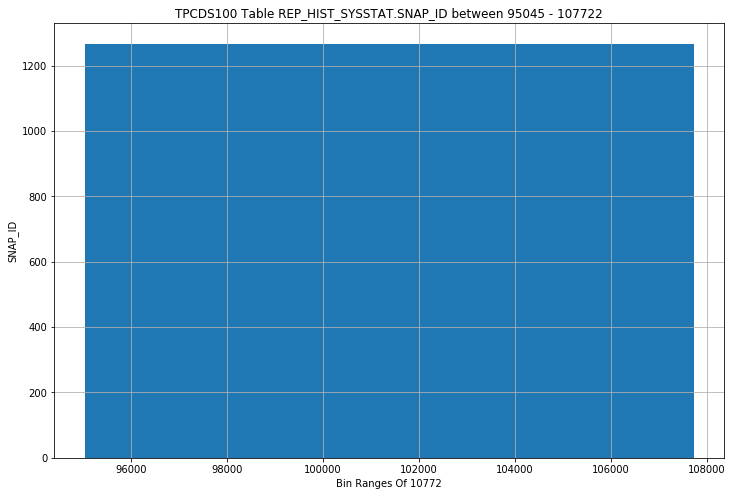

REP_HIST_SYSSTAT - BATCHED IO (BOUND) VECTOR COUNT - OUTLIERS HISTOGRAM


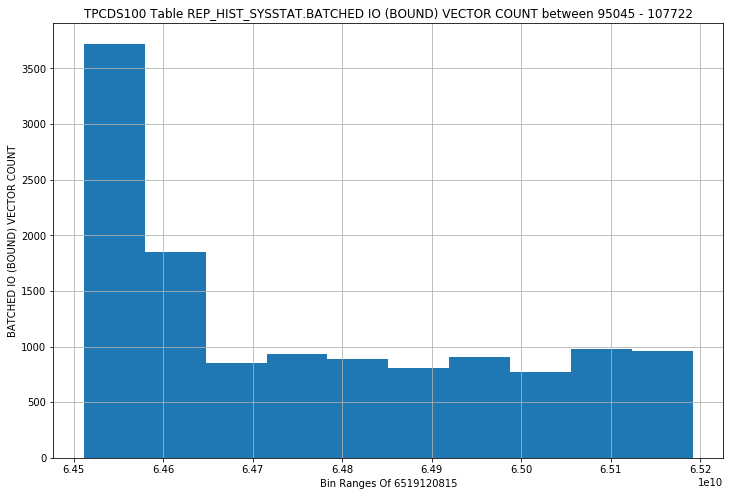

REP_HIST_SYSSTAT - BATCHED IO (FULL) VECTOR COUNT - OUTLIERS HISTOGRAM


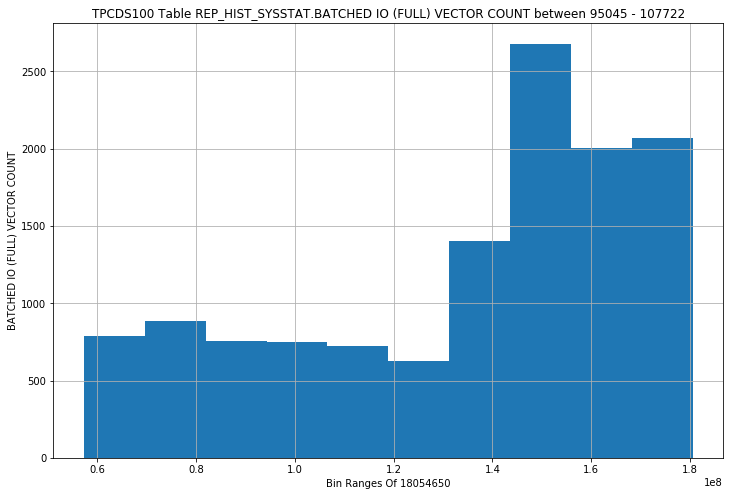

REP_HIST_SYSSTAT - BATCHED IO (SPACE) VECTOR COUNT - OUTLIERS HISTOGRAM


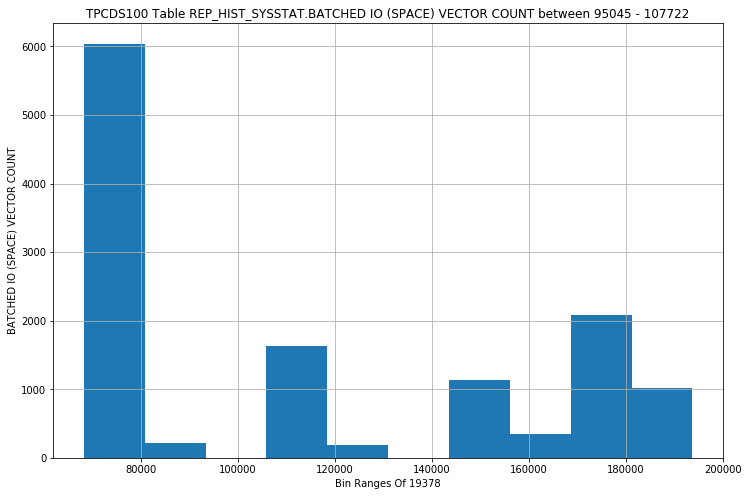

REP_HIST_SYSSTAT - BATCHED IO BLOCK MISS COUNT - OUTLIERS HISTOGRAM


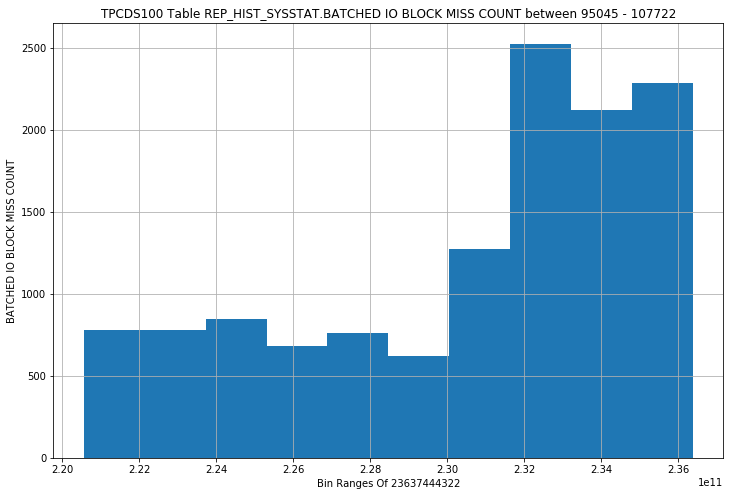

REP_HIST_SYSSTAT - BATCHED IO BUFFER DEFRAG COUNT - OUTLIERS HISTOGRAM


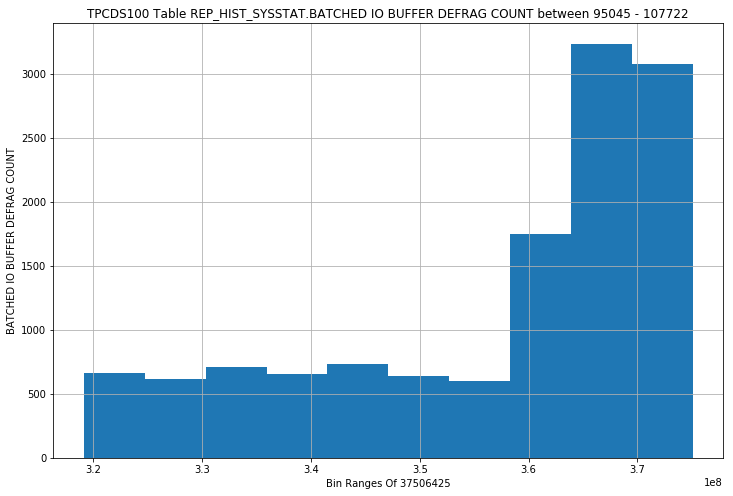

REP_HIST_SYSSTAT - BATCHED IO DOUBLE MISS COUNT - OUTLIERS HISTOGRAM


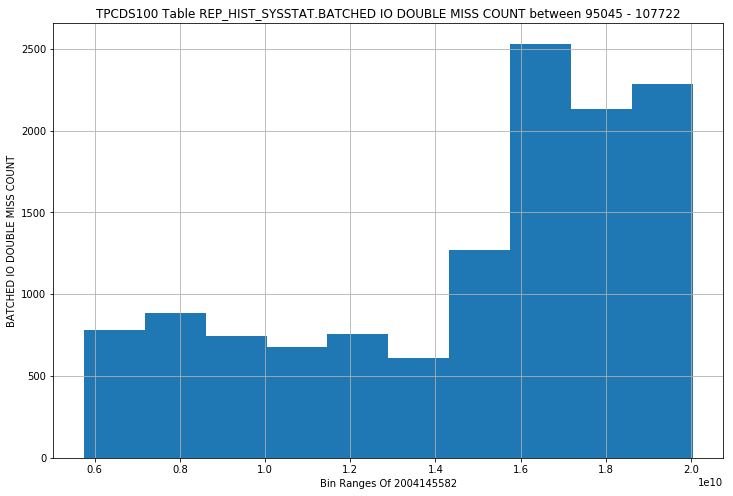

REP_HIST_SYSSTAT - BATCHED IO SAME UNIT COUNT - OUTLIERS HISTOGRAM


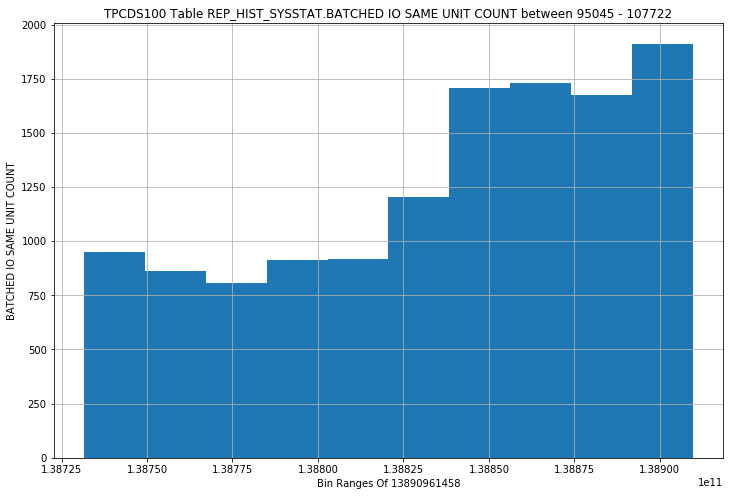

REP_HIST_SYSSTAT - BATCHED IO SINGLE BLOCK COUNT - OUTLIERS HISTOGRAM


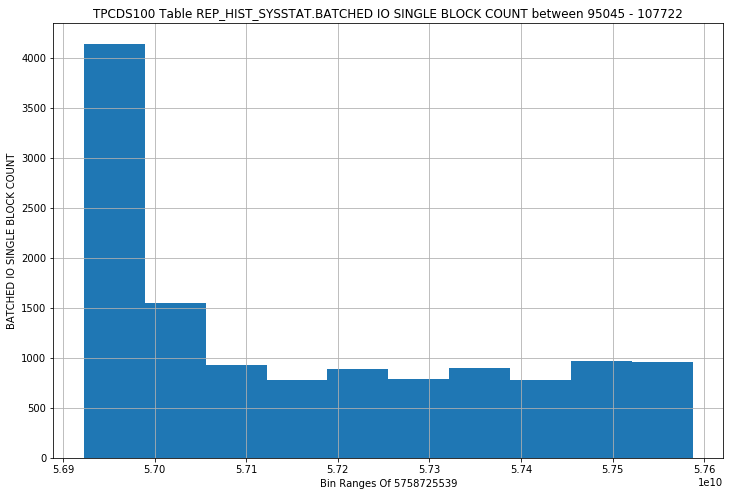

REP_HIST_SYSSTAT - BATCHED IO SLOW JUMP COUNT - OUTLIERS HISTOGRAM


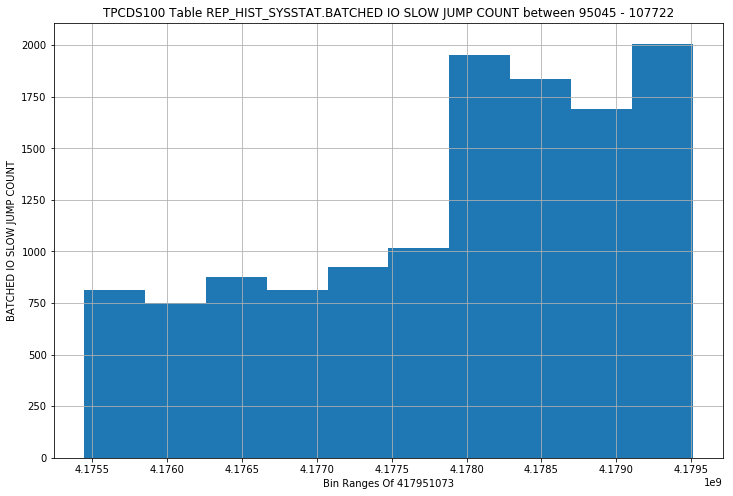

REP_HIST_SYSSTAT - BATCHED IO VECTOR BLOCK COUNT - OUTLIERS HISTOGRAM


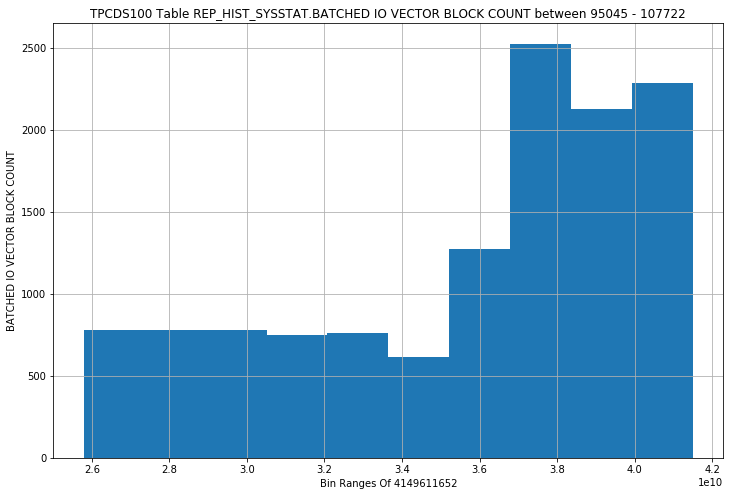

REP_HIST_SYSSTAT - BATCHED IO VECTOR READ COUNT - OUTLIERS HISTOGRAM


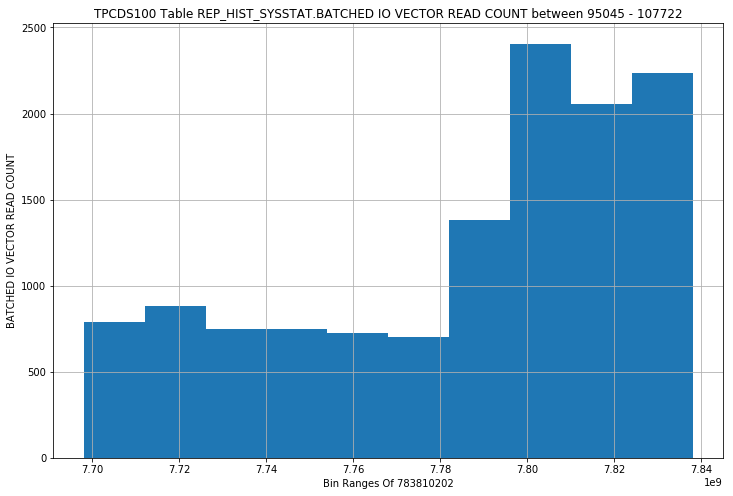

REP_HIST_SYSSTAT - BLOCK CLEANOUT OPTIM REFERENCED - OUTLIERS HISTOGRAM


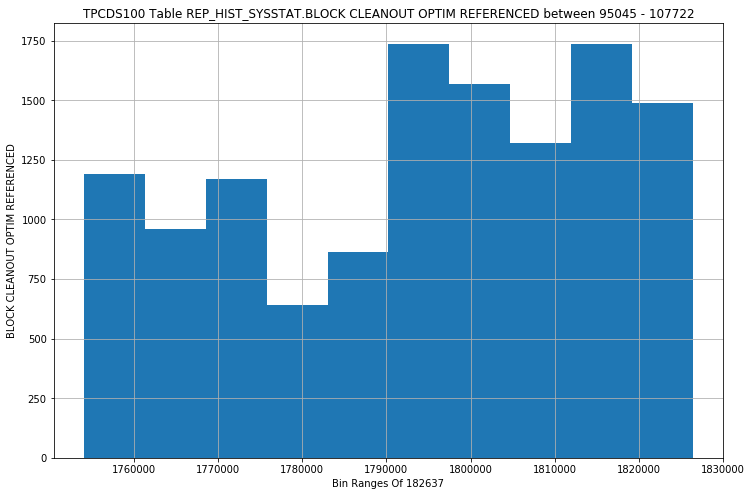

REP_HIST_SYSSTAT - CCURSOR + SQL AREA EVICTED - OUTLIERS HISTOGRAM


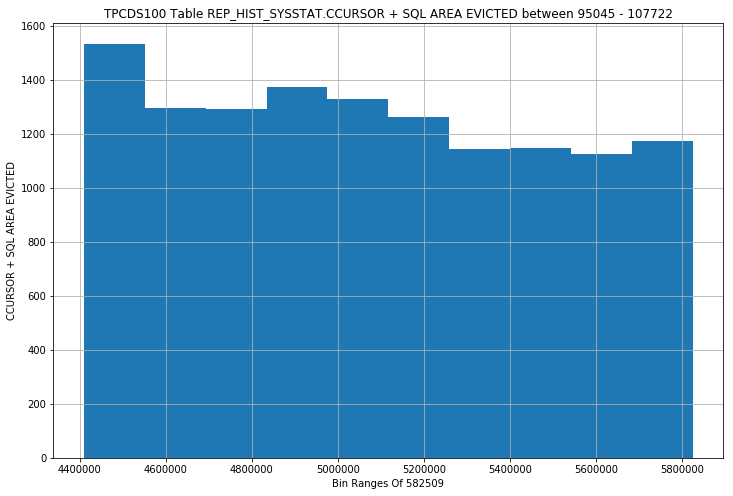

REP_HIST_SYSSTAT - CLI BG ENQ - OUTLIERS HISTOGRAM


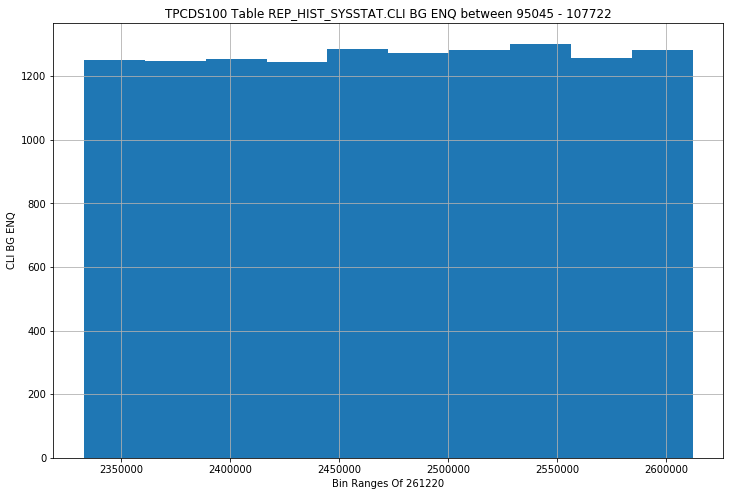

REP_HIST_SYSSTAT - CLI BG ATTEMPT FLUSH - OUTLIERS HISTOGRAM


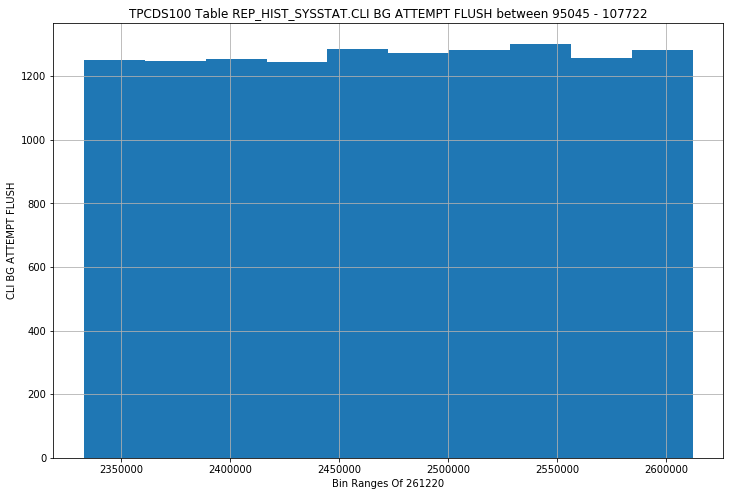

REP_HIST_SYSSTAT - CLI FLSTASK CREATE - OUTLIERS HISTOGRAM


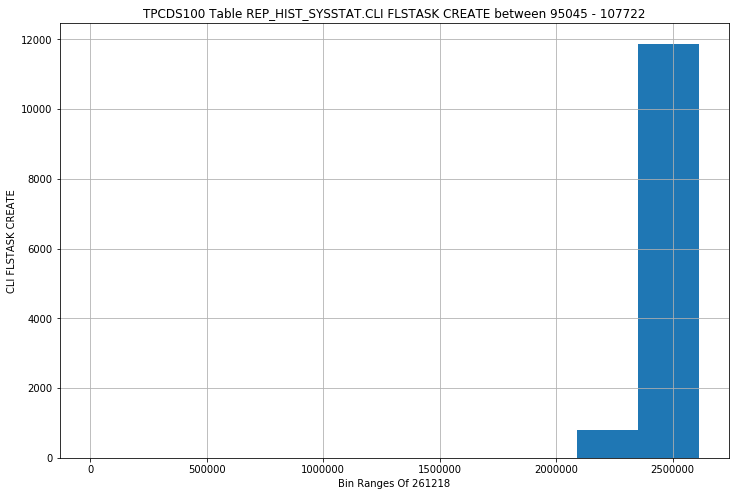

REP_HIST_SYSSTAT - CLI FLUSH - OUTLIERS HISTOGRAM


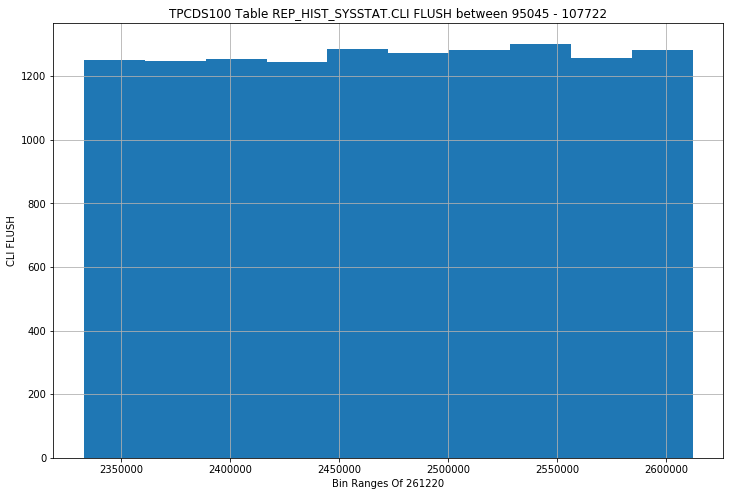

REP_HIST_SYSSTAT - CPU USED BY THIS SESSION - OUTLIERS HISTOGRAM


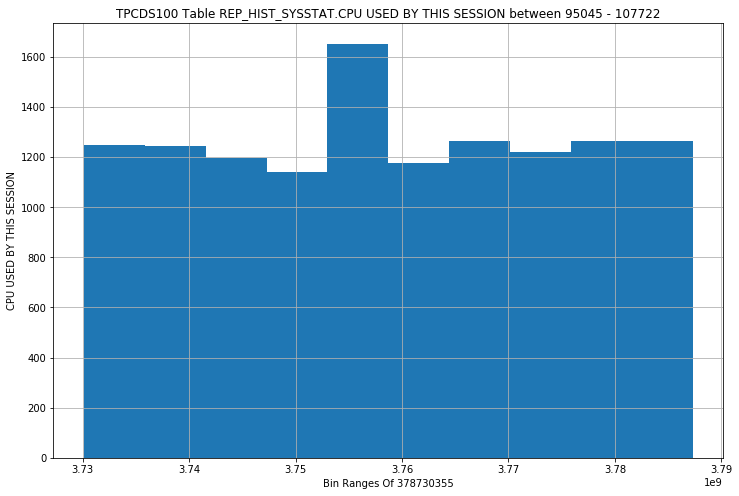

REP_HIST_SYSSTAT - CPU USED WHEN CALL STARTED - OUTLIERS HISTOGRAM


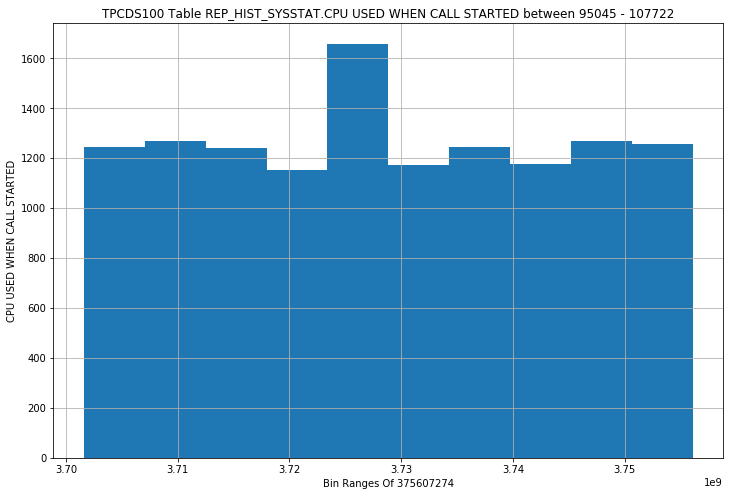

REP_HIST_SYSSTAT - CR BLOCKS CREATED - OUTLIERS HISTOGRAM


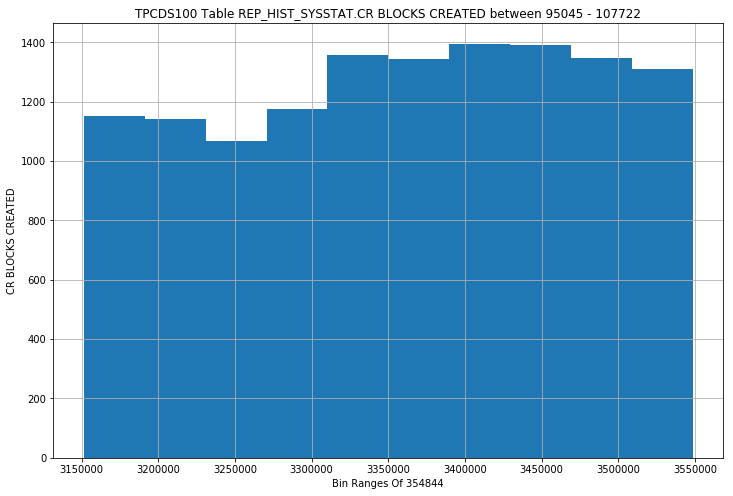

REP_HIST_SYSSTAT - CACHED COMMIT SCN REFERENCED - OUTLIERS HISTOGRAM


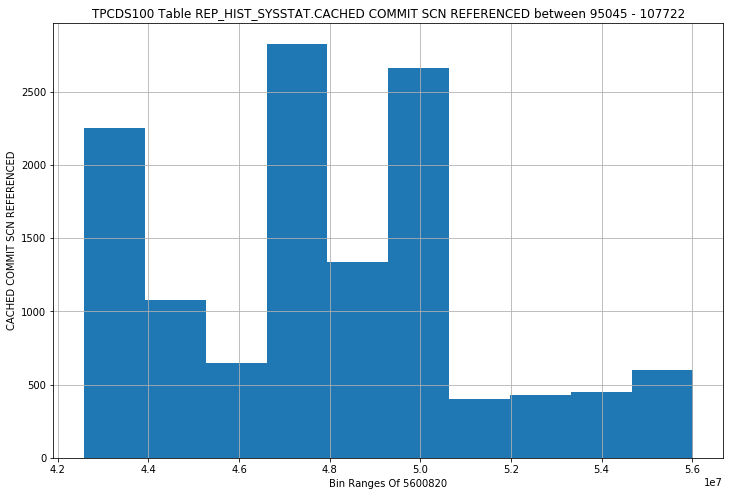

REP_HIST_SYSSTAT - COMMIT SCN CACHED - OUTLIERS HISTOGRAM


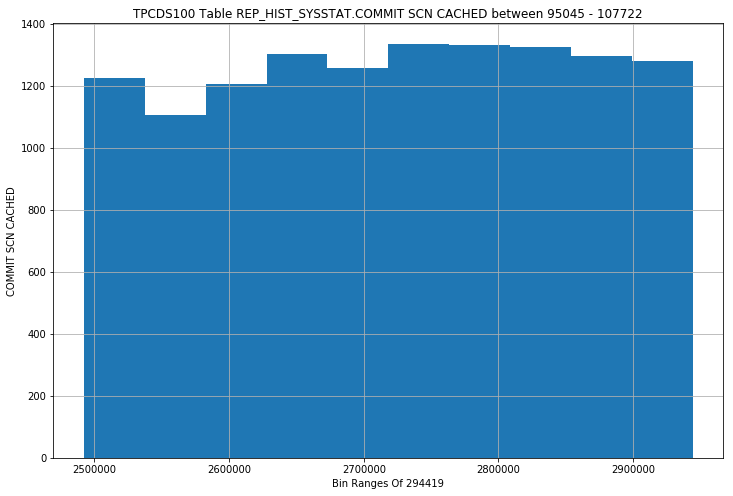

REP_HIST_SYSSTAT - DB TIME - OUTLIERS HISTOGRAM


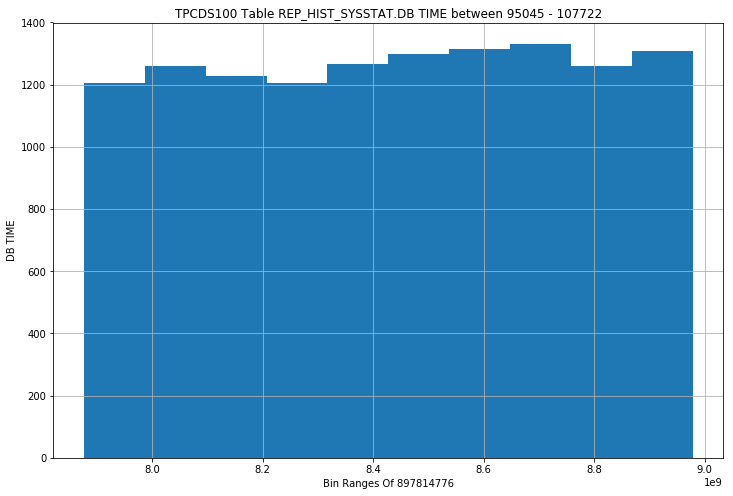

REP_HIST_SYSSTAT - DBWR CHECKPOINT BUFFERS WRITTEN - OUTLIERS HISTOGRAM


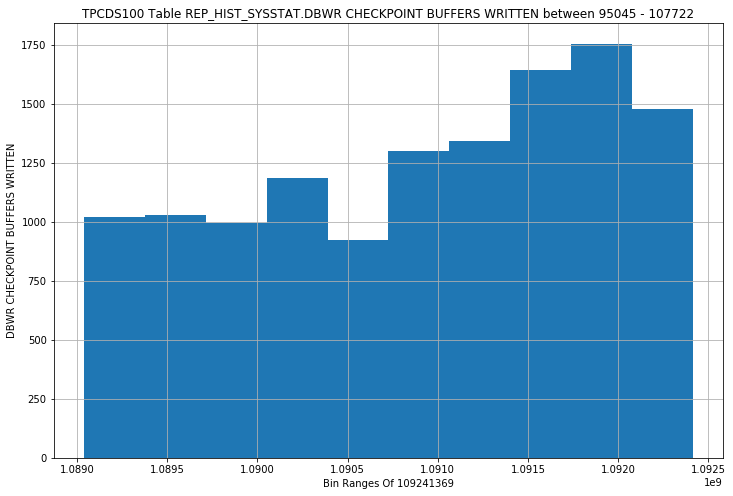

REP_HIST_SYSSTAT - DBWR CHECKPOINTS - OUTLIERS HISTOGRAM


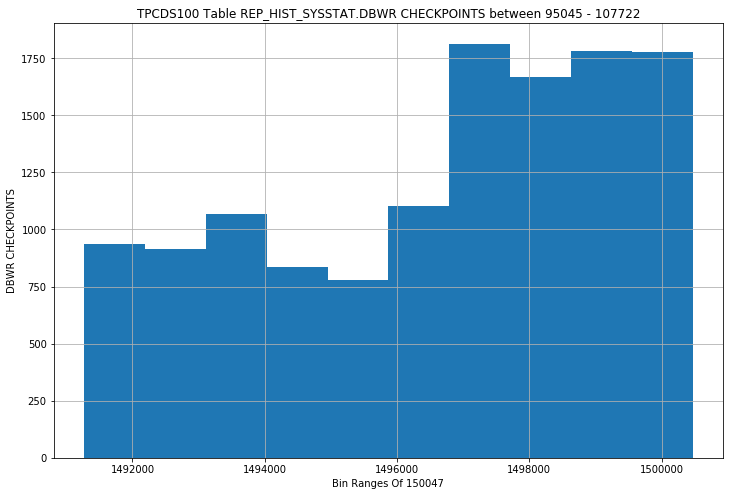

REP_HIST_SYSSTAT - DBWR OBJECT DROP BUFFERS WRITTEN - OUTLIERS HISTOGRAM


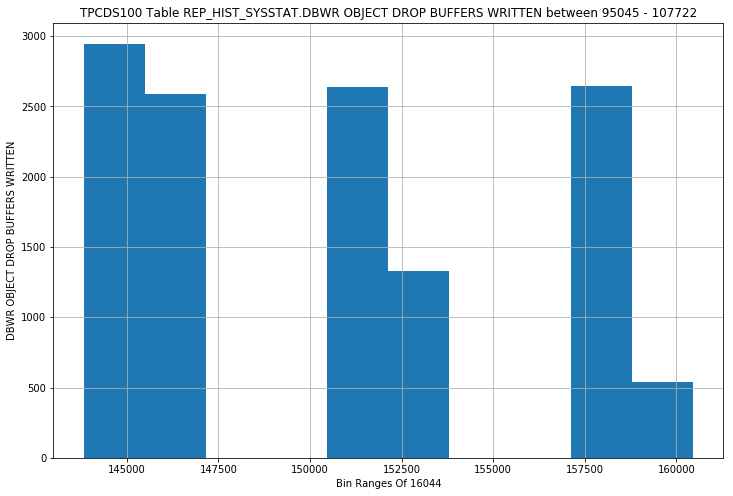

REP_HIST_SYSSTAT - DBWR PARALLEL QUERY CHECKPOINT BUFFERS WRITTEN - OUTLIERS HISTOGRAM


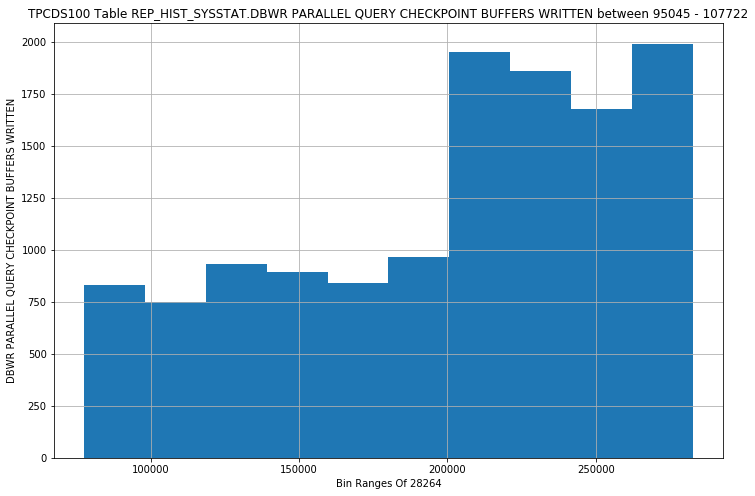

REP_HIST_SYSSTAT - DBWR REVISITED BEING-WRITTEN BUFFER - OUTLIERS HISTOGRAM


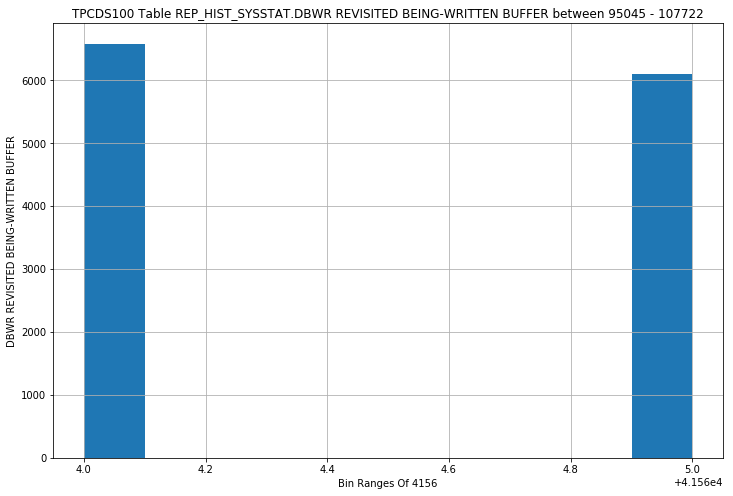

REP_HIST_SYSSTAT - DBWR THREAD CHECKPOINT BUFFERS WRITTEN - OUTLIERS HISTOGRAM


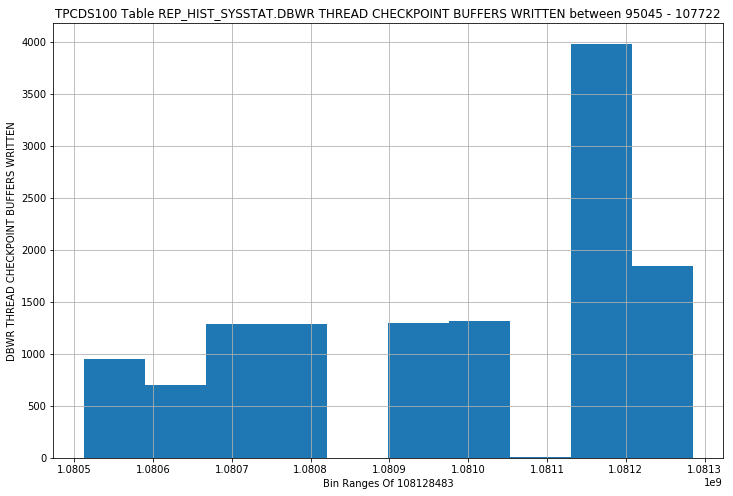

REP_HIST_SYSSTAT - DBWR TRANSACTION TABLE WRITES - OUTLIERS HISTOGRAM


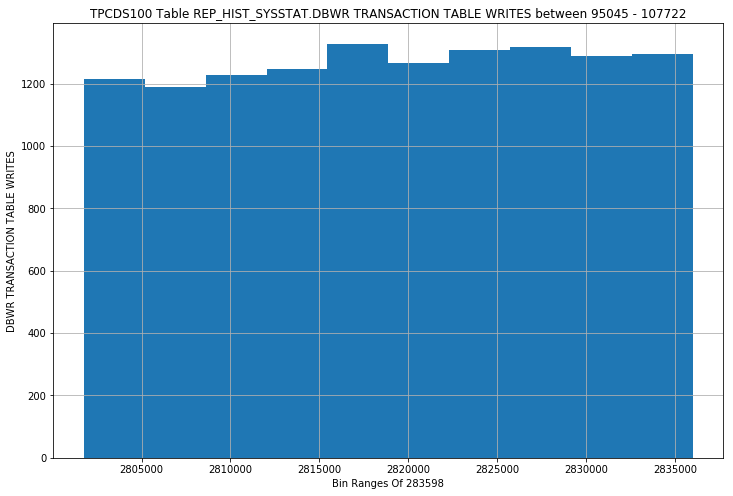

REP_HIST_SYSSTAT - DBWR UNDO BLOCK WRITES - OUTLIERS HISTOGRAM


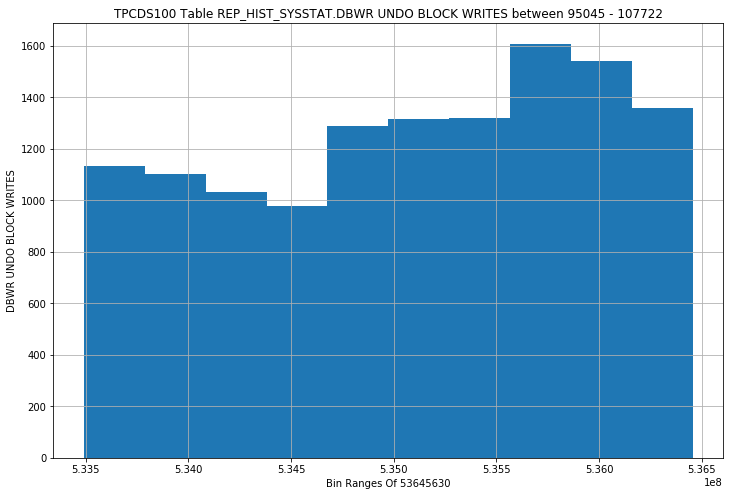

REP_HIST_SYSSTAT - DDL STATEMENTS PARALLELIZED - OUTLIERS HISTOGRAM


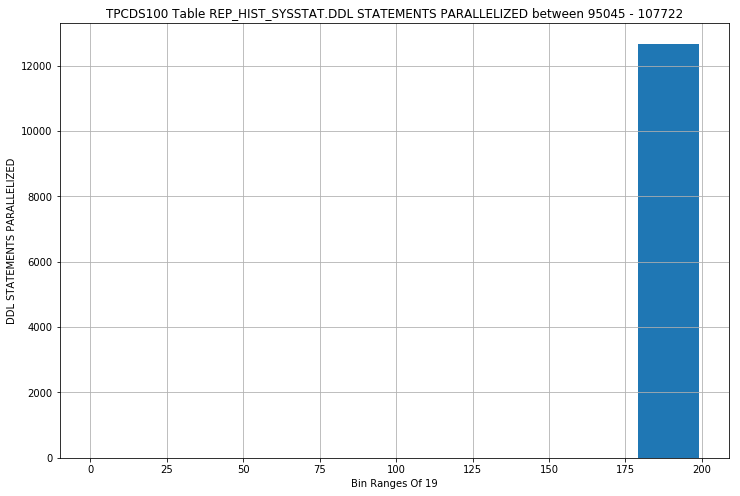

REP_HIST_SYSSTAT - DFO TREES PARALLELIZED - OUTLIERS HISTOGRAM


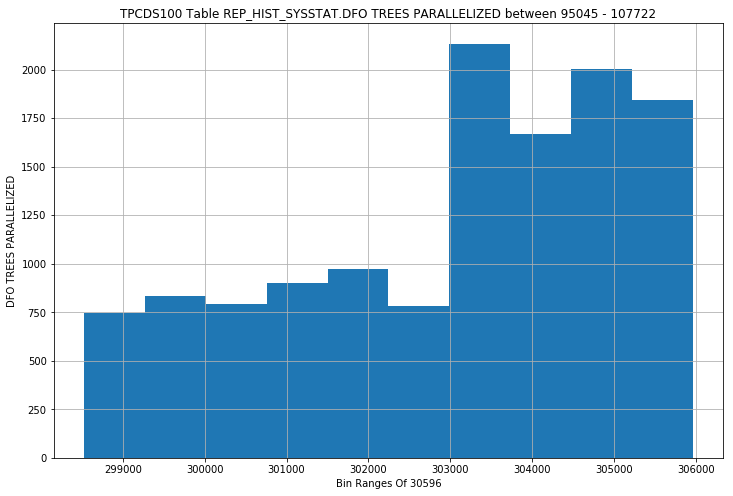

REP_HIST_SYSSTAT - EFFECTIVE IO TIME - OUTLIERS HISTOGRAM


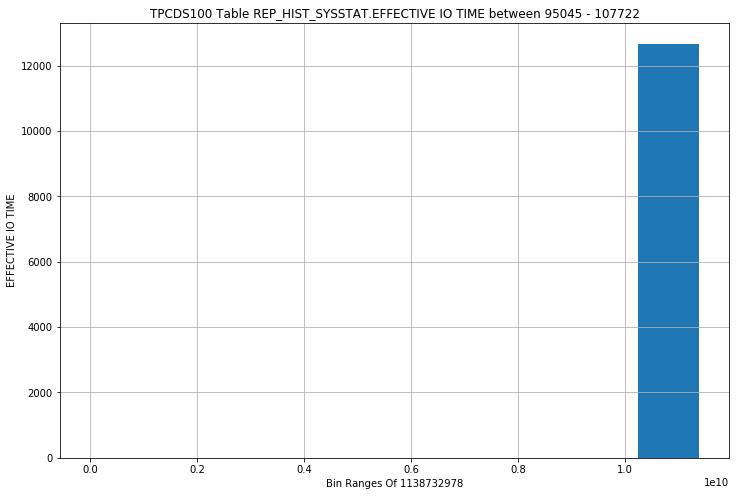

REP_HIST_SYSSTAT - HSC HEAP SEGMENT BLOCK CHANGES - OUTLIERS HISTOGRAM


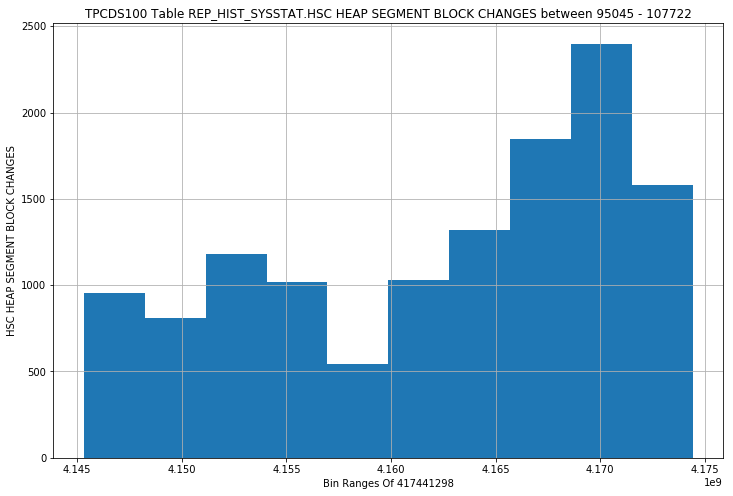

REP_HIST_SYSSTAT - HEAP SEGMENT ARRAY INSERTS - OUTLIERS HISTOGRAM


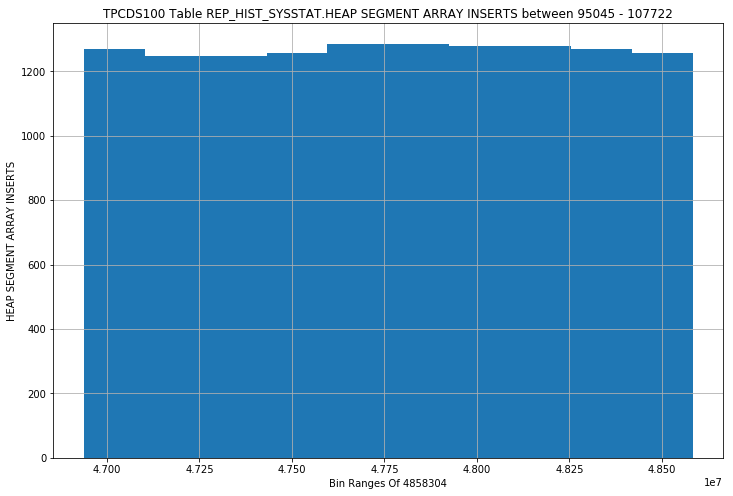

REP_HIST_SYSSTAT - HEAP SEGMENT ARRAY UPDATES - OUTLIERS HISTOGRAM


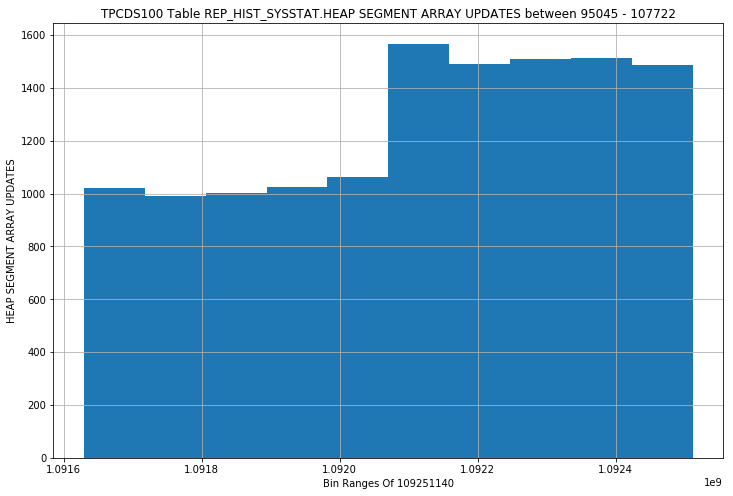

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSHED - OUTLIERS HISTOGRAM


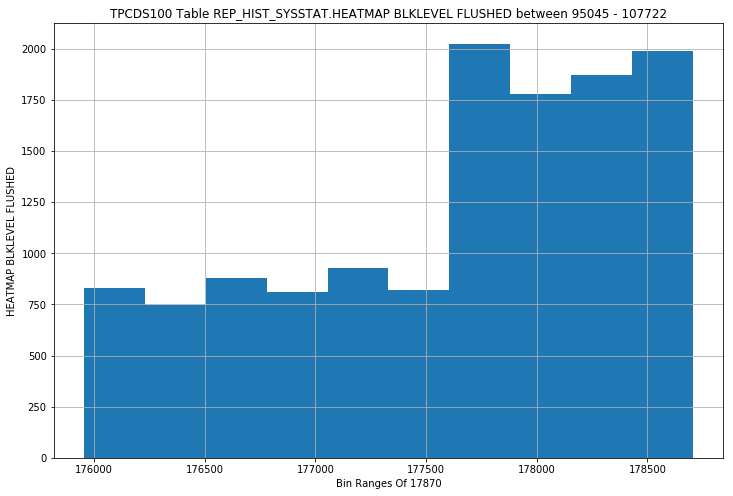

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSHED TO BF - OUTLIERS HISTOGRAM


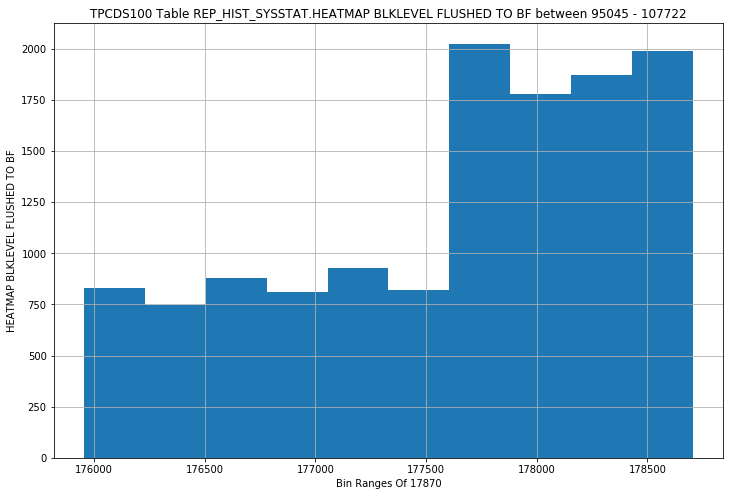

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL RANGES FLUSHED - OUTLIERS HISTOGRAM


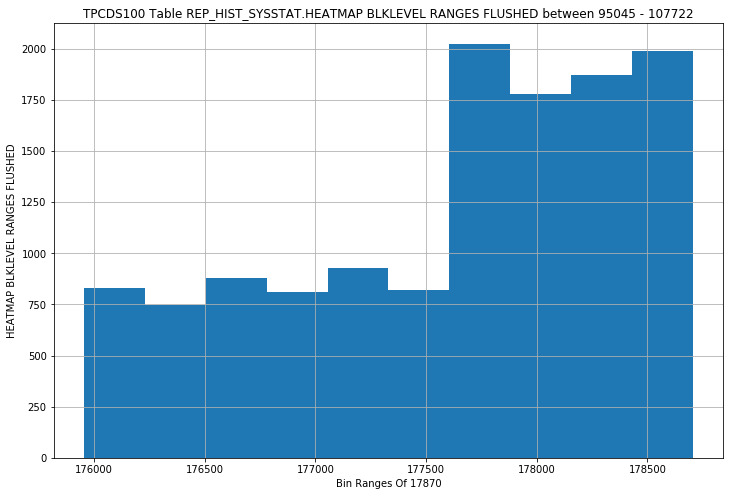

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSH TASK COUNT - OUTLIERS HISTOGRAM


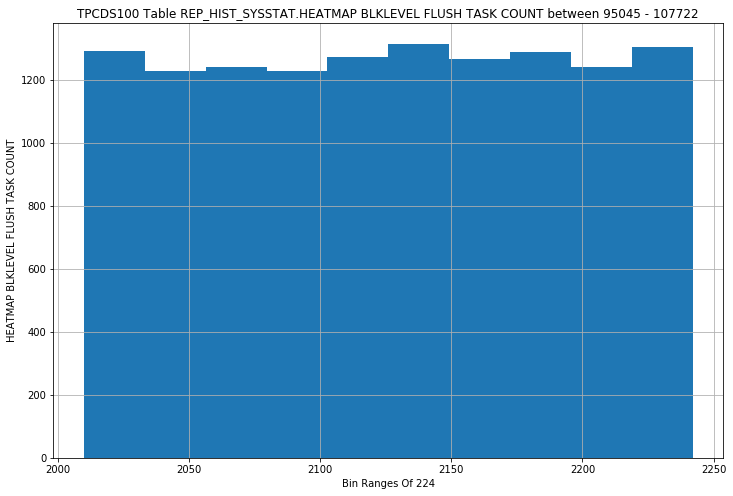

REP_HIST_SYSSTAT - IMU CR ROLLBACKS - OUTLIERS HISTOGRAM


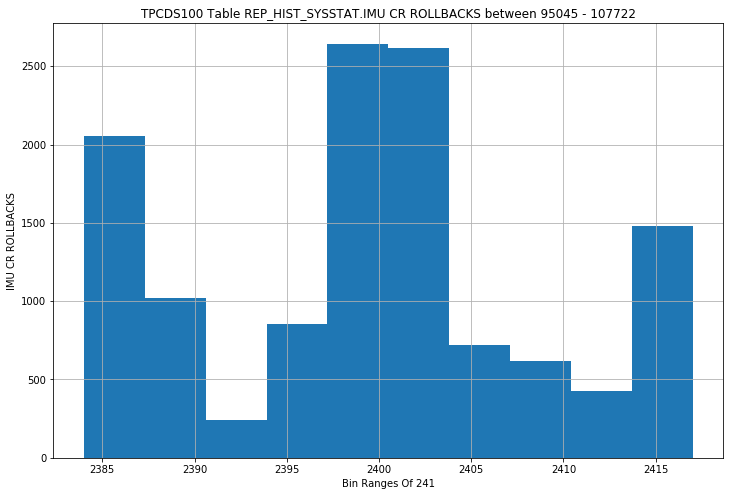

REP_HIST_SYSSTAT - IMU FLUSHES - OUTLIERS HISTOGRAM


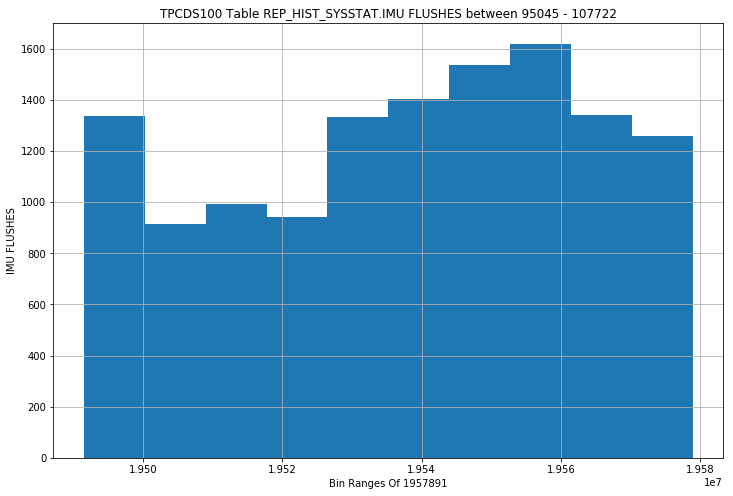

REP_HIST_SYSSTAT - IMU REDO ALLOCATION SIZE - OUTLIERS HISTOGRAM


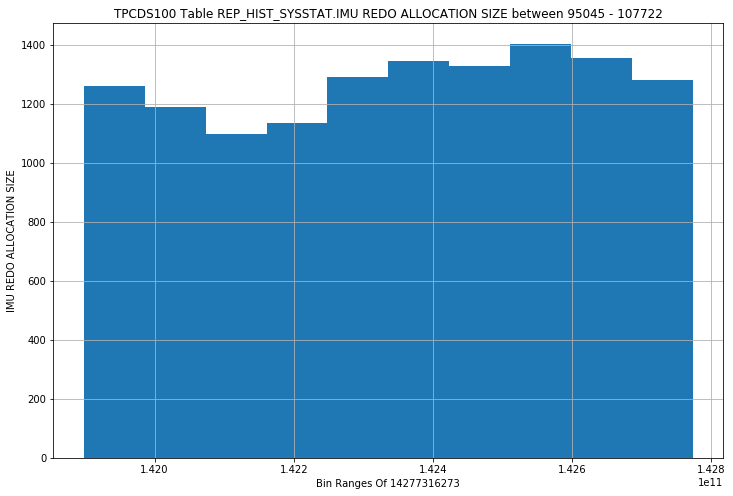

REP_HIST_SYSSTAT - IMU COMMITS - OUTLIERS HISTOGRAM


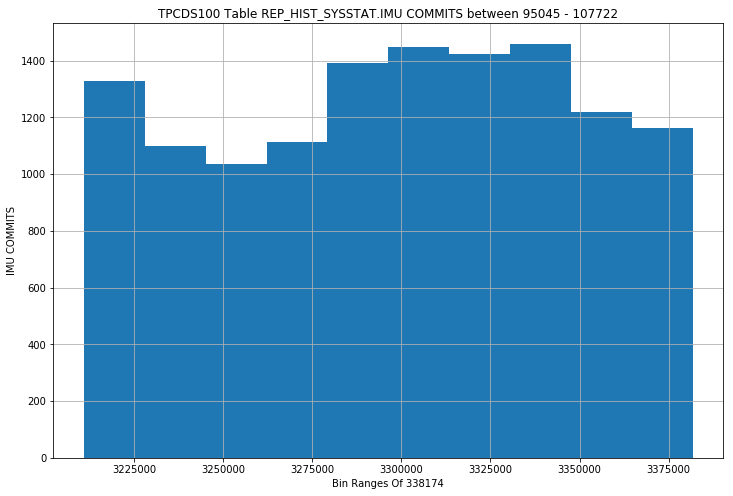

REP_HIST_SYSSTAT - IMU CONTENTION - OUTLIERS HISTOGRAM


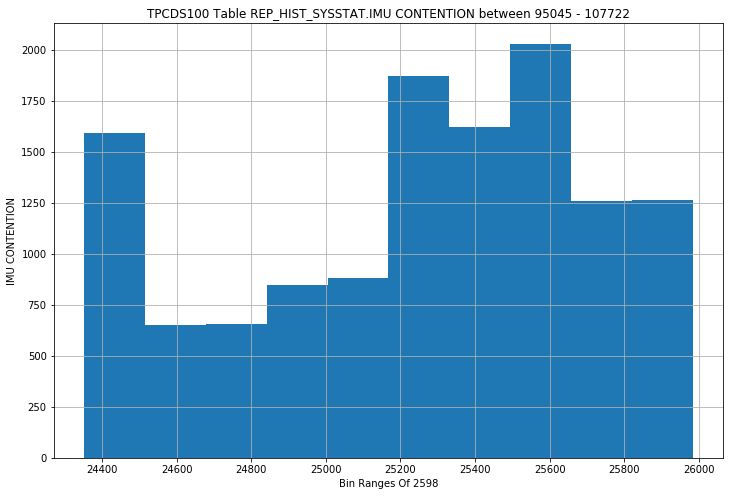

REP_HIST_SYSSTAT - IMU KTICHG FLUSH - OUTLIERS HISTOGRAM


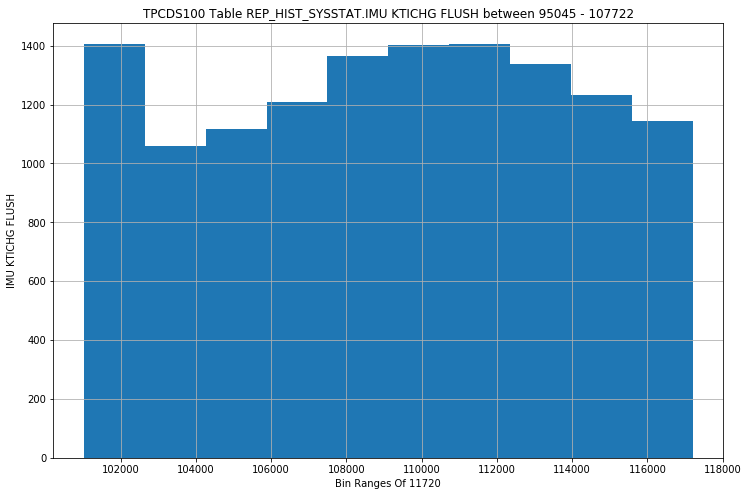

REP_HIST_SYSSTAT - IMU POOL NOT ALLOCATED - OUTLIERS HISTOGRAM


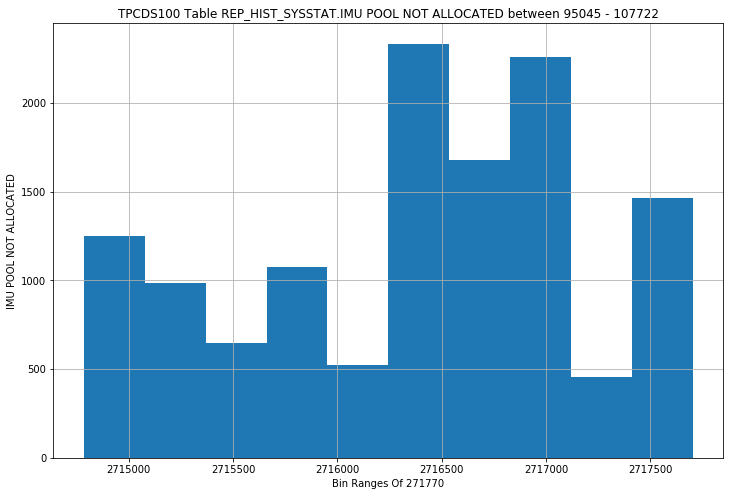

REP_HIST_SYSSTAT - IMU RECURSIVE-TRANSACTION FLUSH - OUTLIERS HISTOGRAM


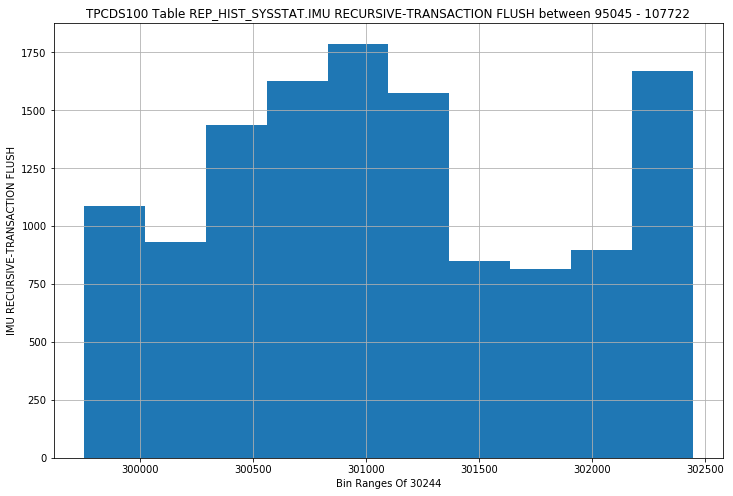

REP_HIST_SYSSTAT - IMU UNDO ALLOCATION SIZE - OUTLIERS HISTOGRAM


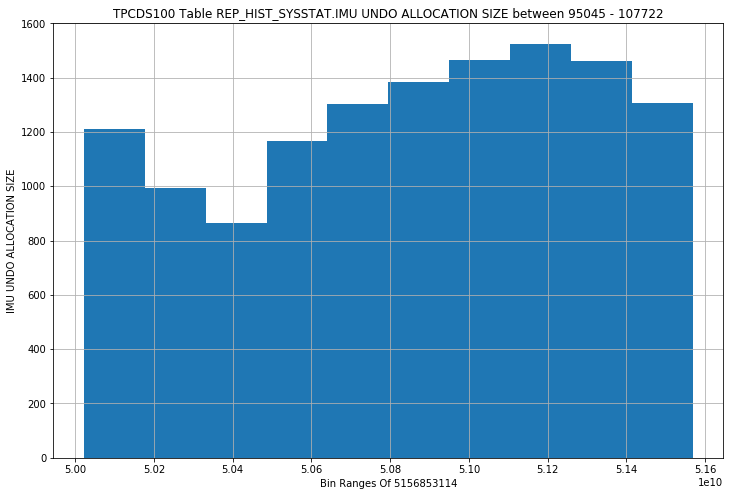

REP_HIST_SYSSTAT - IMU- FAILED TO GET A PRIVATE STRAND - OUTLIERS HISTOGRAM


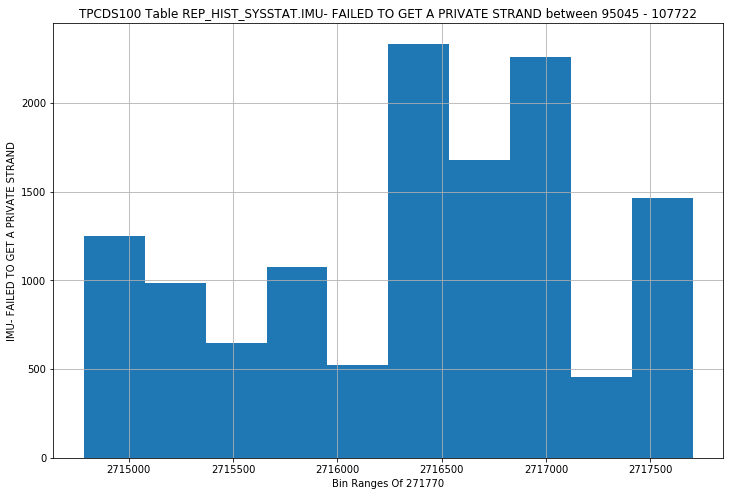

REP_HIST_SYSSTAT - KTFB ALLOC REQ - OUTLIERS HISTOGRAM


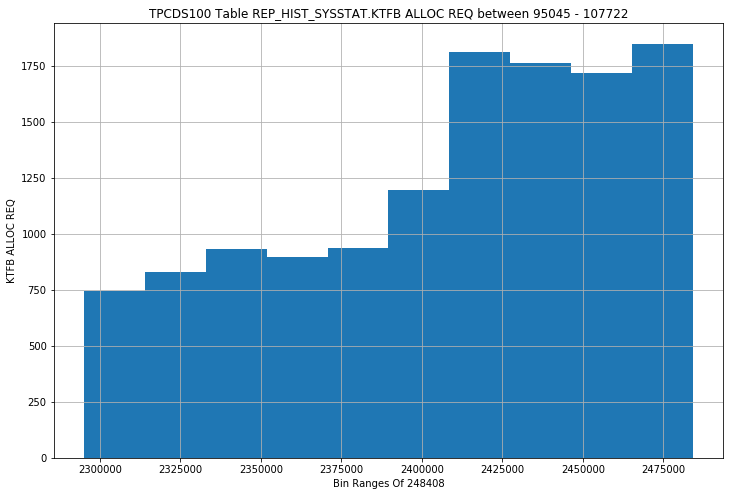

REP_HIST_SYSSTAT - KTFB ALLOC SPACE (BLOCK) - OUTLIERS HISTOGRAM


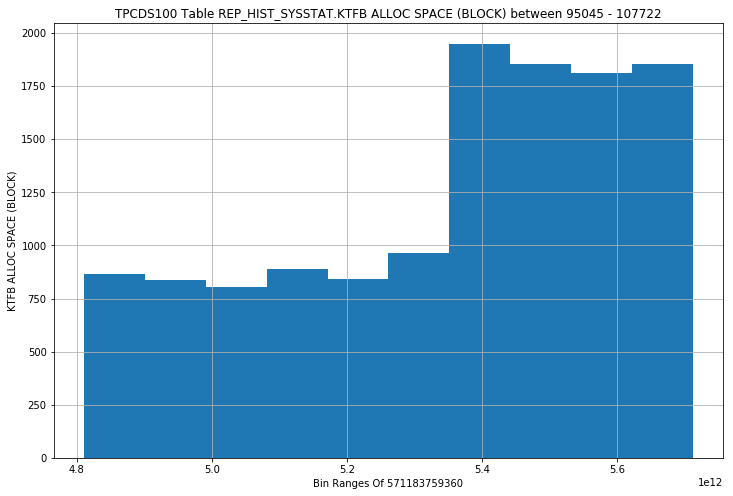

REP_HIST_SYSSTAT - KTFB ALLOC TIME (MS) - OUTLIERS HISTOGRAM


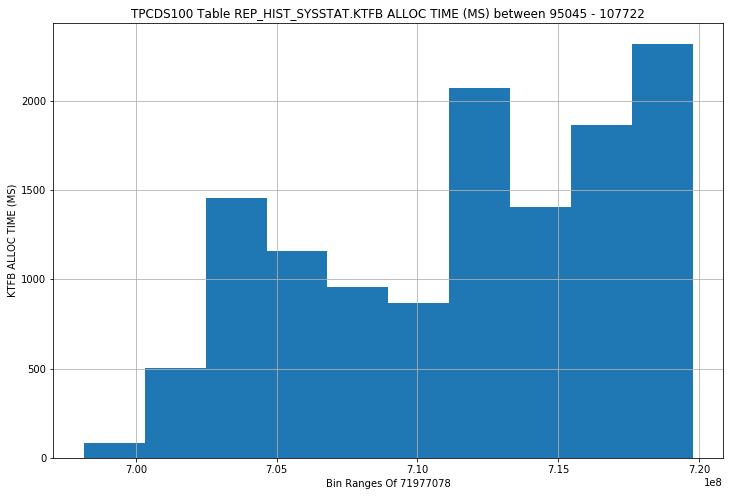

REP_HIST_SYSSTAT - KTFB APPLY REQ - OUTLIERS HISTOGRAM


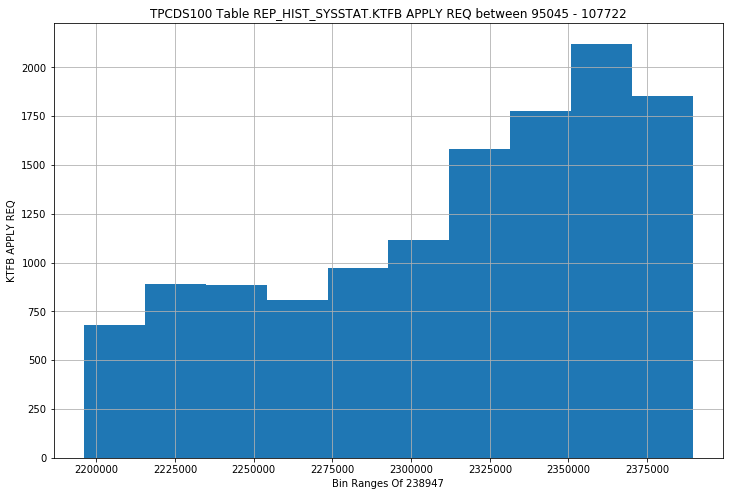

REP_HIST_SYSSTAT - KTFB APPLY TIME (MS) - OUTLIERS HISTOGRAM


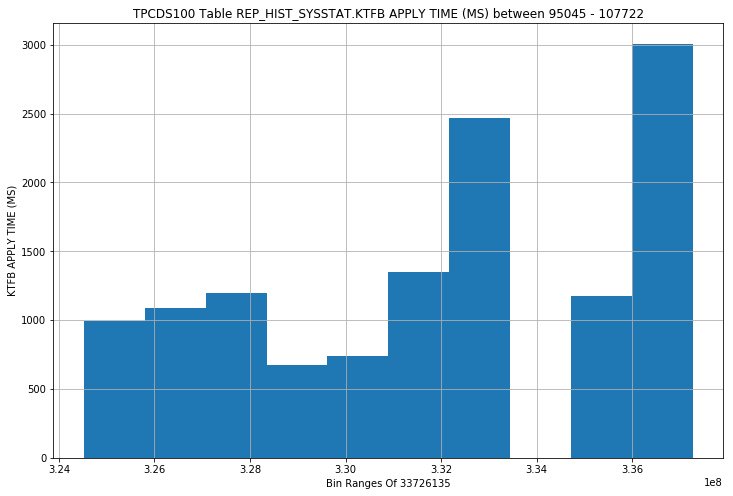

REP_HIST_SYSSTAT - KTFB COMMIT REQ - OUTLIERS HISTOGRAM


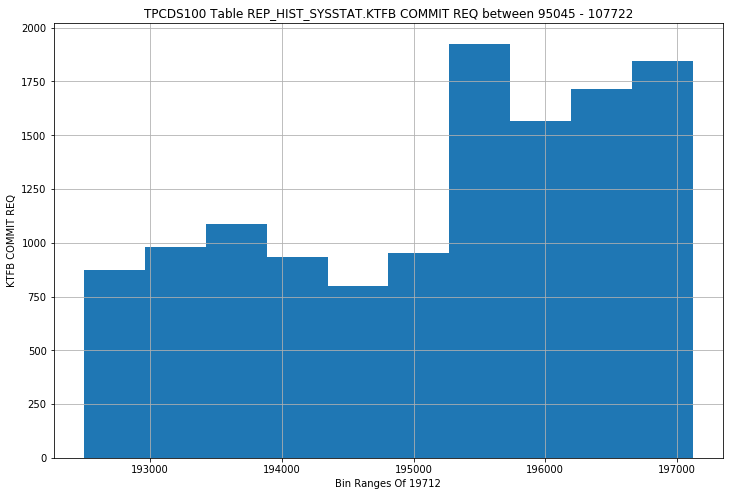

REP_HIST_SYSSTAT - KTFB COMMIT TIME (MS) - OUTLIERS HISTOGRAM


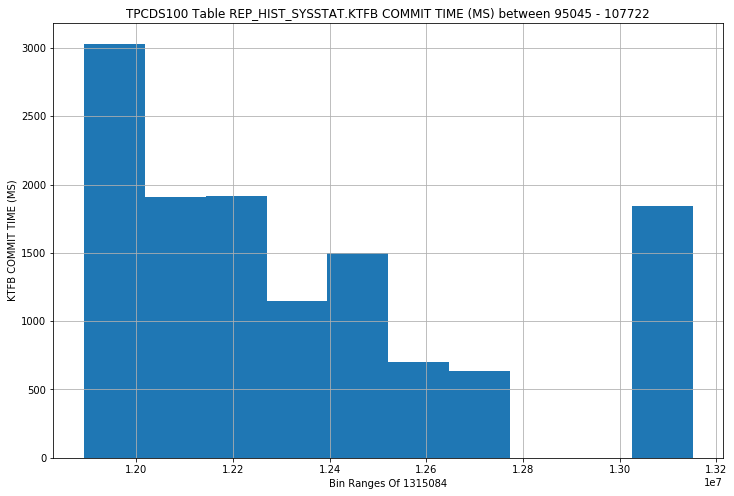

REP_HIST_SYSSTAT - KTFB FREE REQ - OUTLIERS HISTOGRAM


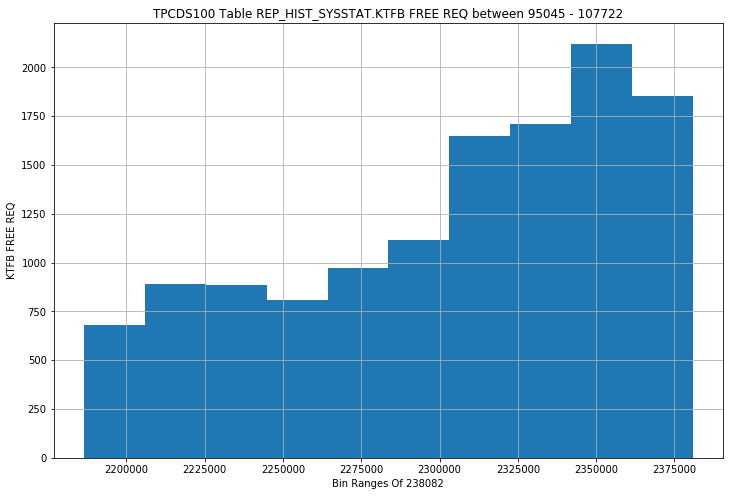

REP_HIST_SYSSTAT - KTFB FREE SPACE (BLOCK) - OUTLIERS HISTOGRAM


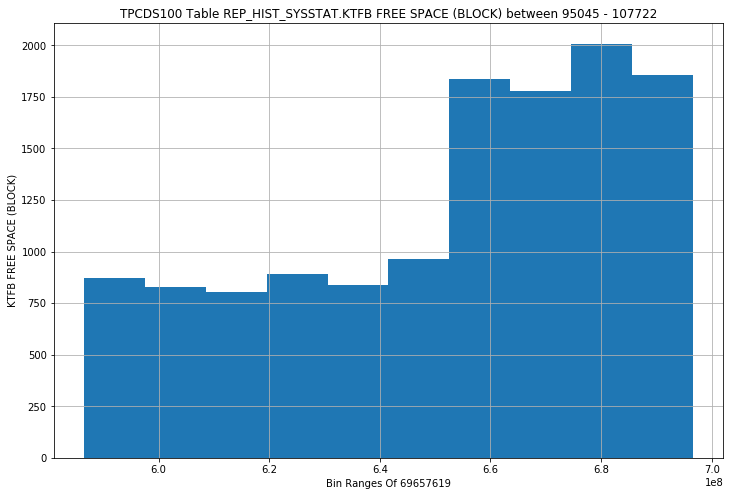

REP_HIST_SYSSTAT - KTFB FREE TIME (MS) - OUTLIERS HISTOGRAM


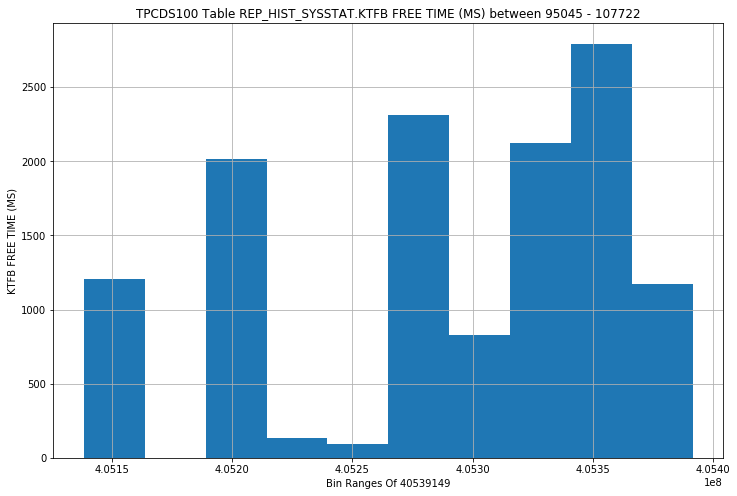

REP_HIST_SYSSTAT - LOB TABLE ID LOOKUP CACHE MISSES - OUTLIERS HISTOGRAM


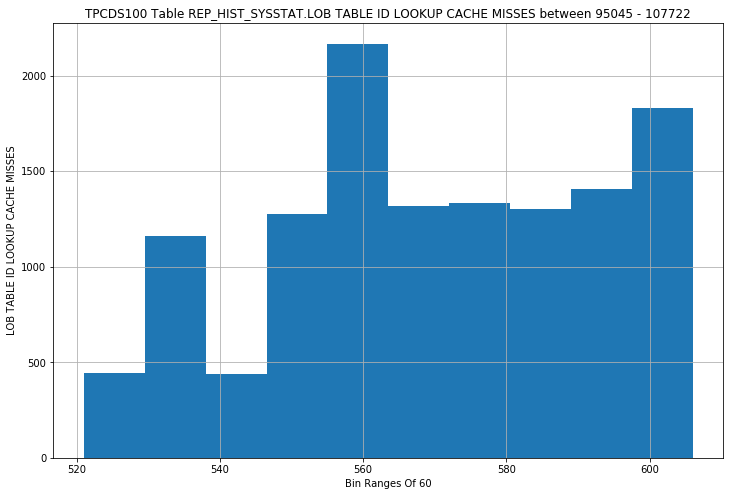

REP_HIST_SYSSTAT - NUMBER OF READ IOS ISSUED - OUTLIERS HISTOGRAM


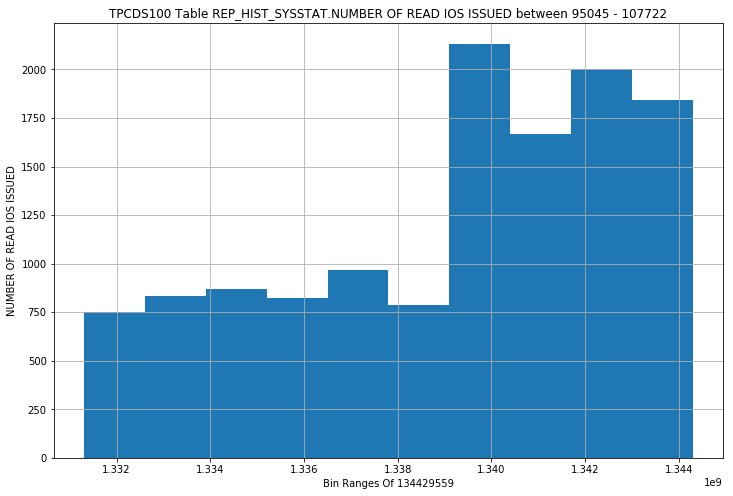

REP_HIST_SYSSTAT - PX LOCAL MESSAGES RECV'D - OUTLIERS HISTOGRAM


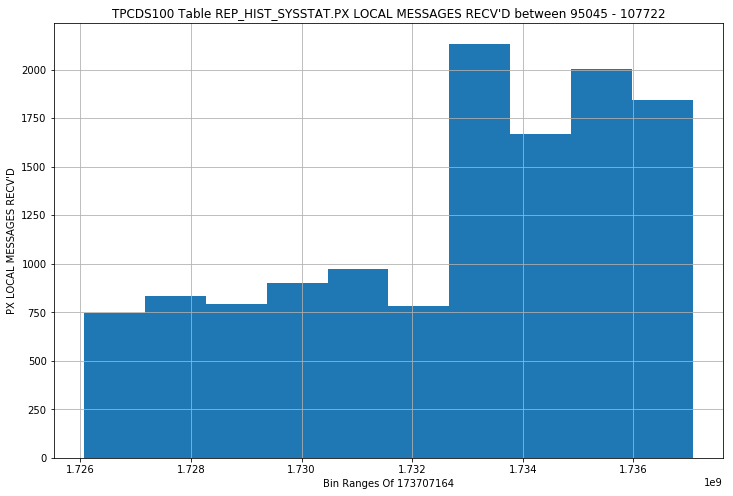

REP_HIST_SYSSTAT - PX LOCAL MESSAGES SENT - OUTLIERS HISTOGRAM


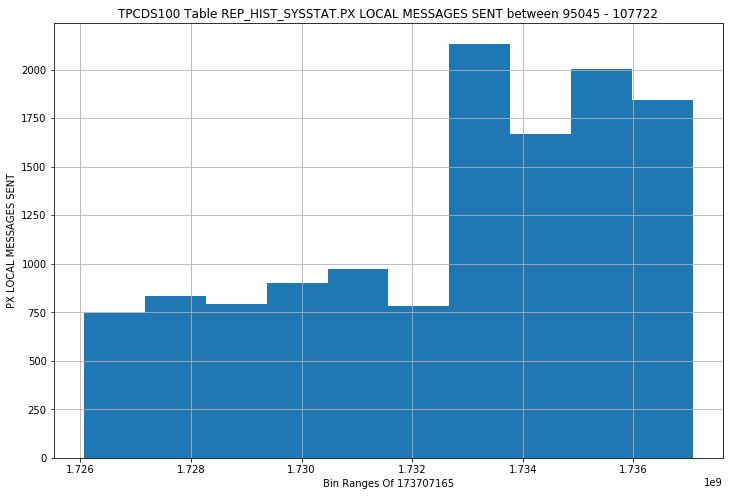

REP_HIST_SYSSTAT - PARALLEL OPERATIONS DOWNGRADED TO SERIAL - OUTLIERS HISTOGRAM


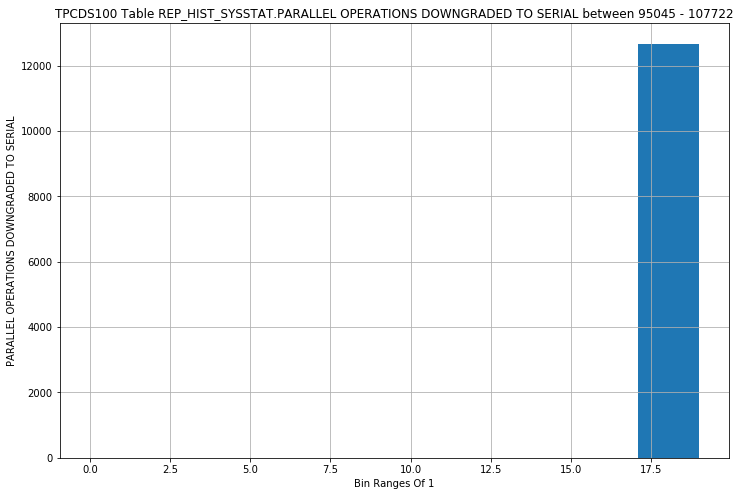

REP_HIST_SYSSTAT - PARALLEL OPERATIONS NOT DOWNGRADED - OUTLIERS HISTOGRAM


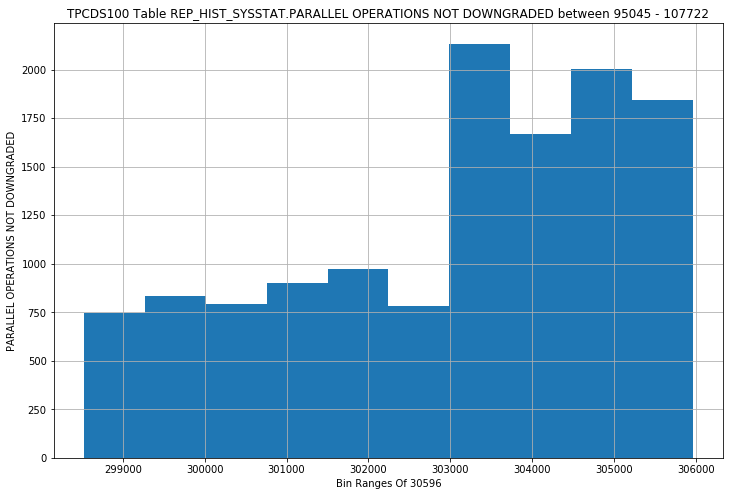

REP_HIST_SYSSTAT - REQUESTS TO/FROM CLIENT - OUTLIERS HISTOGRAM


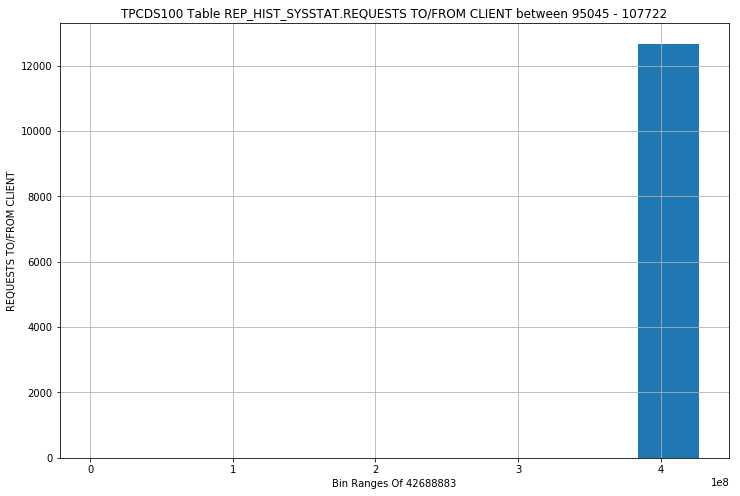

REP_HIST_SYSSTAT - ROWCR ATTEMPTS - OUTLIERS HISTOGRAM


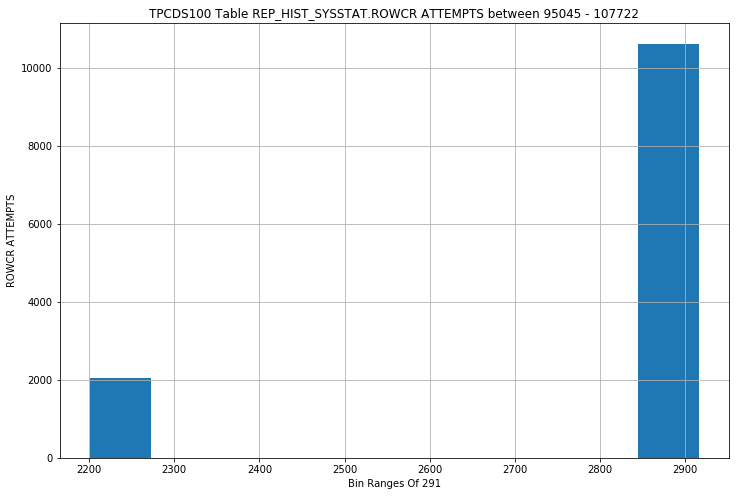

REP_HIST_SYSSTAT - ROWCR HITS - OUTLIERS HISTOGRAM


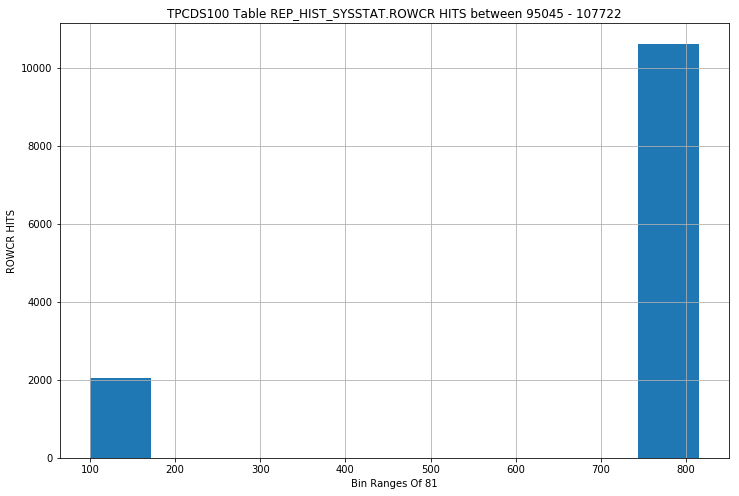

REP_HIST_SYSSTAT - SMON POSTED FOR UNDO SEGMENT SHRINK - OUTLIERS HISTOGRAM


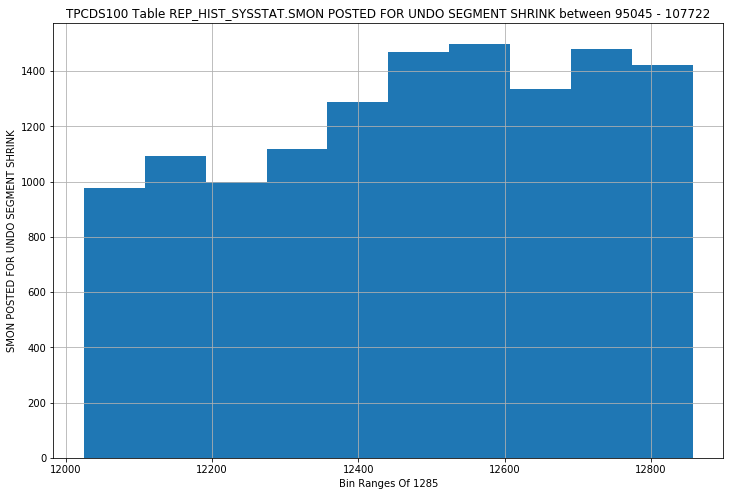

REP_HIST_SYSSTAT - SQL*NET ROUNDTRIPS TO/FROM CLIENT - OUTLIERS HISTOGRAM


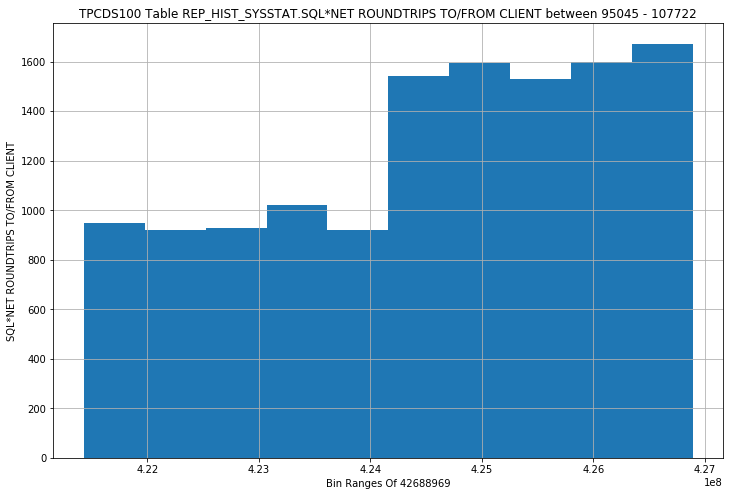

REP_HIST_SYSSTAT - TBS EXTENSION: BYTES EXTENDED - OUTLIERS HISTOGRAM


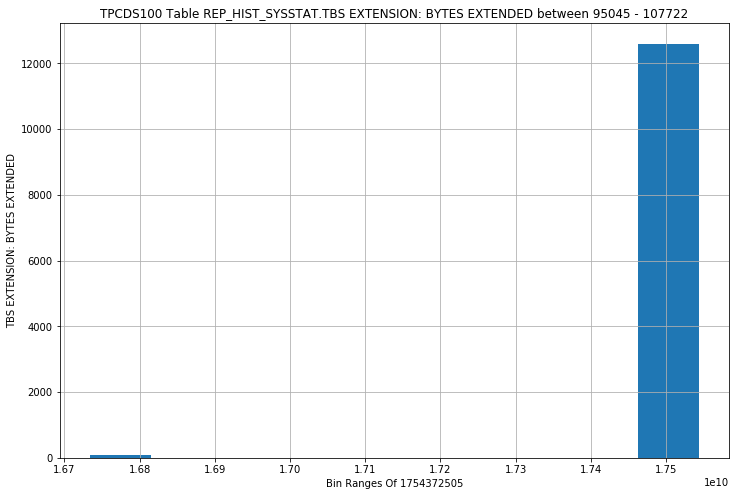

REP_HIST_SYSSTAT - TBS EXTENSION: FILES EXTENDED - OUTLIERS HISTOGRAM


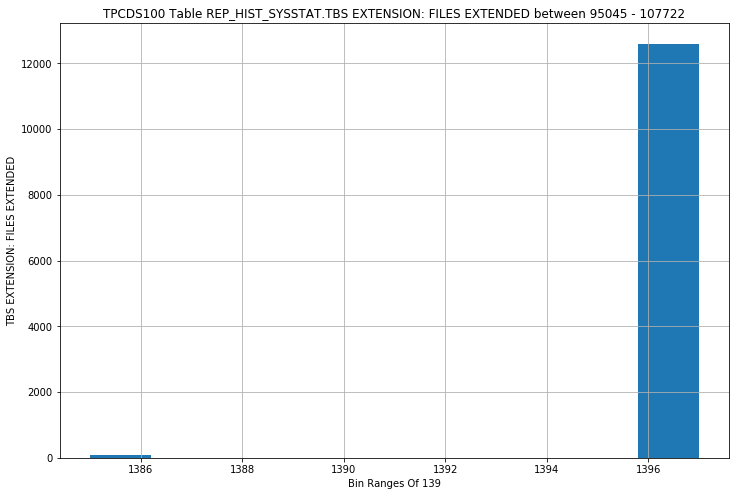

REP_HIST_SYSSTAT - TBS EXTENSION: TASKS CREATED - OUTLIERS HISTOGRAM


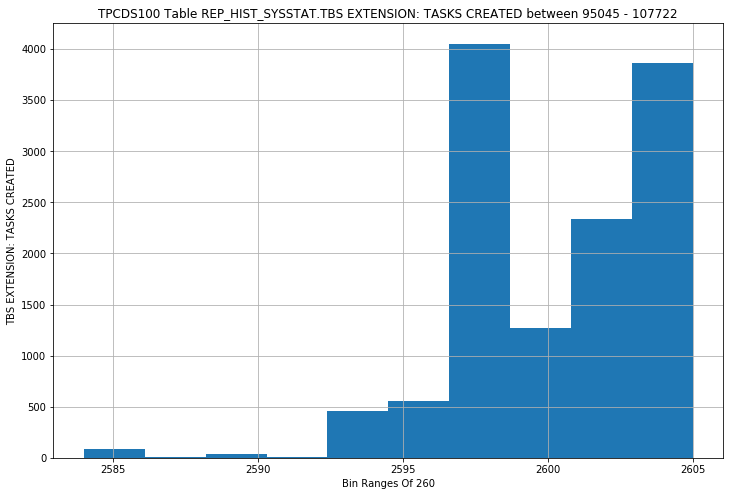

REP_HIST_SYSSTAT - TBS EXTENSION: TASKS EXECUTED - OUTLIERS HISTOGRAM


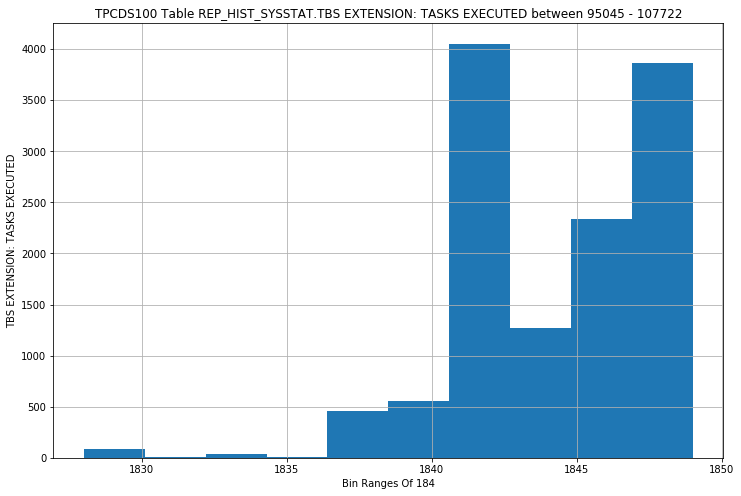

REP_HIST_SYSSTAT - ACTIVE TXN COUNT DURING CLEANOUT - OUTLIERS HISTOGRAM


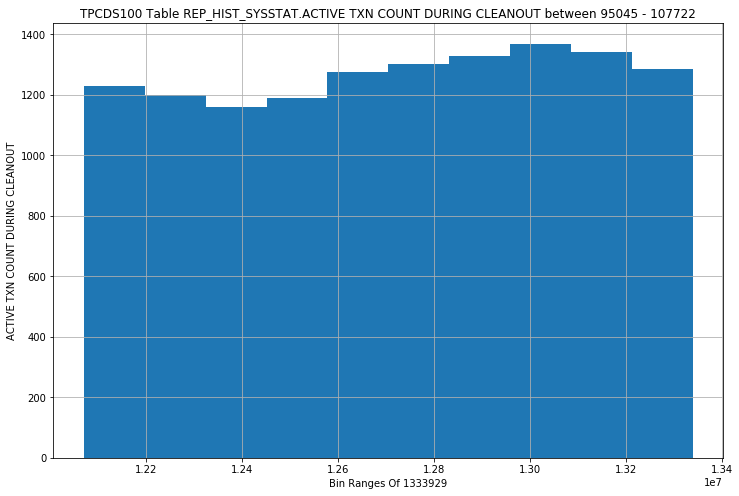

REP_HIST_SYSSTAT - APPLICATION WAIT TIME - OUTLIERS HISTOGRAM


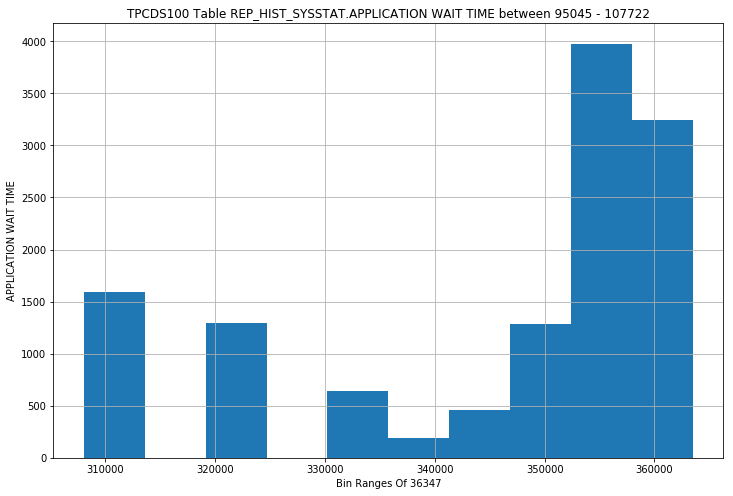

REP_HIST_SYSSTAT - BACKGROUND CHECKPOINTS COMPLETED - OUTLIERS HISTOGRAM


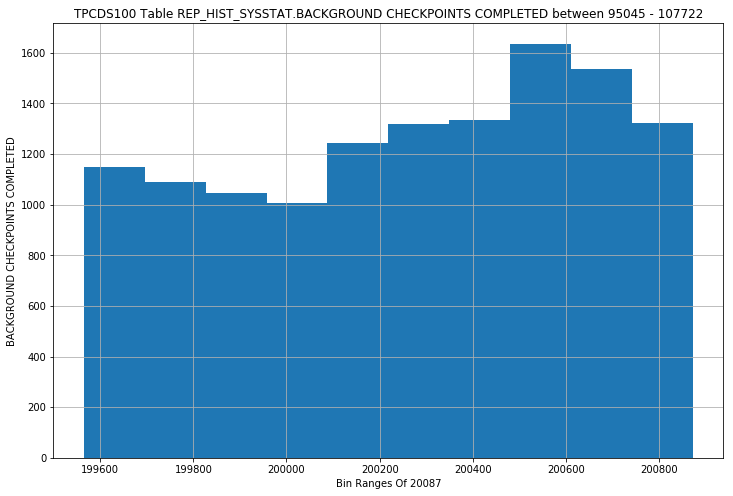

REP_HIST_SYSSTAT - BACKGROUND CHECKPOINTS STARTED - OUTLIERS HISTOGRAM


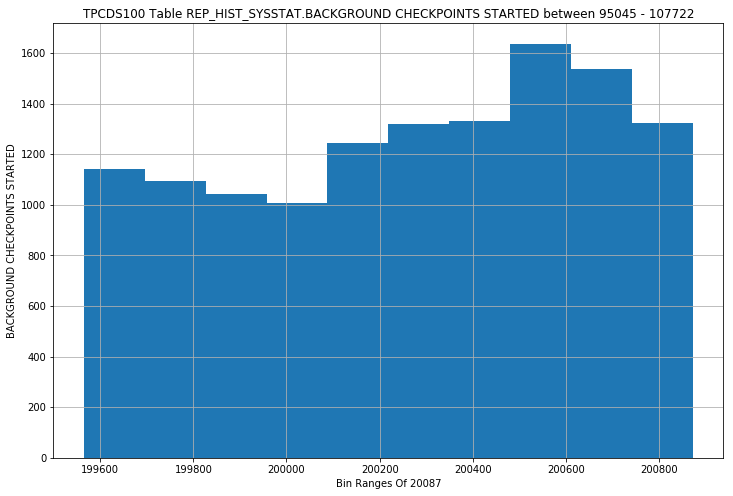

REP_HIST_SYSSTAT - BACKGROUND TIMEOUTS - OUTLIERS HISTOGRAM


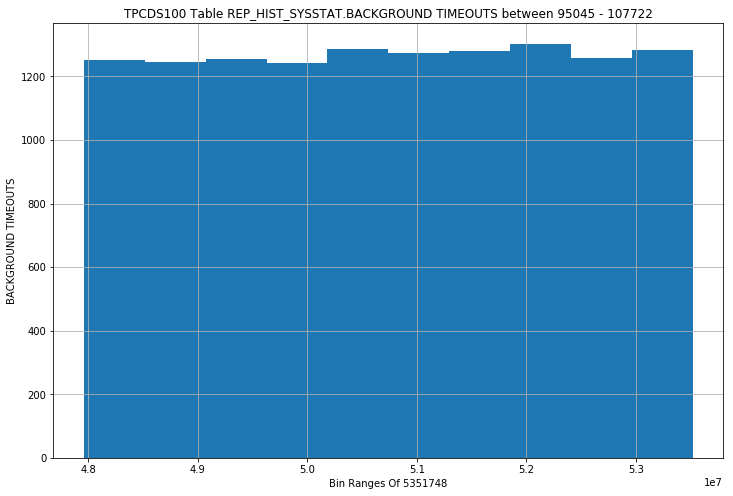

REP_HIST_SYSSTAT - BRANCH NODE SPLITS - OUTLIERS HISTOGRAM


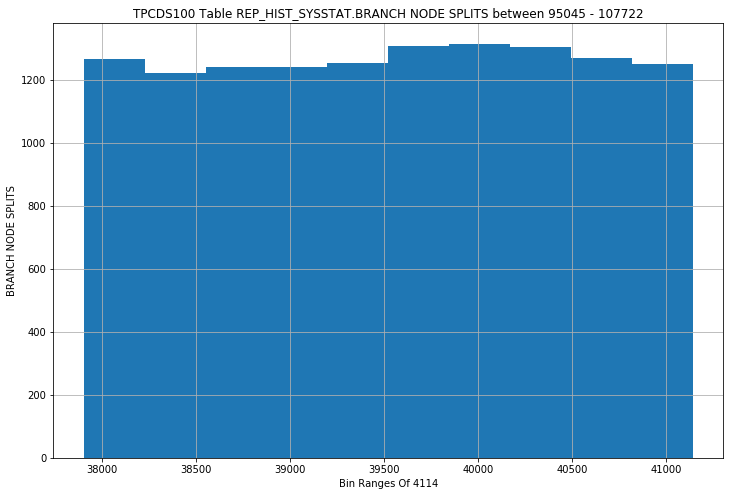

REP_HIST_SYSSTAT - BUFFER IS NOT PINNED COUNT - OUTLIERS HISTOGRAM


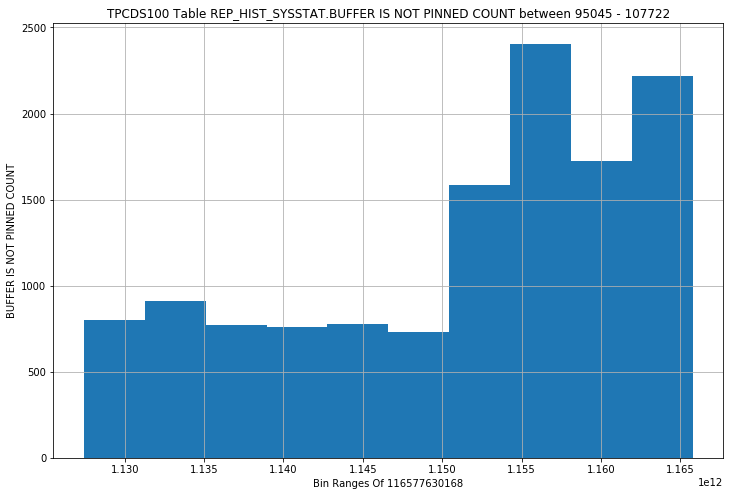

REP_HIST_SYSSTAT - BUFFER IS PINNED COUNT - OUTLIERS HISTOGRAM


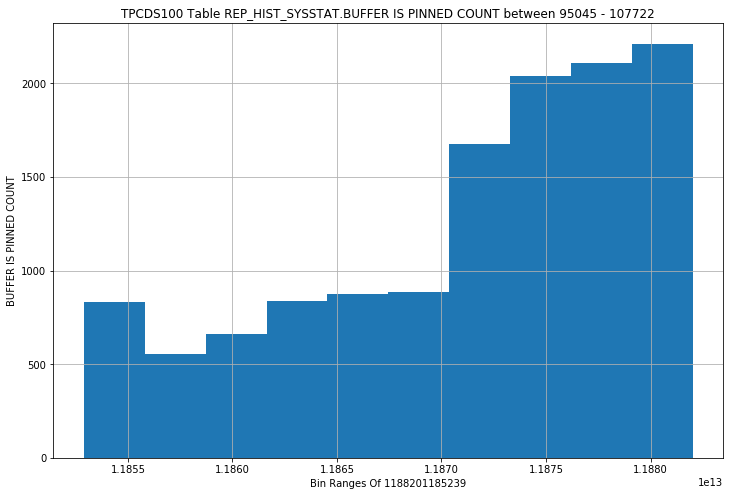

REP_HIST_SYSSTAT - BYTES RECEIVED VIA SQL*NET FROM CLIENT - OUTLIERS HISTOGRAM


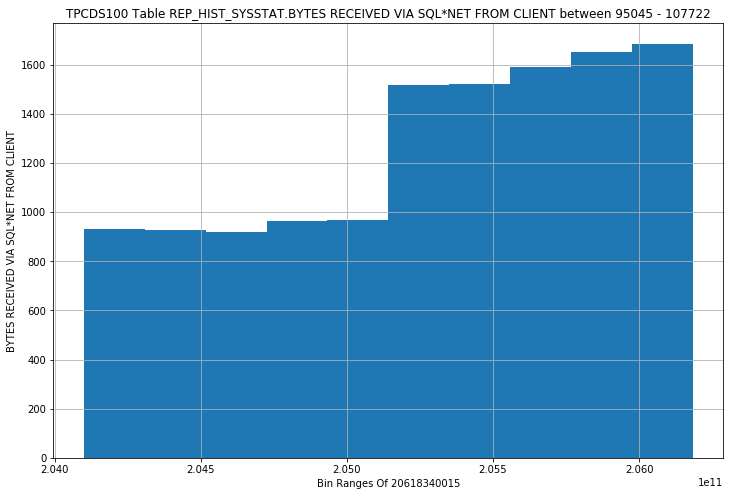

REP_HIST_SYSSTAT - BYTES SENT VIA SQL*NET TO CLIENT - OUTLIERS HISTOGRAM


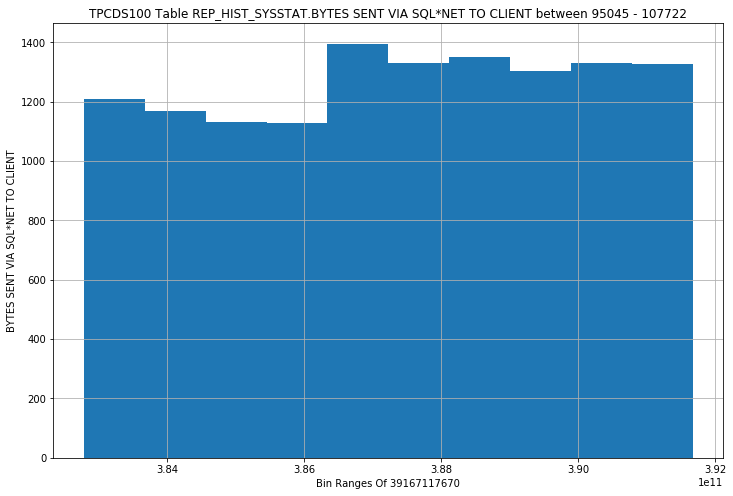

REP_HIST_SYSSTAT - BYTES VIA SQL*NET VECTOR TO CLIENT - OUTLIERS HISTOGRAM


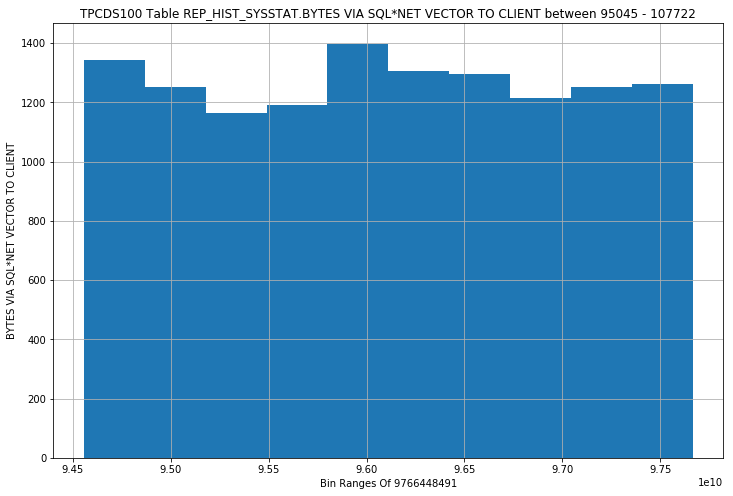

REP_HIST_SYSSTAT - CALLS TO GET SNAPSHOT SCN: KCMGSS - OUTLIERS HISTOGRAM


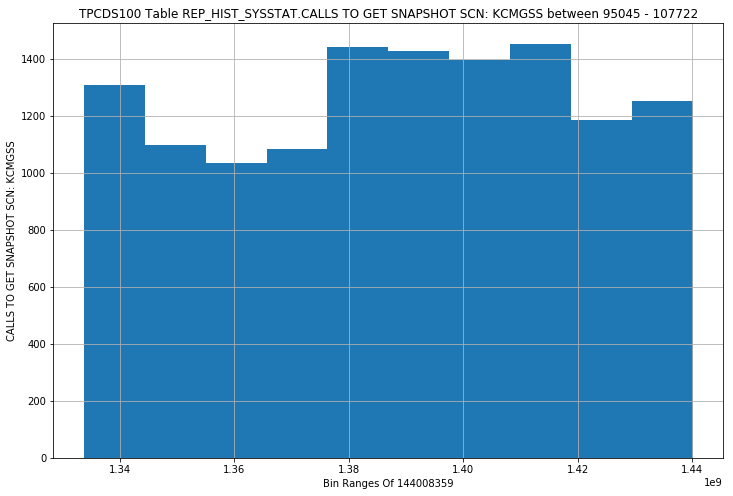

REP_HIST_SYSSTAT - CALLS TO KCMGAS - OUTLIERS HISTOGRAM


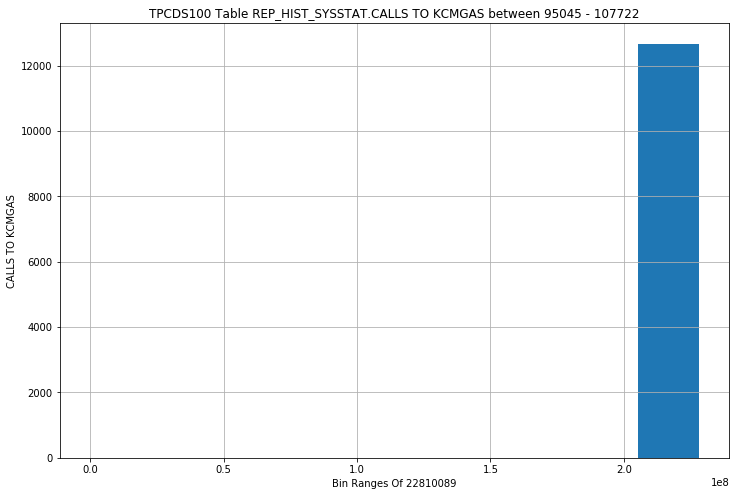

REP_HIST_SYSSTAT - CALLS TO KCMGCS - OUTLIERS HISTOGRAM


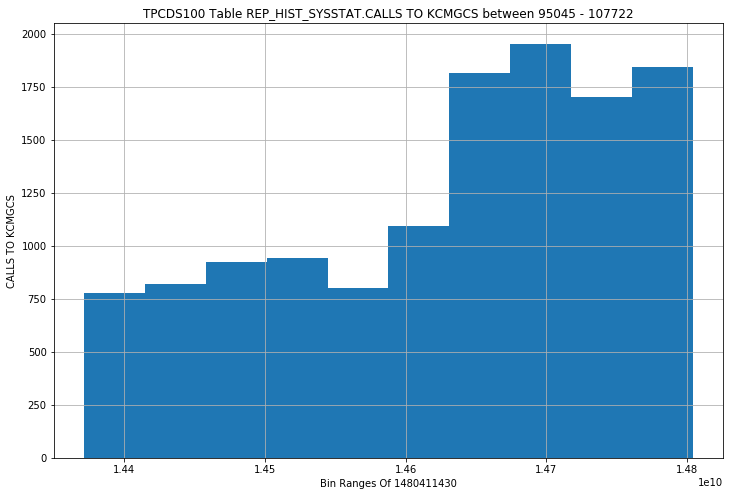

REP_HIST_SYSSTAT - CELL PHYSICAL IO INTERCONNECT BYTES - OUTLIERS HISTOGRAM


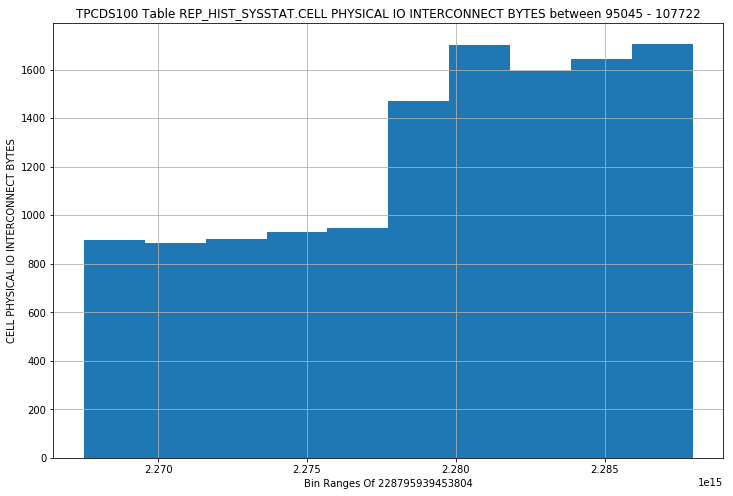

REP_HIST_SYSSTAT - CHANGE WRITE TIME - OUTLIERS HISTOGRAM


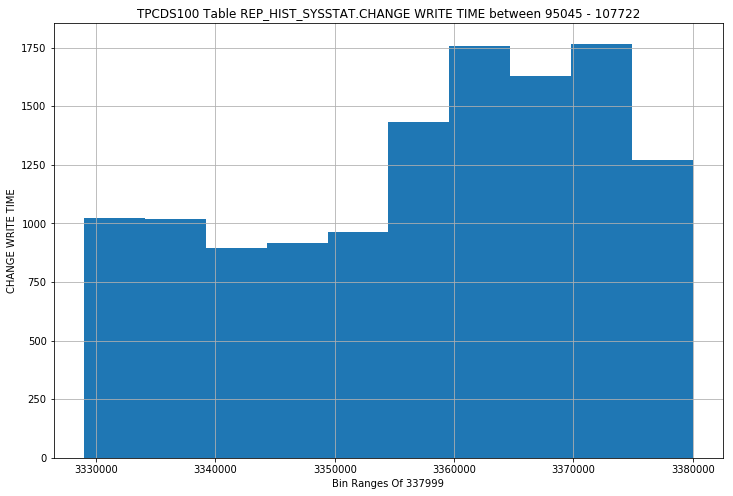

REP_HIST_SYSSTAT - CLEANOUT - NUMBER OF KTUGCT CALLS - OUTLIERS HISTOGRAM


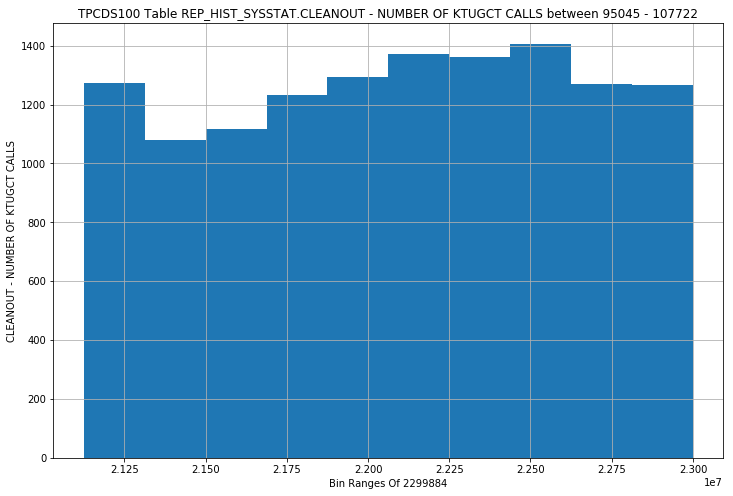

REP_HIST_SYSSTAT - CLEANOUTS AND ROLLBACKS - CONSISTENT READ GETS - OUTLIERS HISTOGRAM


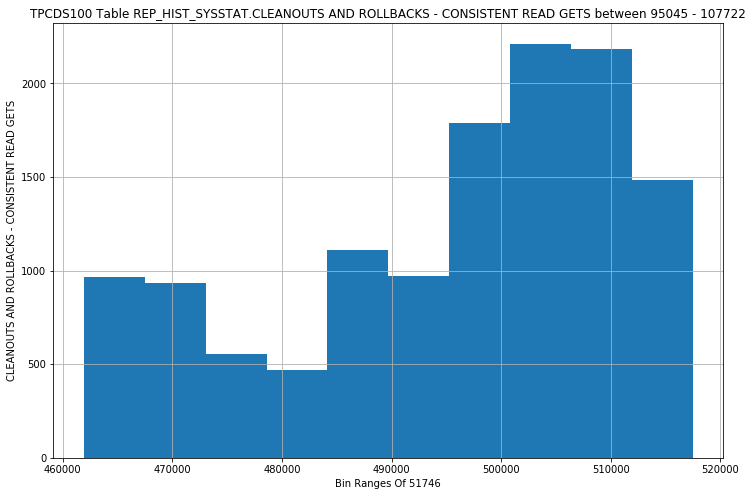

REP_HIST_SYSSTAT - CLEANOUTS ONLY - CONSISTENT READ GETS - OUTLIERS HISTOGRAM


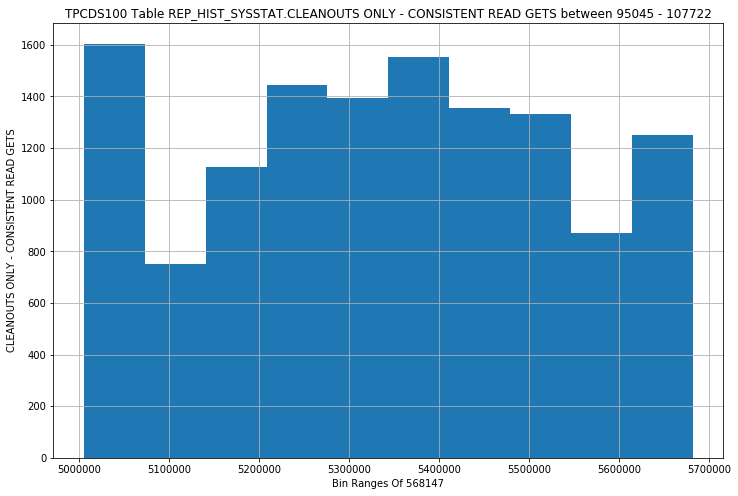

REP_HIST_SYSSTAT - CLUSTER KEY SCAN BLOCK GETS - OUTLIERS HISTOGRAM


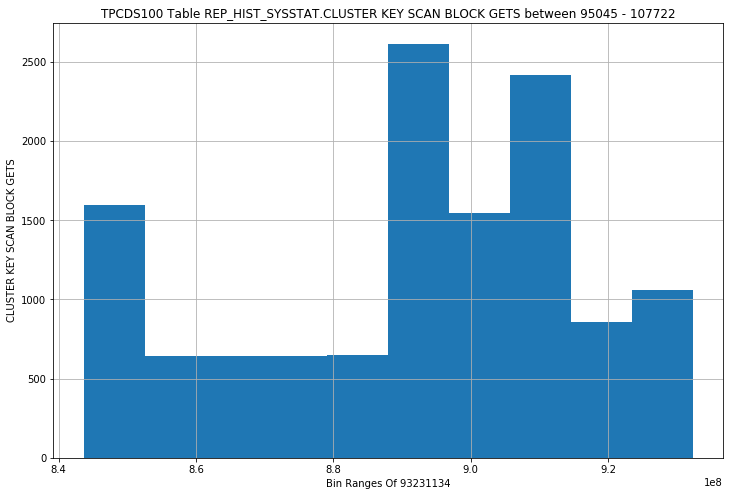

REP_HIST_SYSSTAT - CLUSTER KEY SCANS - OUTLIERS HISTOGRAM


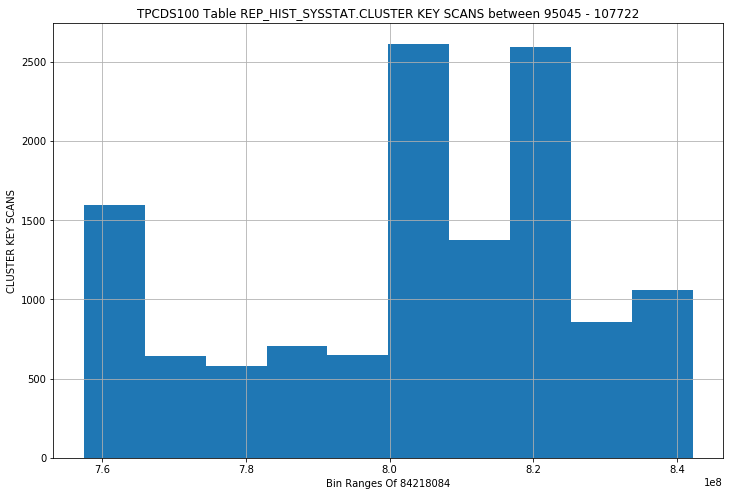

REP_HIST_SYSSTAT - COMMIT BATCH/IMMEDIATE PERFORMED - OUTLIERS HISTOGRAM


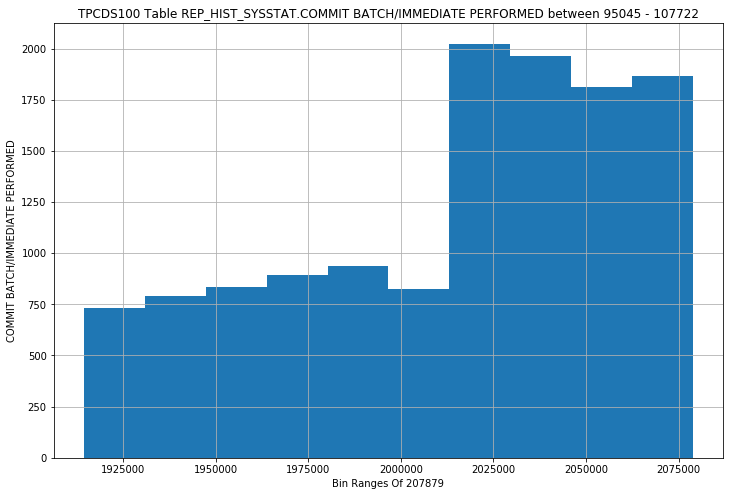

REP_HIST_SYSSTAT - COMMIT BATCH/IMMEDIATE REQUESTED - OUTLIERS HISTOGRAM


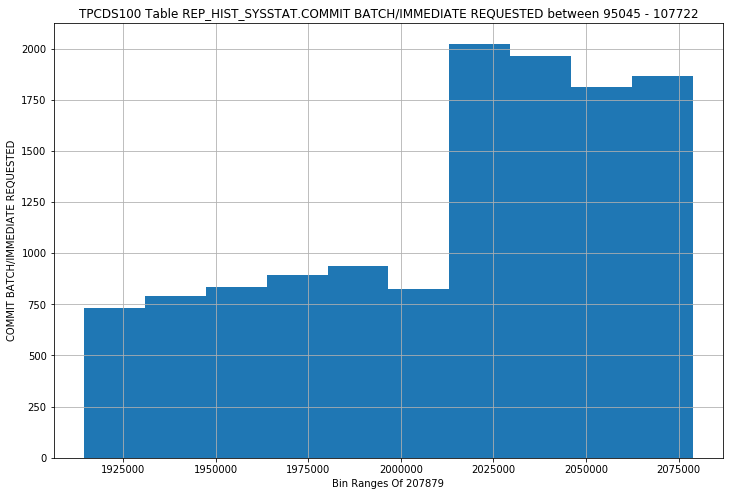

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: BLOCK LOST - OUTLIERS HISTOGRAM


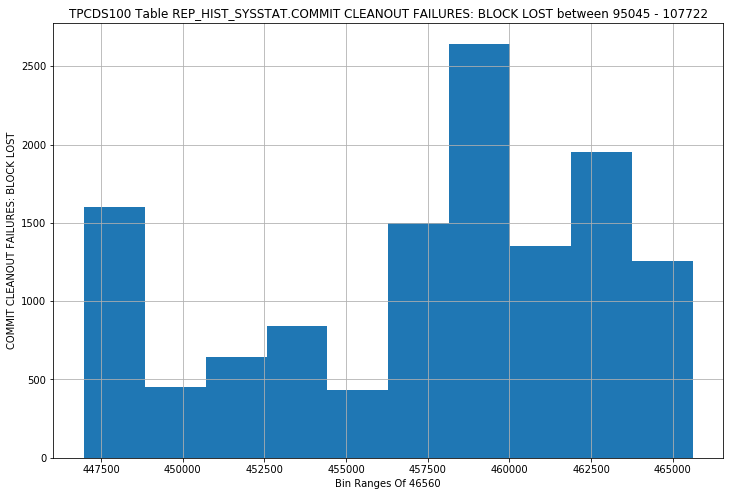

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: BUFFER BEING WRITTEN - OUTLIERS HISTOGRAM


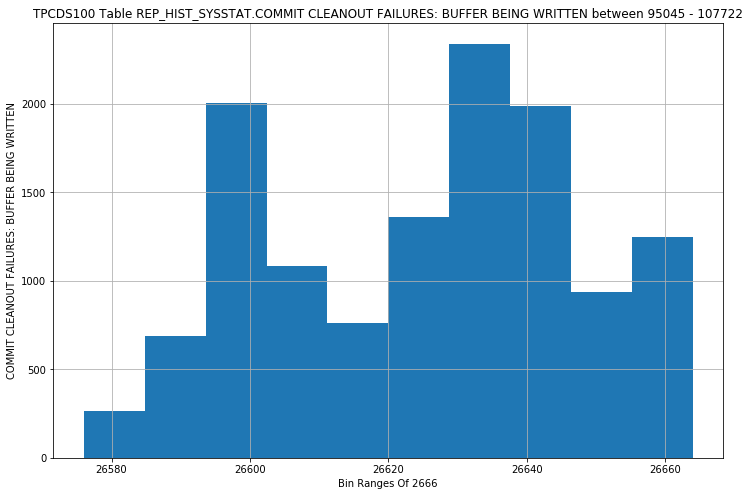

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: CALLBACK FAILURE  - OUTLIERS HISTOGRAM


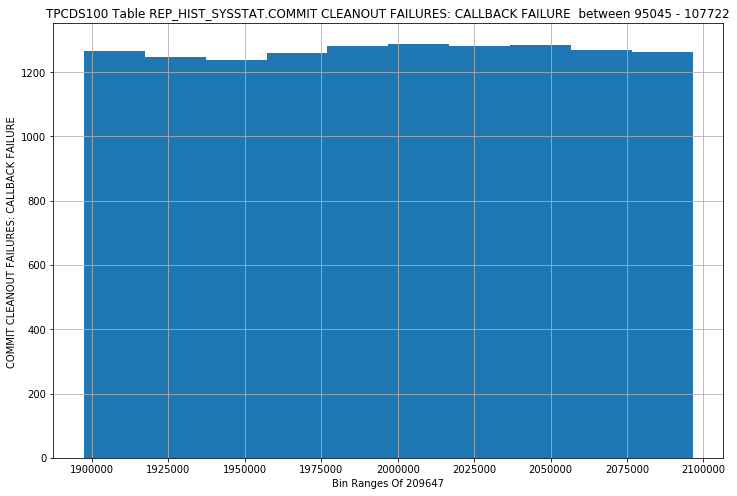

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: CANNOT PIN - OUTLIERS HISTOGRAM


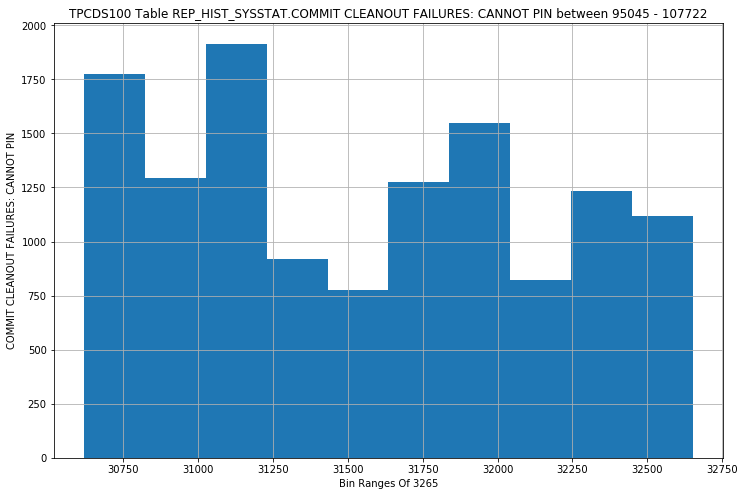

REP_HIST_SYSSTAT - COMMIT CLEANOUTS - OUTLIERS HISTOGRAM


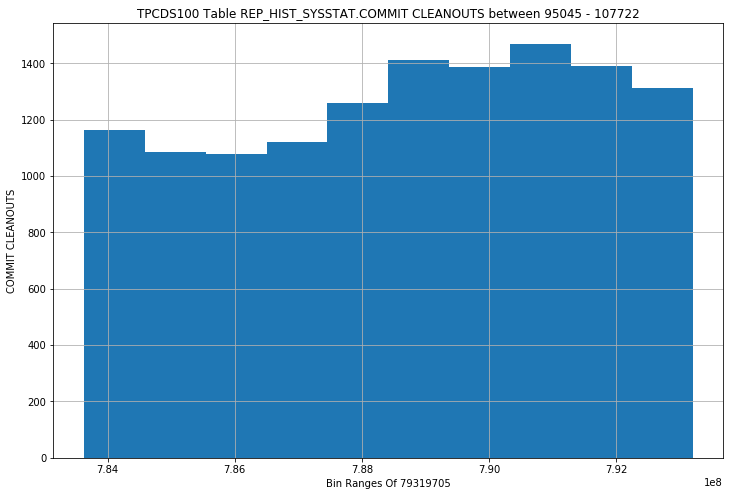

REP_HIST_SYSSTAT - COMMIT CLEANOUTS SUCCESSFULLY COMPLETED - OUTLIERS HISTOGRAM


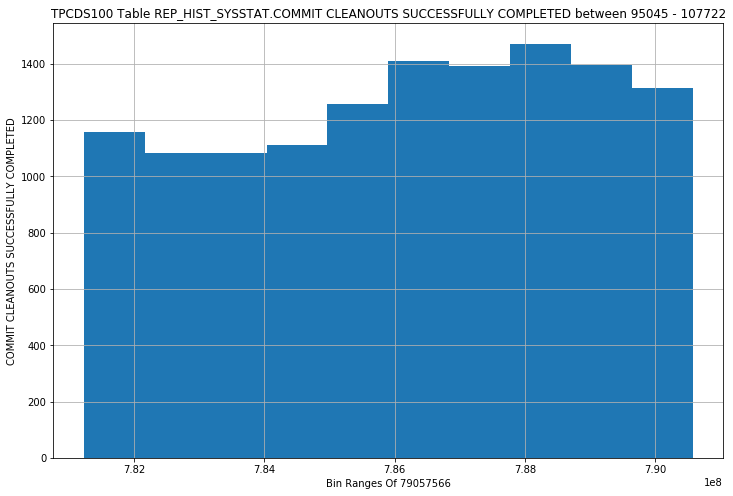

REP_HIST_SYSSTAT - COMMIT IMMEDIATE PERFORMED - OUTLIERS HISTOGRAM


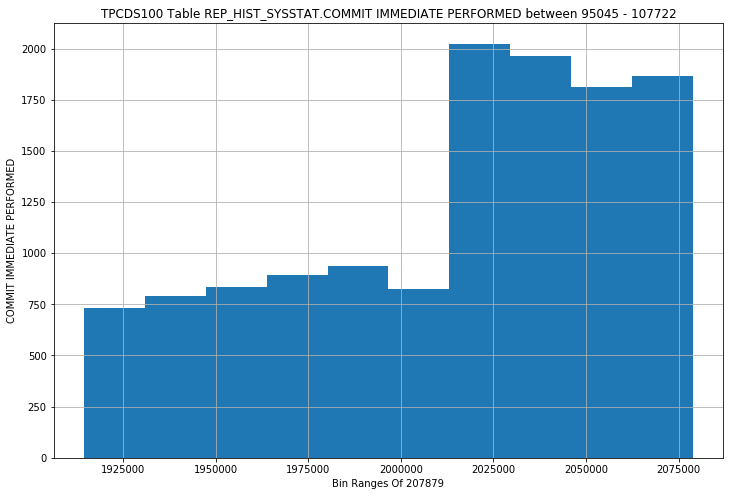

REP_HIST_SYSSTAT - COMMIT IMMEDIATE REQUESTED - OUTLIERS HISTOGRAM


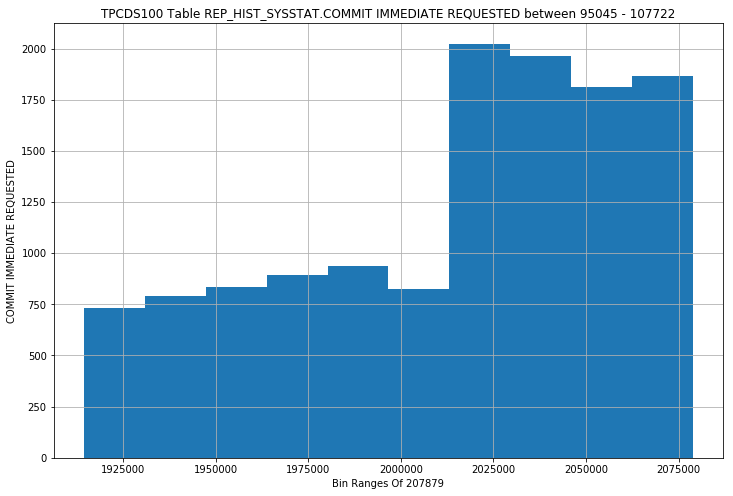

REP_HIST_SYSSTAT - COMMIT TXN COUNT DURING CLEANOUT - OUTLIERS HISTOGRAM


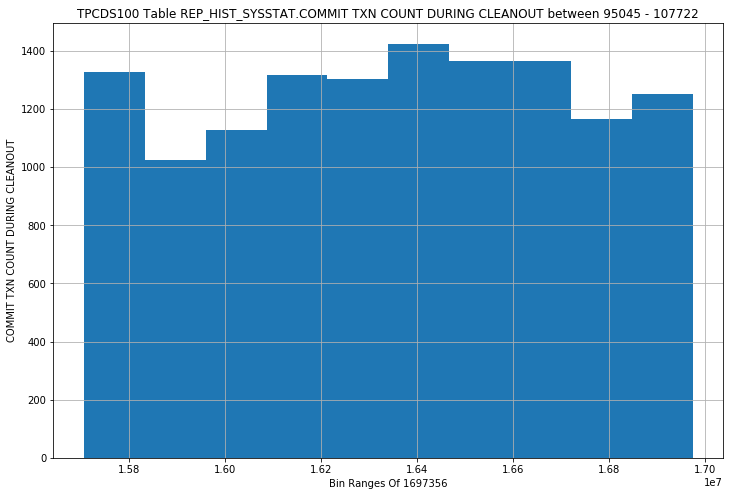

REP_HIST_SYSSTAT - CONCURRENCY WAIT TIME - OUTLIERS HISTOGRAM


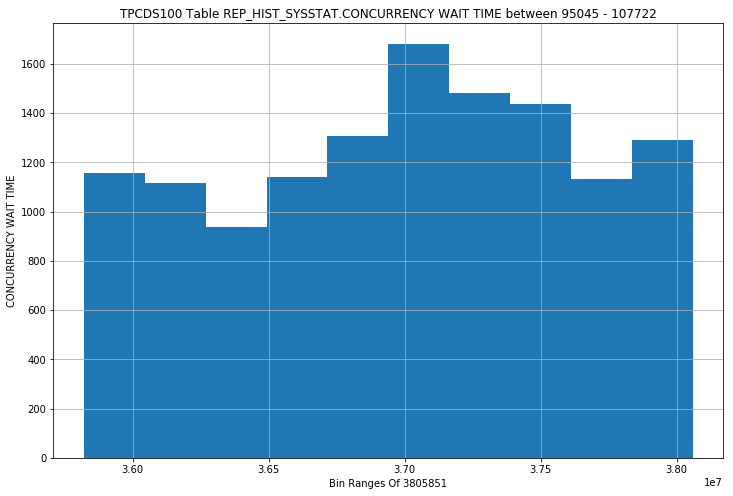

REP_HIST_SYSSTAT - CONSISTENT CHANGES - OUTLIERS HISTOGRAM


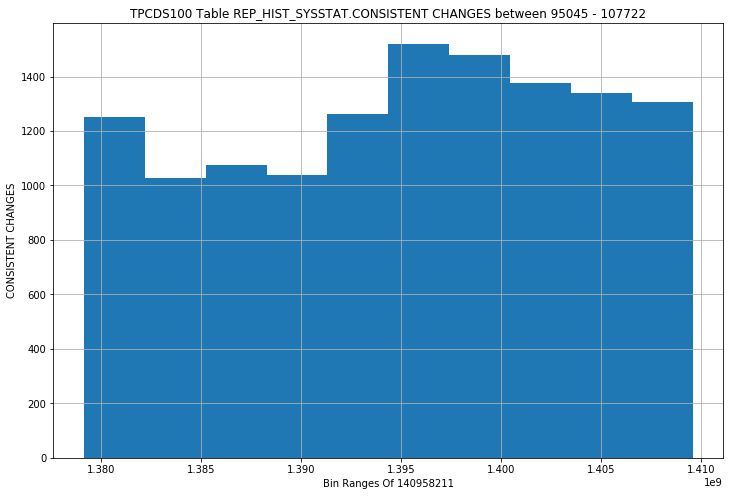

REP_HIST_SYSSTAT - CONSISTENT GETS - OUTLIERS HISTOGRAM


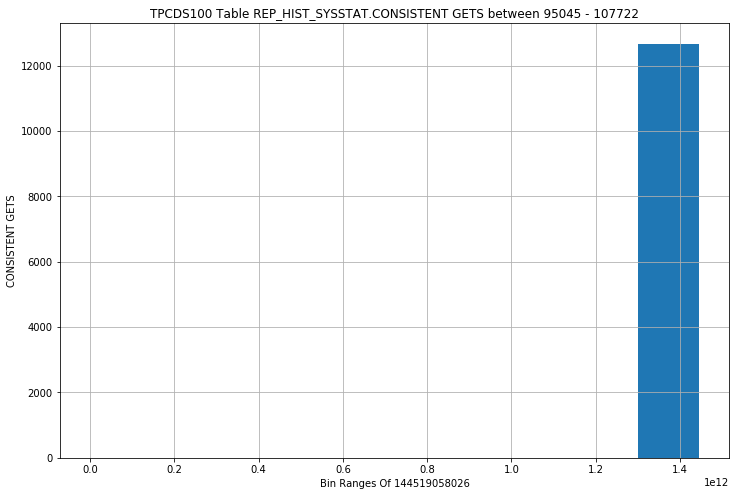

REP_HIST_SYSSTAT - CONSISTENT GETS DIRECT - OUTLIERS HISTOGRAM


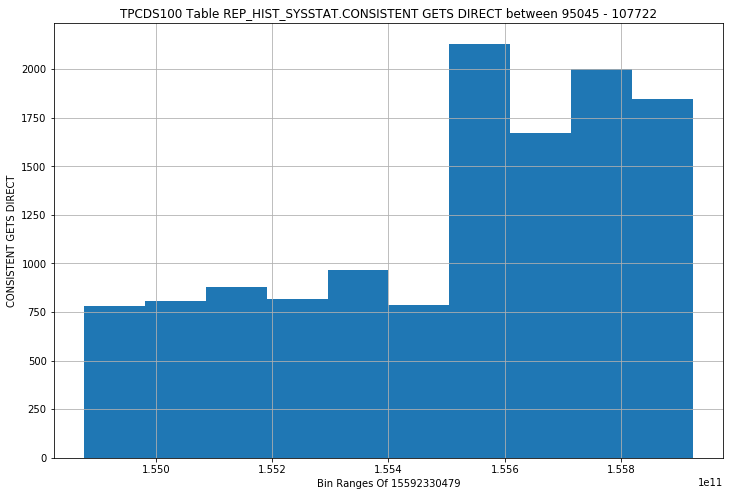

REP_HIST_SYSSTAT - CONSISTENT GETS EXAMINATION - OUTLIERS HISTOGRAM


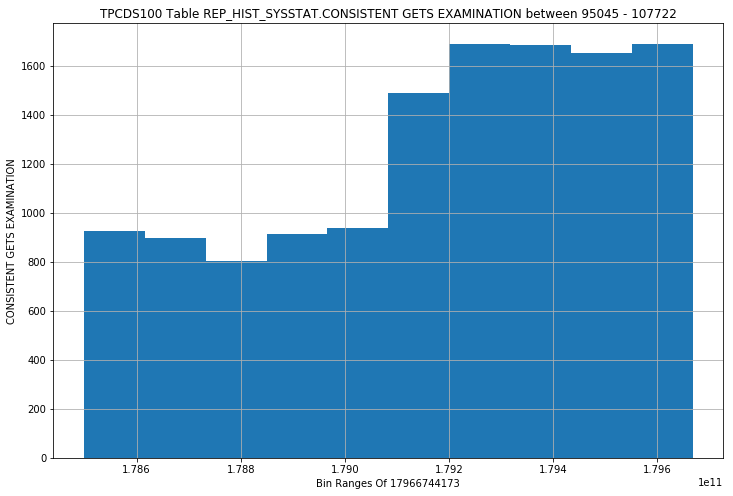

REP_HIST_SYSSTAT - CONSISTENT GETS EXAMINATION (FASTPATH) - OUTLIERS HISTOGRAM


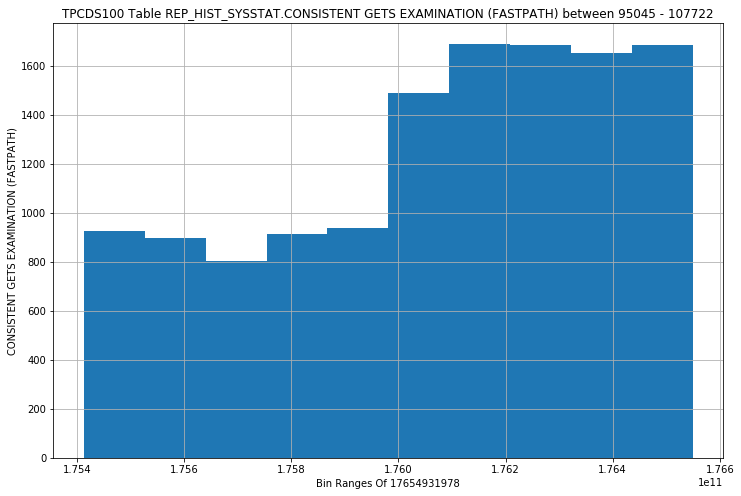

REP_HIST_SYSSTAT - CONSISTENT GETS FROM CACHE - OUTLIERS HISTOGRAM


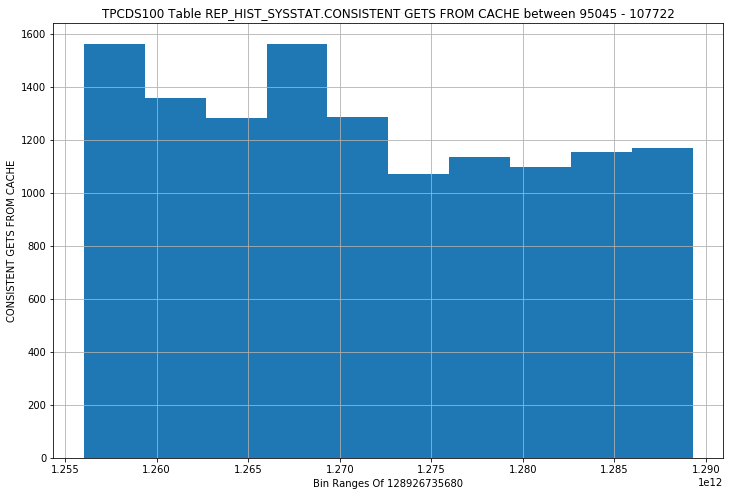

REP_HIST_SYSSTAT - CONSISTENT GETS PIN - OUTLIERS HISTOGRAM


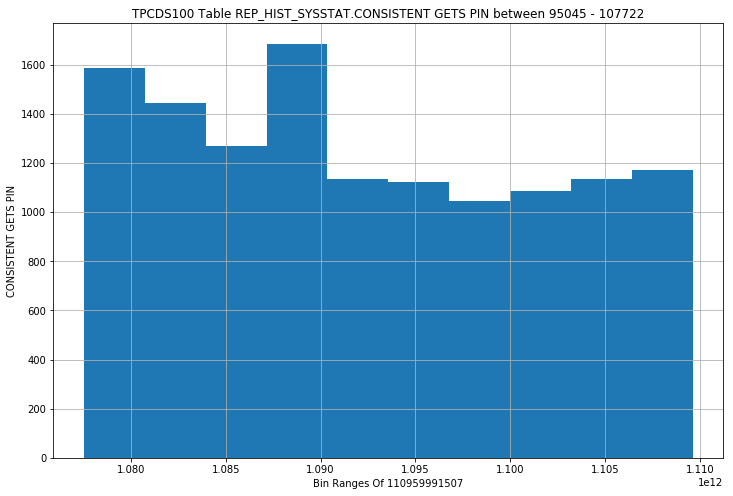

REP_HIST_SYSSTAT - CONSISTENT GETS PIN (FASTPATH) - OUTLIERS HISTOGRAM


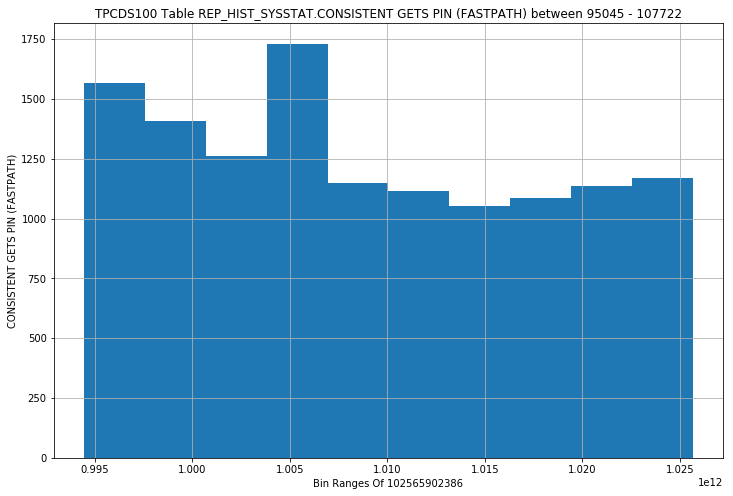

REP_HIST_SYSSTAT - CURSOR AUTHENTICATIONS - OUTLIERS HISTOGRAM


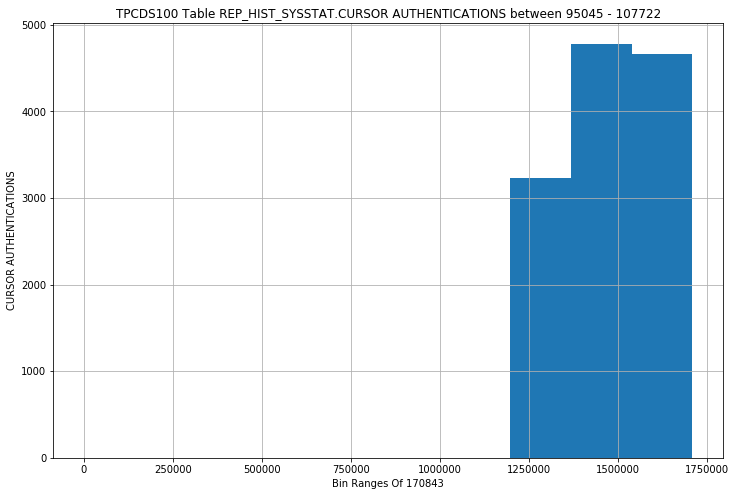

REP_HIST_SYSSTAT - CURSOR RELOAD FAILURES - OUTLIERS HISTOGRAM


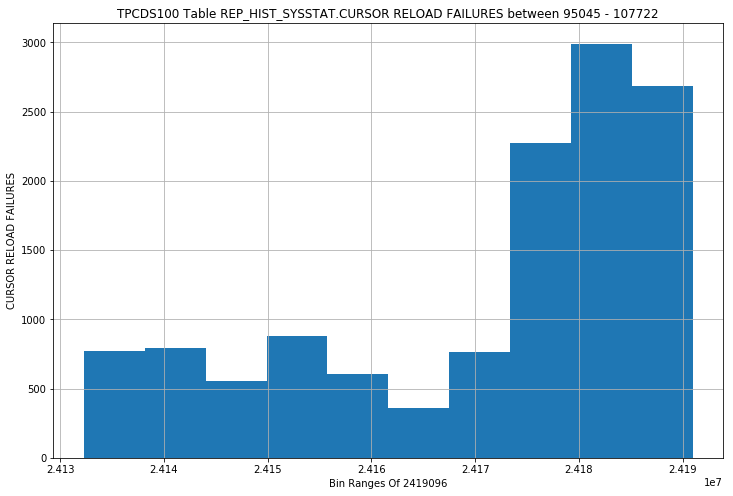

REP_HIST_SYSSTAT - DATA BLOCKS CONSISTENT READS - UNDO RECORDS APPLIED - OUTLIERS HISTOGRAM


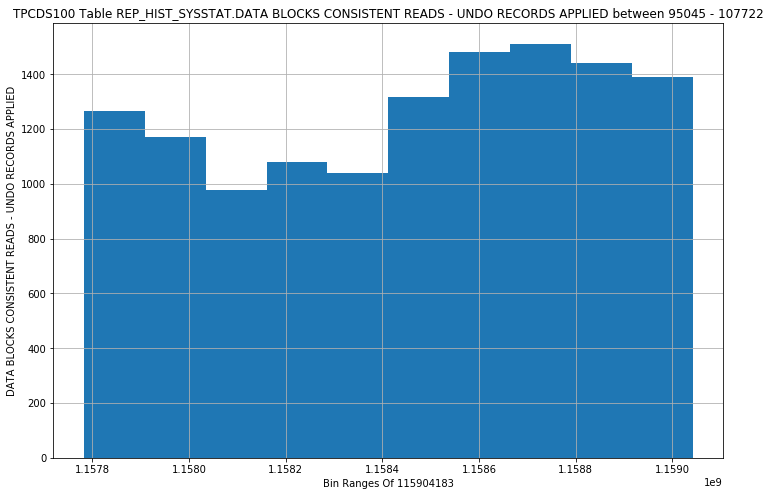

REP_HIST_SYSSTAT - DB BLOCK CHANGES - OUTLIERS HISTOGRAM


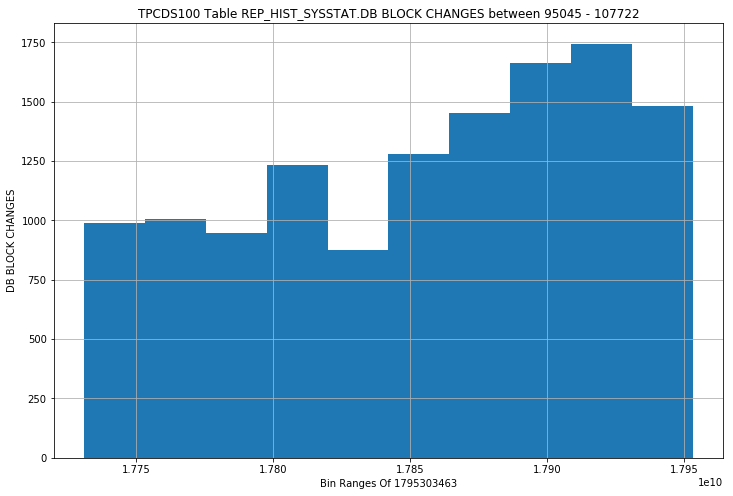

REP_HIST_SYSSTAT - DB BLOCK GETS - OUTLIERS HISTOGRAM


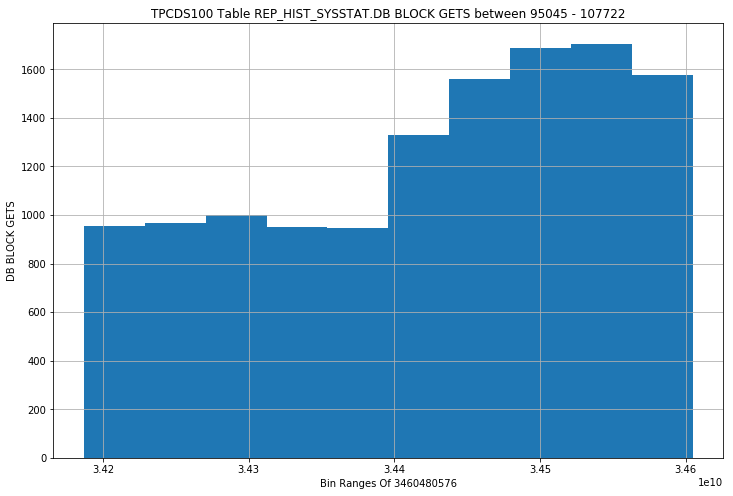

REP_HIST_SYSSTAT - DB BLOCK GETS DIRECT - OUTLIERS HISTOGRAM


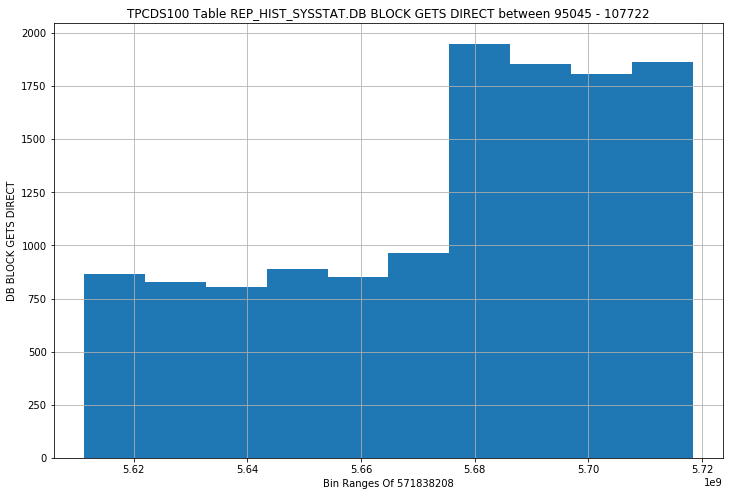

REP_HIST_SYSSTAT - DB BLOCK GETS FROM CACHE - OUTLIERS HISTOGRAM


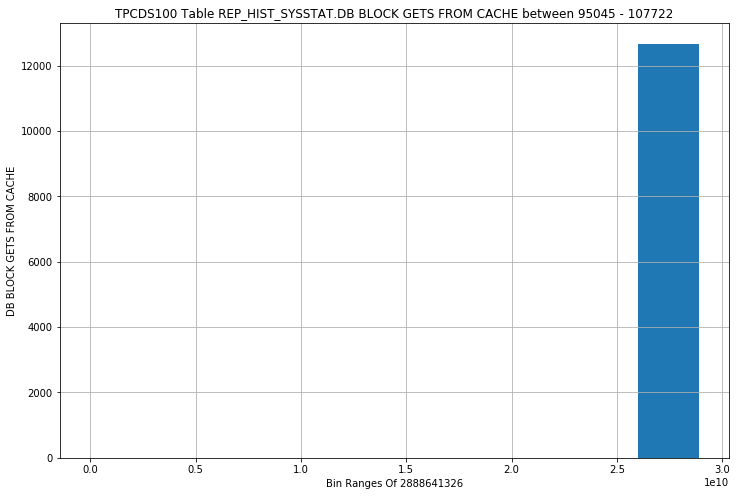

REP_HIST_SYSSTAT - DB BLOCK GETS FROM CACHE (FASTPATH) - OUTLIERS HISTOGRAM


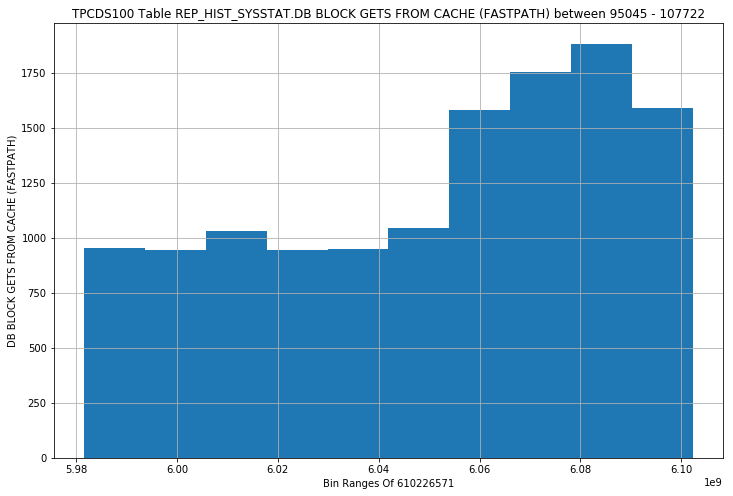

REP_HIST_SYSSTAT - DEFERRED (CURRENT) BLOCK CLEANOUT APPLICATIONS - OUTLIERS HISTOGRAM


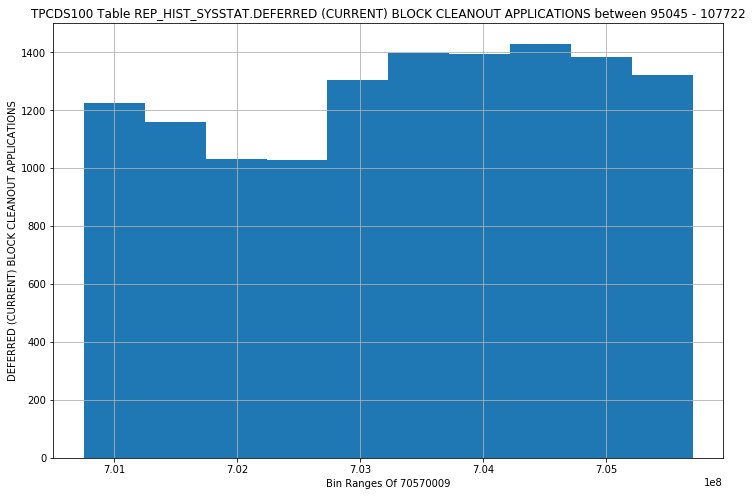

REP_HIST_SYSSTAT - DIRTY BUFFERS INSPECTED - OUTLIERS HISTOGRAM


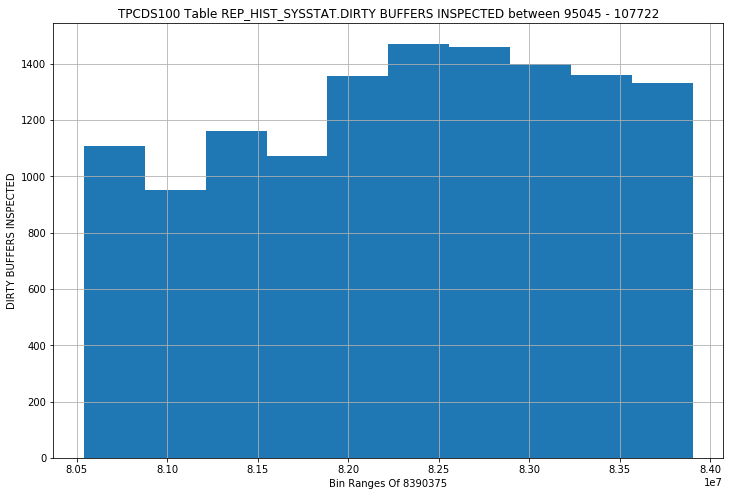

REP_HIST_SYSSTAT - ENQUEUE CONVERSIONS - OUTLIERS HISTOGRAM


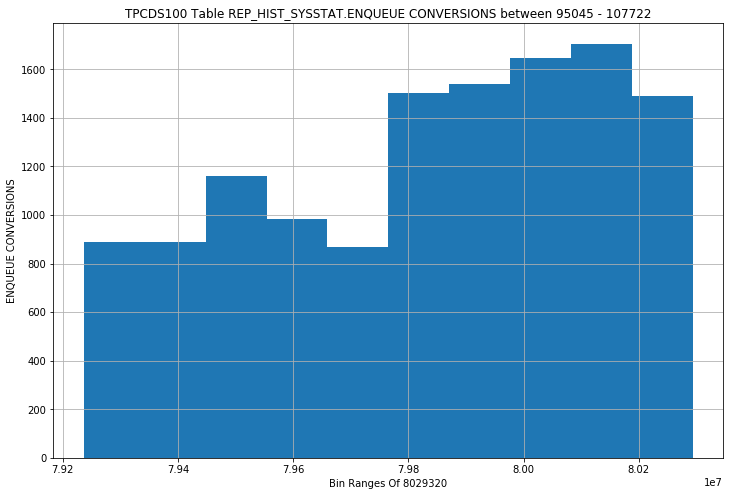

REP_HIST_SYSSTAT - ENQUEUE RELEASES - OUTLIERS HISTOGRAM


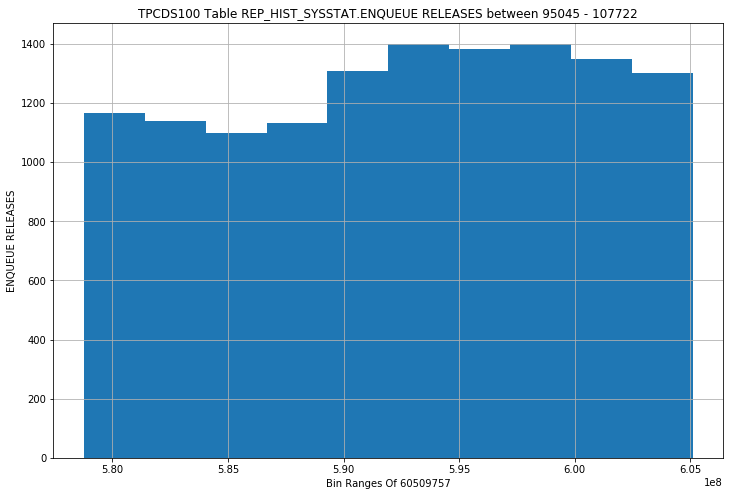

REP_HIST_SYSSTAT - ENQUEUE REQUESTS - OUTLIERS HISTOGRAM


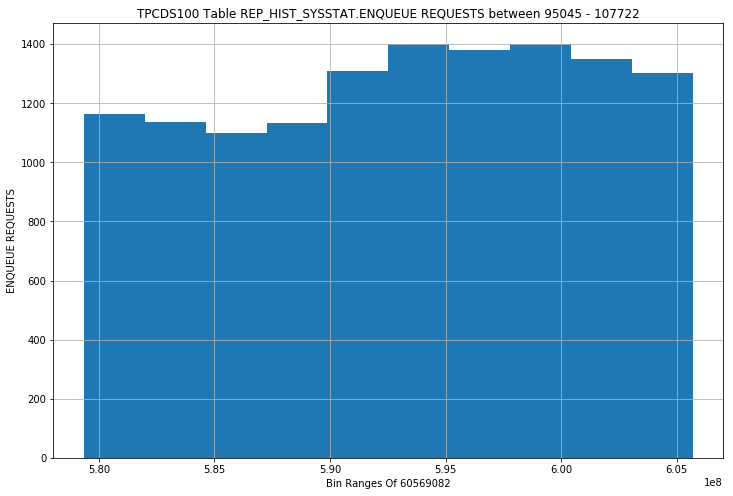

REP_HIST_SYSSTAT - ENQUEUE TIMEOUTS - OUTLIERS HISTOGRAM


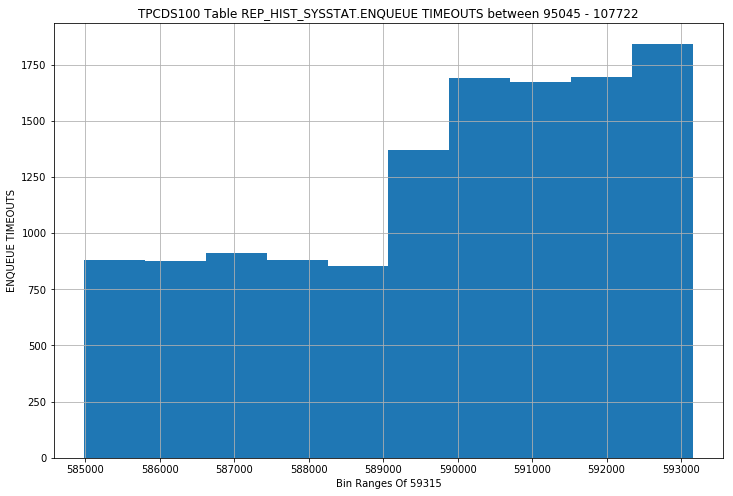

REP_HIST_SYSSTAT - ENQUEUE WAITS - OUTLIERS HISTOGRAM


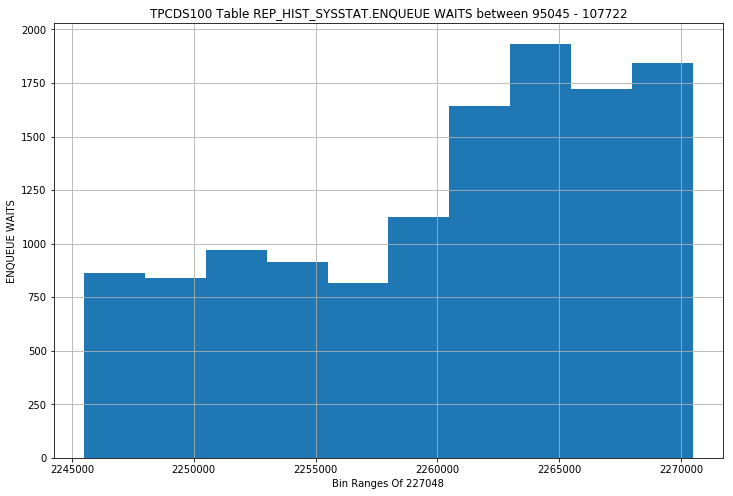

REP_HIST_SYSSTAT - EXCHANGE DEADLOCKS - OUTLIERS HISTOGRAM


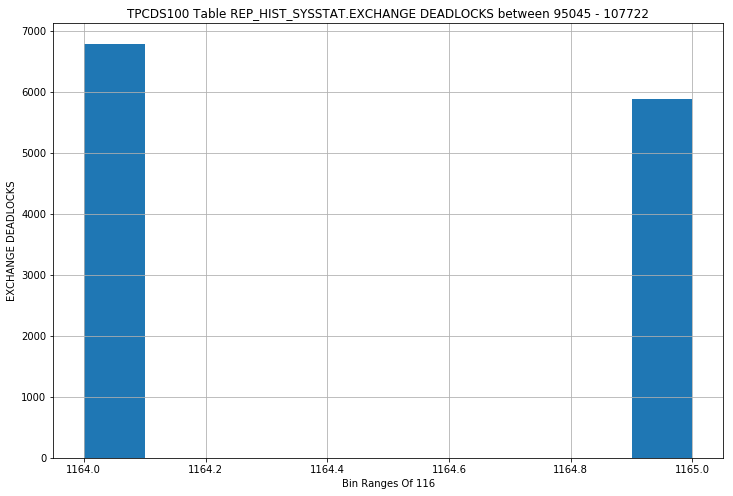

REP_HIST_SYSSTAT - EXECUTE COUNT - OUTLIERS HISTOGRAM


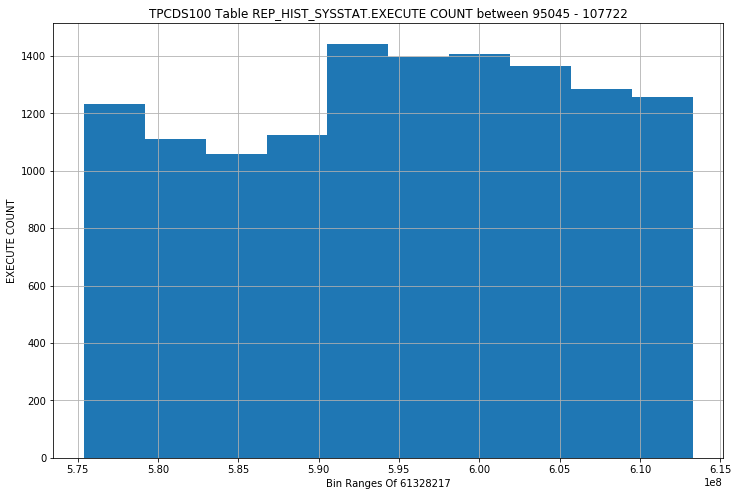

REP_HIST_SYSSTAT - FAILED PROBES ON INDEX BLOCK RECLAMATION - OUTLIERS HISTOGRAM


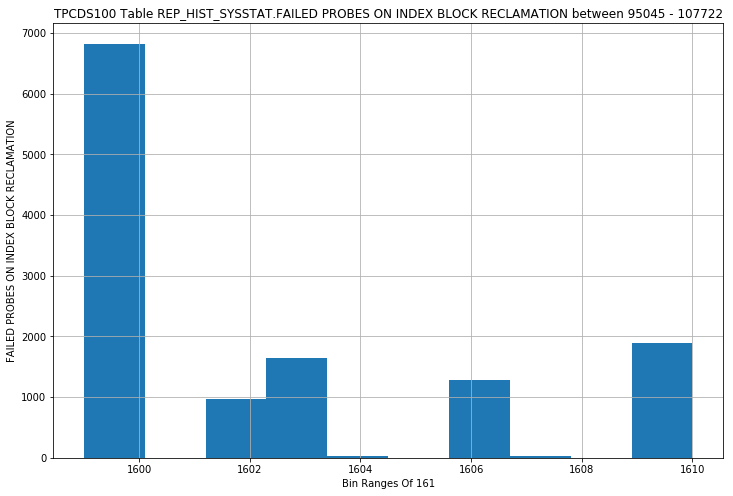

REP_HIST_SYSSTAT - FASTPATH CONSISTENT GET QUOTA LIMIT - OUTLIERS HISTOGRAM


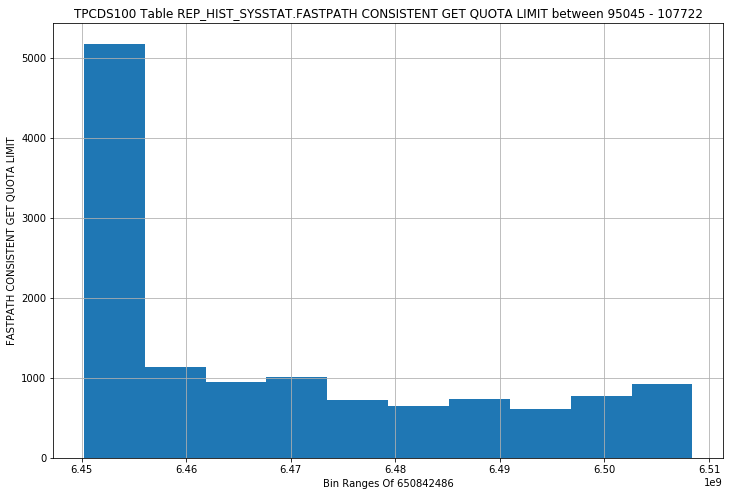

REP_HIST_SYSSTAT - FILE IO SERVICE TIME - OUTLIERS HISTOGRAM


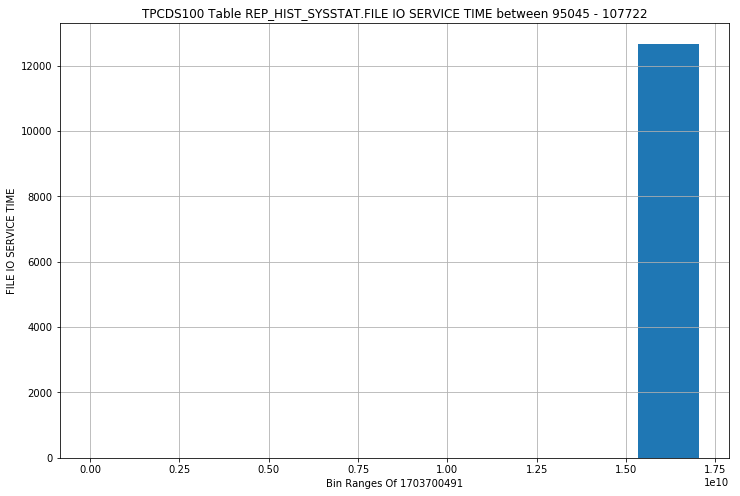

REP_HIST_SYSSTAT - FILE IO WAIT TIME - OUTLIERS HISTOGRAM


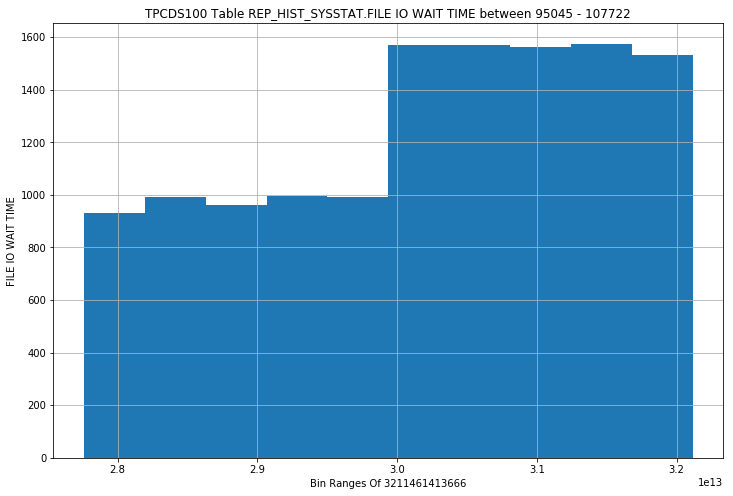

REP_HIST_SYSSTAT - FRAME SIGNATURE MISMATCH - OUTLIERS HISTOGRAM


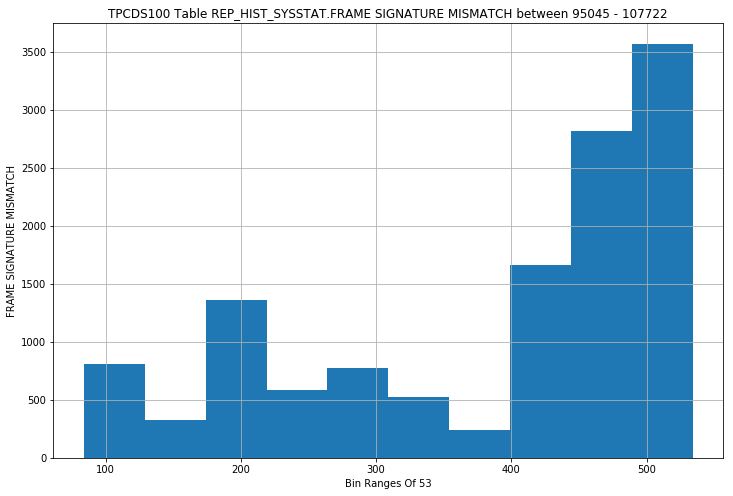

REP_HIST_SYSSTAT - FREE BUFFER INSPECTED - OUTLIERS HISTOGRAM


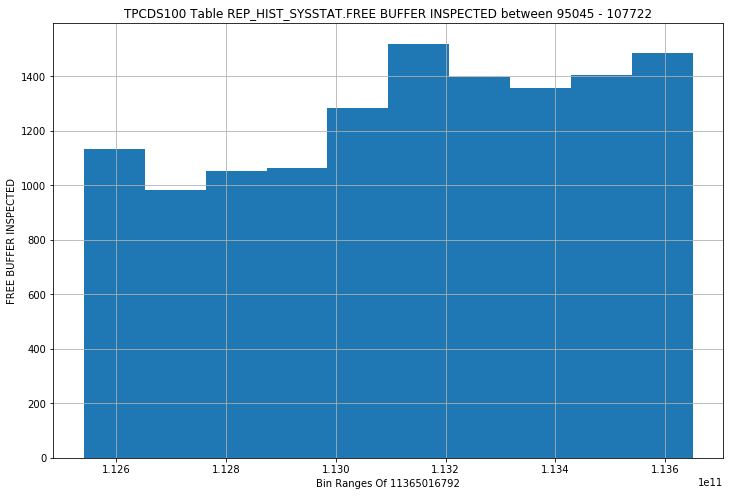

REP_HIST_SYSSTAT - FREE BUFFER REQUESTED - OUTLIERS HISTOGRAM


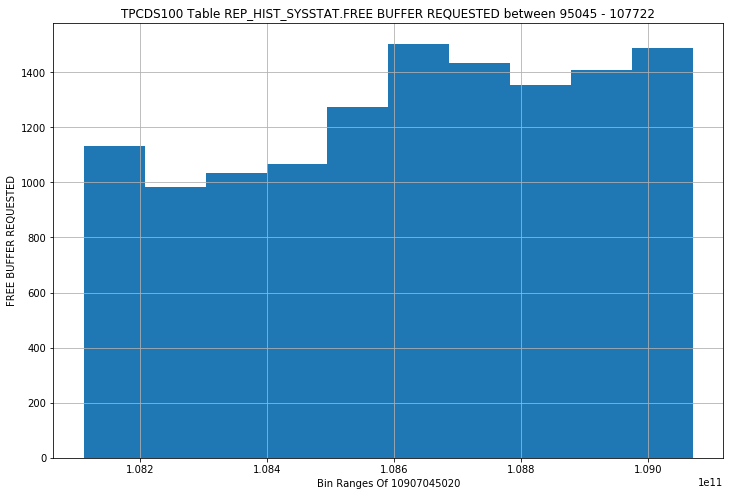

REP_HIST_SYSSTAT - HEAP BLOCK COMPRESS - OUTLIERS HISTOGRAM


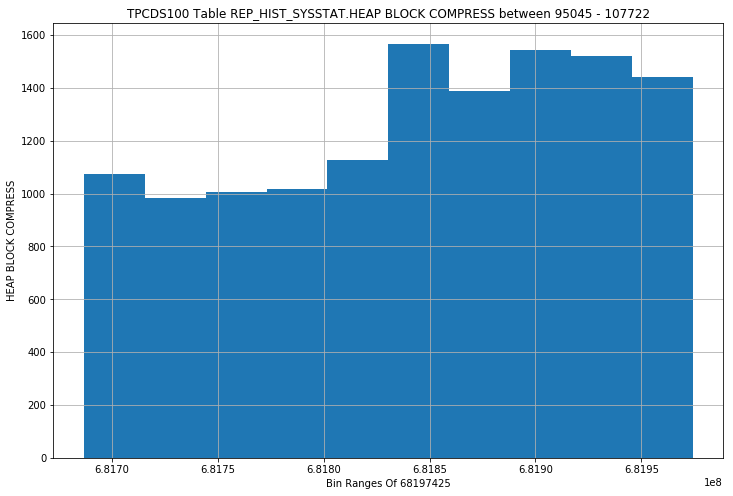

REP_HIST_SYSSTAT - HOT BUFFERS MOVED TO HEAD OF LRU - OUTLIERS HISTOGRAM


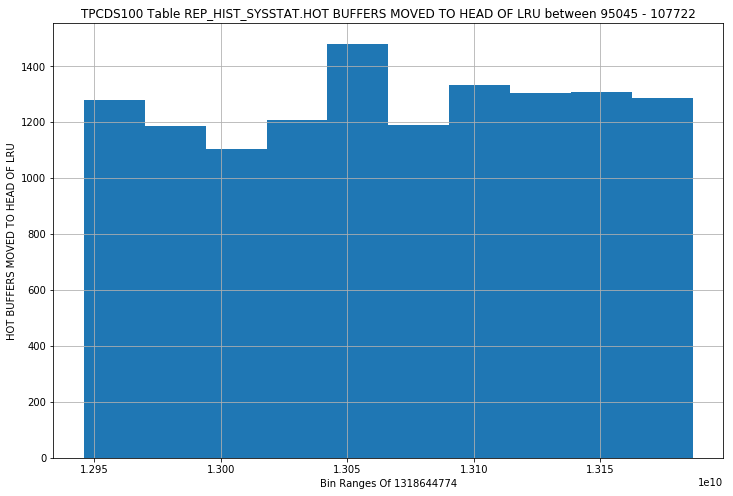

REP_HIST_SYSSTAT - IMMEDIATE (CR) BLOCK CLEANOUT APPLICATIONS - OUTLIERS HISTOGRAM


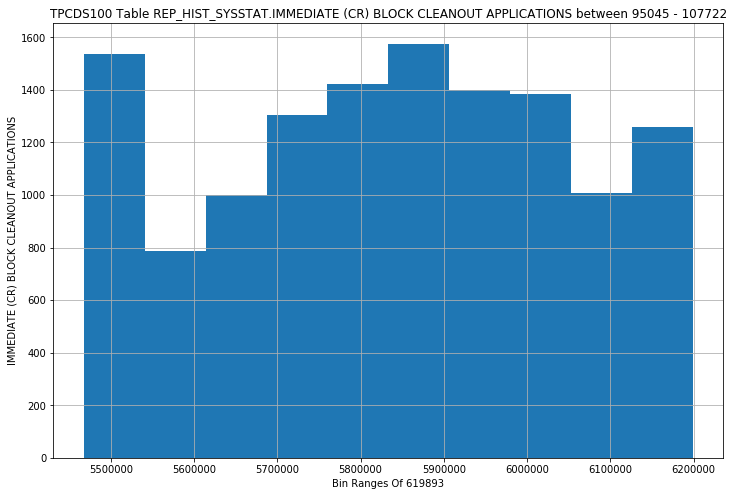

REP_HIST_SYSSTAT - IMMEDIATE (CURRENT) BLOCK CLEANOUT APPLICATIONS - OUTLIERS HISTOGRAM


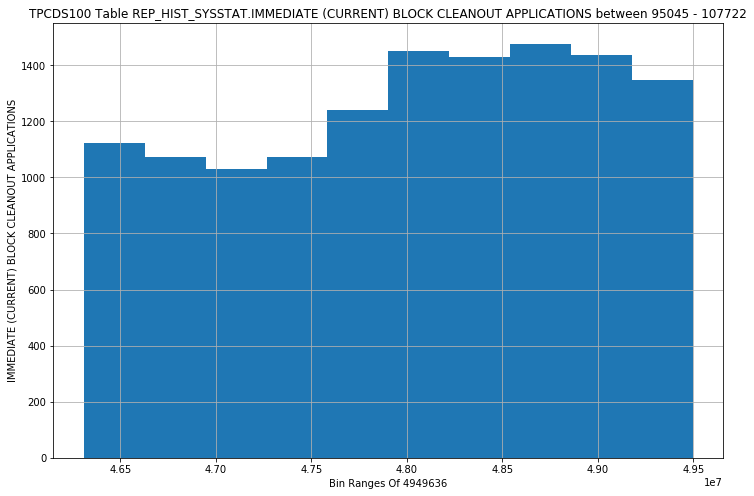

REP_HIST_SYSSTAT - IN CALL IDLE WAIT TIME - OUTLIERS HISTOGRAM


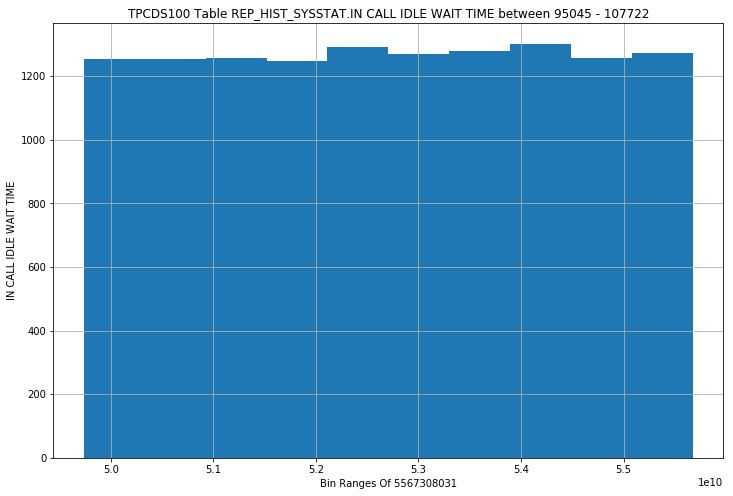

REP_HIST_SYSSTAT - INDEX CRX UPGRADE (POSITIONED) - OUTLIERS HISTOGRAM


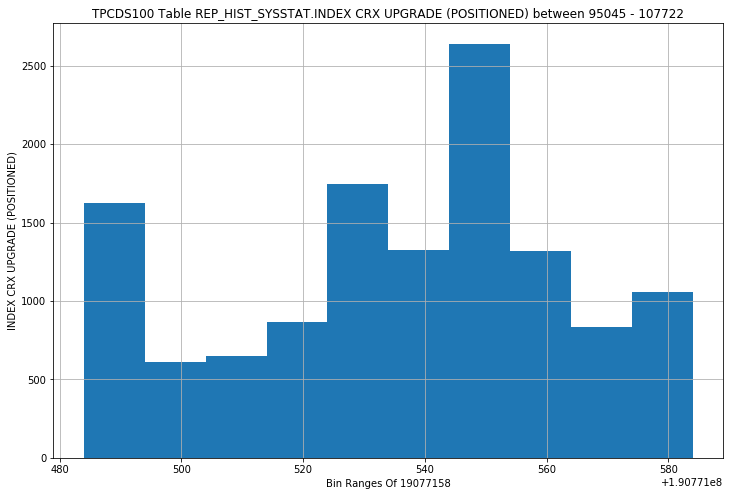

REP_HIST_SYSSTAT - INDEX CRX UPGRADE (PREFETCH) - OUTLIERS HISTOGRAM


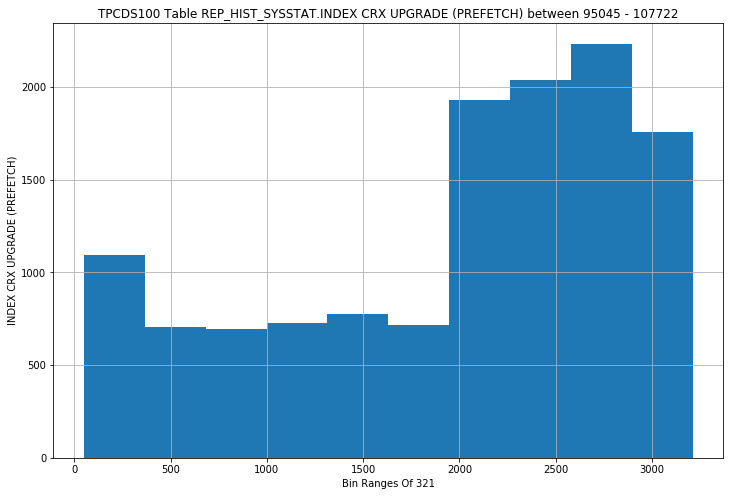

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (DIRECT READ) - OUTLIERS HISTOGRAM


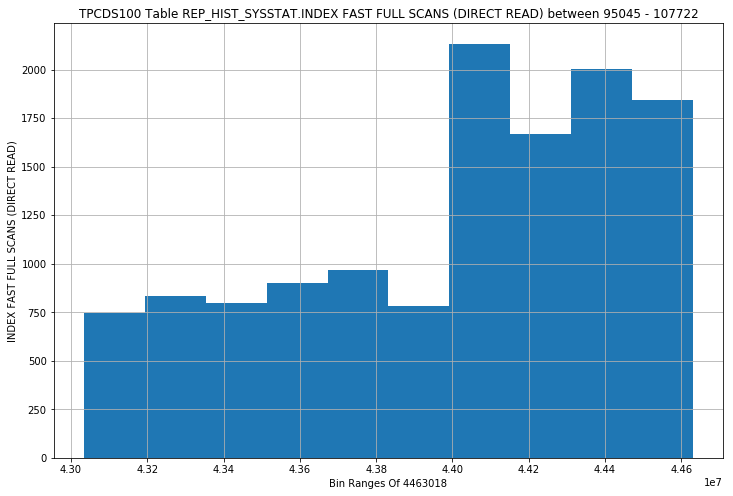

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (FULL) - OUTLIERS HISTOGRAM


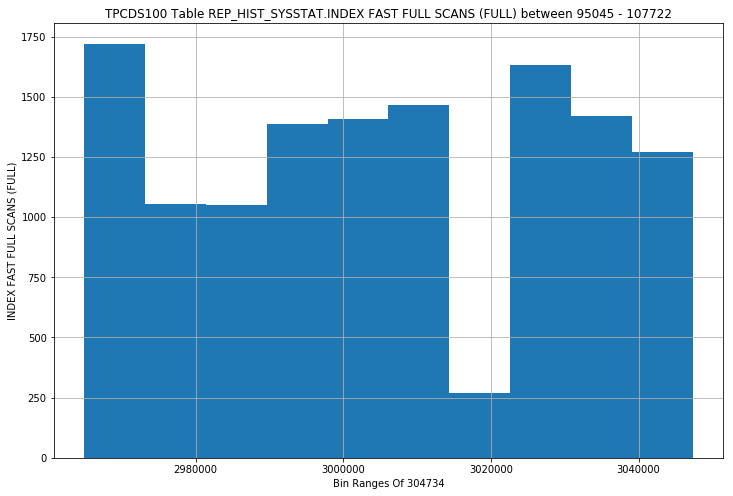

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (ROWID RANGES) - OUTLIERS HISTOGRAM


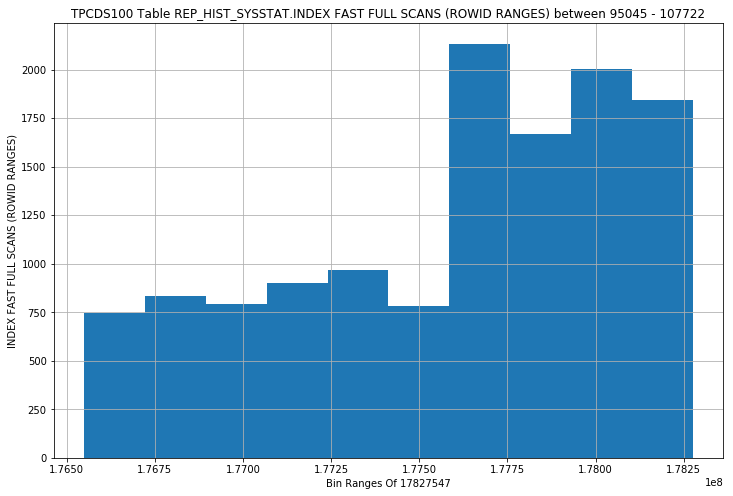

REP_HIST_SYSSTAT - INDEX FETCH BY KEY - OUTLIERS HISTOGRAM


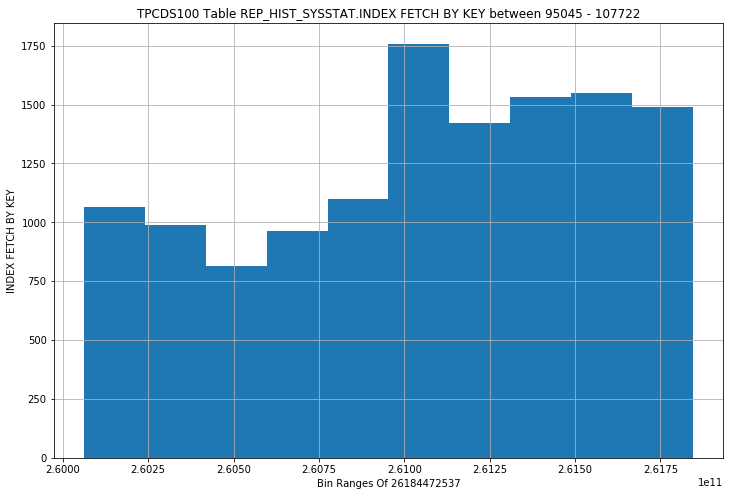

REP_HIST_SYSSTAT - INDEX SCANS KDIIXS1 - OUTLIERS HISTOGRAM


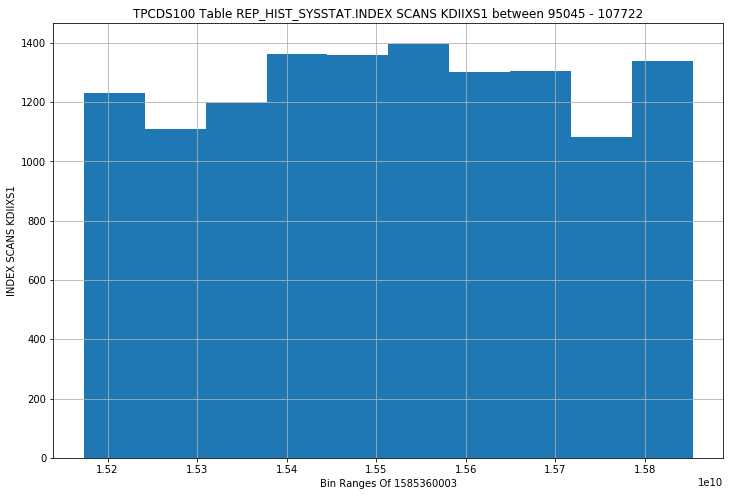

REP_HIST_SYSSTAT - LEAF NODE 90-10 SPLITS - OUTLIERS HISTOGRAM


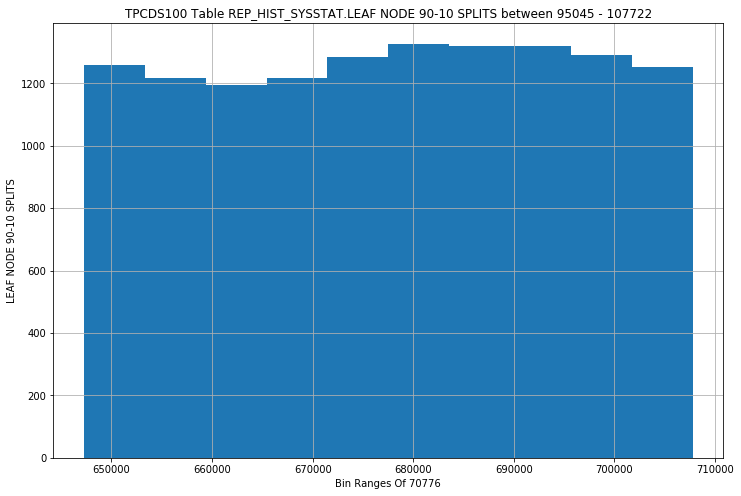

REP_HIST_SYSSTAT - LEAF NODE SPLITS - OUTLIERS HISTOGRAM


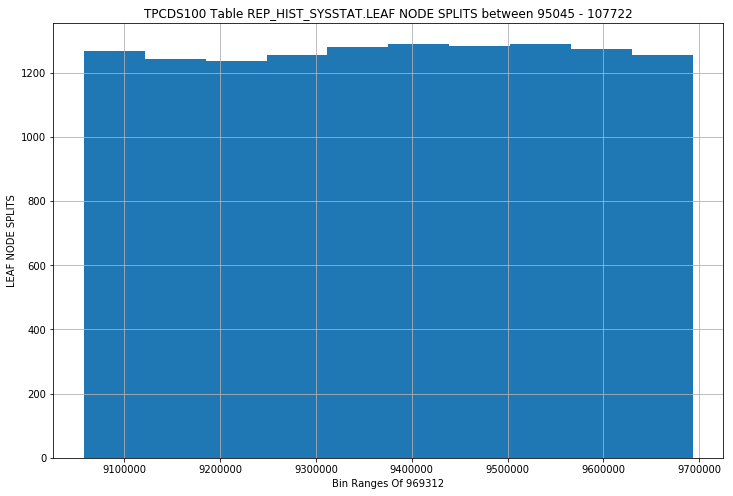

REP_HIST_SYSSTAT - LOB READS - OUTLIERS HISTOGRAM


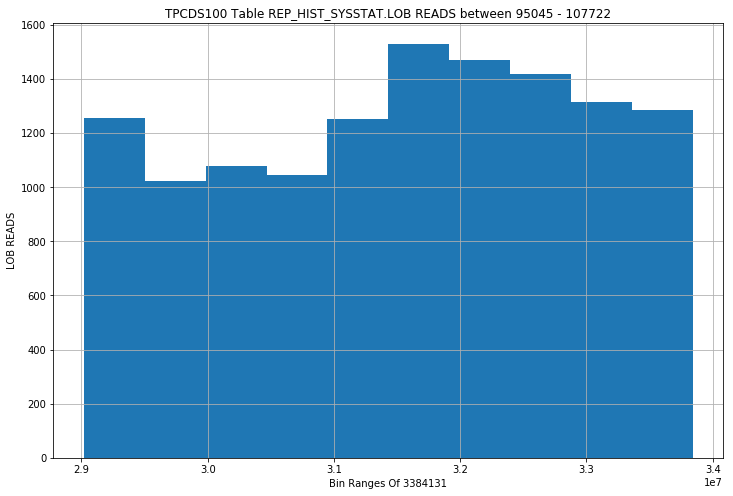

REP_HIST_SYSSTAT - LOB WRITES - OUTLIERS HISTOGRAM


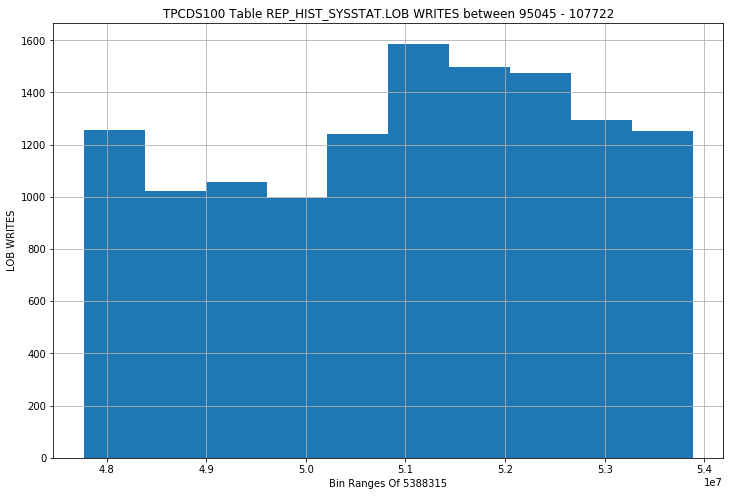

REP_HIST_SYSSTAT - LOB WRITES UNALIGNED - OUTLIERS HISTOGRAM


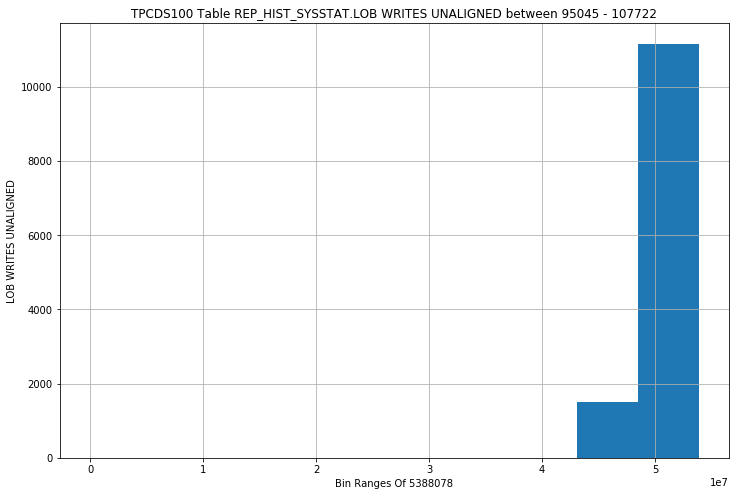

REP_HIST_SYSSTAT - LOGICAL READ BYTES FROM CACHE - OUTLIERS HISTOGRAM


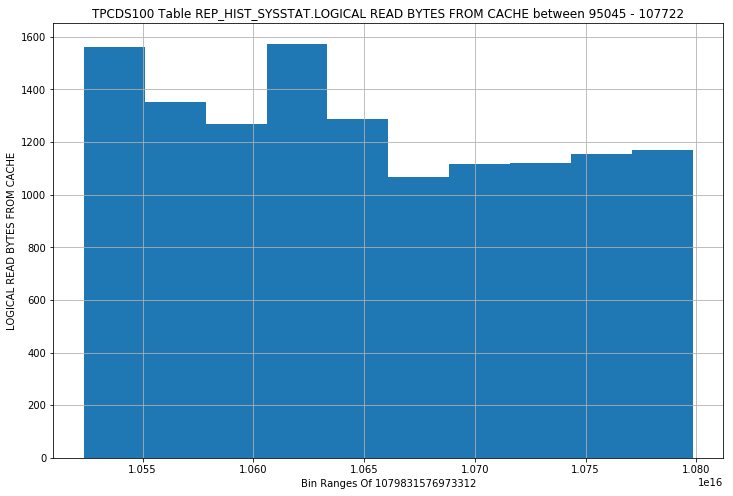

REP_HIST_SYSSTAT - LOGONS CUMULATIVE - OUTLIERS HISTOGRAM


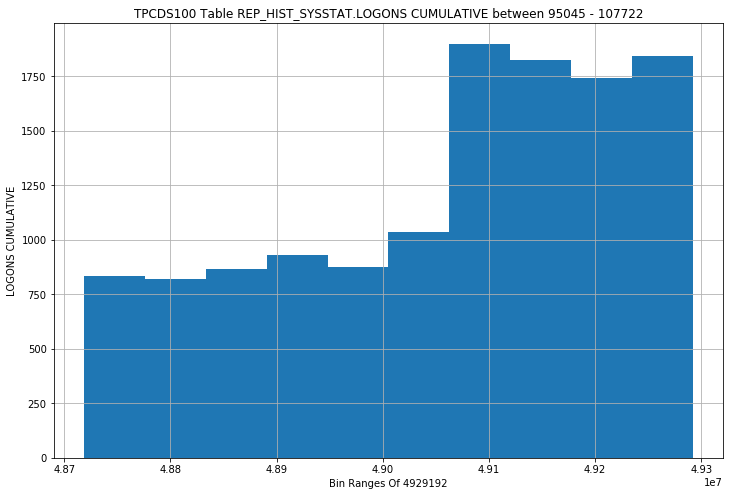

REP_HIST_SYSSTAT - LOGONS CURRENT - OUTLIERS HISTOGRAM


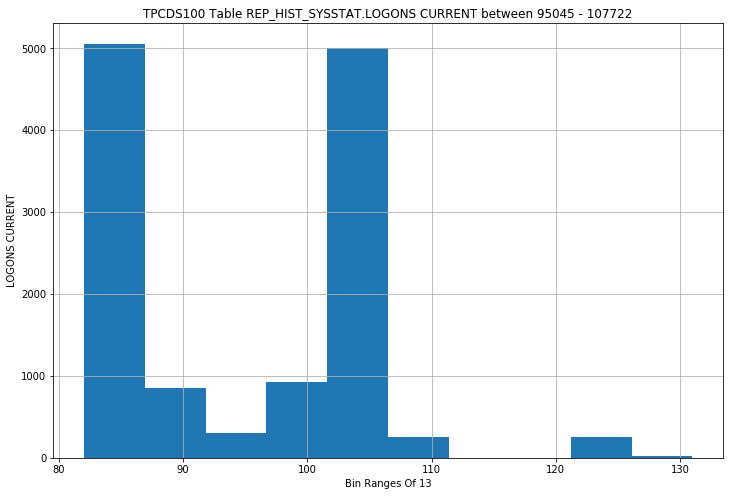

REP_HIST_SYSSTAT - MAX CF ENQ HOLD TIME - OUTLIERS HISTOGRAM


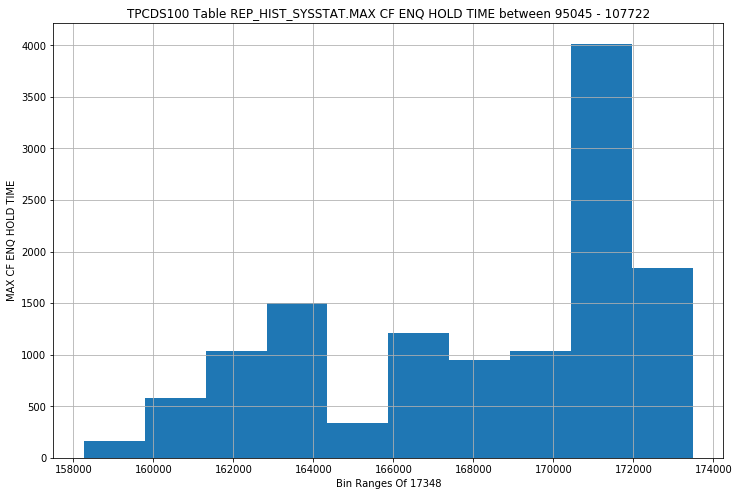

REP_HIST_SYSSTAT - MESSAGES RECEIVED - OUTLIERS HISTOGRAM


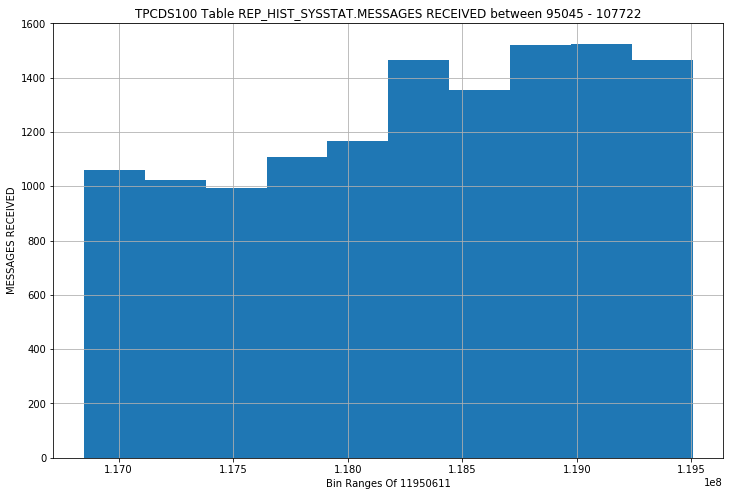

REP_HIST_SYSSTAT - MESSAGES SENT - OUTLIERS HISTOGRAM


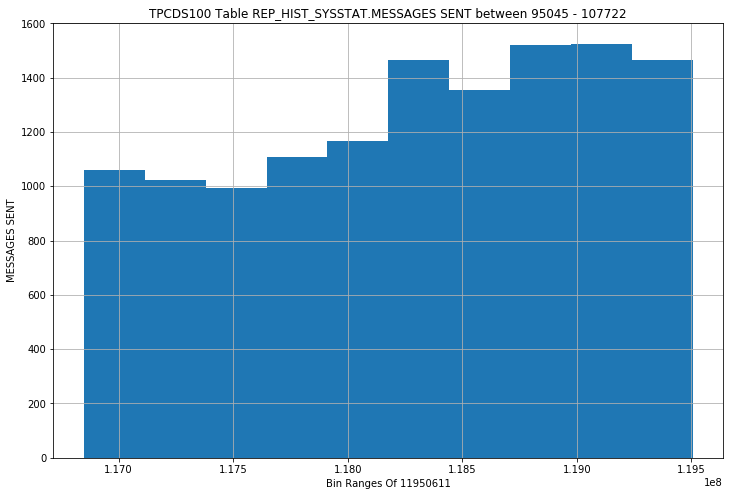

REP_HIST_SYSSTAT - MIN ACTIVE SCN OPTIMIZATION APPLIED ON CR - OUTLIERS HISTOGRAM


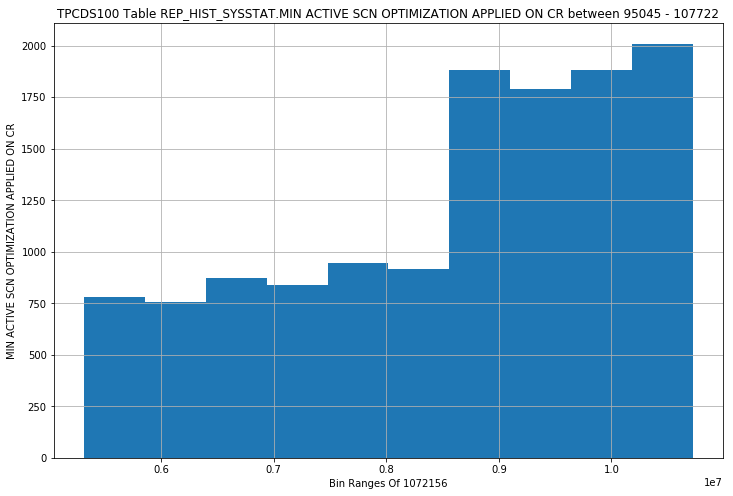

REP_HIST_SYSSTAT - NO BUFFER TO KEEP PINNED COUNT - OUTLIERS HISTOGRAM


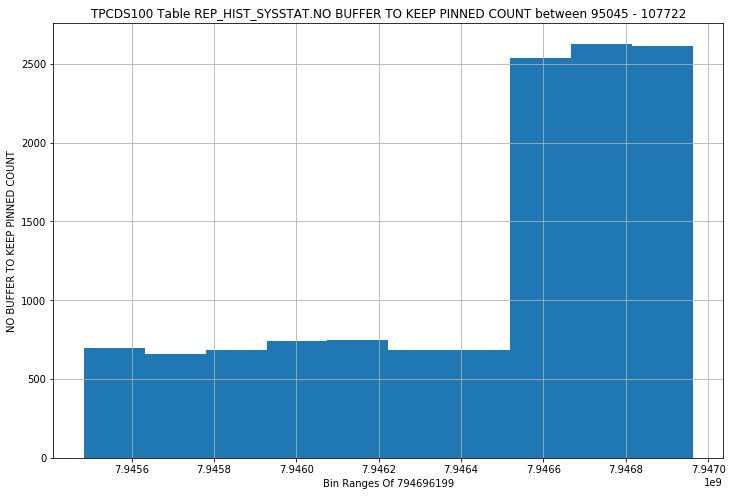

REP_HIST_SYSSTAT - NO WORK - CONSISTENT READ GETS - OUTLIERS HISTOGRAM


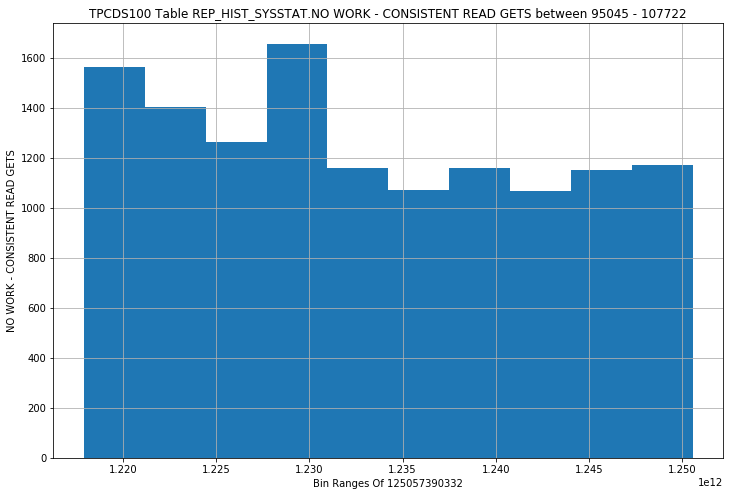

REP_HIST_SYSSTAT - NON-IDLE WAIT COUNT - OUTLIERS HISTOGRAM


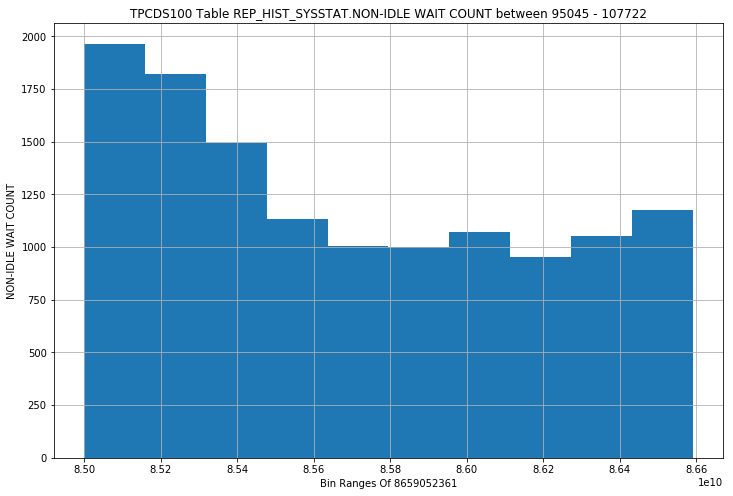

REP_HIST_SYSSTAT - NON-IDLE WAIT TIME - OUTLIERS HISTOGRAM


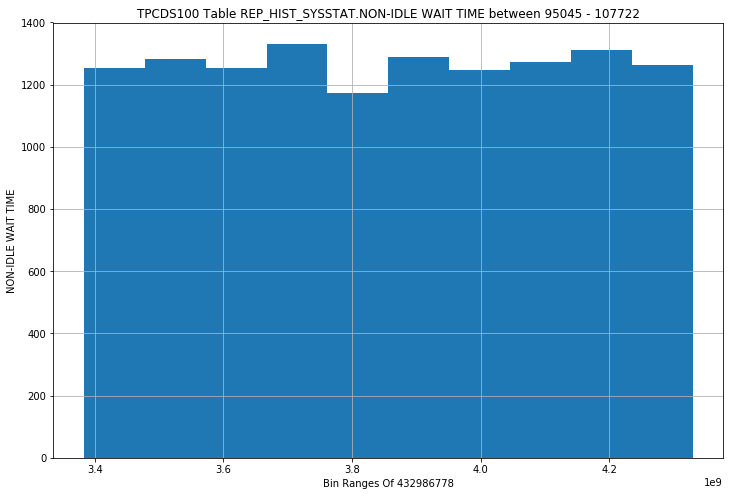

REP_HIST_SYSSTAT - OPENED CURSORS CUMULATIVE - OUTLIERS HISTOGRAM


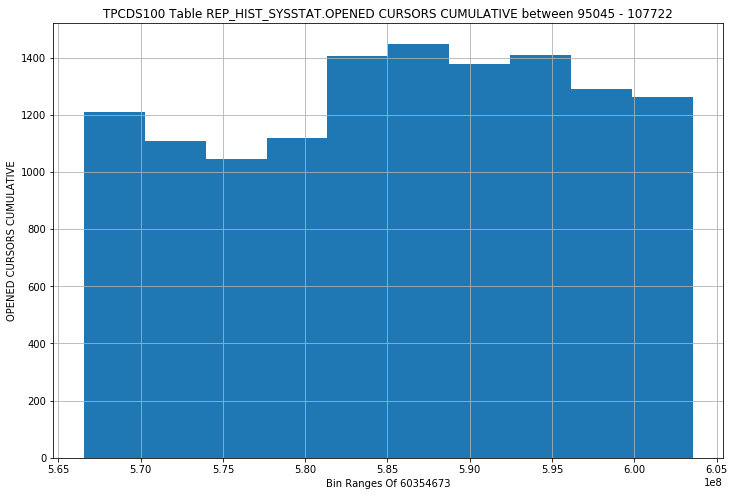

REP_HIST_SYSSTAT - OPENED CURSORS CURRENT - OUTLIERS HISTOGRAM


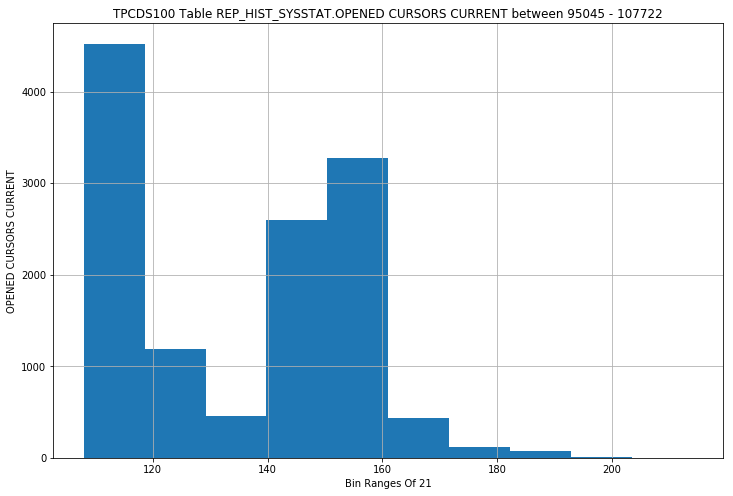

REP_HIST_SYSSTAT - PARSE COUNT (DESCRIBE) - OUTLIERS HISTOGRAM


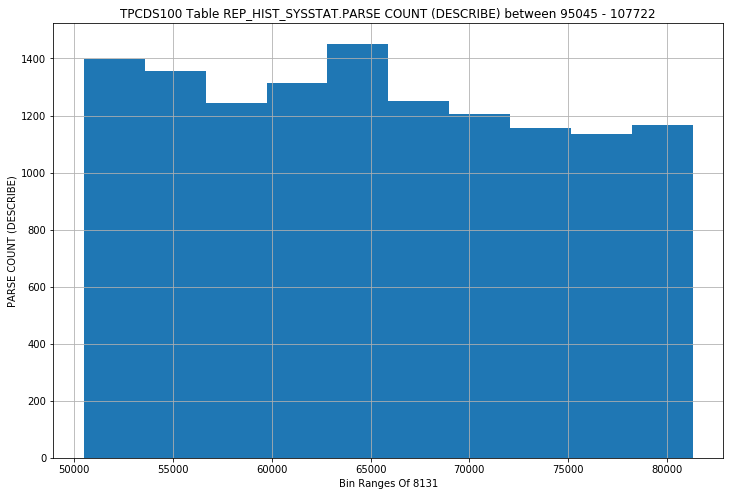

REP_HIST_SYSSTAT - PARSE COUNT (FAILURES) - OUTLIERS HISTOGRAM


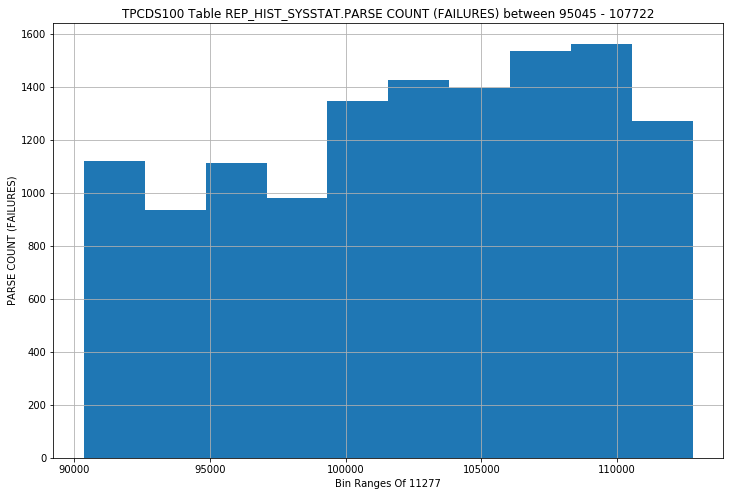

REP_HIST_SYSSTAT - PARSE COUNT (HARD) - OUTLIERS HISTOGRAM


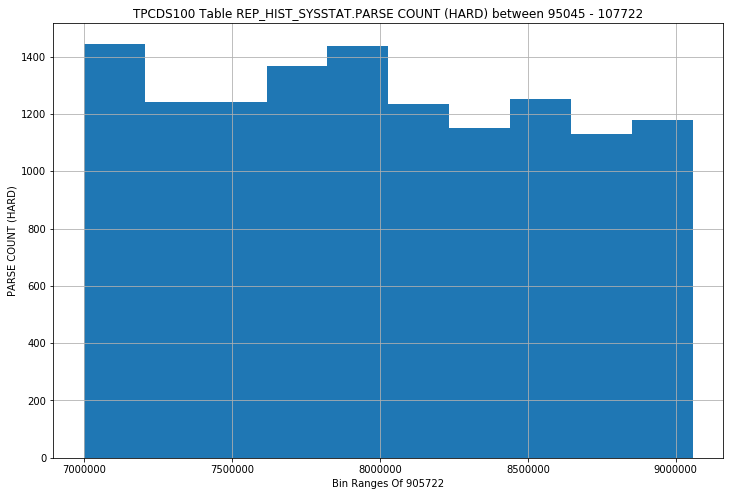

REP_HIST_SYSSTAT - PARSE COUNT (TOTAL) - OUTLIERS HISTOGRAM


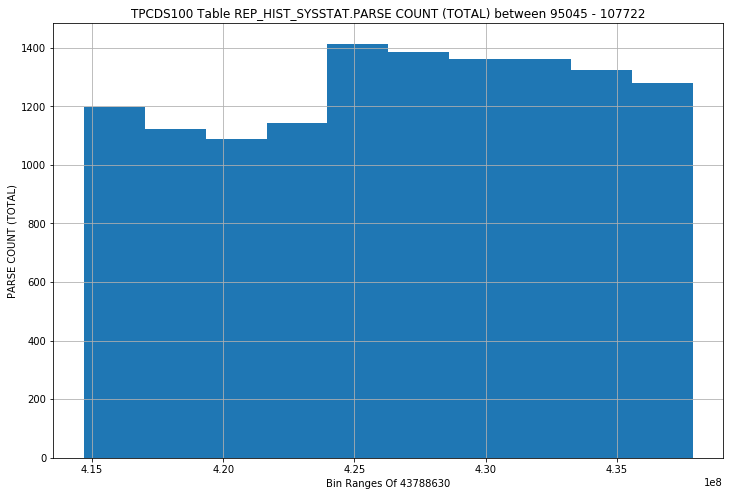

REP_HIST_SYSSTAT - PARSE TIME CPU - OUTLIERS HISTOGRAM


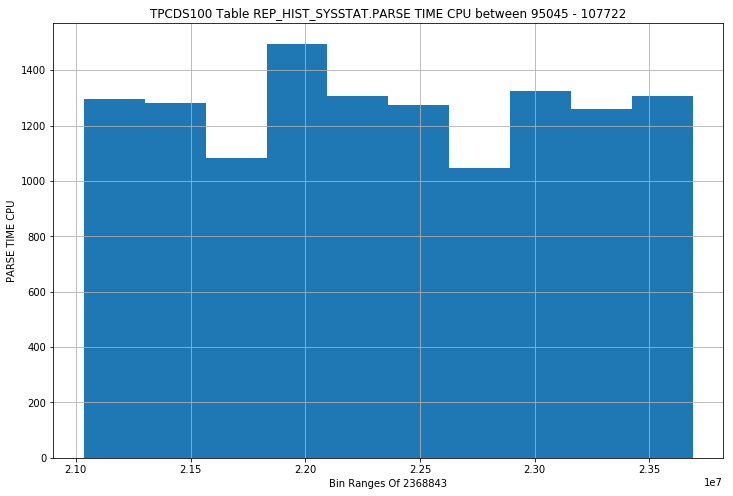

REP_HIST_SYSSTAT - PARSE TIME ELAPSED - OUTLIERS HISTOGRAM


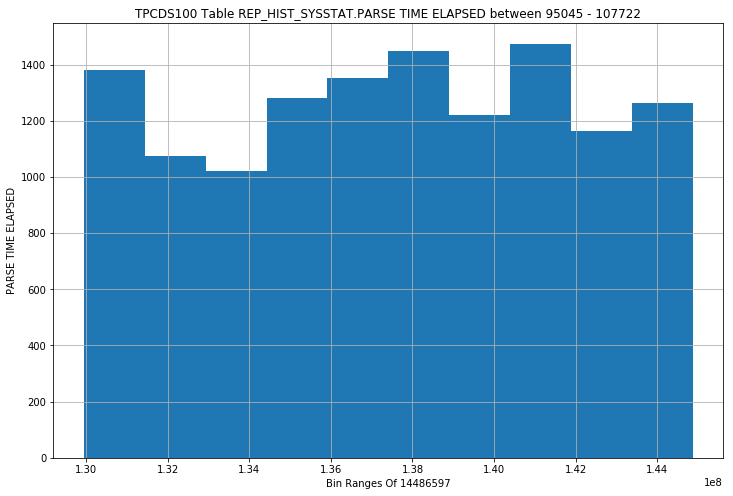

REP_HIST_SYSSTAT - PHYSICAL READ IO REQUESTS - OUTLIERS HISTOGRAM


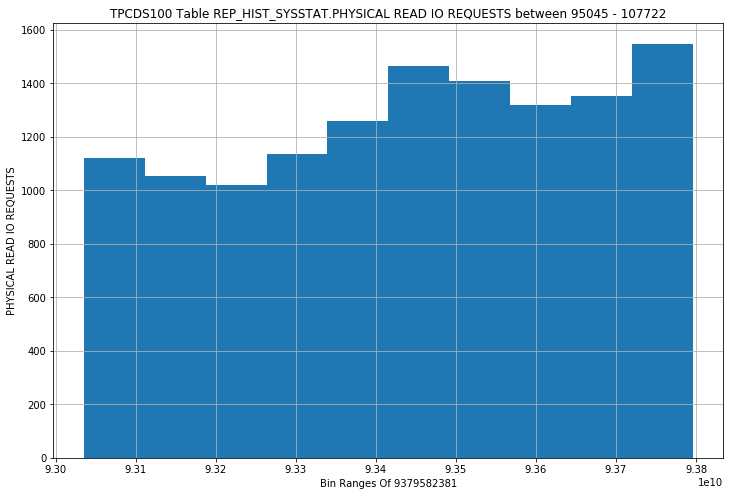

REP_HIST_SYSSTAT - PHYSICAL READ BYTES - OUTLIERS HISTOGRAM


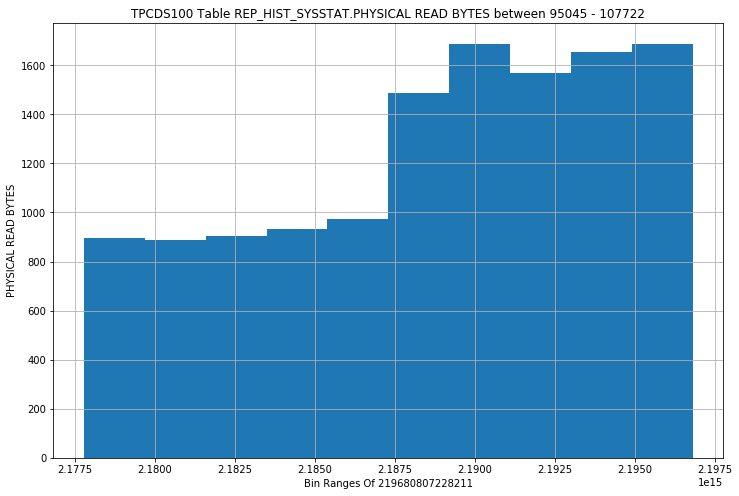

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL IO REQUESTS - OUTLIERS HISTOGRAM


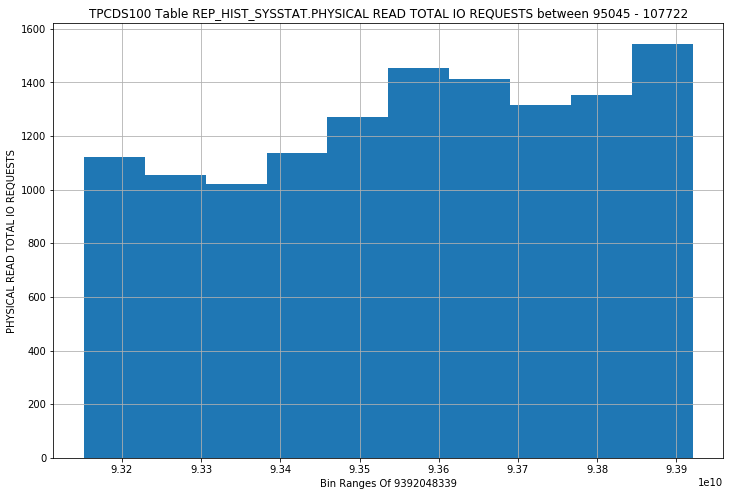

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL BYTES - OUTLIERS HISTOGRAM


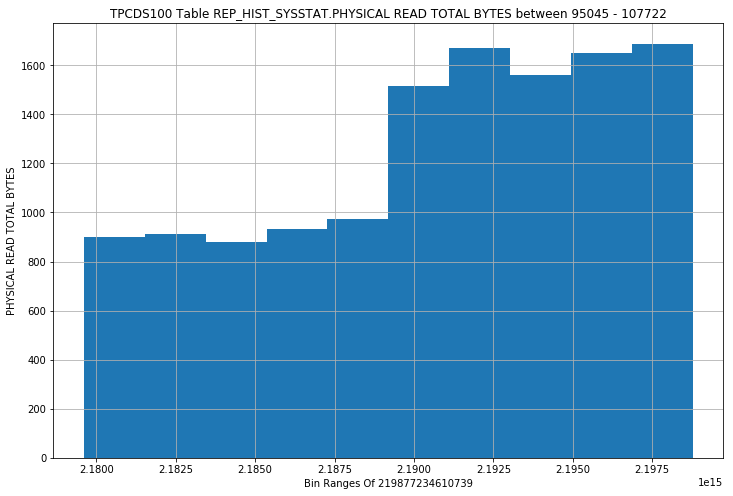

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL MULTI BLOCK REQUESTS - OUTLIERS HISTOGRAM


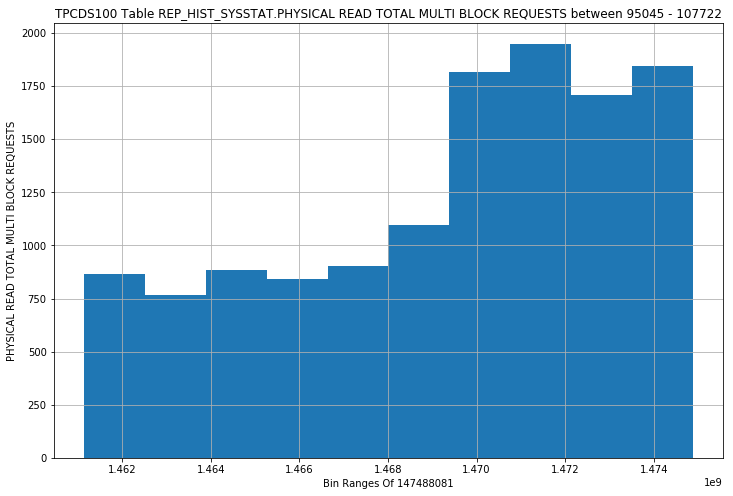

REP_HIST_SYSSTAT - PHYSICAL READS - OUTLIERS HISTOGRAM


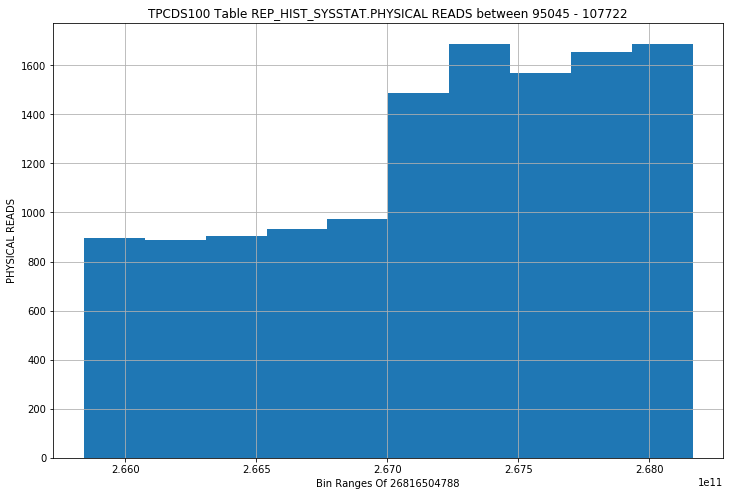

REP_HIST_SYSSTAT - PHYSICAL READS CACHE - OUTLIERS HISTOGRAM


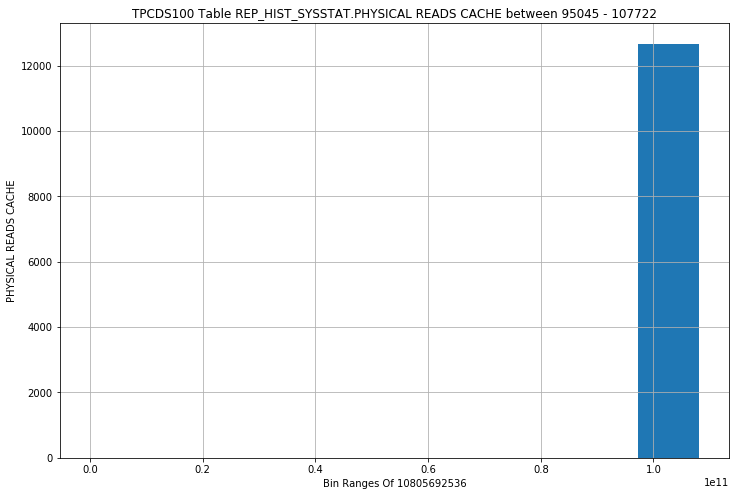

REP_HIST_SYSSTAT - PHYSICAL READS CACHE PREFETCH - OUTLIERS HISTOGRAM


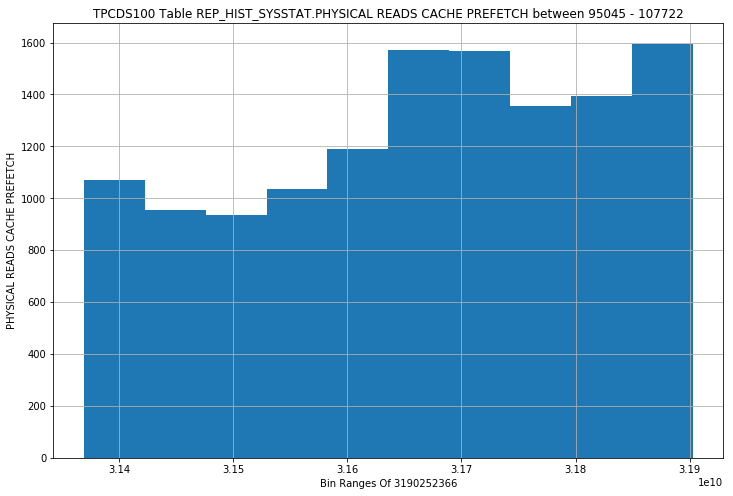

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT - OUTLIERS HISTOGRAM


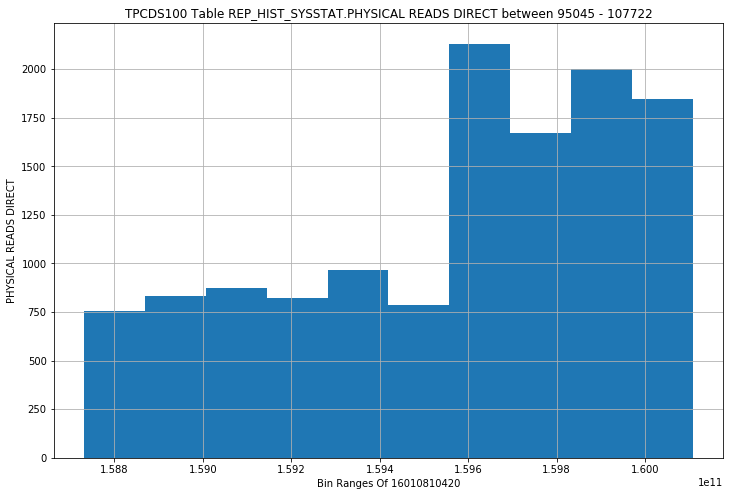

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT (LOB) - OUTLIERS HISTOGRAM


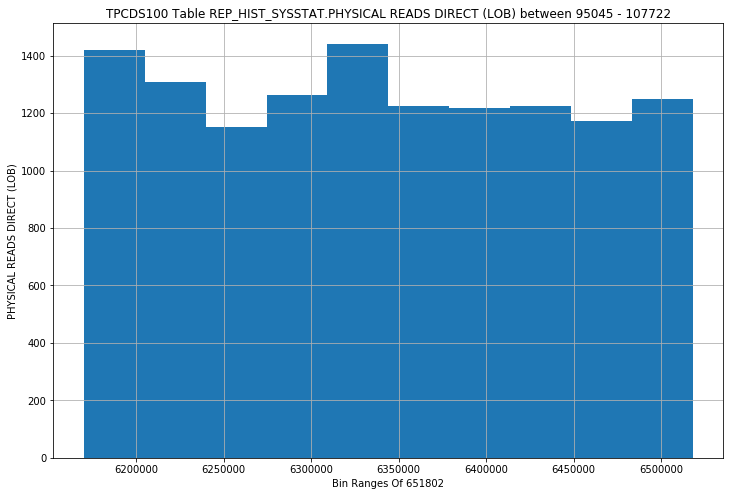

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT TEMPORARY TABLESPACE - OUTLIERS HISTOGRAM


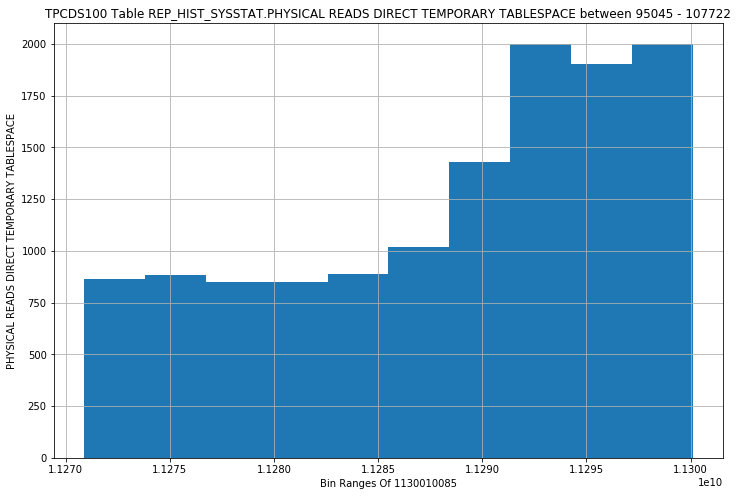

REP_HIST_SYSSTAT - PHYSICAL WRITE IO REQUESTS - OUTLIERS HISTOGRAM


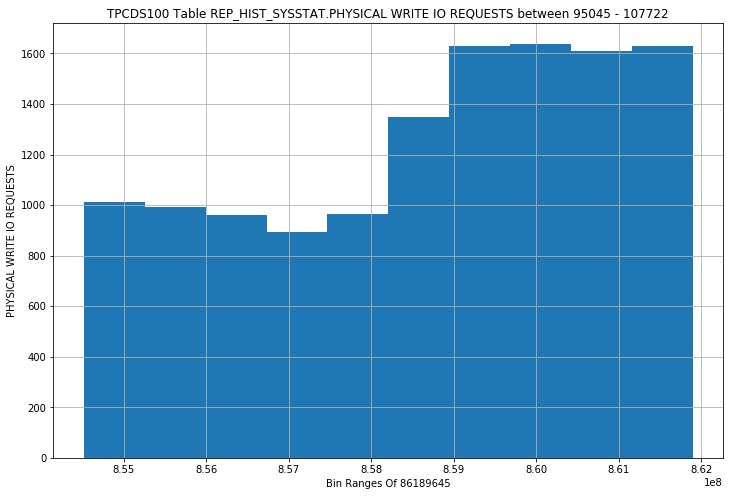

REP_HIST_SYSSTAT - PHYSICAL WRITE BYTES - OUTLIERS HISTOGRAM


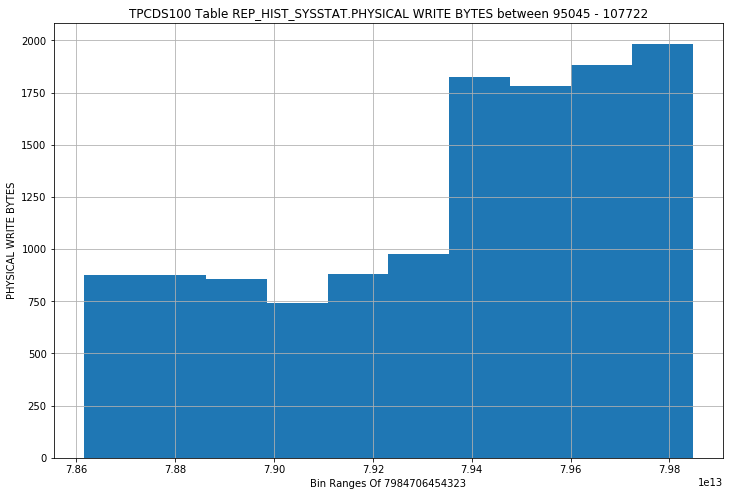

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL IO REQUESTS - OUTLIERS HISTOGRAM


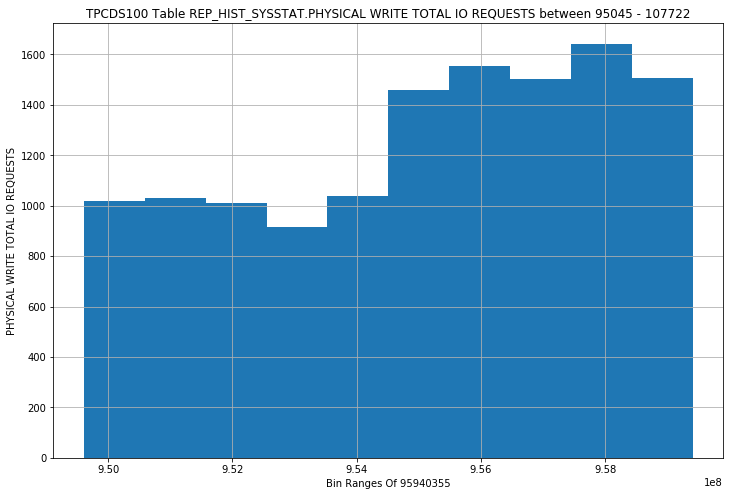

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL BYTES - OUTLIERS HISTOGRAM


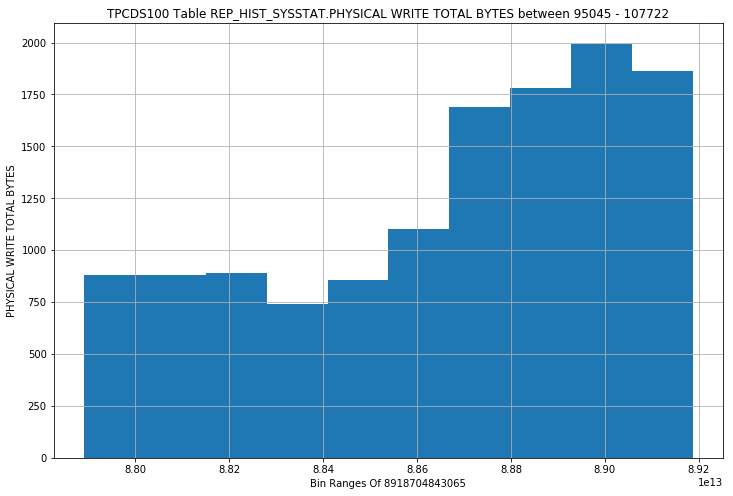

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL MULTI BLOCK REQUESTS - OUTLIERS HISTOGRAM


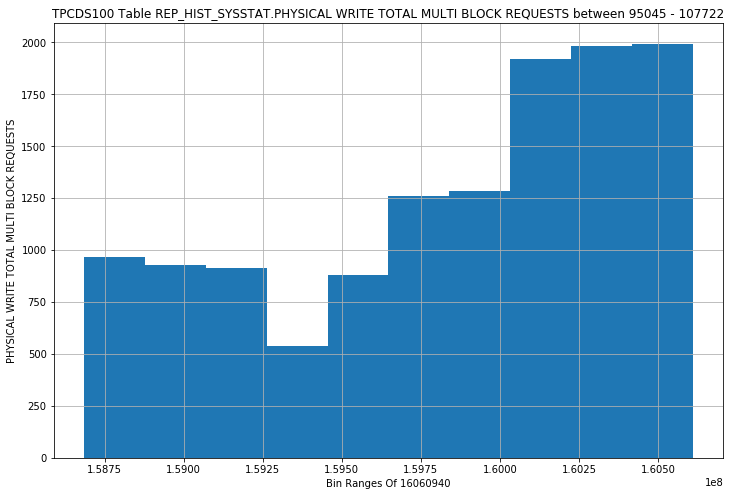

REP_HIST_SYSSTAT - PHYSICAL WRITES - OUTLIERS HISTOGRAM


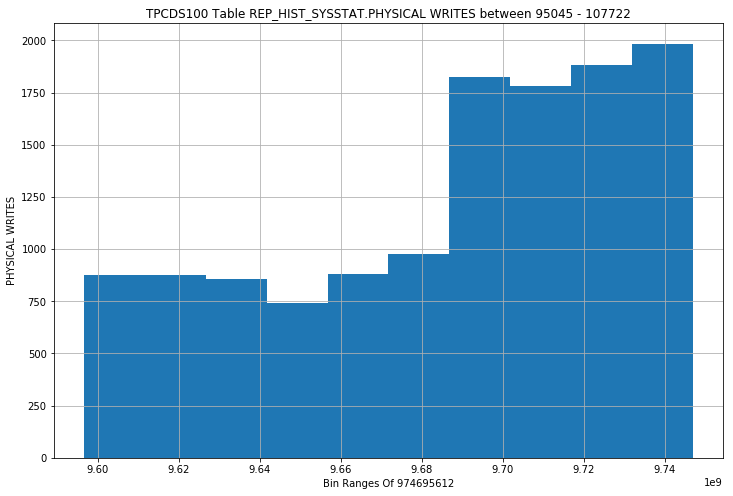

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT - OUTLIERS HISTOGRAM


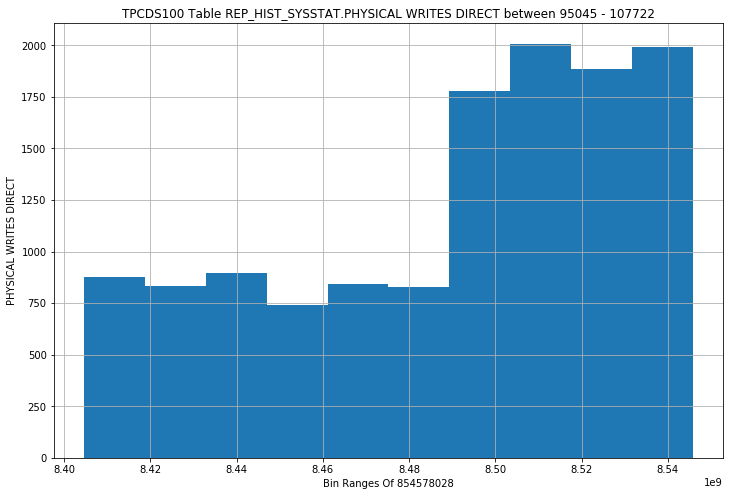

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT (LOB) - OUTLIERS HISTOGRAM


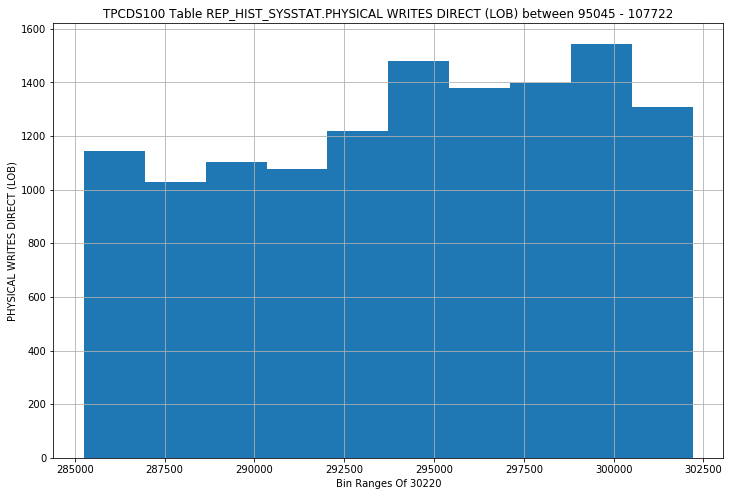

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT TEMPORARY TABLESPACE - OUTLIERS HISTOGRAM


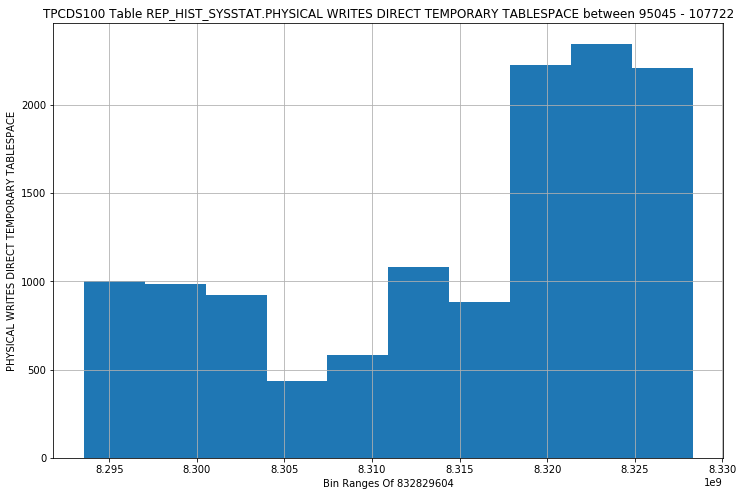

REP_HIST_SYSSTAT - PHYSICAL WRITES FROM CACHE - OUTLIERS HISTOGRAM


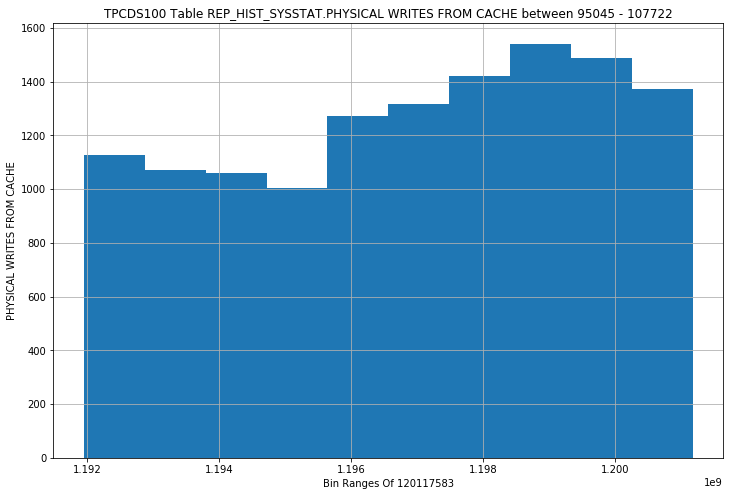

REP_HIST_SYSSTAT - PHYSICAL WRITES NON CHECKPOINT - OUTLIERS HISTOGRAM


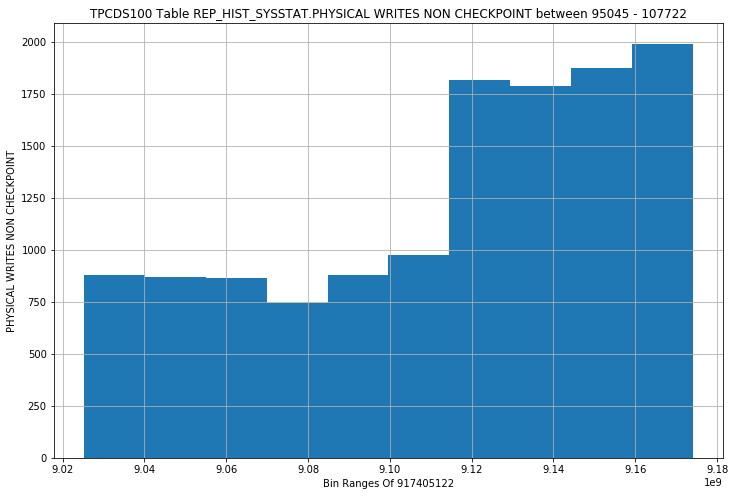

REP_HIST_SYSSTAT - PINNED BUFFERS INSPECTED - OUTLIERS HISTOGRAM


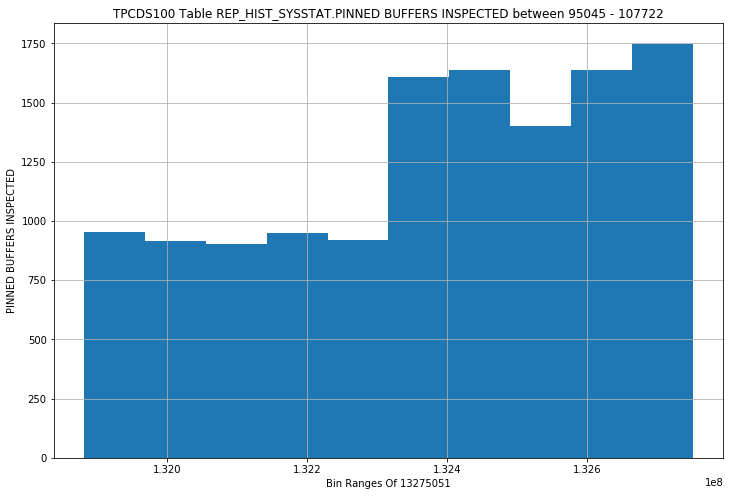

REP_HIST_SYSSTAT - PINNED CURSORS CURRENT - OUTLIERS HISTOGRAM


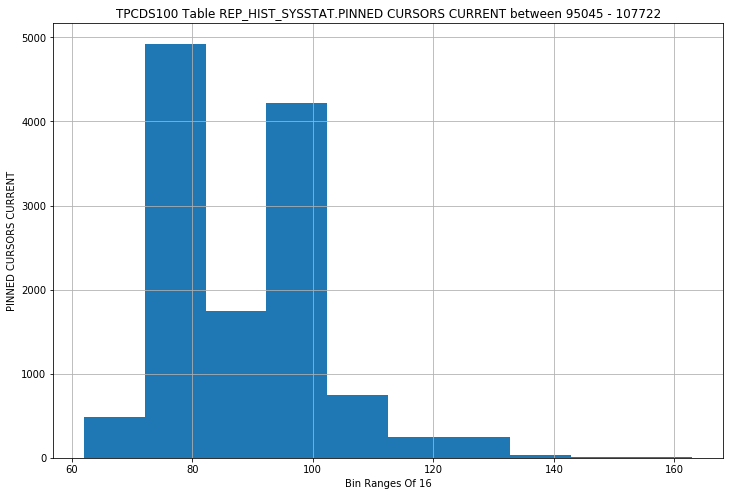

REP_HIST_SYSSTAT - PREFETCH CLIENTS - DEFAULT - OUTLIERS HISTOGRAM


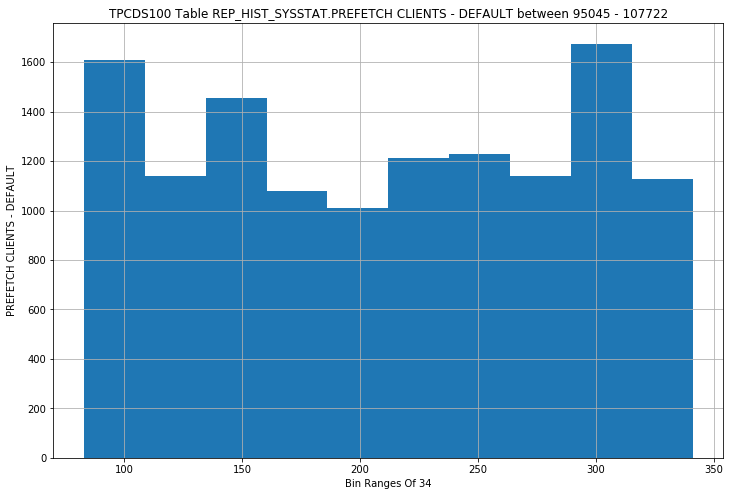

REP_HIST_SYSSTAT - PREFETCHED BLOCKS AGED OUT BEFORE USE - OUTLIERS HISTOGRAM


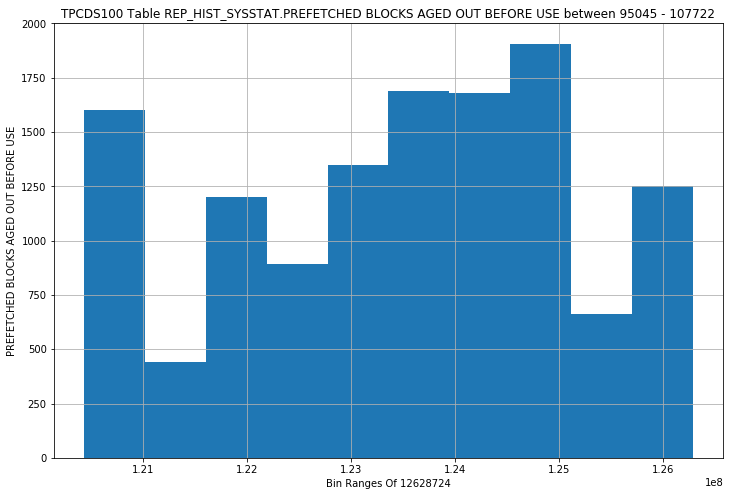

REP_HIST_SYSSTAT - PROCESS LAST NON-IDLE TIME - OUTLIERS HISTOGRAM


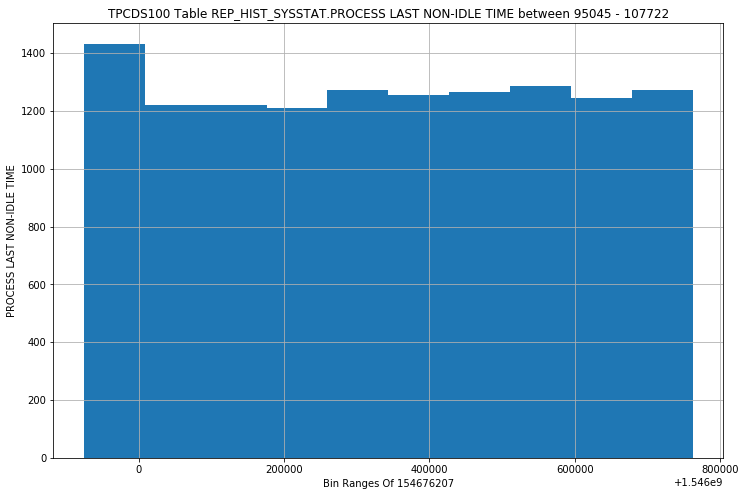

REP_HIST_SYSSTAT - QUERIES PARALLELIZED - OUTLIERS HISTOGRAM


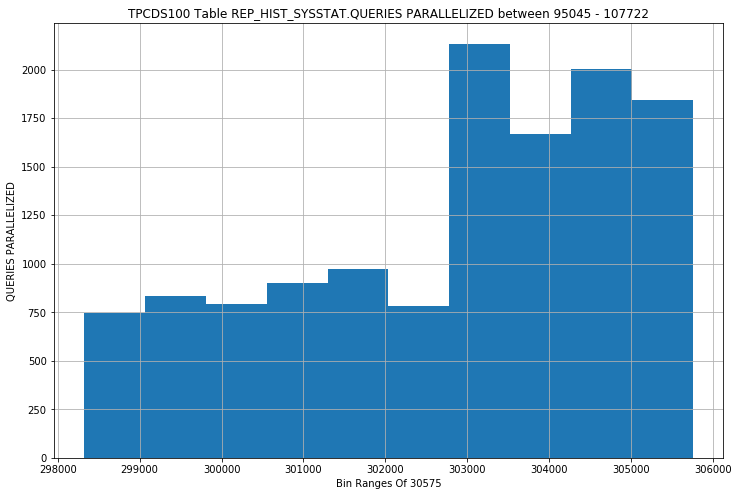

REP_HIST_SYSSTAT - RECURSIVE CALLS - OUTLIERS HISTOGRAM


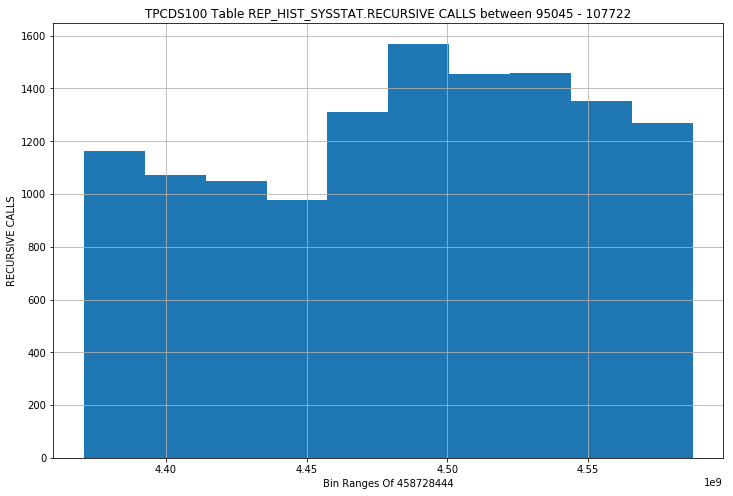

REP_HIST_SYSSTAT - RECURSIVE CPU USAGE - OUTLIERS HISTOGRAM


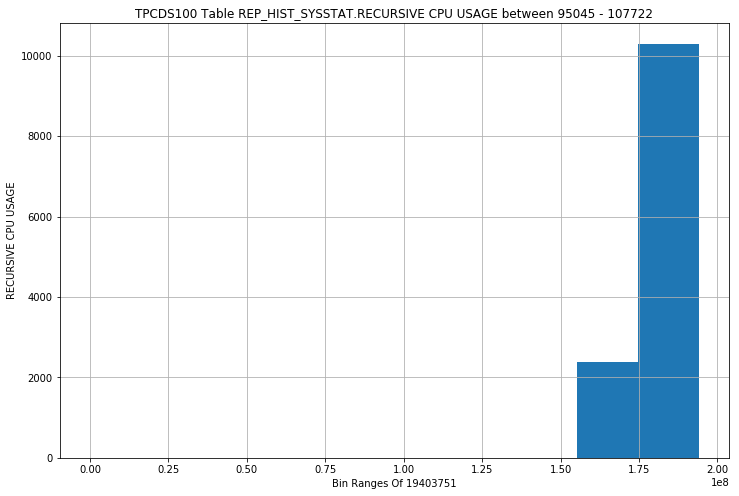

REP_HIST_SYSSTAT - REDO BLOCKS CHECKSUMMED BY FG (EXCLUSIVE) - OUTLIERS HISTOGRAM


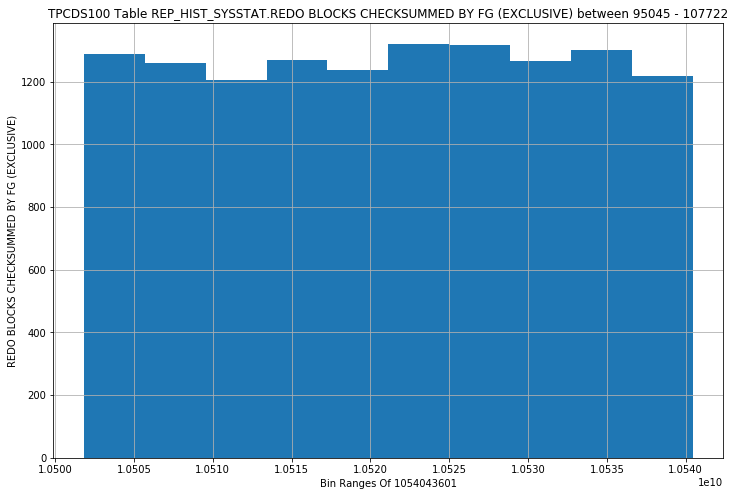

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN - OUTLIERS HISTOGRAM


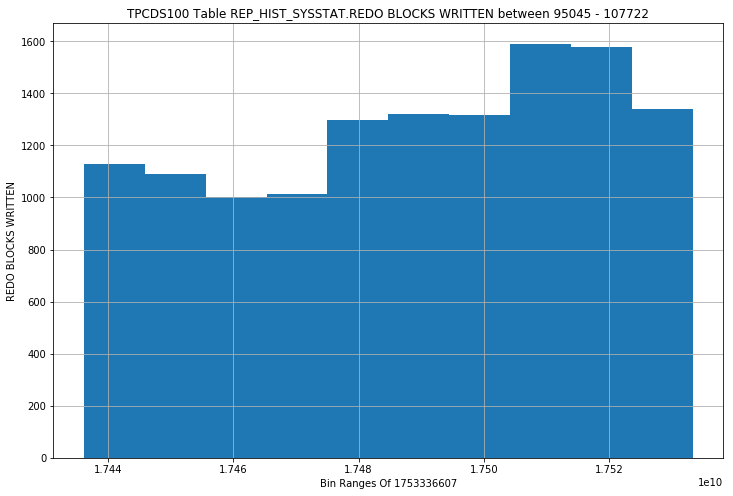

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN (GROUP 0) - OUTLIERS HISTOGRAM


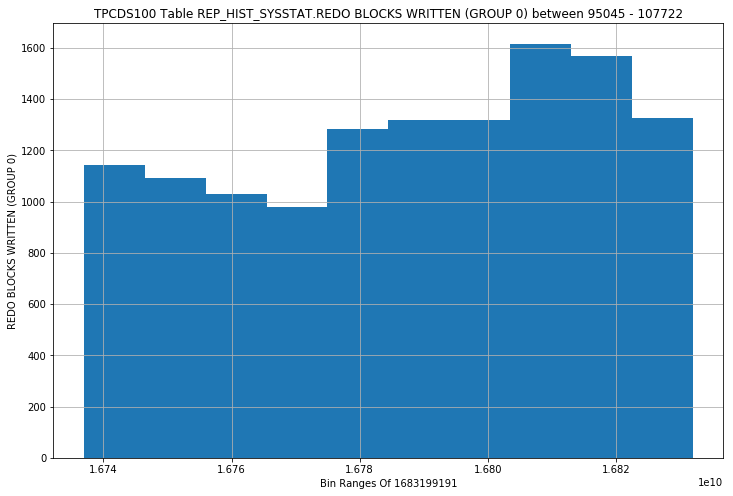

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN (GROUP 1) - OUTLIERS HISTOGRAM


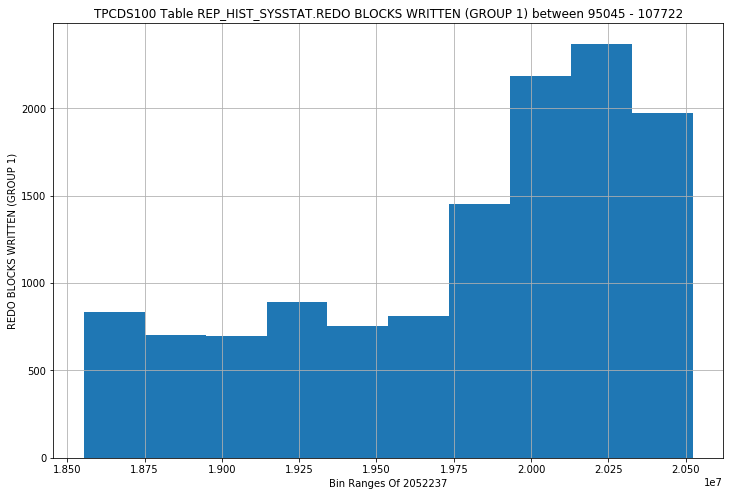

REP_HIST_SYSSTAT - REDO BUFFER ALLOCATION RETRIES - OUTLIERS HISTOGRAM


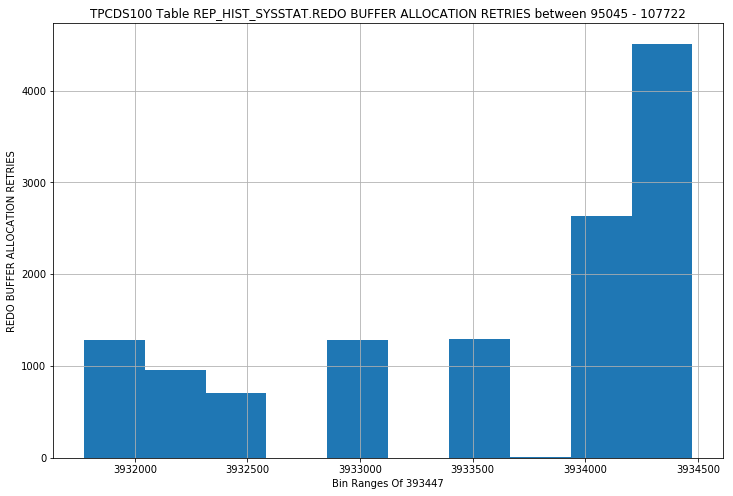

REP_HIST_SYSSTAT - REDO ENTRIES - OUTLIERS HISTOGRAM


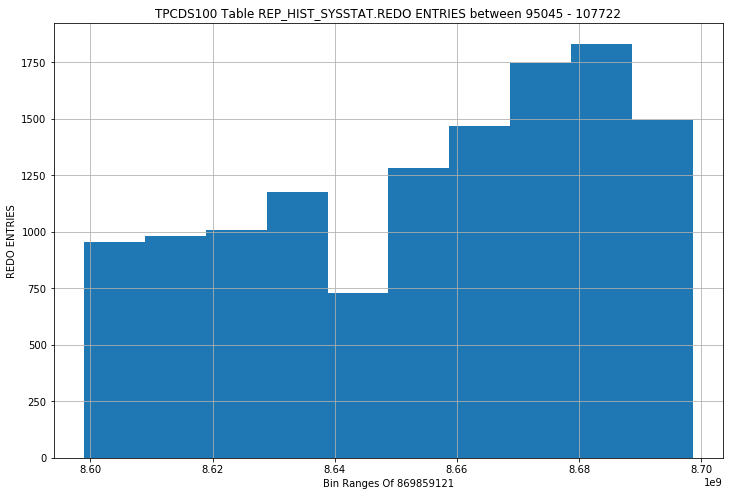

REP_HIST_SYSSTAT - REDO LOG SPACE REQUESTS - OUTLIERS HISTOGRAM


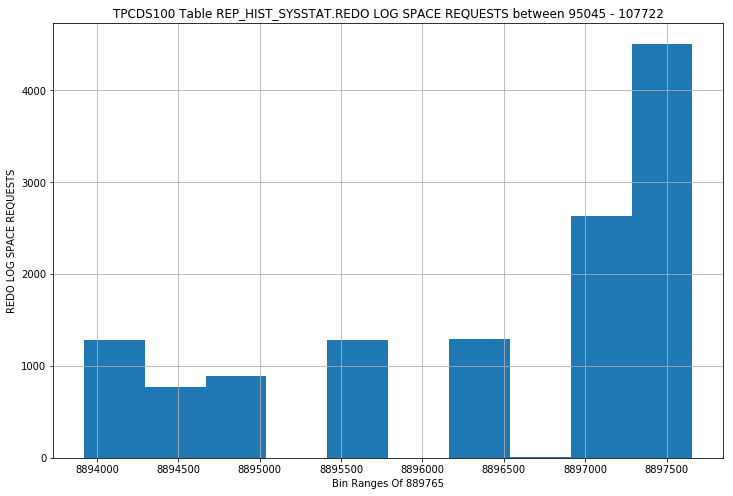

REP_HIST_SYSSTAT - REDO LOG SPACE WAIT TIME - OUTLIERS HISTOGRAM


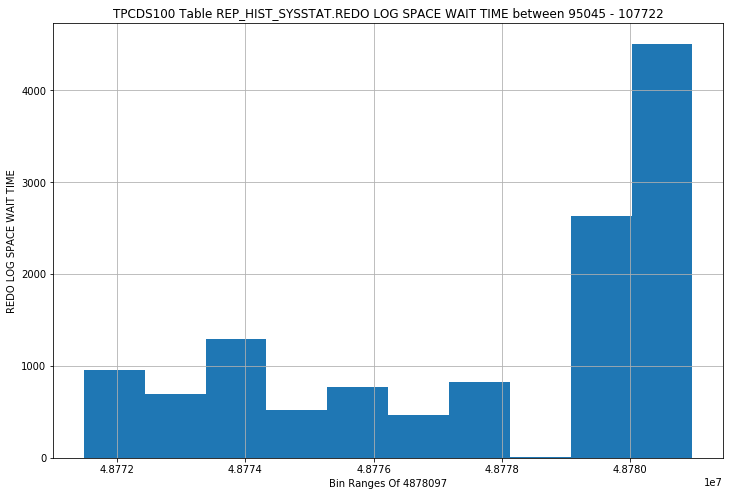

REP_HIST_SYSSTAT - REDO ORDERING MARKS - OUTLIERS HISTOGRAM


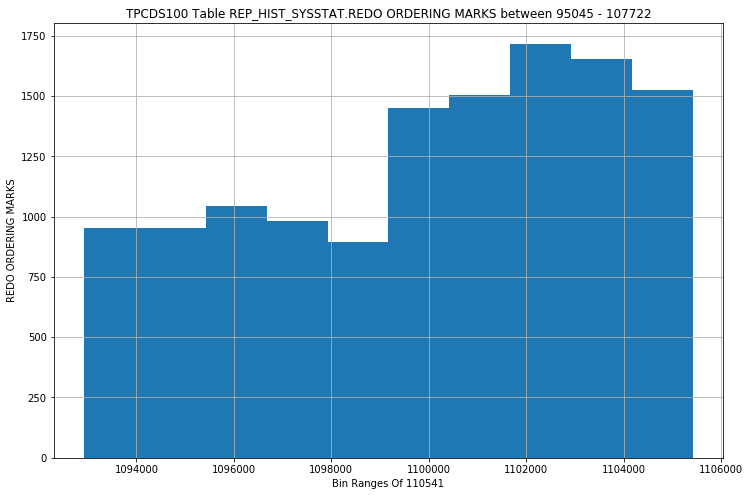

REP_HIST_SYSSTAT - REDO SIZE - OUTLIERS HISTOGRAM


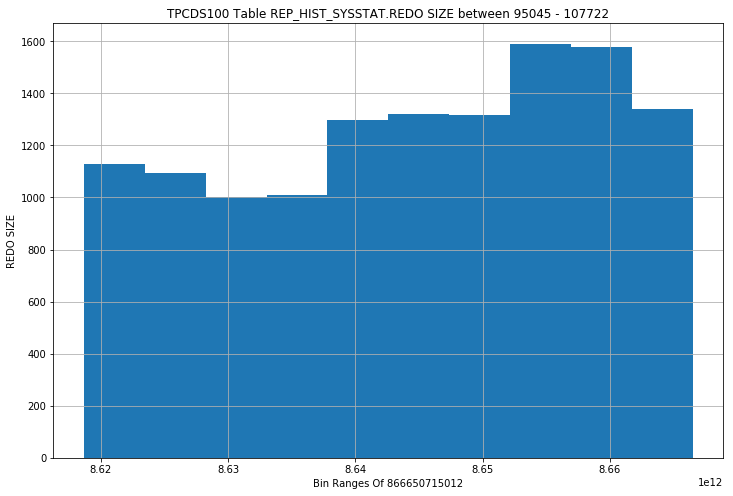

REP_HIST_SYSSTAT - REDO SIZE FOR DIRECT WRITES - OUTLIERS HISTOGRAM


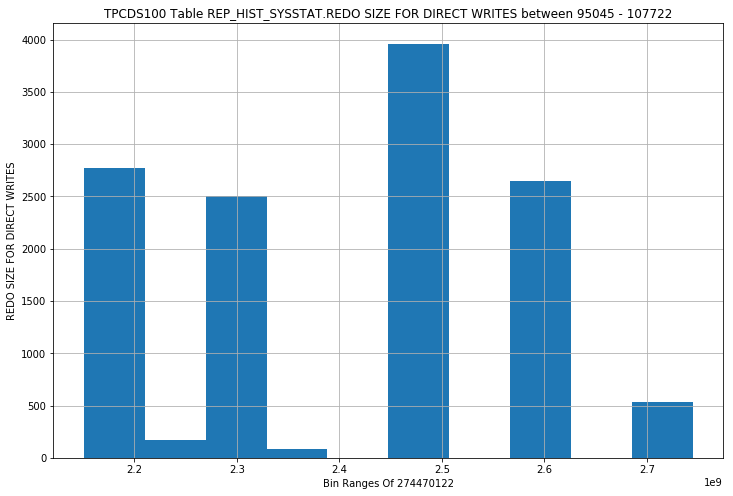

REP_HIST_SYSSTAT - REDO SUBSCN MAX COUNTS - OUTLIERS HISTOGRAM


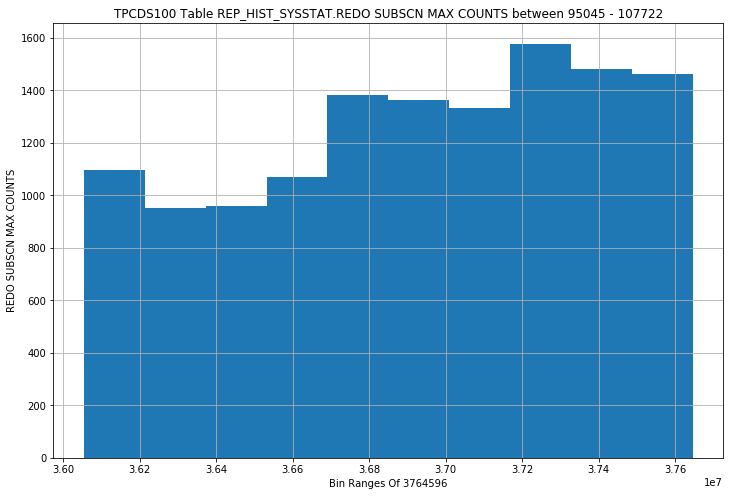

REP_HIST_SYSSTAT - REDO SYNCH LONG WAITS - OUTLIERS HISTOGRAM


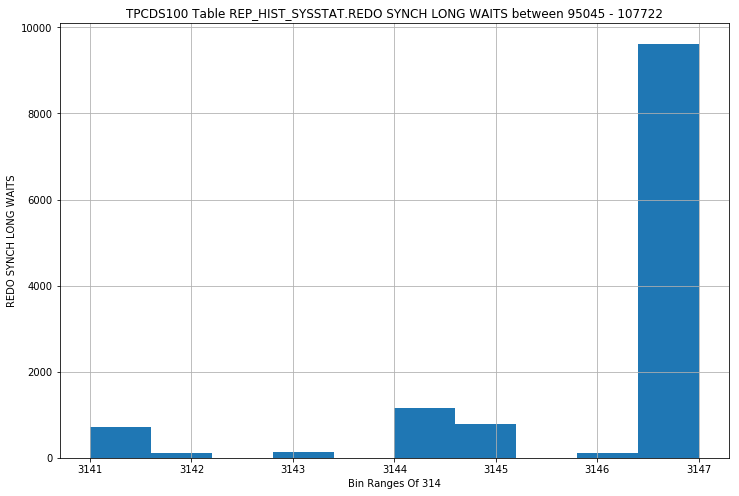

REP_HIST_SYSSTAT - REDO SYNCH TIME - OUTLIERS HISTOGRAM


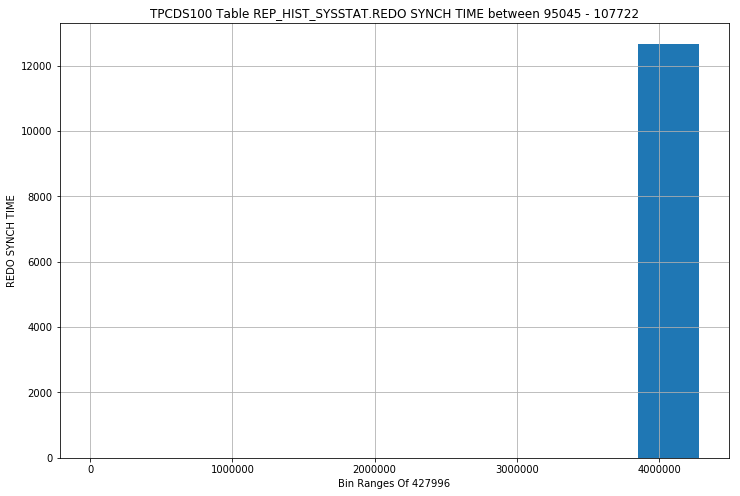

REP_HIST_SYSSTAT - REDO SYNCH TIME (USEC) - OUTLIERS HISTOGRAM


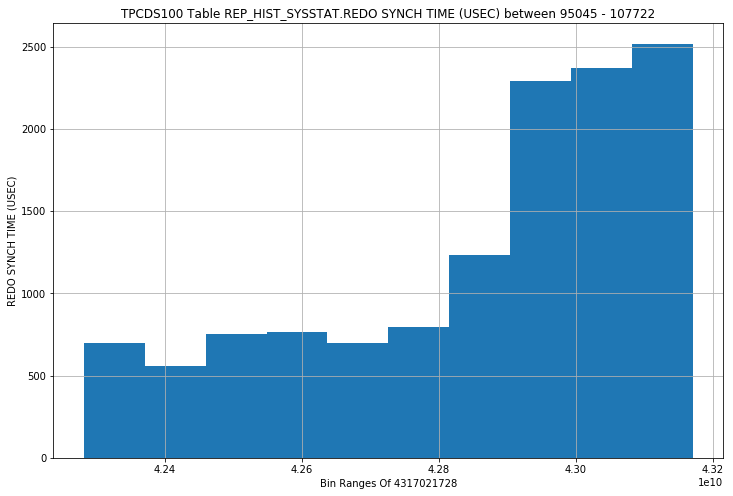

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD (USEC) - OUTLIERS HISTOGRAM


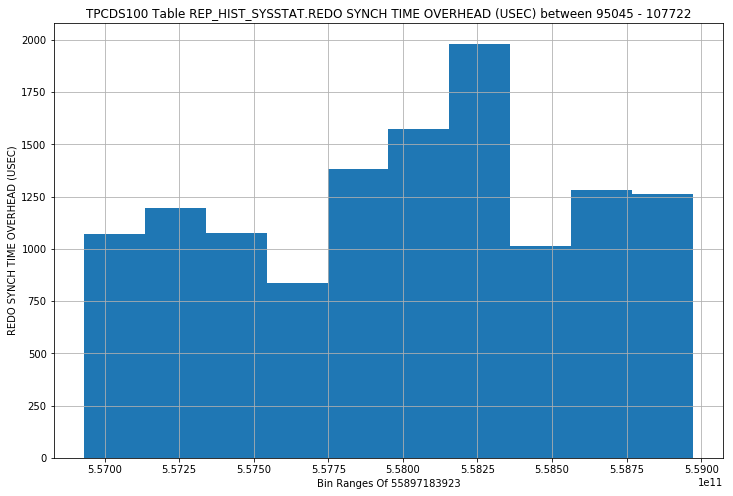

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (  2MS) - OUTLIERS HISTOGRAM


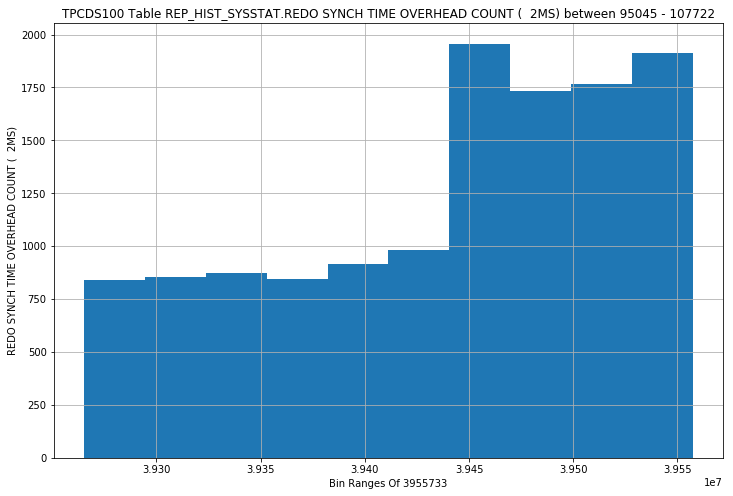

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (  8MS) - OUTLIERS HISTOGRAM


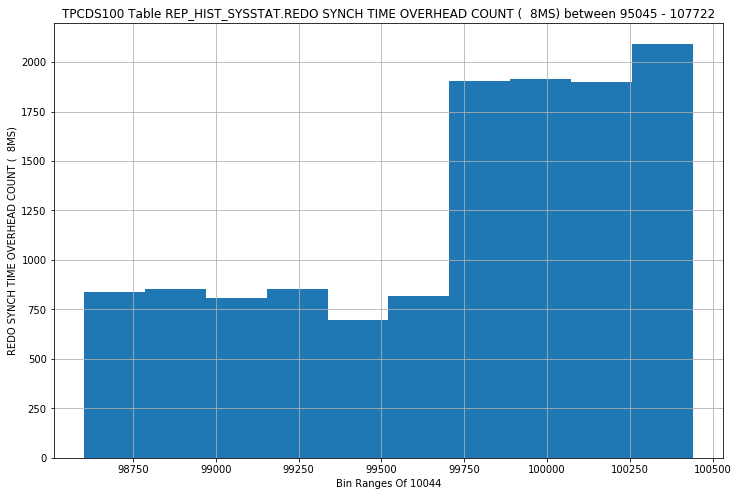

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT ( 32MS) - OUTLIERS HISTOGRAM


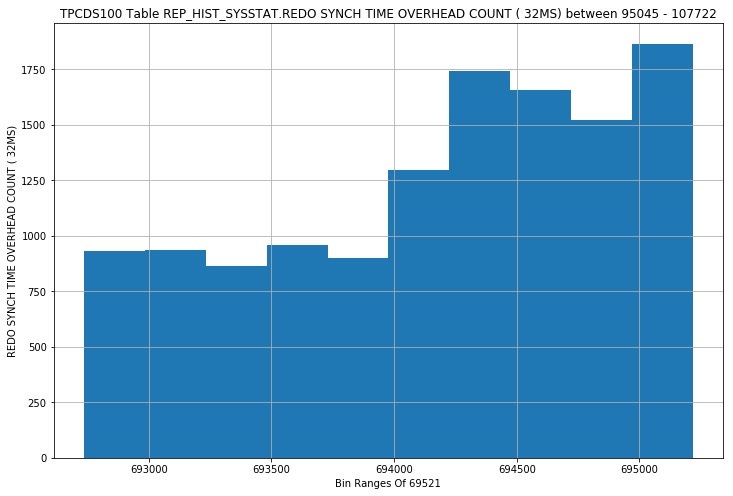

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (128MS) - OUTLIERS HISTOGRAM


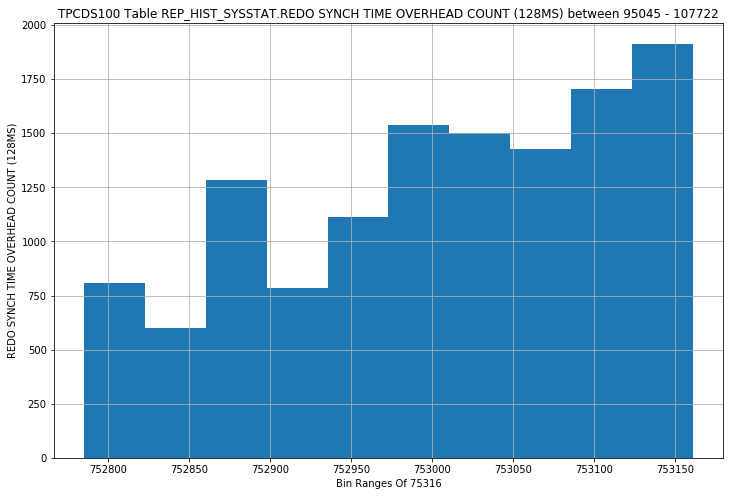

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (INF) - OUTLIERS HISTOGRAM


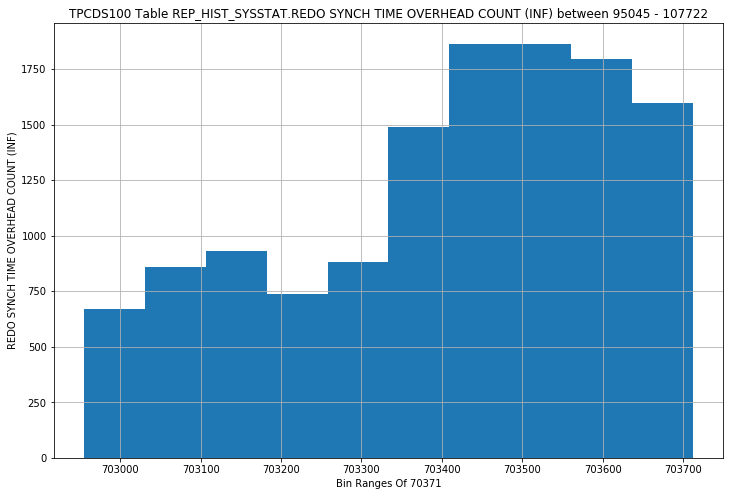

REP_HIST_SYSSTAT - REDO SYNCH WRITES - OUTLIERS HISTOGRAM


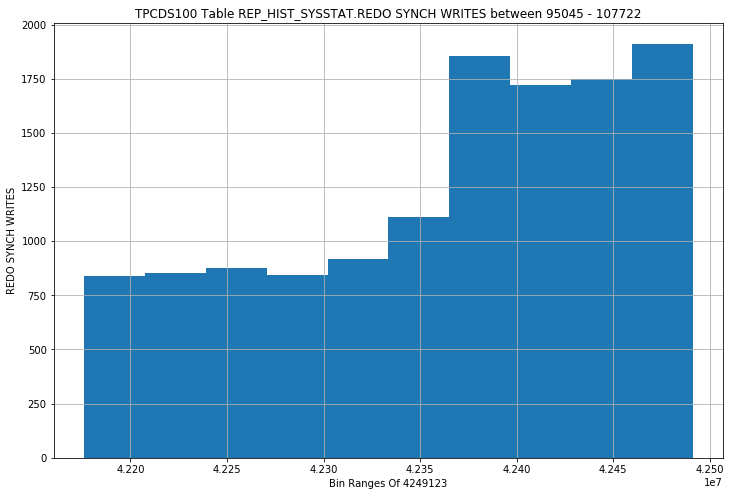

REP_HIST_SYSSTAT - REDO WASTAGE - OUTLIERS HISTOGRAM


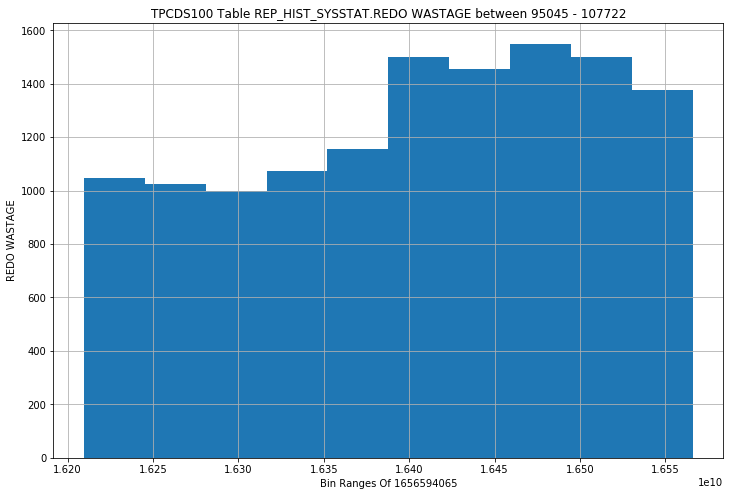

REP_HIST_SYSSTAT - REDO WRITE FINISH TIME - OUTLIERS HISTOGRAM


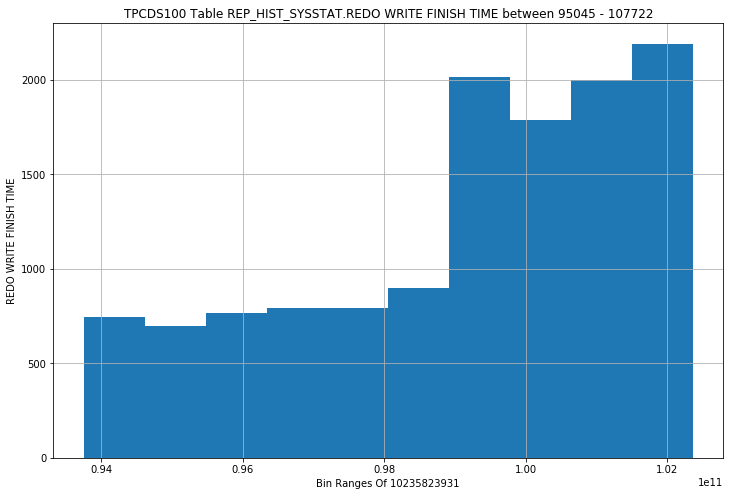

REP_HIST_SYSSTAT - REDO WRITE GATHER TIME - OUTLIERS HISTOGRAM


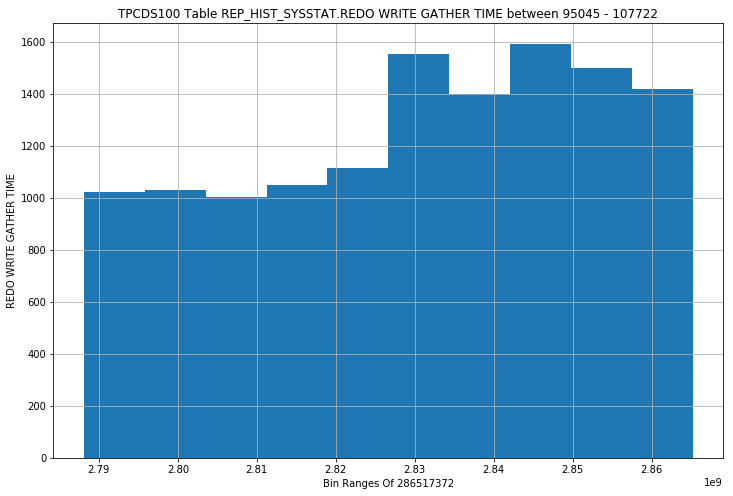

REP_HIST_SYSSTAT - REDO WRITE INFO FIND - OUTLIERS HISTOGRAM


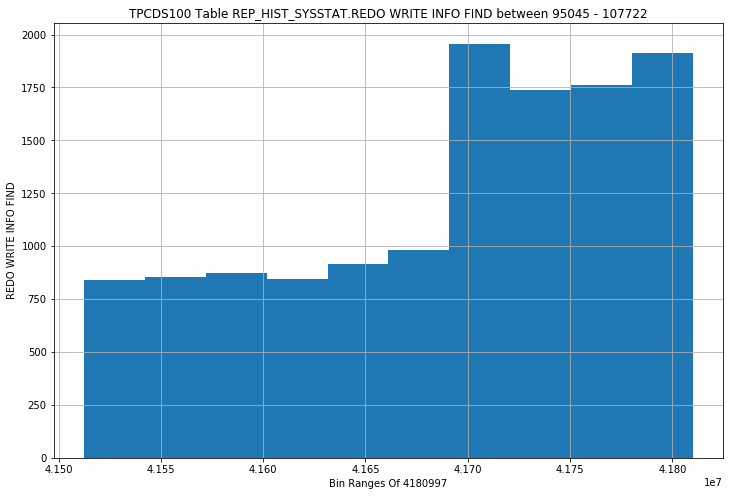

REP_HIST_SYSSTAT - REDO WRITE SCHEDULE TIME - OUTLIERS HISTOGRAM


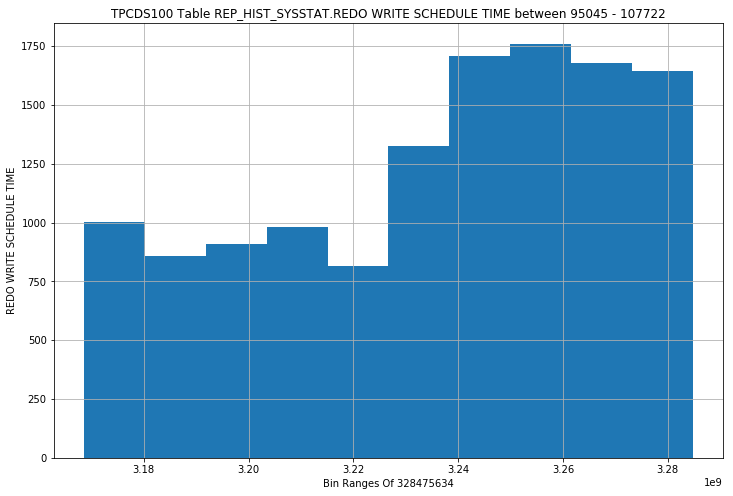

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (   4KB) - OUTLIERS HISTOGRAM


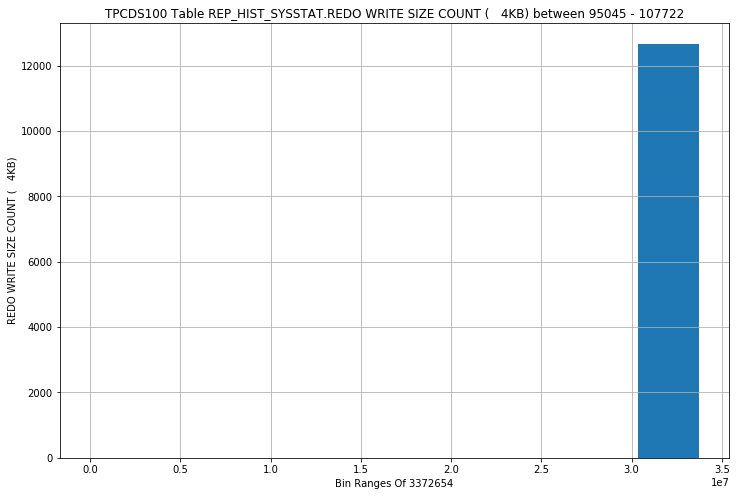

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (   8KB) - OUTLIERS HISTOGRAM


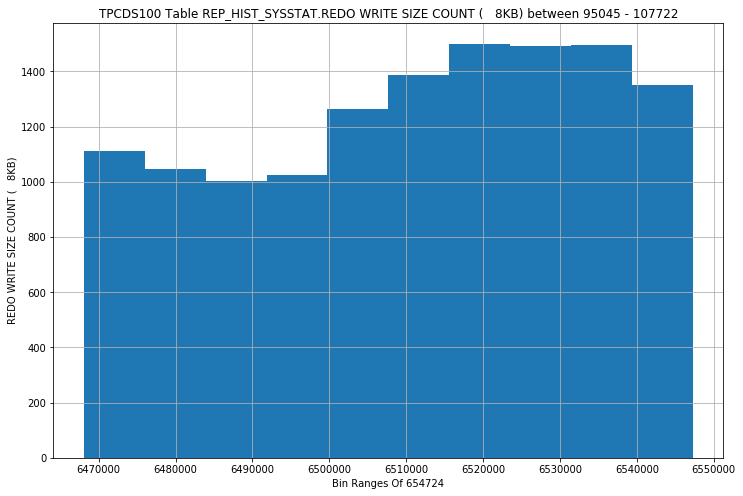

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (  16KB) - OUTLIERS HISTOGRAM


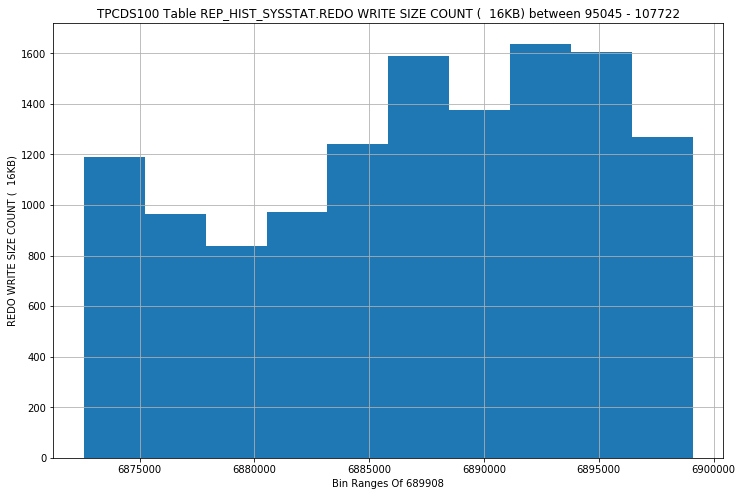

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (  32KB) - OUTLIERS HISTOGRAM


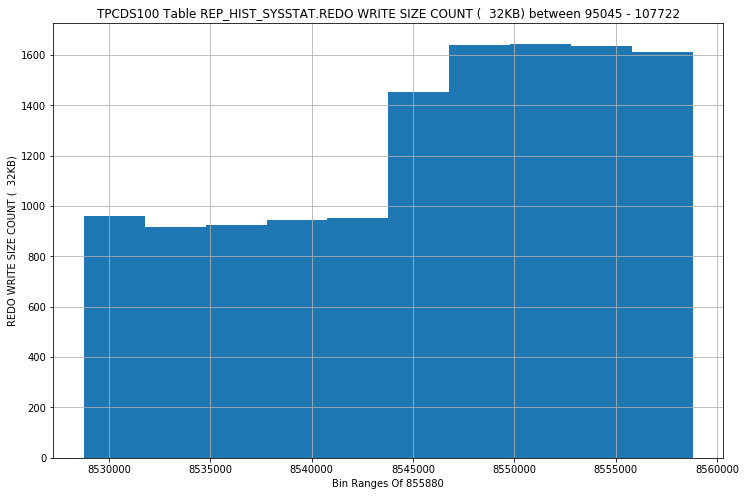

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 128KB) - OUTLIERS HISTOGRAM


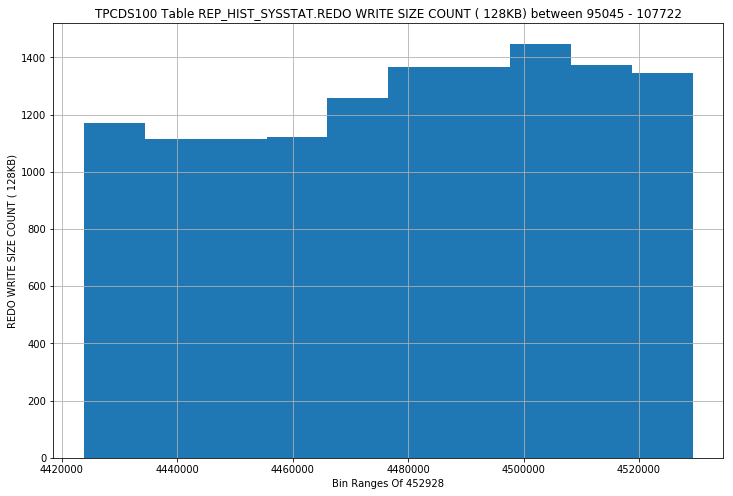

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 256KB) - OUTLIERS HISTOGRAM


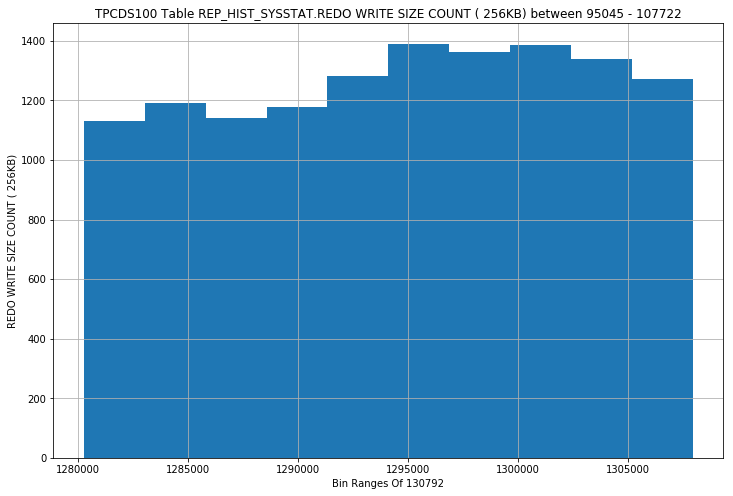

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 512KB) - OUTLIERS HISTOGRAM


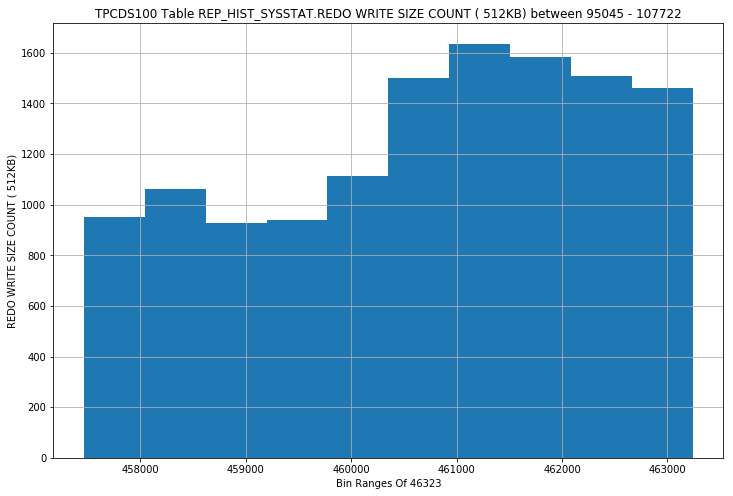

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (1024KB) - OUTLIERS HISTOGRAM


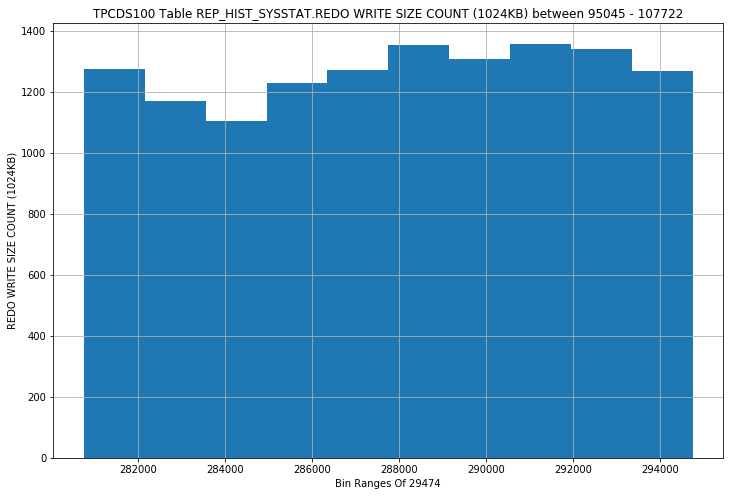

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (INF) - OUTLIERS HISTOGRAM


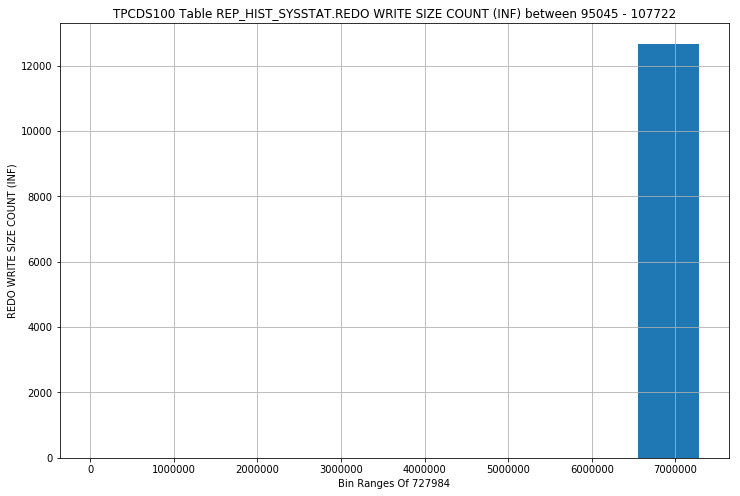

REP_HIST_SYSSTAT - REDO WRITE TIME - OUTLIERS HISTOGRAM


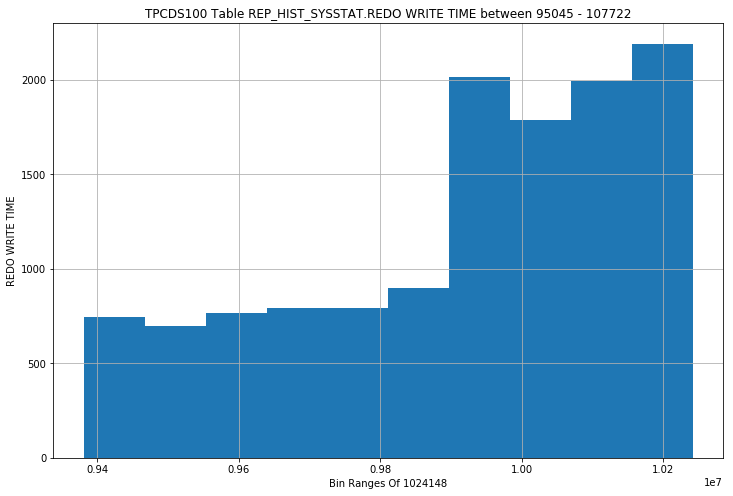

REP_HIST_SYSSTAT - REDO WRITE TIME (USEC) - OUTLIERS HISTOGRAM


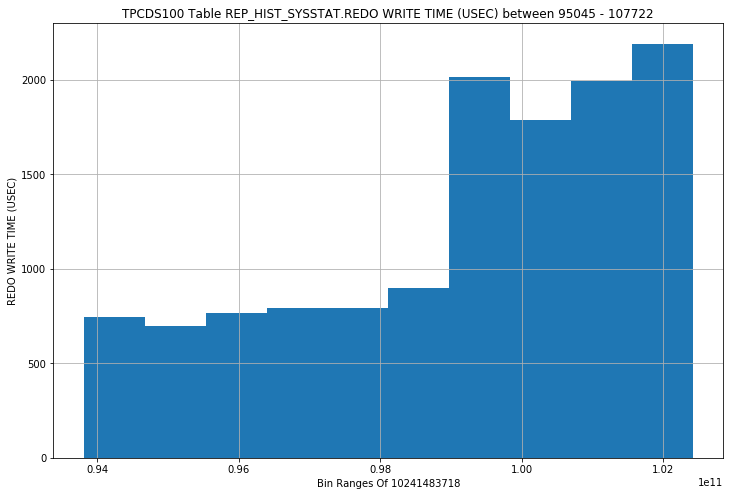

REP_HIST_SYSSTAT - REDO WRITE TOTAL TIME - OUTLIERS HISTOGRAM


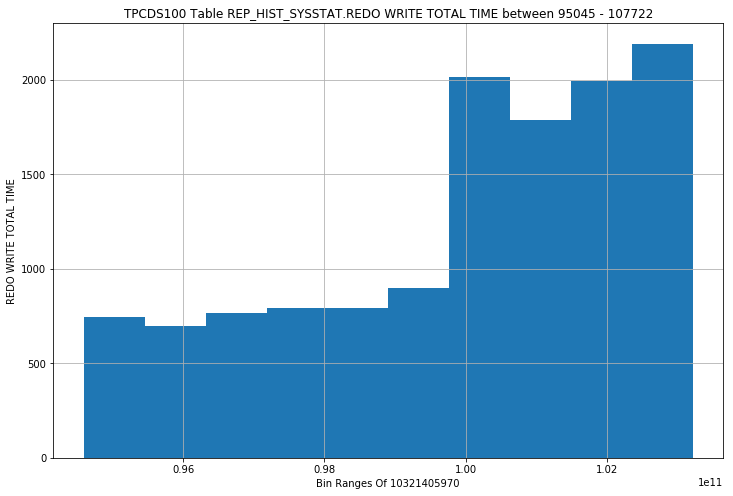

REP_HIST_SYSSTAT - REDO WRITE WORKER DELAY (USEC) - OUTLIERS HISTOGRAM


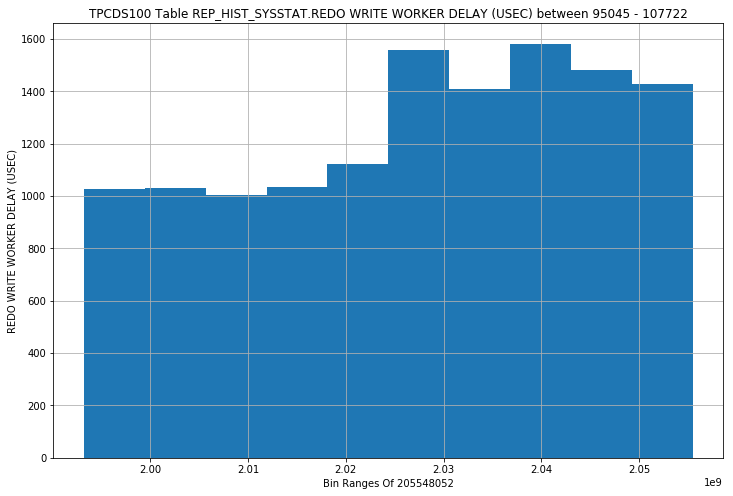

REP_HIST_SYSSTAT - REDO WRITES - OUTLIERS HISTOGRAM


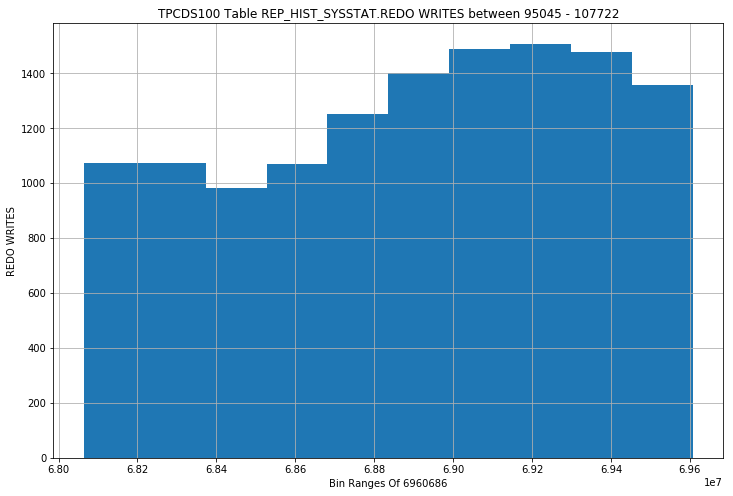

REP_HIST_SYSSTAT - REDO WRITES (GROUP 0) - OUTLIERS HISTOGRAM


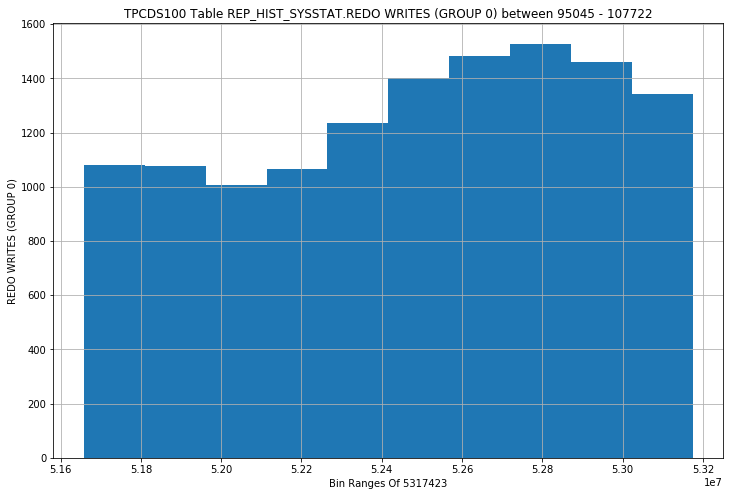

REP_HIST_SYSSTAT - REDO WRITES (GROUP 1) - OUTLIERS HISTOGRAM


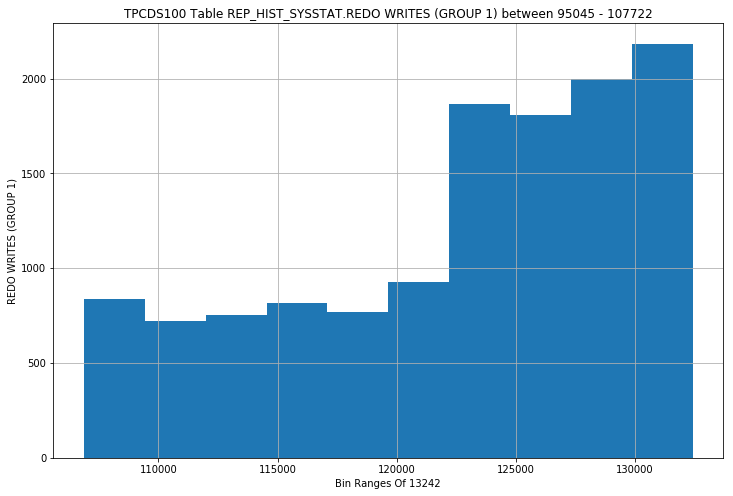

REP_HIST_SYSSTAT - REDO WRITES ADAPTIVE ALL - OUTLIERS HISTOGRAM


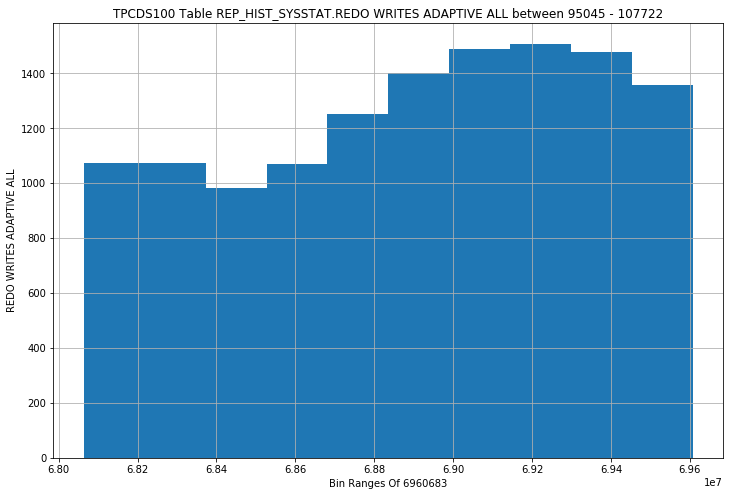

REP_HIST_SYSSTAT - REDO WRITES ADAPTIVE WORKER - OUTLIERS HISTOGRAM


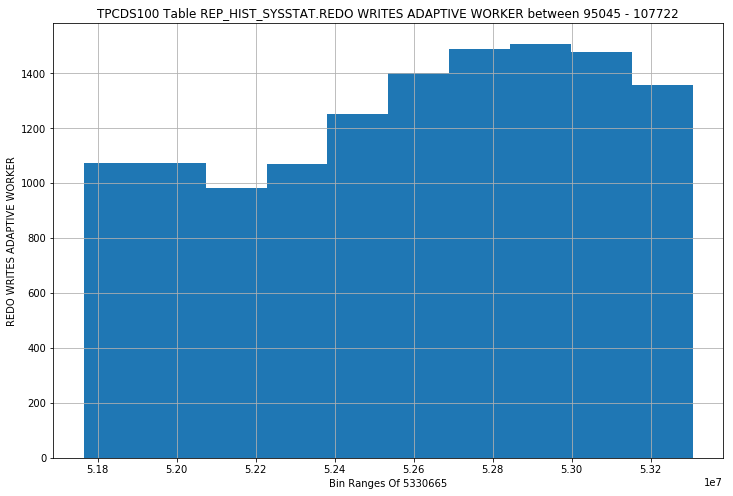

REP_HIST_SYSSTAT - ROLLBACK CHANGES - UNDO RECORDS APPLIED - OUTLIERS HISTOGRAM


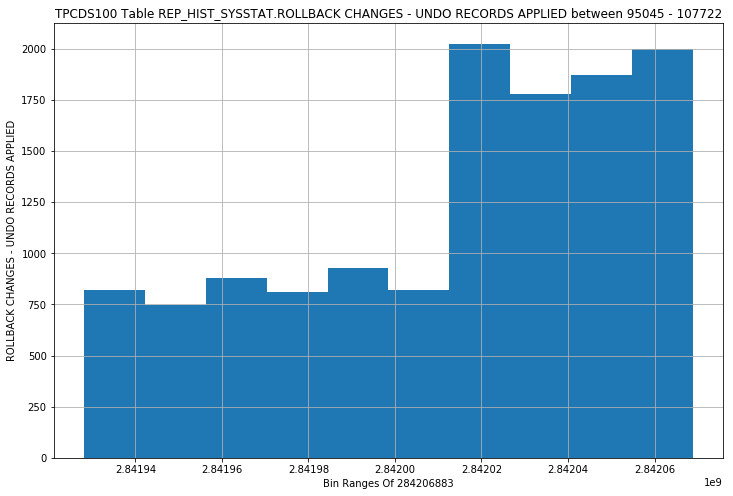

REP_HIST_SYSSTAT - ROLLBACKS ONLY - CONSISTENT READ GETS - OUTLIERS HISTOGRAM


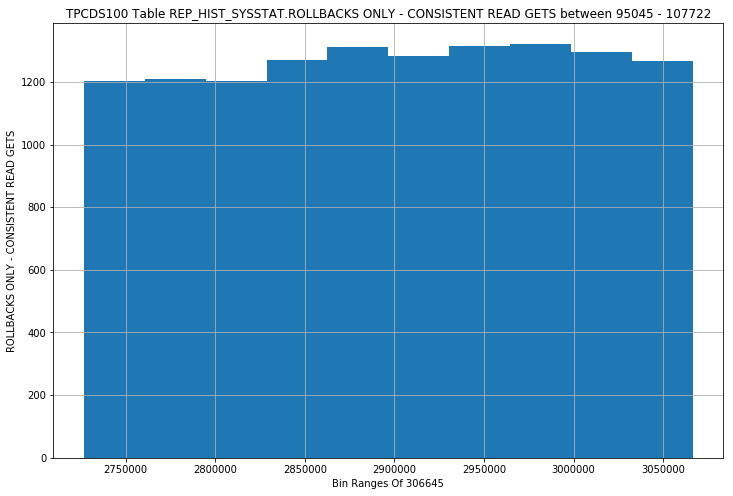

REP_HIST_SYSSTAT - ROOT NODE SPLITS - OUTLIERS HISTOGRAM


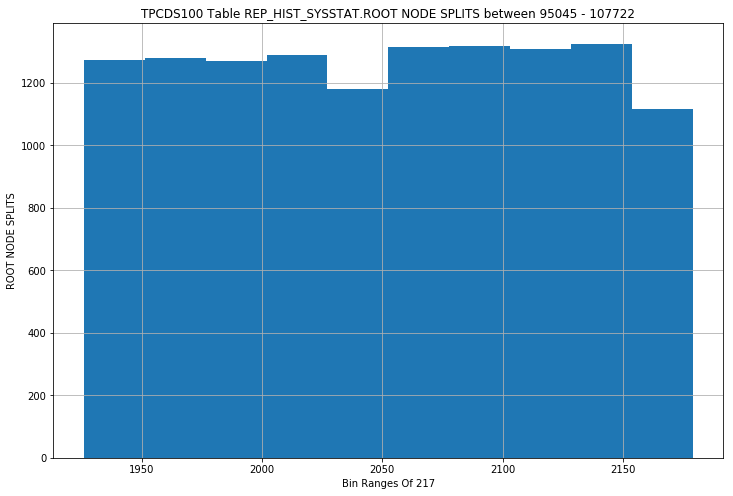

REP_HIST_SYSSTAT - ROWS FETCHED VIA CALLBACK - OUTLIERS HISTOGRAM


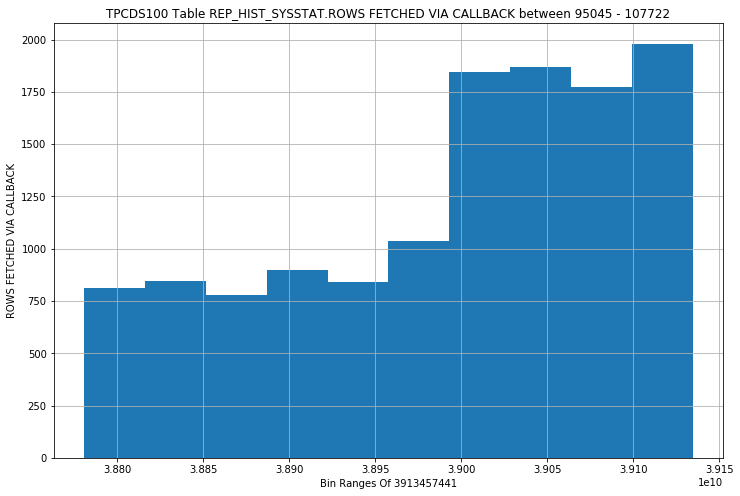

REP_HIST_SYSSTAT - SCHEDULER WAIT TIME - OUTLIERS HISTOGRAM


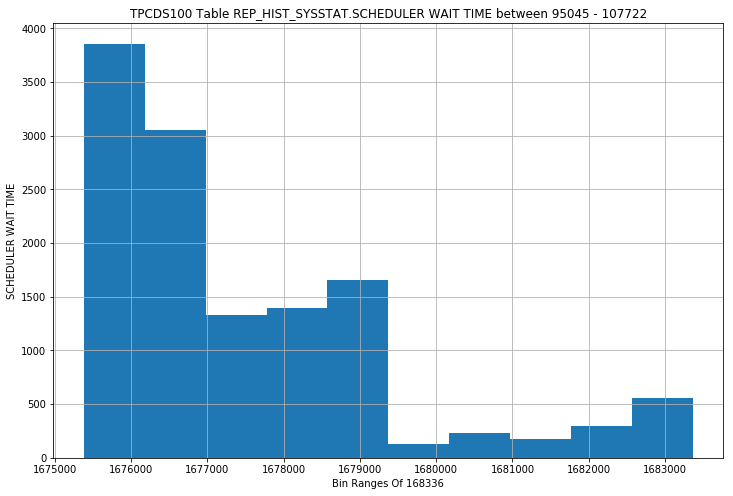

REP_HIST_SYSSTAT - SECUREFILE ALLOCATION BYTES - OUTLIERS HISTOGRAM


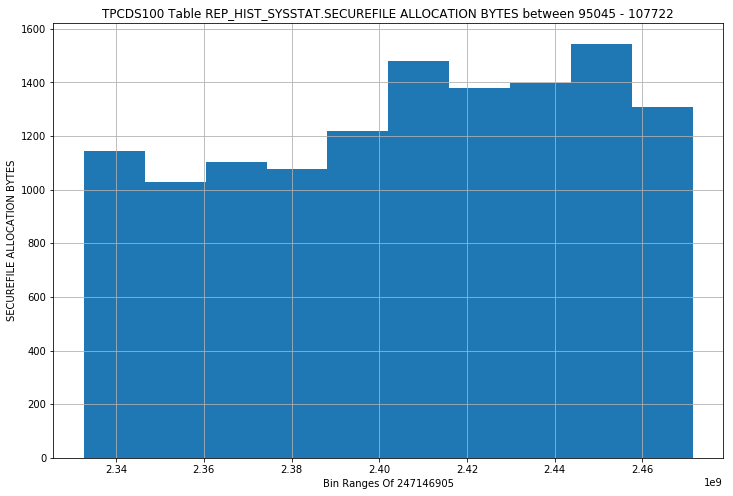

REP_HIST_SYSSTAT - SECUREFILE ALLOCATION CHUNKS - OUTLIERS HISTOGRAM


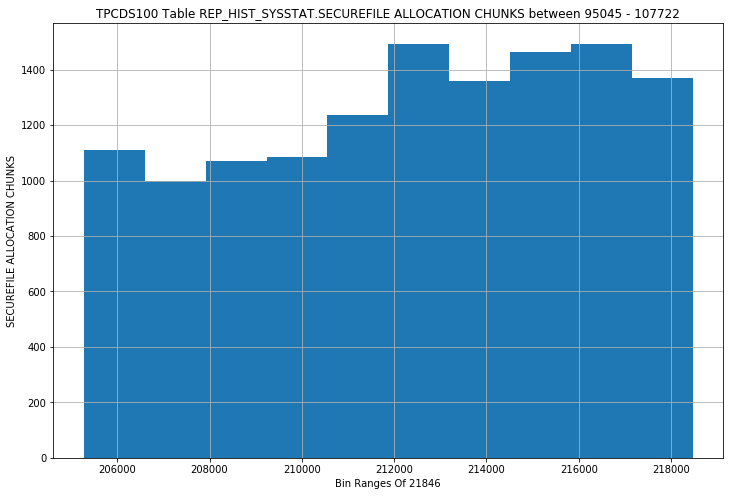

REP_HIST_SYSSTAT - SECUREFILE BYTES NON-TRANSFORMED - OUTLIERS HISTOGRAM


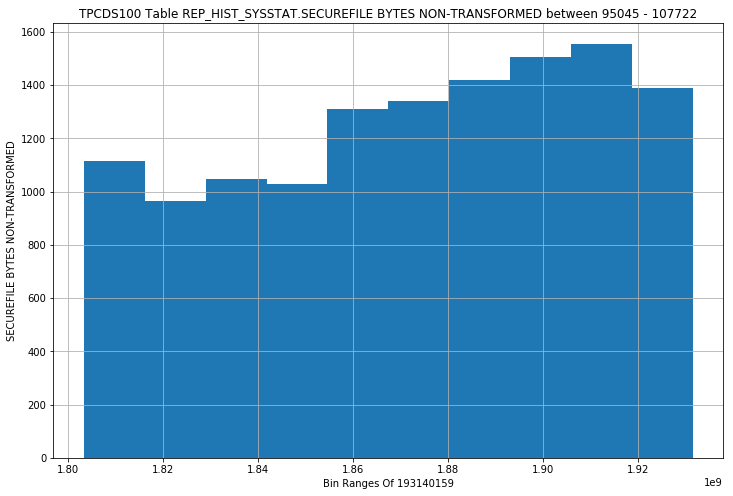

REP_HIST_SYSSTAT - SECUREFILE DIRECT READ BYTES - OUTLIERS HISTOGRAM


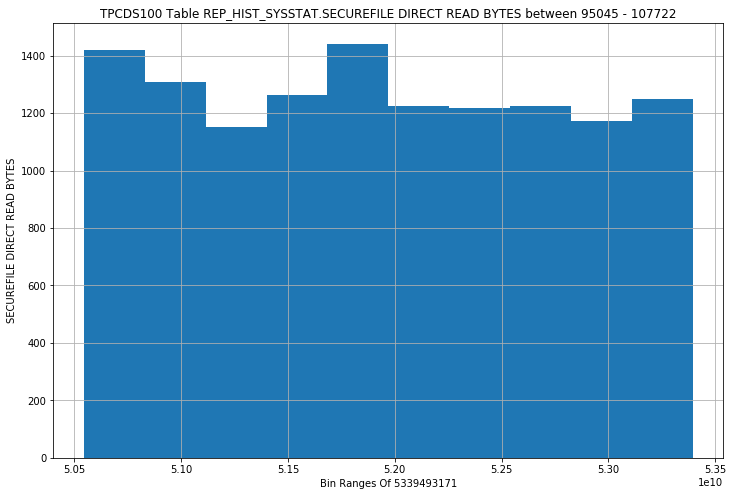

REP_HIST_SYSSTAT - SECUREFILE DIRECT READ OPS - OUTLIERS HISTOGRAM


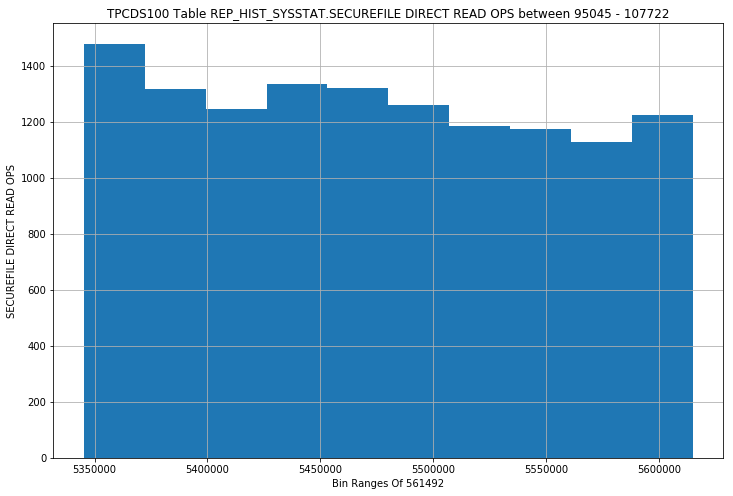

REP_HIST_SYSSTAT - SECUREFILE DIRECT WRITE BYTES - OUTLIERS HISTOGRAM


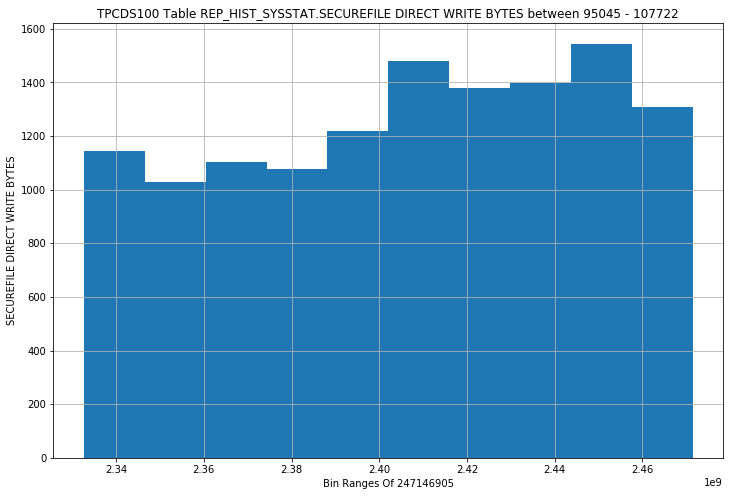

REP_HIST_SYSSTAT - SECUREFILE DIRECT WRITE OPS - OUTLIERS HISTOGRAM


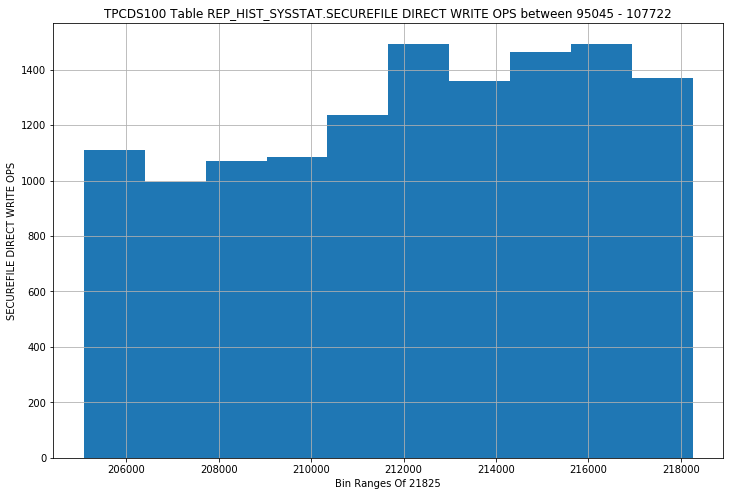

REP_HIST_SYSSTAT - SECUREFILE NUMBER OF NON-TRANSFORMED FLUSHES - OUTLIERS HISTOGRAM


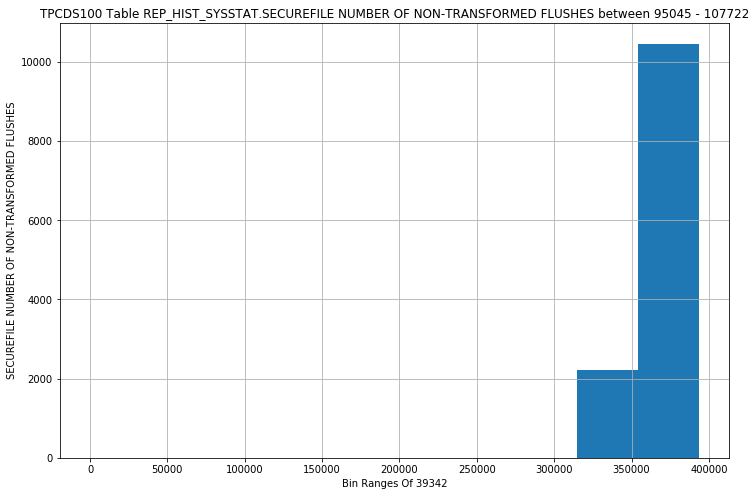

REP_HIST_SYSSTAT - SEGMENT CFS ALLOCATIONS - OUTLIERS HISTOGRAM


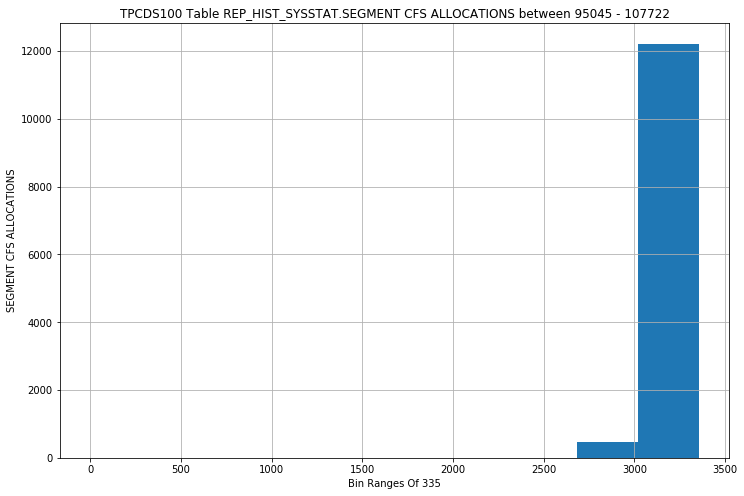

REP_HIST_SYSSTAT - SEGMENT CHUNKS ALLOCATION FROM DISEPNSER - OUTLIERS HISTOGRAM


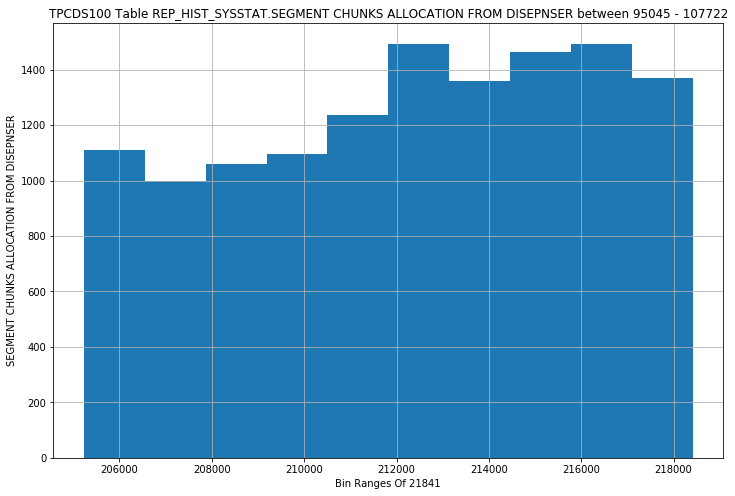

REP_HIST_SYSSTAT - SEGMENT DISPENSER ALLOCATIONS - OUTLIERS HISTOGRAM


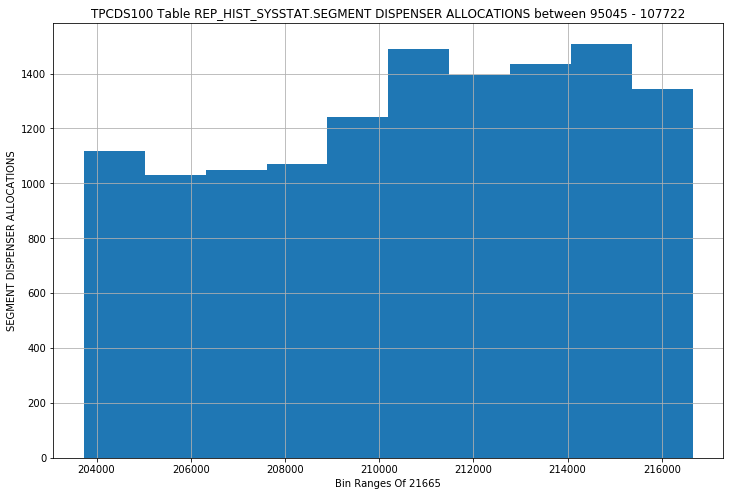

REP_HIST_SYSSTAT - SEGMENT DISPENSER LOAD EMPTY - OUTLIERS HISTOGRAM


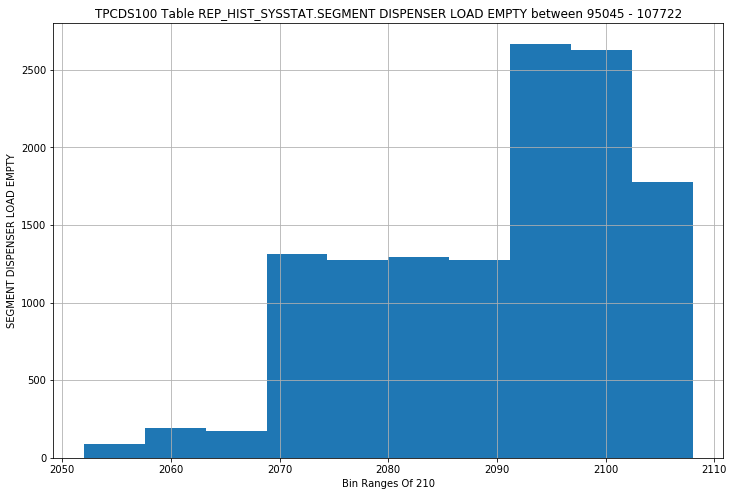

REP_HIST_SYSSTAT - SEGMENT DISPENSER LOAD TASKS - OUTLIERS HISTOGRAM


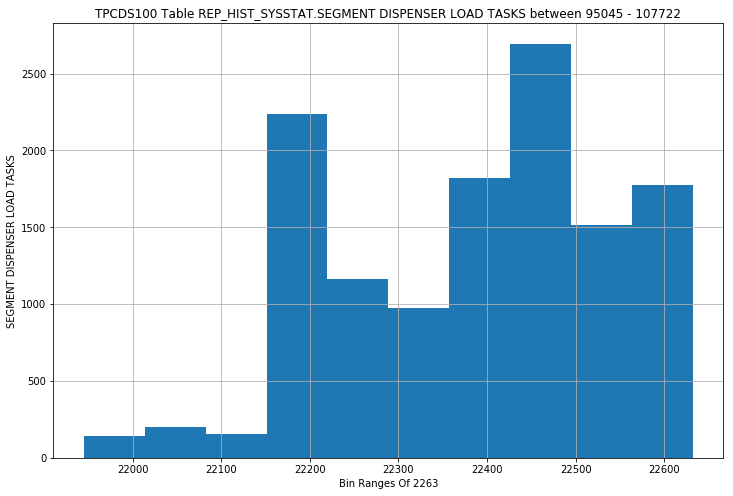

REP_HIST_SYSSTAT - SEGMENT PREALLOC BYTES - OUTLIERS HISTOGRAM


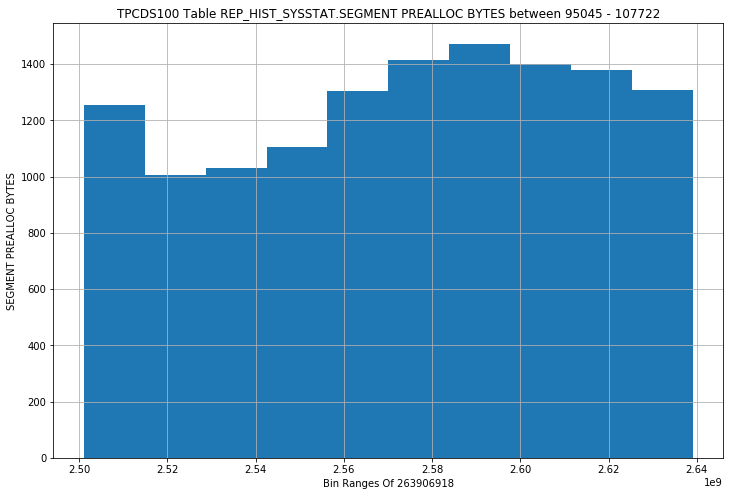

REP_HIST_SYSSTAT - SEGMENT PREALLOC OPS - OUTLIERS HISTOGRAM


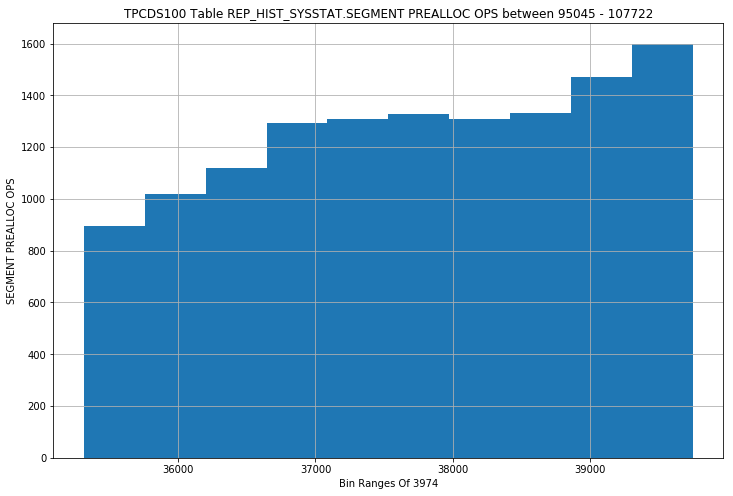

REP_HIST_SYSSTAT - SEGMENT PREALLOC TASKS - OUTLIERS HISTOGRAM


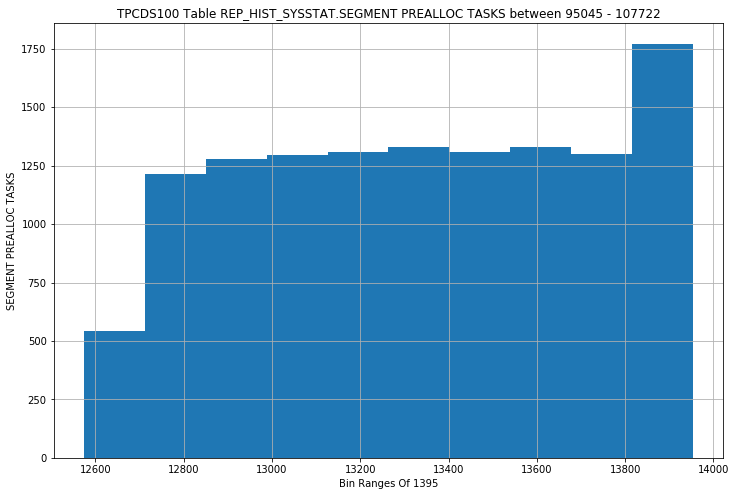

REP_HIST_SYSSTAT - SEGMENT PREALLOC TIME (MS) - OUTLIERS HISTOGRAM


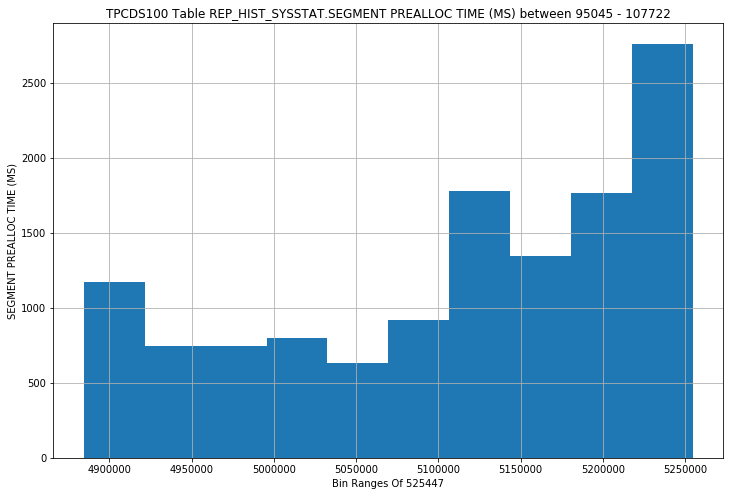

REP_HIST_SYSSTAT - SEGMENT PREALLOC UFS2CFS BYTES - OUTLIERS HISTOGRAM


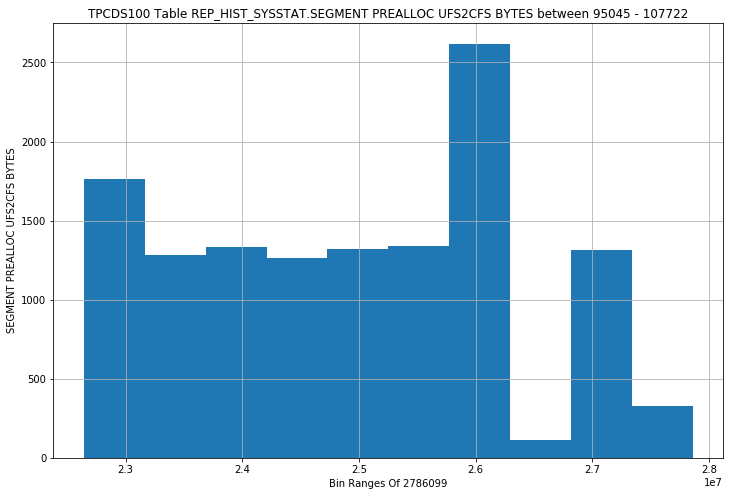

REP_HIST_SYSSTAT - SEGMENT TOTAL CHUNK ALLOCATION - OUTLIERS HISTOGRAM


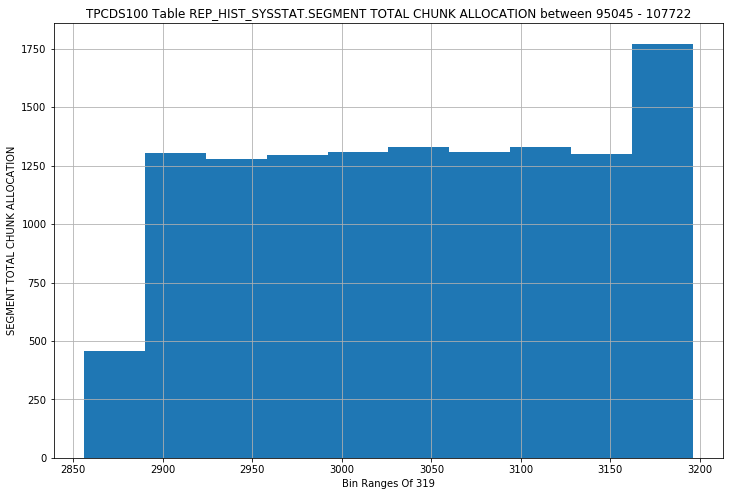

REP_HIST_SYSSTAT - SESSION CONNECT TIME - OUTLIERS HISTOGRAM


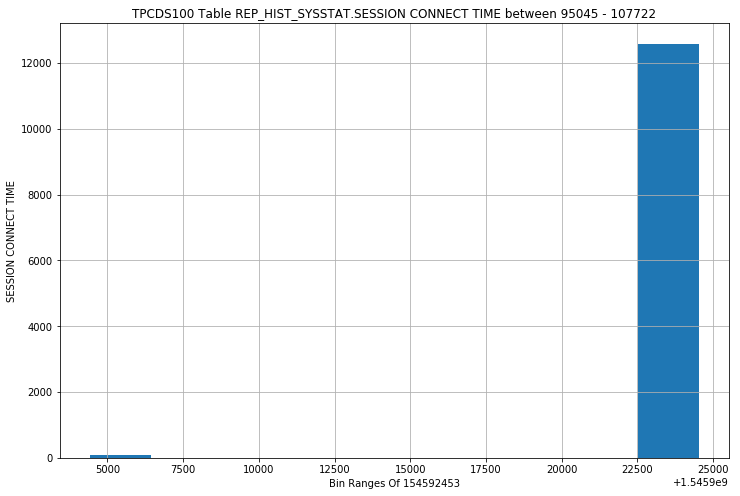

REP_HIST_SYSSTAT - SESSION CURSOR CACHE COUNT - OUTLIERS HISTOGRAM


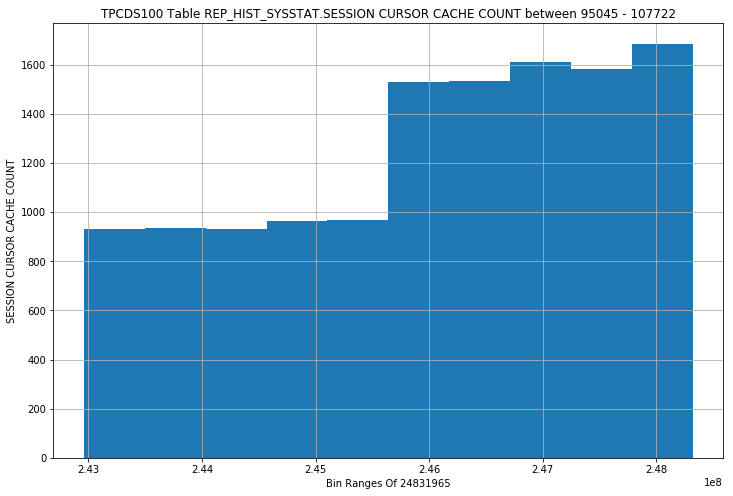

REP_HIST_SYSSTAT - SESSION CURSOR CACHE HITS - OUTLIERS HISTOGRAM


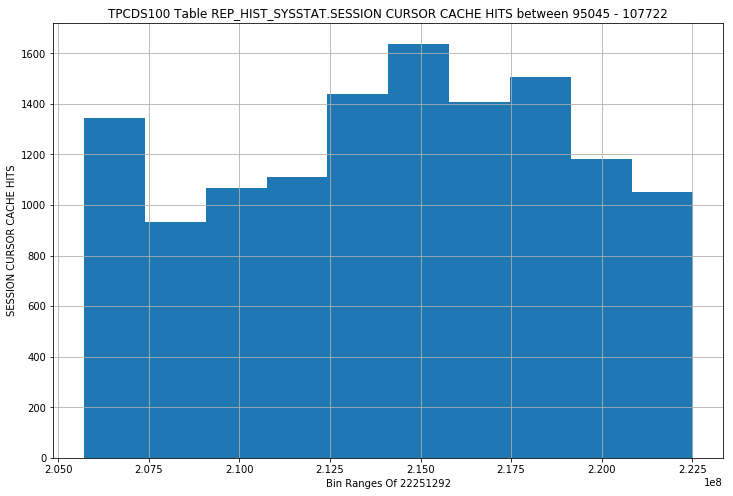

REP_HIST_SYSSTAT - SESSION LOGICAL READS - OUTLIERS HISTOGRAM


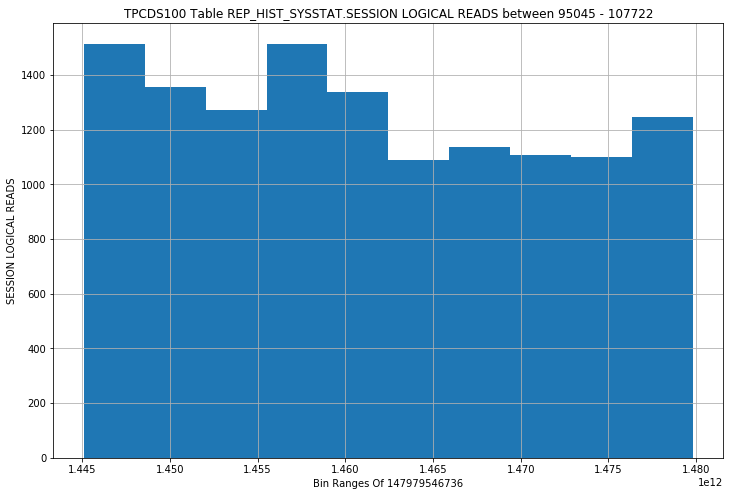

REP_HIST_SYSSTAT - SESSION PGA MEMORY - OUTLIERS HISTOGRAM


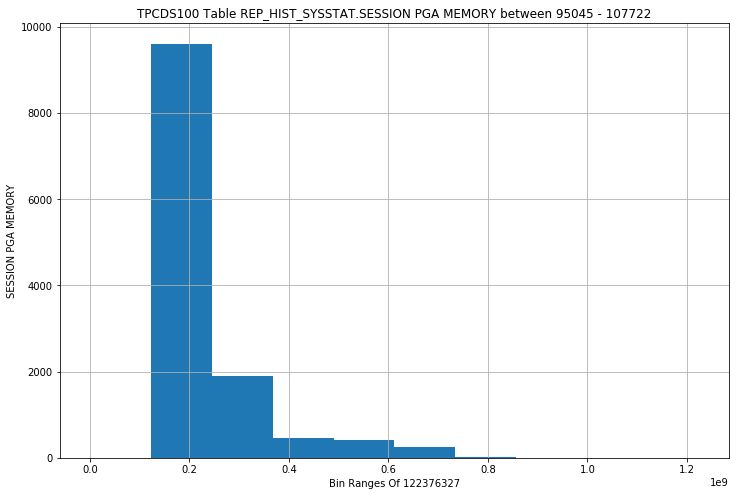

REP_HIST_SYSSTAT - SESSION PGA MEMORY MAX - OUTLIERS HISTOGRAM


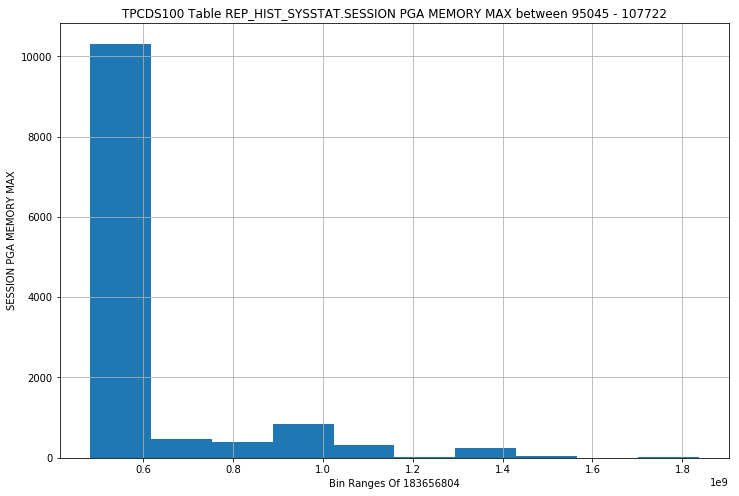

REP_HIST_SYSSTAT - SESSION UGA MEMORY - OUTLIERS HISTOGRAM


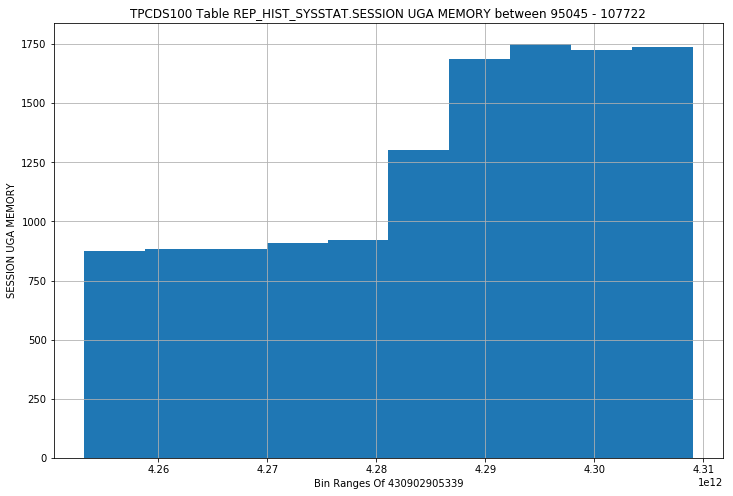

REP_HIST_SYSSTAT - SESSION UGA MEMORY MAX - OUTLIERS HISTOGRAM


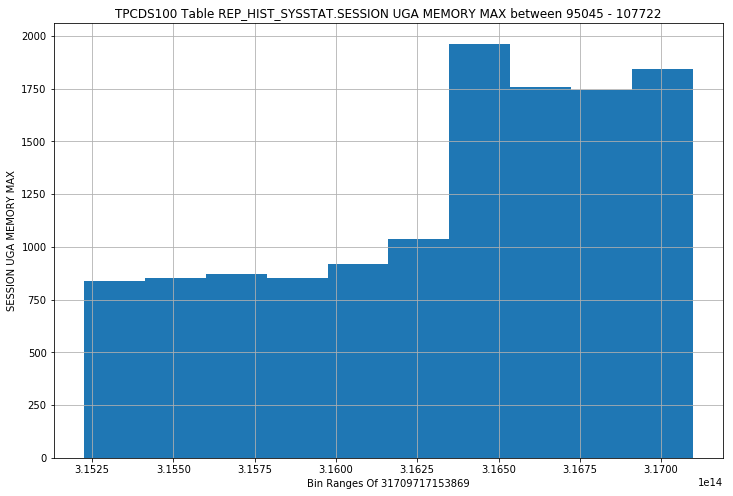

REP_HIST_SYSSTAT - SHARED HASH LATCH UPGRADES - NO WAIT - OUTLIERS HISTOGRAM


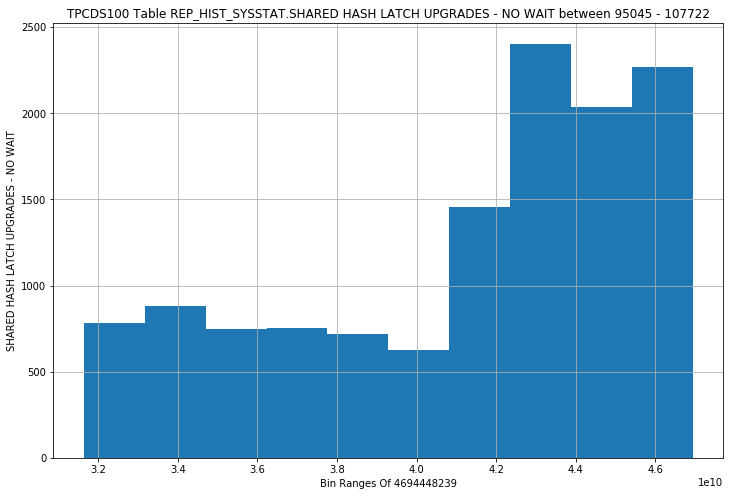

REP_HIST_SYSSTAT - SHARED HASH LATCH UPGRADES - WAIT - OUTLIERS HISTOGRAM


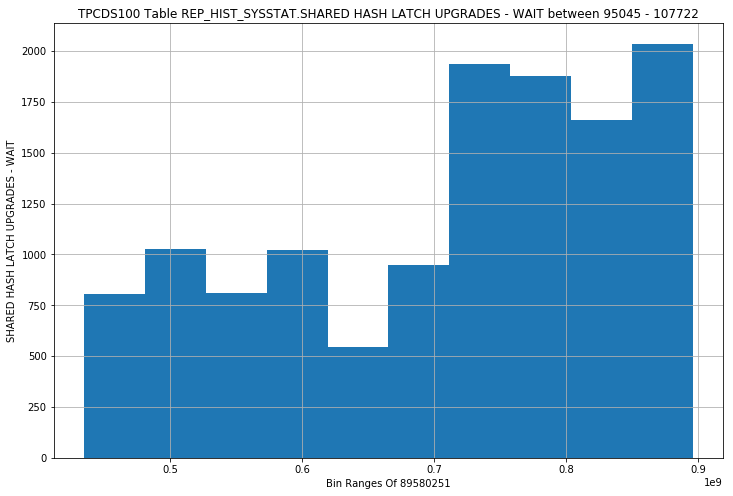

REP_HIST_SYSSTAT - SHARED IO POOL BUFFER GET SUCCESS - OUTLIERS HISTOGRAM


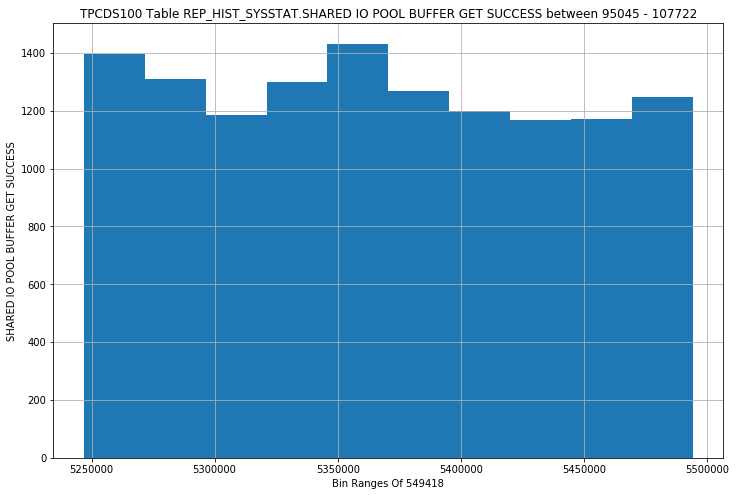

REP_HIST_SYSSTAT - SORTS (DISK) - OUTLIERS HISTOGRAM


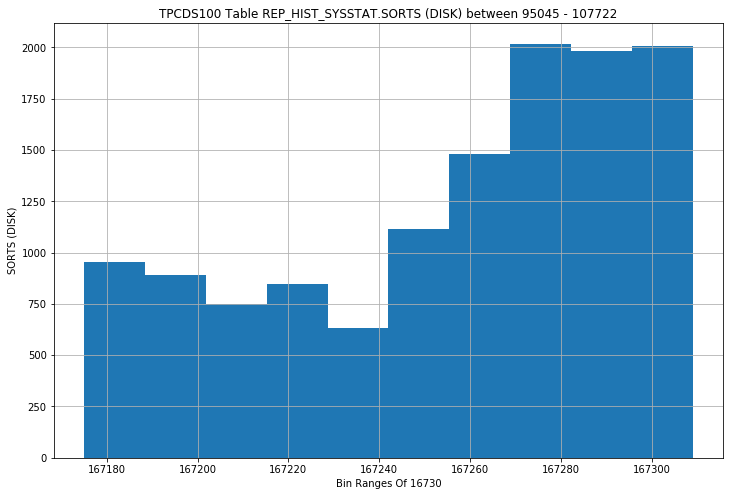

REP_HIST_SYSSTAT - SORTS (MEMORY) - OUTLIERS HISTOGRAM


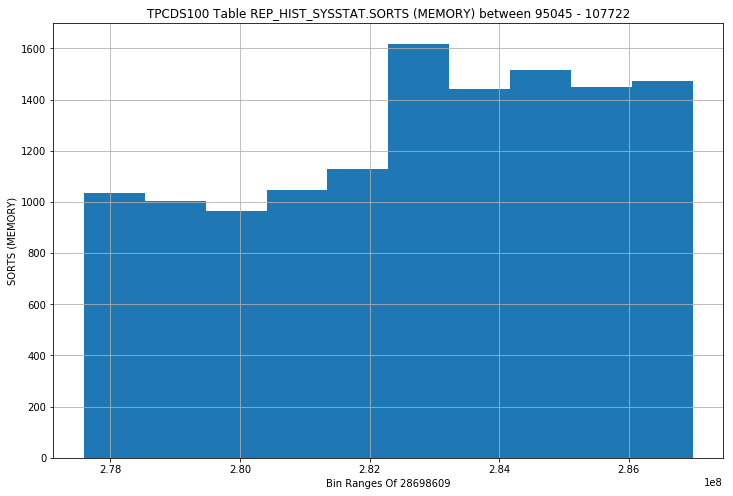

REP_HIST_SYSSTAT - SORTS (ROWS) - OUTLIERS HISTOGRAM


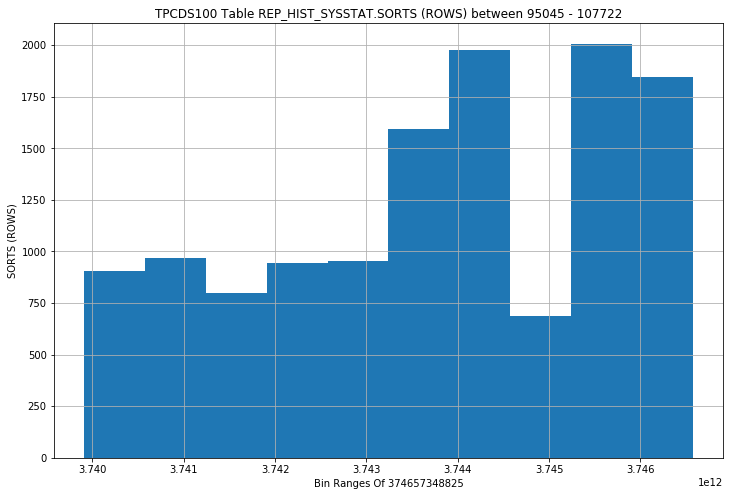

REP_HIST_SYSSTAT - SQL AREA EVICTED - OUTLIERS HISTOGRAM


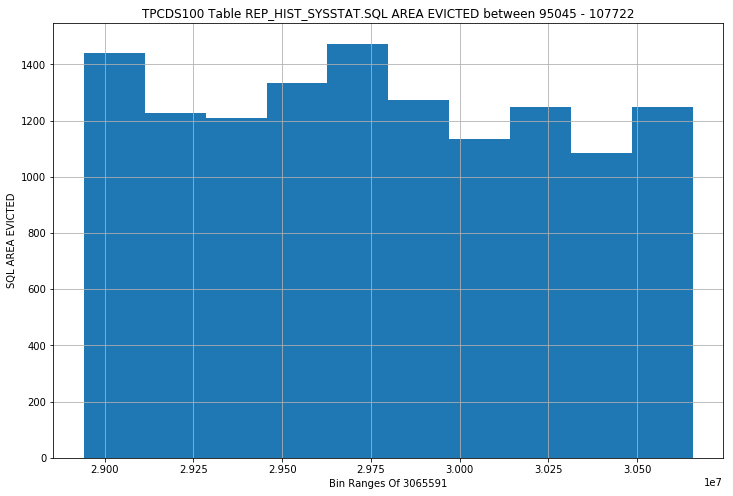

REP_HIST_SYSSTAT - SQL AREA PURGED - OUTLIERS HISTOGRAM


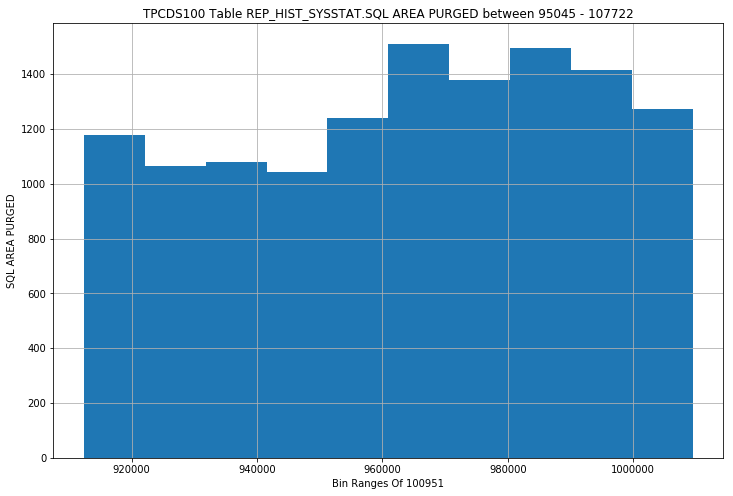

REP_HIST_SYSSTAT - STEPS OF TUNE DOWN RET. IN SPACE PRESSURE - OUTLIERS HISTOGRAM


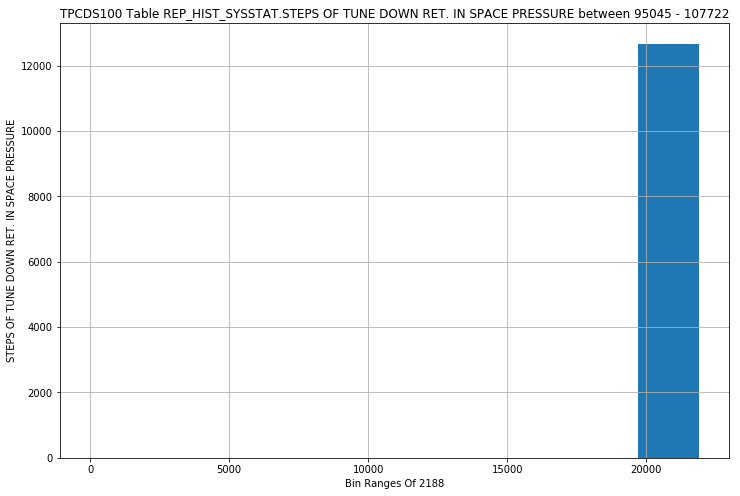

REP_HIST_SYSSTAT - SUMMED DIRTY QUEUE LENGTH - OUTLIERS HISTOGRAM


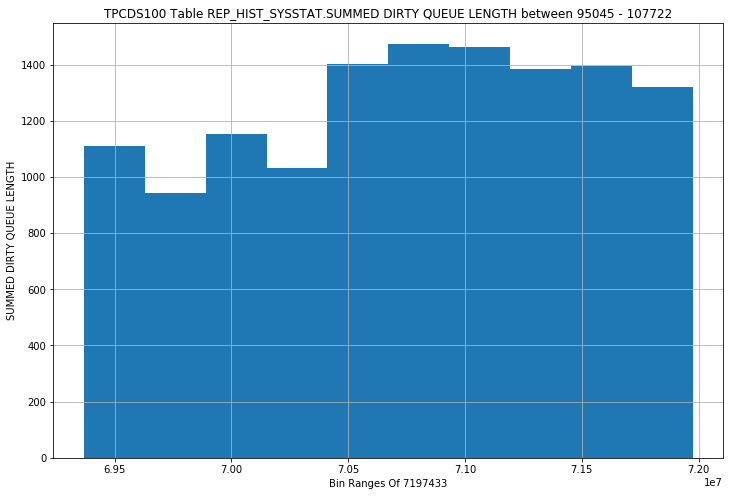

REP_HIST_SYSSTAT - SWITCH CURRENT TO NEW BUFFER - OUTLIERS HISTOGRAM


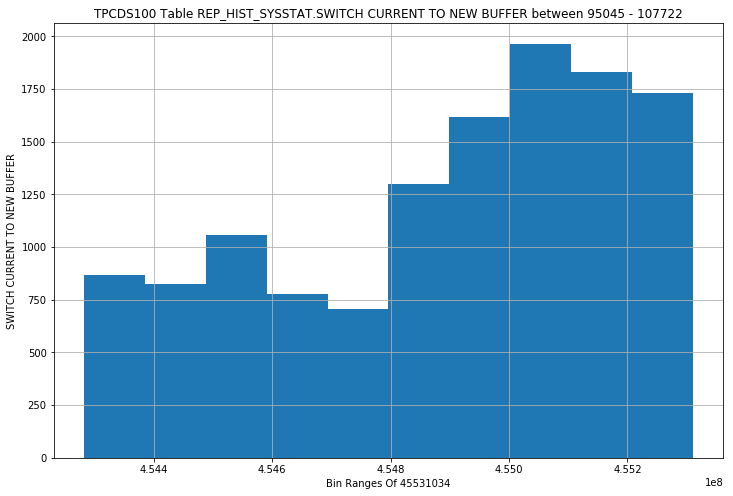

REP_HIST_SYSSTAT - TABLE FETCH BY ROWID - OUTLIERS HISTOGRAM


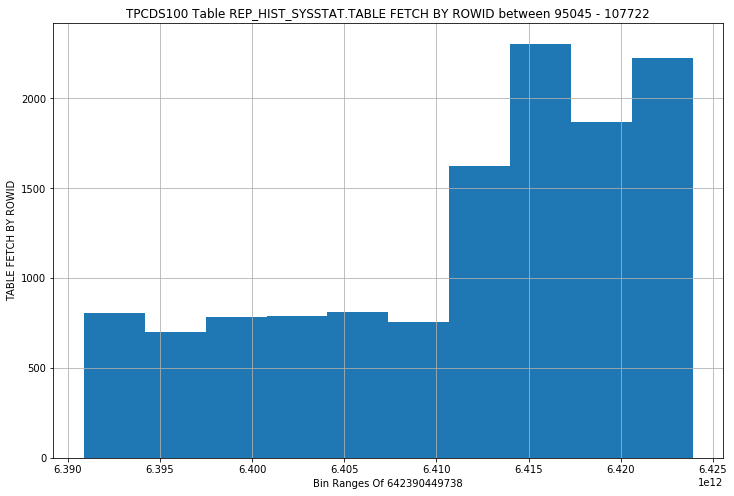

REP_HIST_SYSSTAT - TABLE FETCH CONTINUED ROW - OUTLIERS HISTOGRAM


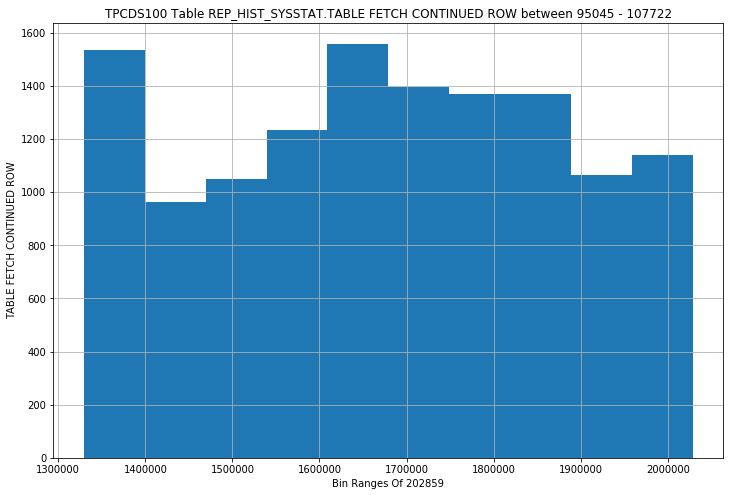

REP_HIST_SYSSTAT - TABLE SCAN BLOCKS GOTTEN - OUTLIERS HISTOGRAM


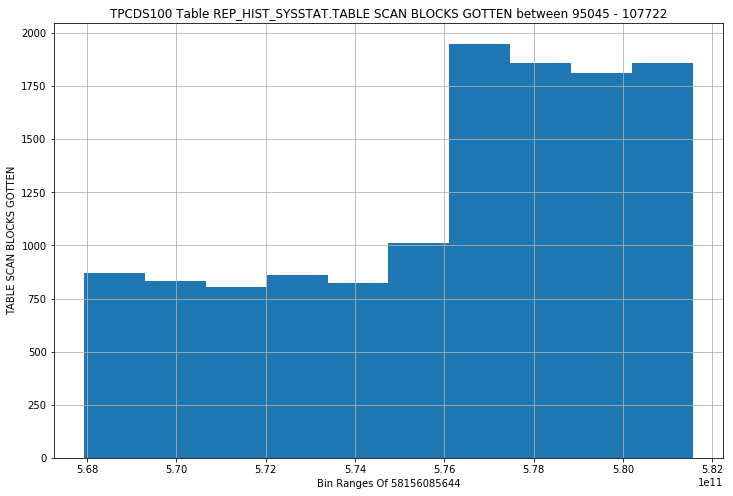

REP_HIST_SYSSTAT - TABLE SCAN DISK NON-IMC ROWS GOTTEN - OUTLIERS HISTOGRAM


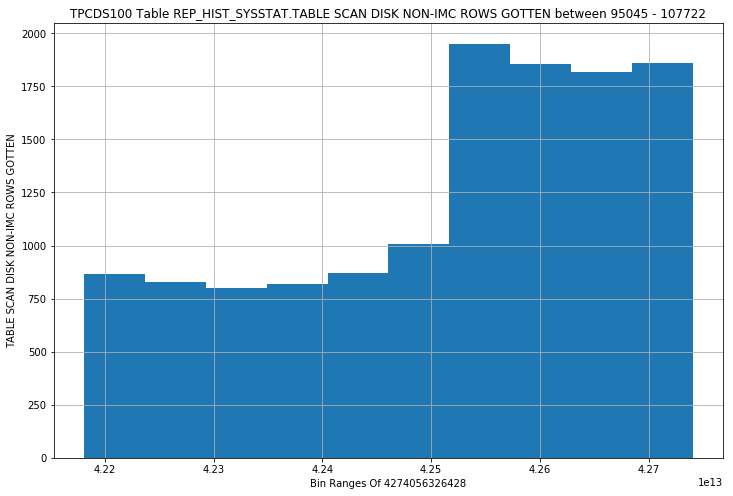

REP_HIST_SYSSTAT - TABLE SCAN ROWS GOTTEN - OUTLIERS HISTOGRAM


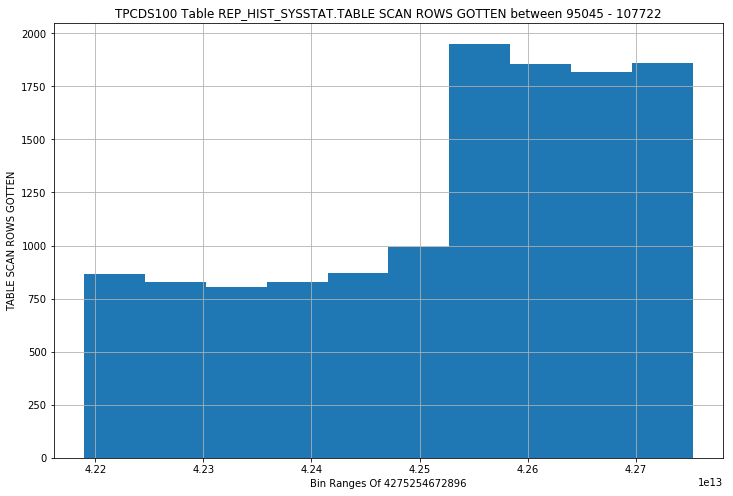

REP_HIST_SYSSTAT - TABLE SCANS (DIRECT READ) - OUTLIERS HISTOGRAM


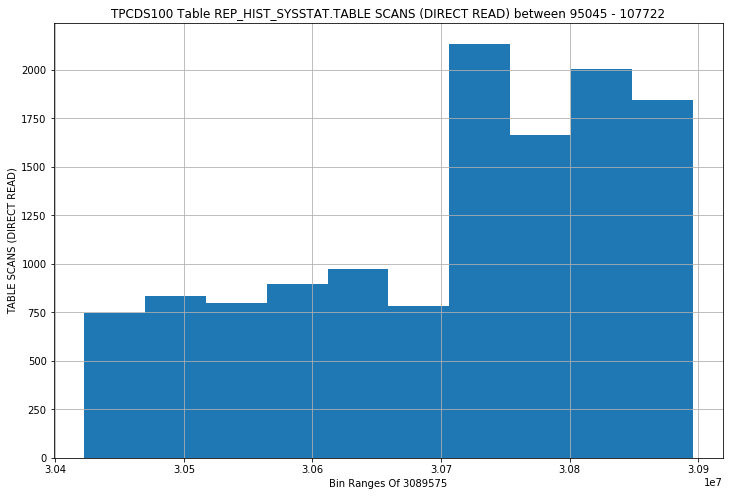

REP_HIST_SYSSTAT - TABLE SCANS (LONG TABLES) - OUTLIERS HISTOGRAM


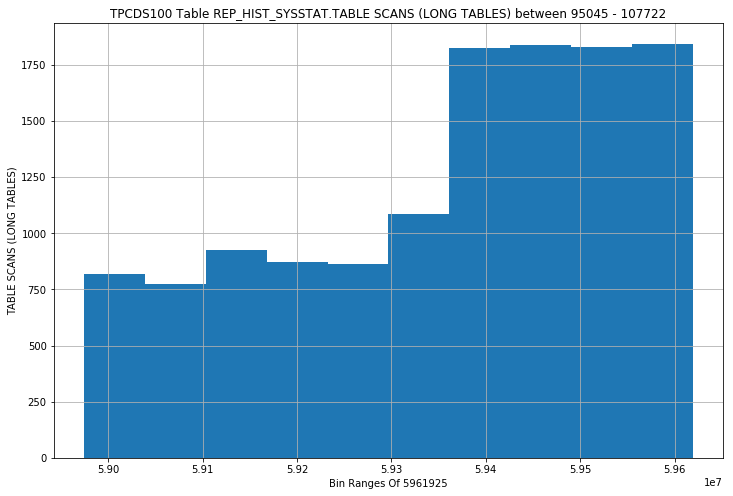

REP_HIST_SYSSTAT - TABLE SCANS (ROWID RANGES) - OUTLIERS HISTOGRAM


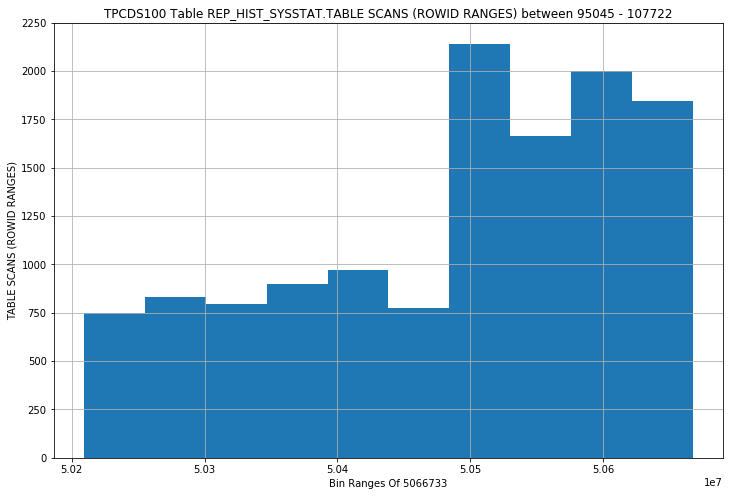

REP_HIST_SYSSTAT - TABLE SCANS (SHORT TABLES) - OUTLIERS HISTOGRAM


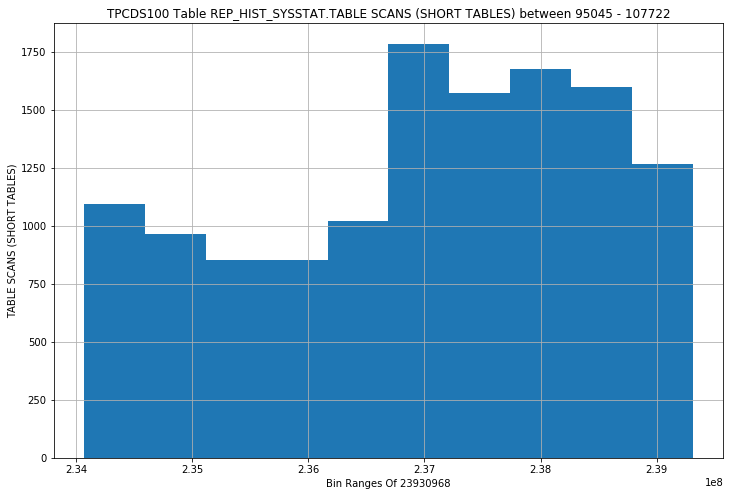

REP_HIST_SYSSTAT - TEMP SPACE ALLOCATED (BYTES) - OUTLIERS HISTOGRAM


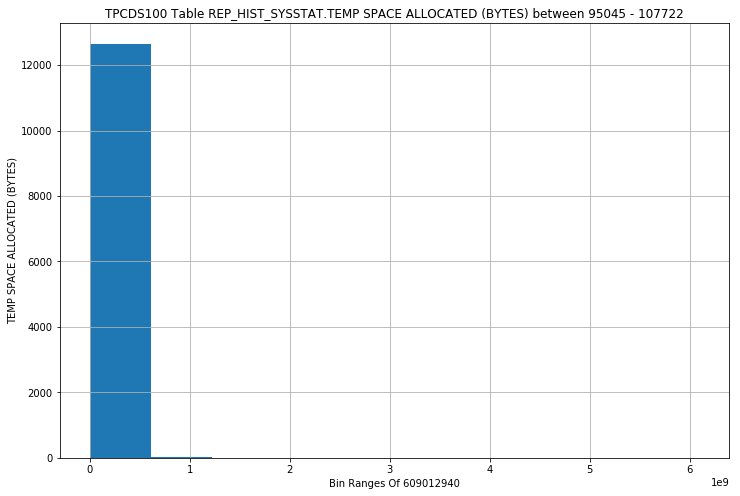

REP_HIST_SYSSTAT - TOTAL CF ENQ HOLD TIME - OUTLIERS HISTOGRAM


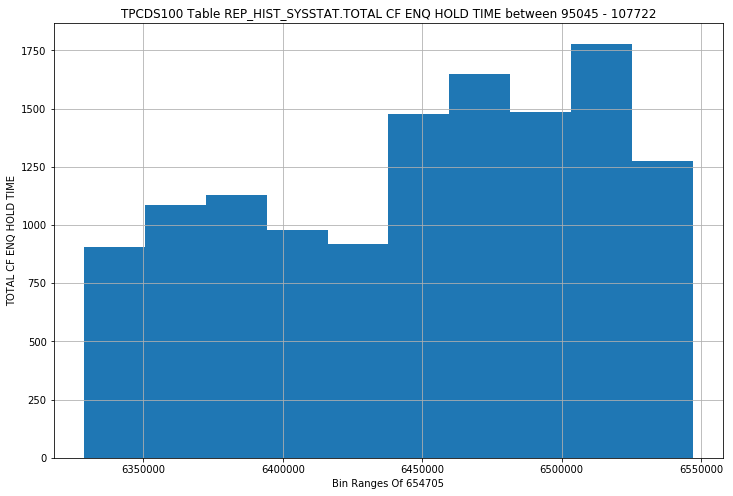

REP_HIST_SYSSTAT - TOTAL NUMBER OF CF ENQ HOLDERS - OUTLIERS HISTOGRAM


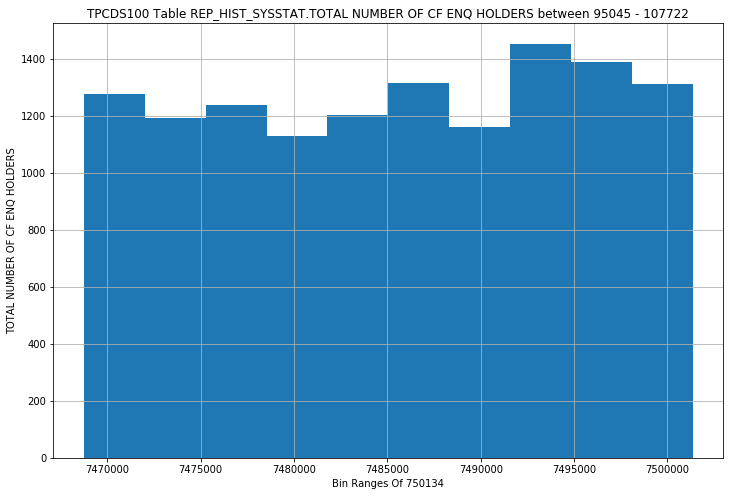

REP_HIST_SYSSTAT - TOTAL NUMBER OF SLOTS - OUTLIERS HISTOGRAM


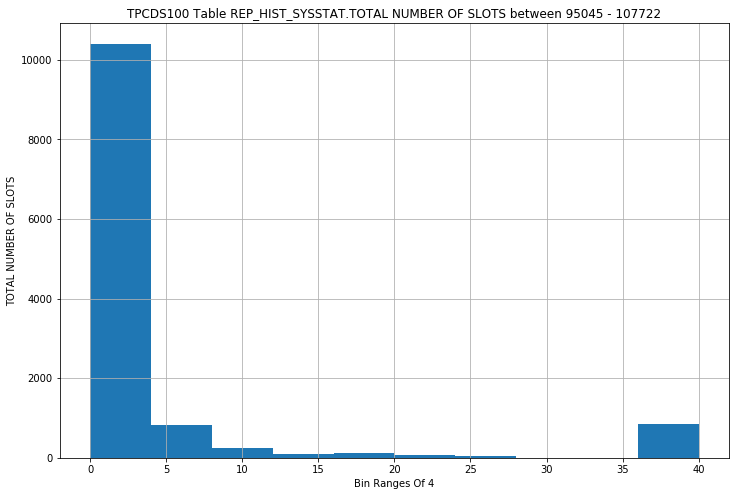

REP_HIST_SYSSTAT - TOTAL NUMBER OF TIMES SMON POSTED - OUTLIERS HISTOGRAM


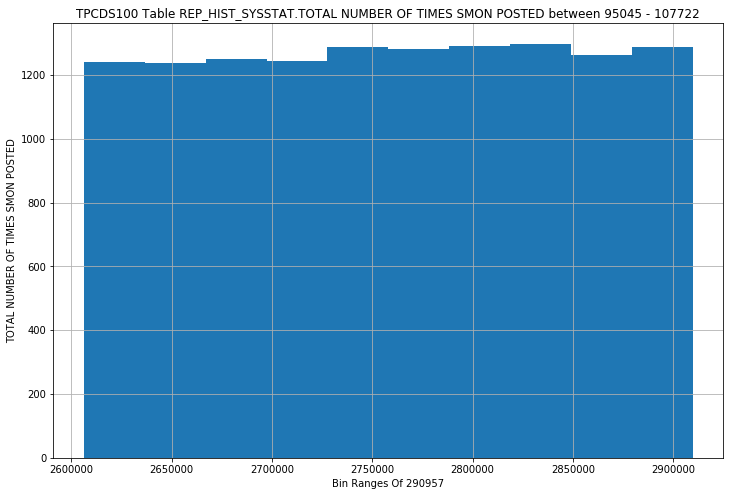

REP_HIST_SYSSTAT - TRANSACTION ROLLBACKS - OUTLIERS HISTOGRAM


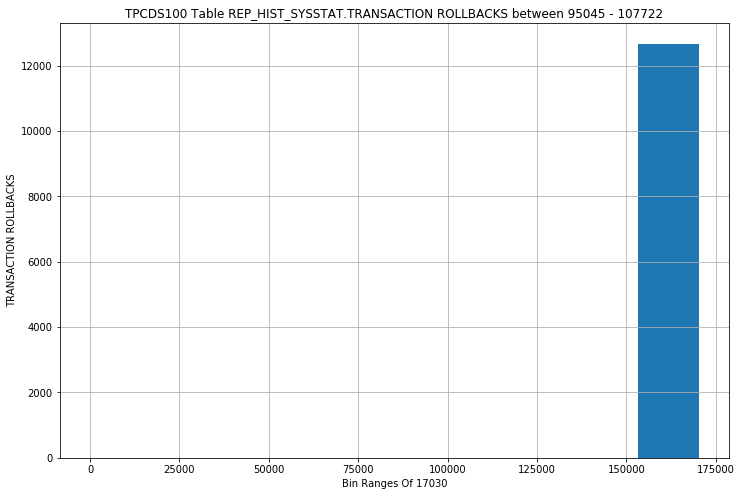

REP_HIST_SYSSTAT - TRANSACTION TABLES CONSISTENT READ ROLLBACKS - OUTLIERS HISTOGRAM


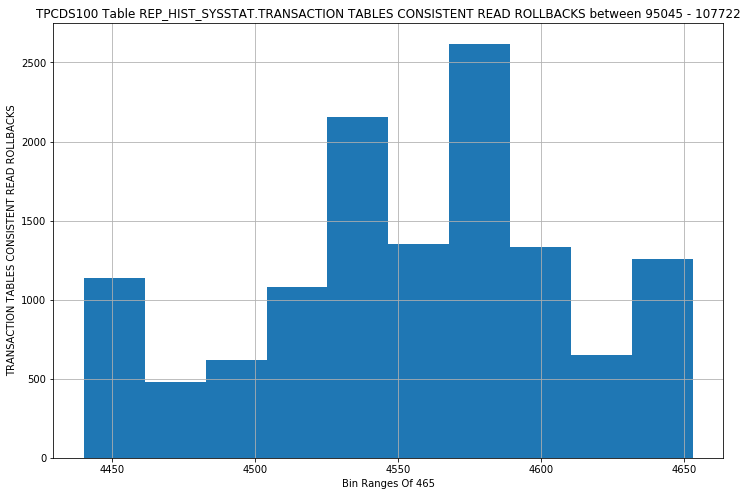

REP_HIST_SYSSTAT - TRANSACTION TABLES CONSISTENT READS - UNDO RECORDS APPLIED - OUTLIERS HISTOGRAM


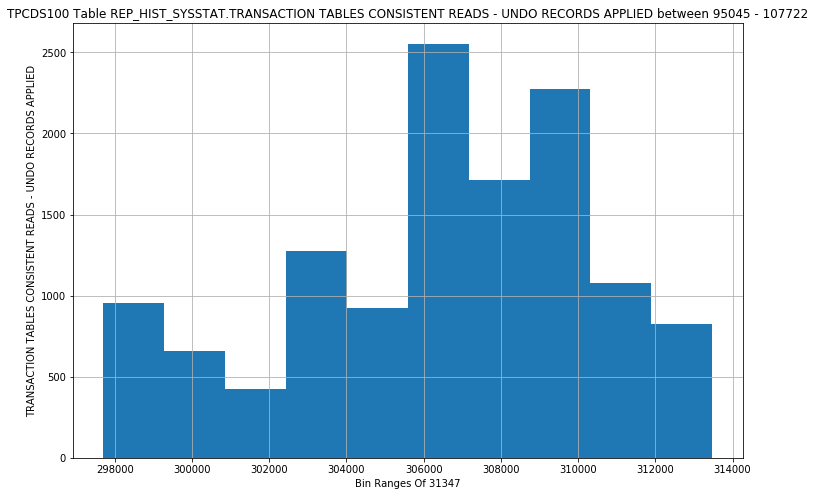

REP_HIST_SYSSTAT - UNDO CHANGE VECTOR SIZE - OUTLIERS HISTOGRAM


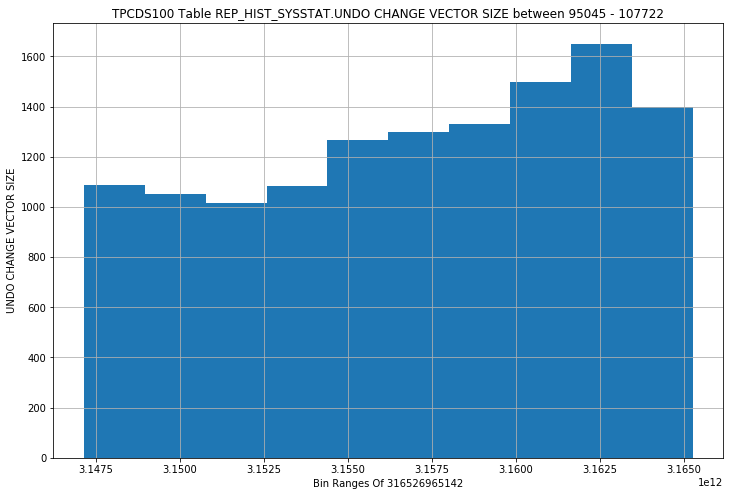

REP_HIST_SYSSTAT - USER I/O WAIT TIME - OUTLIERS HISTOGRAM


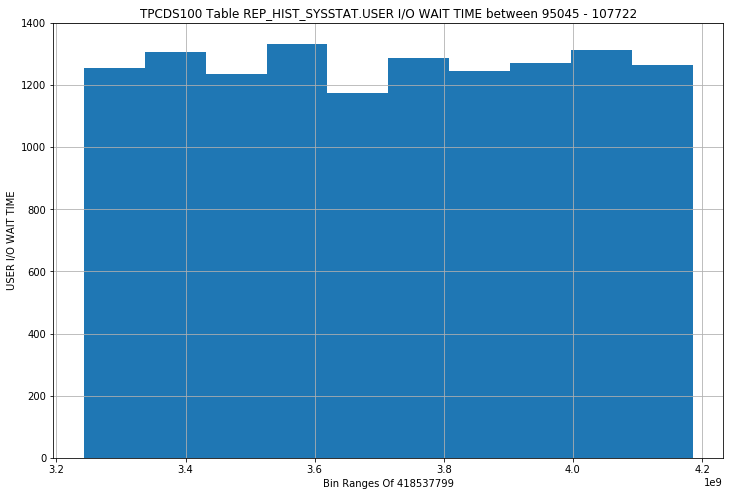

REP_HIST_SYSSTAT - USER CALLS - OUTLIERS HISTOGRAM


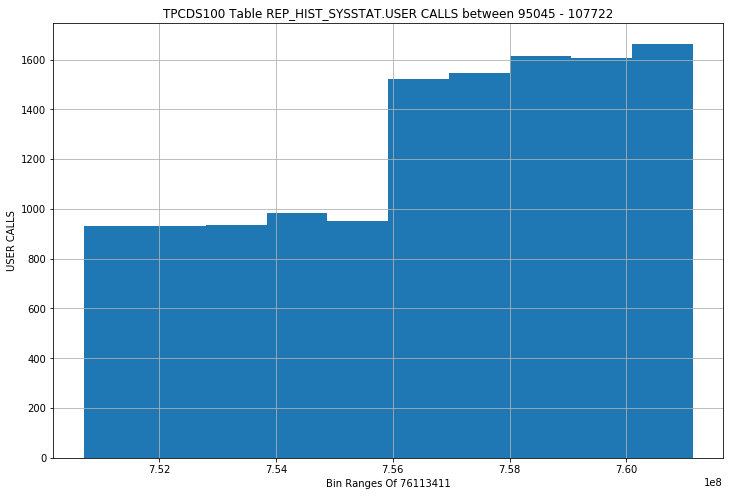

REP_HIST_SYSSTAT - USER COMMITS - OUTLIERS HISTOGRAM


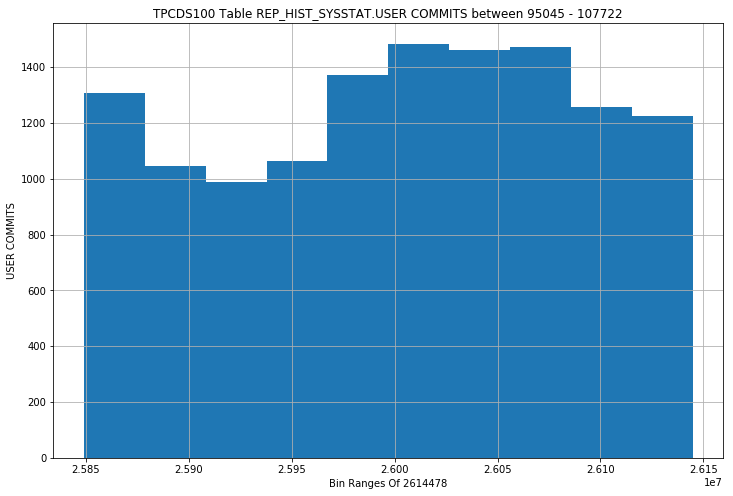

REP_HIST_SYSSTAT - USER LOGONS CUMULATIVE - OUTLIERS HISTOGRAM


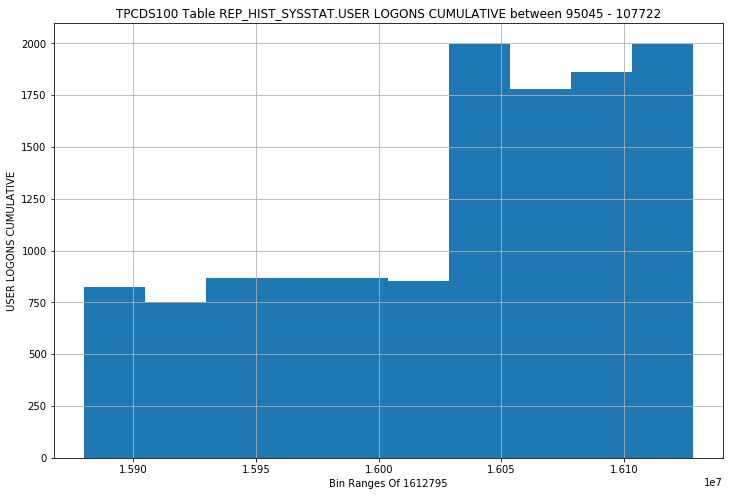

REP_HIST_SYSSTAT - USER LOGOUTS CUMULATIVE - OUTLIERS HISTOGRAM


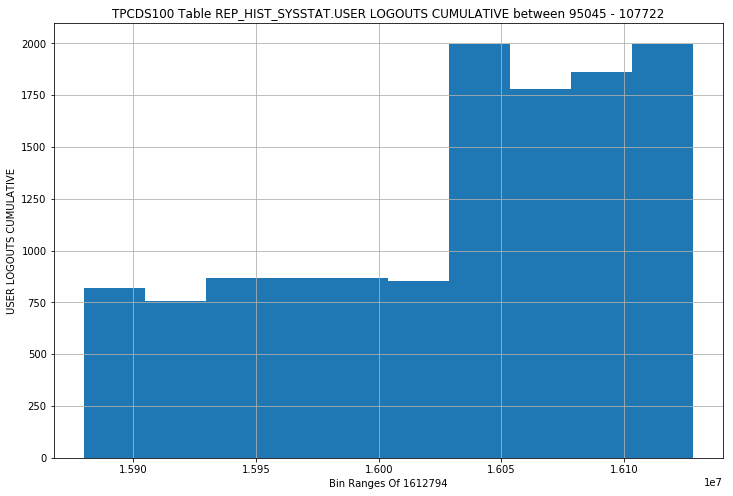

REP_HIST_SYSSTAT - USER ROLLBACKS - OUTLIERS HISTOGRAM


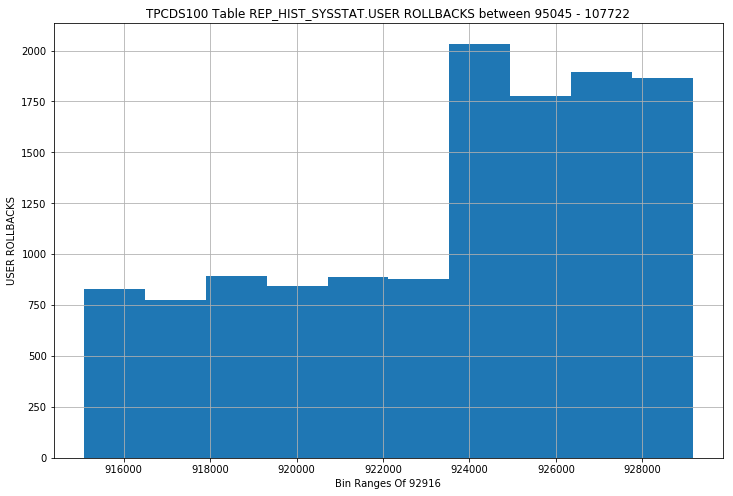

REP_HIST_SYSSTAT - WORKAREA EXECUTIONS - ONEPASS - OUTLIERS HISTOGRAM


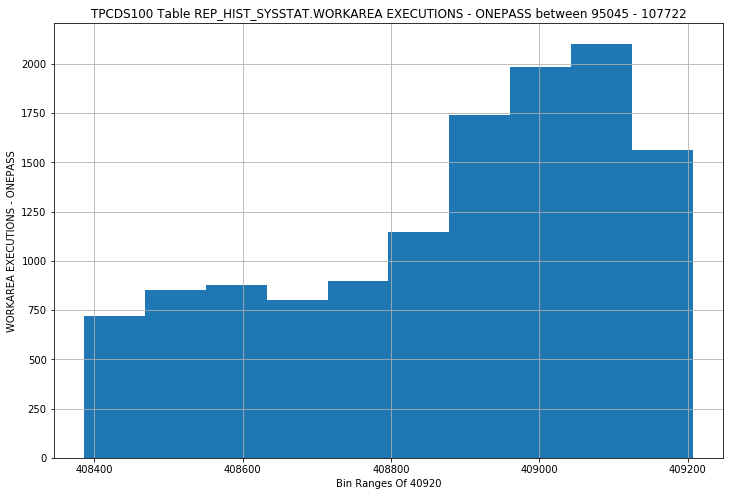

REP_HIST_SYSSTAT - WORKAREA EXECUTIONS - OPTIMAL - OUTLIERS HISTOGRAM


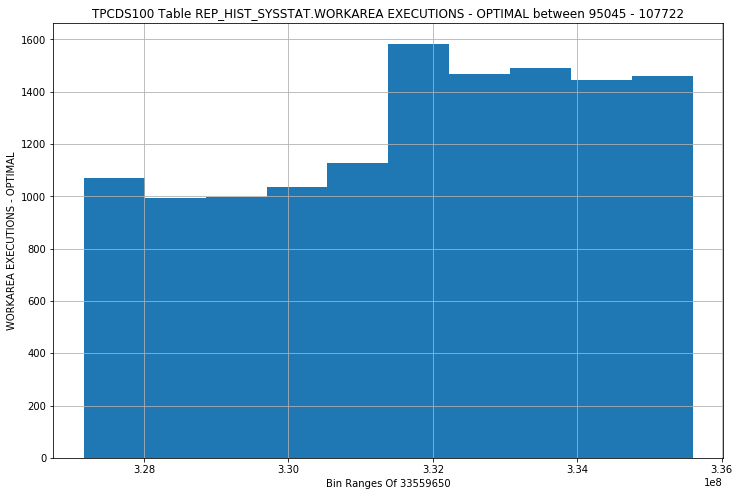

REP_HIST_SYSSTAT - WORKAREA MEMORY ALLOCATED - OUTLIERS HISTOGRAM


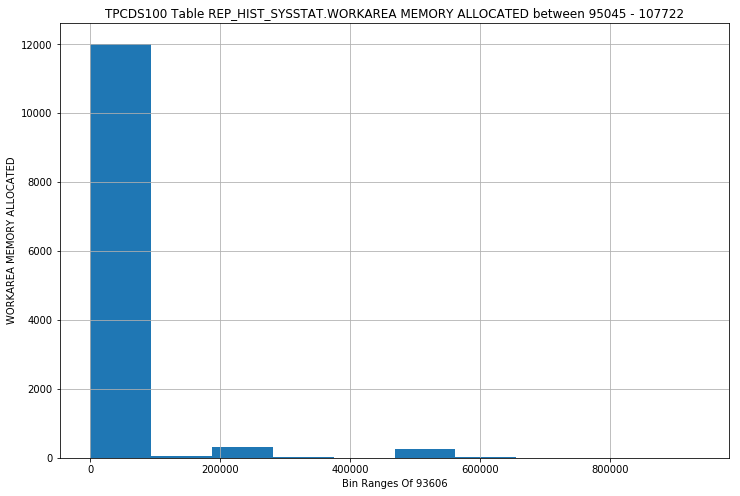

REP_HIST_SYSSTAT - WRITE CLONES CREATED IN BACKGROUND - OUTLIERS HISTOGRAM


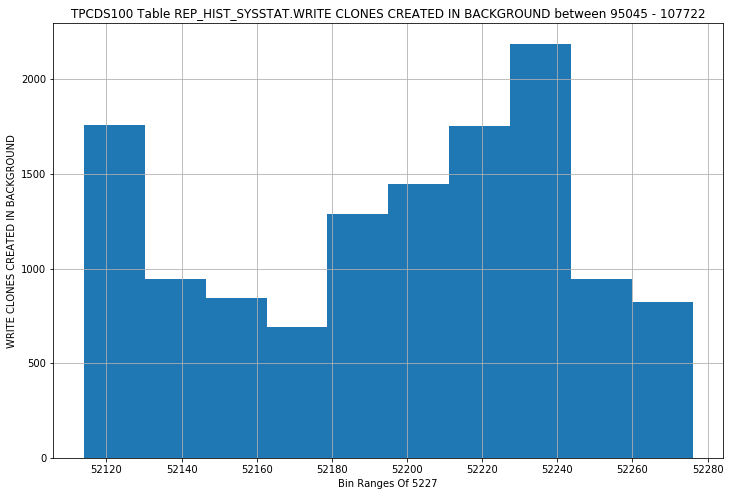

REP_HIST_SYSSTAT - WRITE CLONES CREATED IN FOREGROUND - OUTLIERS HISTOGRAM


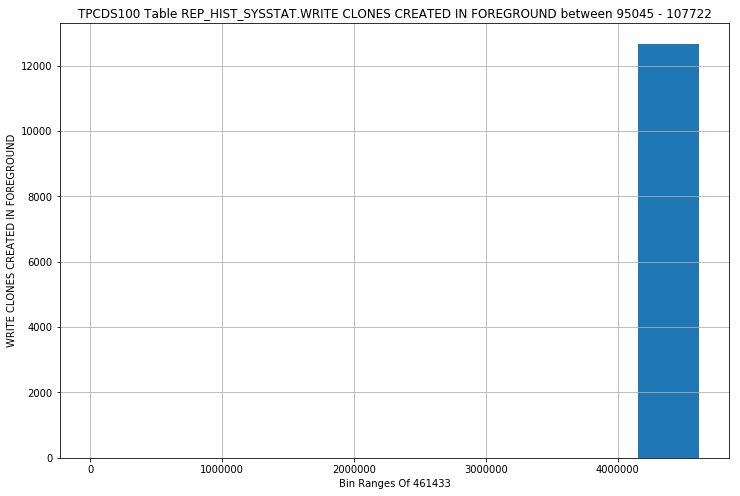

REP_HIST_SYSSTAT - SNAP_ID - OUTLIERS SCATTER


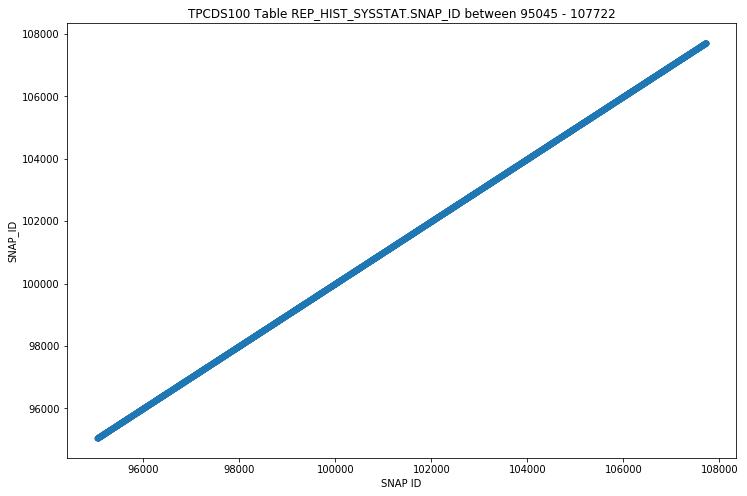

REP_HIST_SYSSTAT - BATCHED IO (BOUND) VECTOR COUNT - OUTLIERS SCATTER


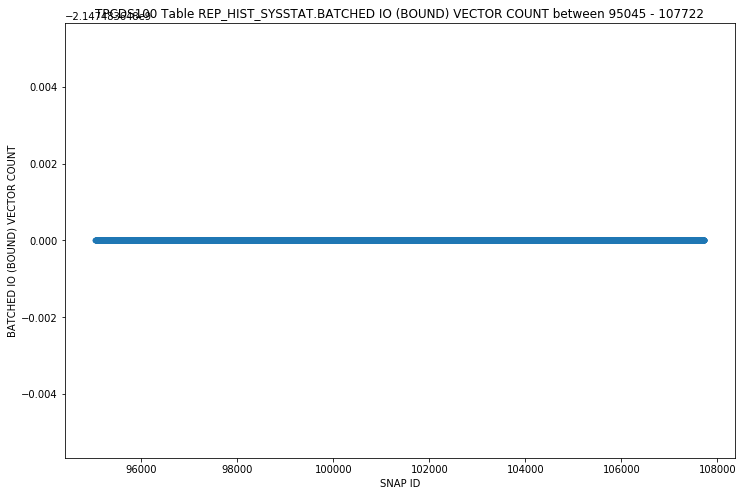

REP_HIST_SYSSTAT - BATCHED IO (FULL) VECTOR COUNT - OUTLIERS SCATTER


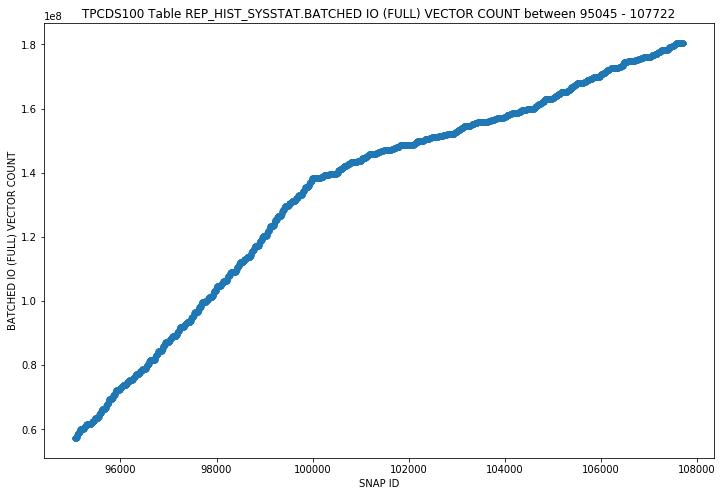

REP_HIST_SYSSTAT - BATCHED IO (SPACE) VECTOR COUNT - OUTLIERS SCATTER


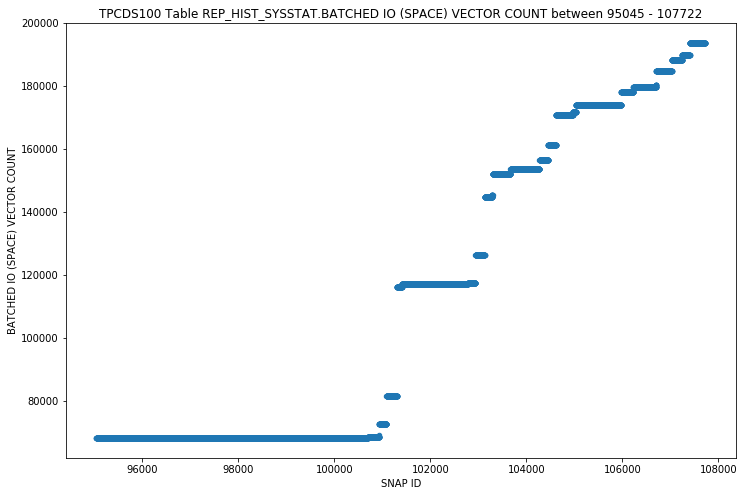

REP_HIST_SYSSTAT - BATCHED IO BLOCK MISS COUNT - OUTLIERS SCATTER


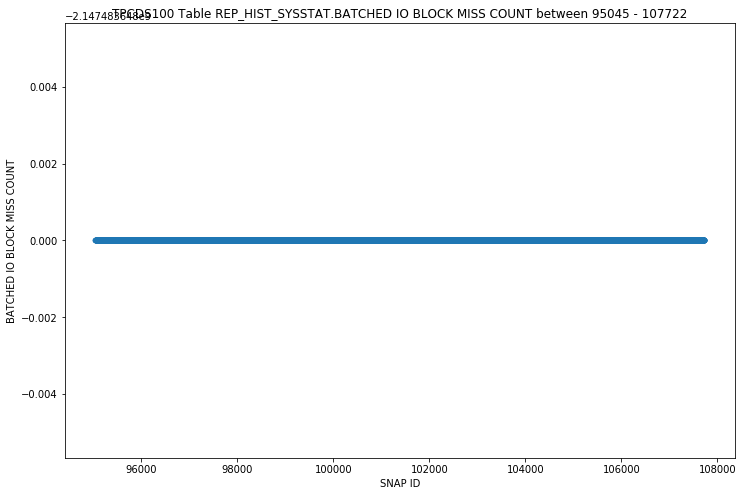

REP_HIST_SYSSTAT - BATCHED IO BUFFER DEFRAG COUNT - OUTLIERS SCATTER


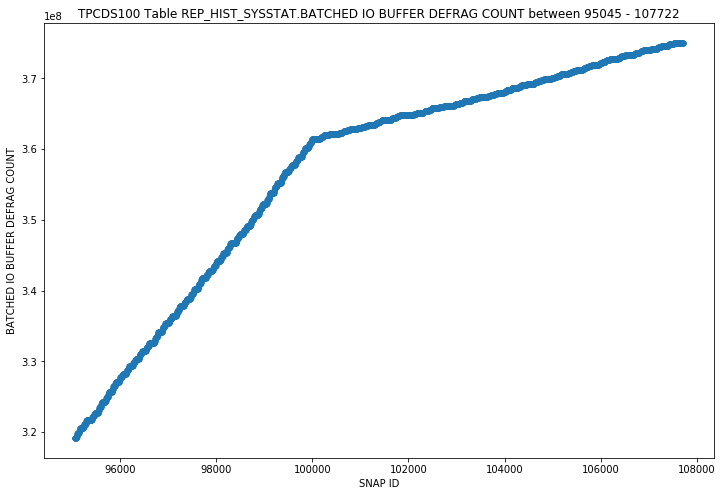

REP_HIST_SYSSTAT - BATCHED IO DOUBLE MISS COUNT - OUTLIERS SCATTER


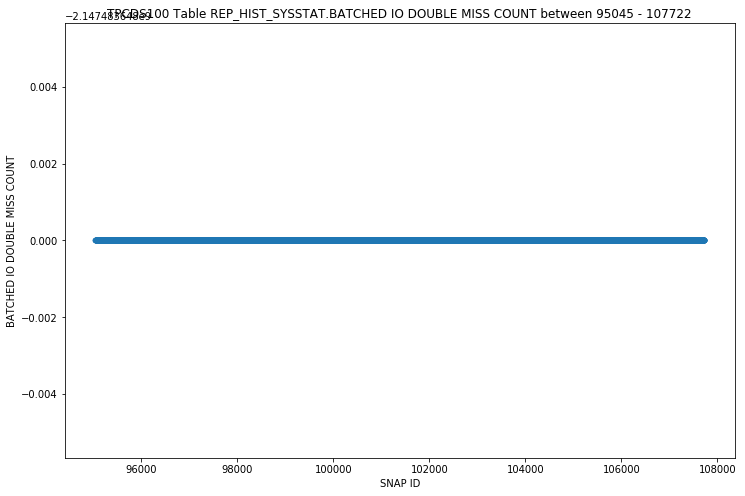

REP_HIST_SYSSTAT - BATCHED IO SAME UNIT COUNT - OUTLIERS SCATTER


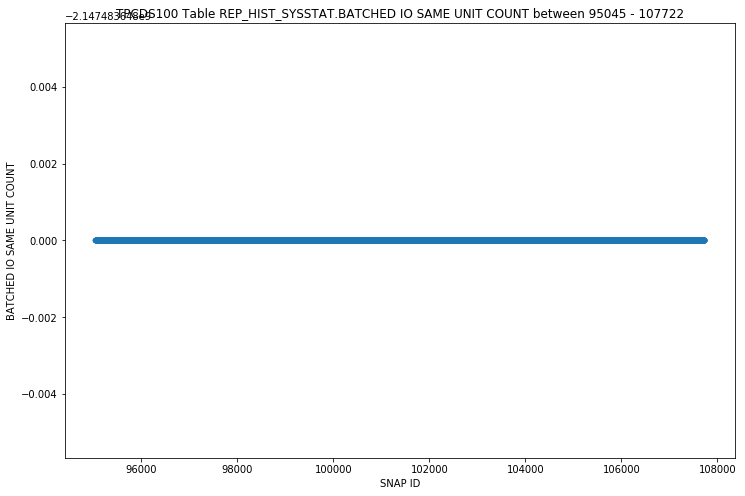

REP_HIST_SYSSTAT - BATCHED IO SINGLE BLOCK COUNT - OUTLIERS SCATTER


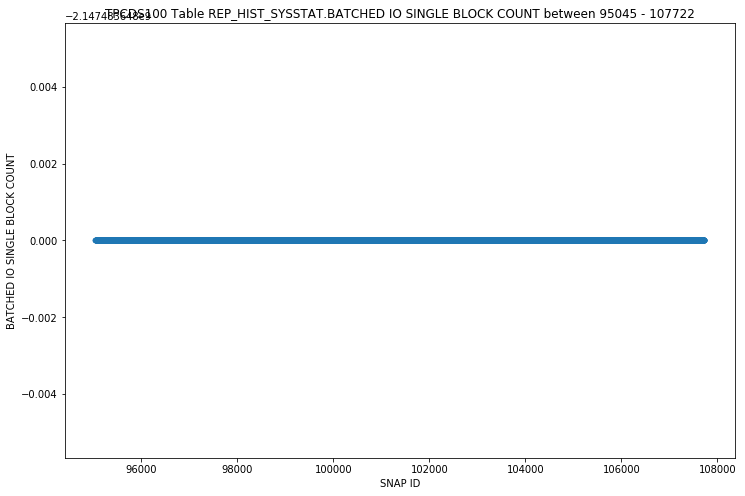

REP_HIST_SYSSTAT - BATCHED IO SLOW JUMP COUNT - OUTLIERS SCATTER


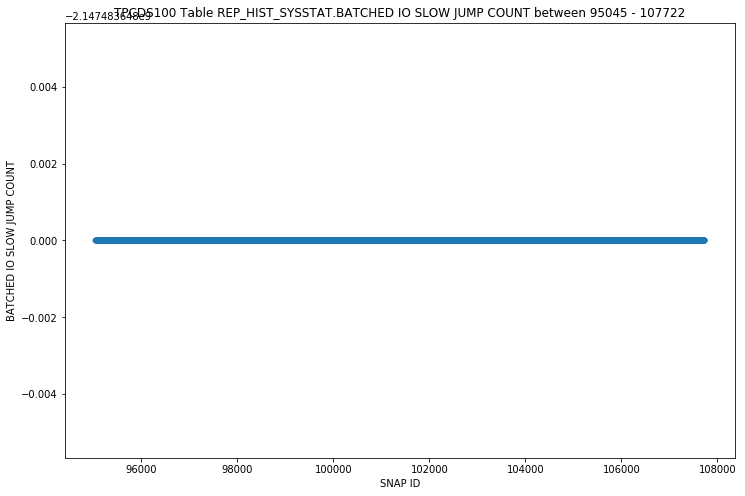

REP_HIST_SYSSTAT - BATCHED IO VECTOR BLOCK COUNT - OUTLIERS SCATTER


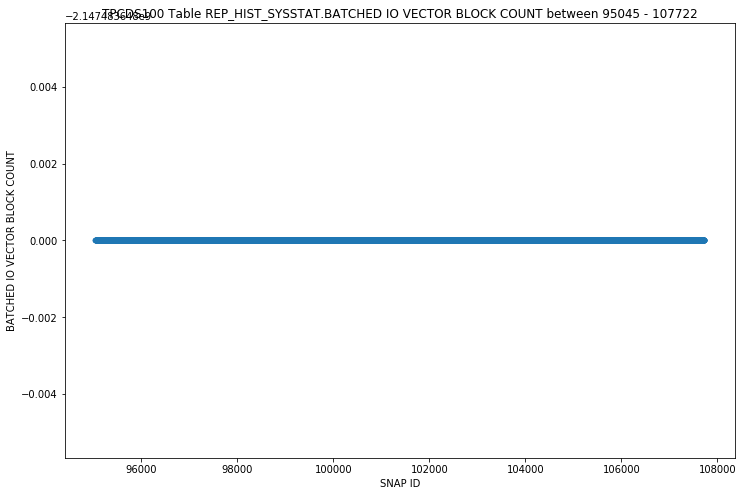

REP_HIST_SYSSTAT - BATCHED IO VECTOR READ COUNT - OUTLIERS SCATTER


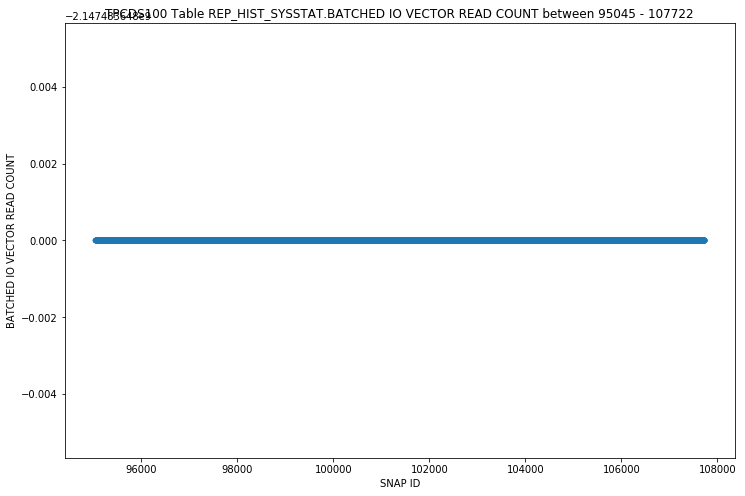

REP_HIST_SYSSTAT - BLOCK CLEANOUT OPTIM REFERENCED - OUTLIERS SCATTER


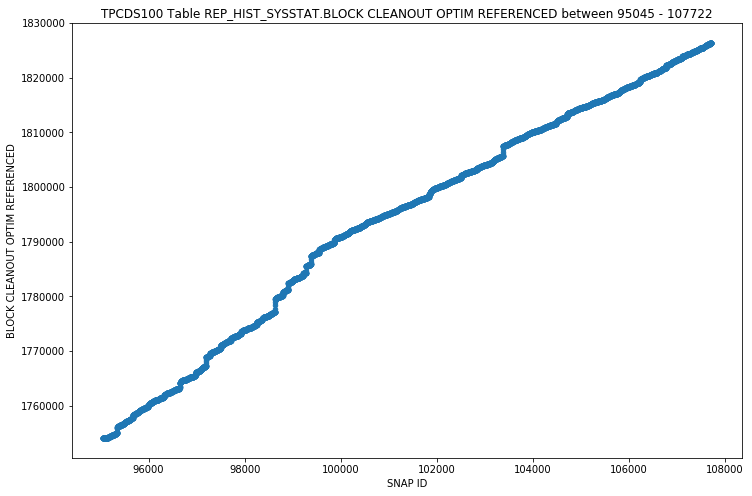

REP_HIST_SYSSTAT - CCURSOR + SQL AREA EVICTED - OUTLIERS SCATTER


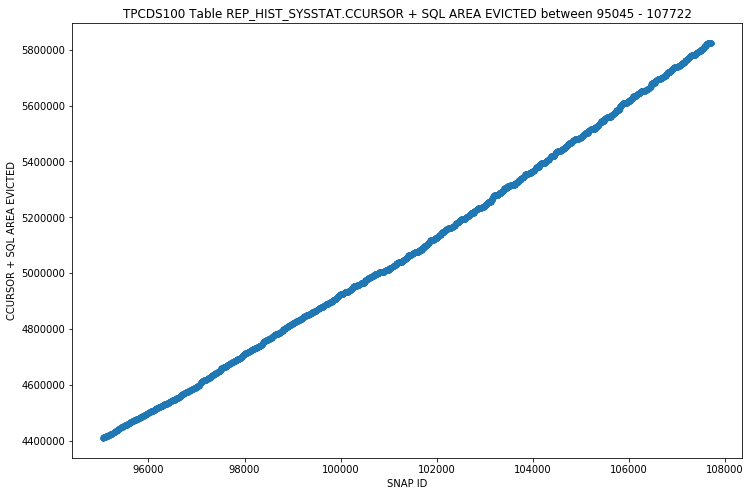

REP_HIST_SYSSTAT - CLI BG ENQ - OUTLIERS SCATTER


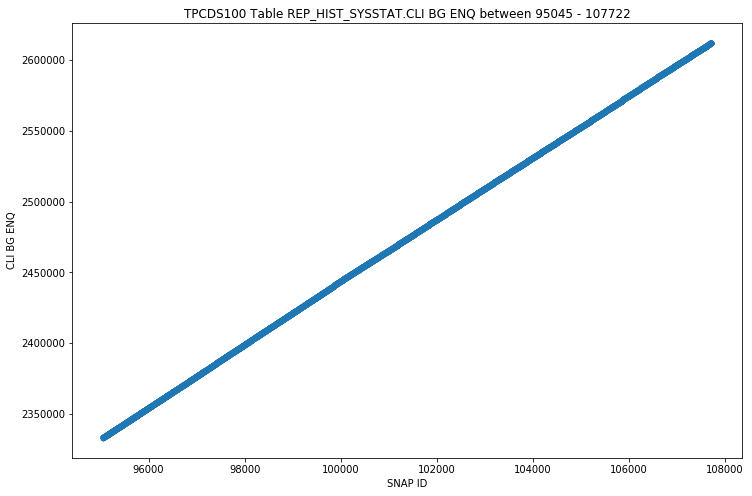

REP_HIST_SYSSTAT - CLI BG ATTEMPT FLUSH - OUTLIERS SCATTER


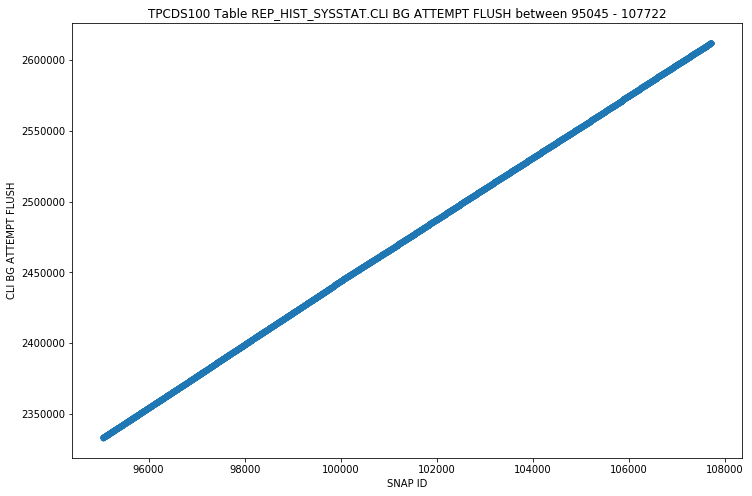

REP_HIST_SYSSTAT - CLI FLSTASK CREATE - OUTLIERS SCATTER


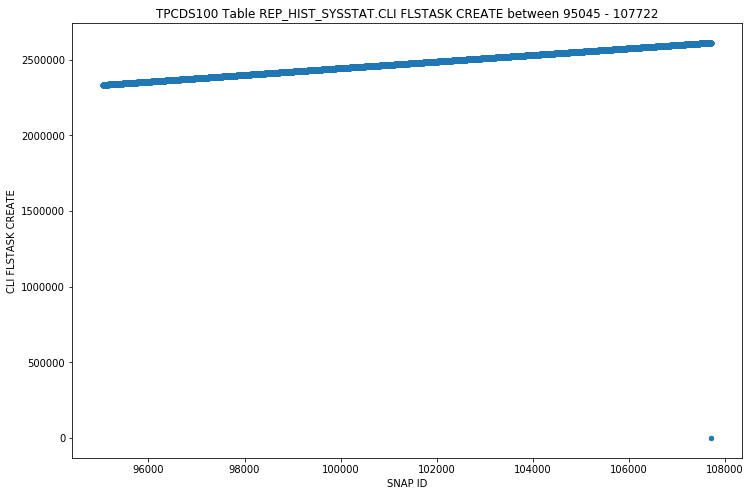

REP_HIST_SYSSTAT - CLI FLUSH - OUTLIERS SCATTER


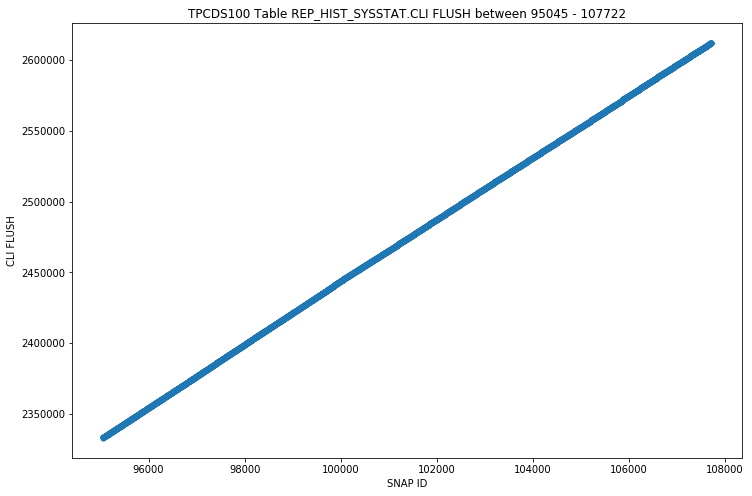

REP_HIST_SYSSTAT - CPU USED BY THIS SESSION - OUTLIERS SCATTER


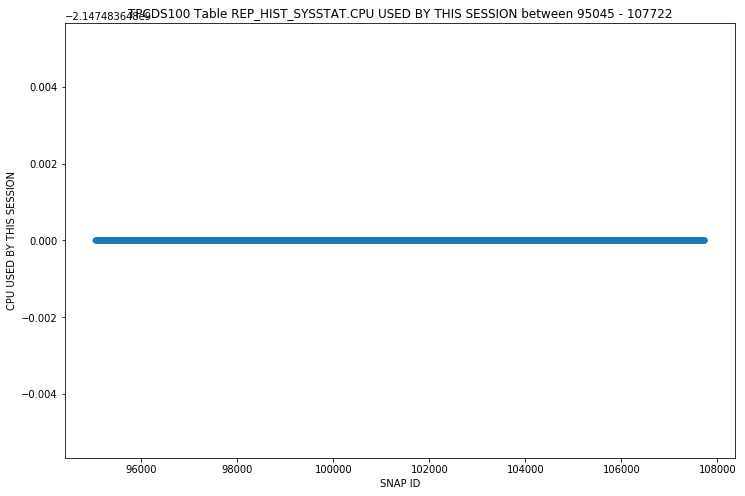

REP_HIST_SYSSTAT - CPU USED WHEN CALL STARTED - OUTLIERS SCATTER


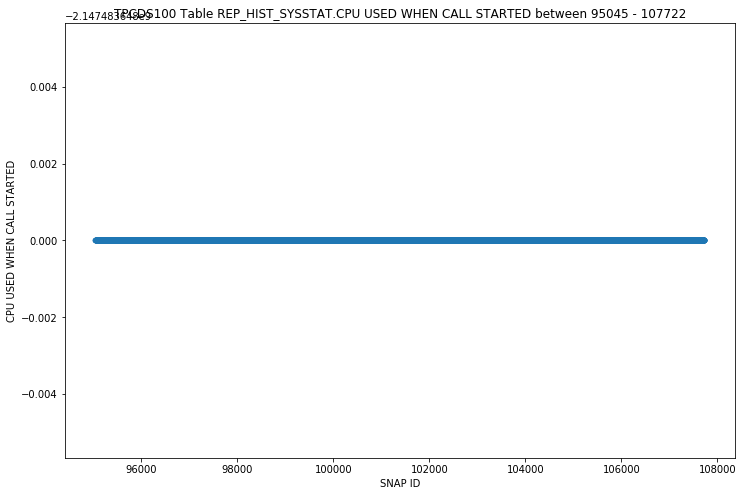

REP_HIST_SYSSTAT - CR BLOCKS CREATED - OUTLIERS SCATTER


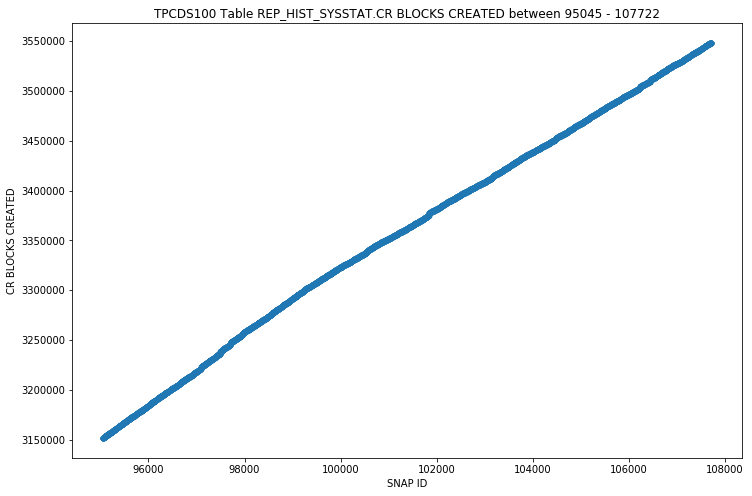

REP_HIST_SYSSTAT - CACHED COMMIT SCN REFERENCED - OUTLIERS SCATTER


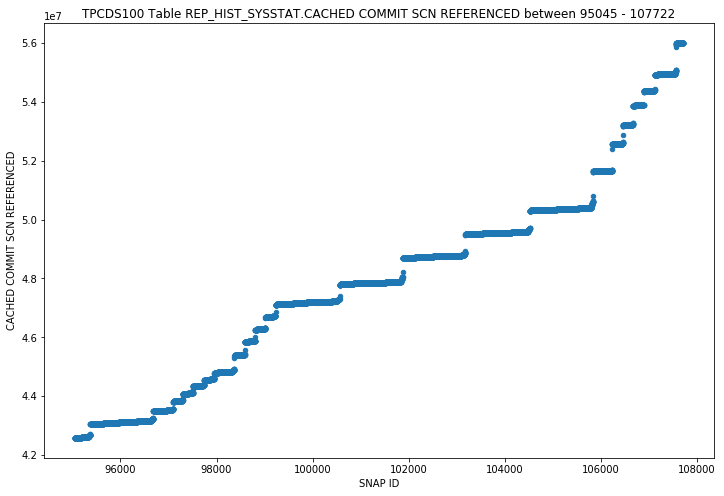

REP_HIST_SYSSTAT - COMMIT SCN CACHED - OUTLIERS SCATTER


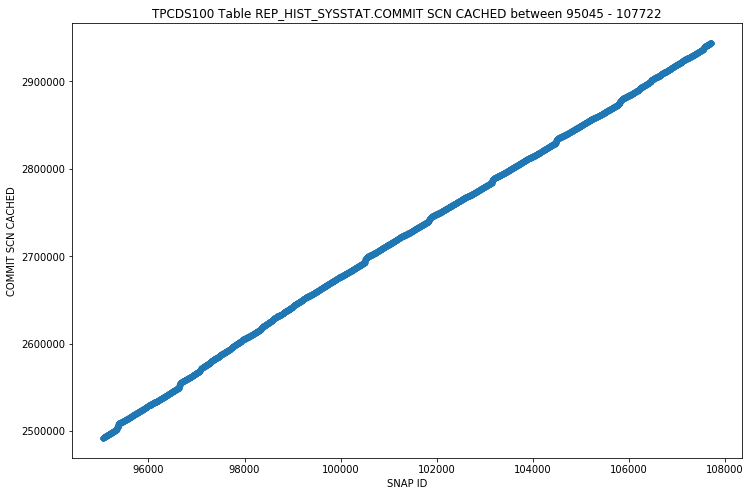

REP_HIST_SYSSTAT - DB TIME - OUTLIERS SCATTER


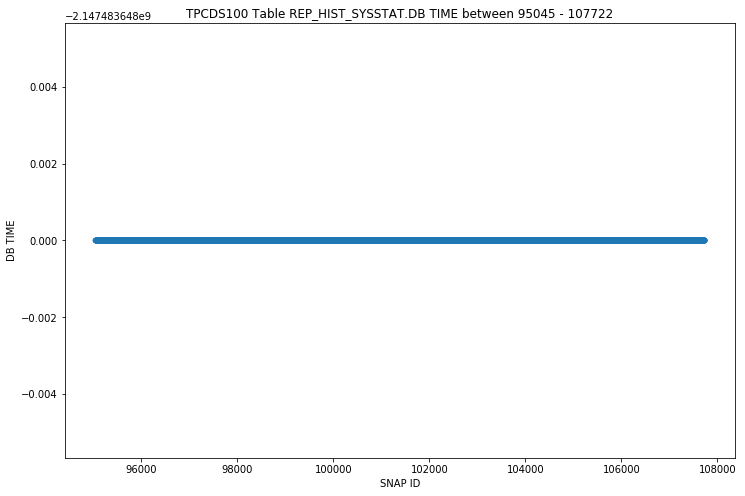

REP_HIST_SYSSTAT - DBWR CHECKPOINT BUFFERS WRITTEN - OUTLIERS SCATTER


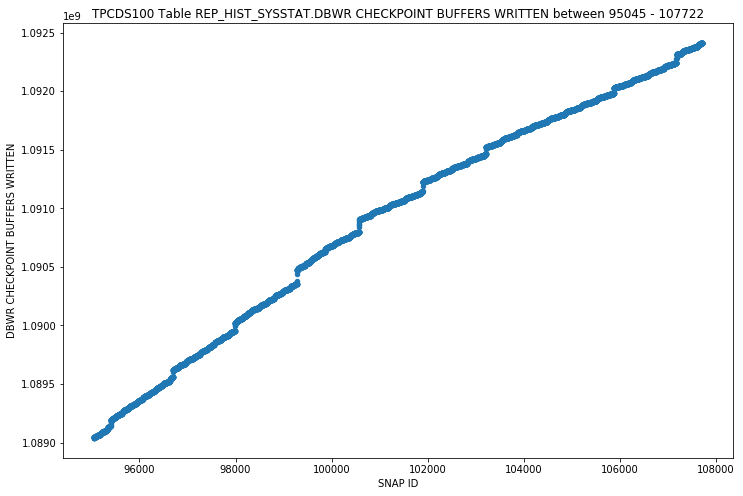

REP_HIST_SYSSTAT - DBWR CHECKPOINTS - OUTLIERS SCATTER


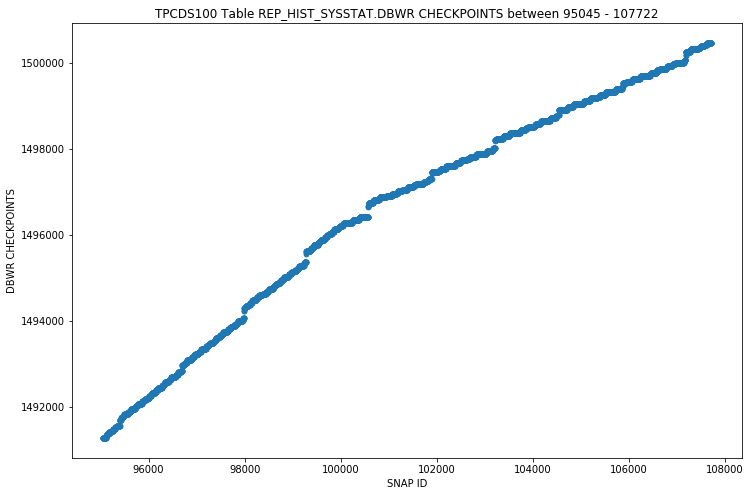

REP_HIST_SYSSTAT - DBWR OBJECT DROP BUFFERS WRITTEN - OUTLIERS SCATTER


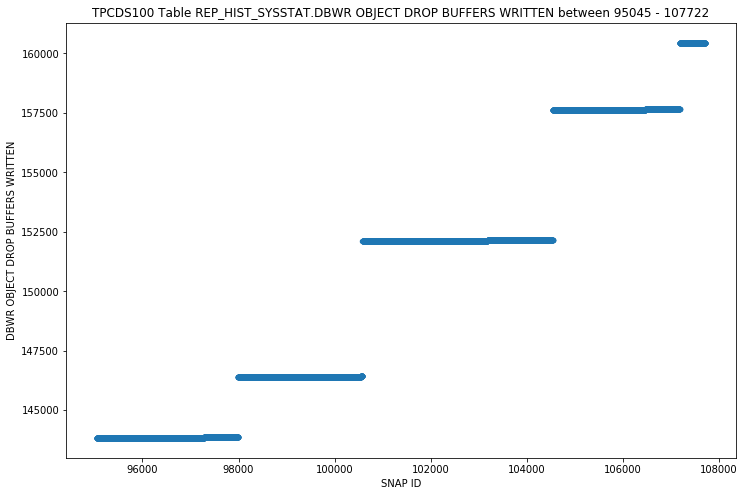

REP_HIST_SYSSTAT - DBWR PARALLEL QUERY CHECKPOINT BUFFERS WRITTEN - OUTLIERS SCATTER


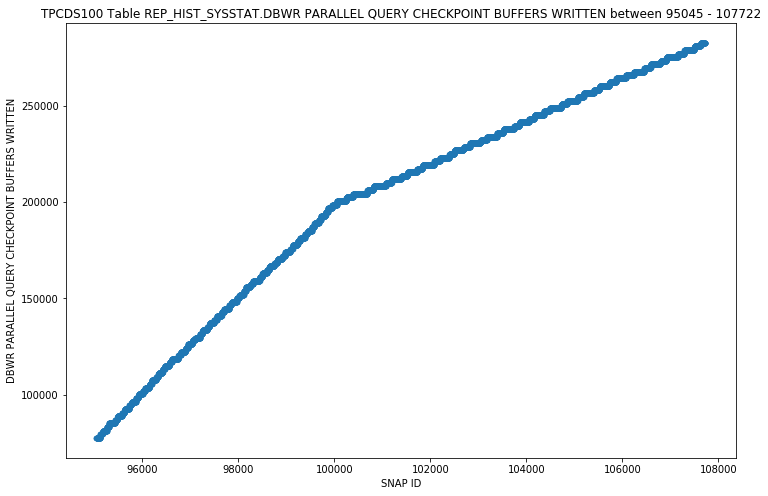

REP_HIST_SYSSTAT - DBWR REVISITED BEING-WRITTEN BUFFER - OUTLIERS SCATTER


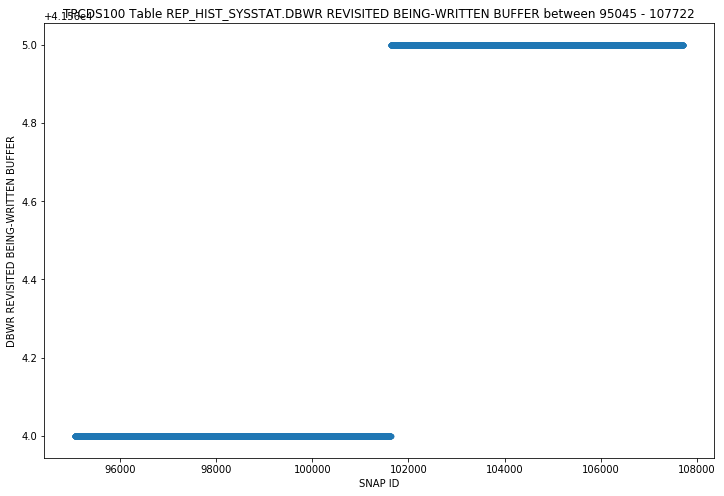

REP_HIST_SYSSTAT - DBWR THREAD CHECKPOINT BUFFERS WRITTEN - OUTLIERS SCATTER


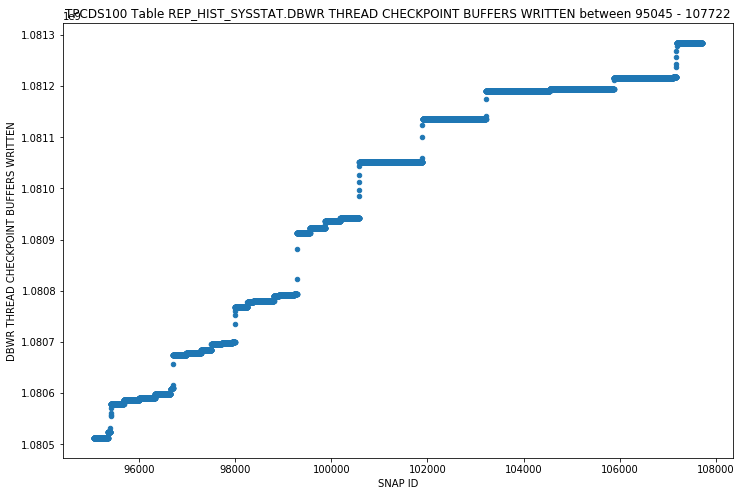

REP_HIST_SYSSTAT - DBWR TRANSACTION TABLE WRITES - OUTLIERS SCATTER


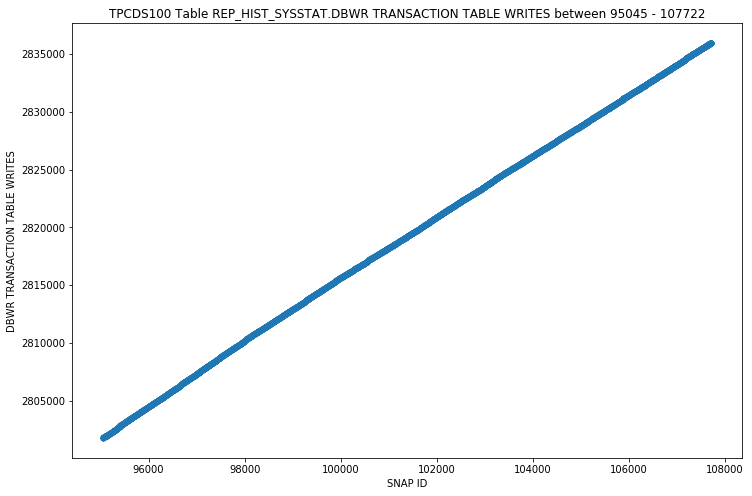

REP_HIST_SYSSTAT - DBWR UNDO BLOCK WRITES - OUTLIERS SCATTER


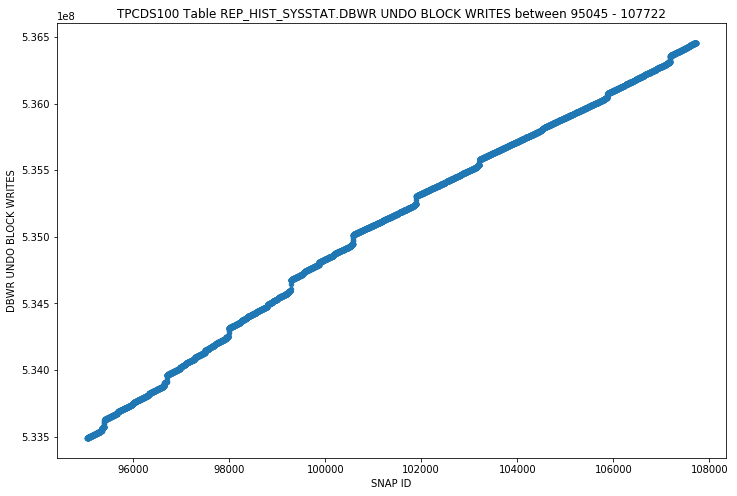

REP_HIST_SYSSTAT - DDL STATEMENTS PARALLELIZED - OUTLIERS SCATTER


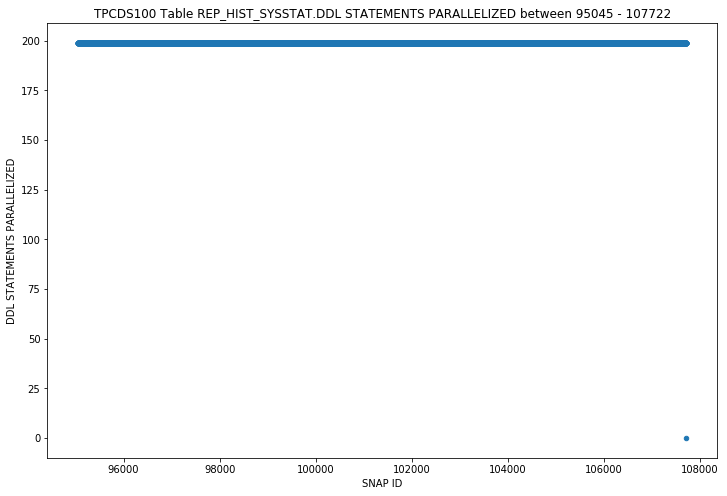

REP_HIST_SYSSTAT - DFO TREES PARALLELIZED - OUTLIERS SCATTER


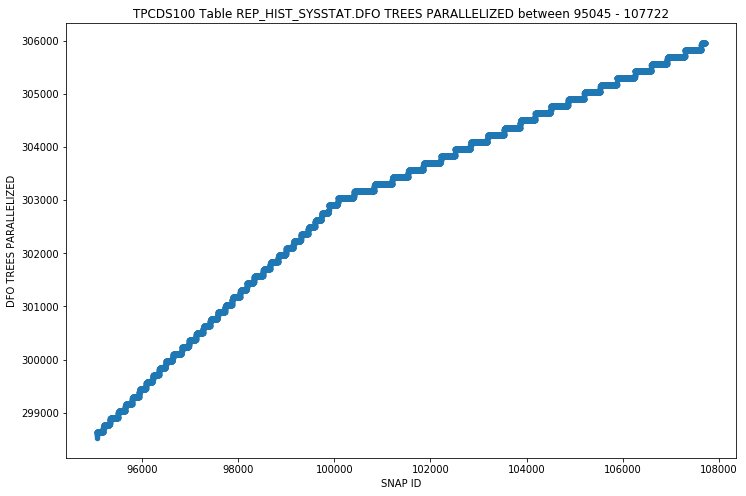

REP_HIST_SYSSTAT - EFFECTIVE IO TIME - OUTLIERS SCATTER


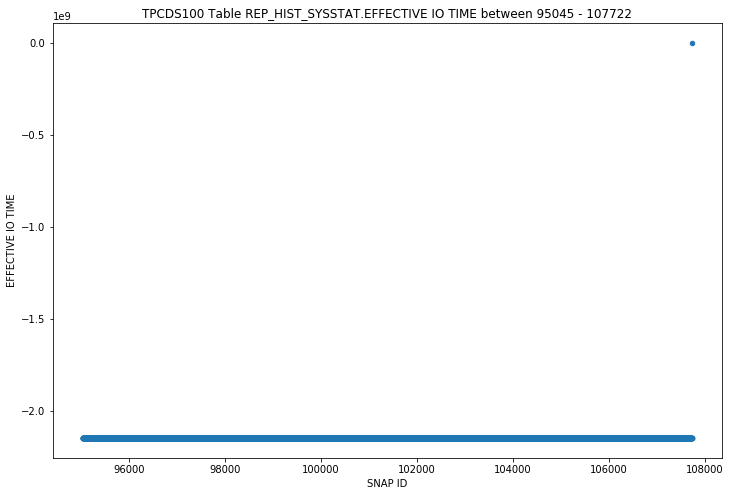

REP_HIST_SYSSTAT - HSC HEAP SEGMENT BLOCK CHANGES - OUTLIERS SCATTER


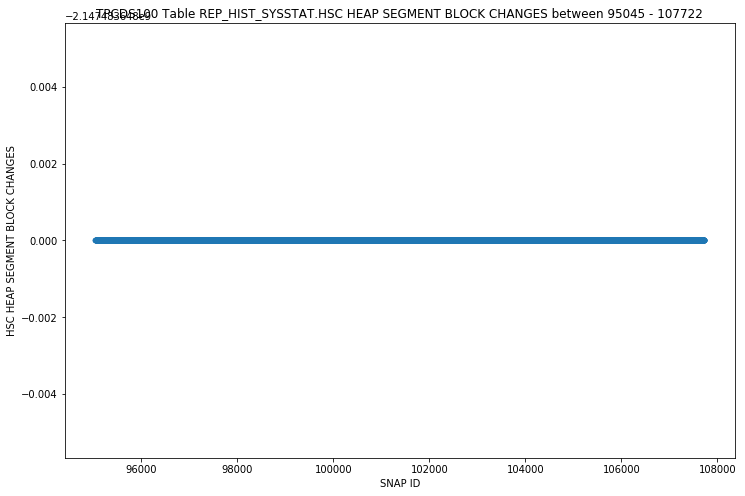

REP_HIST_SYSSTAT - HEAP SEGMENT ARRAY INSERTS - OUTLIERS SCATTER


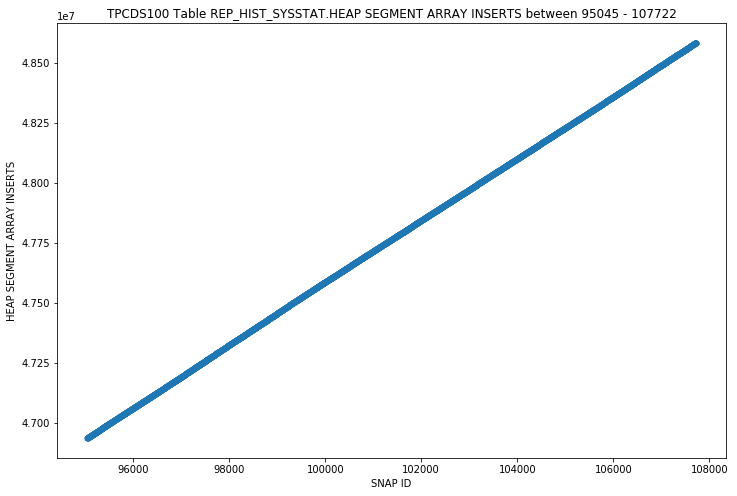

REP_HIST_SYSSTAT - HEAP SEGMENT ARRAY UPDATES - OUTLIERS SCATTER


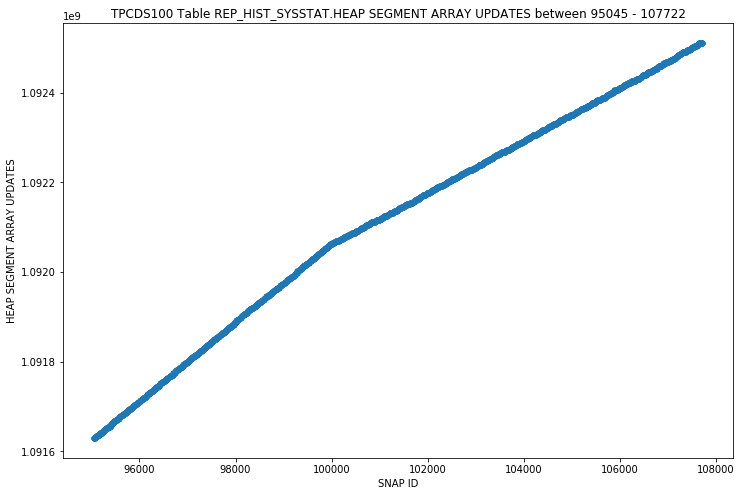

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSHED - OUTLIERS SCATTER


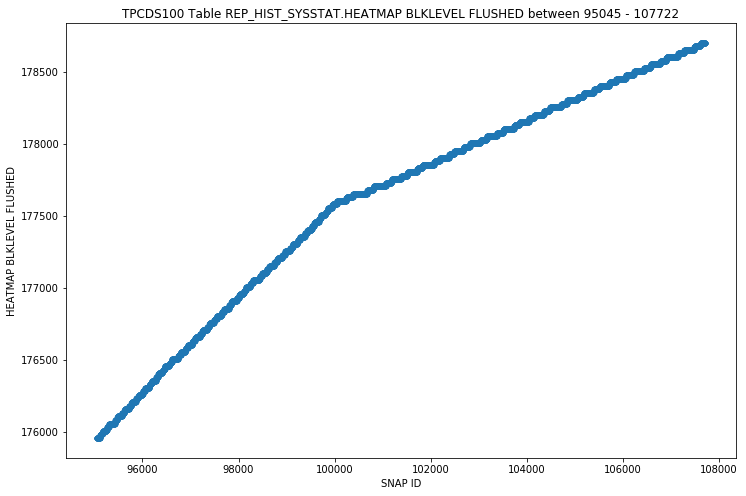

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSHED TO BF - OUTLIERS SCATTER


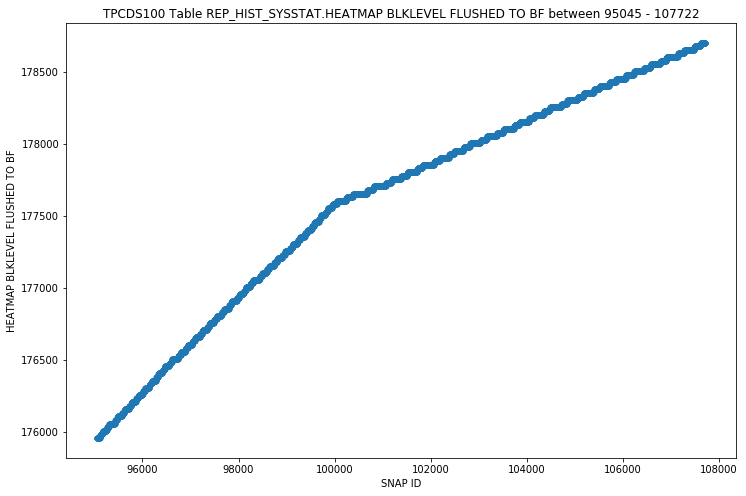

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL RANGES FLUSHED - OUTLIERS SCATTER


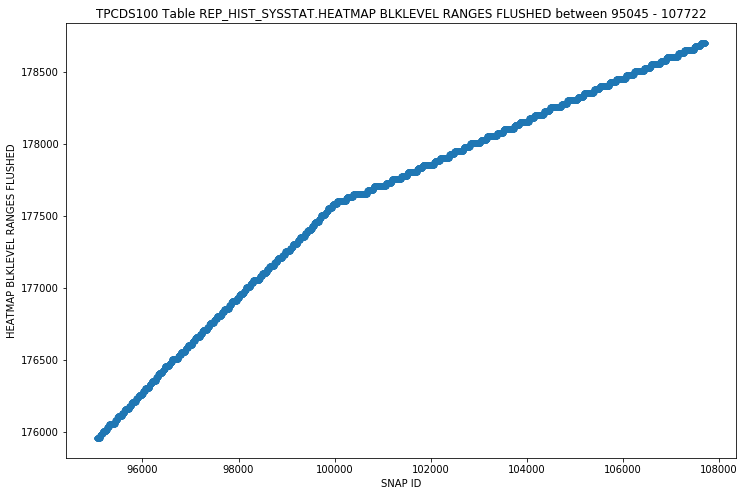

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSH TASK COUNT - OUTLIERS SCATTER


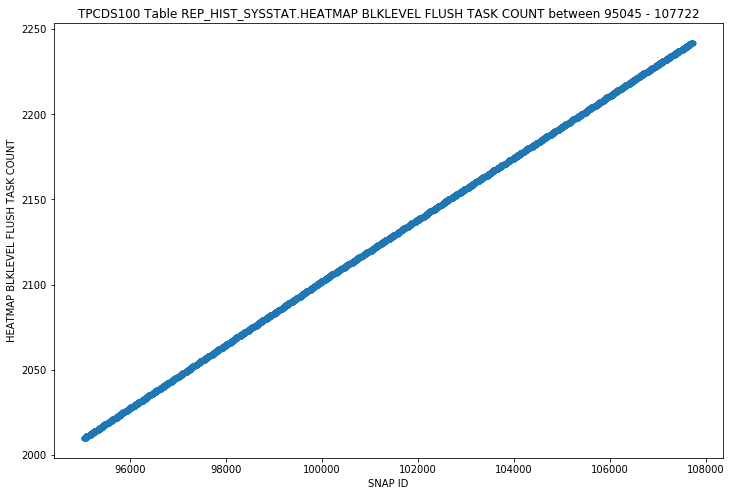

REP_HIST_SYSSTAT - IMU CR ROLLBACKS - OUTLIERS SCATTER


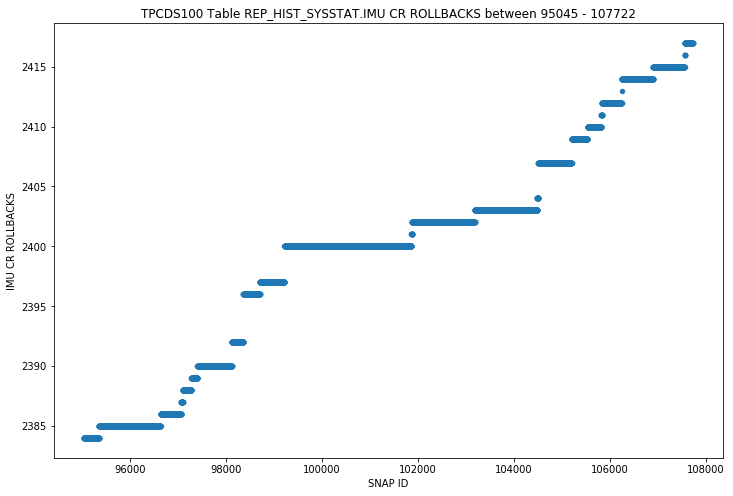

REP_HIST_SYSSTAT - IMU FLUSHES - OUTLIERS SCATTER


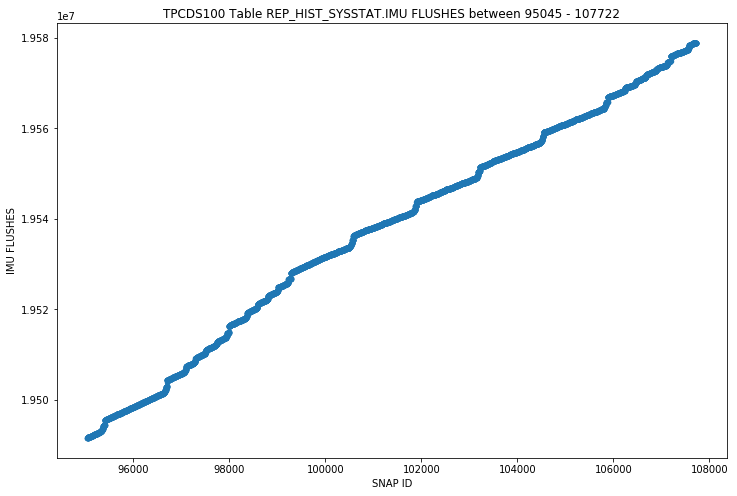

REP_HIST_SYSSTAT - IMU REDO ALLOCATION SIZE - OUTLIERS SCATTER


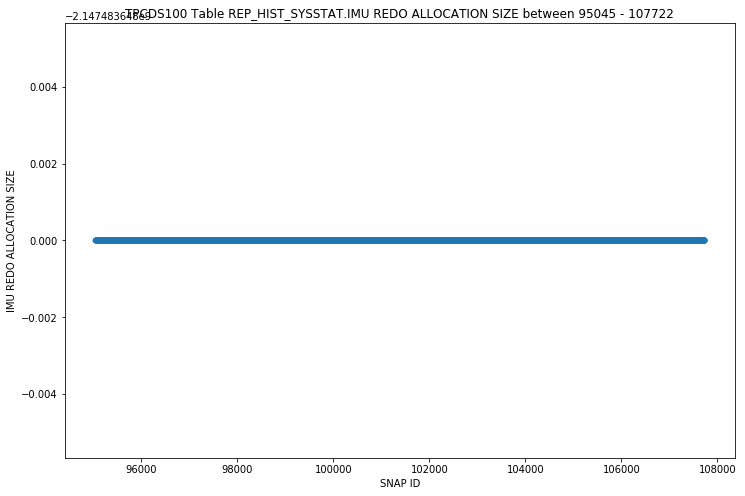

REP_HIST_SYSSTAT - IMU COMMITS - OUTLIERS SCATTER


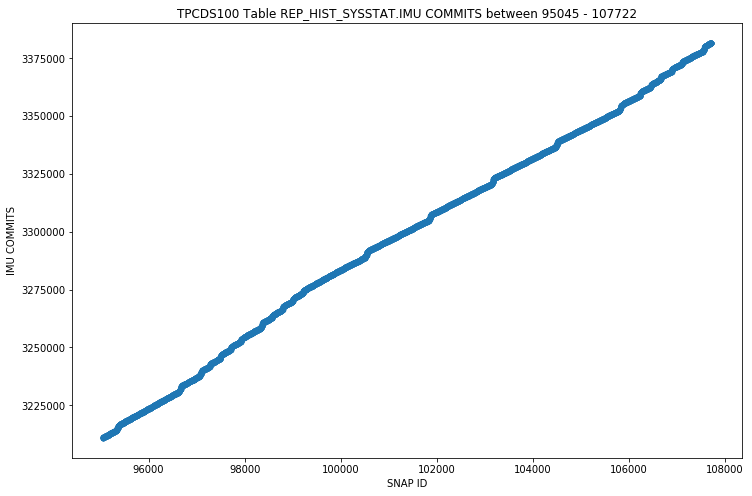

REP_HIST_SYSSTAT - IMU CONTENTION - OUTLIERS SCATTER


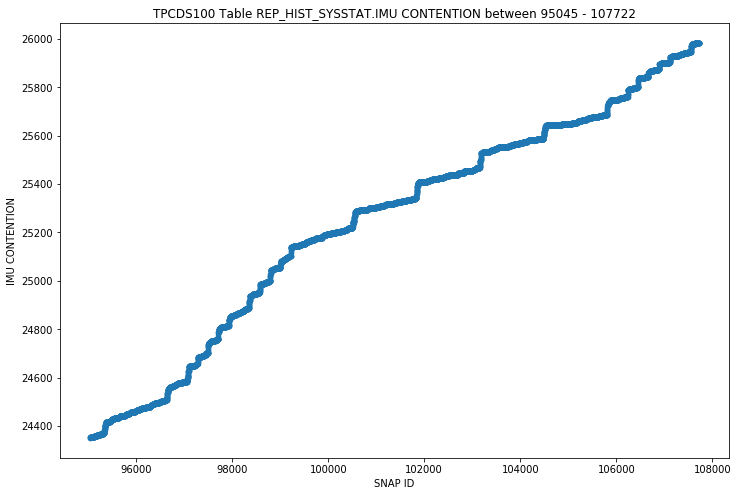

REP_HIST_SYSSTAT - IMU KTICHG FLUSH - OUTLIERS SCATTER


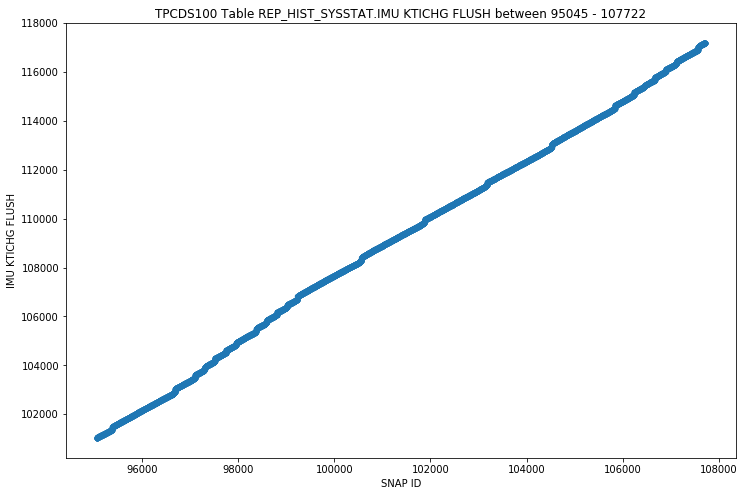

REP_HIST_SYSSTAT - IMU POOL NOT ALLOCATED - OUTLIERS SCATTER


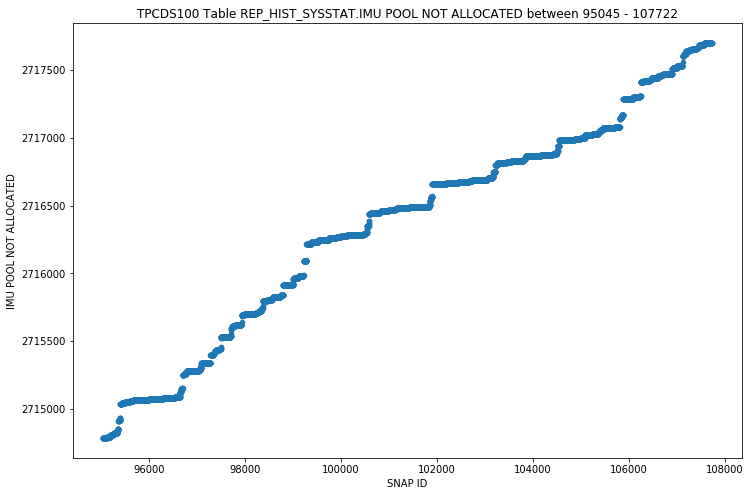

REP_HIST_SYSSTAT - IMU RECURSIVE-TRANSACTION FLUSH - OUTLIERS SCATTER


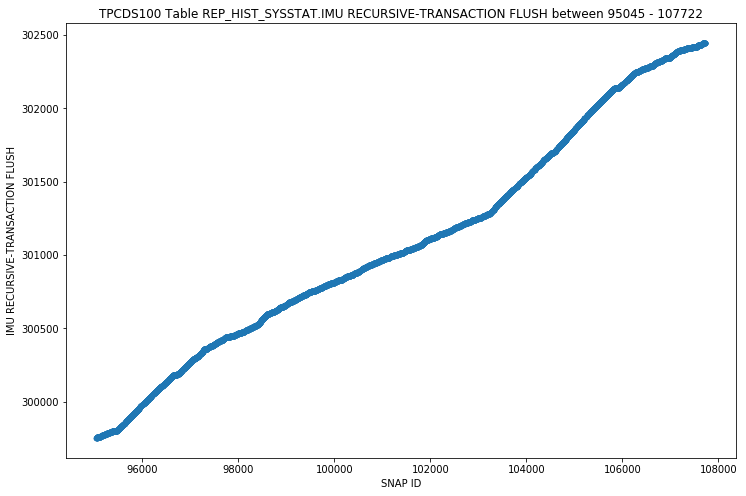

REP_HIST_SYSSTAT - IMU UNDO ALLOCATION SIZE - OUTLIERS SCATTER


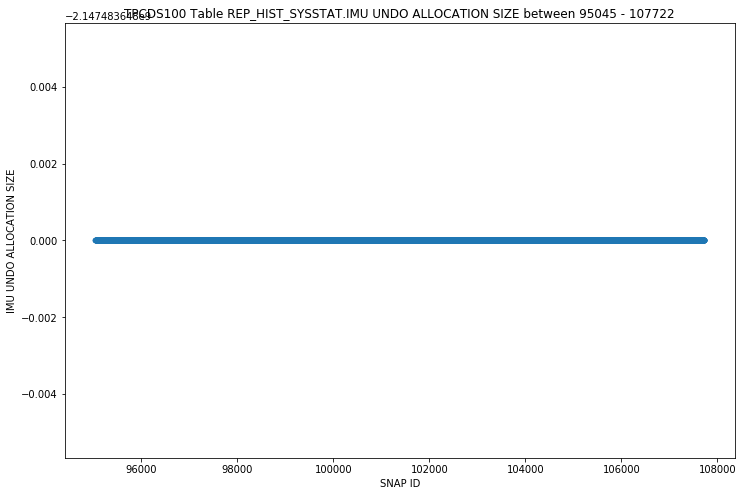

REP_HIST_SYSSTAT - IMU- FAILED TO GET A PRIVATE STRAND - OUTLIERS SCATTER


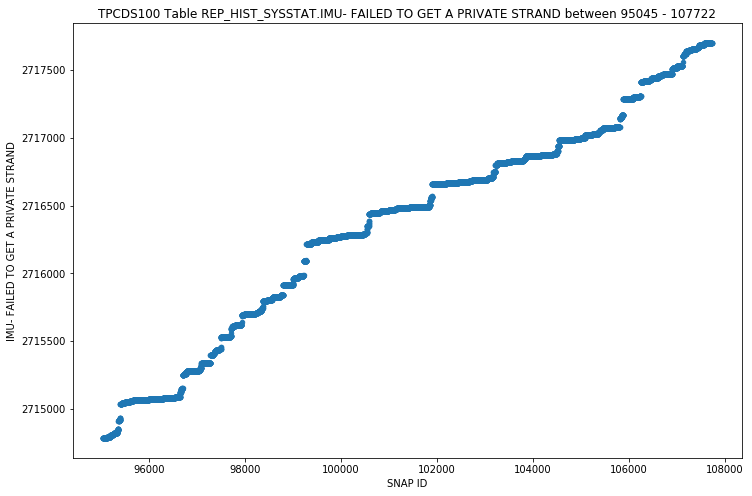

REP_HIST_SYSSTAT - KTFB ALLOC REQ - OUTLIERS SCATTER


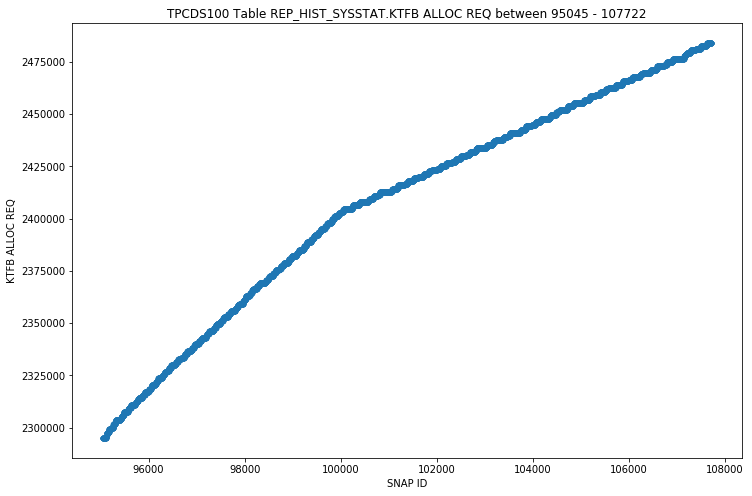

REP_HIST_SYSSTAT - KTFB ALLOC SPACE (BLOCK) - OUTLIERS SCATTER


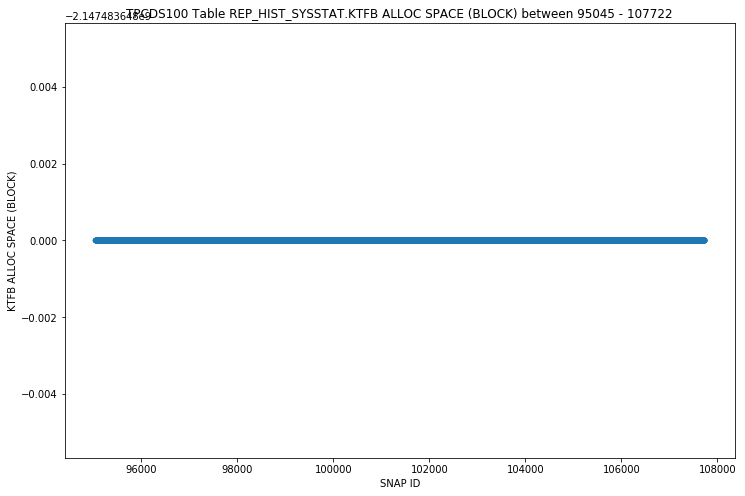

REP_HIST_SYSSTAT - KTFB ALLOC TIME (MS) - OUTLIERS SCATTER


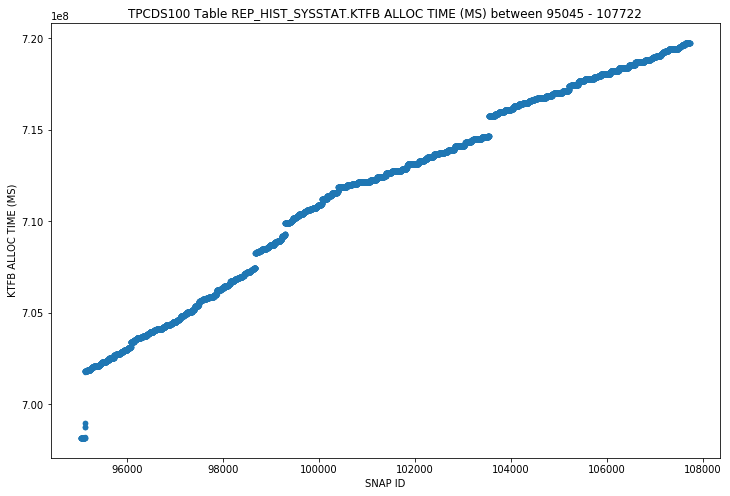

REP_HIST_SYSSTAT - KTFB APPLY REQ - OUTLIERS SCATTER


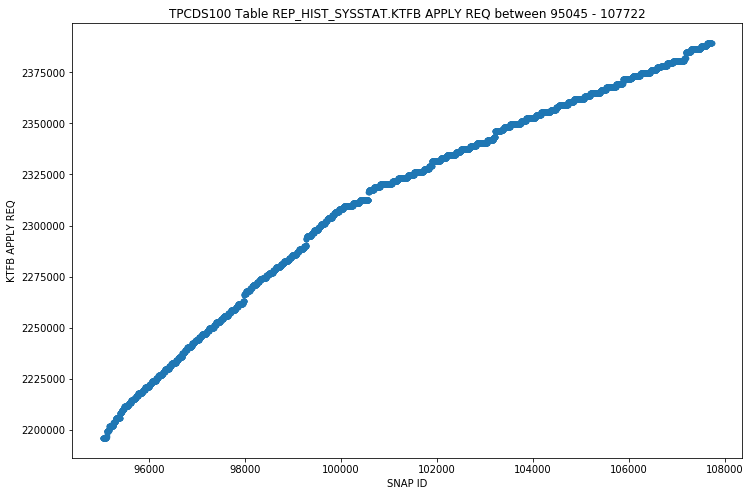

REP_HIST_SYSSTAT - KTFB APPLY TIME (MS) - OUTLIERS SCATTER


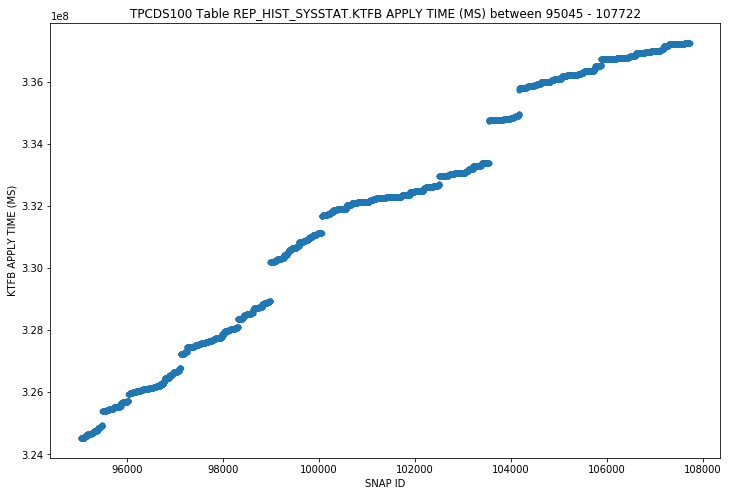

REP_HIST_SYSSTAT - KTFB COMMIT REQ - OUTLIERS SCATTER


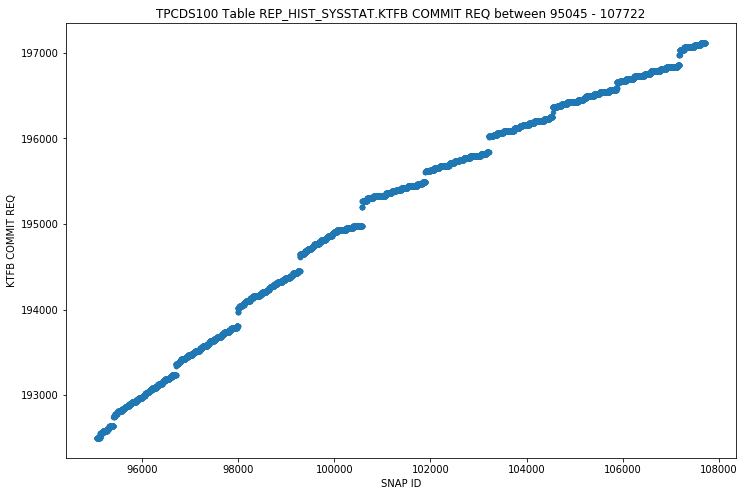

REP_HIST_SYSSTAT - KTFB COMMIT TIME (MS) - OUTLIERS SCATTER


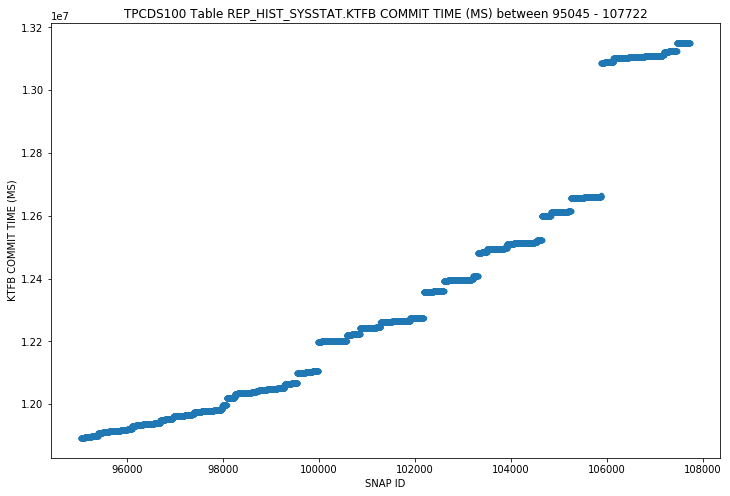

REP_HIST_SYSSTAT - KTFB FREE REQ - OUTLIERS SCATTER


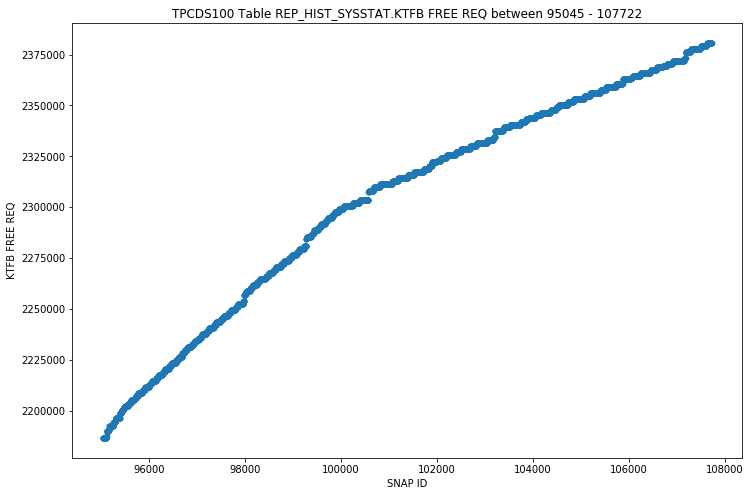

REP_HIST_SYSSTAT - KTFB FREE SPACE (BLOCK) - OUTLIERS SCATTER


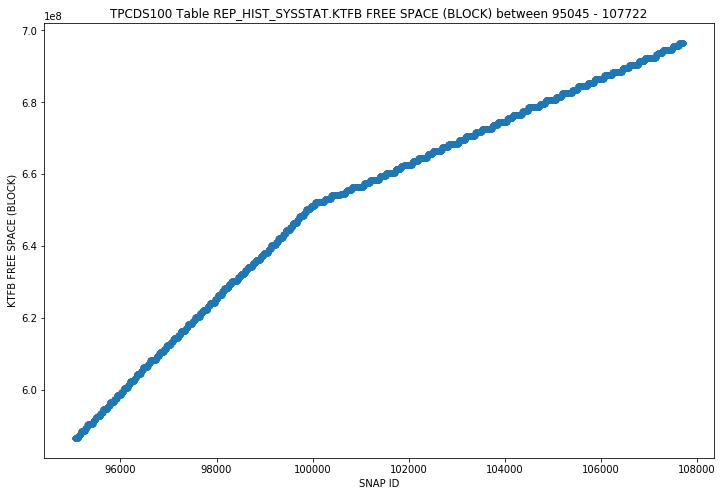

REP_HIST_SYSSTAT - KTFB FREE TIME (MS) - OUTLIERS SCATTER


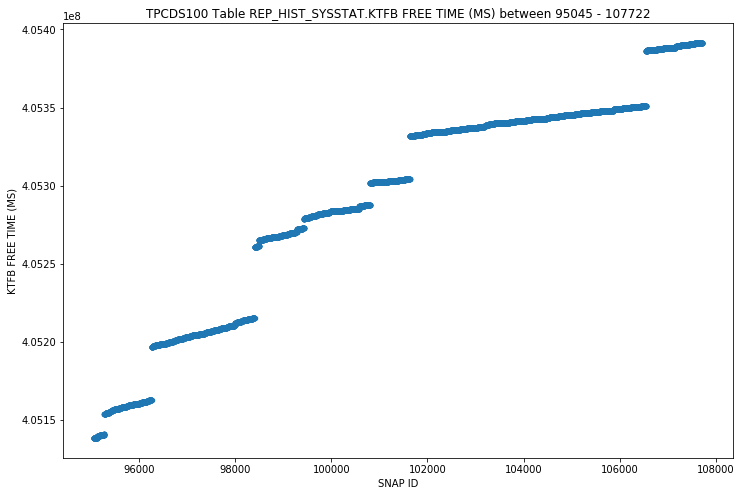

REP_HIST_SYSSTAT - LOB TABLE ID LOOKUP CACHE MISSES - OUTLIERS SCATTER


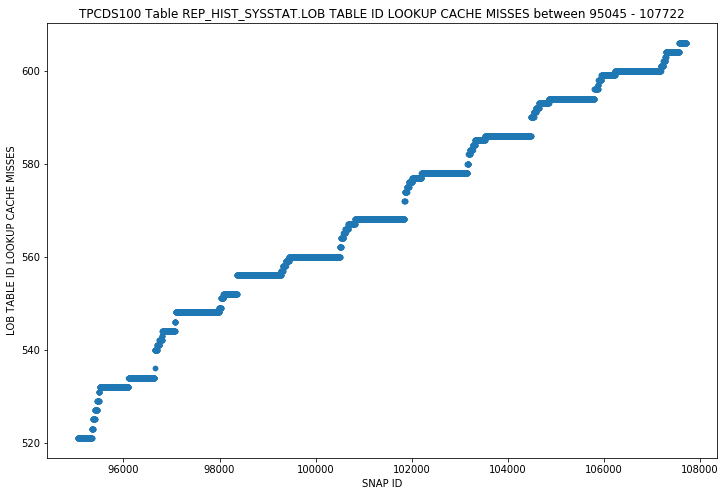

REP_HIST_SYSSTAT - NUMBER OF READ IOS ISSUED - OUTLIERS SCATTER


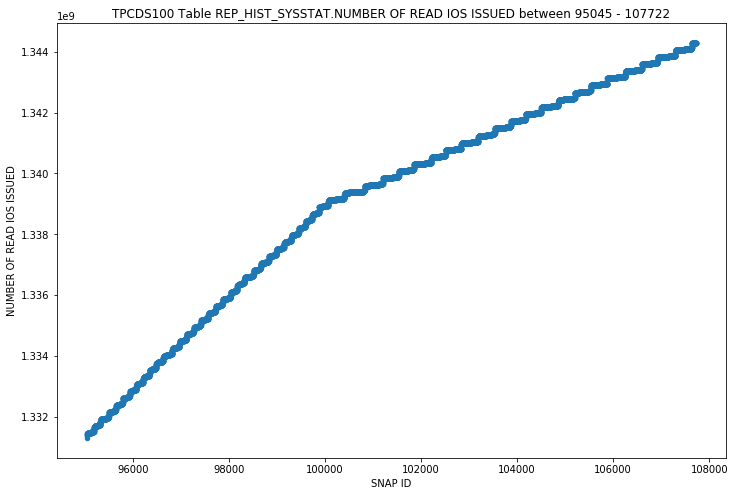

REP_HIST_SYSSTAT - PX LOCAL MESSAGES RECV'D - OUTLIERS SCATTER


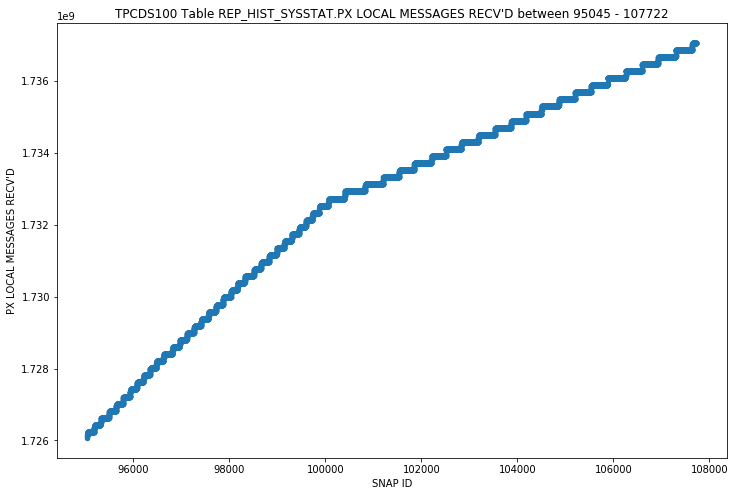

REP_HIST_SYSSTAT - PX LOCAL MESSAGES SENT - OUTLIERS SCATTER


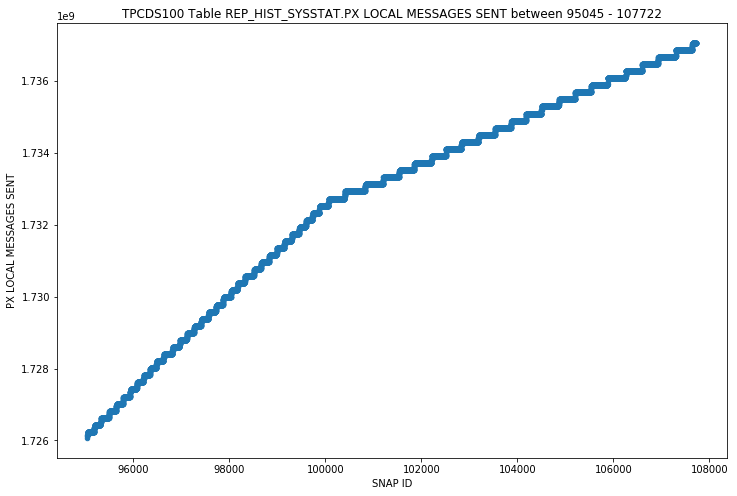

REP_HIST_SYSSTAT - PARALLEL OPERATIONS DOWNGRADED TO SERIAL - OUTLIERS SCATTER


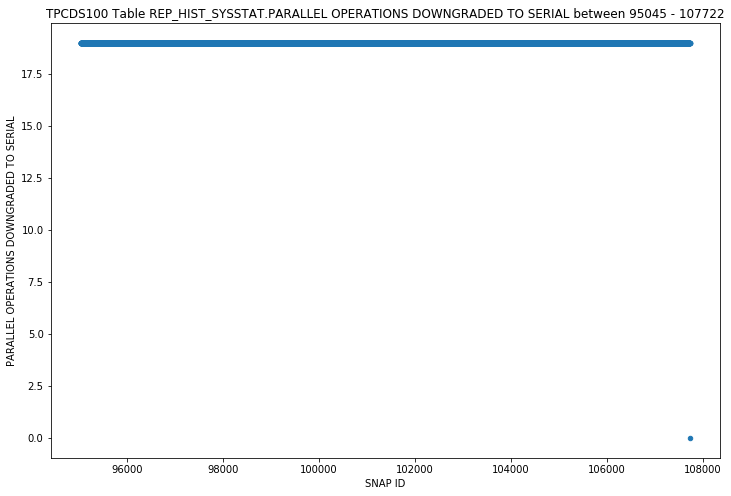

REP_HIST_SYSSTAT - PARALLEL OPERATIONS NOT DOWNGRADED - OUTLIERS SCATTER


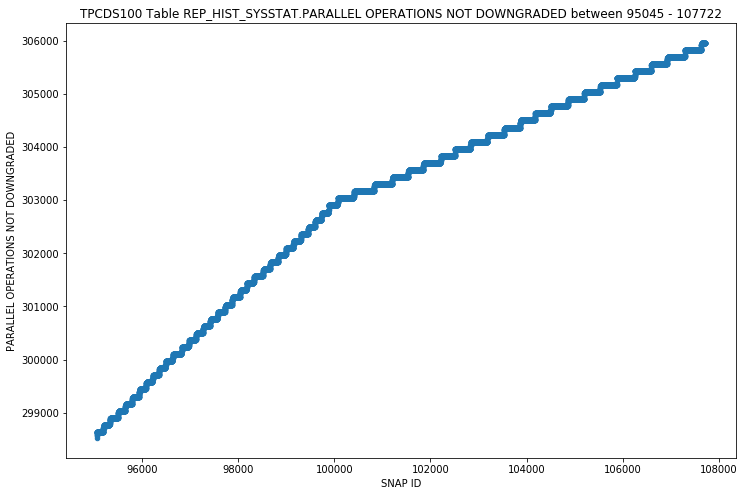

REP_HIST_SYSSTAT - REQUESTS TO/FROM CLIENT - OUTLIERS SCATTER


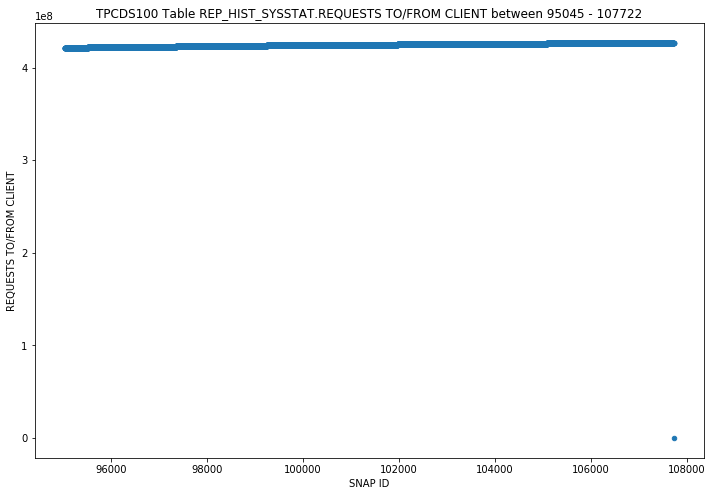

REP_HIST_SYSSTAT - ROWCR ATTEMPTS - OUTLIERS SCATTER


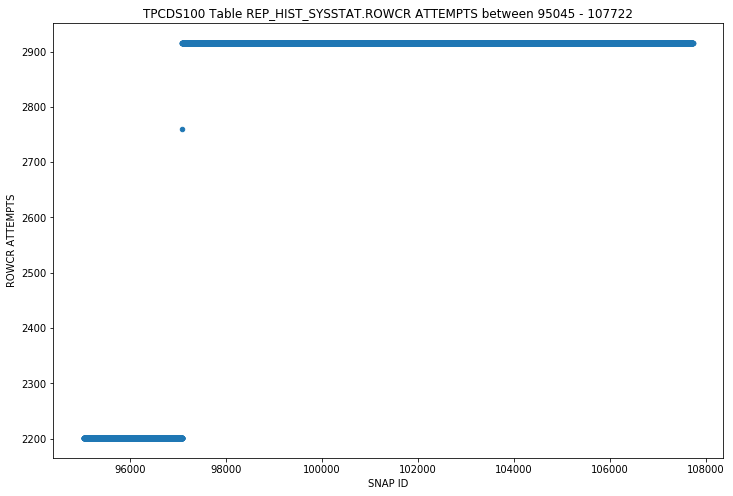

REP_HIST_SYSSTAT - ROWCR HITS - OUTLIERS SCATTER


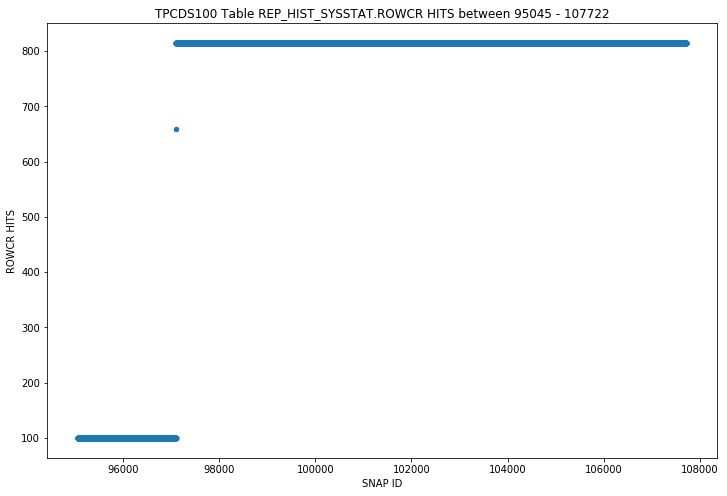

REP_HIST_SYSSTAT - SMON POSTED FOR UNDO SEGMENT SHRINK - OUTLIERS SCATTER


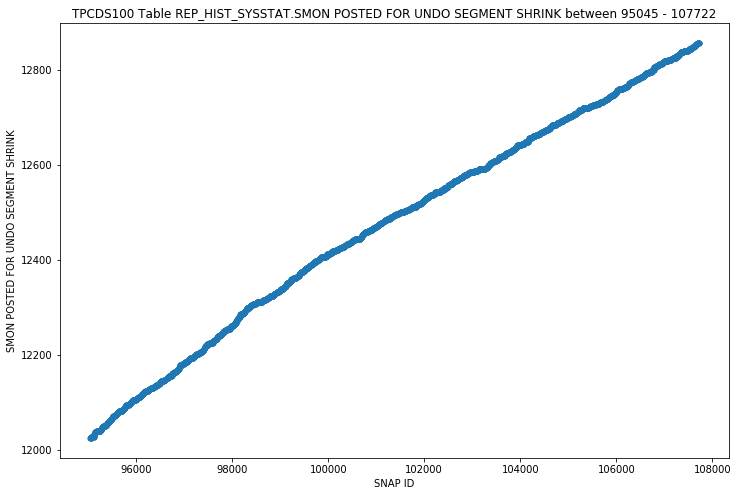

REP_HIST_SYSSTAT - SQL*NET ROUNDTRIPS TO/FROM CLIENT - OUTLIERS SCATTER


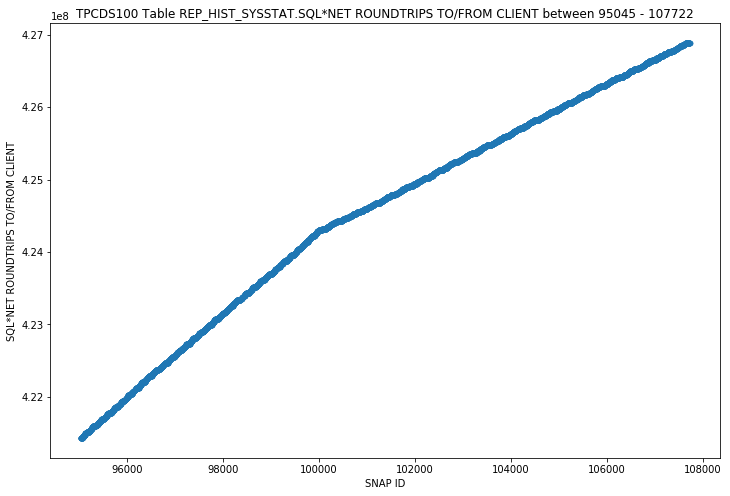

REP_HIST_SYSSTAT - TBS EXTENSION: BYTES EXTENDED - OUTLIERS SCATTER


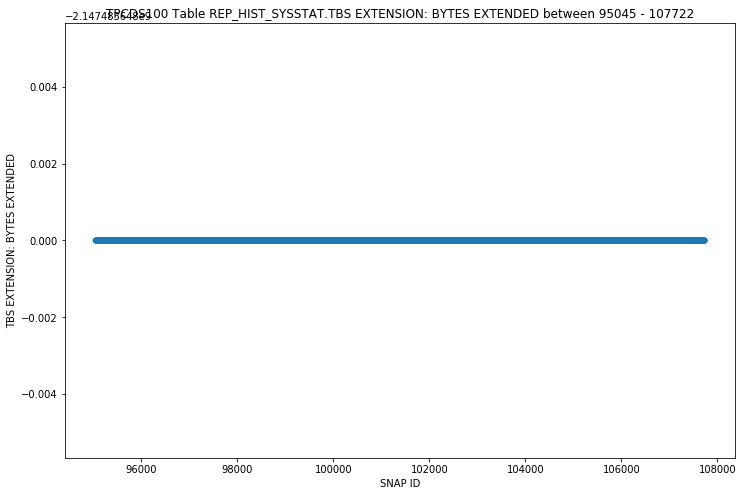

REP_HIST_SYSSTAT - TBS EXTENSION: FILES EXTENDED - OUTLIERS SCATTER


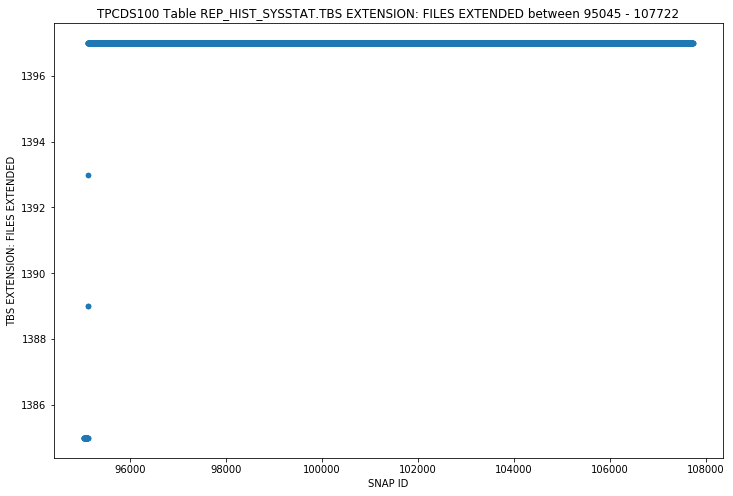

REP_HIST_SYSSTAT - TBS EXTENSION: TASKS CREATED - OUTLIERS SCATTER


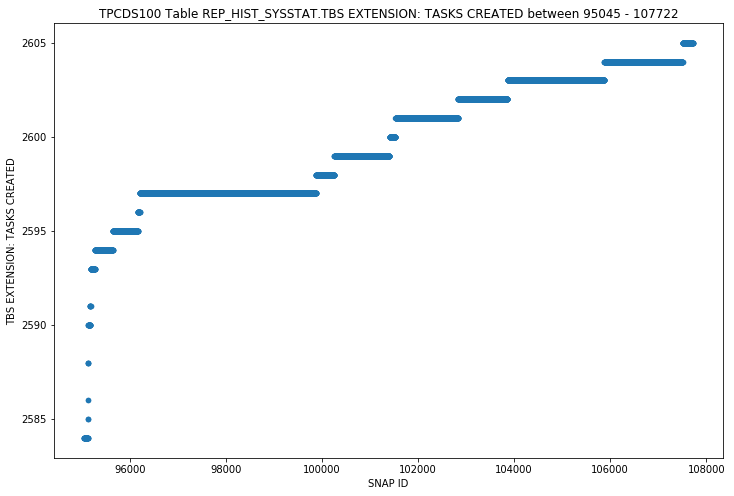

REP_HIST_SYSSTAT - TBS EXTENSION: TASKS EXECUTED - OUTLIERS SCATTER


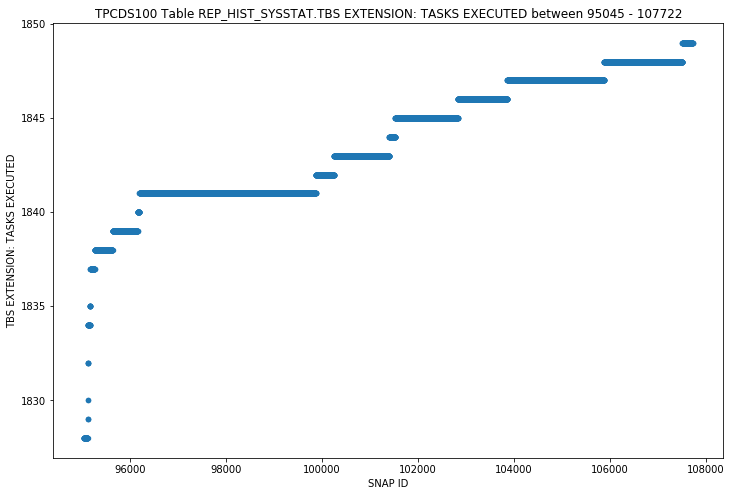

REP_HIST_SYSSTAT - ACTIVE TXN COUNT DURING CLEANOUT - OUTLIERS SCATTER


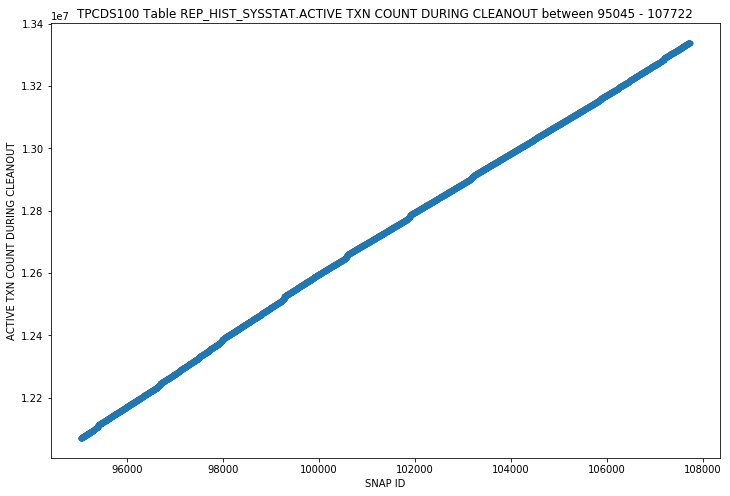

REP_HIST_SYSSTAT - APPLICATION WAIT TIME - OUTLIERS SCATTER


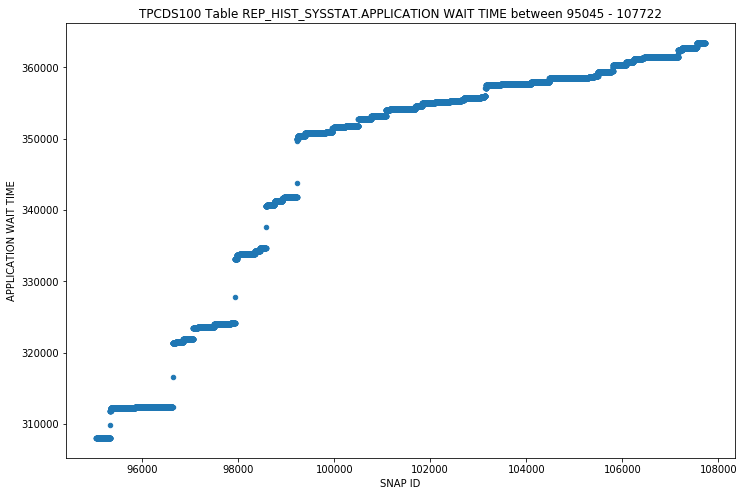

REP_HIST_SYSSTAT - BACKGROUND CHECKPOINTS COMPLETED - OUTLIERS SCATTER


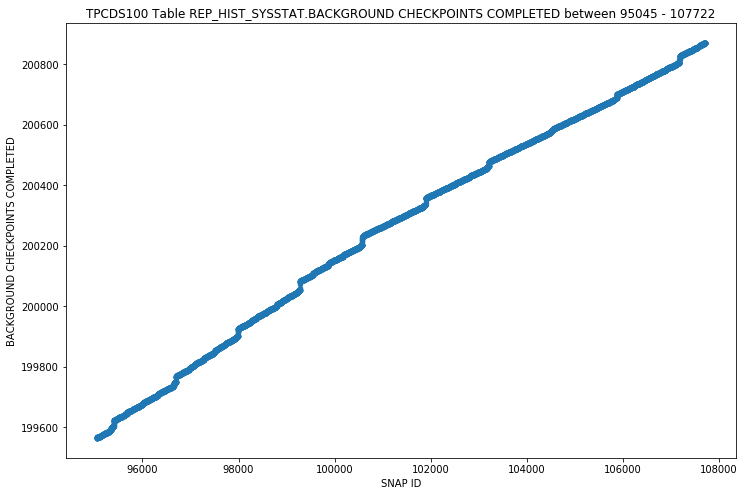

REP_HIST_SYSSTAT - BACKGROUND CHECKPOINTS STARTED - OUTLIERS SCATTER


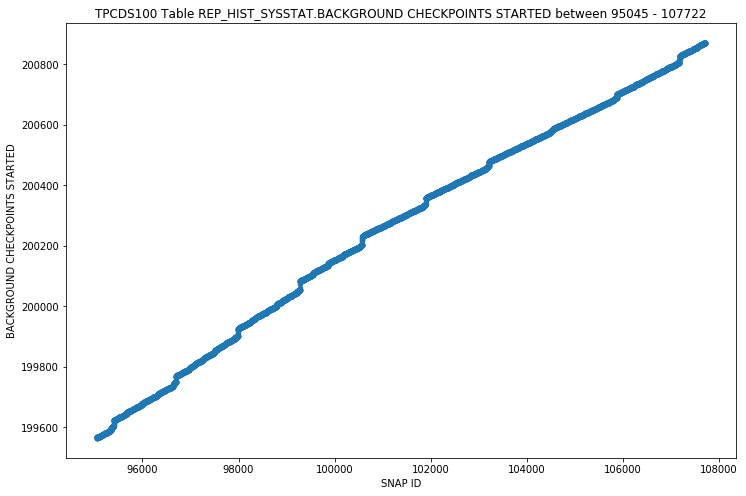

REP_HIST_SYSSTAT - BACKGROUND TIMEOUTS - OUTLIERS SCATTER


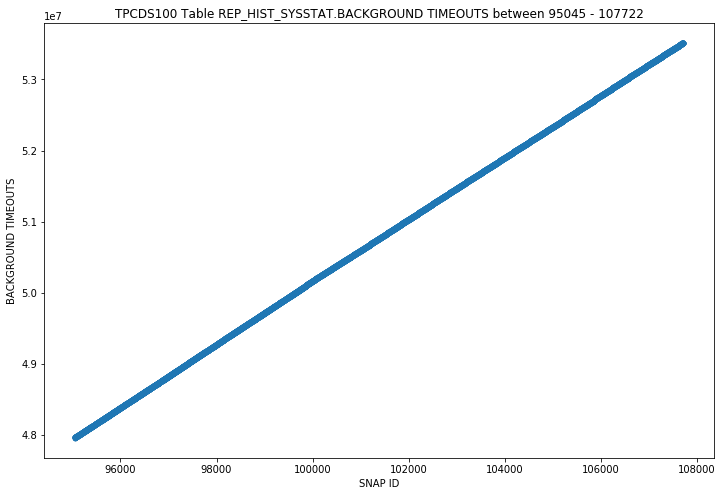

REP_HIST_SYSSTAT - BRANCH NODE SPLITS - OUTLIERS SCATTER


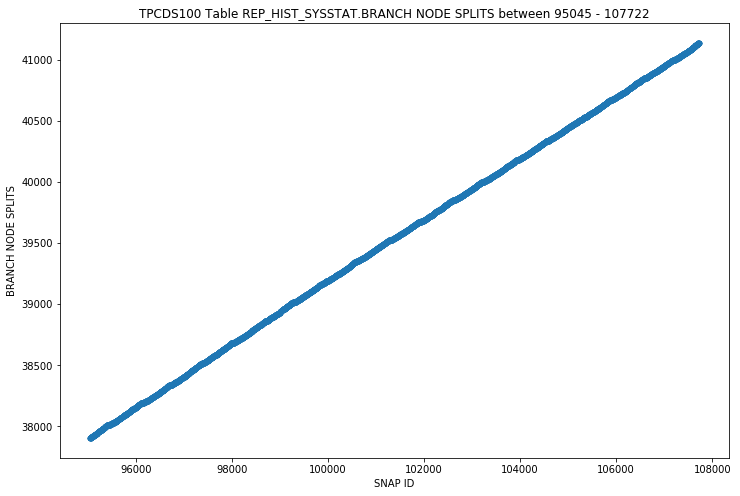

REP_HIST_SYSSTAT - BUFFER IS NOT PINNED COUNT - OUTLIERS SCATTER


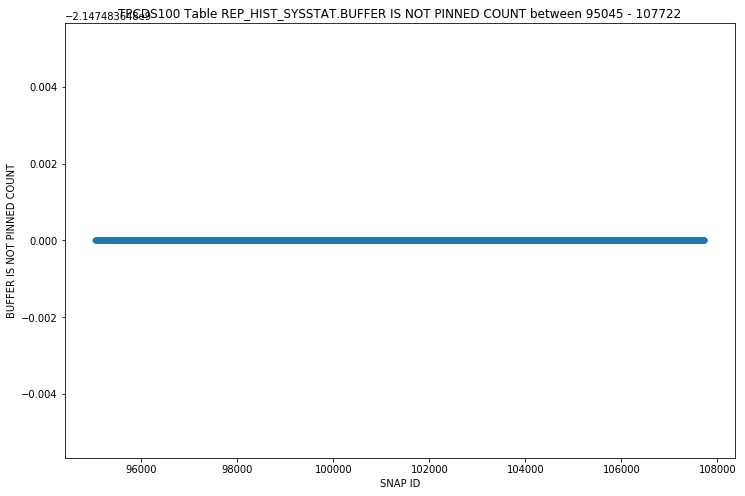

REP_HIST_SYSSTAT - BUFFER IS PINNED COUNT - OUTLIERS SCATTER


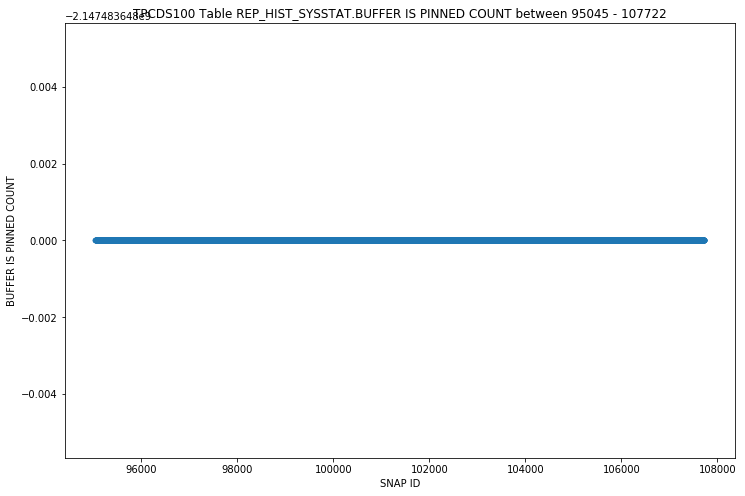

REP_HIST_SYSSTAT - BYTES RECEIVED VIA SQL*NET FROM CLIENT - OUTLIERS SCATTER


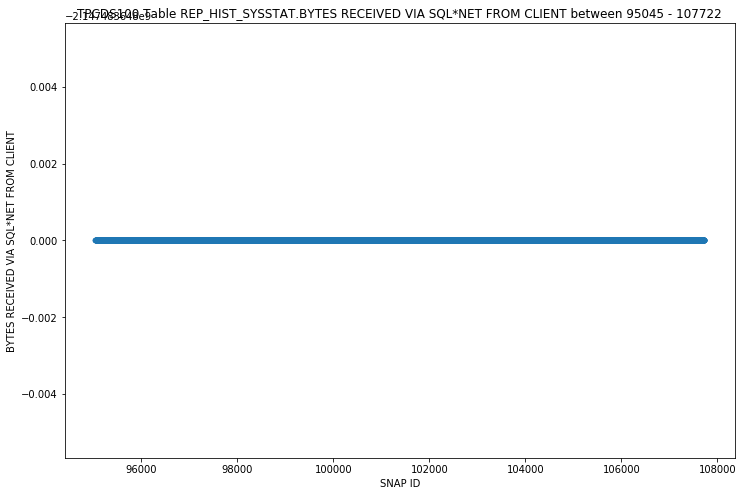

REP_HIST_SYSSTAT - BYTES SENT VIA SQL*NET TO CLIENT - OUTLIERS SCATTER


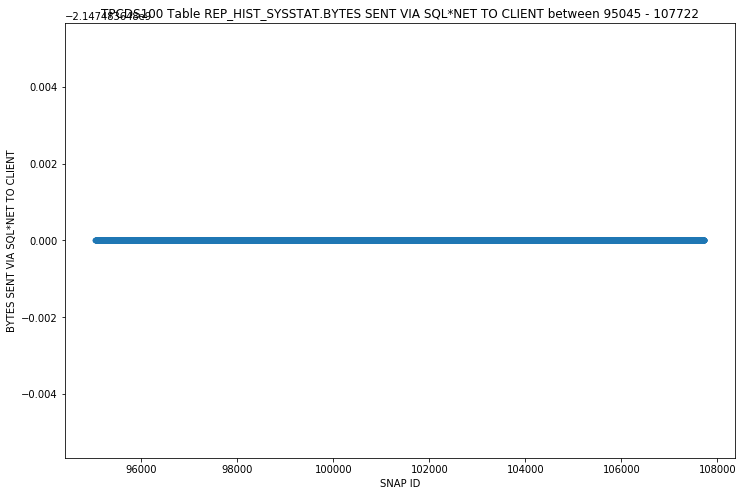

REP_HIST_SYSSTAT - BYTES VIA SQL*NET VECTOR TO CLIENT - OUTLIERS SCATTER


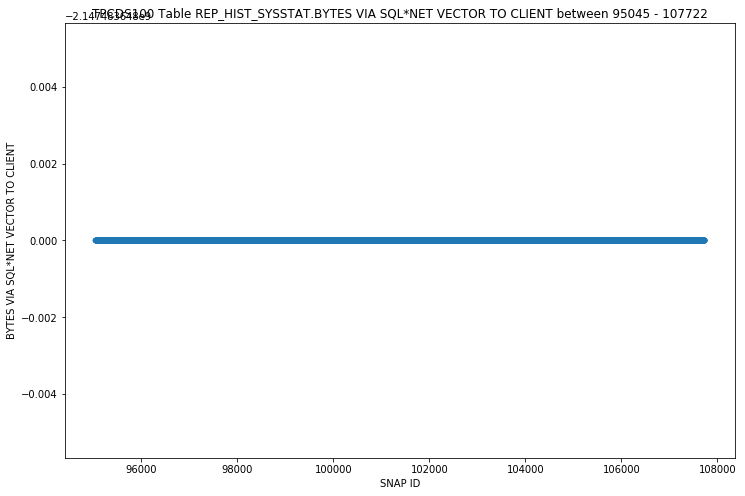

REP_HIST_SYSSTAT - CALLS TO GET SNAPSHOT SCN: KCMGSS - OUTLIERS SCATTER


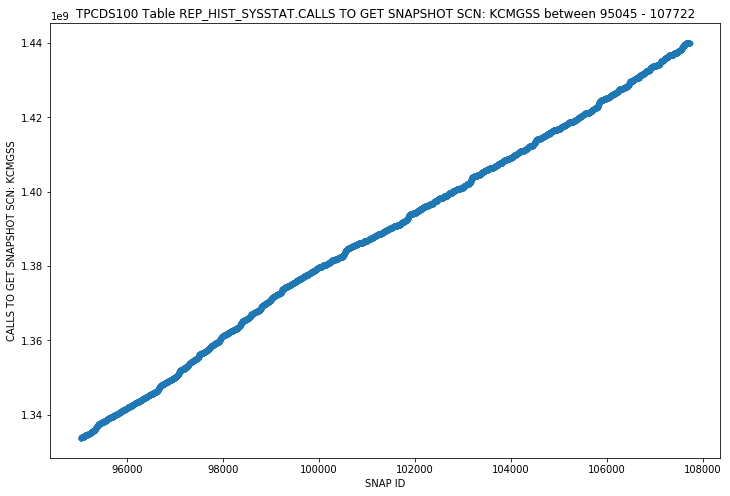

REP_HIST_SYSSTAT - CALLS TO KCMGAS - OUTLIERS SCATTER


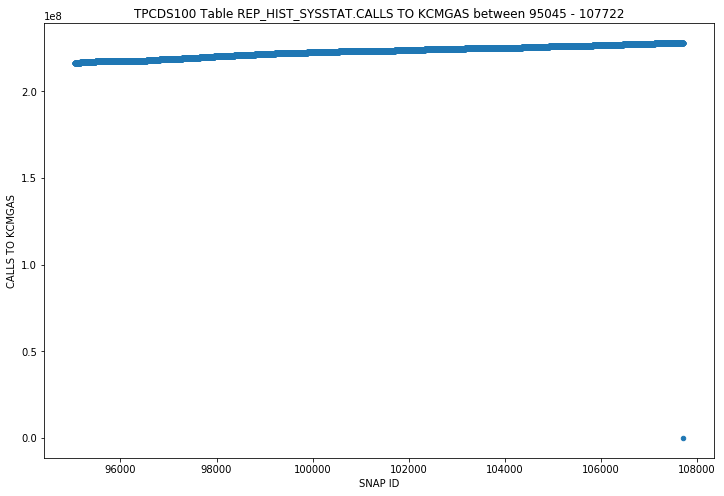

REP_HIST_SYSSTAT - CALLS TO KCMGCS - OUTLIERS SCATTER


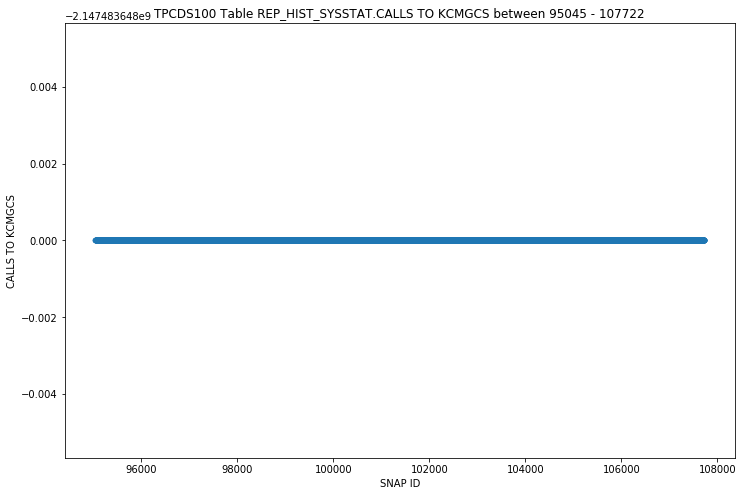

REP_HIST_SYSSTAT - CELL PHYSICAL IO INTERCONNECT BYTES - OUTLIERS SCATTER


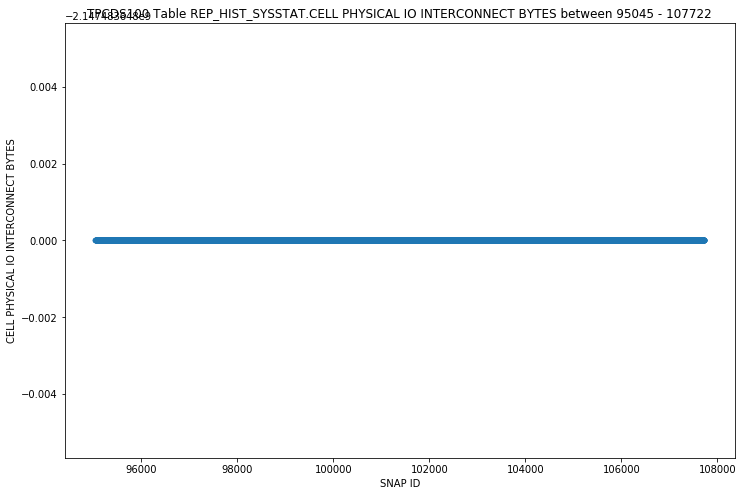

REP_HIST_SYSSTAT - CHANGE WRITE TIME - OUTLIERS SCATTER


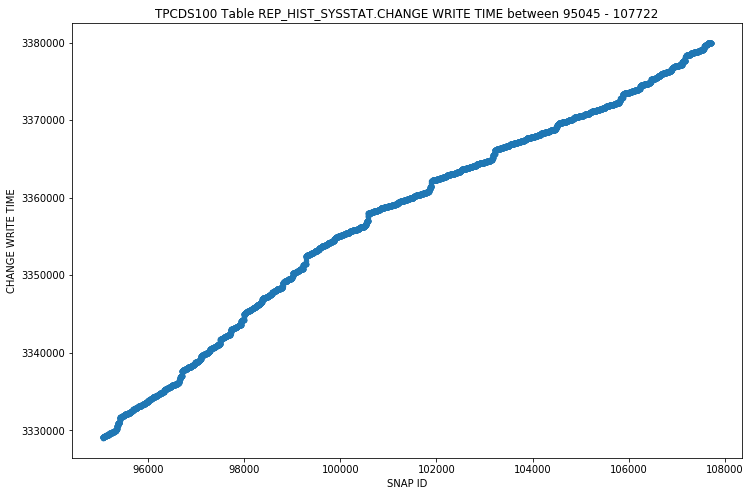

REP_HIST_SYSSTAT - CLEANOUT - NUMBER OF KTUGCT CALLS - OUTLIERS SCATTER


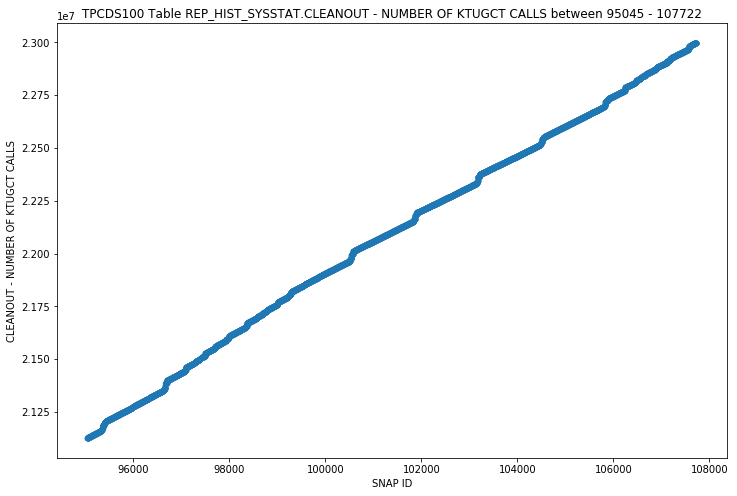

REP_HIST_SYSSTAT - CLEANOUTS AND ROLLBACKS - CONSISTENT READ GETS - OUTLIERS SCATTER


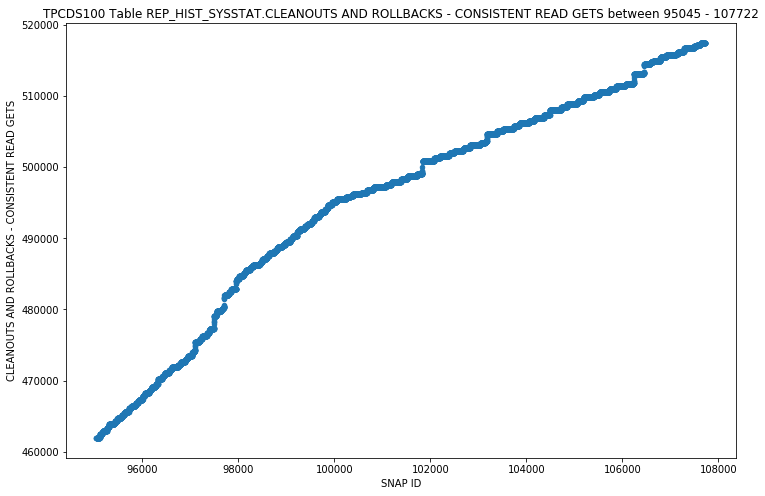

REP_HIST_SYSSTAT - CLEANOUTS ONLY - CONSISTENT READ GETS - OUTLIERS SCATTER


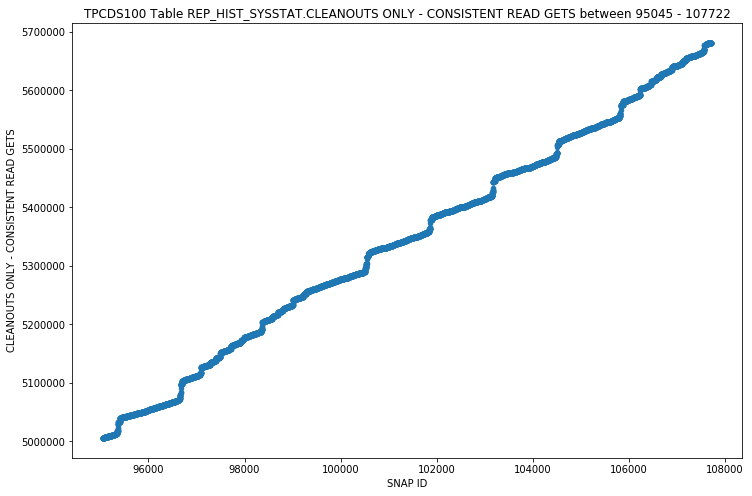

REP_HIST_SYSSTAT - CLUSTER KEY SCAN BLOCK GETS - OUTLIERS SCATTER


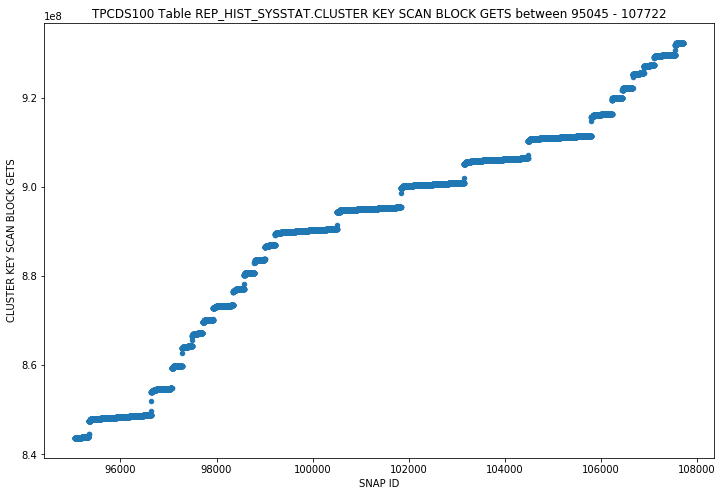

REP_HIST_SYSSTAT - CLUSTER KEY SCANS - OUTLIERS SCATTER


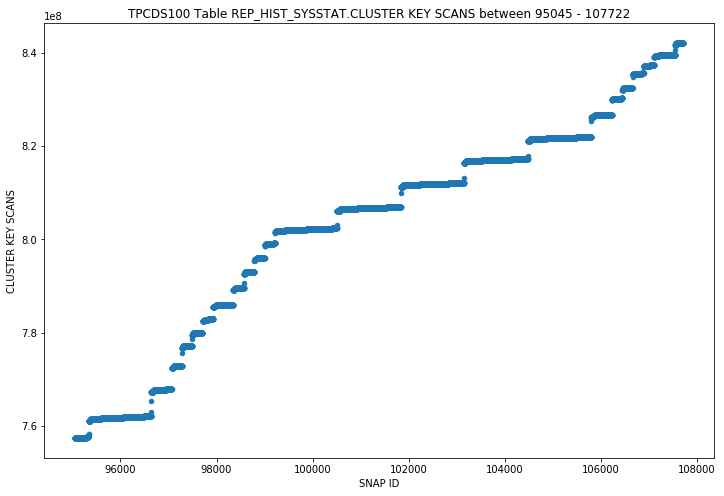

REP_HIST_SYSSTAT - COMMIT BATCH/IMMEDIATE PERFORMED - OUTLIERS SCATTER


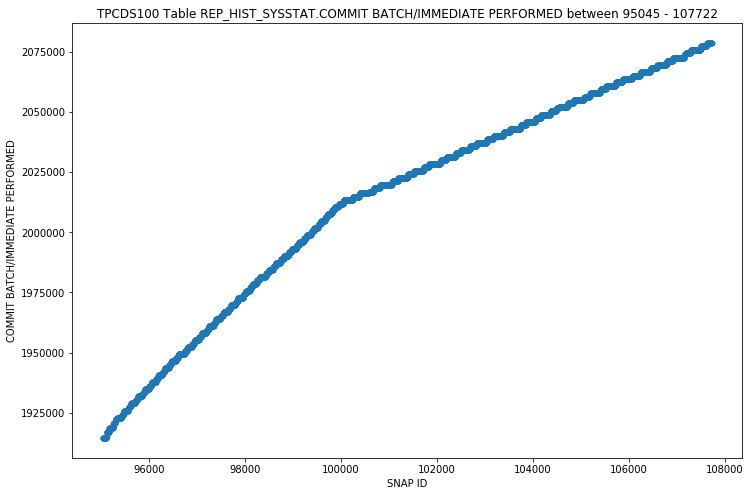

REP_HIST_SYSSTAT - COMMIT BATCH/IMMEDIATE REQUESTED - OUTLIERS SCATTER


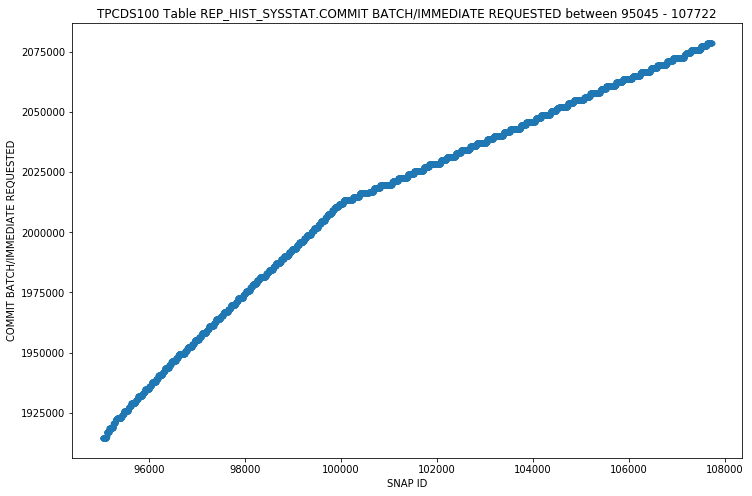

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: BLOCK LOST - OUTLIERS SCATTER


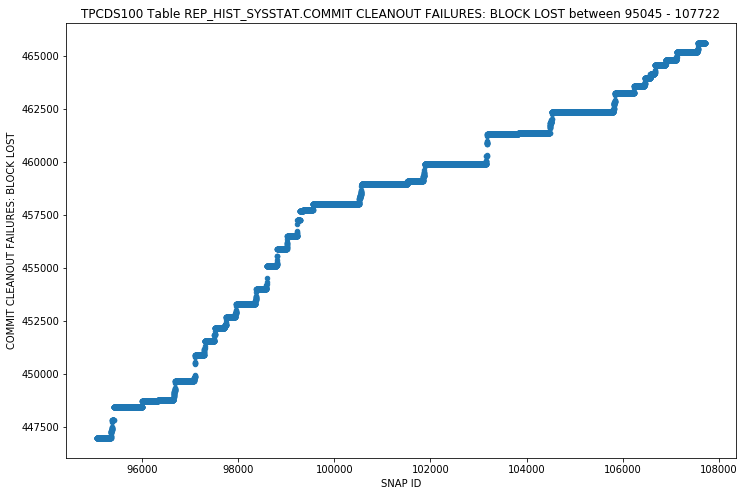

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: BUFFER BEING WRITTEN - OUTLIERS SCATTER


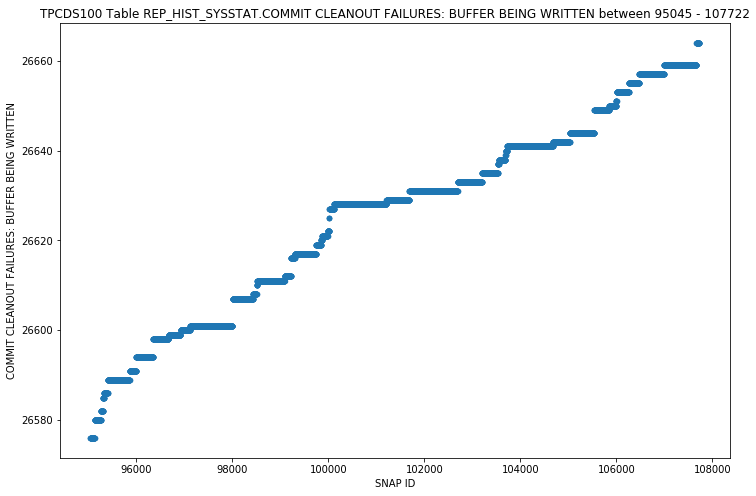

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: CALLBACK FAILURE  - OUTLIERS SCATTER


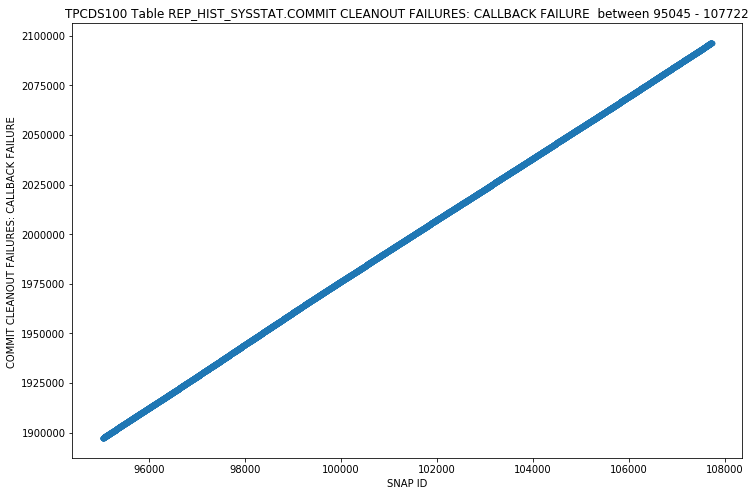

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: CANNOT PIN - OUTLIERS SCATTER


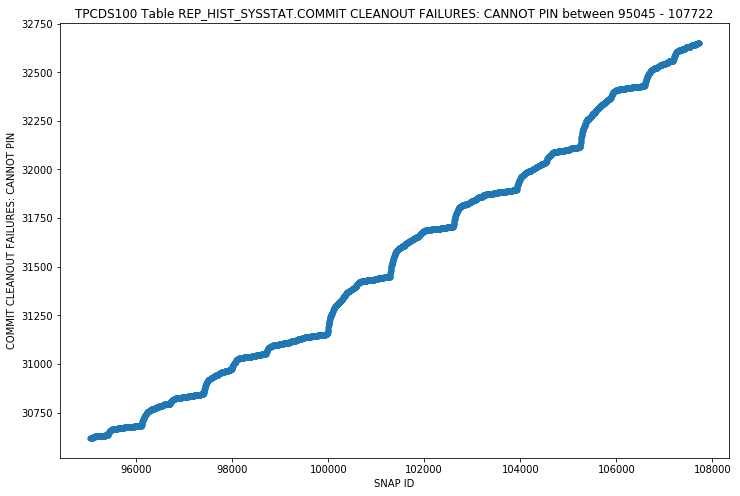

REP_HIST_SYSSTAT - COMMIT CLEANOUTS - OUTLIERS SCATTER


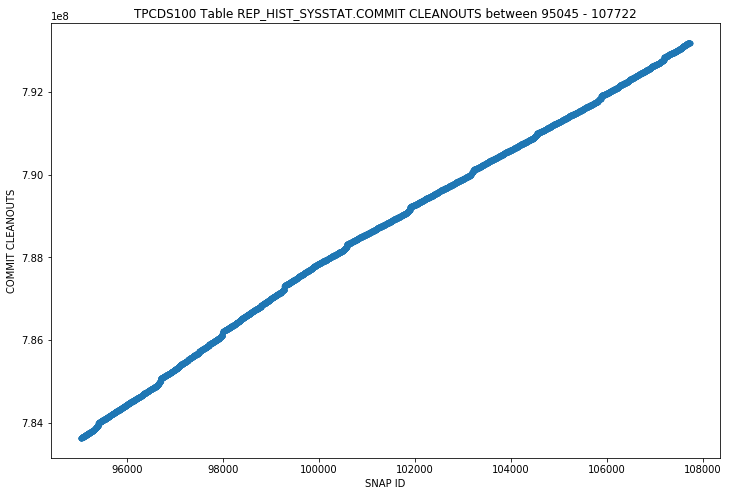

REP_HIST_SYSSTAT - COMMIT CLEANOUTS SUCCESSFULLY COMPLETED - OUTLIERS SCATTER


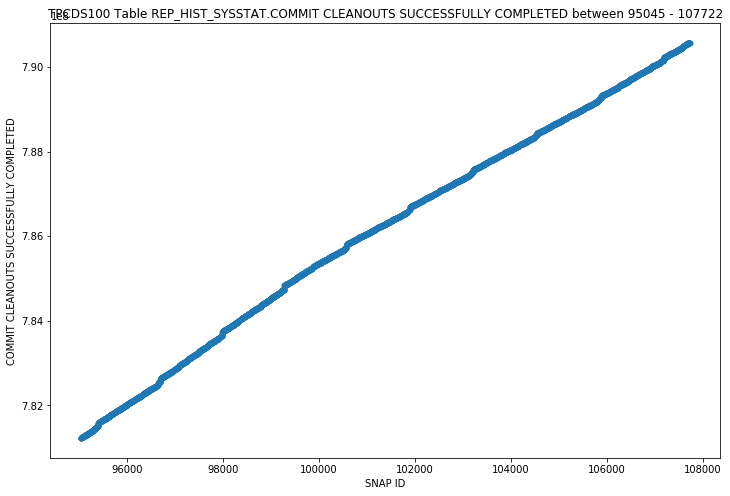

REP_HIST_SYSSTAT - COMMIT IMMEDIATE PERFORMED - OUTLIERS SCATTER


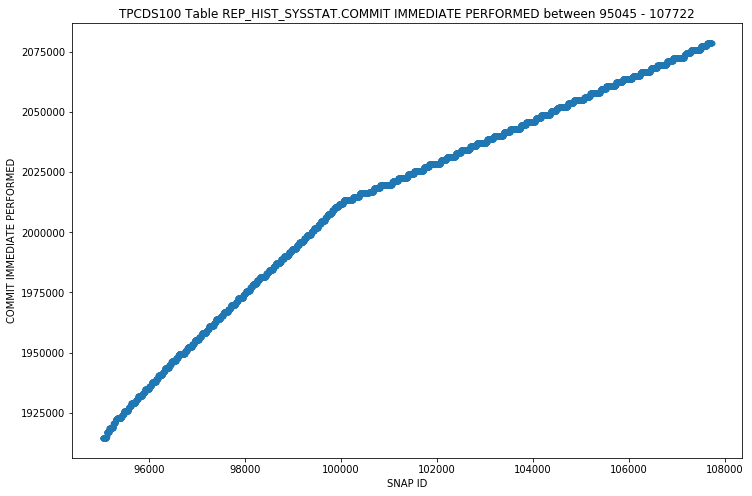

REP_HIST_SYSSTAT - COMMIT IMMEDIATE REQUESTED - OUTLIERS SCATTER


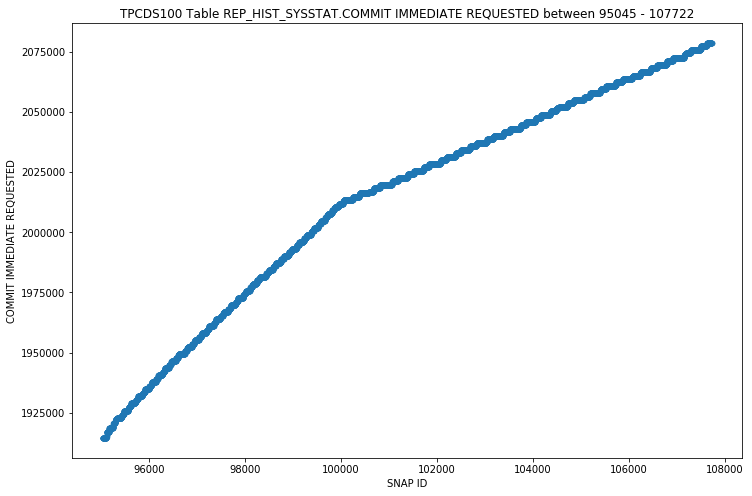

REP_HIST_SYSSTAT - COMMIT TXN COUNT DURING CLEANOUT - OUTLIERS SCATTER


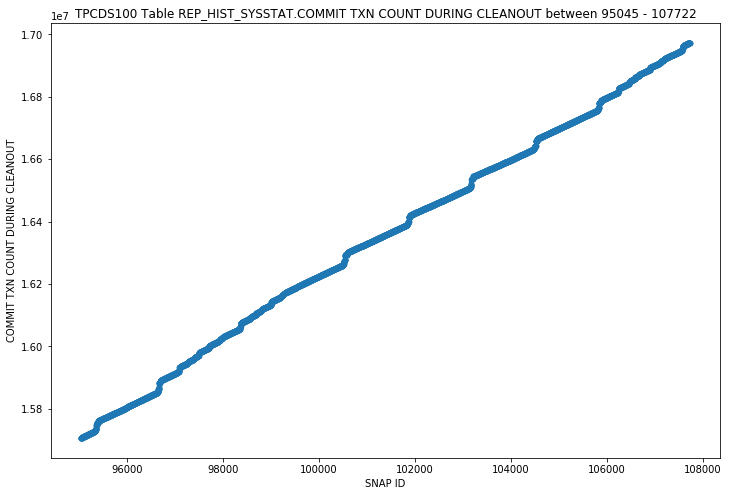

REP_HIST_SYSSTAT - CONCURRENCY WAIT TIME - OUTLIERS SCATTER


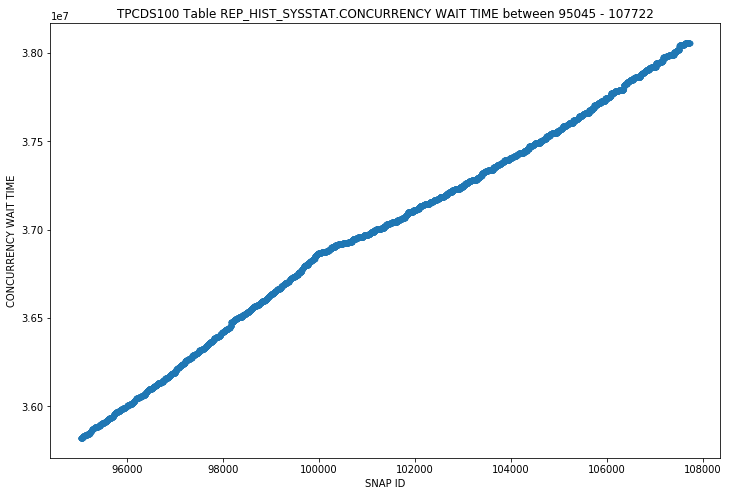

REP_HIST_SYSSTAT - CONSISTENT CHANGES - OUTLIERS SCATTER


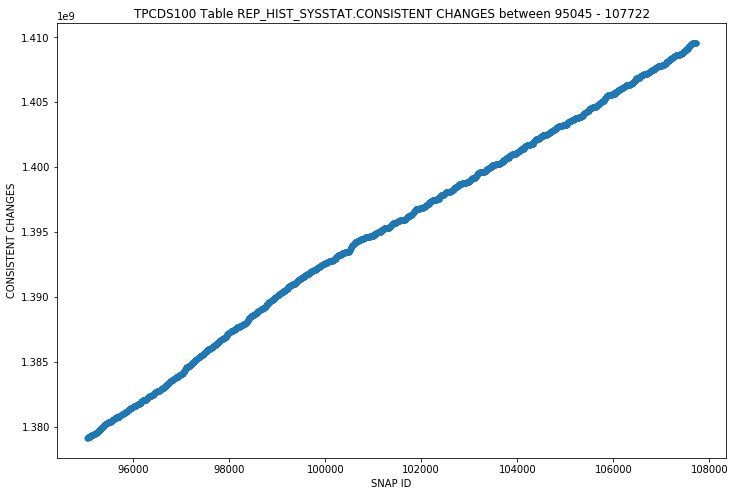

REP_HIST_SYSSTAT - CONSISTENT GETS - OUTLIERS SCATTER


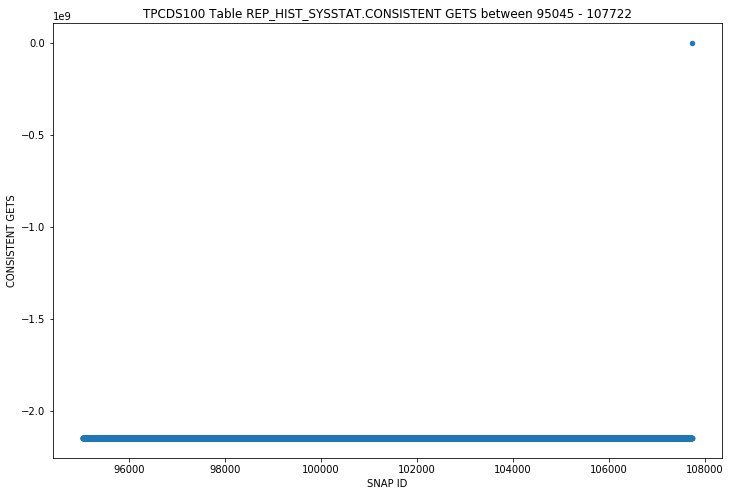

REP_HIST_SYSSTAT - CONSISTENT GETS DIRECT - OUTLIERS SCATTER


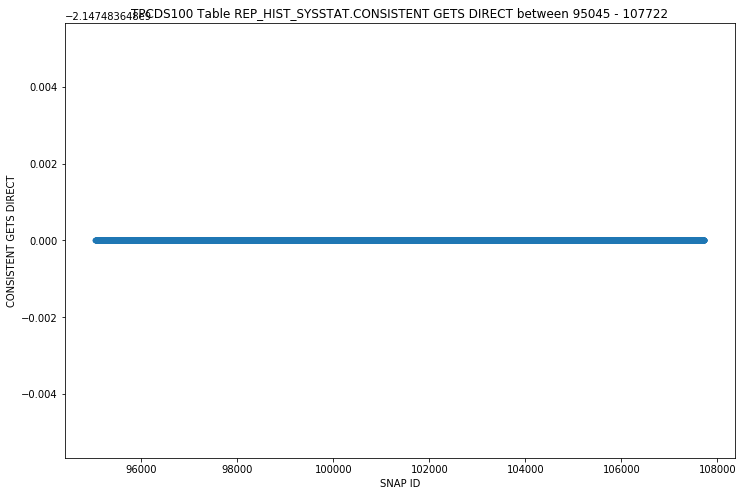

REP_HIST_SYSSTAT - CONSISTENT GETS EXAMINATION - OUTLIERS SCATTER


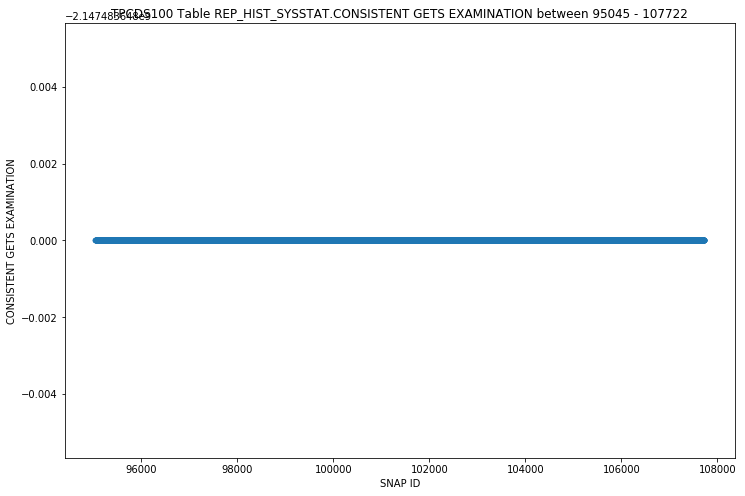

REP_HIST_SYSSTAT - CONSISTENT GETS EXAMINATION (FASTPATH) - OUTLIERS SCATTER


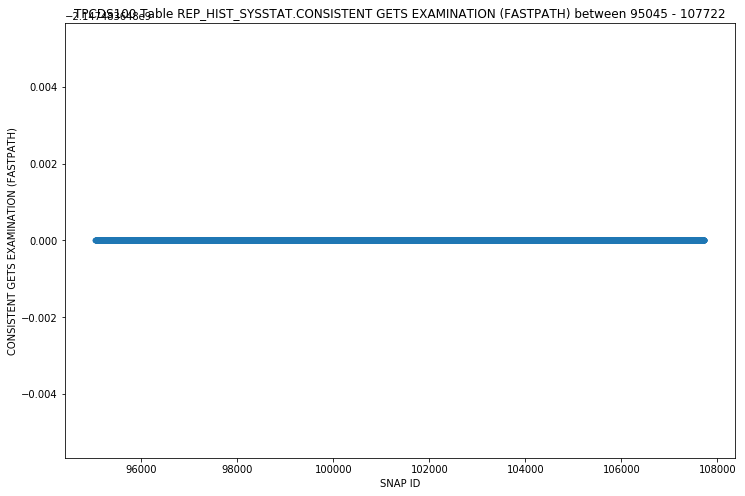

REP_HIST_SYSSTAT - CONSISTENT GETS FROM CACHE - OUTLIERS SCATTER


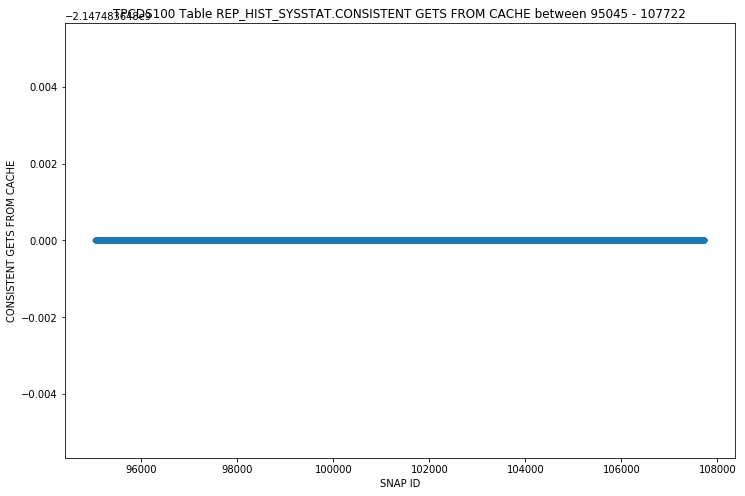

REP_HIST_SYSSTAT - CONSISTENT GETS PIN - OUTLIERS SCATTER


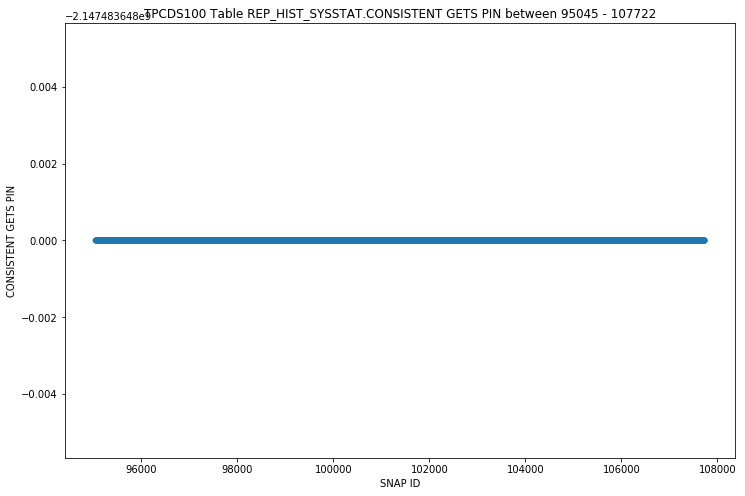

REP_HIST_SYSSTAT - CONSISTENT GETS PIN (FASTPATH) - OUTLIERS SCATTER


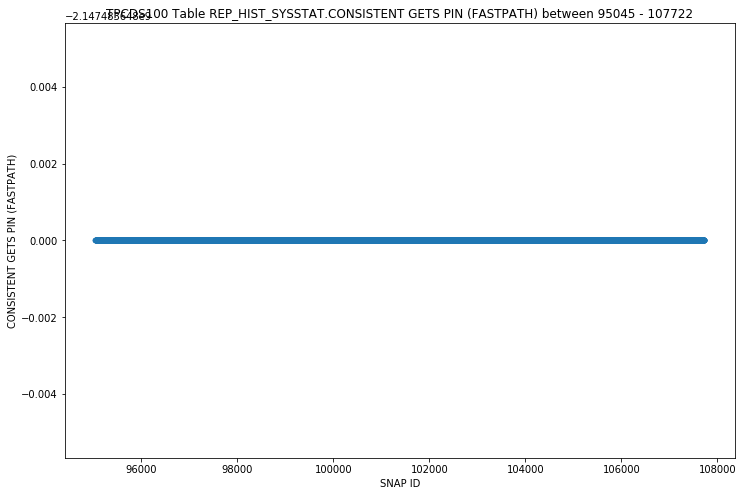

REP_HIST_SYSSTAT - CURSOR AUTHENTICATIONS - OUTLIERS SCATTER


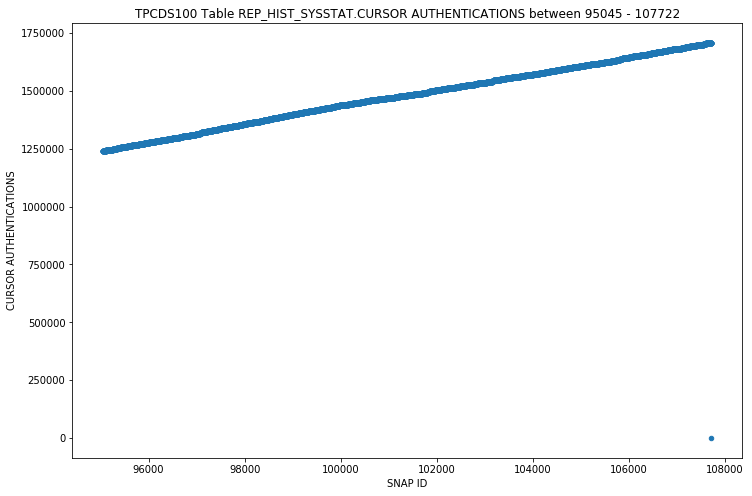

REP_HIST_SYSSTAT - CURSOR RELOAD FAILURES - OUTLIERS SCATTER


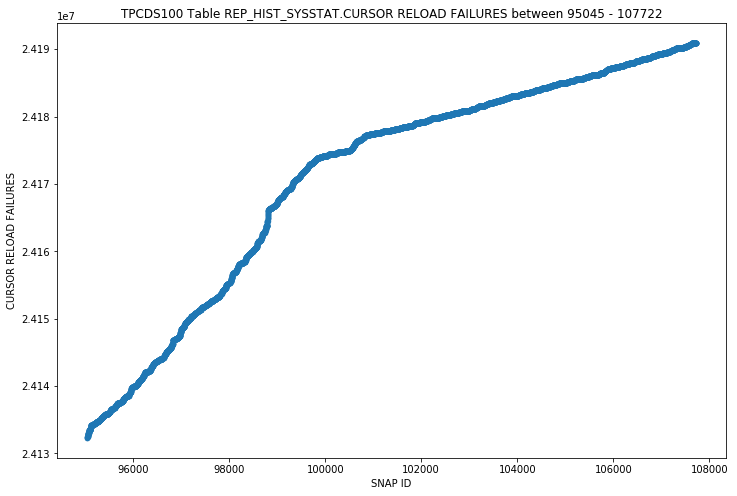

REP_HIST_SYSSTAT - DATA BLOCKS CONSISTENT READS - UNDO RECORDS APPLIED - OUTLIERS SCATTER


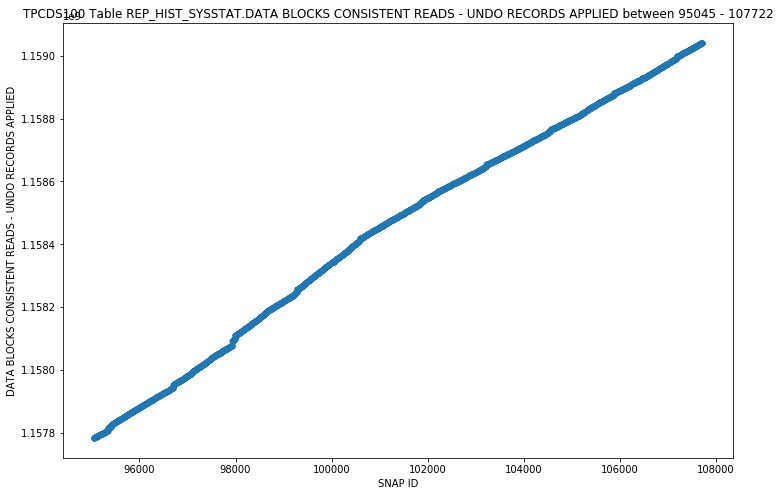

REP_HIST_SYSSTAT - DB BLOCK CHANGES - OUTLIERS SCATTER


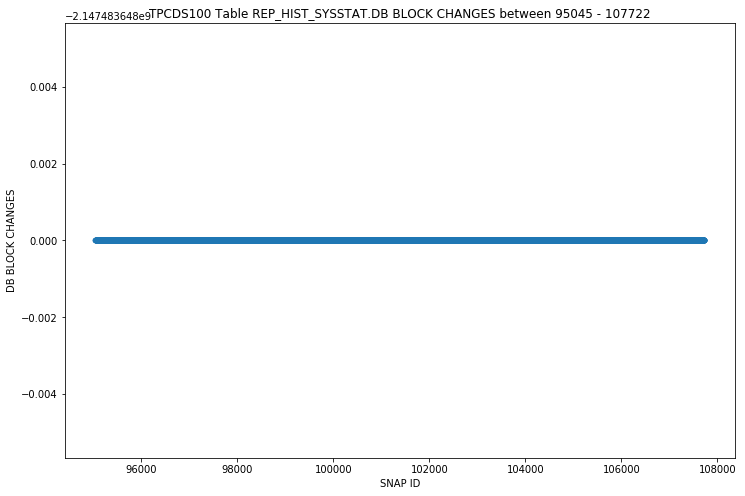

REP_HIST_SYSSTAT - DB BLOCK GETS - OUTLIERS SCATTER


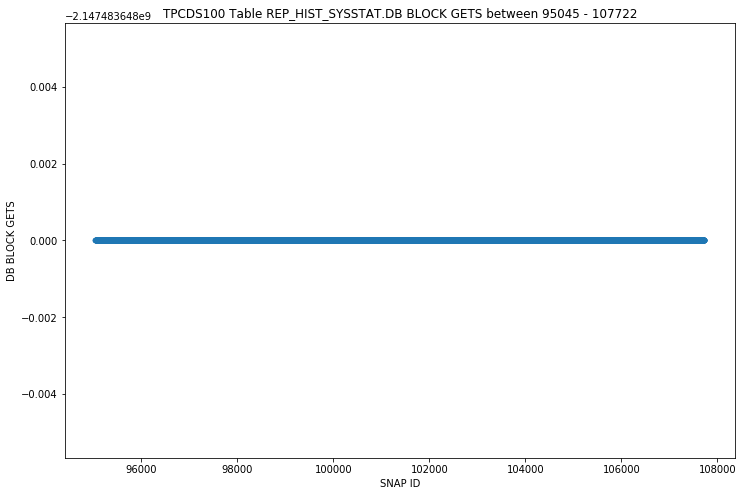

REP_HIST_SYSSTAT - DB BLOCK GETS DIRECT - OUTLIERS SCATTER


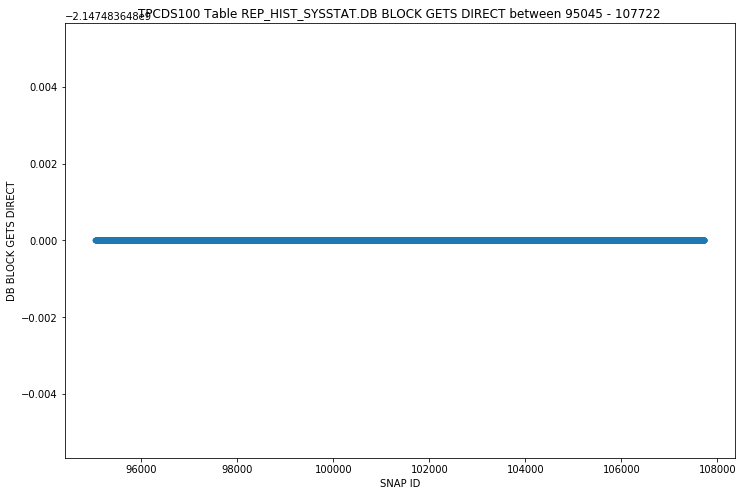

REP_HIST_SYSSTAT - DB BLOCK GETS FROM CACHE - OUTLIERS SCATTER


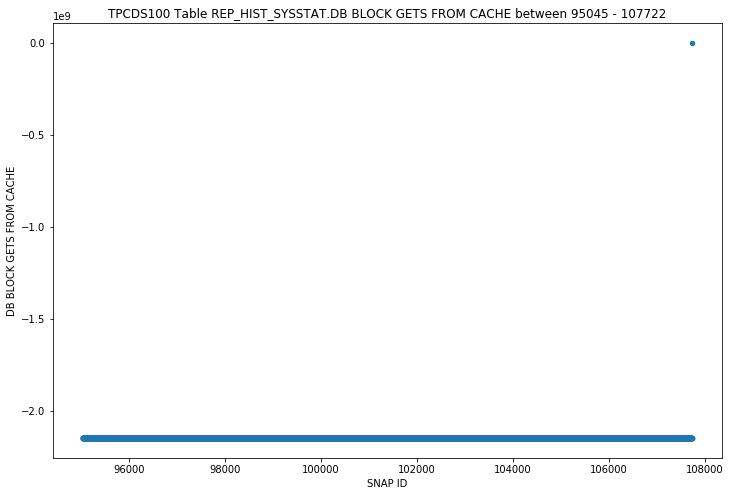

REP_HIST_SYSSTAT - DB BLOCK GETS FROM CACHE (FASTPATH) - OUTLIERS SCATTER


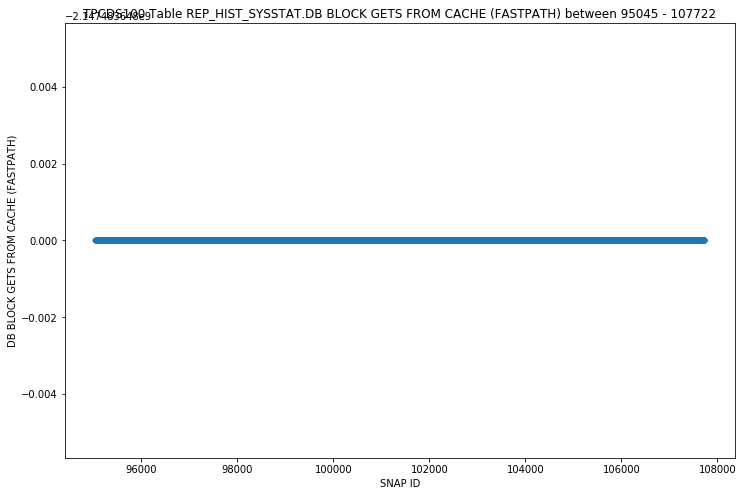

REP_HIST_SYSSTAT - DEFERRED (CURRENT) BLOCK CLEANOUT APPLICATIONS - OUTLIERS SCATTER


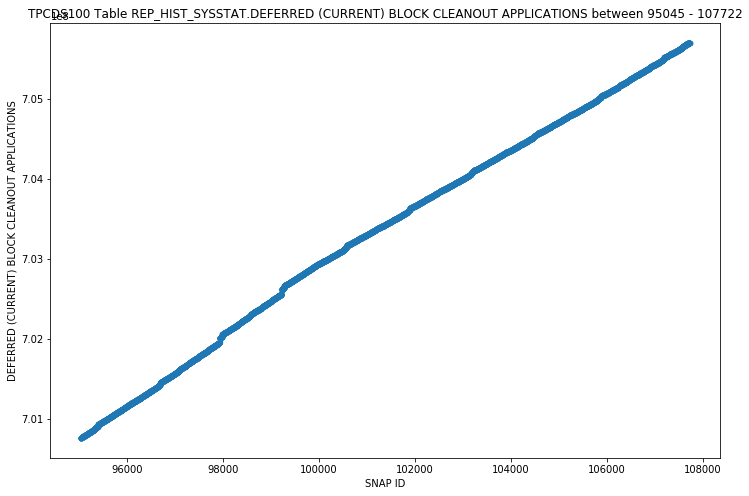

REP_HIST_SYSSTAT - DIRTY BUFFERS INSPECTED - OUTLIERS SCATTER


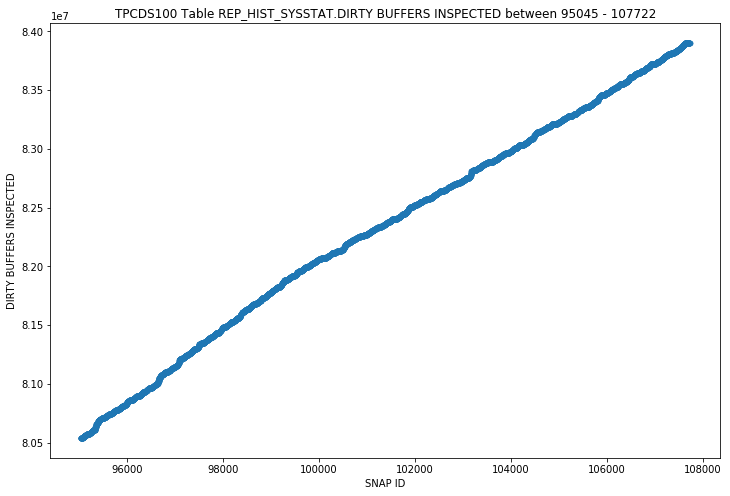

REP_HIST_SYSSTAT - ENQUEUE CONVERSIONS - OUTLIERS SCATTER


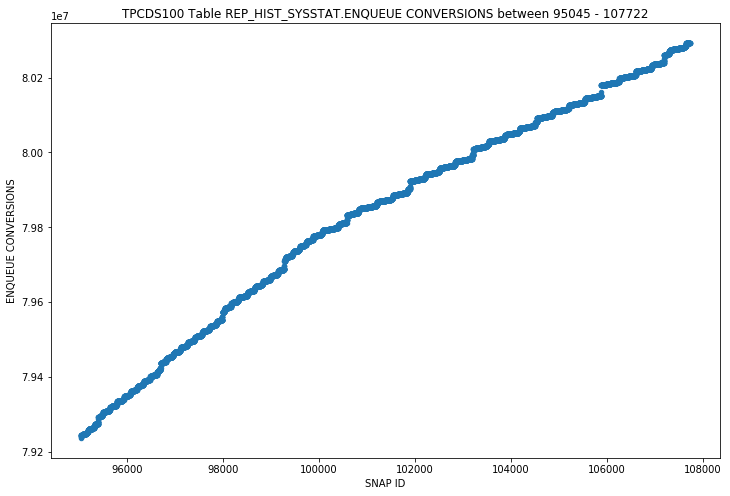

REP_HIST_SYSSTAT - ENQUEUE RELEASES - OUTLIERS SCATTER


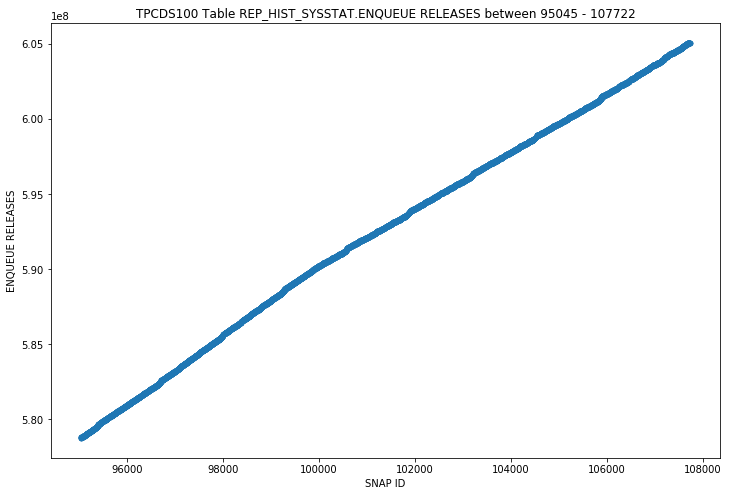

REP_HIST_SYSSTAT - ENQUEUE REQUESTS - OUTLIERS SCATTER


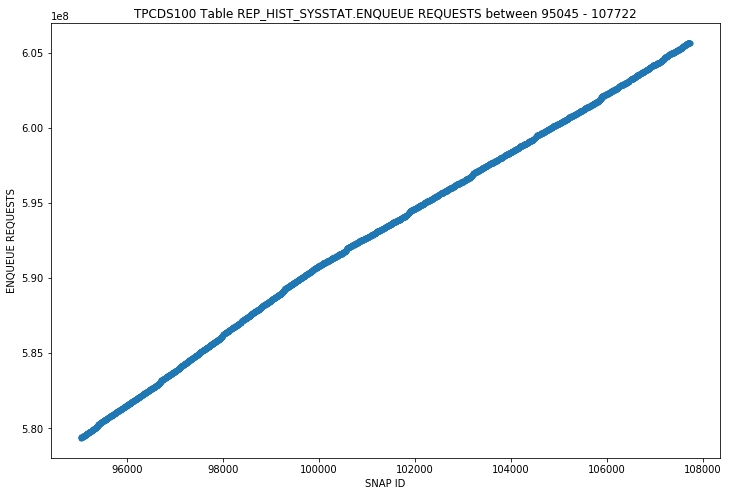

REP_HIST_SYSSTAT - ENQUEUE TIMEOUTS - OUTLIERS SCATTER


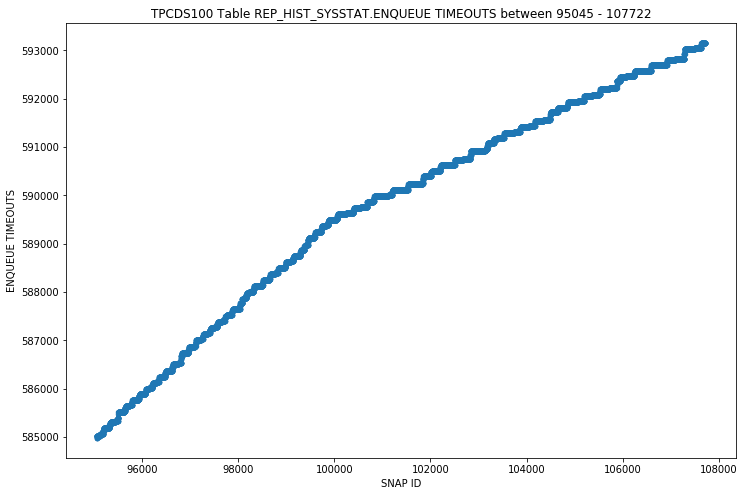

REP_HIST_SYSSTAT - ENQUEUE WAITS - OUTLIERS SCATTER


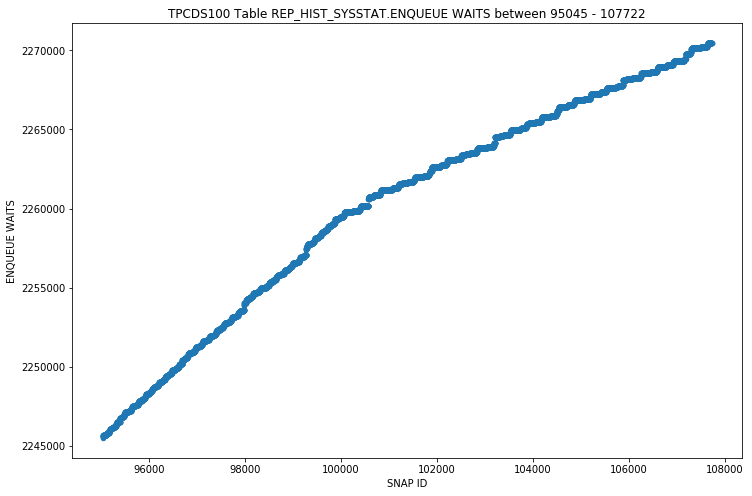

REP_HIST_SYSSTAT - EXCHANGE DEADLOCKS - OUTLIERS SCATTER


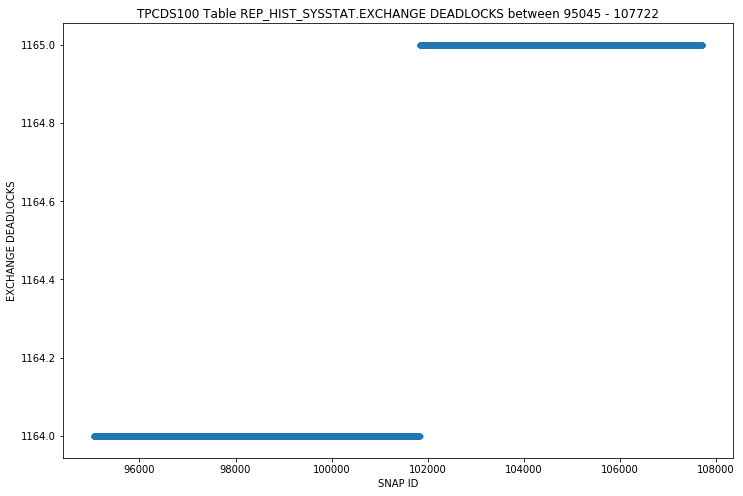

REP_HIST_SYSSTAT - EXECUTE COUNT - OUTLIERS SCATTER


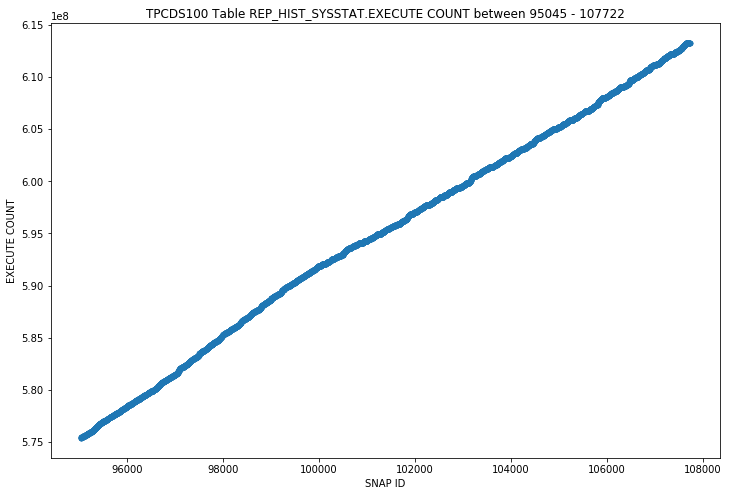

REP_HIST_SYSSTAT - FAILED PROBES ON INDEX BLOCK RECLAMATION - OUTLIERS SCATTER


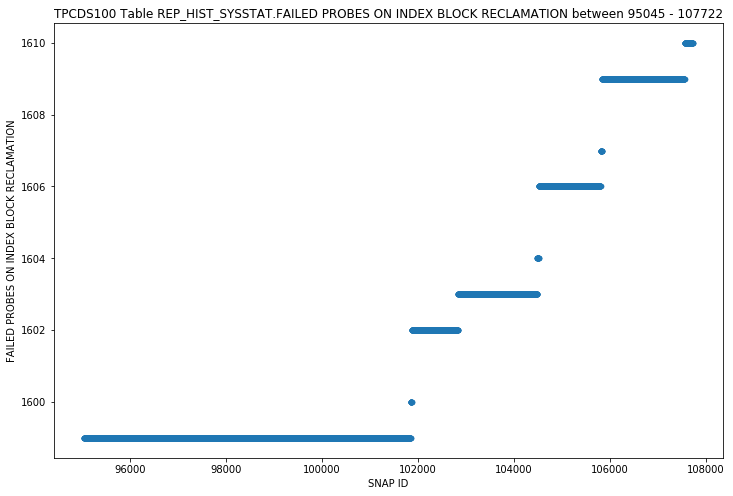

REP_HIST_SYSSTAT - FASTPATH CONSISTENT GET QUOTA LIMIT - OUTLIERS SCATTER


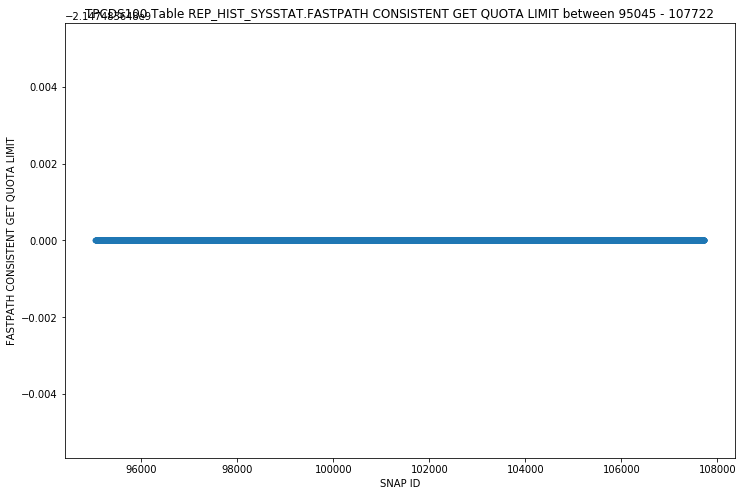

REP_HIST_SYSSTAT - FILE IO SERVICE TIME - OUTLIERS SCATTER


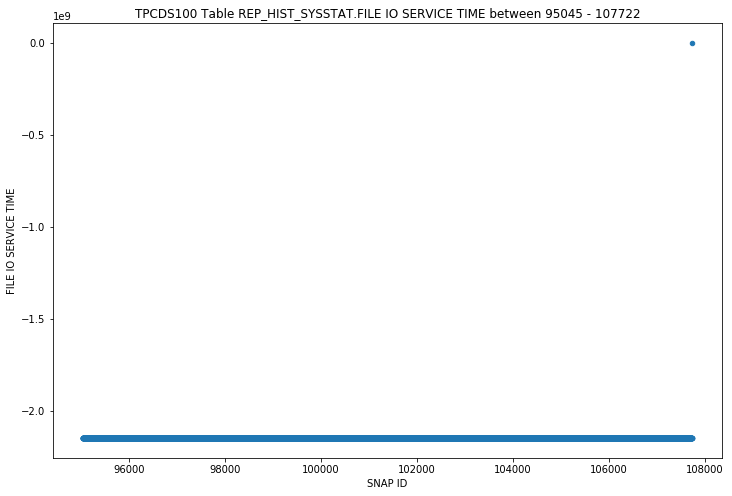

REP_HIST_SYSSTAT - FILE IO WAIT TIME - OUTLIERS SCATTER


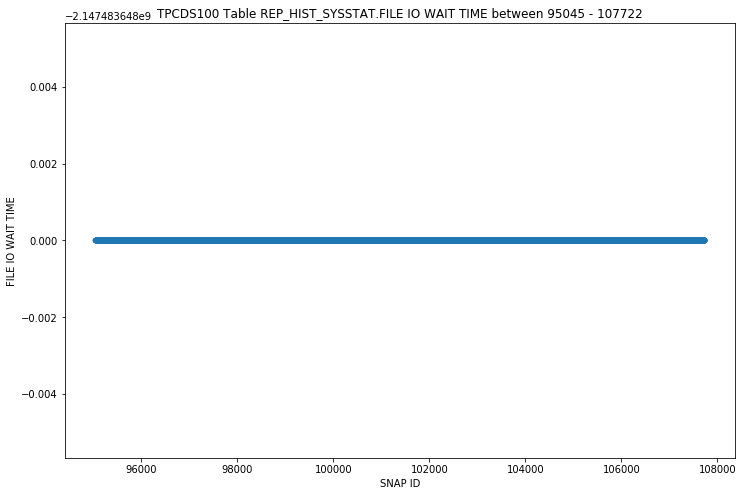

REP_HIST_SYSSTAT - FRAME SIGNATURE MISMATCH - OUTLIERS SCATTER


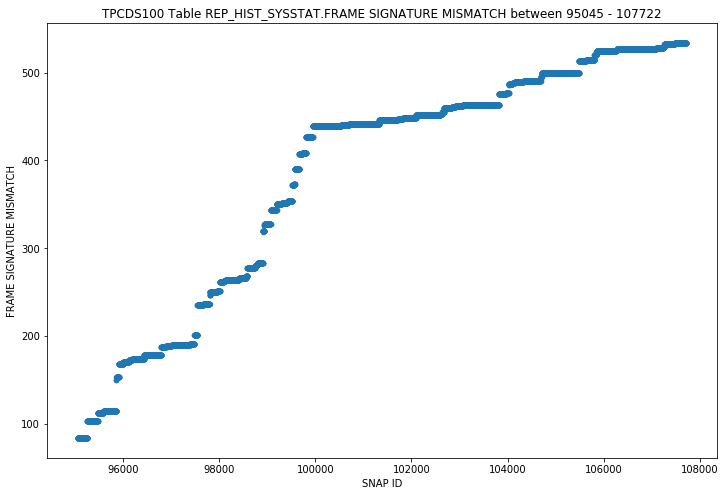

REP_HIST_SYSSTAT - FREE BUFFER INSPECTED - OUTLIERS SCATTER


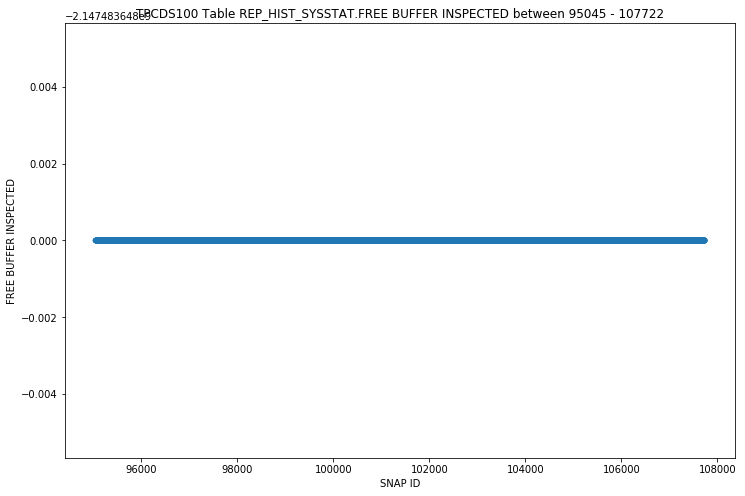

REP_HIST_SYSSTAT - FREE BUFFER REQUESTED - OUTLIERS SCATTER


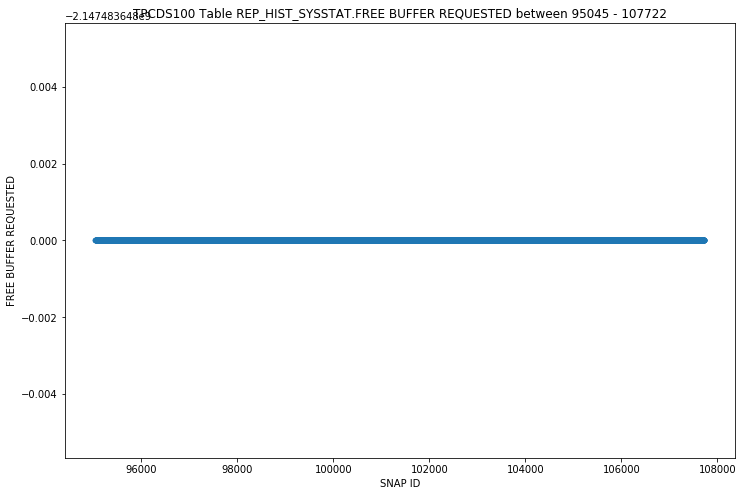

REP_HIST_SYSSTAT - HEAP BLOCK COMPRESS - OUTLIERS SCATTER


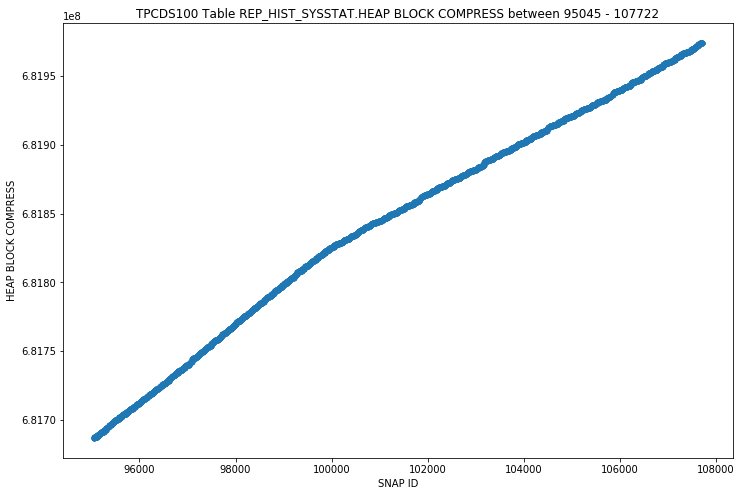

REP_HIST_SYSSTAT - HOT BUFFERS MOVED TO HEAD OF LRU - OUTLIERS SCATTER


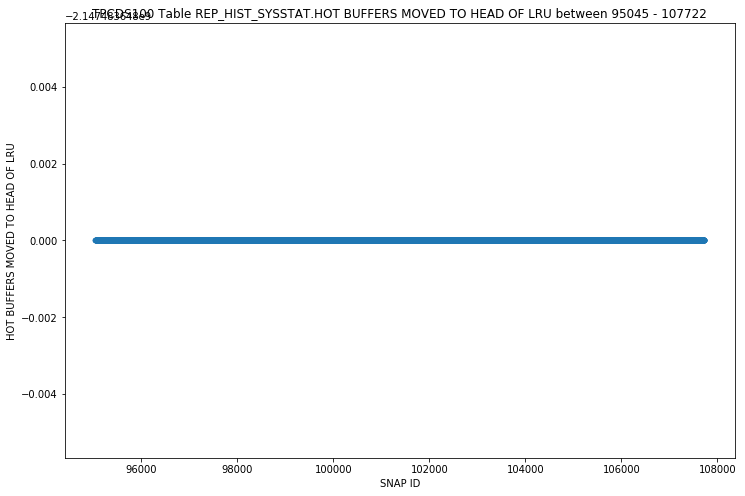

REP_HIST_SYSSTAT - IMMEDIATE (CR) BLOCK CLEANOUT APPLICATIONS - OUTLIERS SCATTER


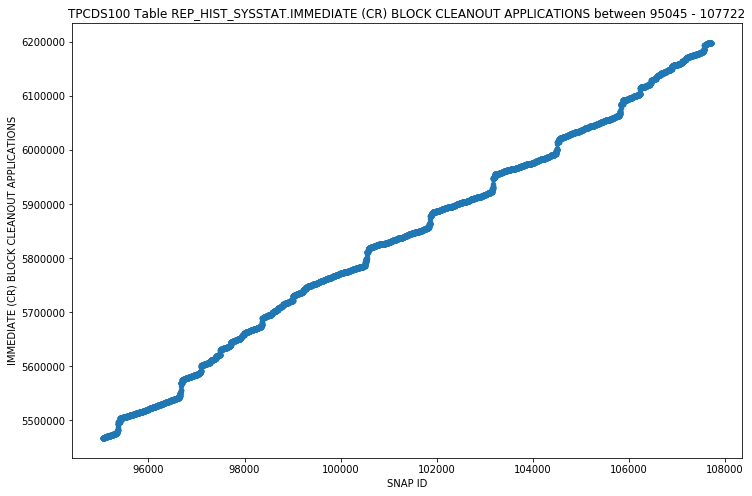

REP_HIST_SYSSTAT - IMMEDIATE (CURRENT) BLOCK CLEANOUT APPLICATIONS - OUTLIERS SCATTER


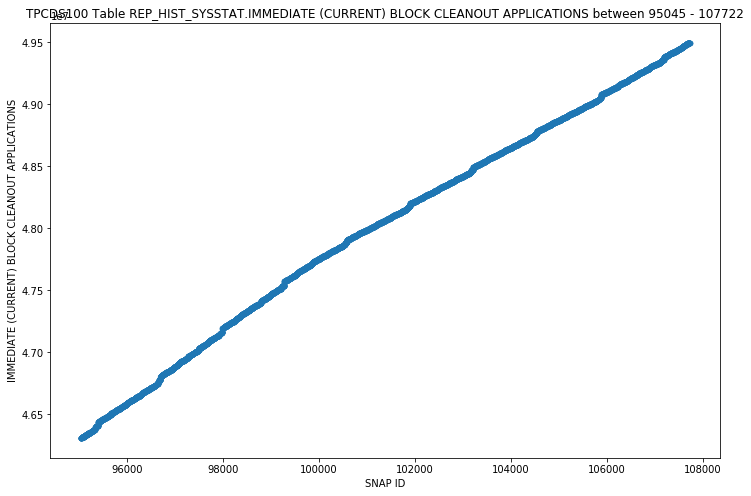

REP_HIST_SYSSTAT - IN CALL IDLE WAIT TIME - OUTLIERS SCATTER


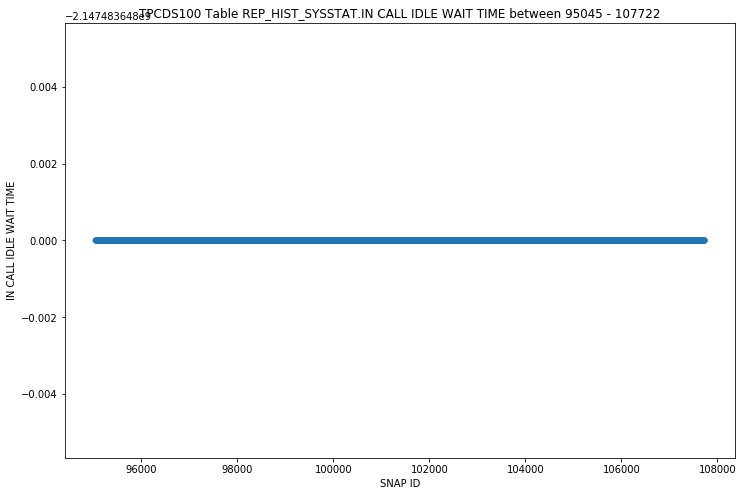

REP_HIST_SYSSTAT - INDEX CRX UPGRADE (POSITIONED) - OUTLIERS SCATTER


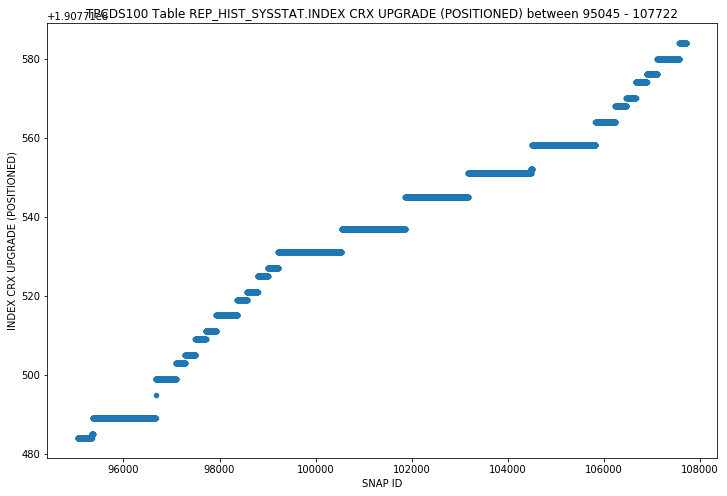

REP_HIST_SYSSTAT - INDEX CRX UPGRADE (PREFETCH) - OUTLIERS SCATTER


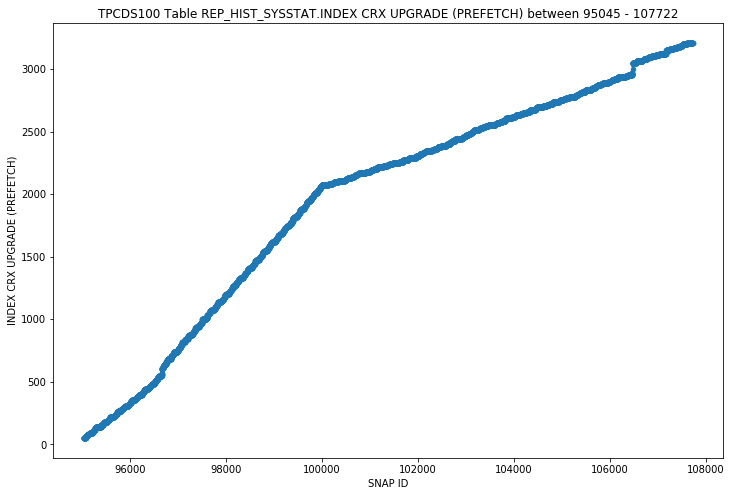

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (DIRECT READ) - OUTLIERS SCATTER


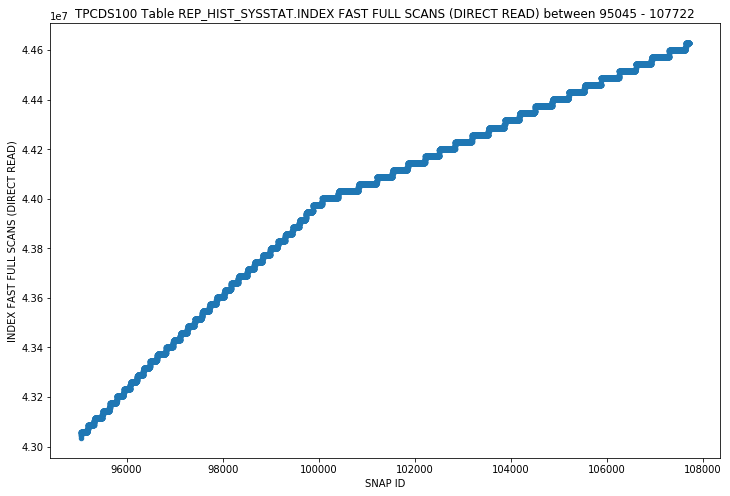

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (FULL) - OUTLIERS SCATTER


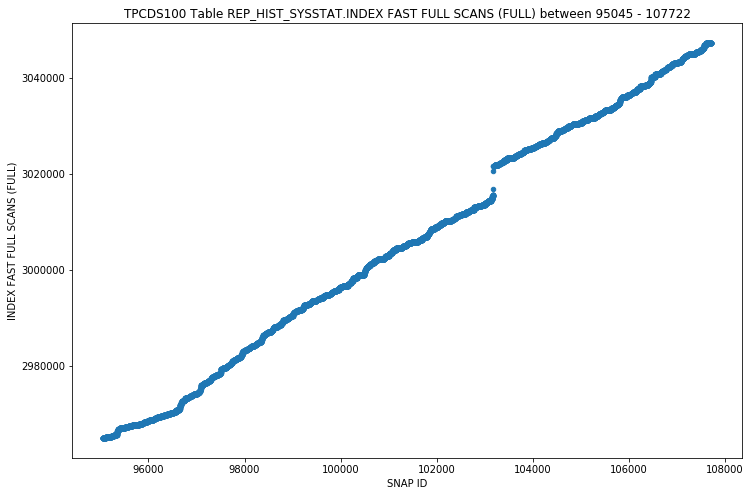

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (ROWID RANGES) - OUTLIERS SCATTER


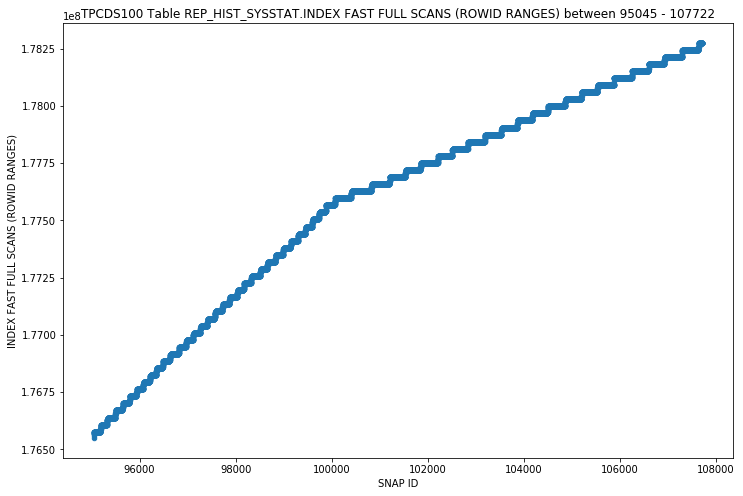

REP_HIST_SYSSTAT - INDEX FETCH BY KEY - OUTLIERS SCATTER


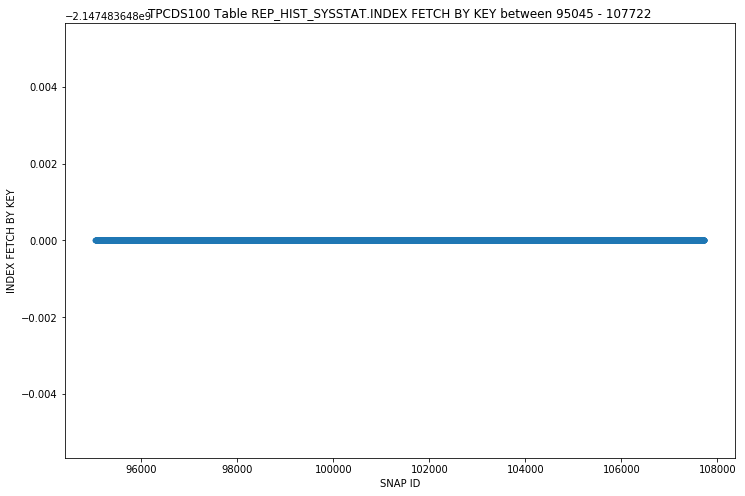

REP_HIST_SYSSTAT - INDEX SCANS KDIIXS1 - OUTLIERS SCATTER


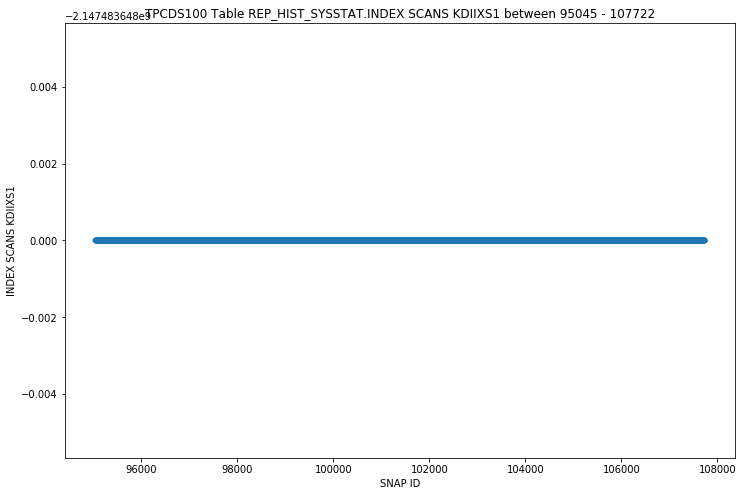

REP_HIST_SYSSTAT - LEAF NODE 90-10 SPLITS - OUTLIERS SCATTER


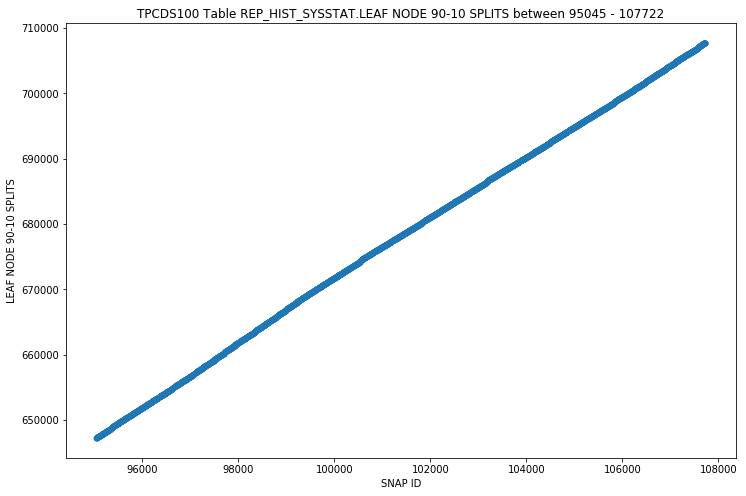

REP_HIST_SYSSTAT - LEAF NODE SPLITS - OUTLIERS SCATTER


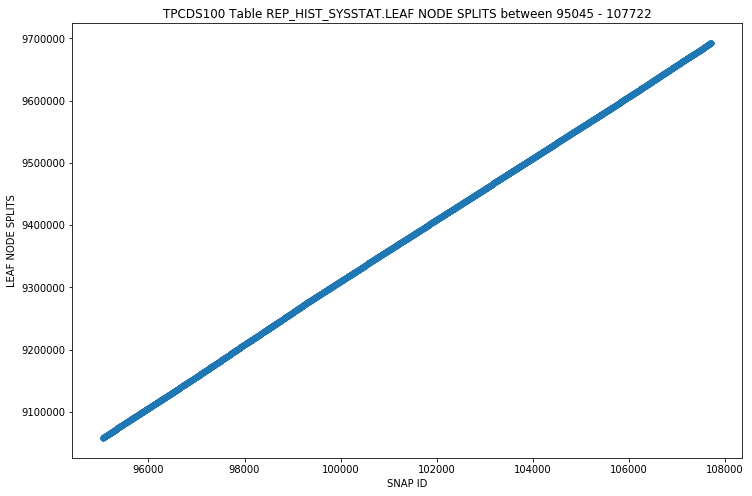

REP_HIST_SYSSTAT - LOB READS - OUTLIERS SCATTER


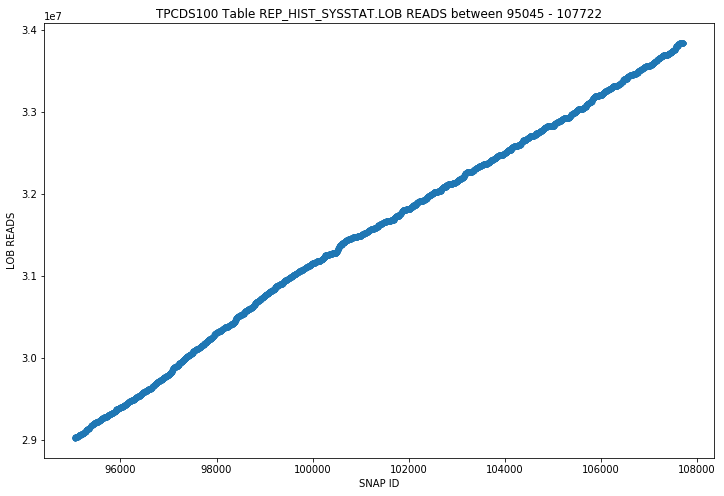

REP_HIST_SYSSTAT - LOB WRITES - OUTLIERS SCATTER


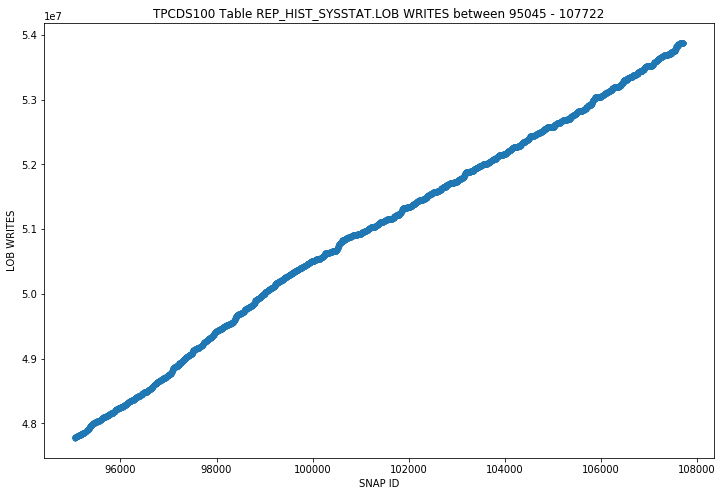

REP_HIST_SYSSTAT - LOB WRITES UNALIGNED - OUTLIERS SCATTER


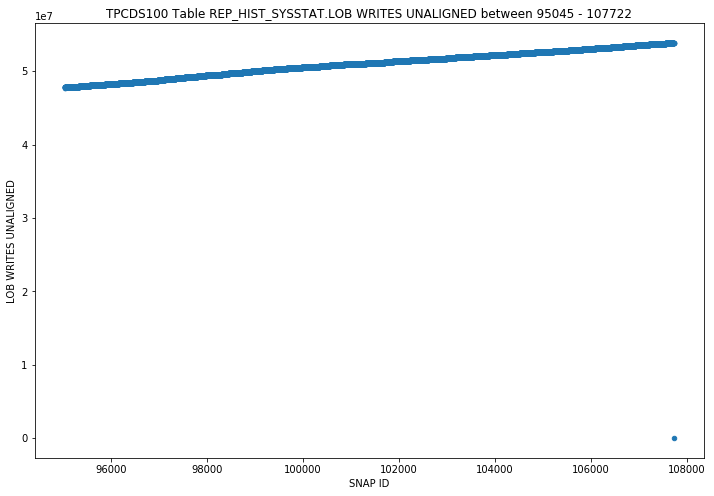

REP_HIST_SYSSTAT - LOGICAL READ BYTES FROM CACHE - OUTLIERS SCATTER


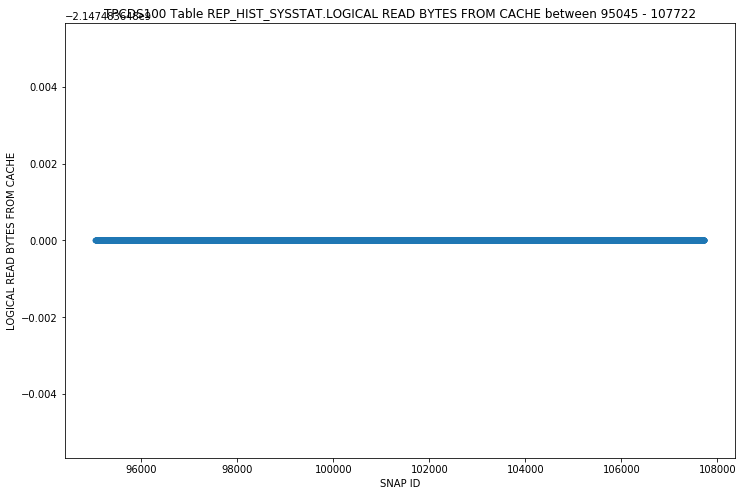

REP_HIST_SYSSTAT - LOGONS CUMULATIVE - OUTLIERS SCATTER


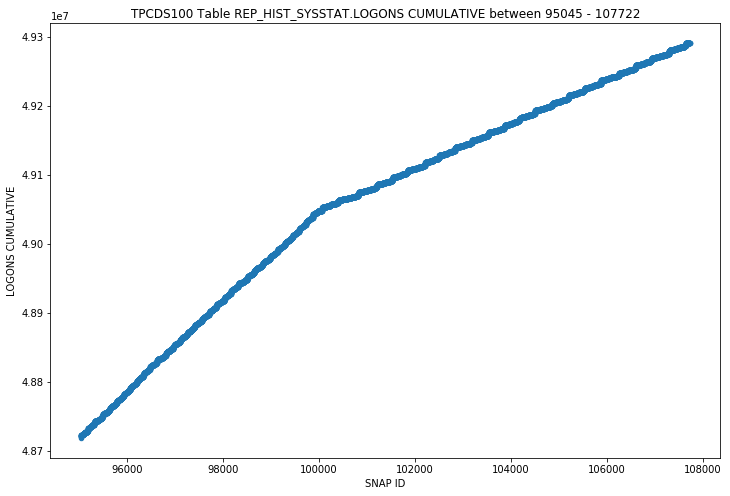

REP_HIST_SYSSTAT - LOGONS CURRENT - OUTLIERS SCATTER


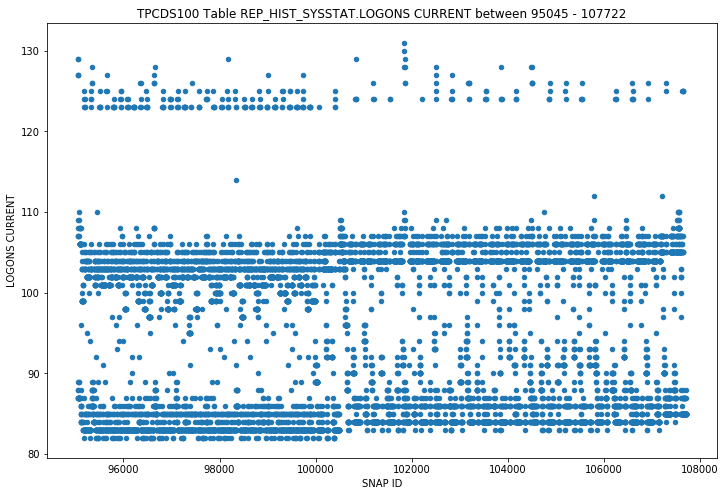

REP_HIST_SYSSTAT - MAX CF ENQ HOLD TIME - OUTLIERS SCATTER


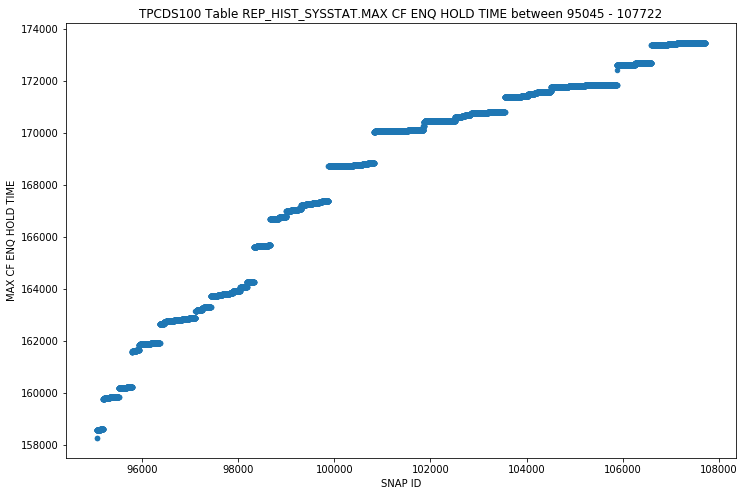

REP_HIST_SYSSTAT - MESSAGES RECEIVED - OUTLIERS SCATTER


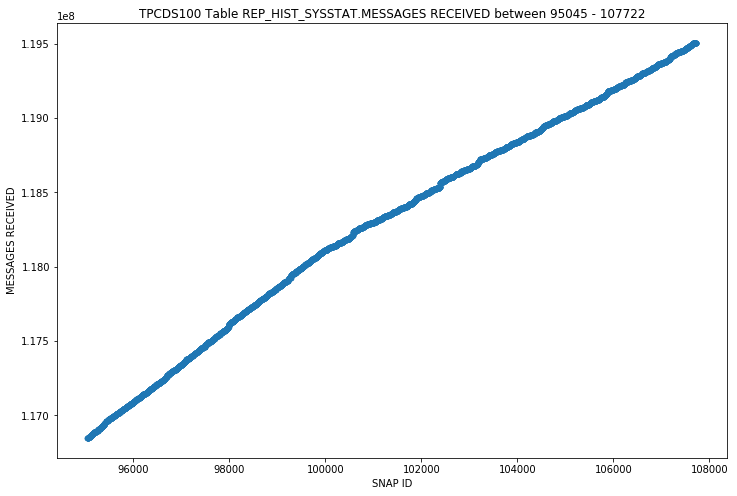

REP_HIST_SYSSTAT - MESSAGES SENT - OUTLIERS SCATTER


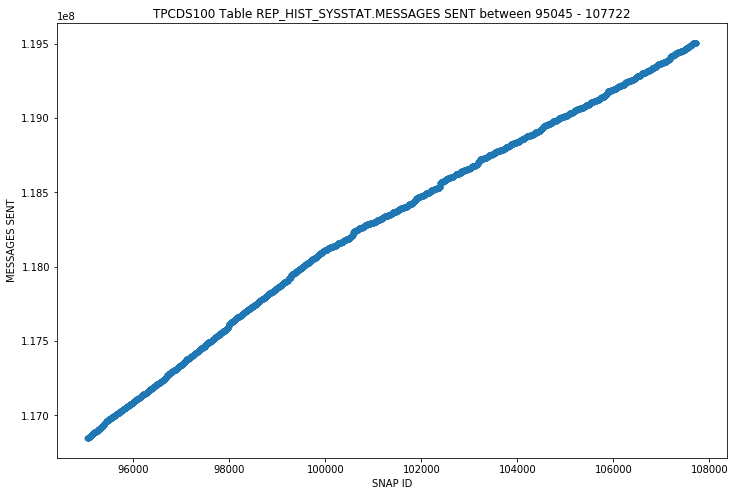

REP_HIST_SYSSTAT - MIN ACTIVE SCN OPTIMIZATION APPLIED ON CR - OUTLIERS SCATTER


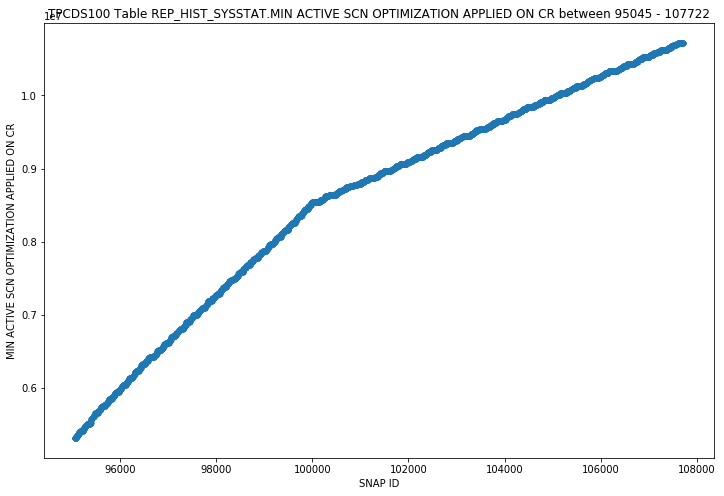

REP_HIST_SYSSTAT - NO BUFFER TO KEEP PINNED COUNT - OUTLIERS SCATTER


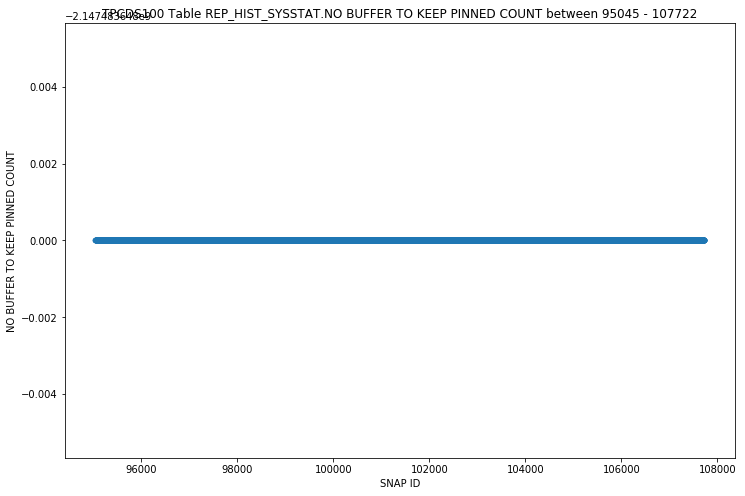

REP_HIST_SYSSTAT - NO WORK - CONSISTENT READ GETS - OUTLIERS SCATTER


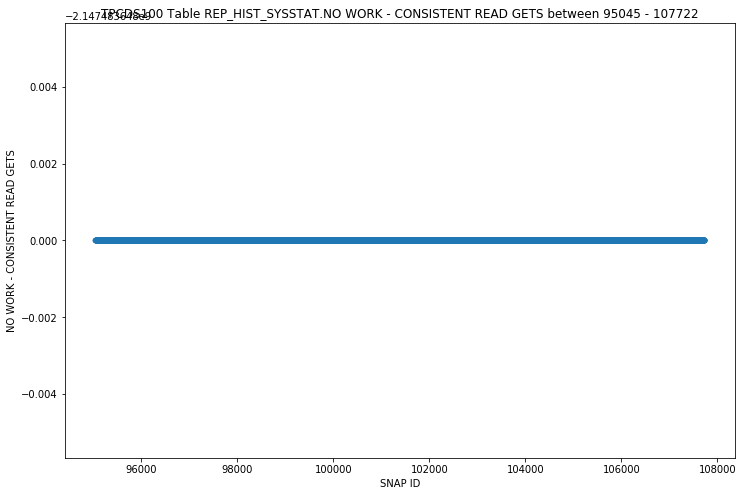

REP_HIST_SYSSTAT - NON-IDLE WAIT COUNT - OUTLIERS SCATTER


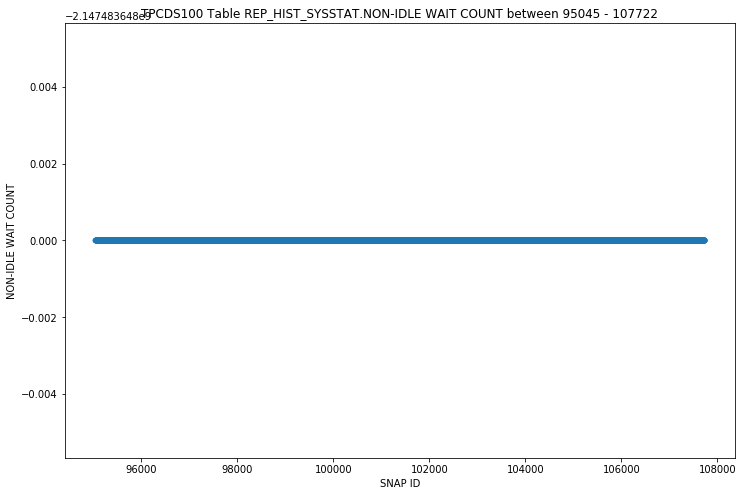

REP_HIST_SYSSTAT - NON-IDLE WAIT TIME - OUTLIERS SCATTER


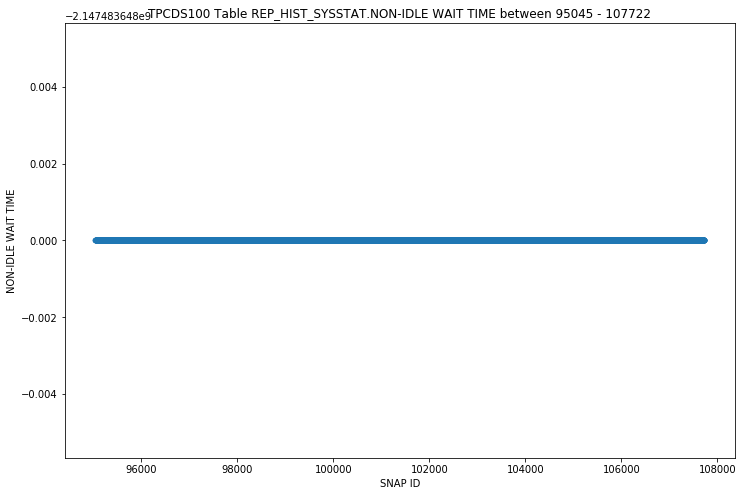

REP_HIST_SYSSTAT - OPENED CURSORS CUMULATIVE - OUTLIERS SCATTER


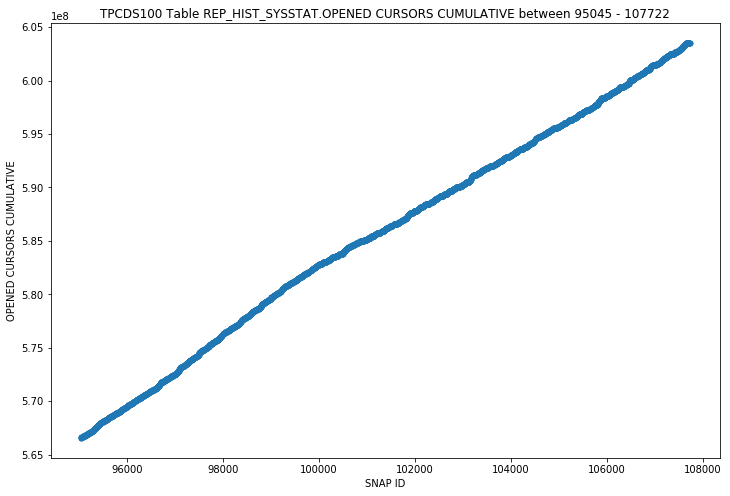

REP_HIST_SYSSTAT - OPENED CURSORS CURRENT - OUTLIERS SCATTER


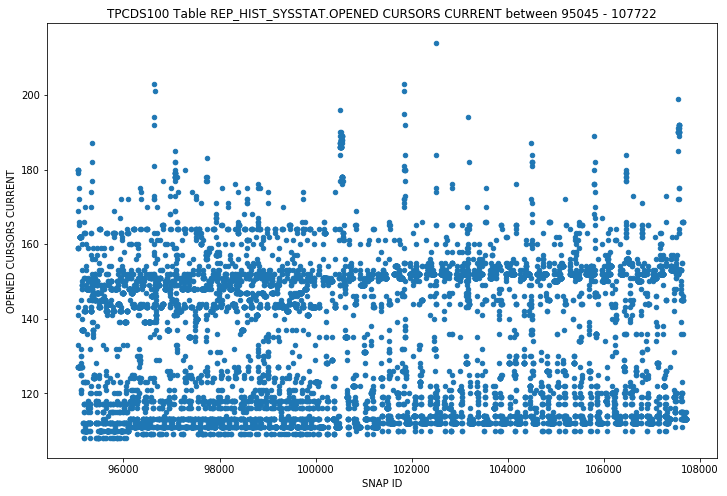

REP_HIST_SYSSTAT - PARSE COUNT (DESCRIBE) - OUTLIERS SCATTER


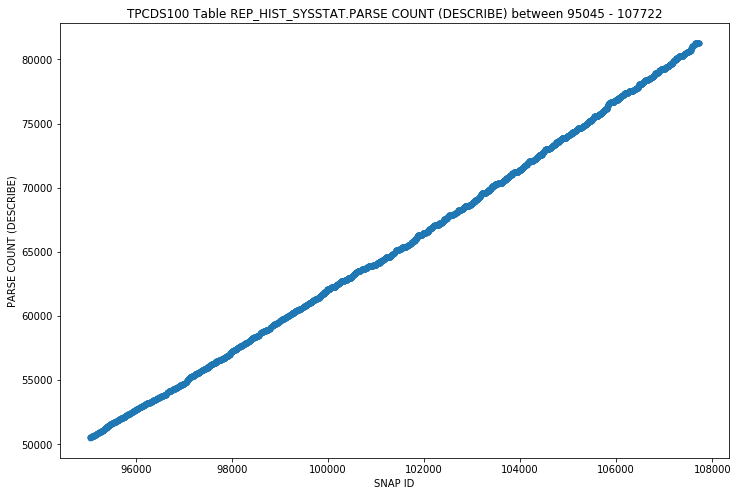

REP_HIST_SYSSTAT - PARSE COUNT (FAILURES) - OUTLIERS SCATTER


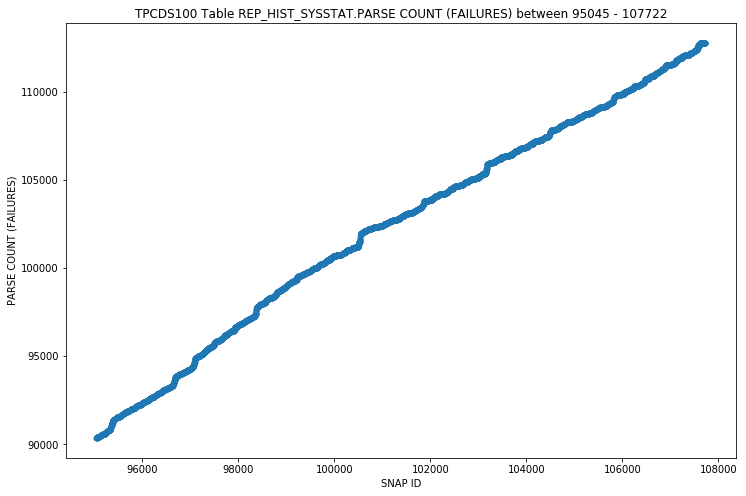

REP_HIST_SYSSTAT - PARSE COUNT (HARD) - OUTLIERS SCATTER


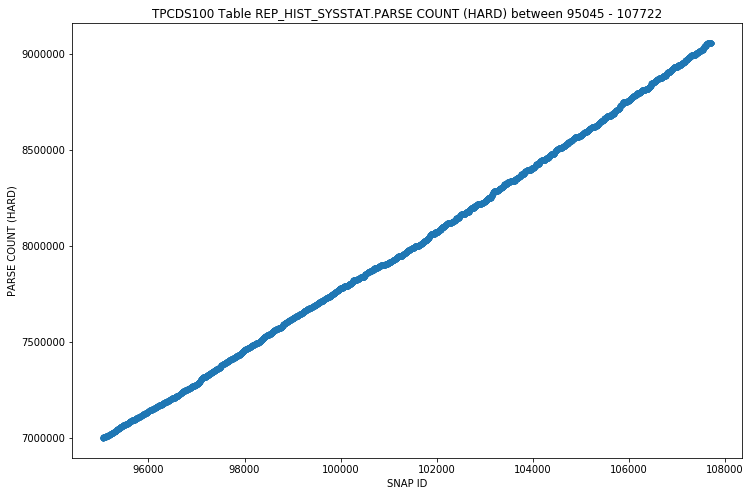

REP_HIST_SYSSTAT - PARSE COUNT (TOTAL) - OUTLIERS SCATTER


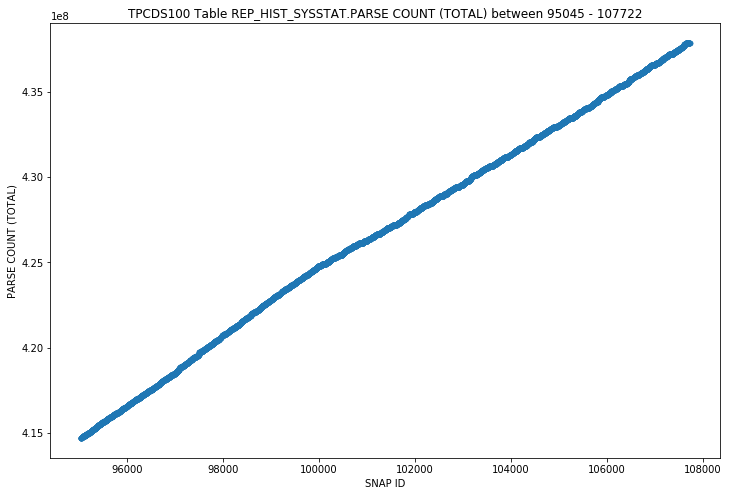

REP_HIST_SYSSTAT - PARSE TIME CPU - OUTLIERS SCATTER


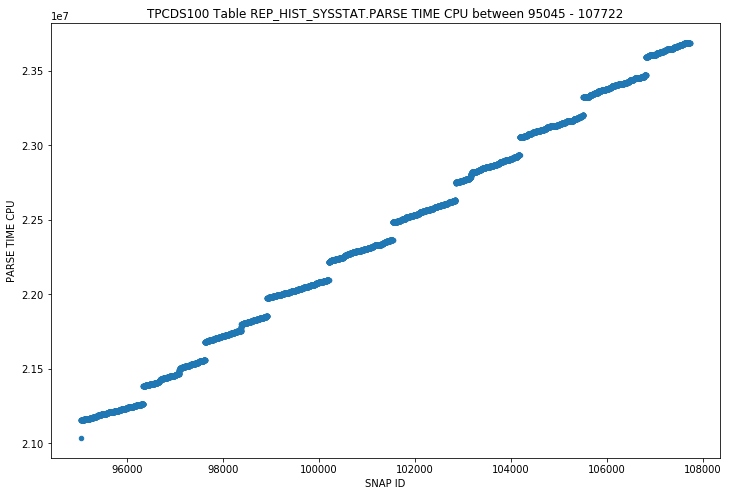

REP_HIST_SYSSTAT - PARSE TIME ELAPSED - OUTLIERS SCATTER


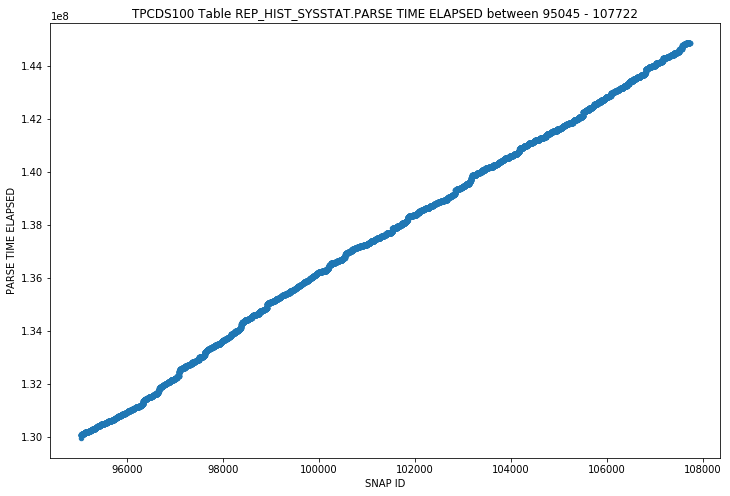

REP_HIST_SYSSTAT - PHYSICAL READ IO REQUESTS - OUTLIERS SCATTER


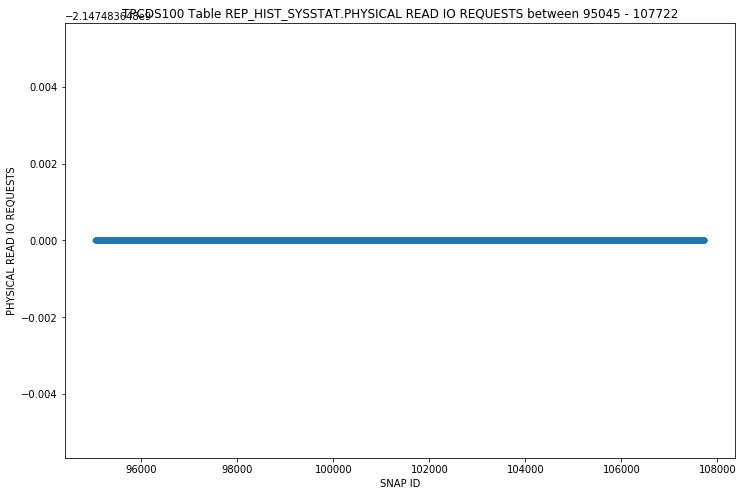

REP_HIST_SYSSTAT - PHYSICAL READ BYTES - OUTLIERS SCATTER


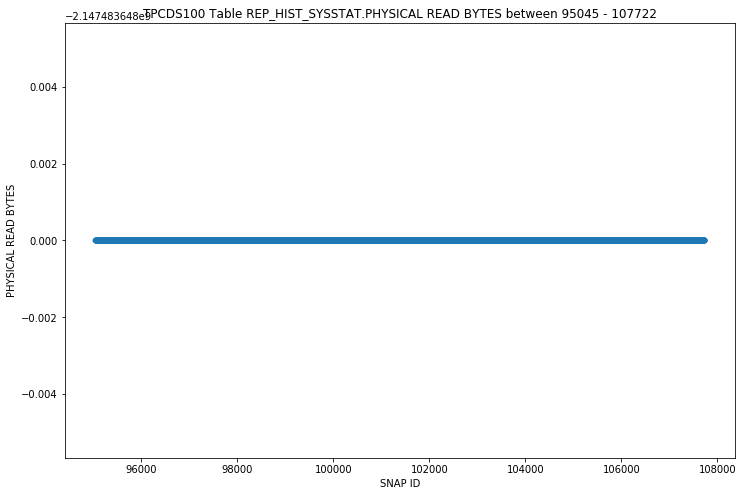

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL IO REQUESTS - OUTLIERS SCATTER


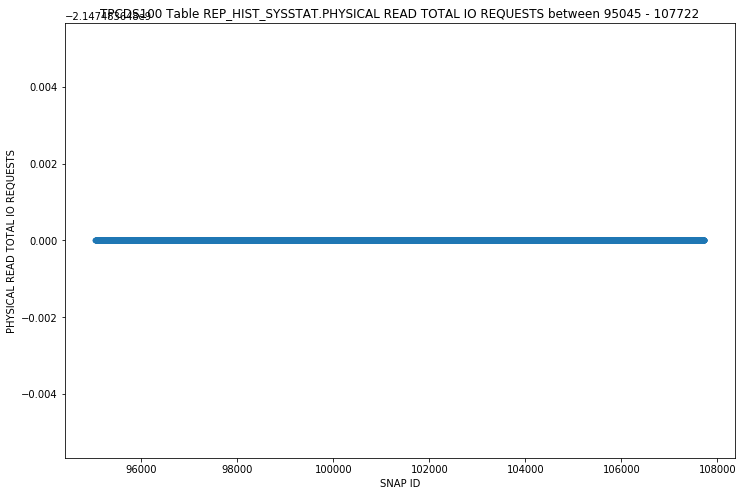

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL BYTES - OUTLIERS SCATTER


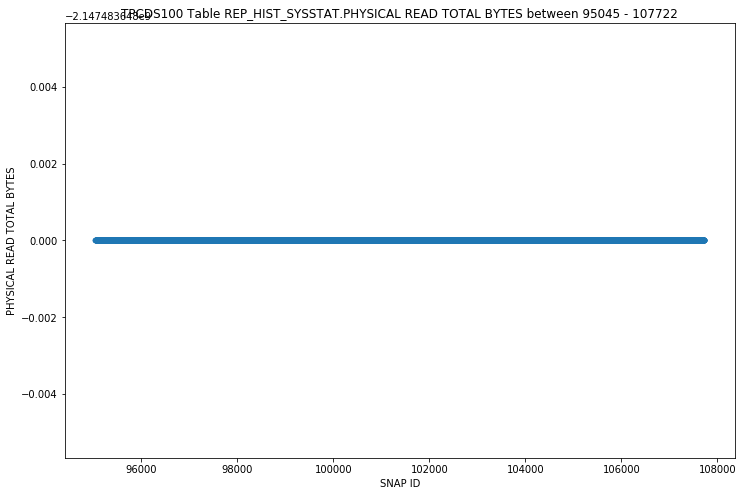

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL MULTI BLOCK REQUESTS - OUTLIERS SCATTER


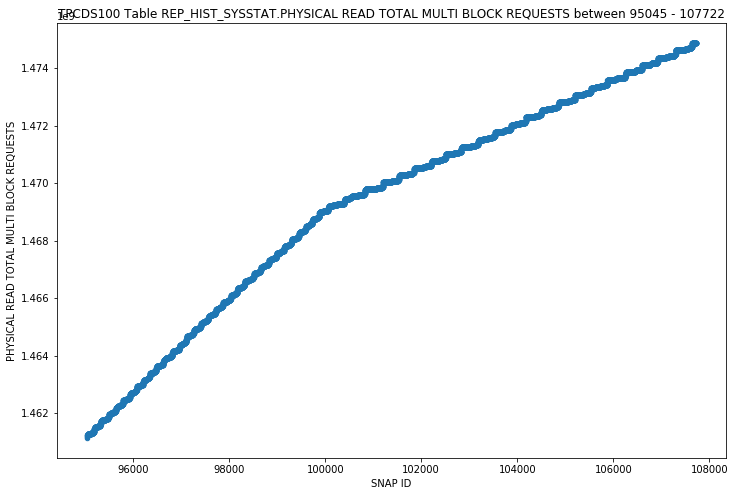

REP_HIST_SYSSTAT - PHYSICAL READS - OUTLIERS SCATTER


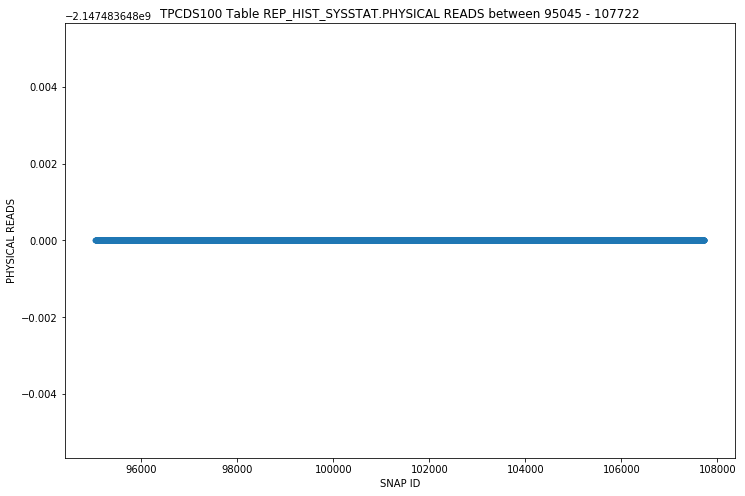

REP_HIST_SYSSTAT - PHYSICAL READS CACHE - OUTLIERS SCATTER


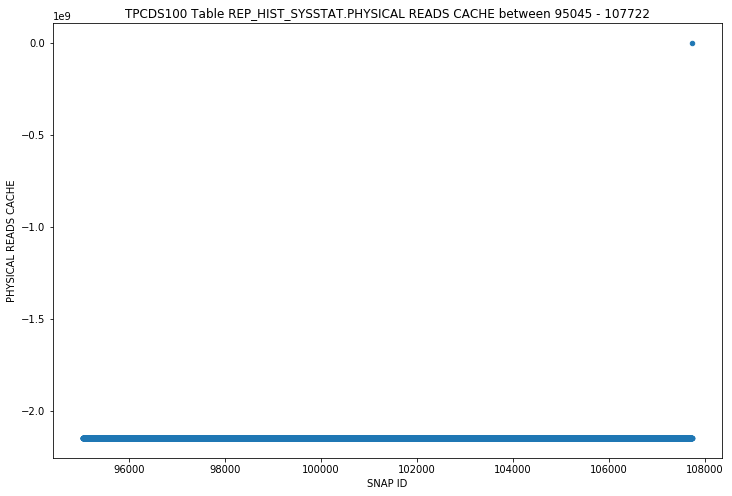

REP_HIST_SYSSTAT - PHYSICAL READS CACHE PREFETCH - OUTLIERS SCATTER


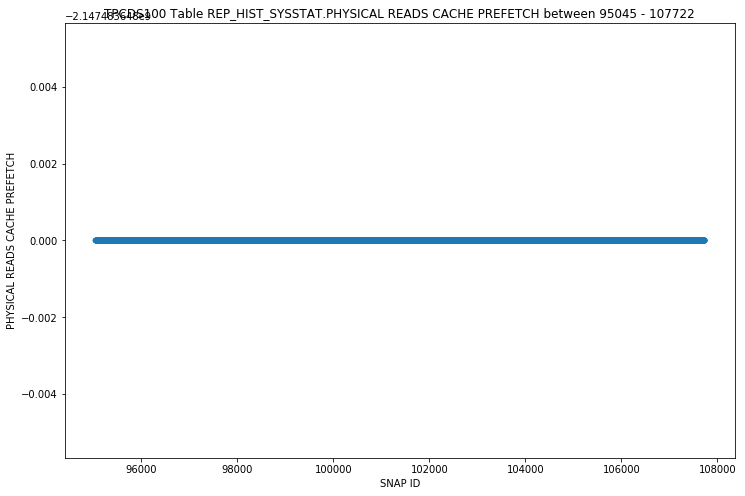

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT - OUTLIERS SCATTER


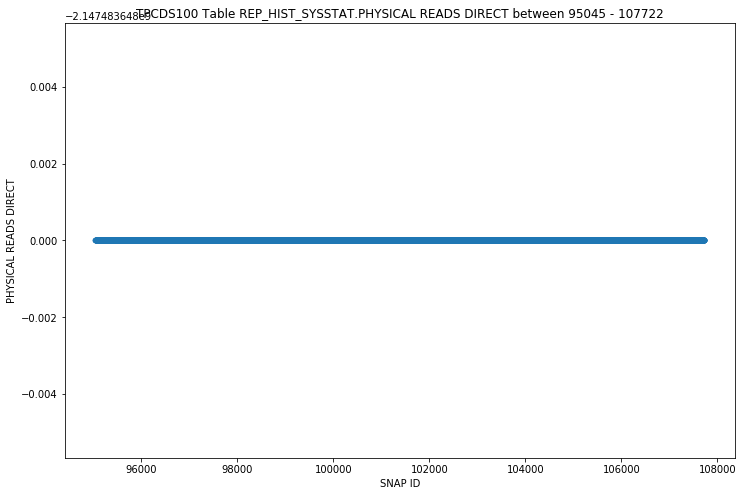

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT (LOB) - OUTLIERS SCATTER


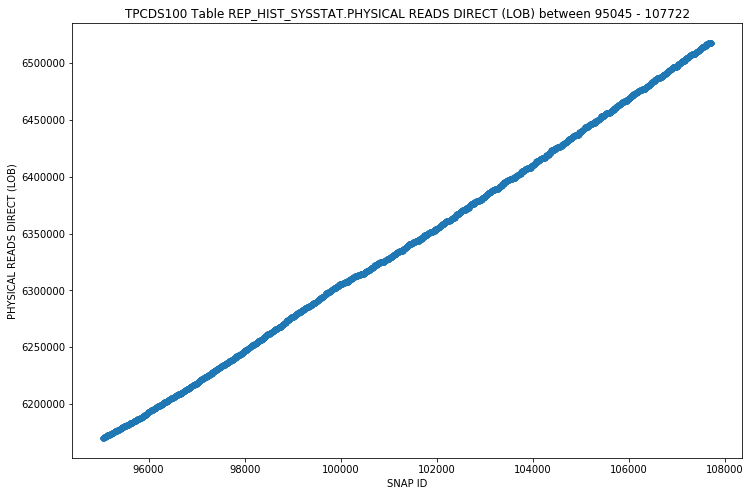

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT TEMPORARY TABLESPACE - OUTLIERS SCATTER


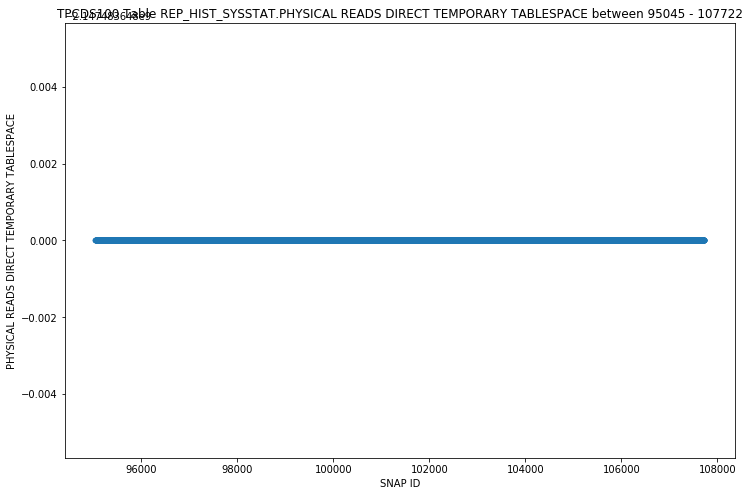

REP_HIST_SYSSTAT - PHYSICAL WRITE IO REQUESTS - OUTLIERS SCATTER


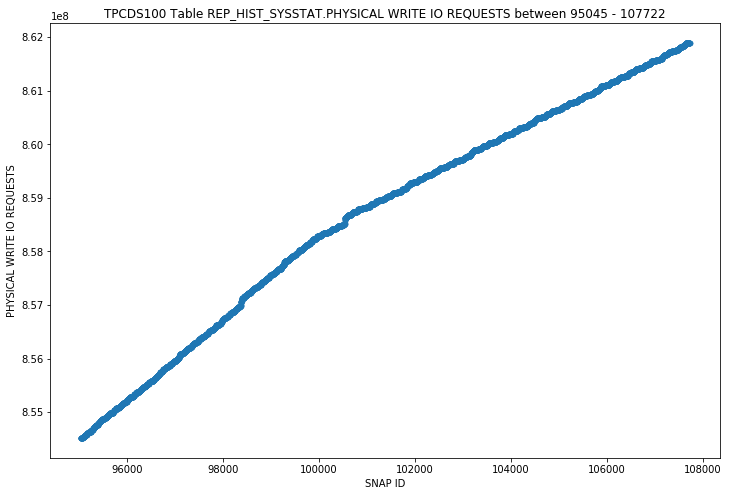

REP_HIST_SYSSTAT - PHYSICAL WRITE BYTES - OUTLIERS SCATTER


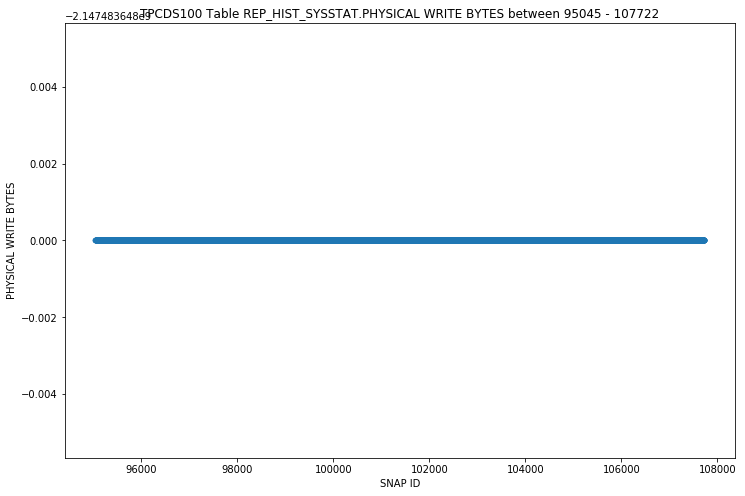

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL IO REQUESTS - OUTLIERS SCATTER


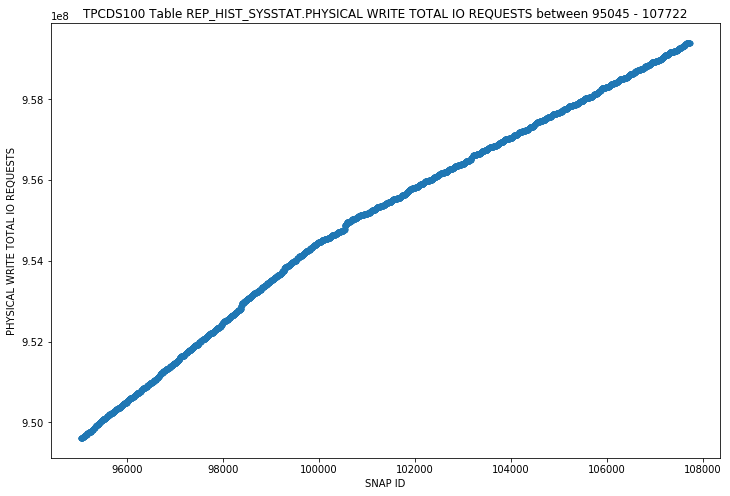

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL BYTES - OUTLIERS SCATTER


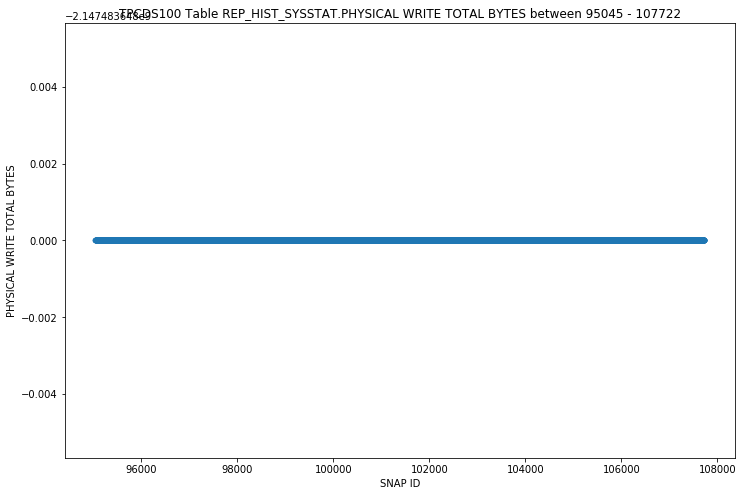

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL MULTI BLOCK REQUESTS - OUTLIERS SCATTER


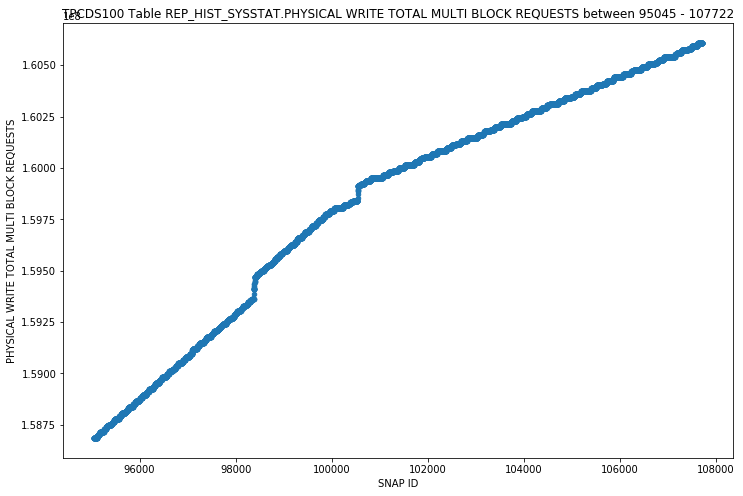

REP_HIST_SYSSTAT - PHYSICAL WRITES - OUTLIERS SCATTER


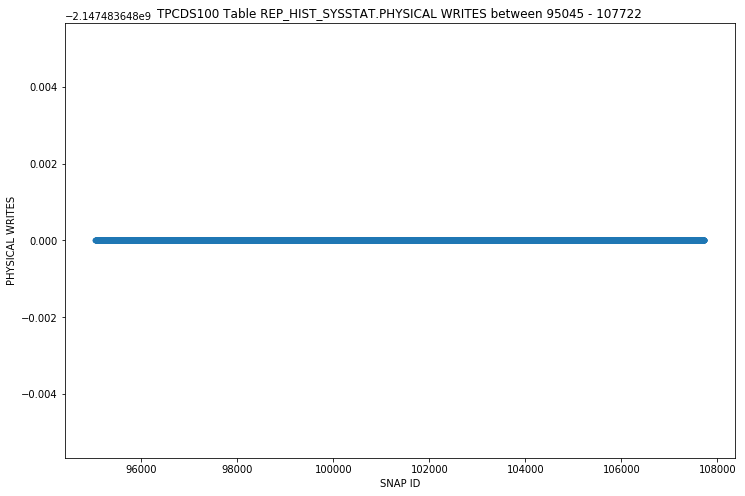

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT - OUTLIERS SCATTER


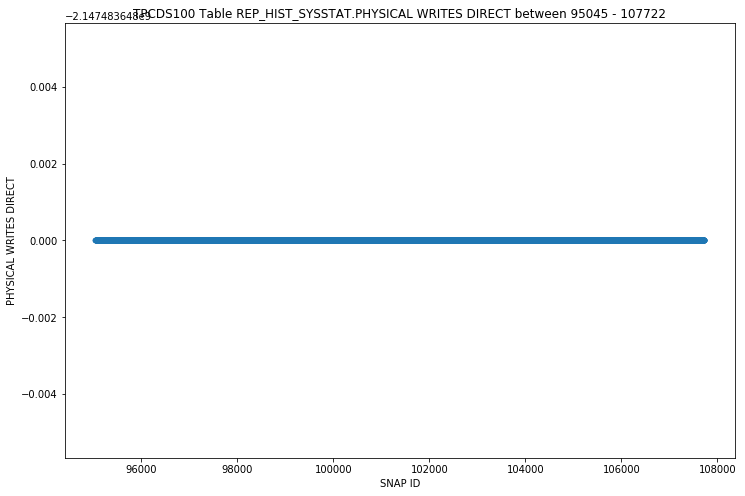

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT (LOB) - OUTLIERS SCATTER


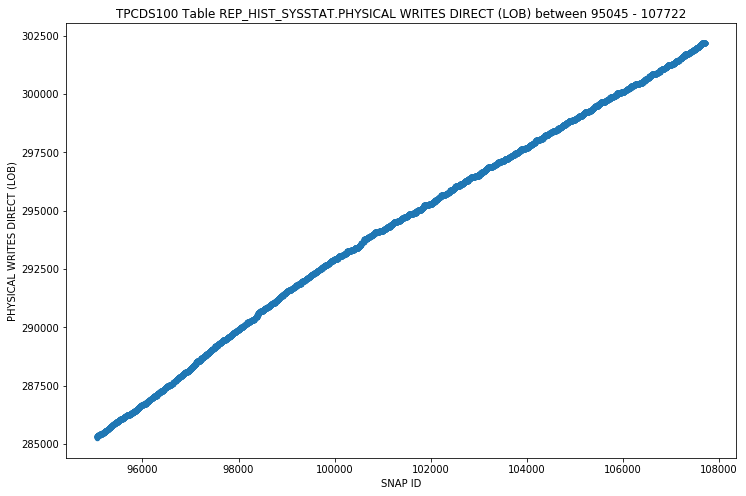

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT TEMPORARY TABLESPACE - OUTLIERS SCATTER


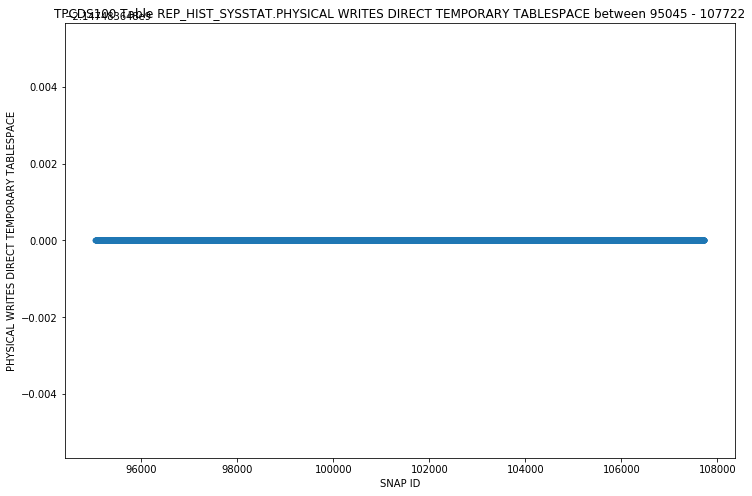

REP_HIST_SYSSTAT - PHYSICAL WRITES FROM CACHE - OUTLIERS SCATTER


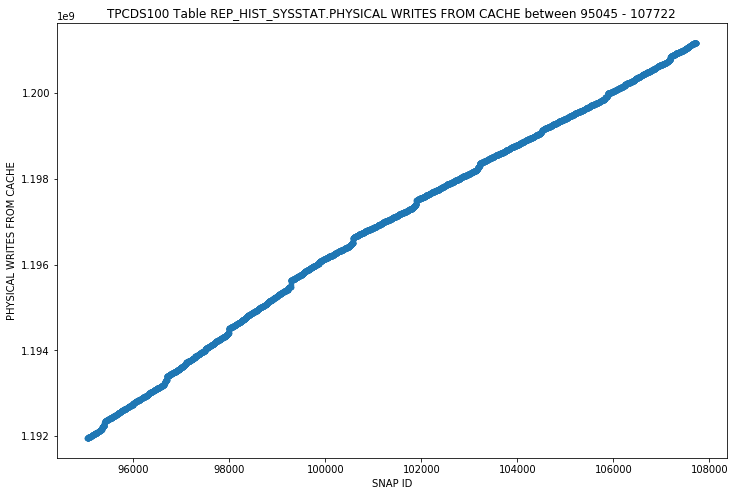

REP_HIST_SYSSTAT - PHYSICAL WRITES NON CHECKPOINT - OUTLIERS SCATTER


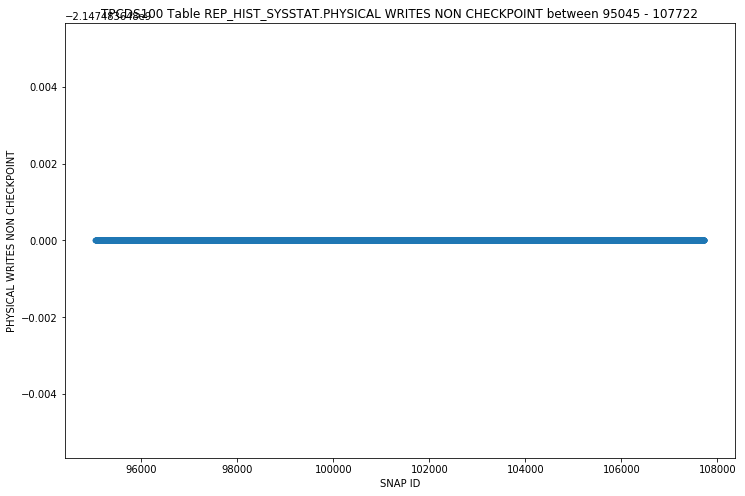

REP_HIST_SYSSTAT - PINNED BUFFERS INSPECTED - OUTLIERS SCATTER


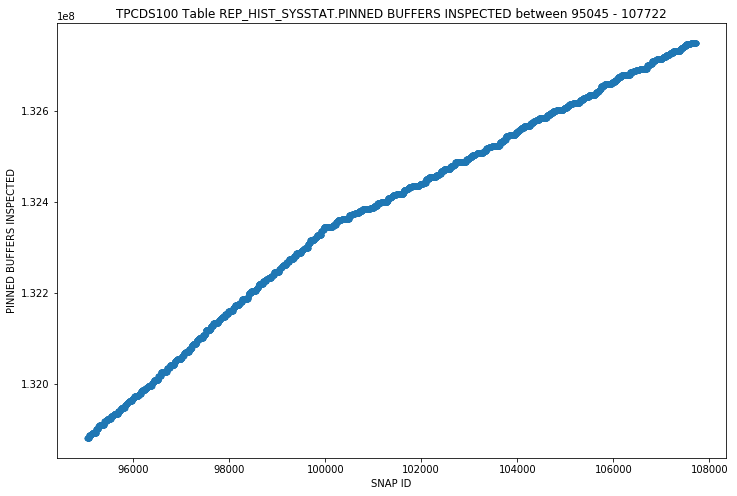

REP_HIST_SYSSTAT - PINNED CURSORS CURRENT - OUTLIERS SCATTER


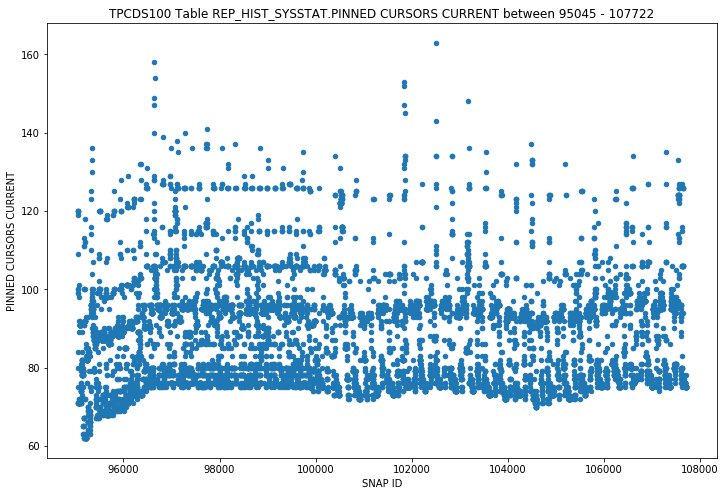

REP_HIST_SYSSTAT - PREFETCH CLIENTS - DEFAULT - OUTLIERS SCATTER


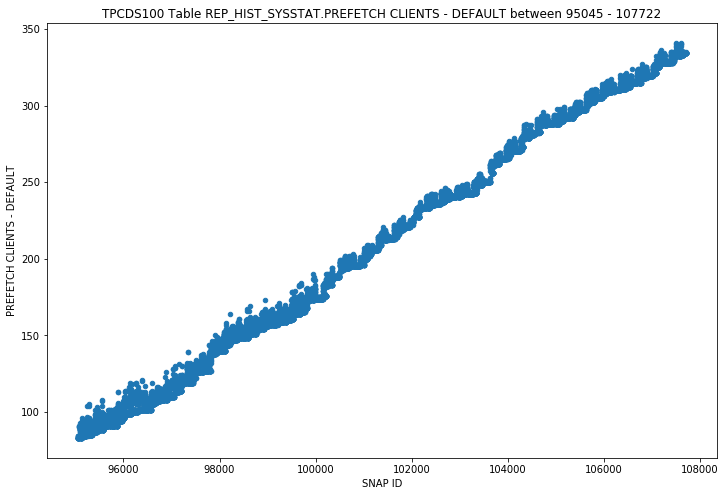

REP_HIST_SYSSTAT - PREFETCHED BLOCKS AGED OUT BEFORE USE - OUTLIERS SCATTER


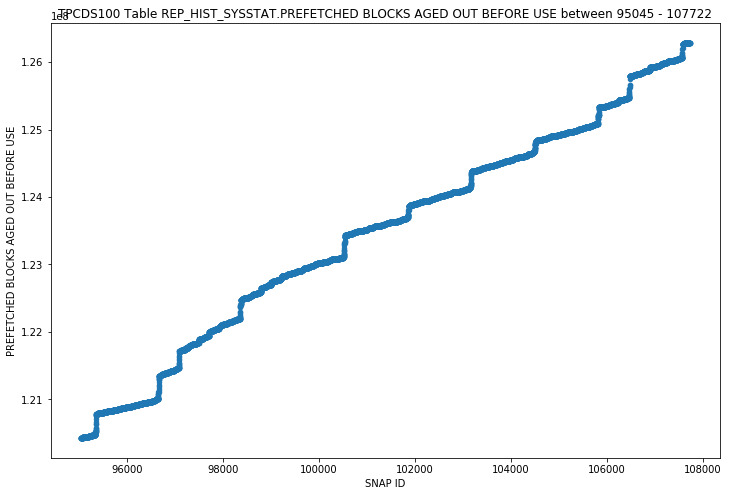

REP_HIST_SYSSTAT - PROCESS LAST NON-IDLE TIME - OUTLIERS SCATTER


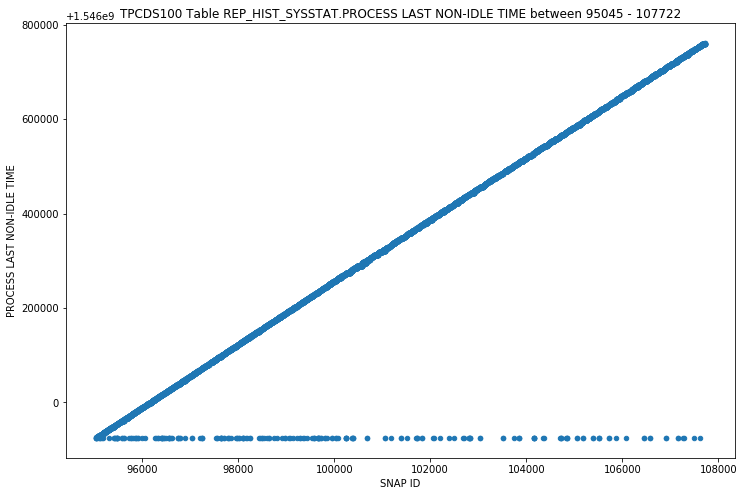

REP_HIST_SYSSTAT - QUERIES PARALLELIZED - OUTLIERS SCATTER


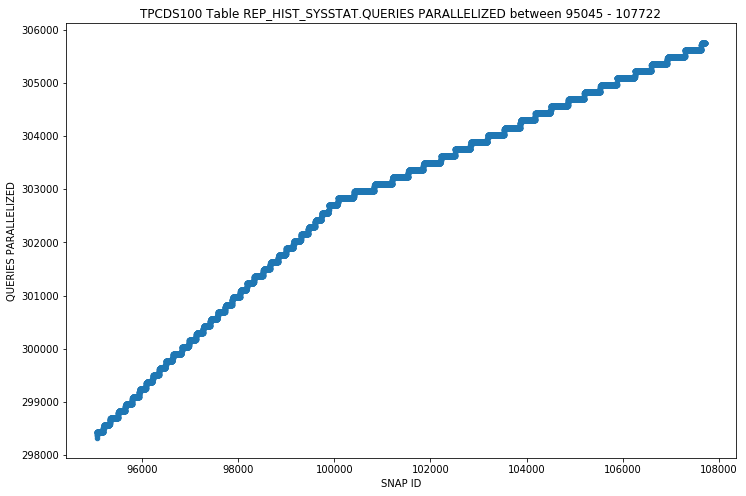

REP_HIST_SYSSTAT - RECURSIVE CALLS - OUTLIERS SCATTER


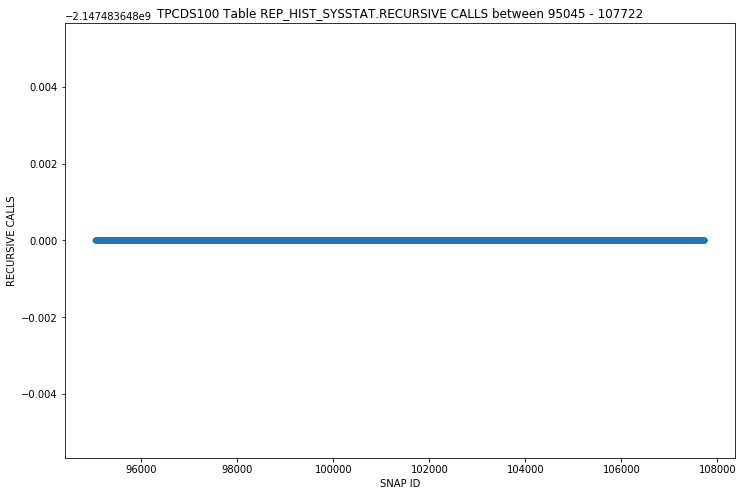

REP_HIST_SYSSTAT - RECURSIVE CPU USAGE - OUTLIERS SCATTER


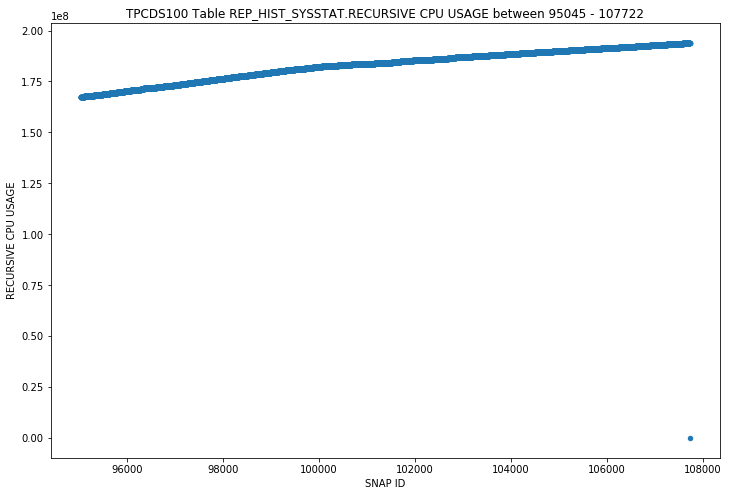

REP_HIST_SYSSTAT - REDO BLOCKS CHECKSUMMED BY FG (EXCLUSIVE) - OUTLIERS SCATTER


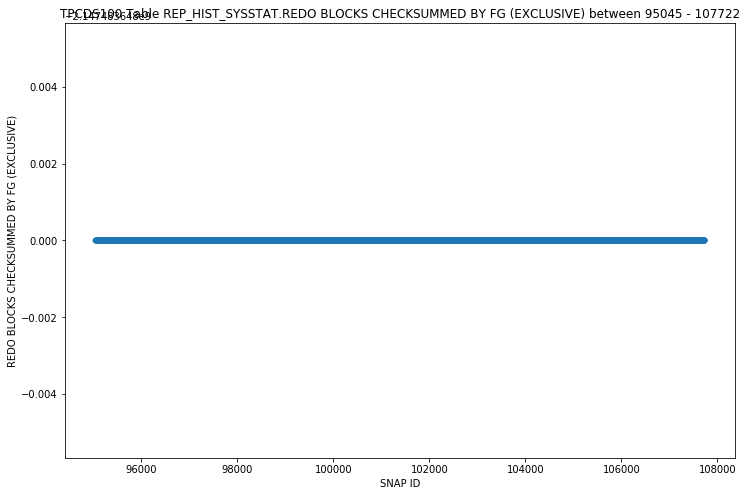

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN - OUTLIERS SCATTER


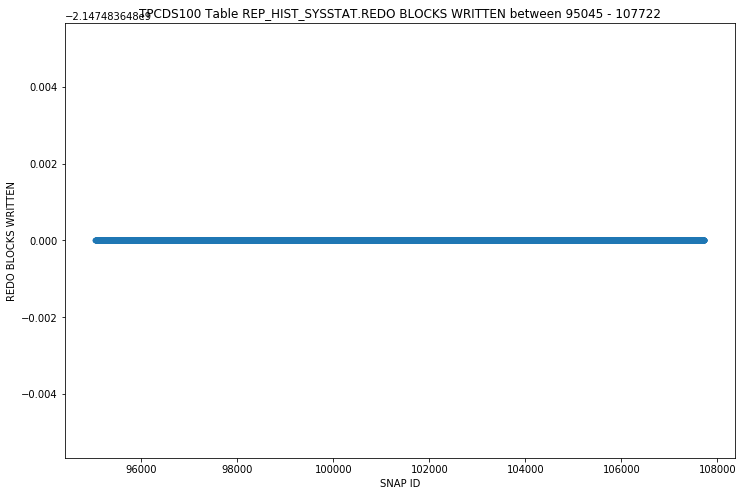

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN (GROUP 0) - OUTLIERS SCATTER


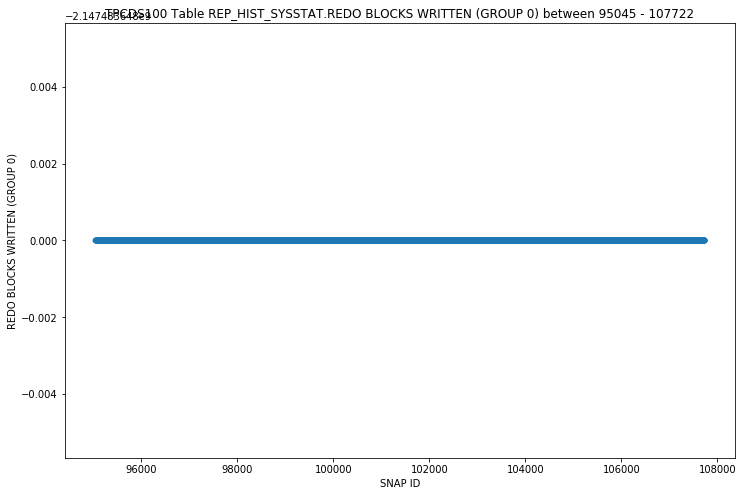

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN (GROUP 1) - OUTLIERS SCATTER


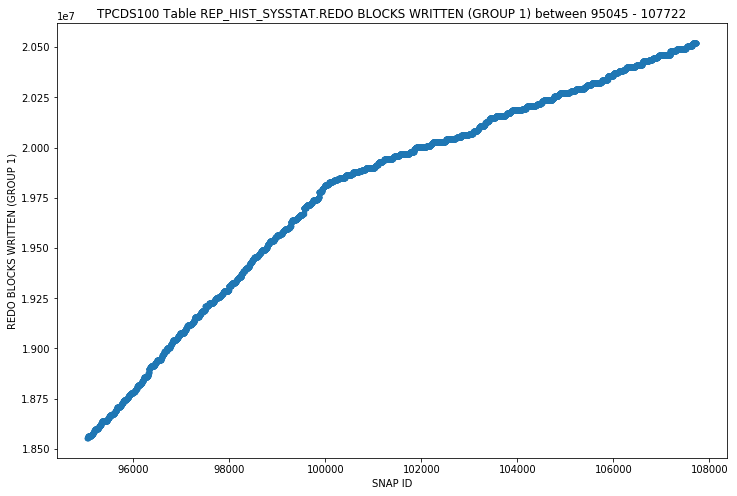

REP_HIST_SYSSTAT - REDO BUFFER ALLOCATION RETRIES - OUTLIERS SCATTER


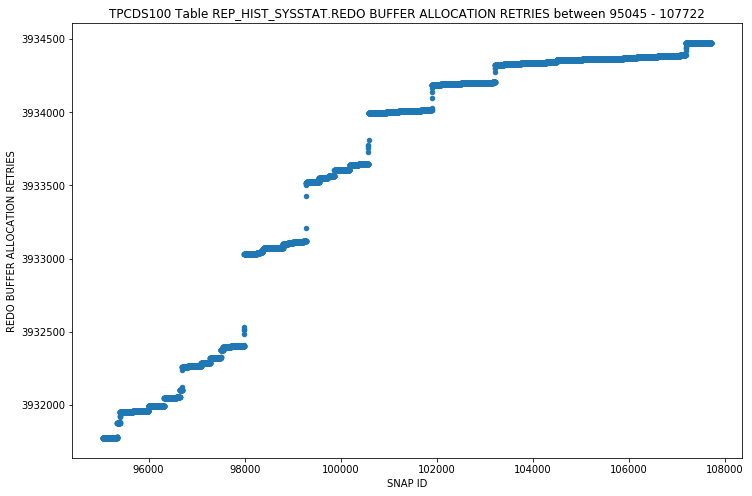

REP_HIST_SYSSTAT - REDO ENTRIES - OUTLIERS SCATTER


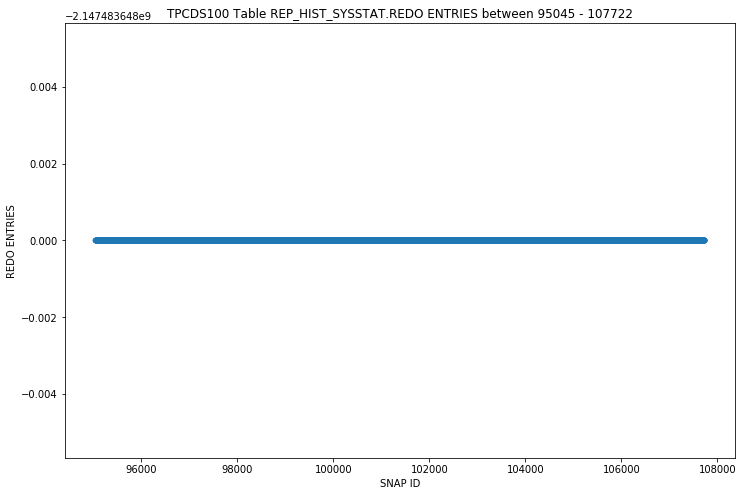

REP_HIST_SYSSTAT - REDO LOG SPACE REQUESTS - OUTLIERS SCATTER


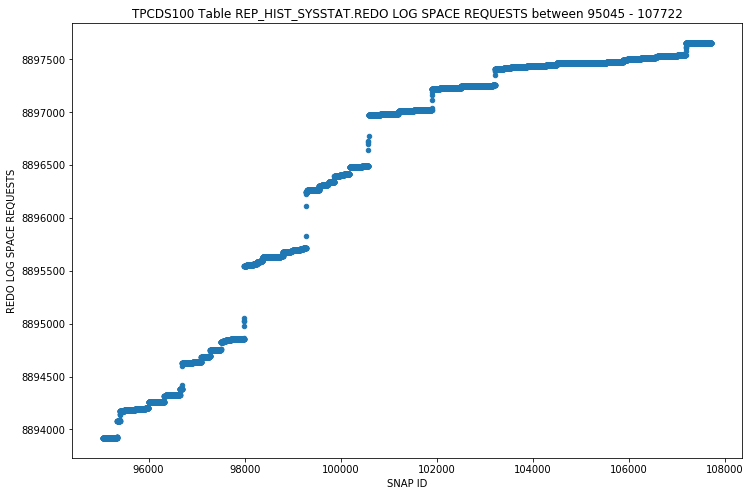

REP_HIST_SYSSTAT - REDO LOG SPACE WAIT TIME - OUTLIERS SCATTER


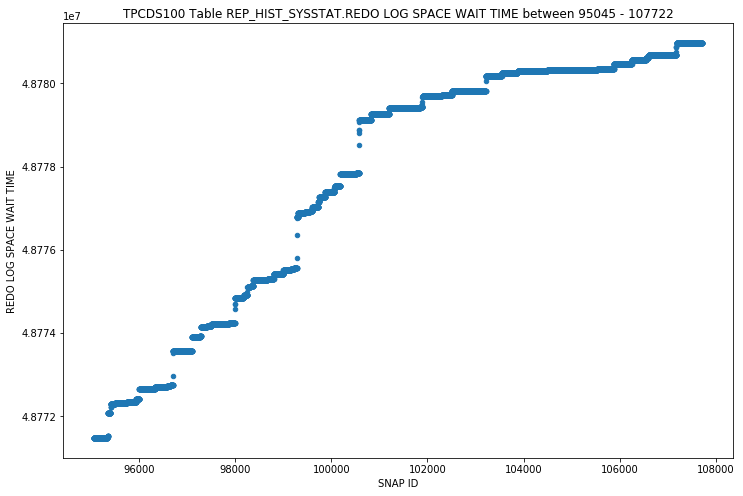

REP_HIST_SYSSTAT - REDO ORDERING MARKS - OUTLIERS SCATTER


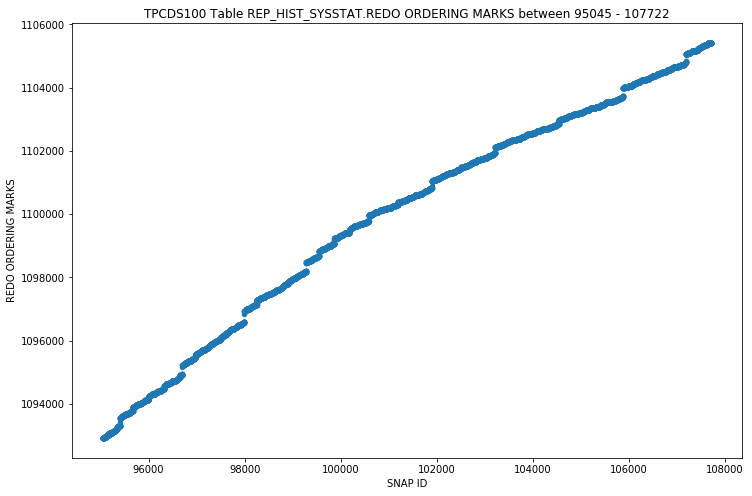

REP_HIST_SYSSTAT - REDO SIZE - OUTLIERS SCATTER


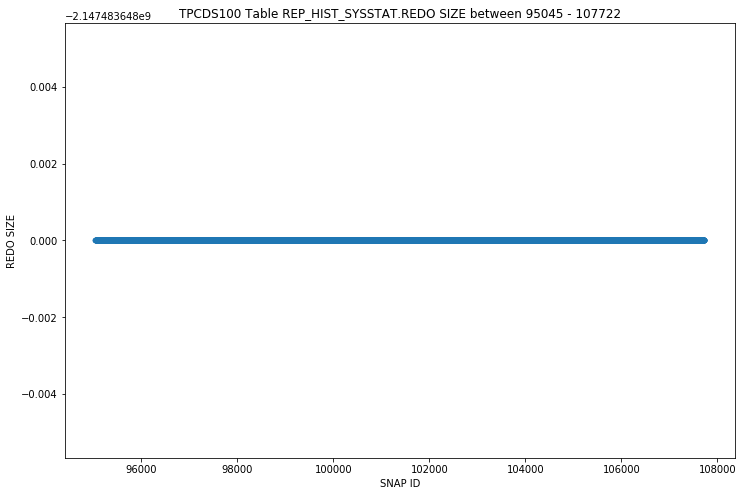

REP_HIST_SYSSTAT - REDO SIZE FOR DIRECT WRITES - OUTLIERS SCATTER


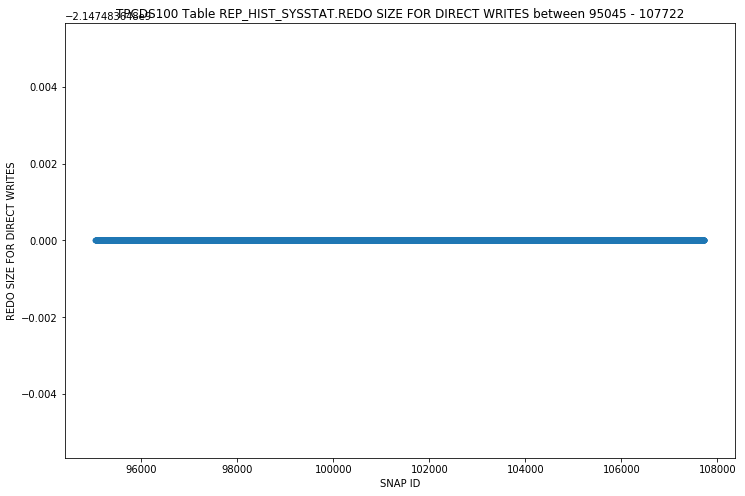

REP_HIST_SYSSTAT - REDO SUBSCN MAX COUNTS - OUTLIERS SCATTER


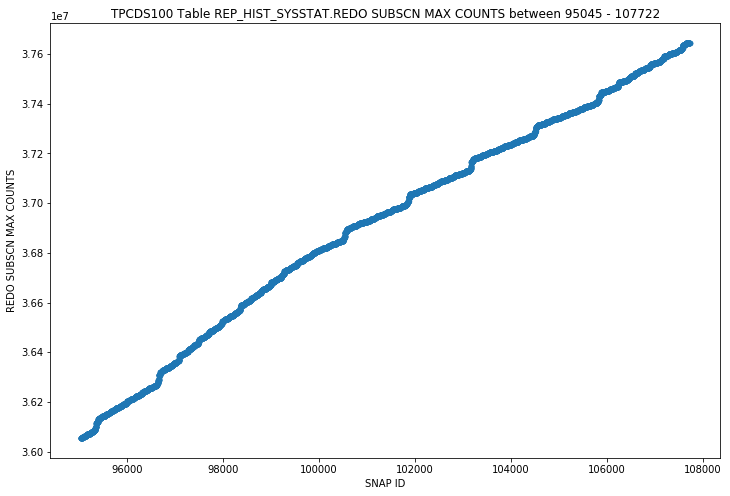

REP_HIST_SYSSTAT - REDO SYNCH LONG WAITS - OUTLIERS SCATTER


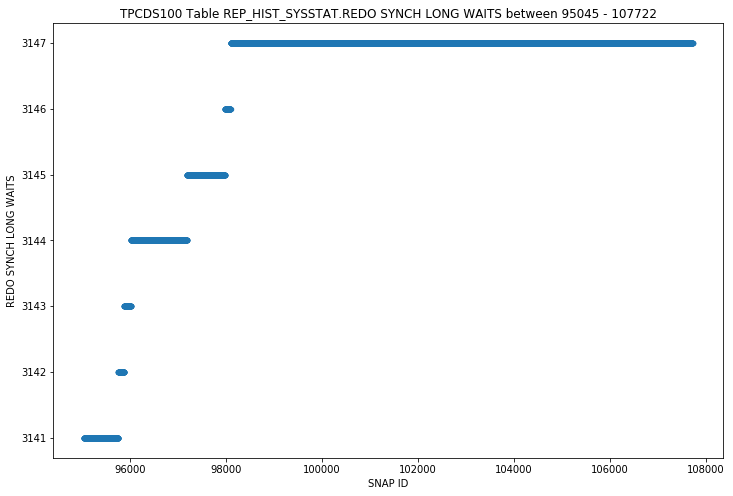

REP_HIST_SYSSTAT - REDO SYNCH TIME - OUTLIERS SCATTER


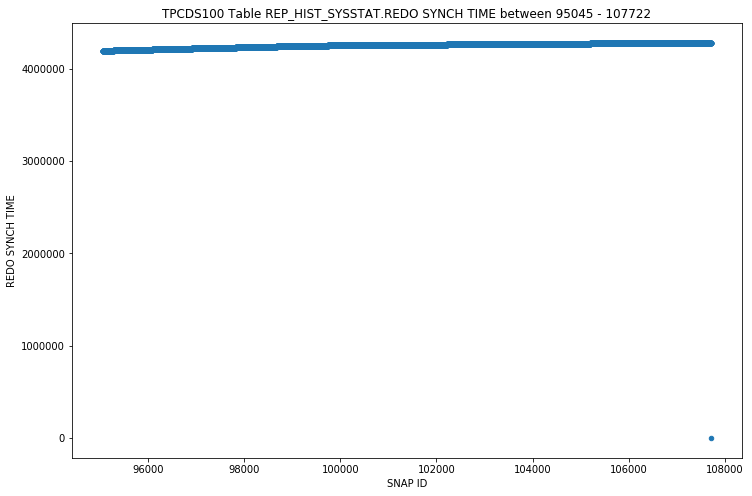

REP_HIST_SYSSTAT - REDO SYNCH TIME (USEC) - OUTLIERS SCATTER


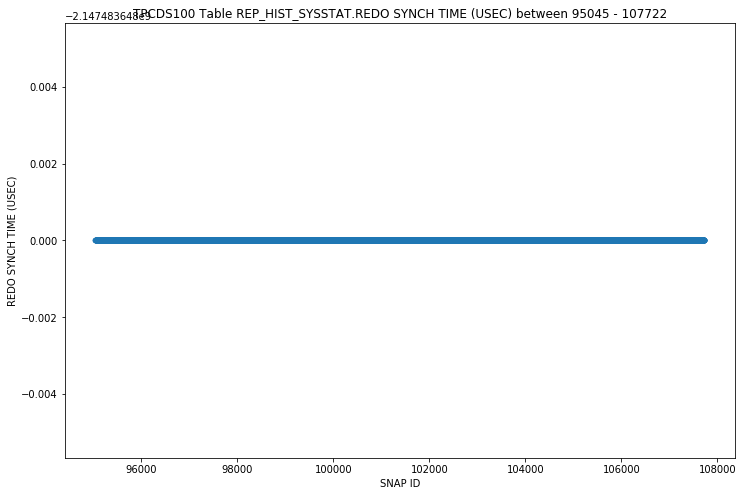

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD (USEC) - OUTLIERS SCATTER


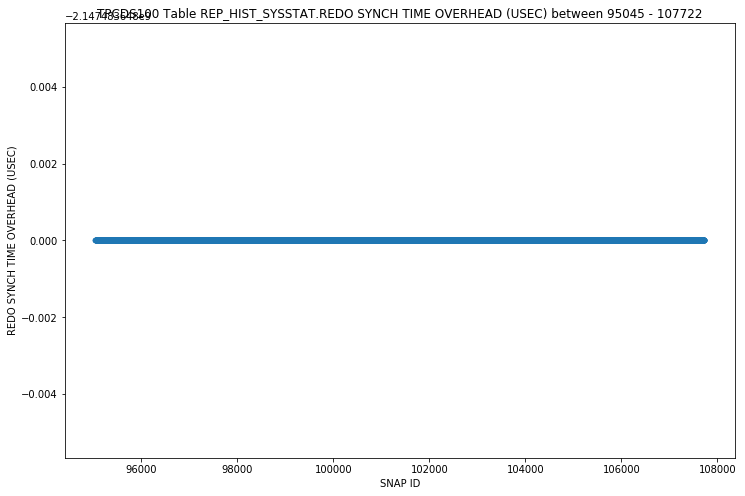

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (  2MS) - OUTLIERS SCATTER


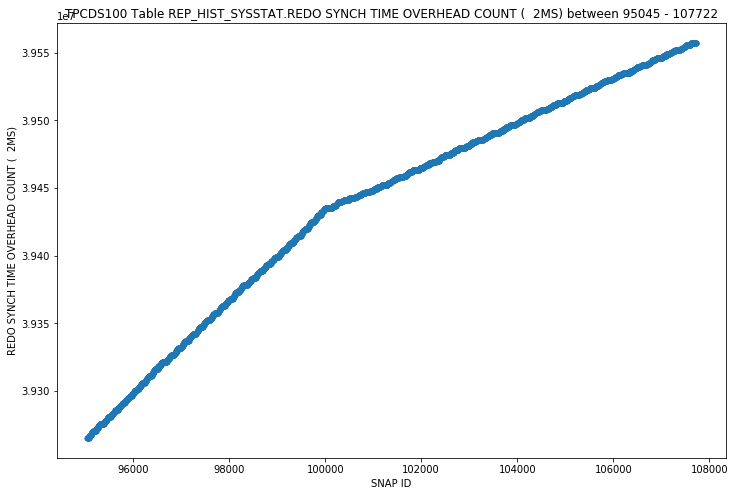

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (  8MS) - OUTLIERS SCATTER


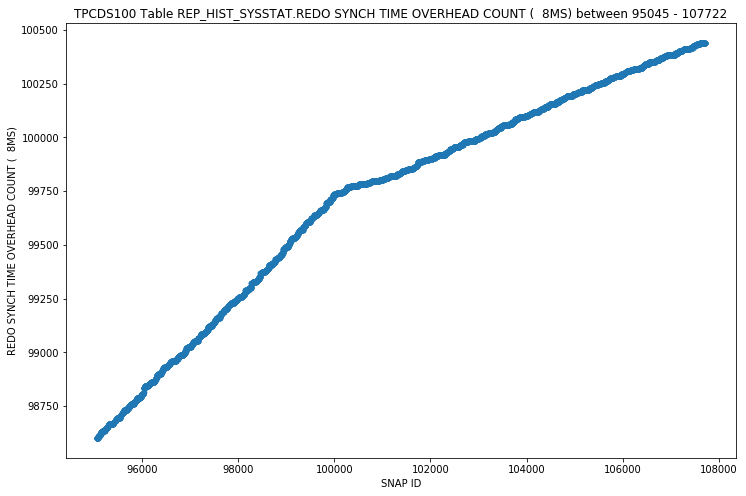

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT ( 32MS) - OUTLIERS SCATTER


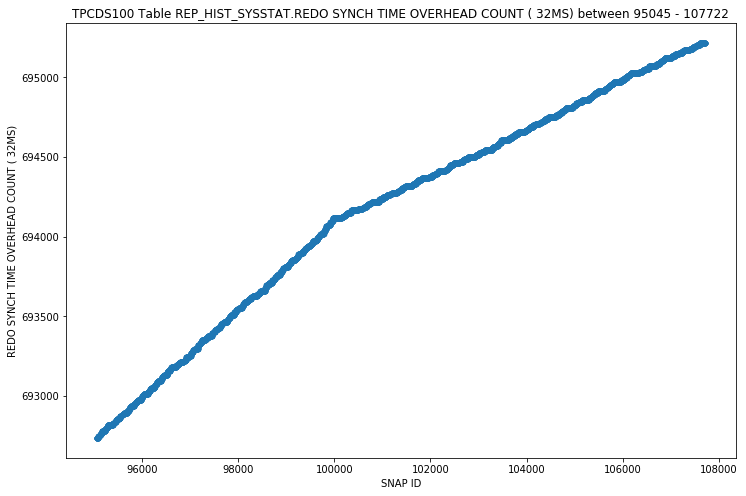

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (128MS) - OUTLIERS SCATTER


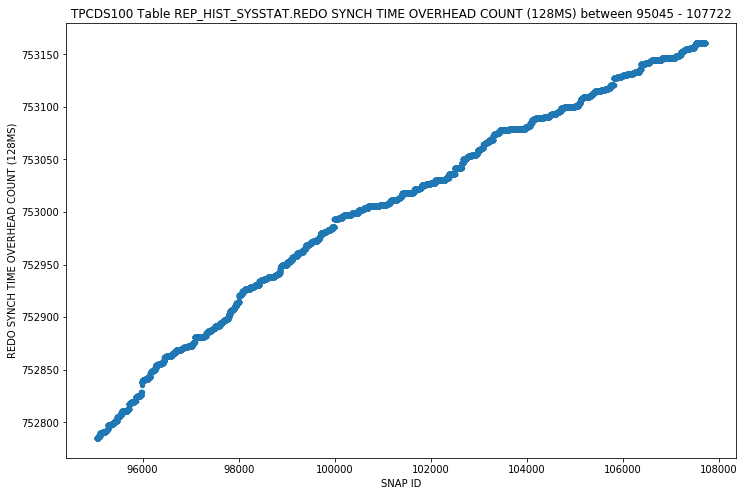

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (INF) - OUTLIERS SCATTER


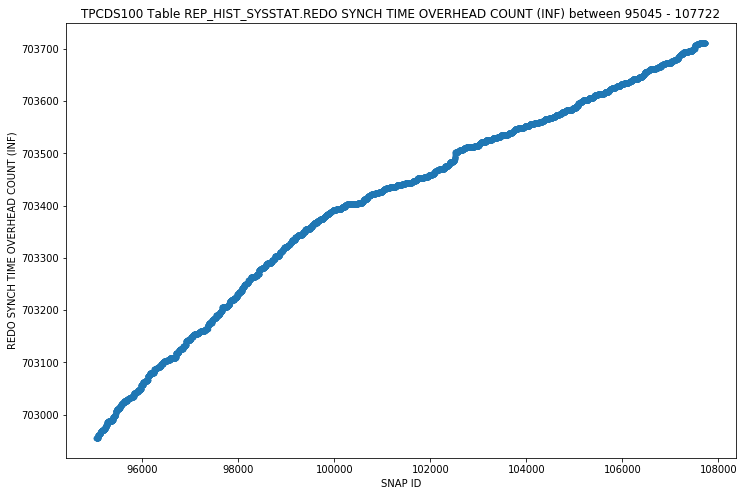

REP_HIST_SYSSTAT - REDO SYNCH WRITES - OUTLIERS SCATTER


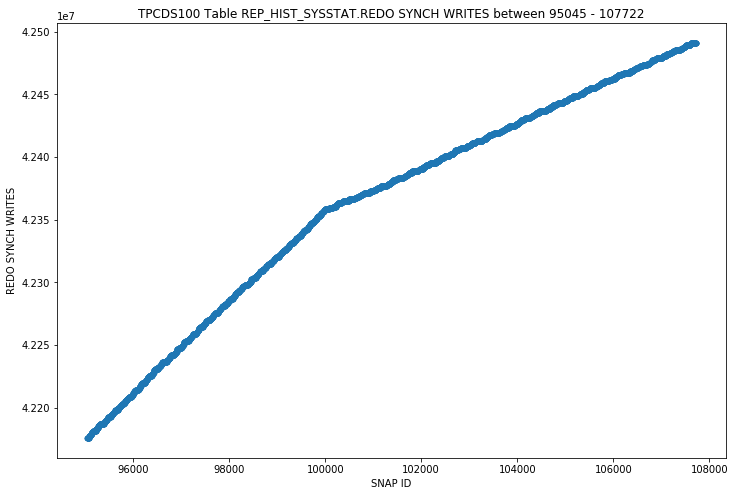

REP_HIST_SYSSTAT - REDO WASTAGE - OUTLIERS SCATTER


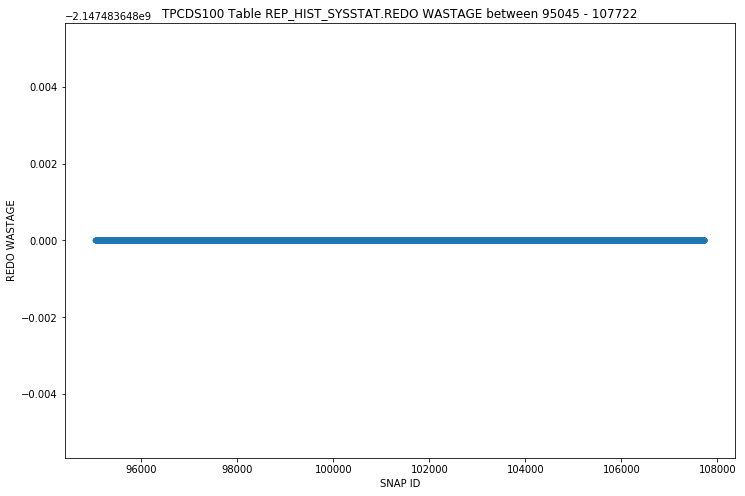

REP_HIST_SYSSTAT - REDO WRITE FINISH TIME - OUTLIERS SCATTER


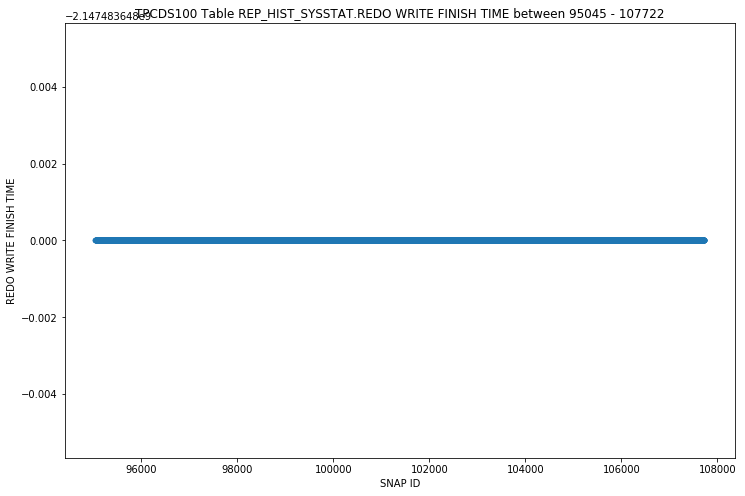

REP_HIST_SYSSTAT - REDO WRITE GATHER TIME - OUTLIERS SCATTER


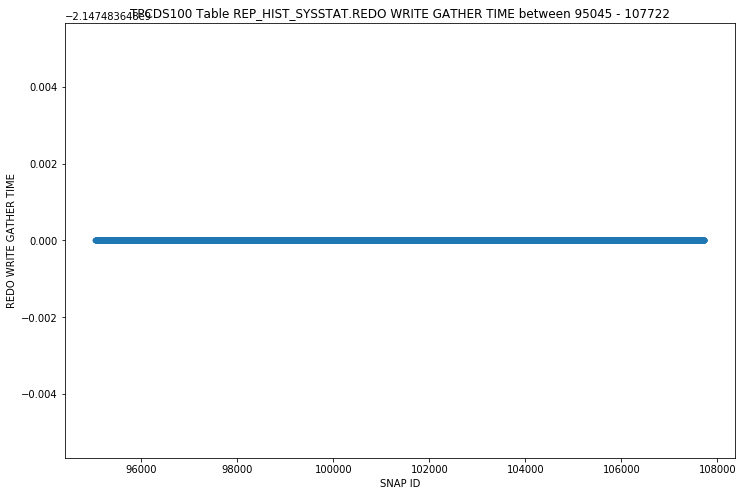

REP_HIST_SYSSTAT - REDO WRITE INFO FIND - OUTLIERS SCATTER


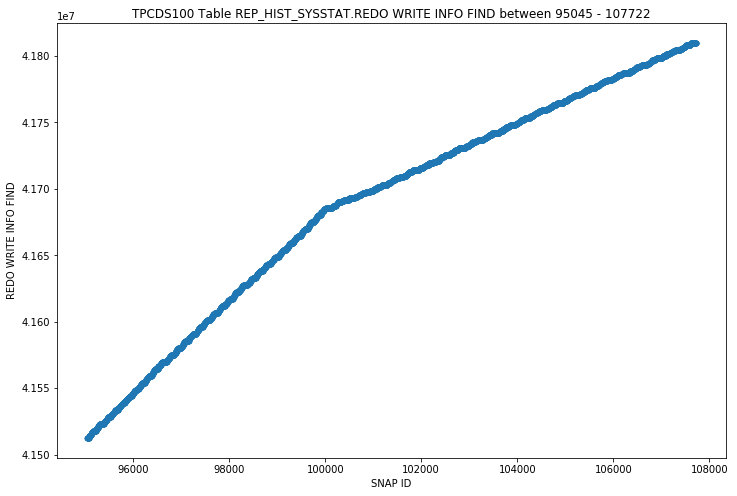

REP_HIST_SYSSTAT - REDO WRITE SCHEDULE TIME - OUTLIERS SCATTER


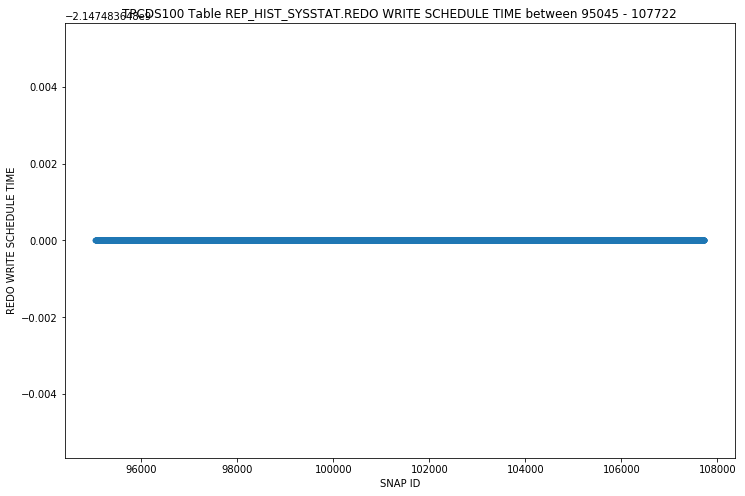

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (   4KB) - OUTLIERS SCATTER


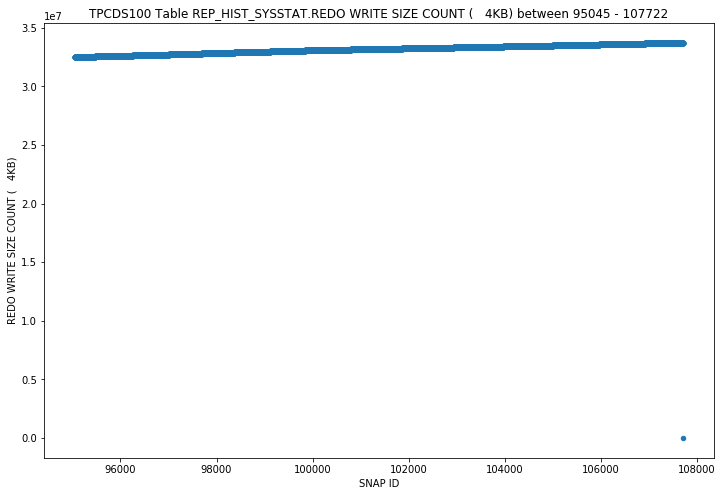

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (   8KB) - OUTLIERS SCATTER


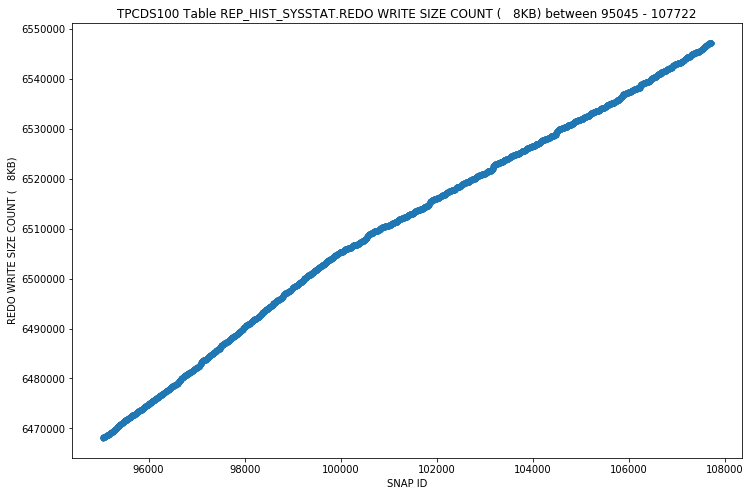

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (  16KB) - OUTLIERS SCATTER


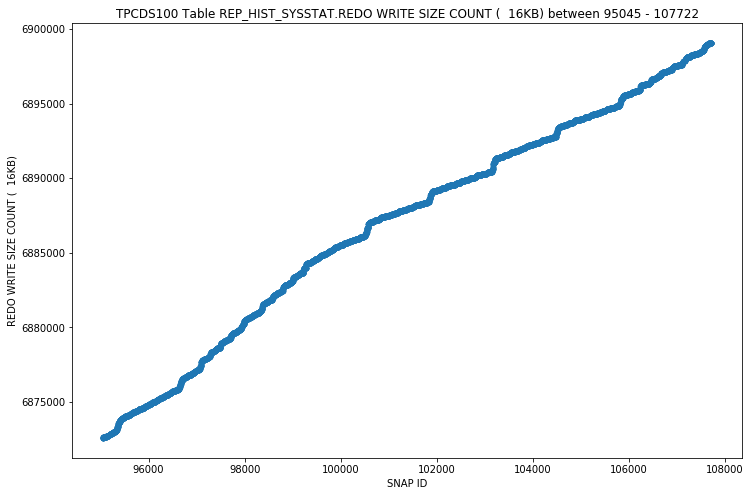

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (  32KB) - OUTLIERS SCATTER


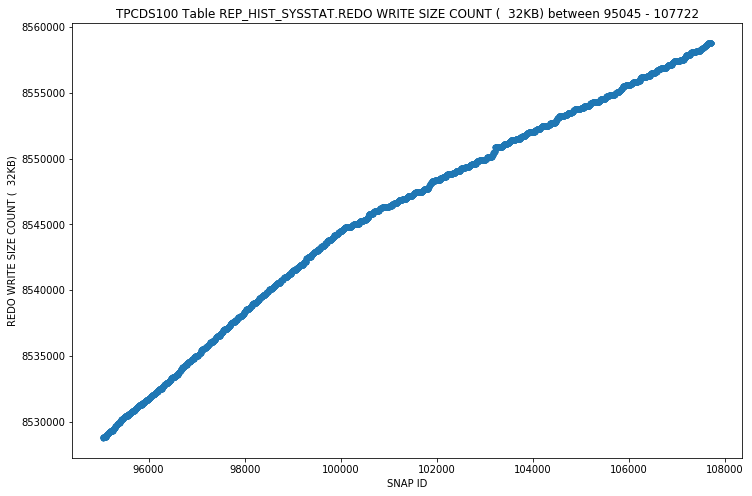

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 128KB) - OUTLIERS SCATTER


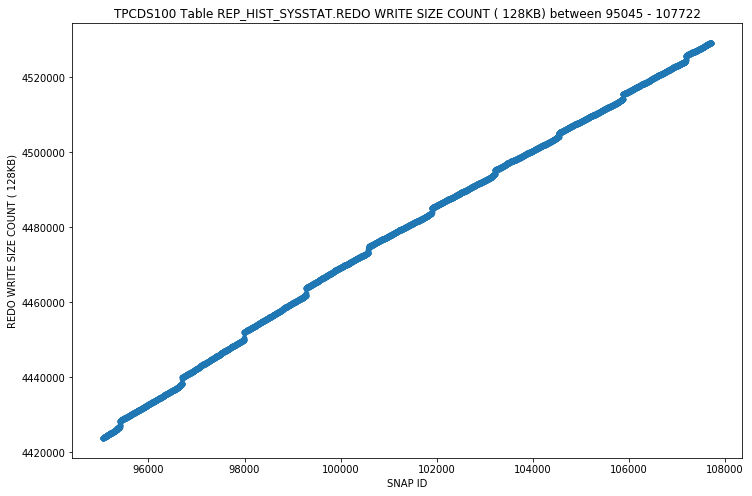

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 256KB) - OUTLIERS SCATTER


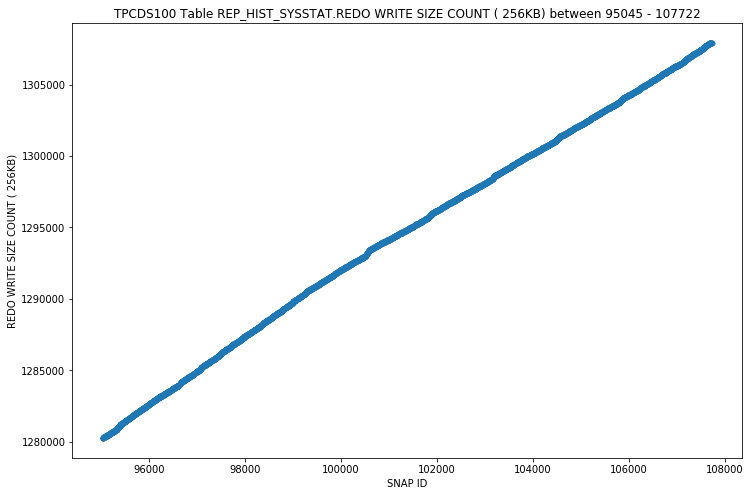

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 512KB) - OUTLIERS SCATTER


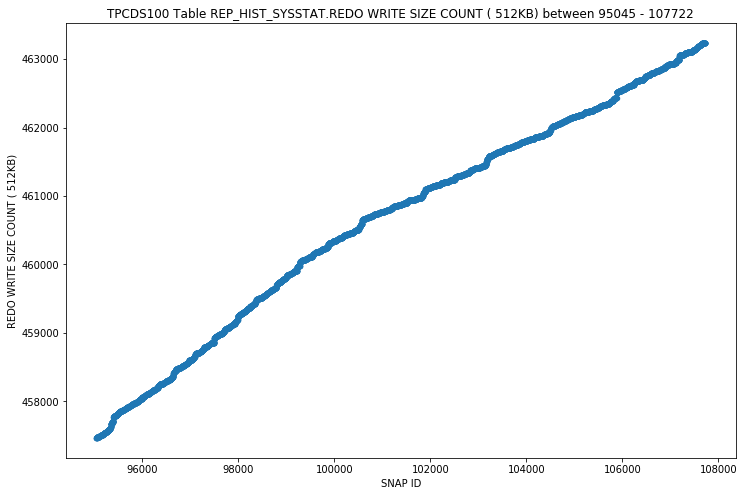

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (1024KB) - OUTLIERS SCATTER


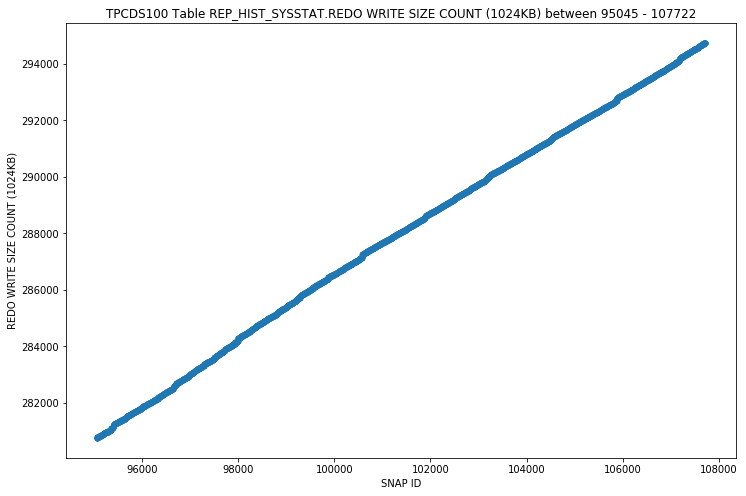

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (INF) - OUTLIERS SCATTER


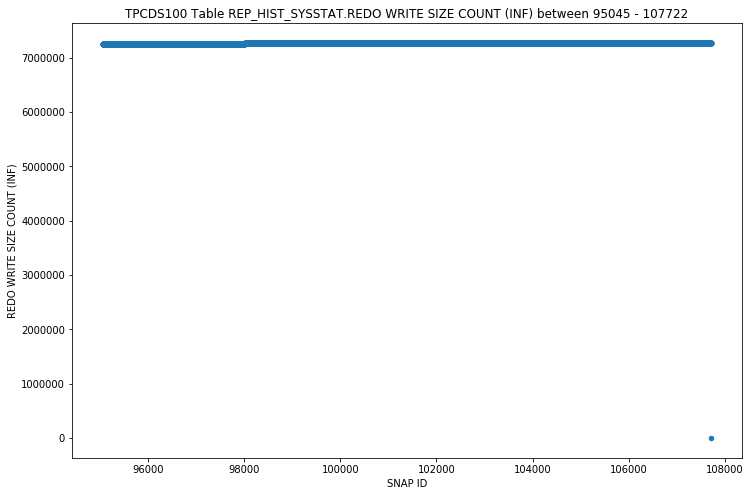

REP_HIST_SYSSTAT - REDO WRITE TIME - OUTLIERS SCATTER


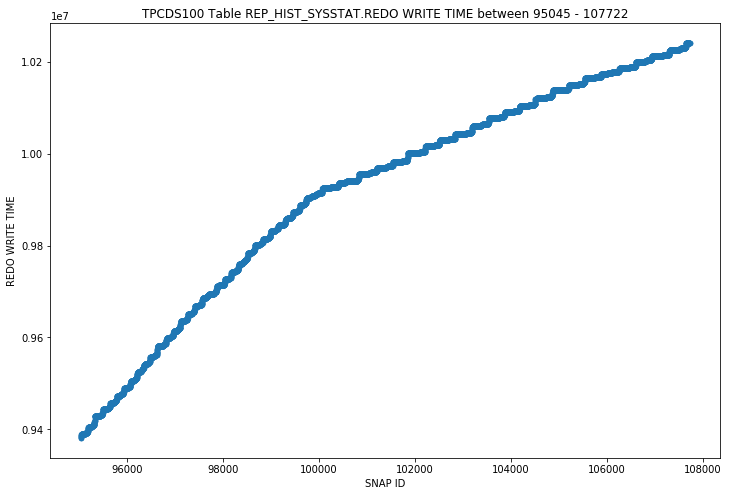

REP_HIST_SYSSTAT - REDO WRITE TIME (USEC) - OUTLIERS SCATTER


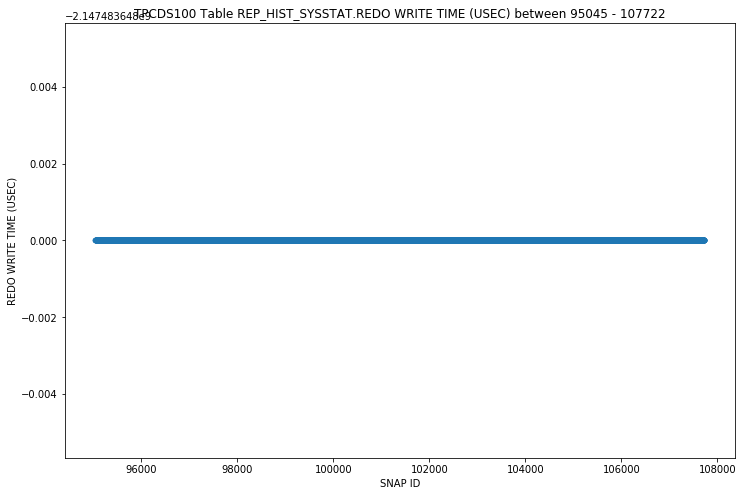

REP_HIST_SYSSTAT - REDO WRITE TOTAL TIME - OUTLIERS SCATTER


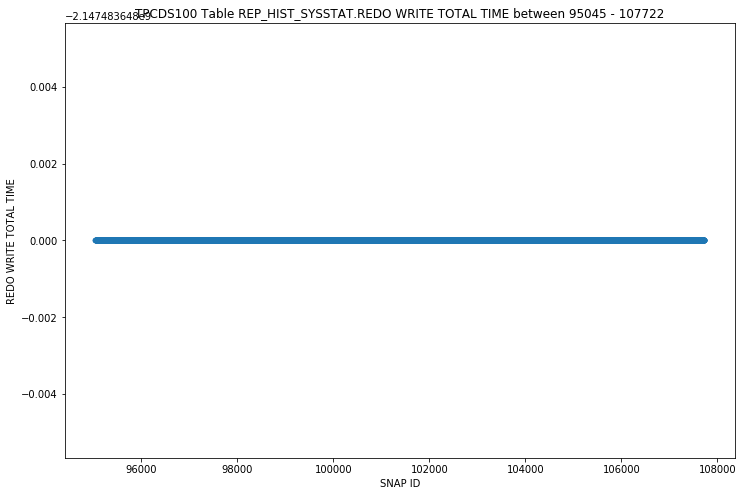

REP_HIST_SYSSTAT - REDO WRITE WORKER DELAY (USEC) - OUTLIERS SCATTER


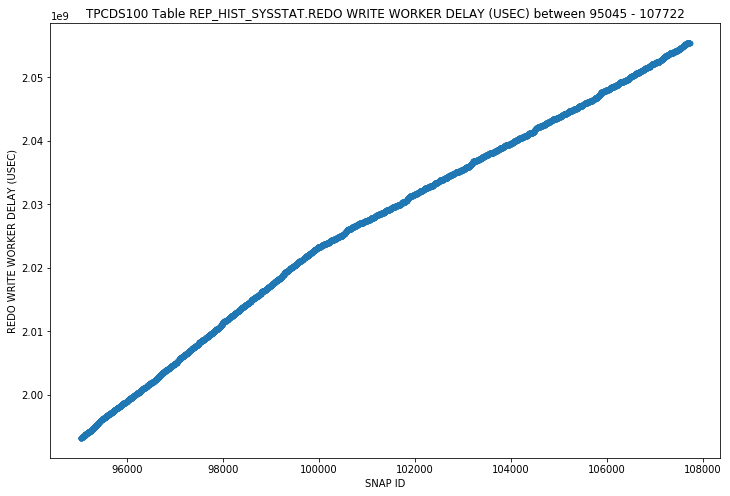

REP_HIST_SYSSTAT - REDO WRITES - OUTLIERS SCATTER


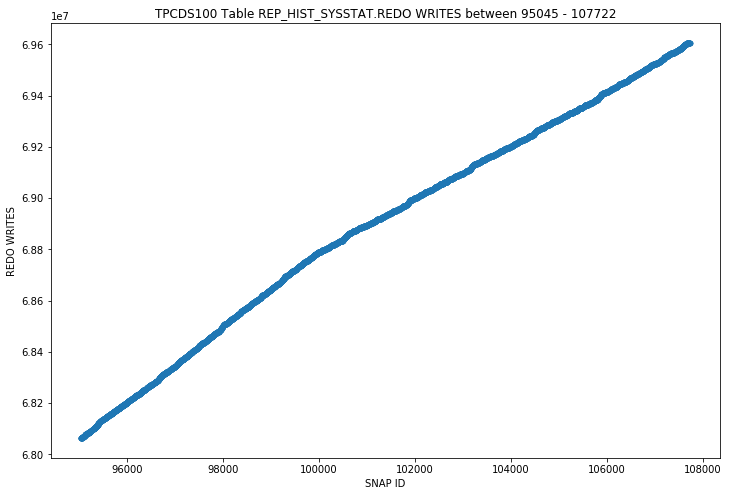

REP_HIST_SYSSTAT - REDO WRITES (GROUP 0) - OUTLIERS SCATTER


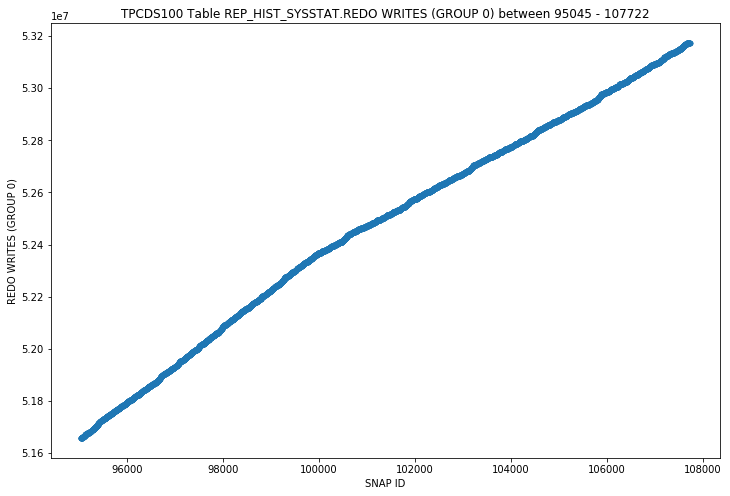

REP_HIST_SYSSTAT - REDO WRITES (GROUP 1) - OUTLIERS SCATTER


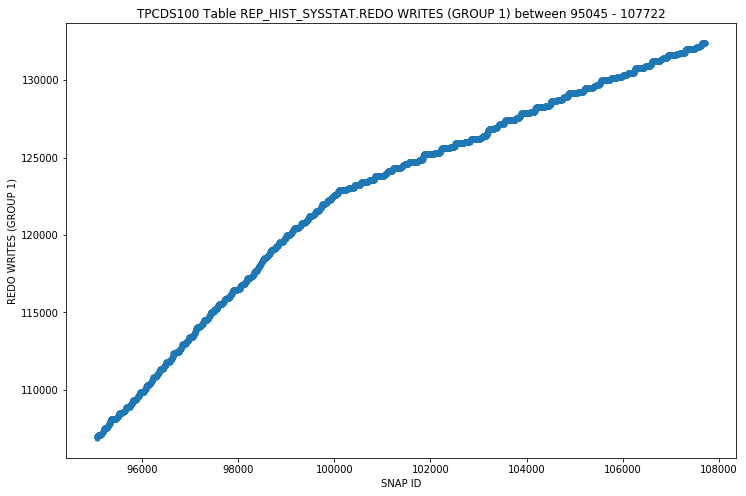

REP_HIST_SYSSTAT - REDO WRITES ADAPTIVE ALL - OUTLIERS SCATTER


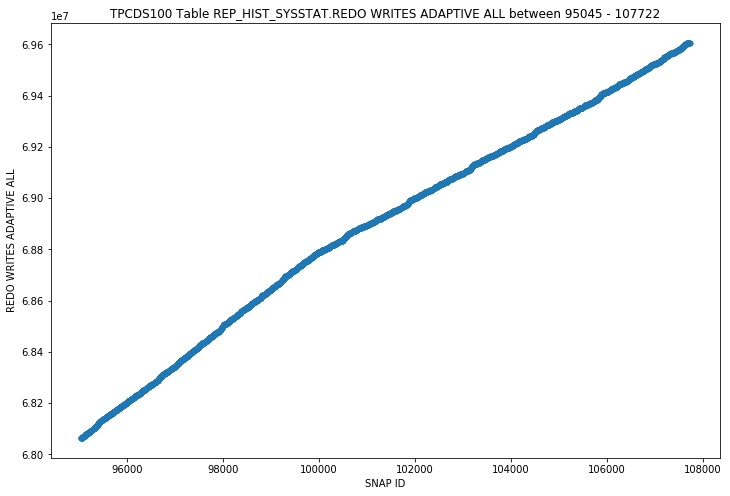

REP_HIST_SYSSTAT - REDO WRITES ADAPTIVE WORKER - OUTLIERS SCATTER


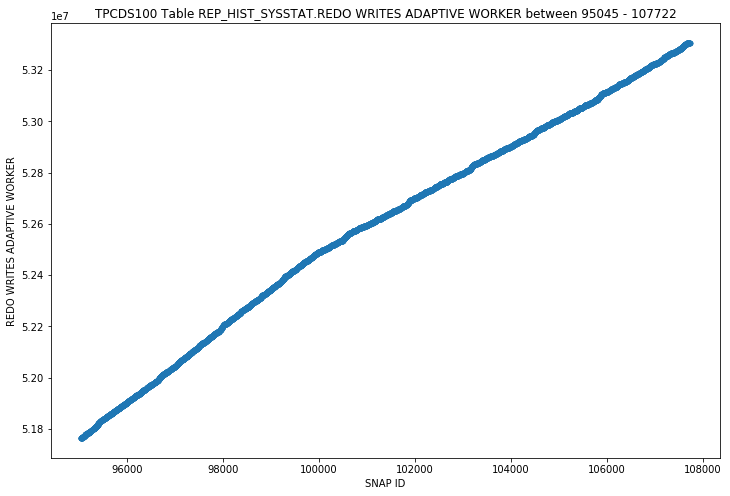

REP_HIST_SYSSTAT - ROLLBACK CHANGES - UNDO RECORDS APPLIED - OUTLIERS SCATTER


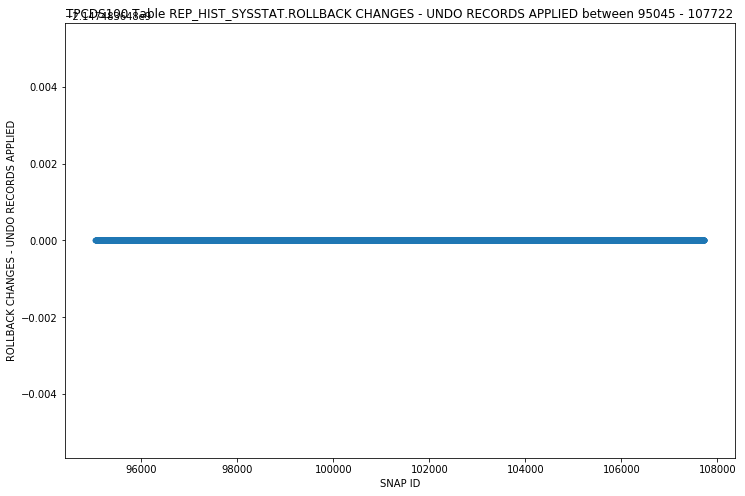

REP_HIST_SYSSTAT - ROLLBACKS ONLY - CONSISTENT READ GETS - OUTLIERS SCATTER


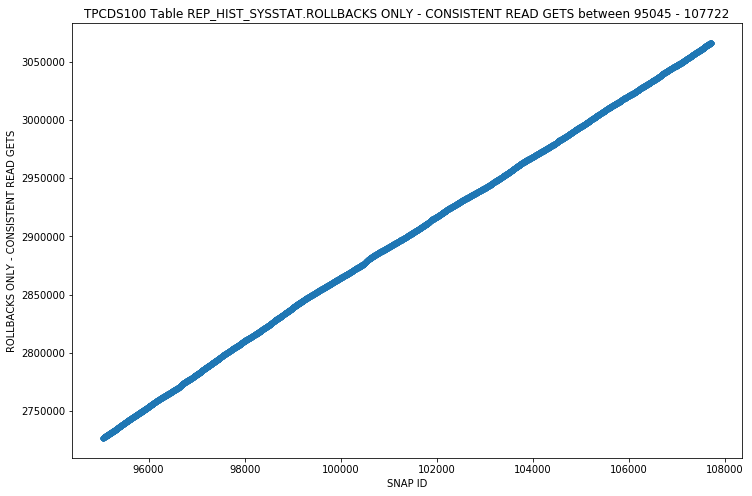

REP_HIST_SYSSTAT - ROOT NODE SPLITS - OUTLIERS SCATTER


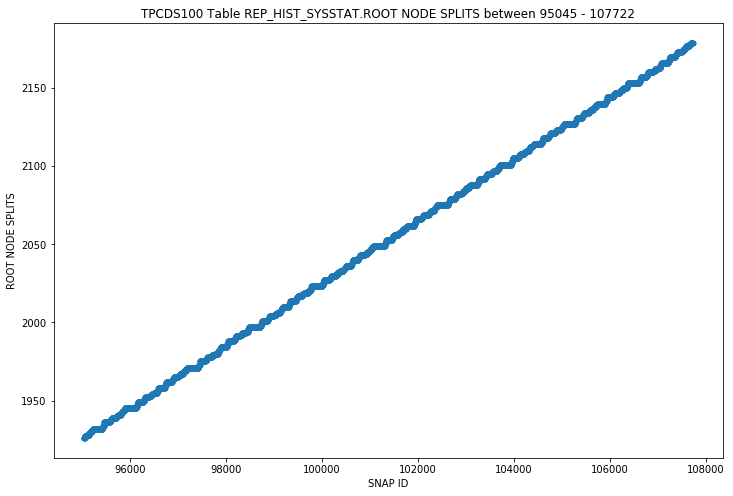

REP_HIST_SYSSTAT - ROWS FETCHED VIA CALLBACK - OUTLIERS SCATTER


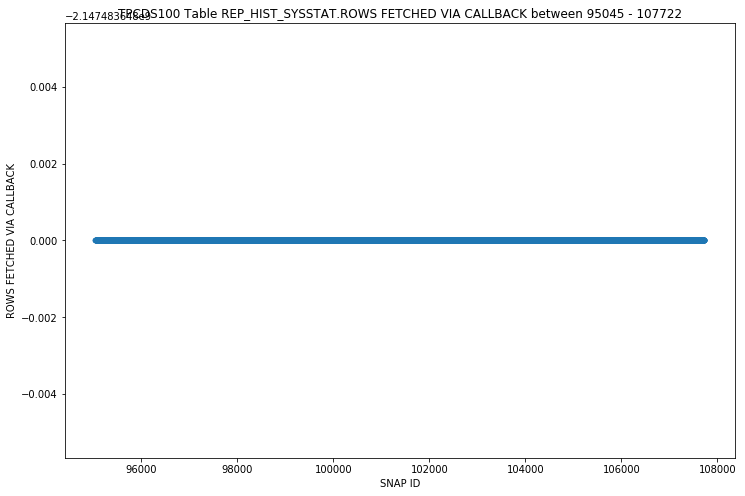

REP_HIST_SYSSTAT - SCHEDULER WAIT TIME - OUTLIERS SCATTER


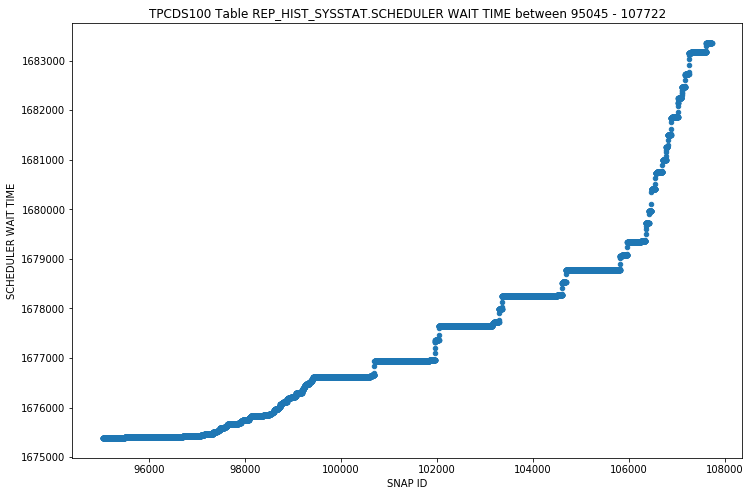

REP_HIST_SYSSTAT - SECUREFILE ALLOCATION BYTES - OUTLIERS SCATTER


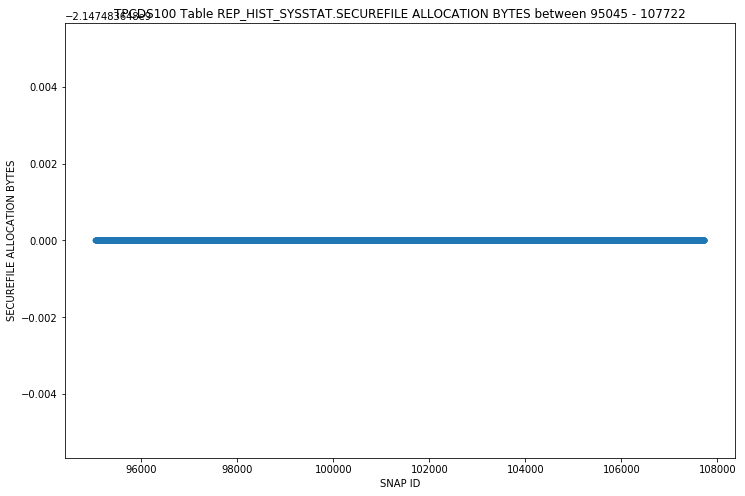

REP_HIST_SYSSTAT - SECUREFILE ALLOCATION CHUNKS - OUTLIERS SCATTER


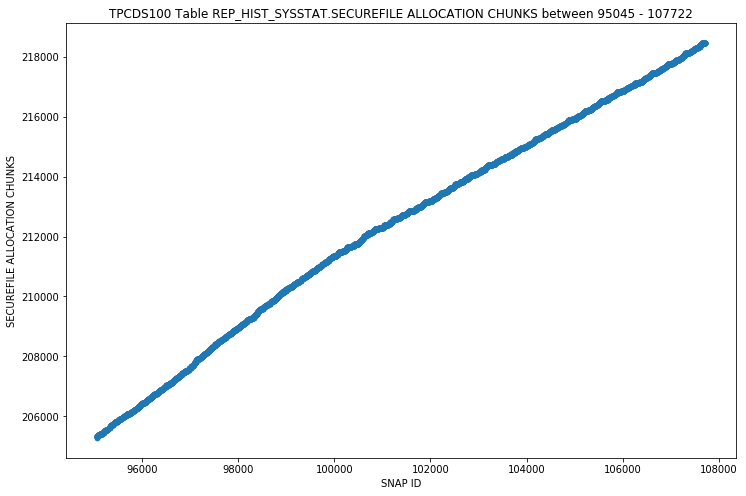

REP_HIST_SYSSTAT - SECUREFILE BYTES NON-TRANSFORMED - OUTLIERS SCATTER


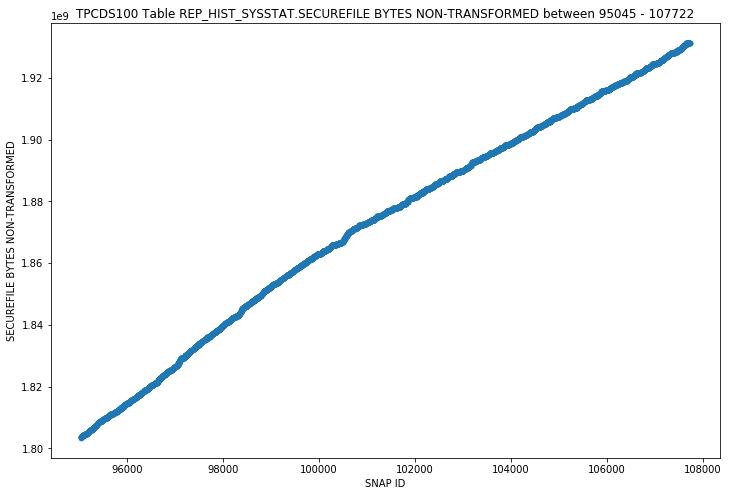

REP_HIST_SYSSTAT - SECUREFILE DIRECT READ BYTES - OUTLIERS SCATTER


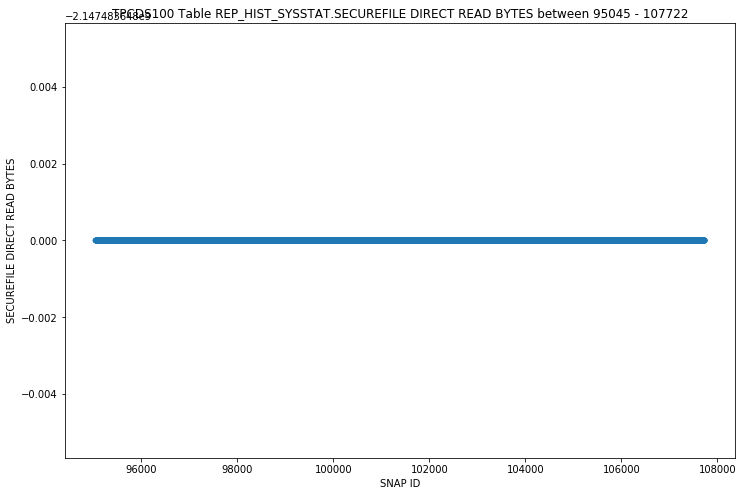

REP_HIST_SYSSTAT - SECUREFILE DIRECT READ OPS - OUTLIERS SCATTER


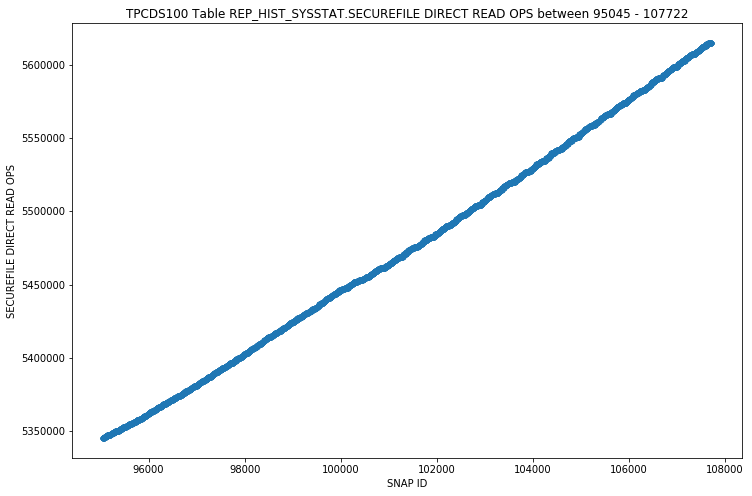

REP_HIST_SYSSTAT - SECUREFILE DIRECT WRITE BYTES - OUTLIERS SCATTER


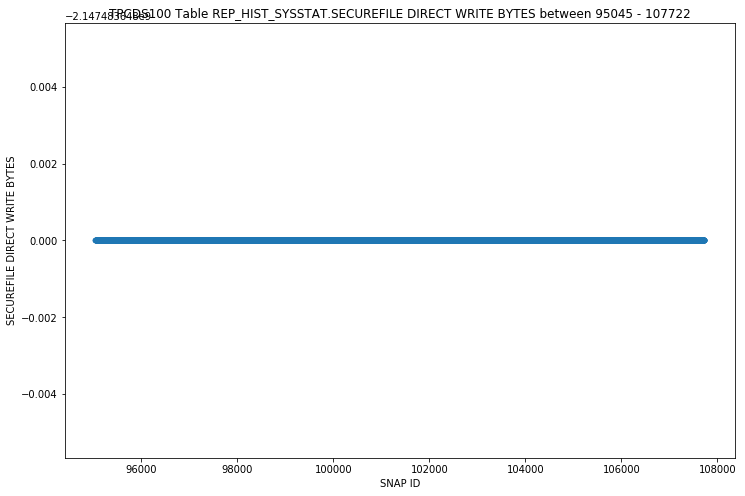

REP_HIST_SYSSTAT - SECUREFILE DIRECT WRITE OPS - OUTLIERS SCATTER


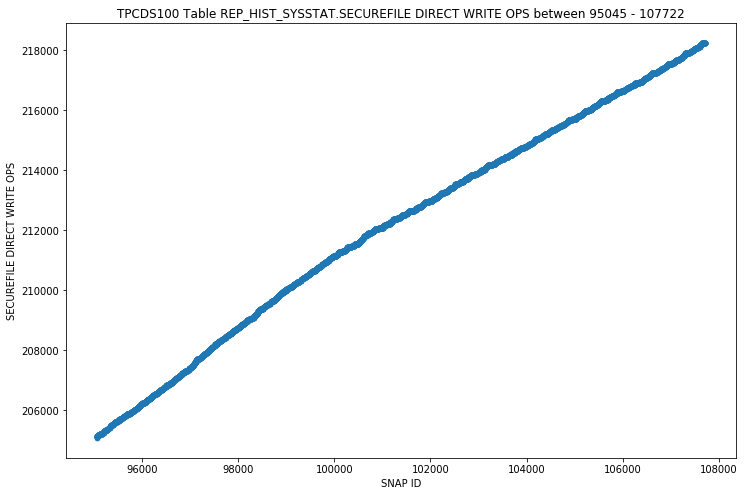

REP_HIST_SYSSTAT - SECUREFILE NUMBER OF NON-TRANSFORMED FLUSHES - OUTLIERS SCATTER


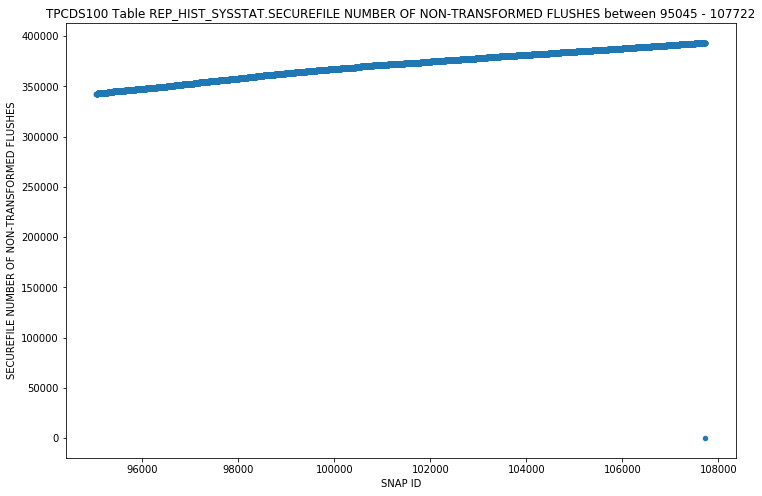

REP_HIST_SYSSTAT - SEGMENT CFS ALLOCATIONS - OUTLIERS SCATTER


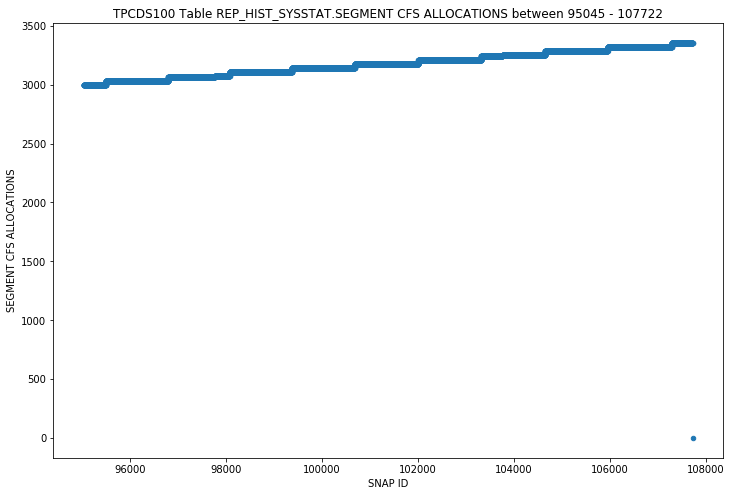

REP_HIST_SYSSTAT - SEGMENT CHUNKS ALLOCATION FROM DISEPNSER - OUTLIERS SCATTER


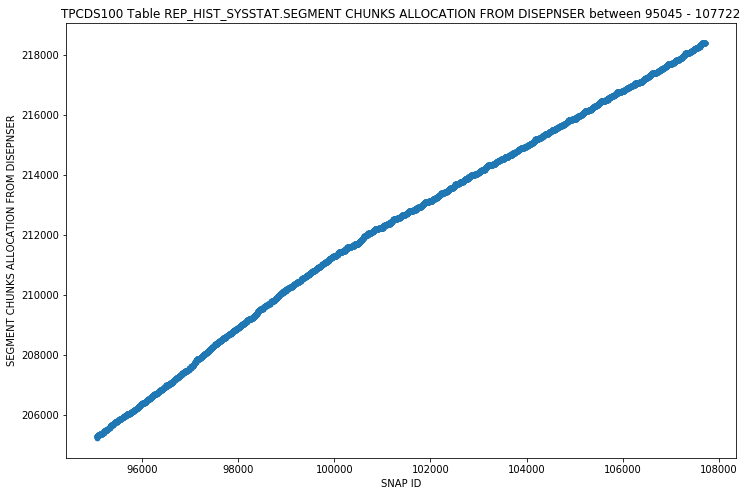

REP_HIST_SYSSTAT - SEGMENT DISPENSER ALLOCATIONS - OUTLIERS SCATTER


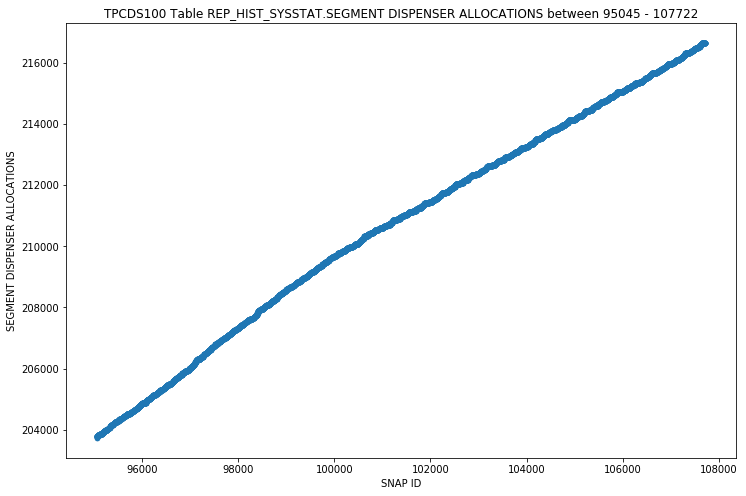

REP_HIST_SYSSTAT - SEGMENT DISPENSER LOAD EMPTY - OUTLIERS SCATTER


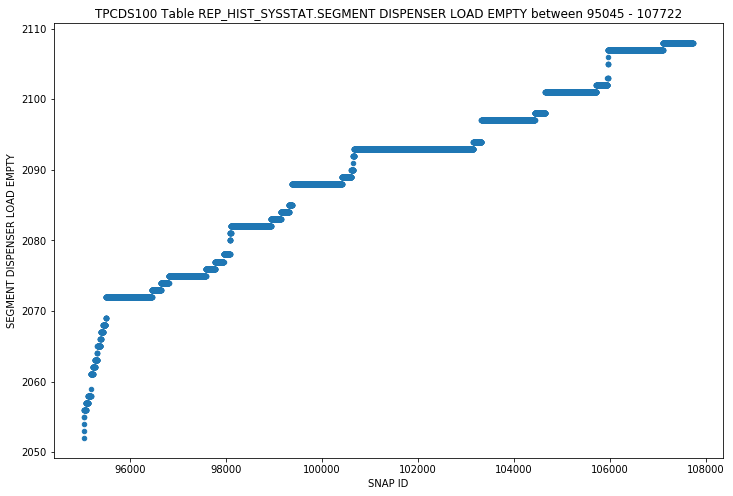

REP_HIST_SYSSTAT - SEGMENT DISPENSER LOAD TASKS - OUTLIERS SCATTER


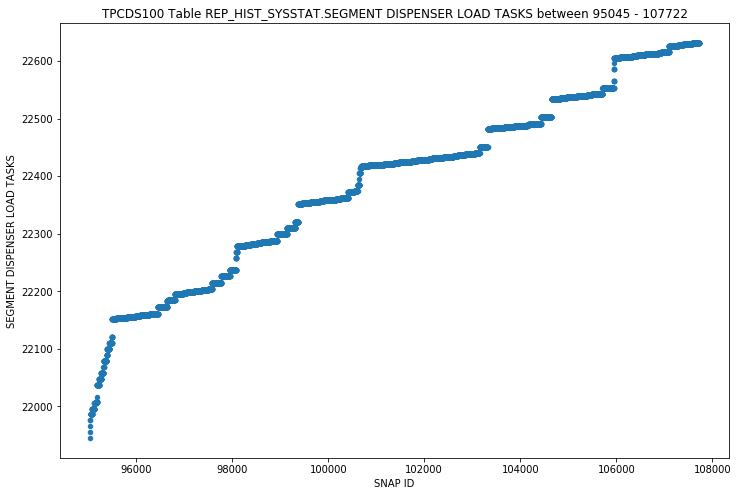

REP_HIST_SYSSTAT - SEGMENT PREALLOC BYTES - OUTLIERS SCATTER


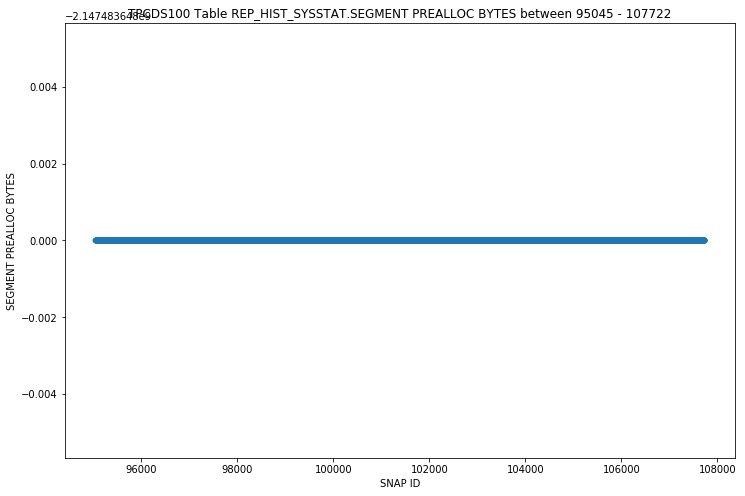

REP_HIST_SYSSTAT - SEGMENT PREALLOC OPS - OUTLIERS SCATTER


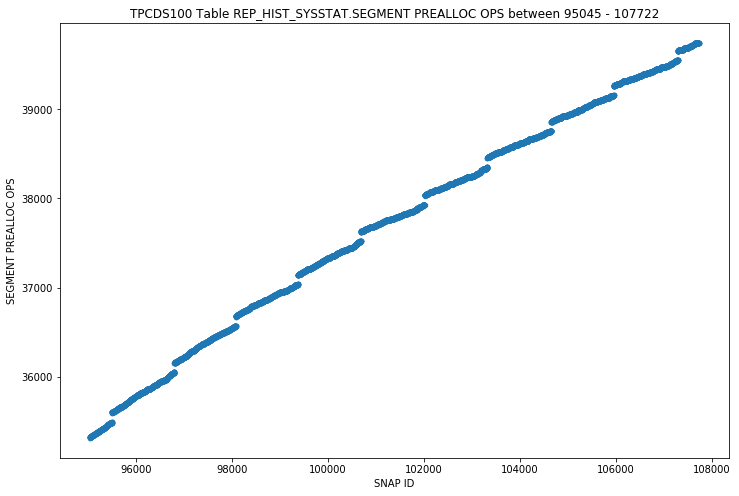

REP_HIST_SYSSTAT - SEGMENT PREALLOC TASKS - OUTLIERS SCATTER


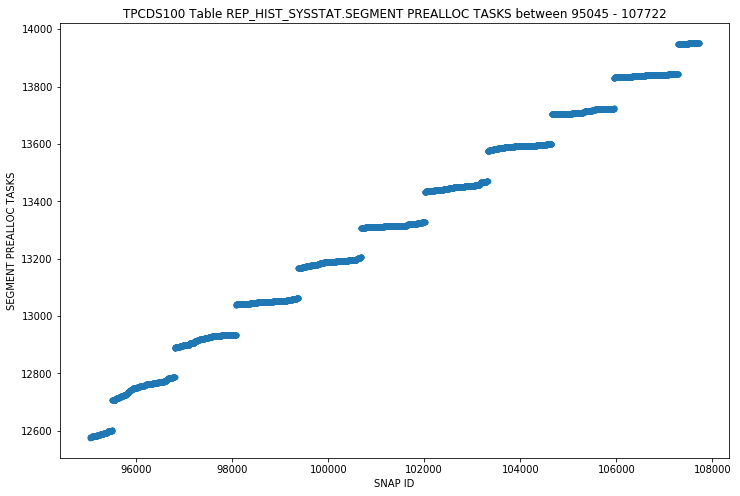

REP_HIST_SYSSTAT - SEGMENT PREALLOC TIME (MS) - OUTLIERS SCATTER


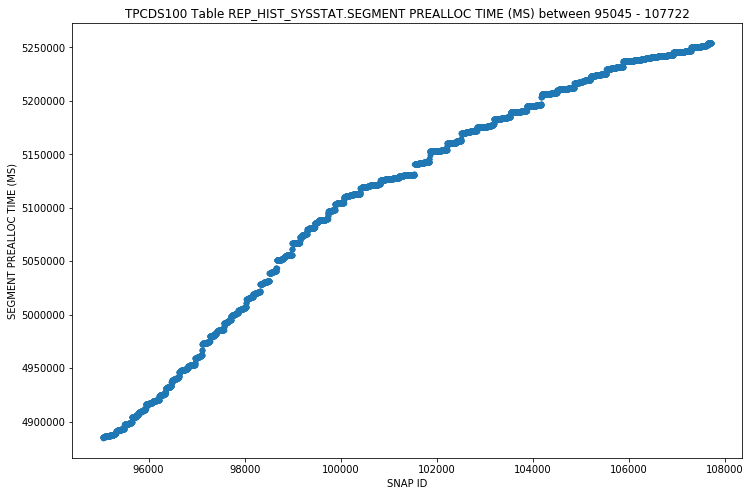

REP_HIST_SYSSTAT - SEGMENT PREALLOC UFS2CFS BYTES - OUTLIERS SCATTER


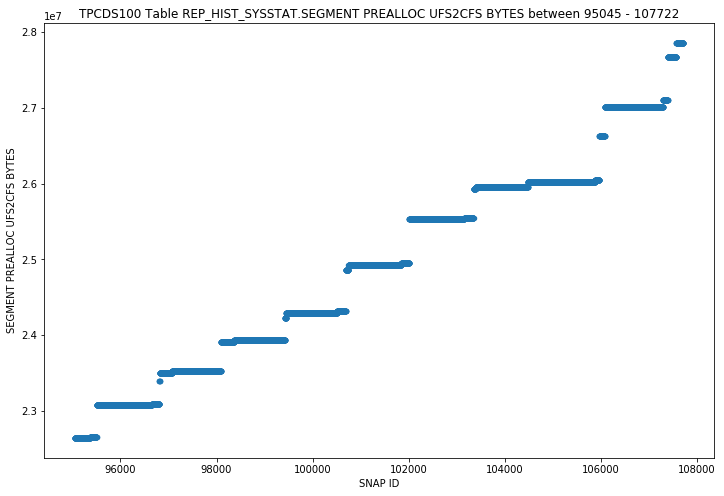

REP_HIST_SYSSTAT - SEGMENT TOTAL CHUNK ALLOCATION - OUTLIERS SCATTER


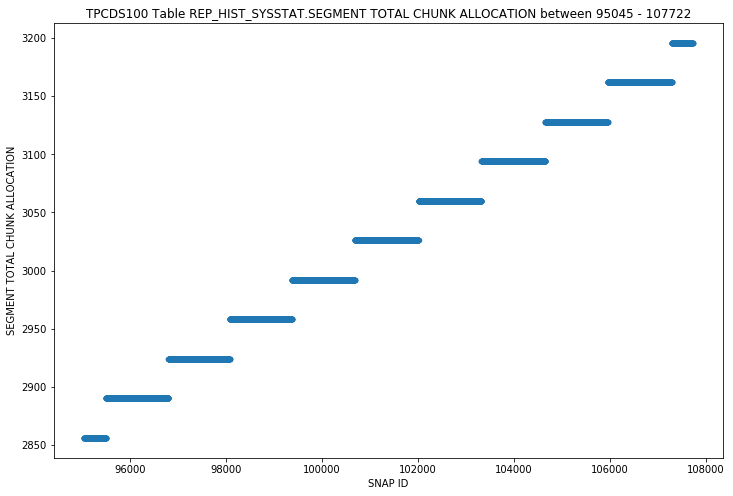

REP_HIST_SYSSTAT - SESSION CONNECT TIME - OUTLIERS SCATTER


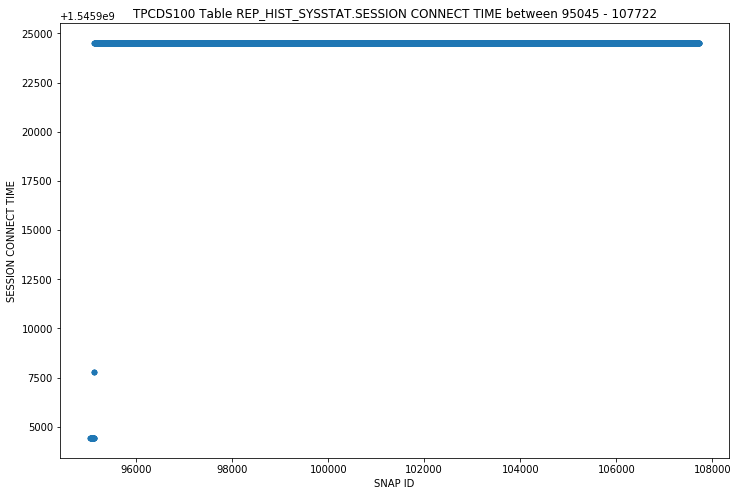

REP_HIST_SYSSTAT - SESSION CURSOR CACHE COUNT - OUTLIERS SCATTER


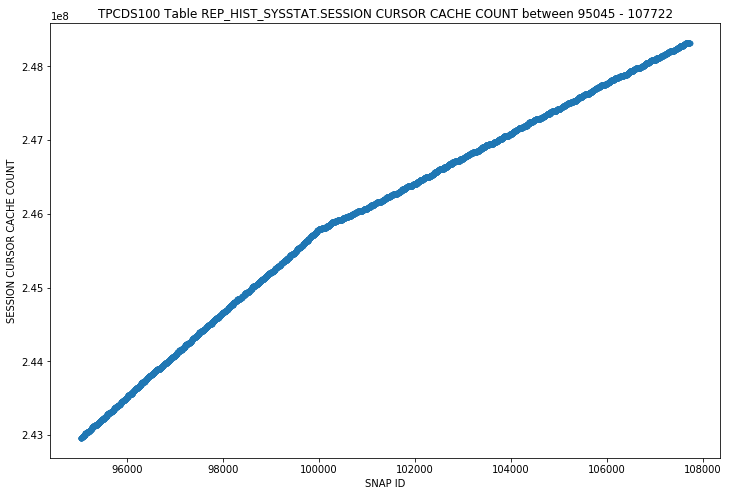

REP_HIST_SYSSTAT - SESSION CURSOR CACHE HITS - OUTLIERS SCATTER


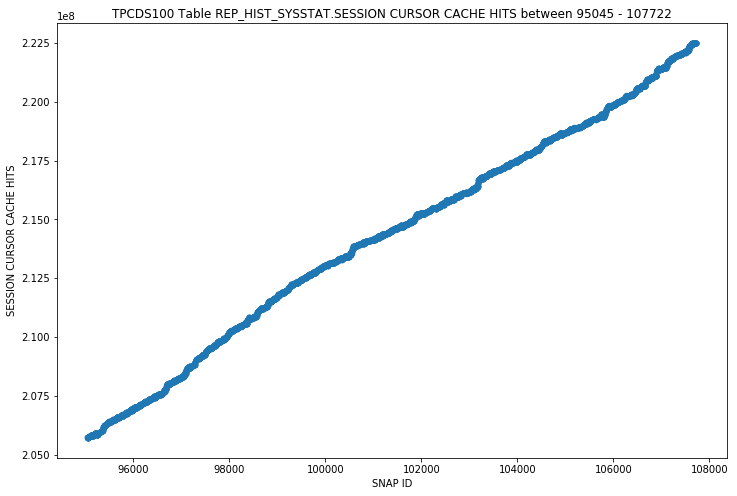

REP_HIST_SYSSTAT - SESSION LOGICAL READS - OUTLIERS SCATTER


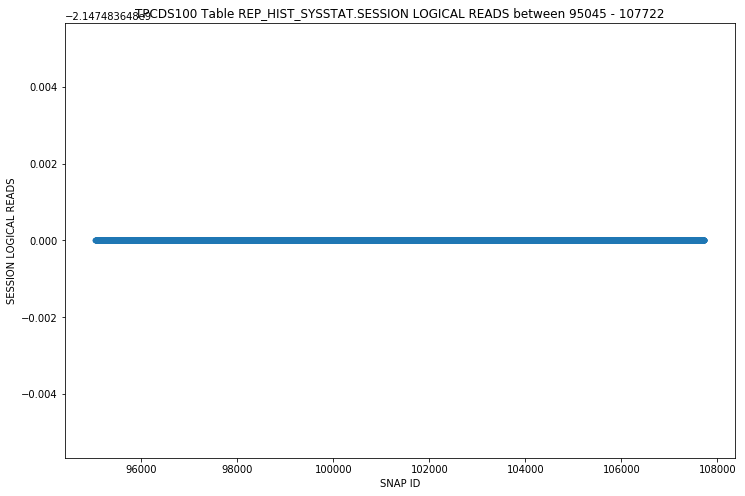

REP_HIST_SYSSTAT - SESSION PGA MEMORY - OUTLIERS SCATTER


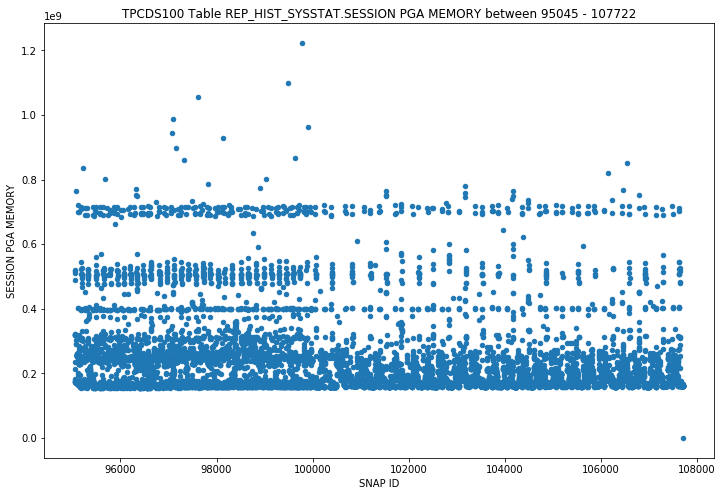

REP_HIST_SYSSTAT - SESSION PGA MEMORY MAX - OUTLIERS SCATTER


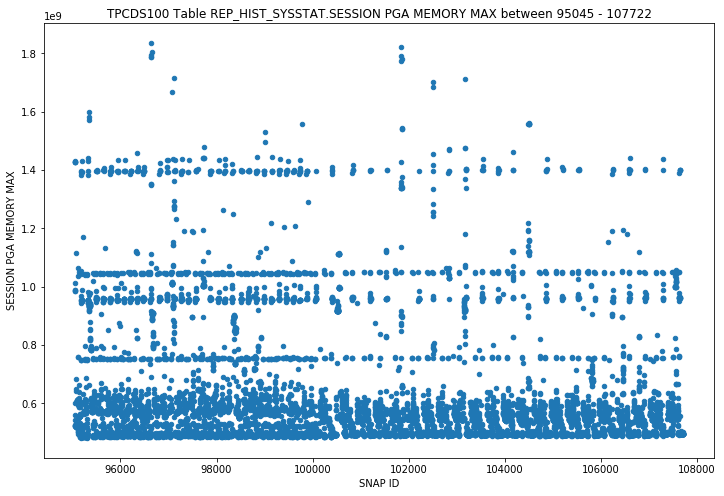

REP_HIST_SYSSTAT - SESSION UGA MEMORY - OUTLIERS SCATTER


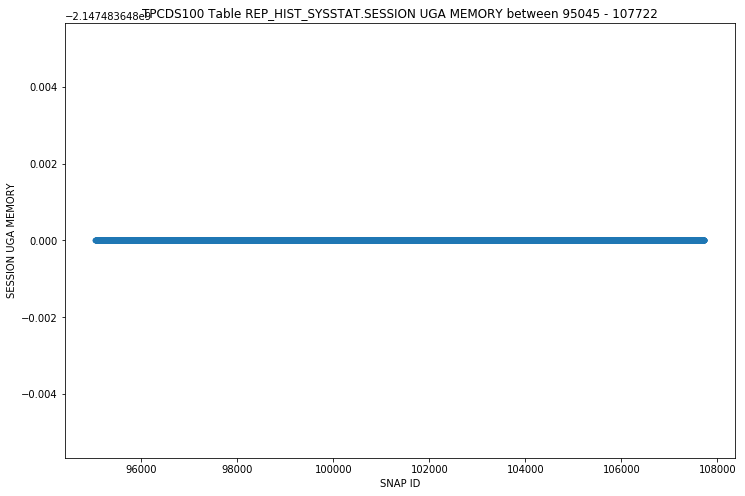

REP_HIST_SYSSTAT - SESSION UGA MEMORY MAX - OUTLIERS SCATTER


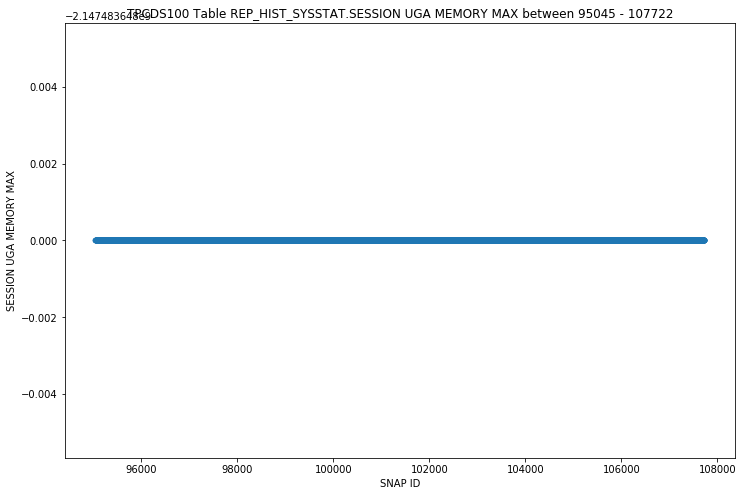

REP_HIST_SYSSTAT - SHARED HASH LATCH UPGRADES - NO WAIT - OUTLIERS SCATTER


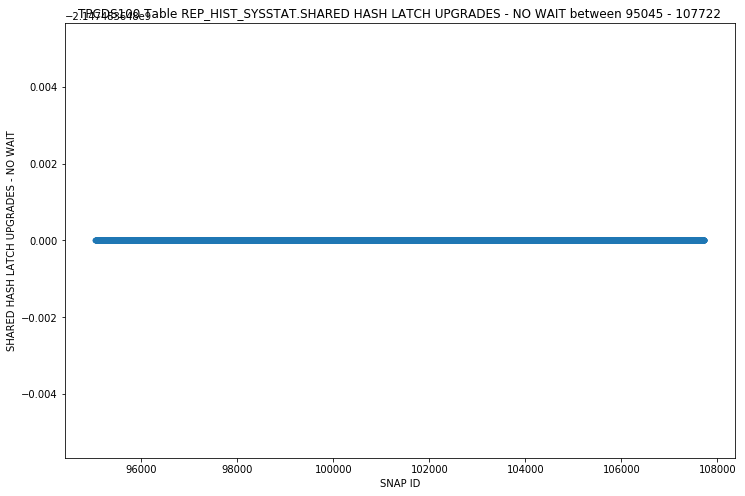

REP_HIST_SYSSTAT - SHARED HASH LATCH UPGRADES - WAIT - OUTLIERS SCATTER


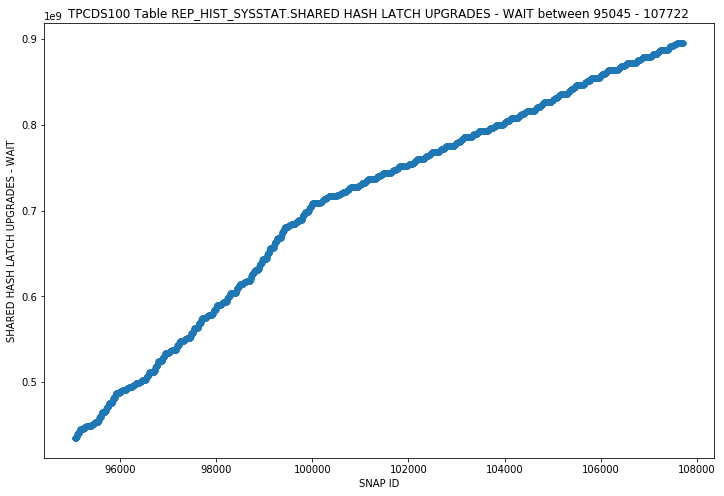

REP_HIST_SYSSTAT - SHARED IO POOL BUFFER GET SUCCESS - OUTLIERS SCATTER


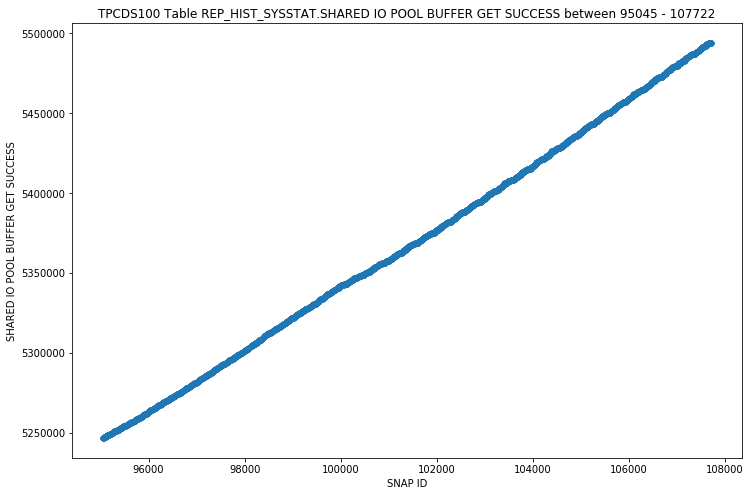

REP_HIST_SYSSTAT - SORTS (DISK) - OUTLIERS SCATTER


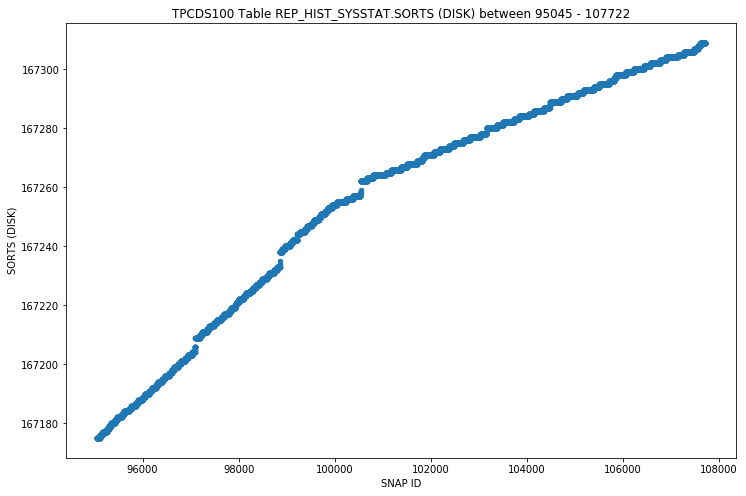

REP_HIST_SYSSTAT - SORTS (MEMORY) - OUTLIERS SCATTER


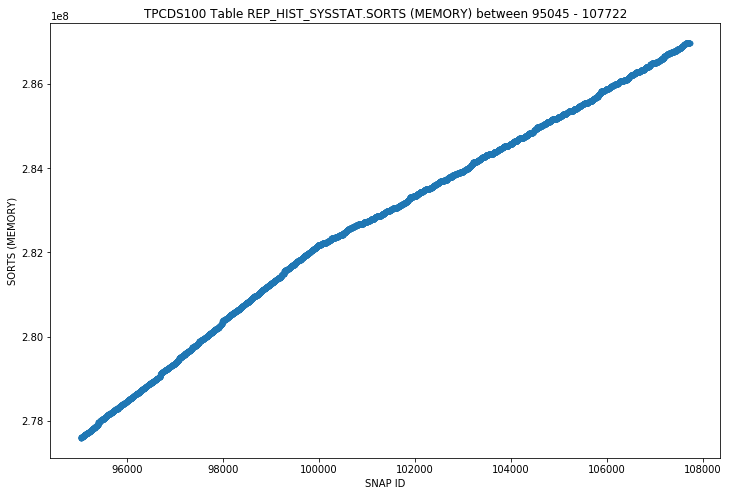

REP_HIST_SYSSTAT - SORTS (ROWS) - OUTLIERS SCATTER


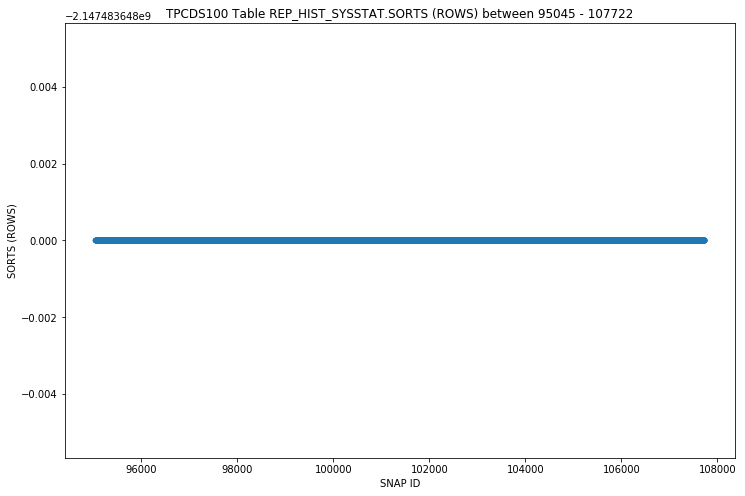

REP_HIST_SYSSTAT - SQL AREA EVICTED - OUTLIERS SCATTER


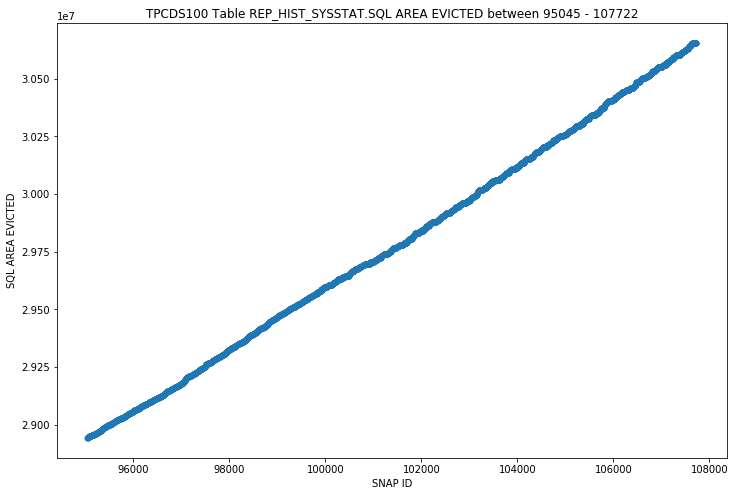

REP_HIST_SYSSTAT - SQL AREA PURGED - OUTLIERS SCATTER


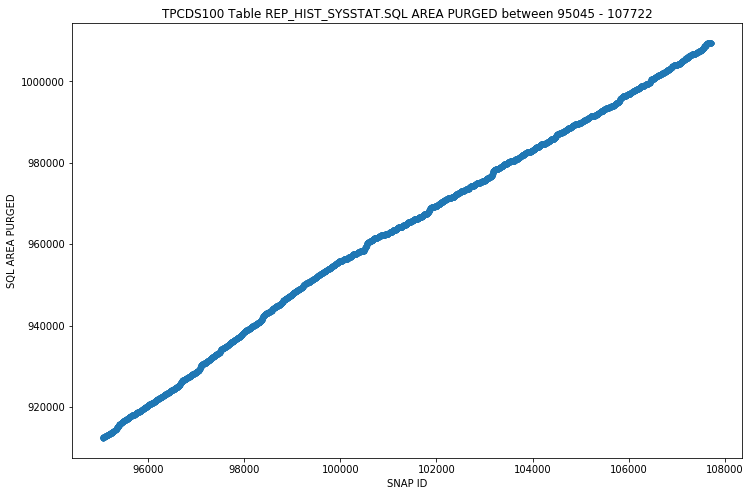

REP_HIST_SYSSTAT - STEPS OF TUNE DOWN RET. IN SPACE PRESSURE - OUTLIERS SCATTER


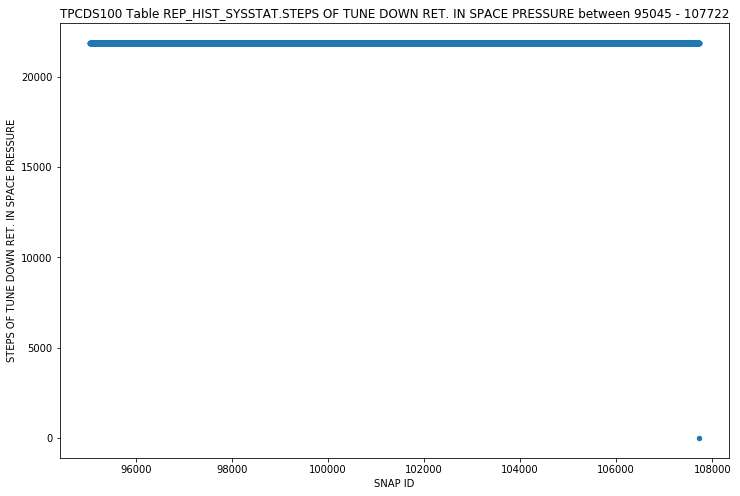

REP_HIST_SYSSTAT - SUMMED DIRTY QUEUE LENGTH - OUTLIERS SCATTER


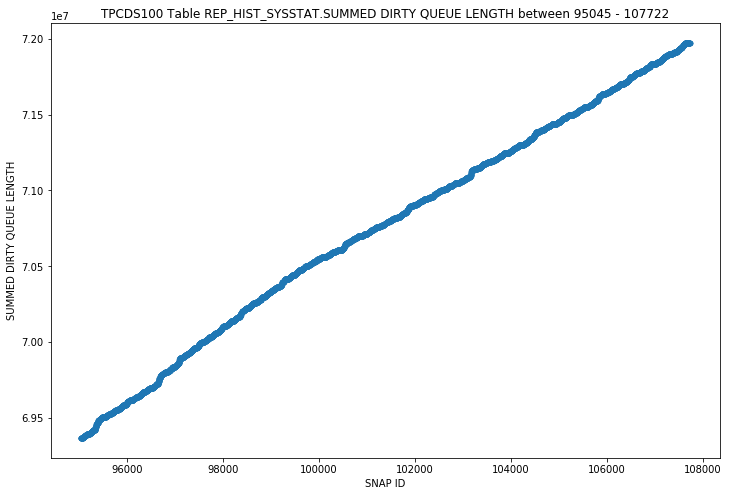

REP_HIST_SYSSTAT - SWITCH CURRENT TO NEW BUFFER - OUTLIERS SCATTER


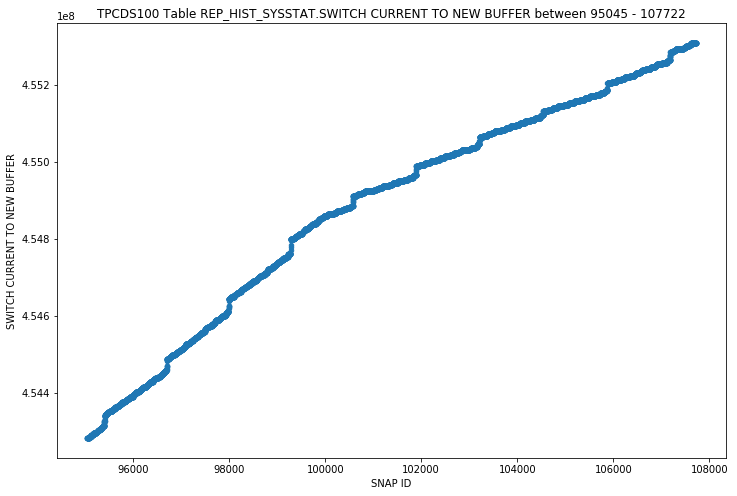

REP_HIST_SYSSTAT - TABLE FETCH BY ROWID - OUTLIERS SCATTER


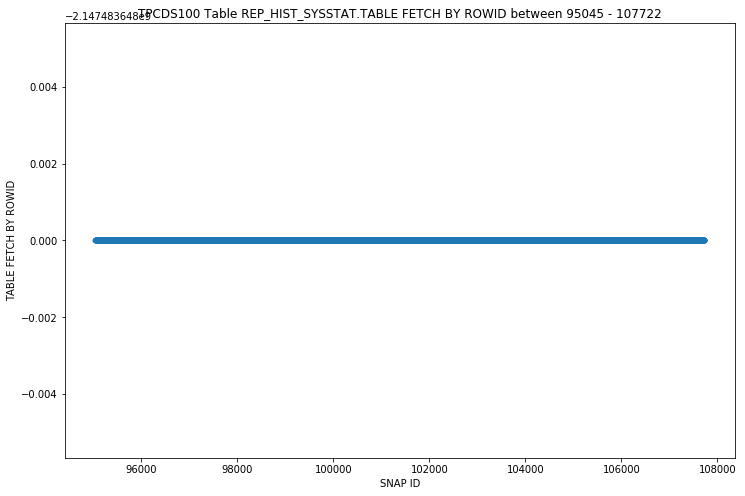

REP_HIST_SYSSTAT - TABLE FETCH CONTINUED ROW - OUTLIERS SCATTER


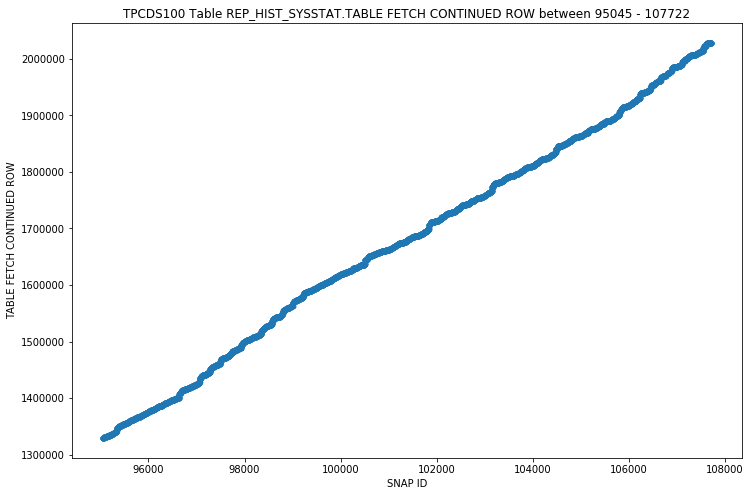

REP_HIST_SYSSTAT - TABLE SCAN BLOCKS GOTTEN - OUTLIERS SCATTER


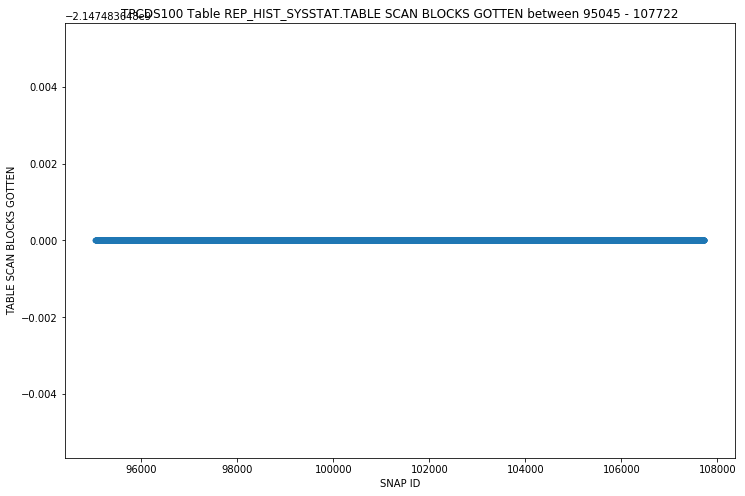

REP_HIST_SYSSTAT - TABLE SCAN DISK NON-IMC ROWS GOTTEN - OUTLIERS SCATTER


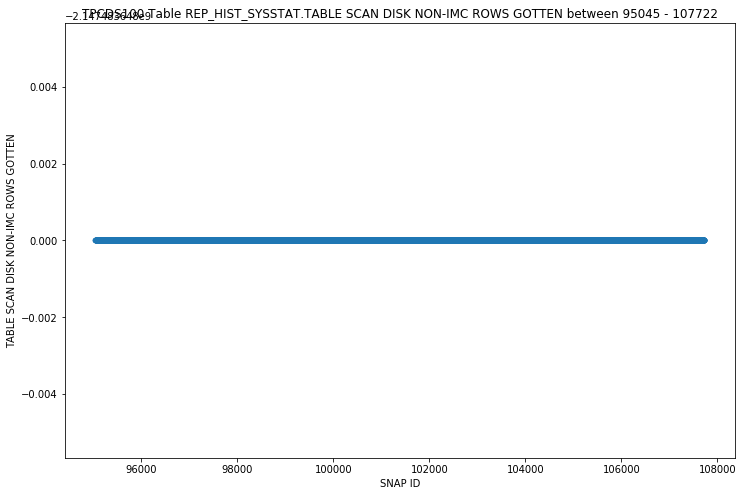

REP_HIST_SYSSTAT - TABLE SCAN ROWS GOTTEN - OUTLIERS SCATTER


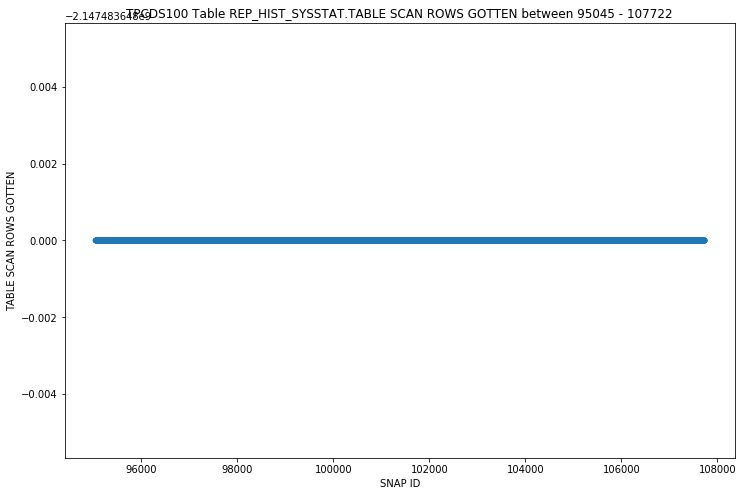

REP_HIST_SYSSTAT - TABLE SCANS (DIRECT READ) - OUTLIERS SCATTER


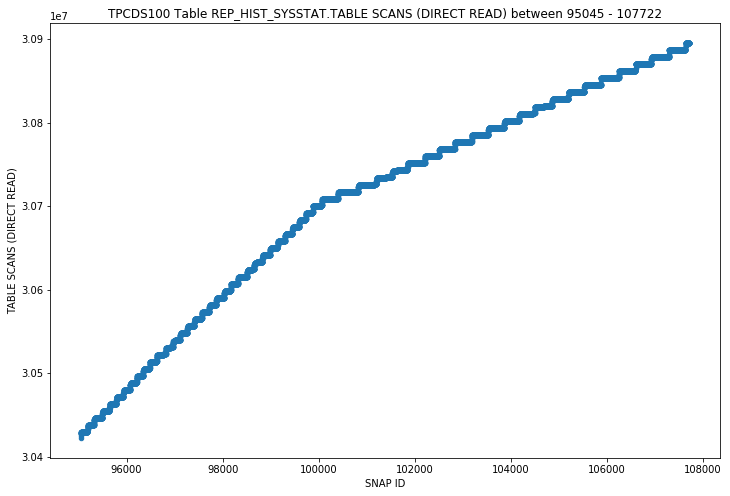

REP_HIST_SYSSTAT - TABLE SCANS (LONG TABLES) - OUTLIERS SCATTER


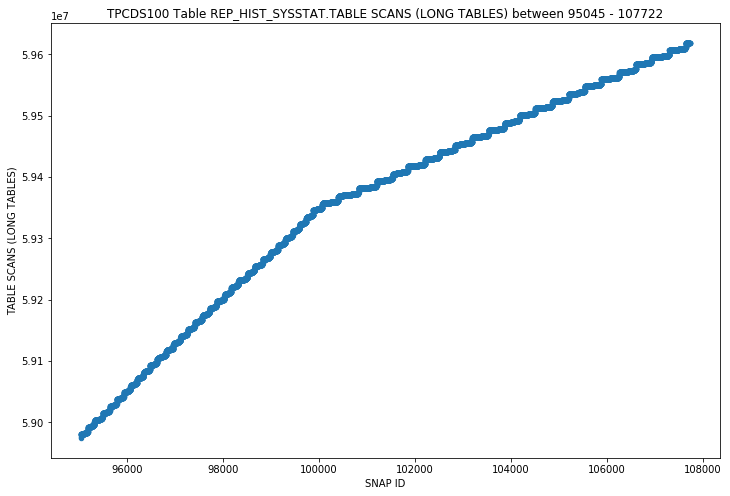

REP_HIST_SYSSTAT - TABLE SCANS (ROWID RANGES) - OUTLIERS SCATTER


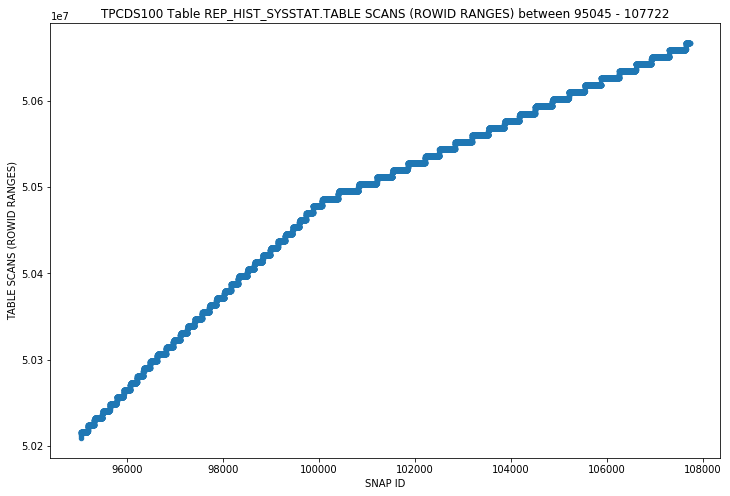

REP_HIST_SYSSTAT - TABLE SCANS (SHORT TABLES) - OUTLIERS SCATTER


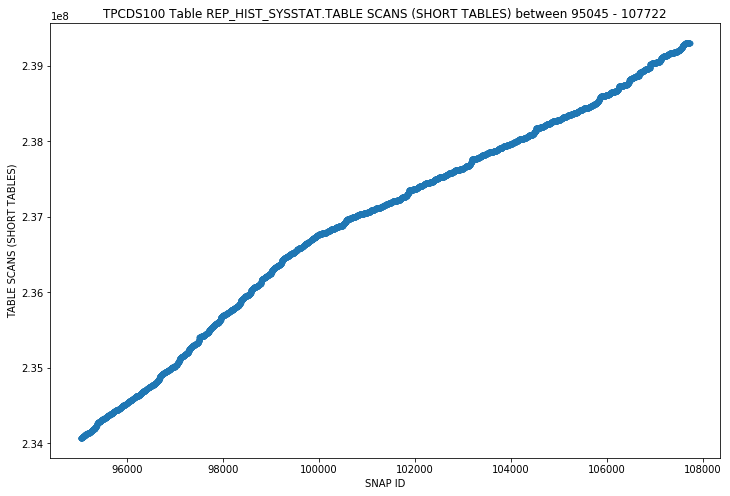

REP_HIST_SYSSTAT - TEMP SPACE ALLOCATED (BYTES) - OUTLIERS SCATTER


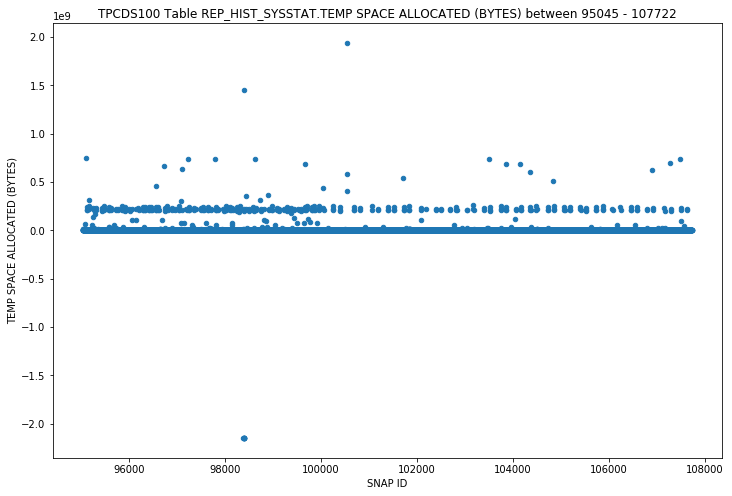

REP_HIST_SYSSTAT - TOTAL CF ENQ HOLD TIME - OUTLIERS SCATTER


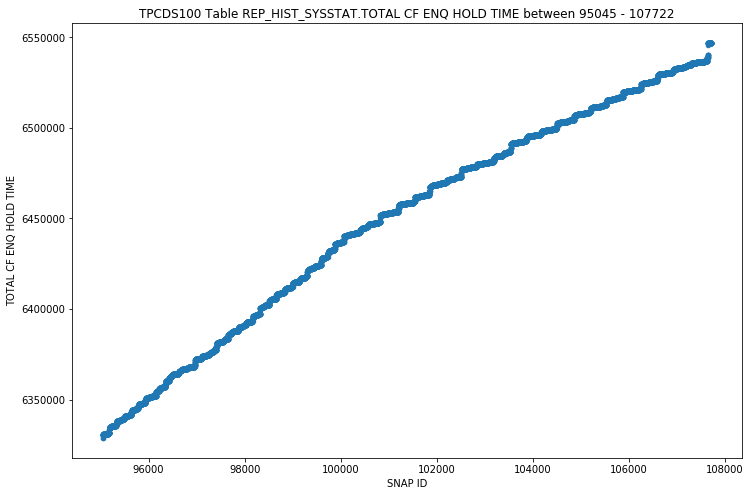

REP_HIST_SYSSTAT - TOTAL NUMBER OF CF ENQ HOLDERS - OUTLIERS SCATTER


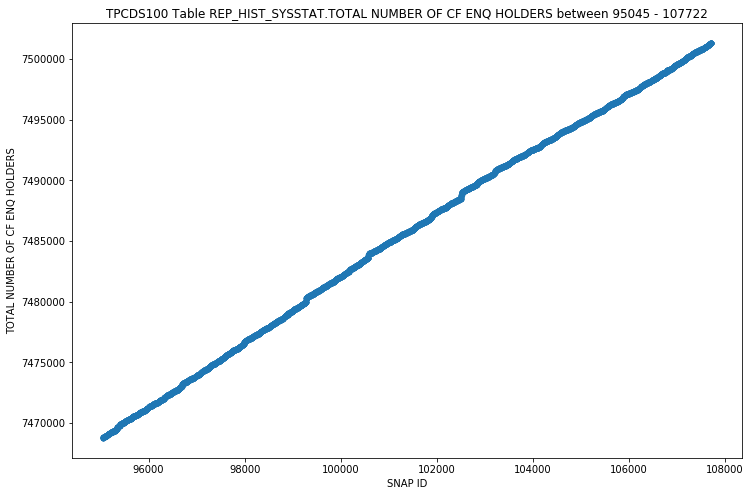

REP_HIST_SYSSTAT - TOTAL NUMBER OF SLOTS - OUTLIERS SCATTER


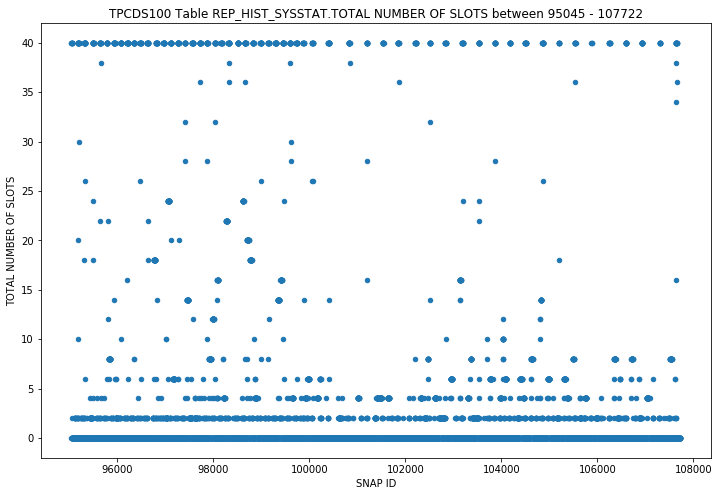

REP_HIST_SYSSTAT - TOTAL NUMBER OF TIMES SMON POSTED - OUTLIERS SCATTER


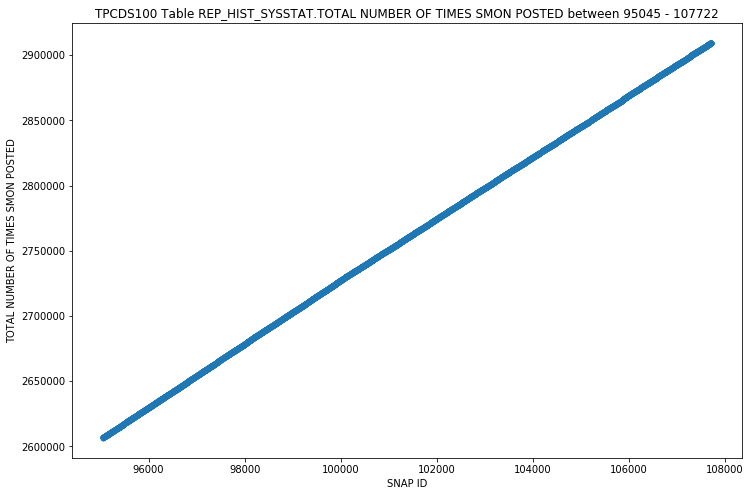

REP_HIST_SYSSTAT - TRANSACTION ROLLBACKS - OUTLIERS SCATTER


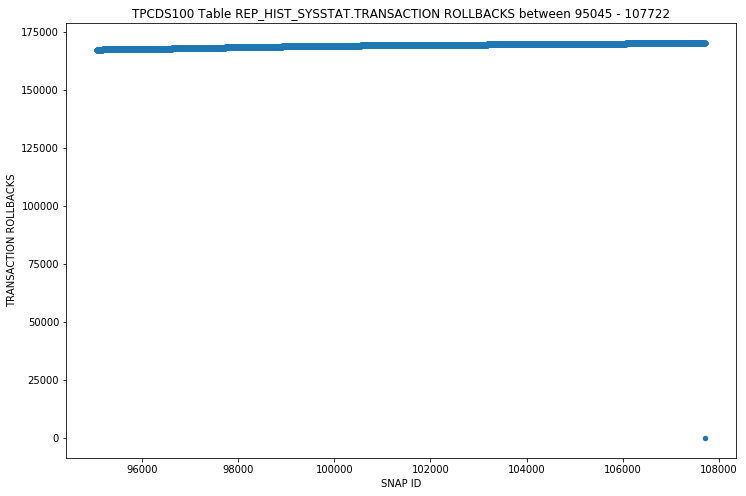

REP_HIST_SYSSTAT - TRANSACTION TABLES CONSISTENT READ ROLLBACKS - OUTLIERS SCATTER


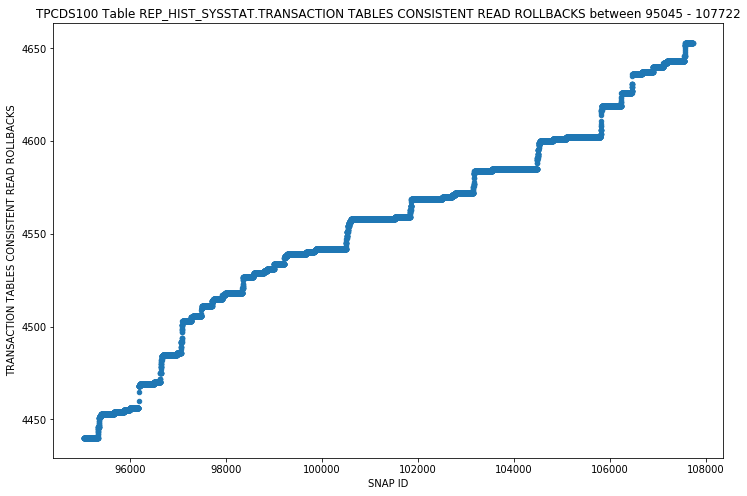

REP_HIST_SYSSTAT - TRANSACTION TABLES CONSISTENT READS - UNDO RECORDS APPLIED - OUTLIERS SCATTER


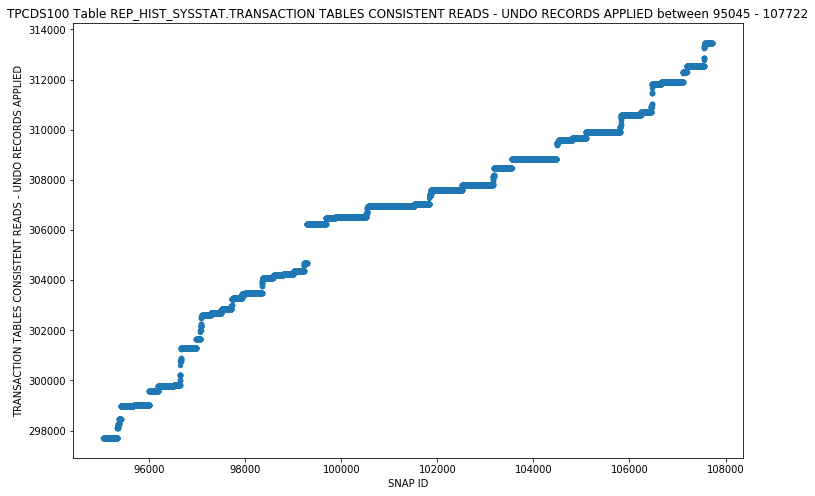

REP_HIST_SYSSTAT - UNDO CHANGE VECTOR SIZE - OUTLIERS SCATTER


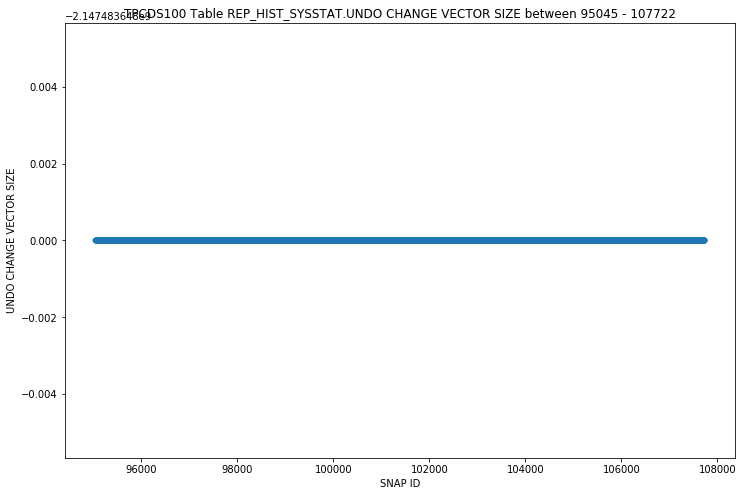

REP_HIST_SYSSTAT - USER I/O WAIT TIME - OUTLIERS SCATTER


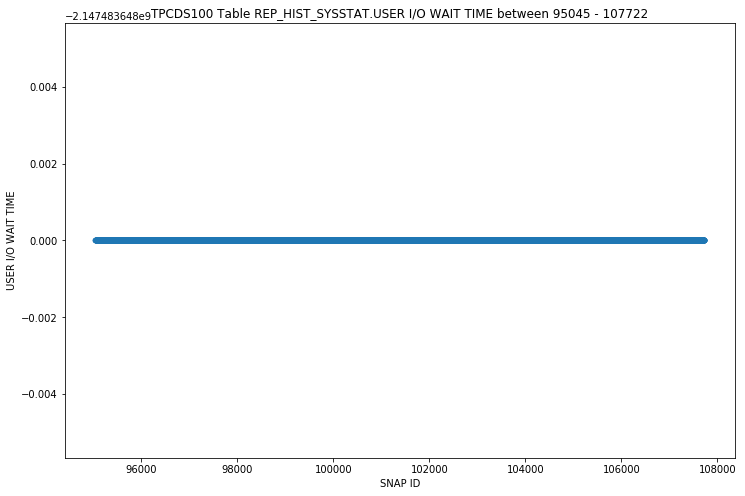

REP_HIST_SYSSTAT - USER CALLS - OUTLIERS SCATTER


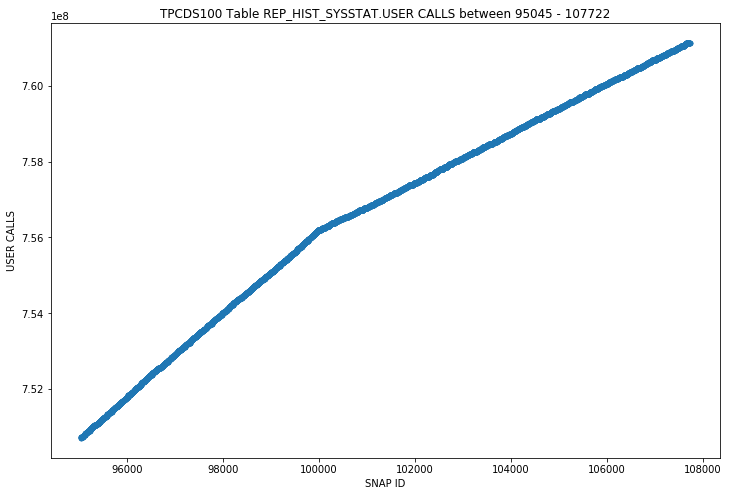

REP_HIST_SYSSTAT - USER COMMITS - OUTLIERS SCATTER


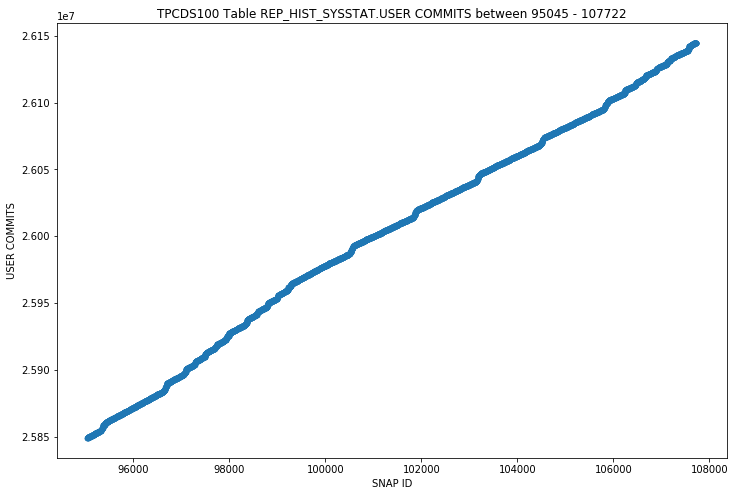

REP_HIST_SYSSTAT - USER LOGONS CUMULATIVE - OUTLIERS SCATTER


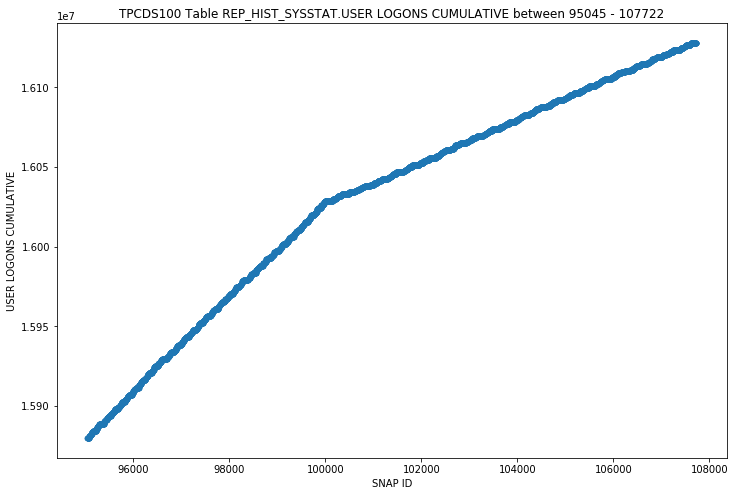

REP_HIST_SYSSTAT - USER LOGOUTS CUMULATIVE - OUTLIERS SCATTER


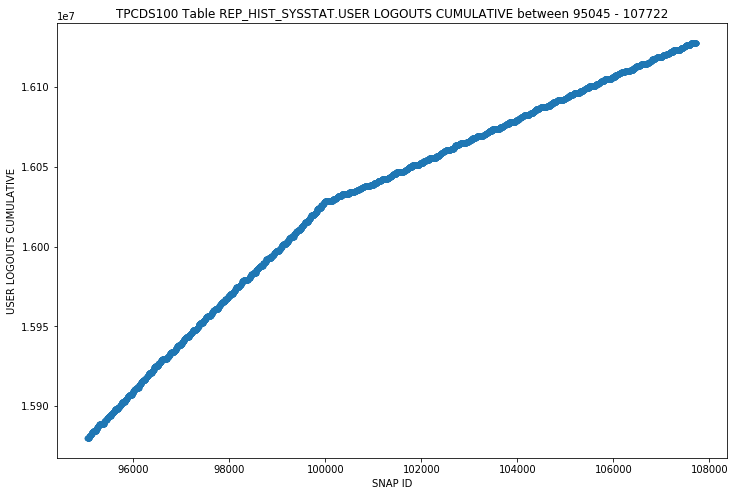

REP_HIST_SYSSTAT - USER ROLLBACKS - OUTLIERS SCATTER


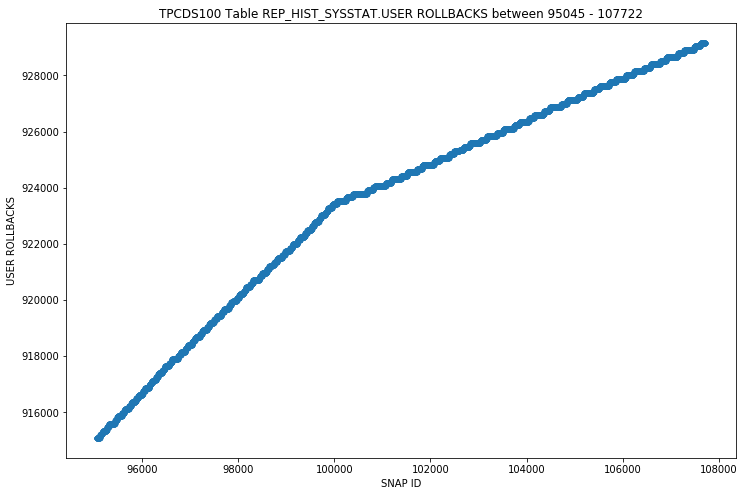

REP_HIST_SYSSTAT - WORKAREA EXECUTIONS - ONEPASS - OUTLIERS SCATTER


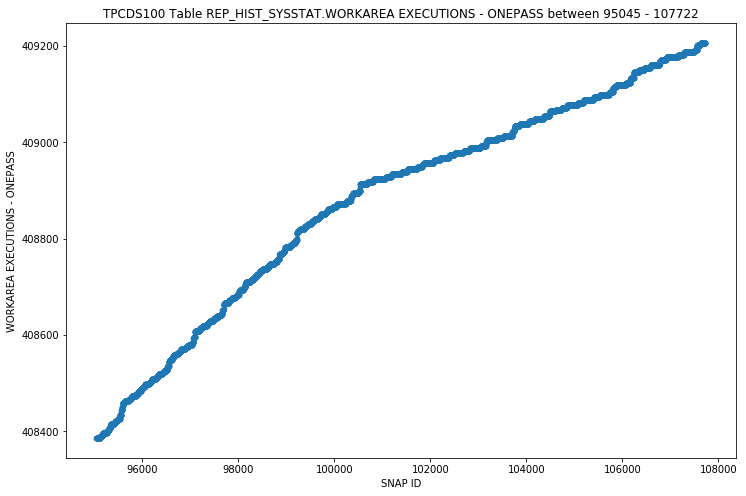

REP_HIST_SYSSTAT - WORKAREA EXECUTIONS - OPTIMAL - OUTLIERS SCATTER


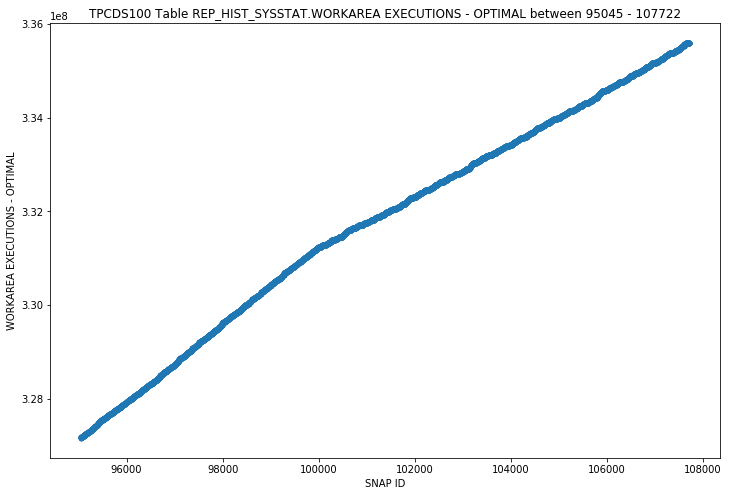

REP_HIST_SYSSTAT - WORKAREA MEMORY ALLOCATED - OUTLIERS SCATTER


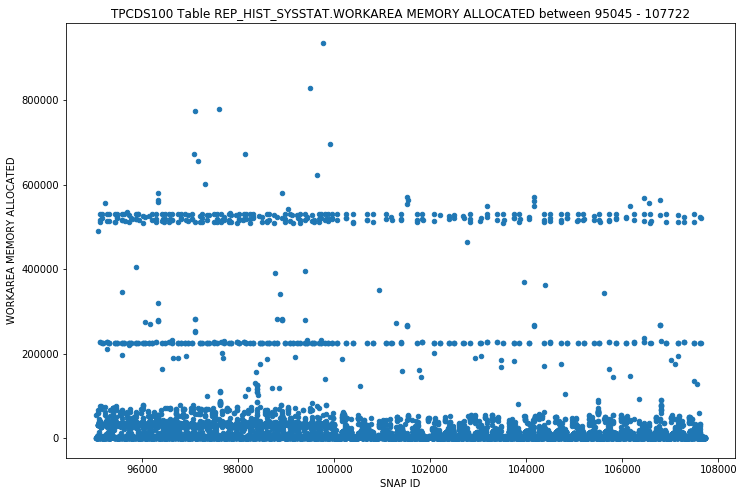

REP_HIST_SYSSTAT - WRITE CLONES CREATED IN BACKGROUND - OUTLIERS SCATTER


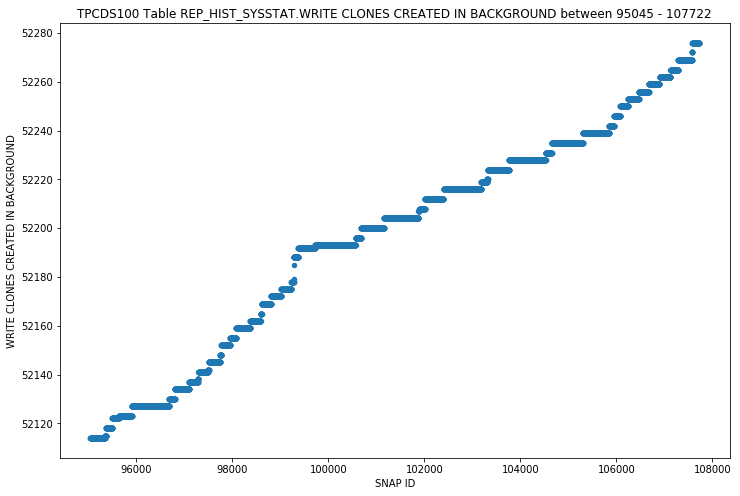

REP_HIST_SYSSTAT - WRITE CLONES CREATED IN FOREGROUND - OUTLIERS SCATTER


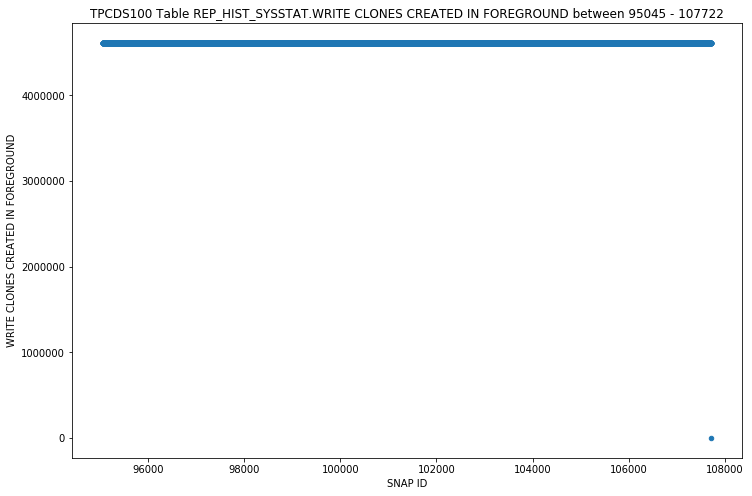

In [9]:
class Visualizer:
    """
    This class contains a number of methods dedicated to plotting the underlying data.
    """
    def __init__(self, df=None, tpc_type=None, table=None):
        """
        Constructor method.
        :param df:             (Pandas) Data matrix.
        :param tpc_type:       (String) TPC type, used for plot title purposes.
        :param table:          (String) Denotes which table is being access, used for plot title/label purposes.
        :return: None
        """
        self.__df = df
        self.__tpc_type = tpc_type
        self.__table = table
        
    def plot_hist(self, bin_size=10, feature_column=None):
        """
        Plots histogram distribution, split into a number of buckets.
        :param bin_size: (Integer) Denotes number of histogram buckets to split data into.
        :param feature_column: (String) Denotes which column to plot.
        :return: None
        """
        df = self.__df

        try:
            df['SNAP_ID'] = df['SNAP_ID'].astype(float)
            df[feature_column] = df[feature_column].astype(float)

            max_val = df[feature_column].max()
            start_snap, end_snap = int(df['SNAP_ID'].min()), int(df['SNAP_ID'].max())

            df[feature_column].hist(bins=10,figsize=(12,8))
            plt.ylabel(feature_column)
            plt.xlabel('Bin Ranges Of ' + str(int(max_val/bin_size)))
            plt.title(self.__tpc_type + ' Table ' + self.__table.upper() + '.' + str(feature_column) + " between " + str(start_snap) + " - " + str(end_snap))
            plt.show()
        except Exception:
            print('Could not plot column: ' + feature_column)

    def plot_scatter(self, feature_column=None):
        """
        Plots scatter plots vs SNAP_ID.
        :param feature_column: (String) Denotes which column to plot.
        :return: None
        """
        df = self.__df

        try:
            df['SNAP_ID'] = df['SNAP_ID'].astype(int)
            df[feature_column] = df[feature_column].astype(int)
            start_snap, end_snap = int(df['SNAP_ID'].min()), int(df['SNAP_ID'].max())

            df.plot.scatter(x='SNAP_ID',
                            y=feature_column,
                            figsize=(12,8))
            plt.ylabel(feature_column)
            plt.xlabel('SNAP ID')
            plt.title(self.__tpc_type + ' Table ' + self.__table.upper() + '.' + str(feature_column) + " between " + str(start_snap) + " - " + str(end_snap))
            plt.show()
        except Exception:
            print('Could not plot column: ' + feature_column)

    def plot_boxplot(self, feature_column=None):
        """
        Plots quartile plots to estimate mean and sigma (std dev).
        :param feature_column: (String) String denoting feature column. Overrides parameter used in class constructor.
        :return: None
        """
        df = self.__df

        try:
            df[feature_column] = df[feature_column].astype(float)
            df.boxplot(column=feature_column, figsize=(12,8), grid=True)
            plt.title(self.__tpc_type + ' ' + str(feature_column))
            plt.show()
        except ValueError:
            print('Could not plot column: ' + feature_column)
            
vis = Visualizer(df=rep_hist_sysstat_df, 
                 tpc_type=tpcds, 
                 table='rep_hist_sysstat')

if debug_mode is False:
    
    # Plotting Histograms of data distribution
    for header in rep_hist_sysstat_df.columns:
        print('REP_HIST_SYSSTAT - ' + header + ' - OUTLIERS HISTOGRAM')
        vis.plot_hist(bin_size=10, feature_column=header)
    
    # Plotting Scatter Plots of data distribution
    for header in rep_hist_sysstat_df.columns:
        print('REP_HIST_SYSSTAT - ' + header + ' - OUTLIERS SCATTER')
        vis.plot_scatter(feature_column=header)

### Outlier Handling

https://machinelearningmastery.com/how-to-identify-outliers-in-your-data/

As can be appreciated from the previous plots, data is heavily skewed on particular (smallest) bins. This skew in the plotted histograms is a result of data point outliers - these need to be evaluated and removed if neccessary.

Following the 3 Standard Deviation Rule, we can categorize our dataset into subsets consisting of the following ranges:
* 0     - 68.27%
* 68.28 - 95.45%
* 95.46 - 99.73%
* 99.74 - 100%

It should be mentioned, that given the time series nature of the dataset, it is not a safe assumption to ignore outliers. By training respective models on outlier insensitive dataset, we would invite a potential problem, which risks blinding any models we train to future predicted spikes of activity.

In [10]:
class OutlierHandling:
    """
    This class handles outlier detection and removal methods.
    """
    def __init__(self, df, low_quartile_limit=.01,upper_quartile_limit=.99):
        """
        Constructor method.
        :param df:                   (Pandas) Dataframe consisting of input features to be pruned of outliers.
        :param low_quartile_limit:   (Float) Lower percentage threshold for removal of outliers.
        :param upper_quartile_limit: (Float) Upper percentage threshold for removal of outliers.
        :return: None
        """
        self.__df = df
        self.__low_quartile_limit = low_quartile_limit
        self.__upper_quartile_limit = upper_quartile_limit
        self.__headers= df.columns
        
    def get_outliers(self):
        """
        Detect and return which rows are considered outliers within the dataset, determined by :quartile_limit (99%)
        :return: (List) A list denoting row positions of detected outliers.
        """
        outlier_rows = [] # This list of lists consists of elements of the following notation [column,rowid]
        df = self.__df
        for header in self.__headers:
            try:
                df[header] = df[header].astype(float)
                q = df[header].quantile(self.__upper_quartile_limit)
                series_row = (df[df[header] > q].index)
                for id in list(np.array(series_row)):
                    outlier_rows.append([header,id])
                q = df[header].quantile(self.__low_quartile_limit)
                series_row = (df[df[header] < q].index)
                for id in list(np.array(series_row)):
                    outlier_rows.append([header,id])
            except Exception as e:
                print(str(e))

        unique_ids = []
        unique_outlier_rows = []

        for col, rowid in outlier_rows:
            if rowid not in unique_ids:
                unique_outlier_rows.append([col,rowid])
                unique_ids.append(rowid)
        return unique_outlier_rows

    def remove_outliers(self):
        """
        Remove rows which are considered outliers within the dataset, determined by :quartile_limit (99%).
        :return: (Pandas) Dataframe with pruned outliers.
        """
        df = self.__df
        length_before = len(df)
        outliers_index = []
        for header in self.__headers:
            try:
                df[header] = df[header].astype(float)
                q = df[header].quantile(self.__upper_quartile_limit)
                outliers_index.append(list(np.array(df[df[header] > q].index)))
                q = df[header].quantile(self.__low_quartile_limit)
                outliers_index.append(list(np.array(df[df[header] < q].index)))
            except Exception as e:
                print(str(e))
        #flat_outliers_index = [item for sublist in l for item in outliers_index]
        flat_outliers_index = [item for sublist in outliers_index for item in sublist]
        outliers_index = list(set(flat_outliers_index))
        df = df.drop(outliers_index)
        return df
    
oh = OutlierHandling(df=rep_hist_sysstat_df,
                     upper_quartile_limit=upper_quartile_limit,
                     low_quartile_limit=low_quartile_limit)

#Printing outliers to screen
outliers = oh.get_outliers()

# Printing dataframe before adjustments
print('\n\nDATAFRAMES WITH OUTLIERS')
print(rep_hist_sysstat_df.shape)
print('----------------------------')

rep_hist_sysstat_df_outliers = oh.get_outliers()
print('\n\nOUTLIERS')
print(len(rep_hist_sysstat_df_outliers))
print('----------------------------')

# Dropping Outliers
rep_hist_sysstat_df_pruned = oh.remove_outliers()
print('\n\nDATAFRAMES WITHOUT OUTLIERS')
print(rep_hist_sysstat_df_pruned.shape)



DATAFRAMES WITH OUTLIERS
(12678, 325)
----------------------------


OUTLIERS
117
----------------------------


DATAFRAMES WITHOUT OUTLIERS
(12561, 325)


### Plotting data distribution without outliers

Plotting metrics against SNAP_ID, without outliers.

REP_HIST_SYSSTAT - SNAP_ID - STRIPPED HISTOGRAM


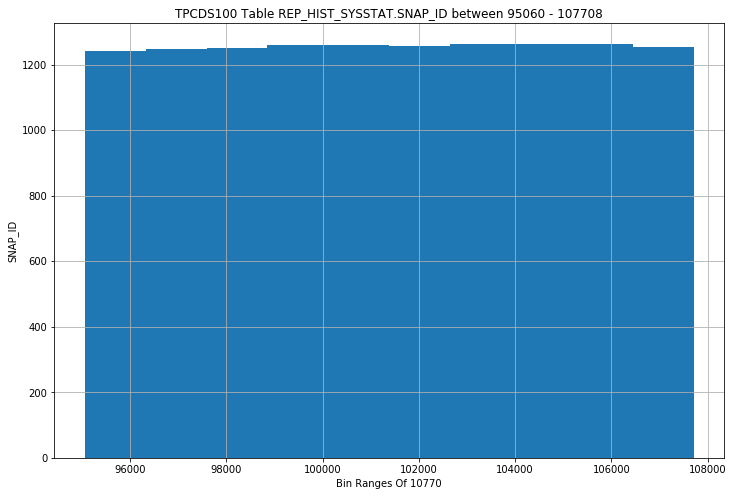

REP_HIST_SYSSTAT - BATCHED IO (BOUND) VECTOR COUNT - STRIPPED HISTOGRAM


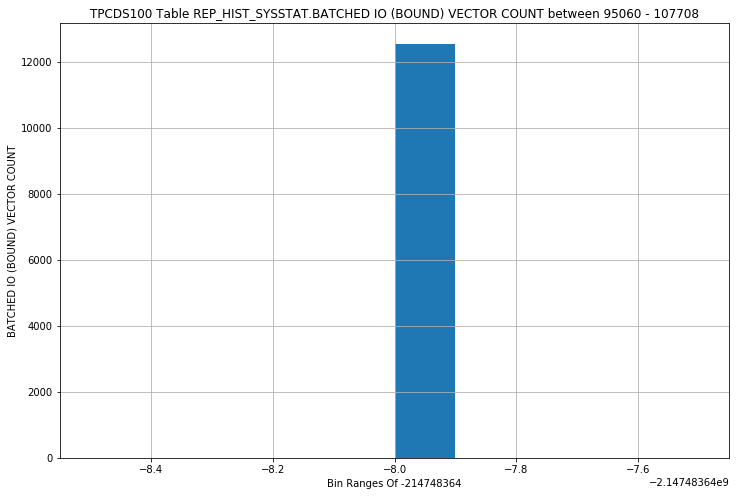

REP_HIST_SYSSTAT - BATCHED IO (FULL) VECTOR COUNT - STRIPPED HISTOGRAM


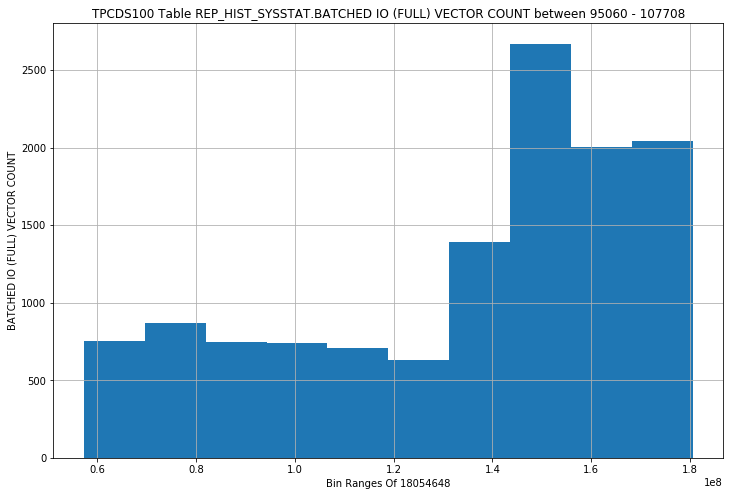

REP_HIST_SYSSTAT - BATCHED IO (SPACE) VECTOR COUNT - STRIPPED HISTOGRAM


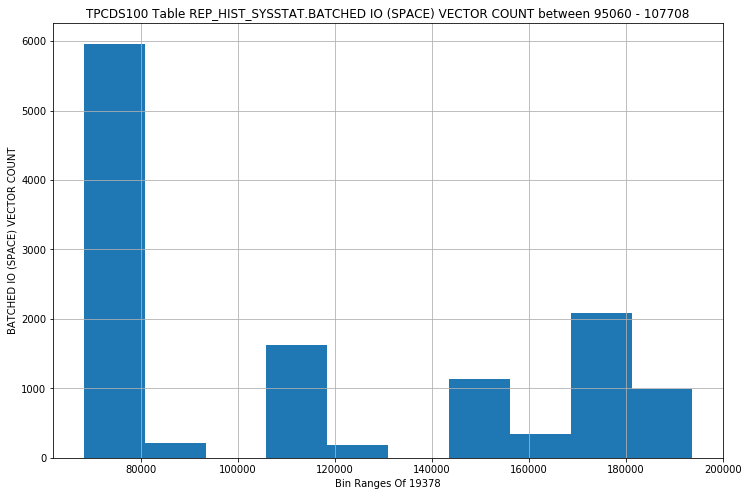

REP_HIST_SYSSTAT - BATCHED IO BLOCK MISS COUNT - STRIPPED HISTOGRAM


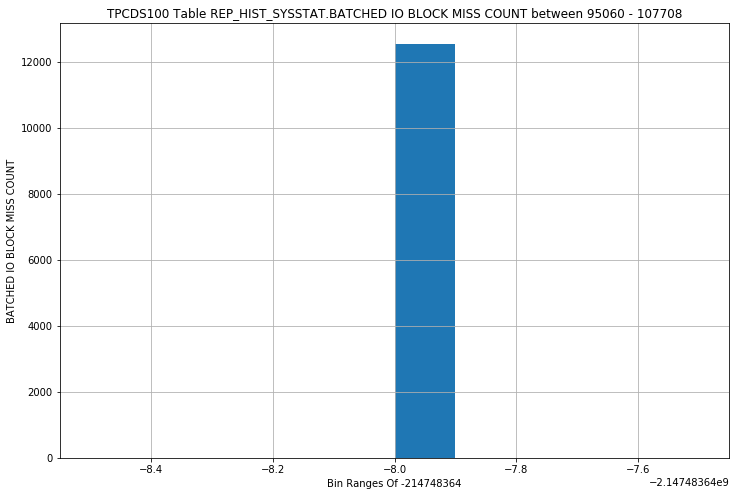

REP_HIST_SYSSTAT - BATCHED IO BUFFER DEFRAG COUNT - STRIPPED HISTOGRAM


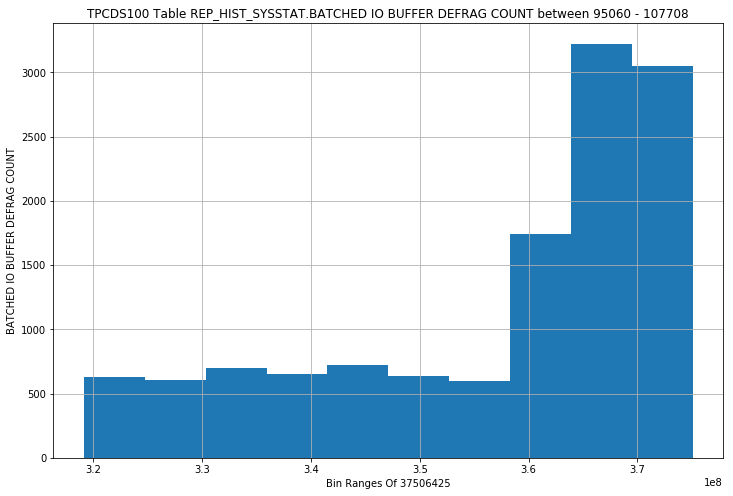

REP_HIST_SYSSTAT - BATCHED IO DOUBLE MISS COUNT - STRIPPED HISTOGRAM


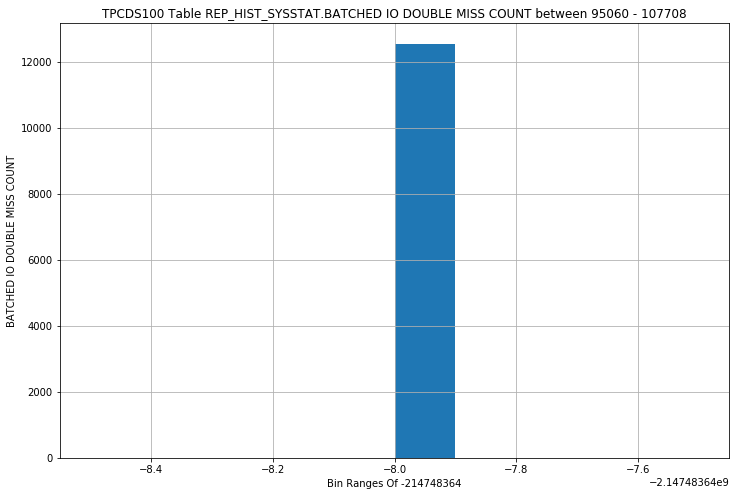

REP_HIST_SYSSTAT - BATCHED IO SAME UNIT COUNT - STRIPPED HISTOGRAM


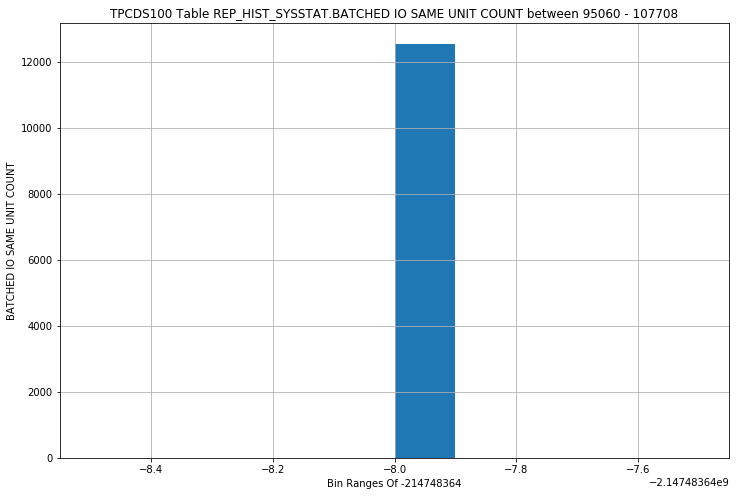

REP_HIST_SYSSTAT - BATCHED IO SINGLE BLOCK COUNT - STRIPPED HISTOGRAM


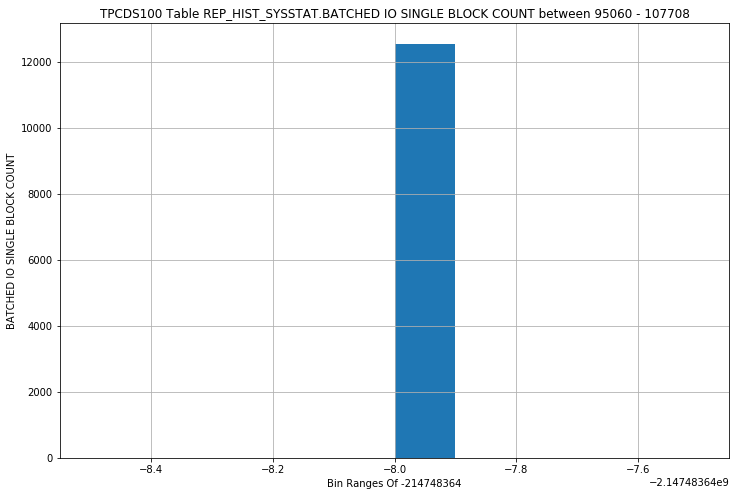

REP_HIST_SYSSTAT - BATCHED IO SLOW JUMP COUNT - STRIPPED HISTOGRAM


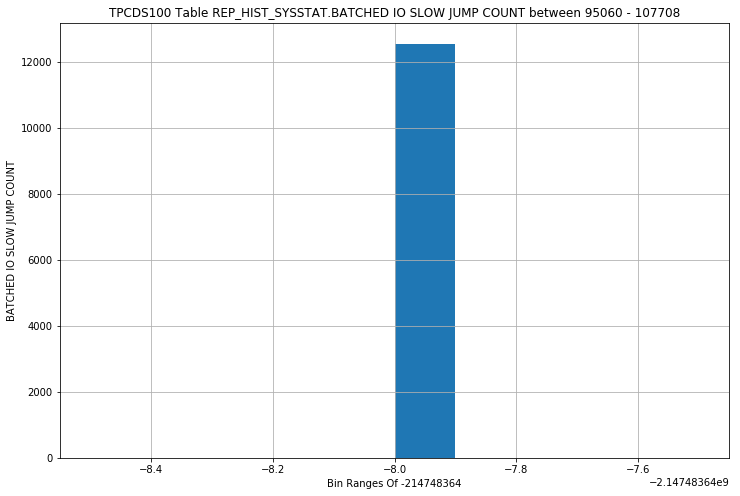

REP_HIST_SYSSTAT - BATCHED IO VECTOR BLOCK COUNT - STRIPPED HISTOGRAM


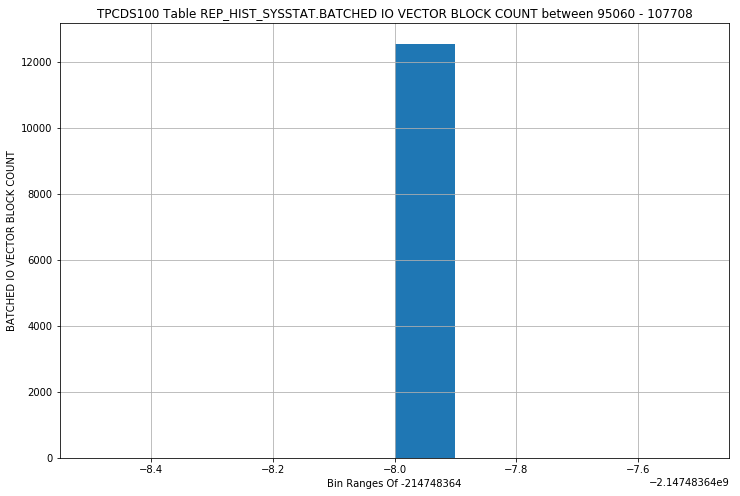

REP_HIST_SYSSTAT - BATCHED IO VECTOR READ COUNT - STRIPPED HISTOGRAM


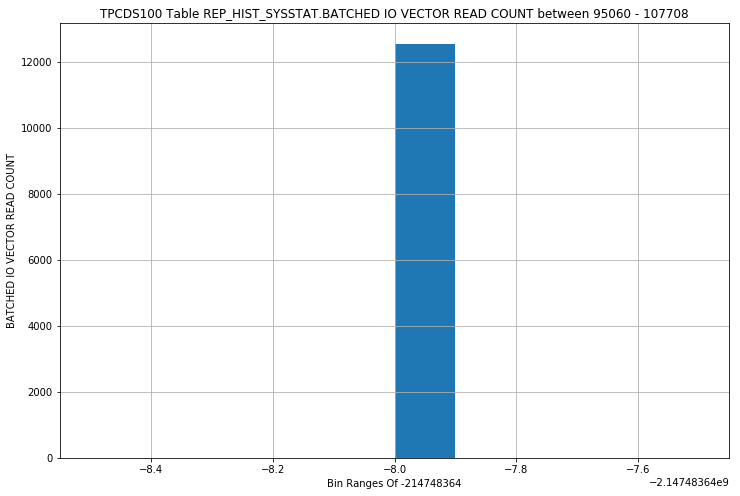

REP_HIST_SYSSTAT - BLOCK CLEANOUT OPTIM REFERENCED - STRIPPED HISTOGRAM


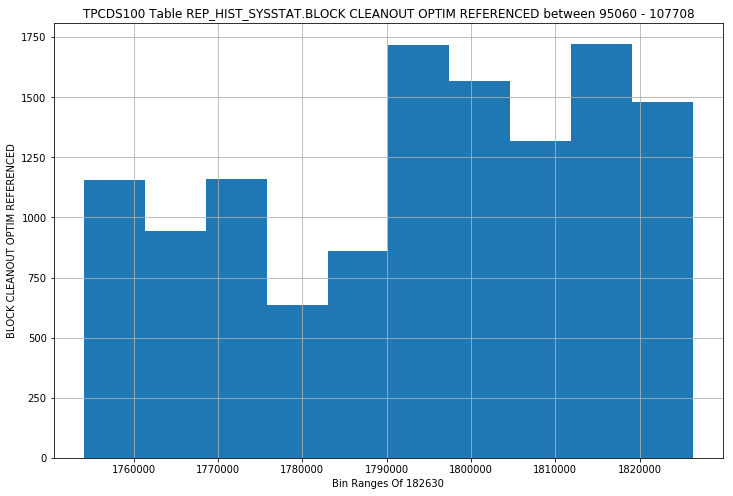

REP_HIST_SYSSTAT - CCURSOR + SQL AREA EVICTED - STRIPPED HISTOGRAM


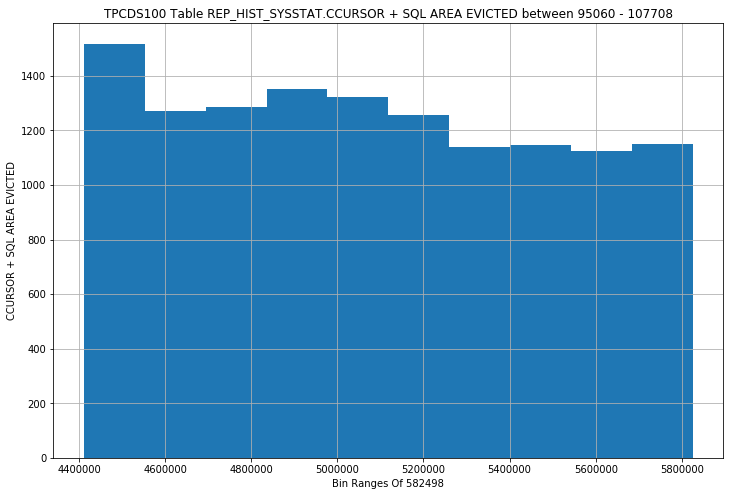

REP_HIST_SYSSTAT - CLI BG ENQ - STRIPPED HISTOGRAM


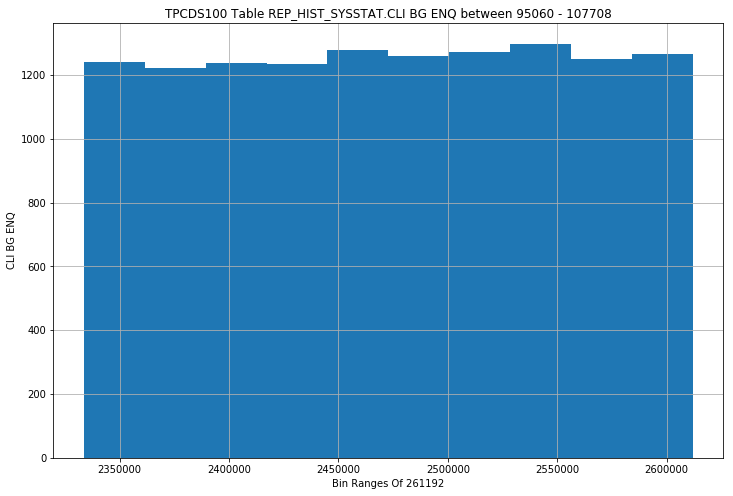

REP_HIST_SYSSTAT - CLI BG ATTEMPT FLUSH - STRIPPED HISTOGRAM


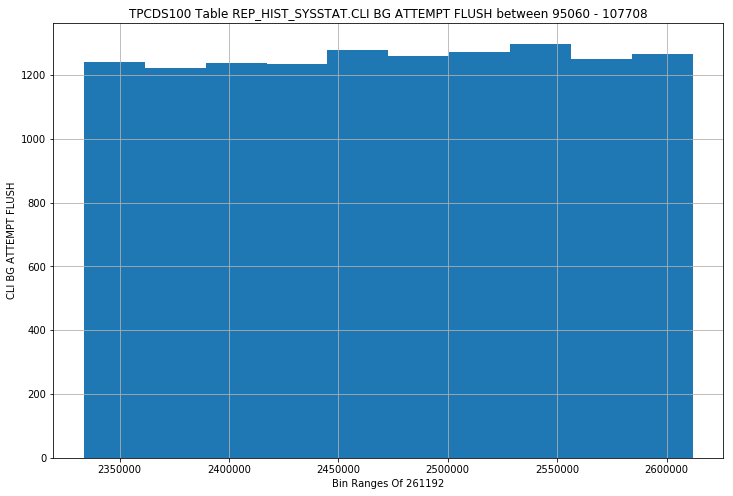

REP_HIST_SYSSTAT - CLI FLSTASK CREATE - STRIPPED HISTOGRAM


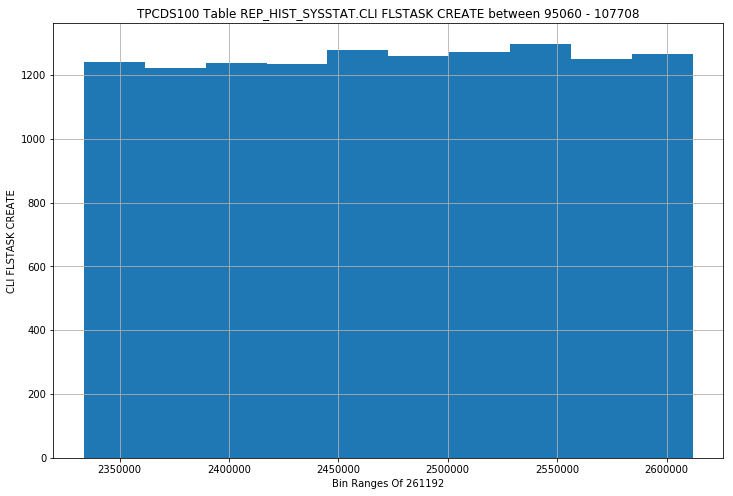

REP_HIST_SYSSTAT - CLI FLUSH - STRIPPED HISTOGRAM


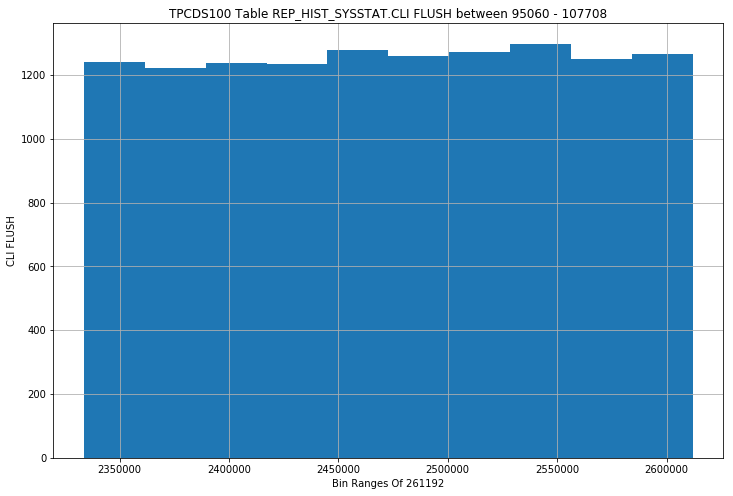

REP_HIST_SYSSTAT - CPU USED BY THIS SESSION - STRIPPED HISTOGRAM


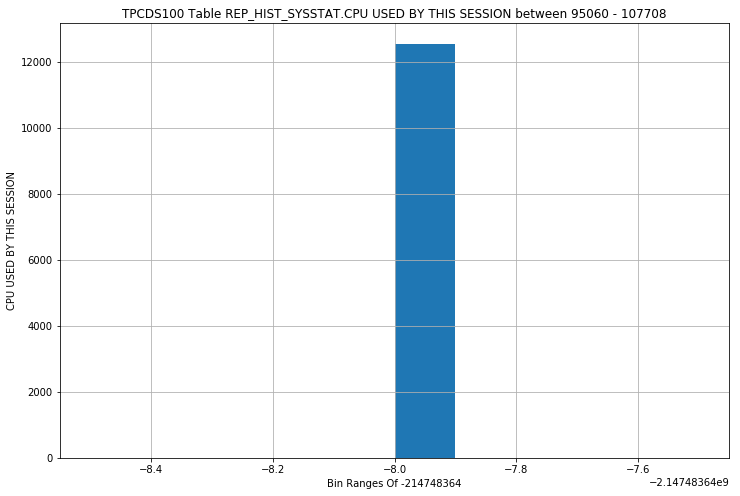

REP_HIST_SYSSTAT - CPU USED WHEN CALL STARTED - STRIPPED HISTOGRAM


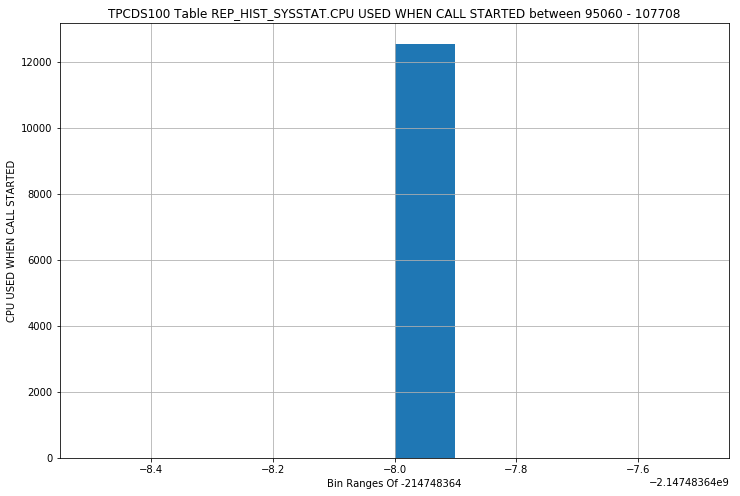

REP_HIST_SYSSTAT - CR BLOCKS CREATED - STRIPPED HISTOGRAM


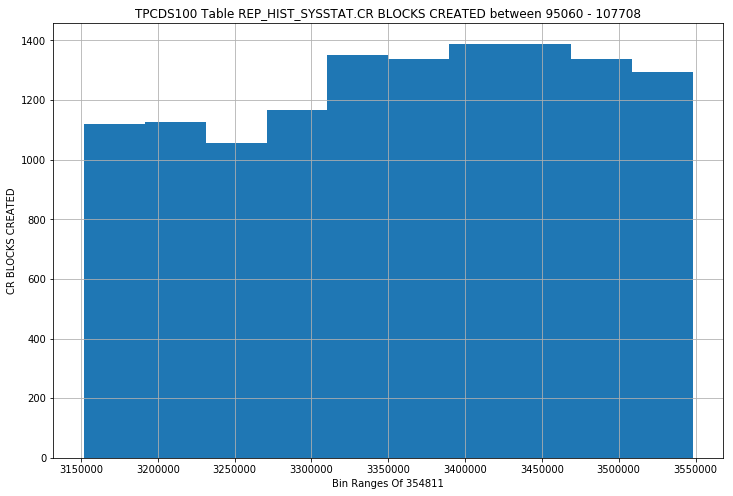

REP_HIST_SYSSTAT - CACHED COMMIT SCN REFERENCED - STRIPPED HISTOGRAM


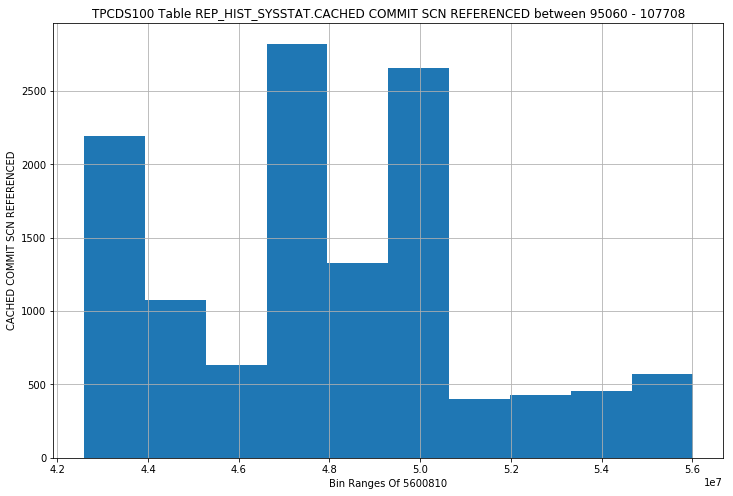

REP_HIST_SYSSTAT - COMMIT SCN CACHED - STRIPPED HISTOGRAM


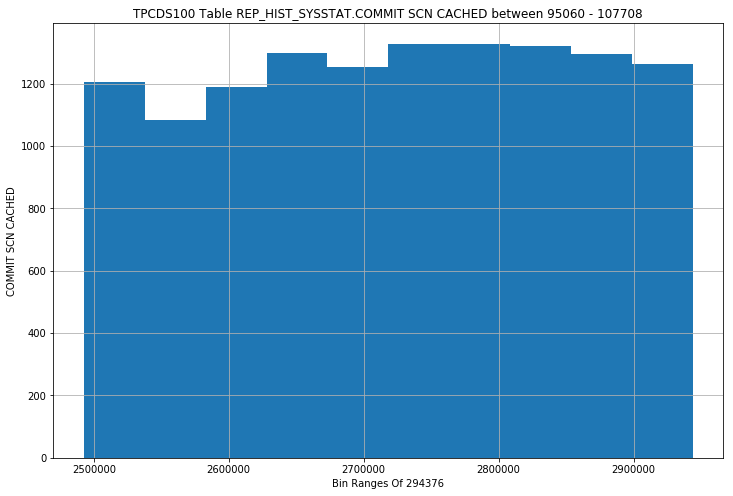

REP_HIST_SYSSTAT - DB TIME - STRIPPED HISTOGRAM


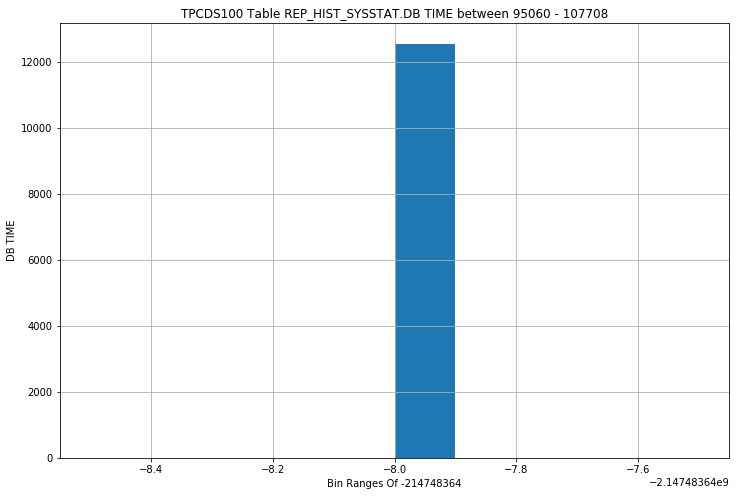

REP_HIST_SYSSTAT - DBWR CHECKPOINT BUFFERS WRITTEN - STRIPPED HISTOGRAM


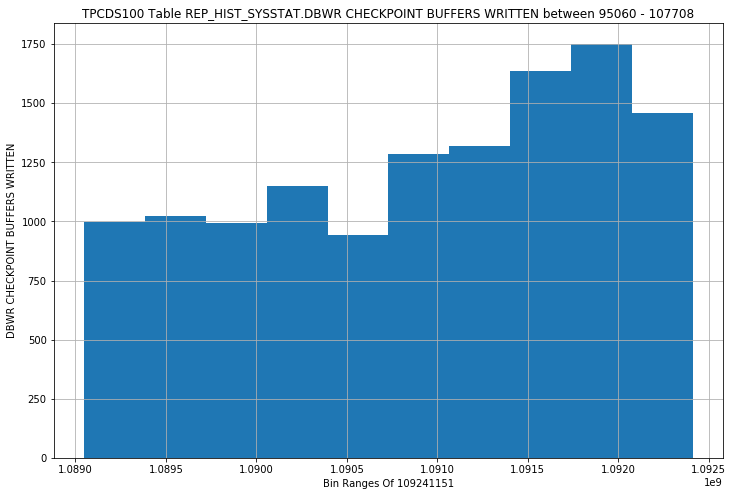

REP_HIST_SYSSTAT - DBWR CHECKPOINTS - STRIPPED HISTOGRAM


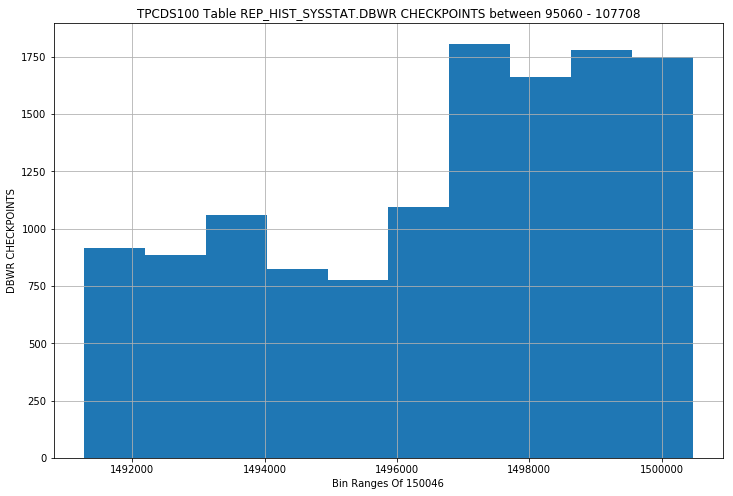

REP_HIST_SYSSTAT - DBWR OBJECT DROP BUFFERS WRITTEN - STRIPPED HISTOGRAM


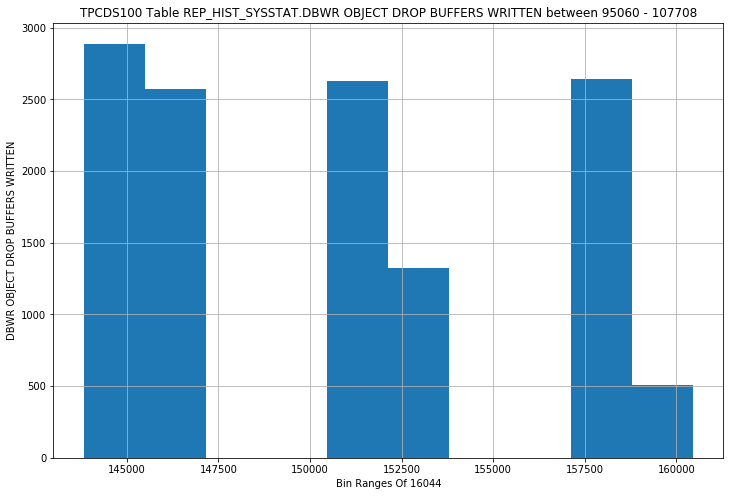

REP_HIST_SYSSTAT - DBWR PARALLEL QUERY CHECKPOINT BUFFERS WRITTEN - STRIPPED HISTOGRAM


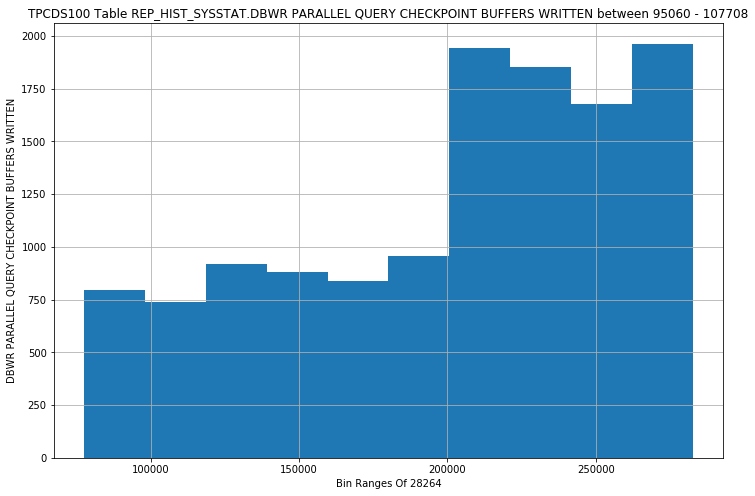

REP_HIST_SYSSTAT - DBWR REVISITED BEING-WRITTEN BUFFER - STRIPPED HISTOGRAM


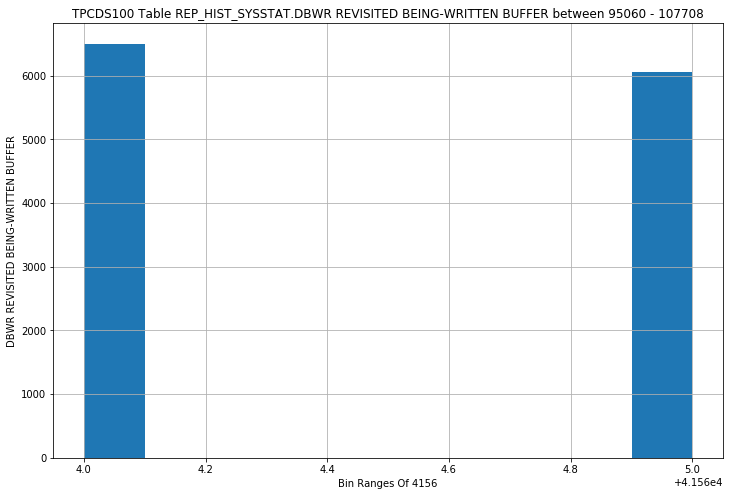

REP_HIST_SYSSTAT - DBWR THREAD CHECKPOINT BUFFERS WRITTEN - STRIPPED HISTOGRAM


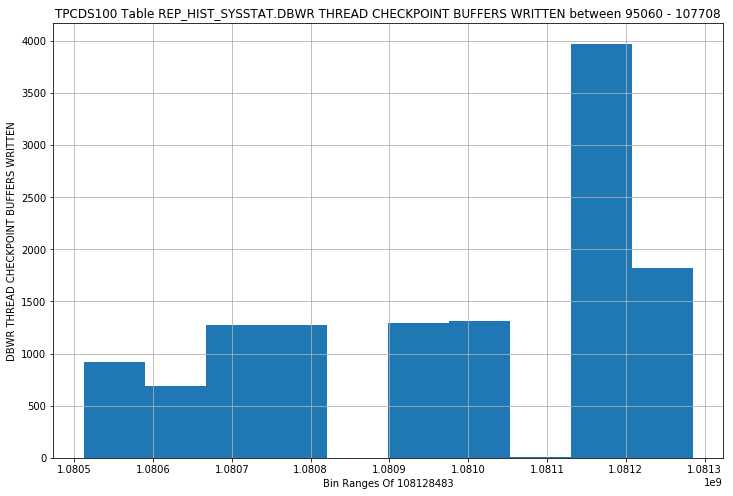

REP_HIST_SYSSTAT - DBWR TRANSACTION TABLE WRITES - STRIPPED HISTOGRAM


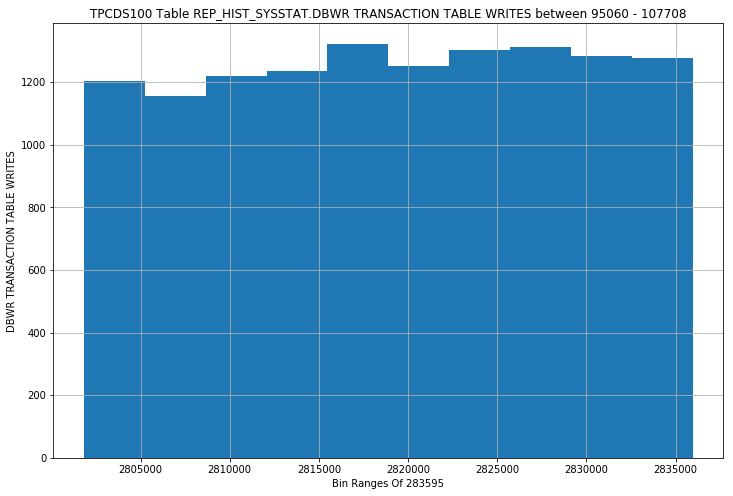

REP_HIST_SYSSTAT - DBWR UNDO BLOCK WRITES - STRIPPED HISTOGRAM


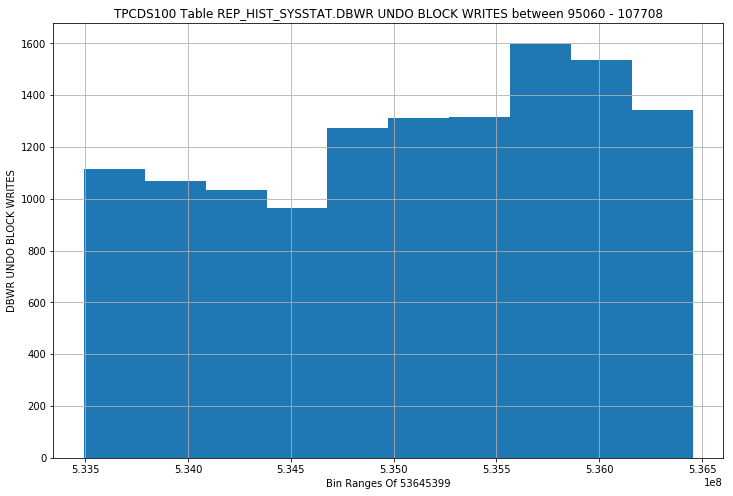

REP_HIST_SYSSTAT - DDL STATEMENTS PARALLELIZED - STRIPPED HISTOGRAM


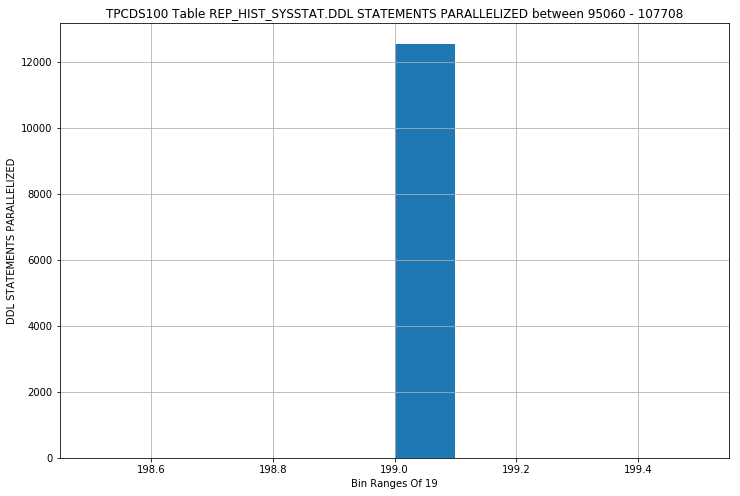

REP_HIST_SYSSTAT - DFO TREES PARALLELIZED - STRIPPED HISTOGRAM


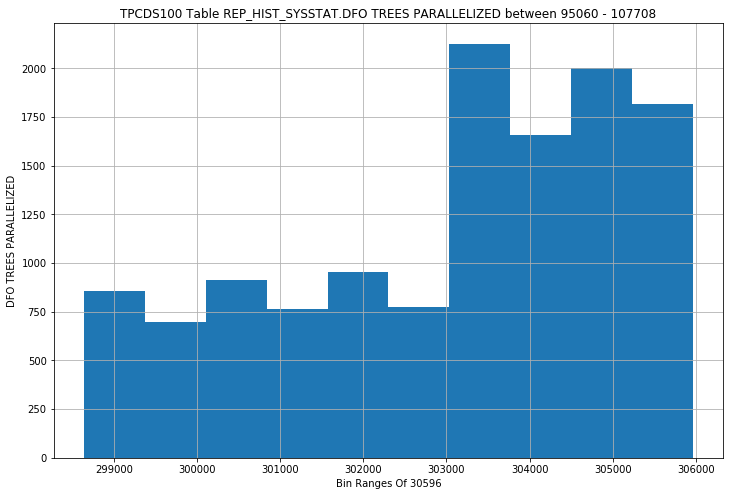

REP_HIST_SYSSTAT - EFFECTIVE IO TIME - STRIPPED HISTOGRAM


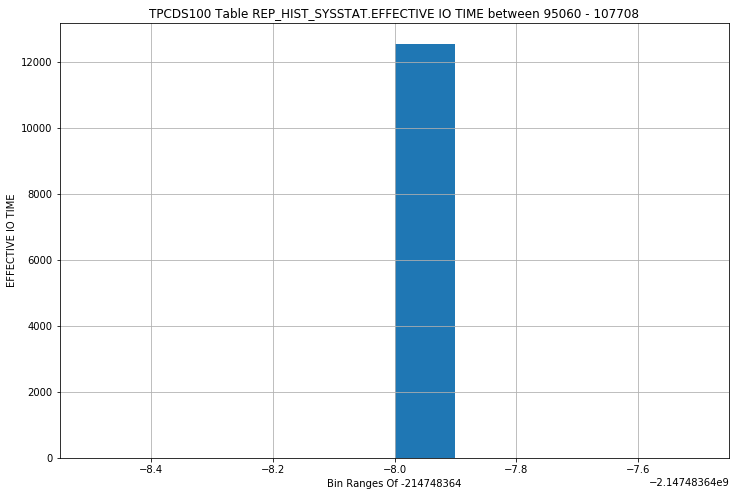

REP_HIST_SYSSTAT - HSC HEAP SEGMENT BLOCK CHANGES - STRIPPED HISTOGRAM


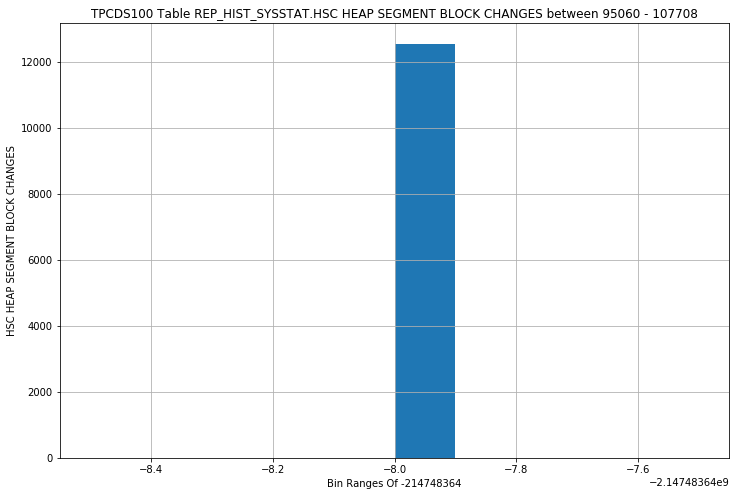

REP_HIST_SYSSTAT - HEAP SEGMENT ARRAY INSERTS - STRIPPED HISTOGRAM


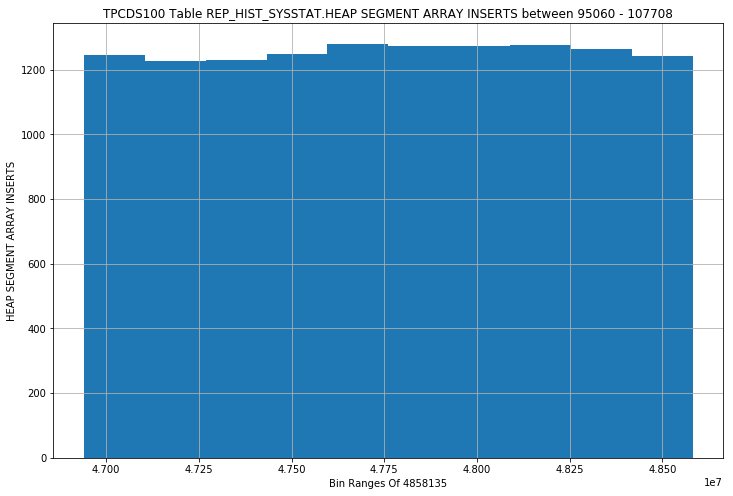

REP_HIST_SYSSTAT - HEAP SEGMENT ARRAY UPDATES - STRIPPED HISTOGRAM


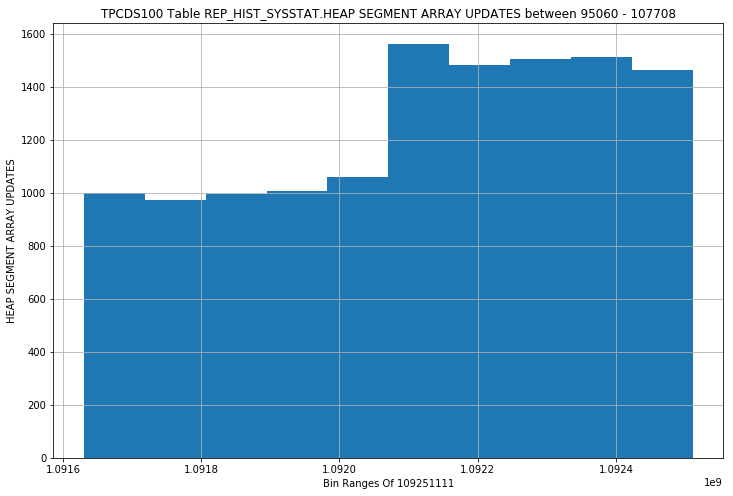

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSHED - STRIPPED HISTOGRAM


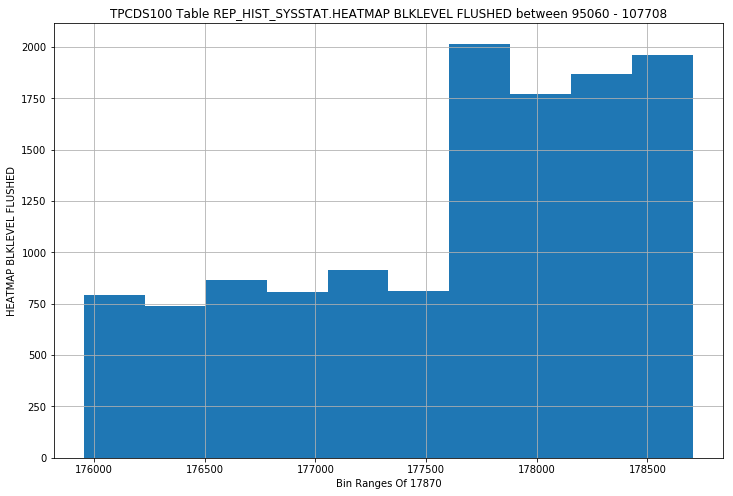

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSHED TO BF - STRIPPED HISTOGRAM


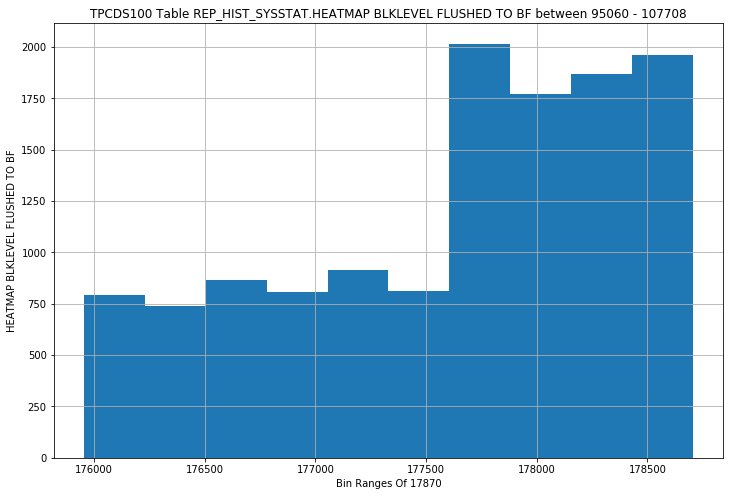

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL RANGES FLUSHED - STRIPPED HISTOGRAM


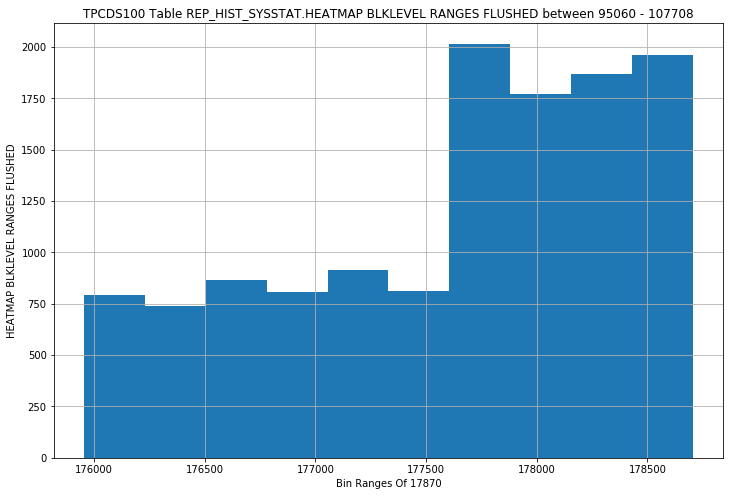

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSH TASK COUNT - STRIPPED HISTOGRAM


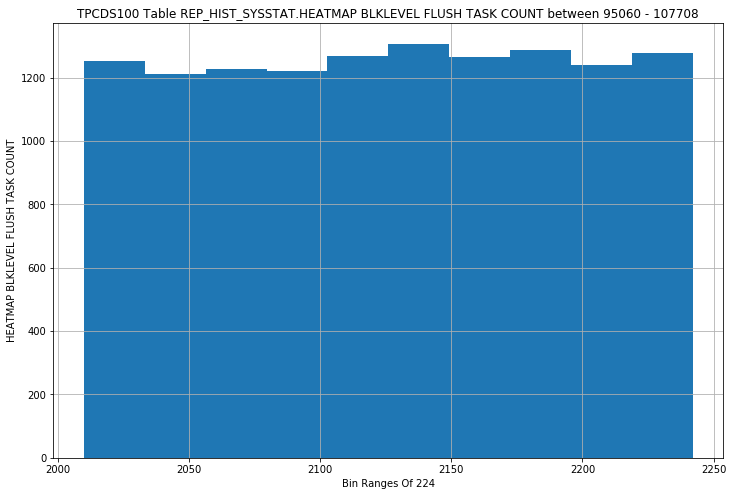

REP_HIST_SYSSTAT - IMU CR ROLLBACKS - STRIPPED HISTOGRAM


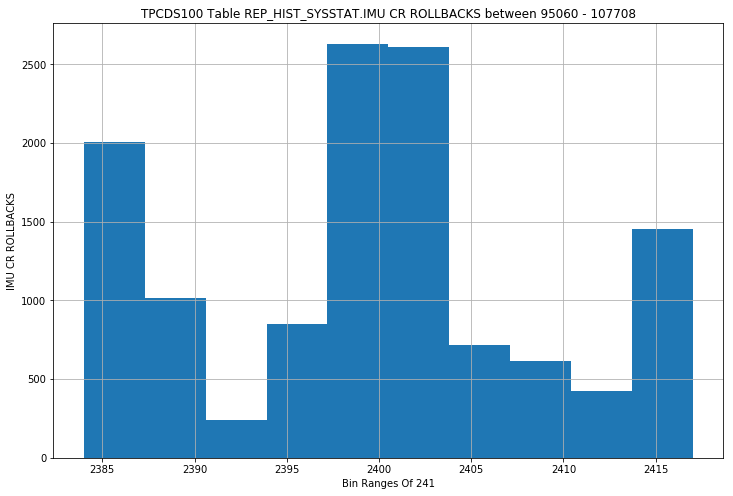

REP_HIST_SYSSTAT - IMU FLUSHES - STRIPPED HISTOGRAM


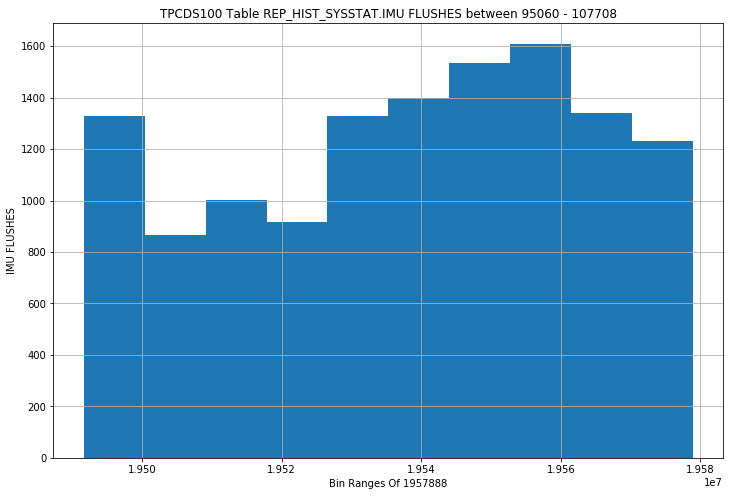

REP_HIST_SYSSTAT - IMU REDO ALLOCATION SIZE - STRIPPED HISTOGRAM


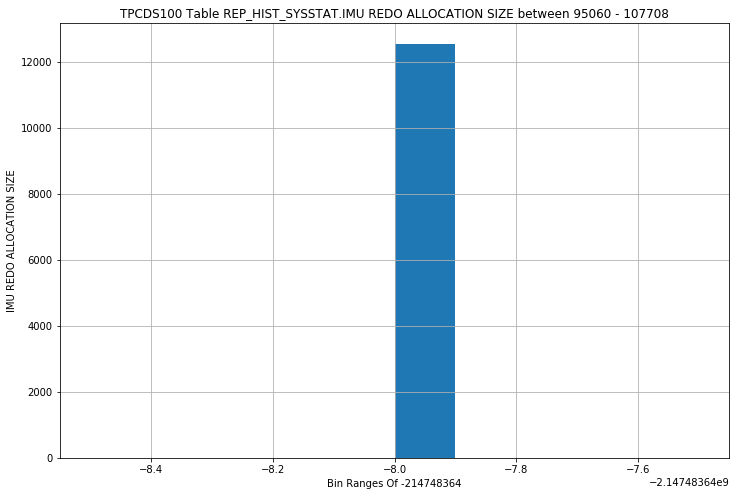

REP_HIST_SYSSTAT - IMU COMMITS - STRIPPED HISTOGRAM


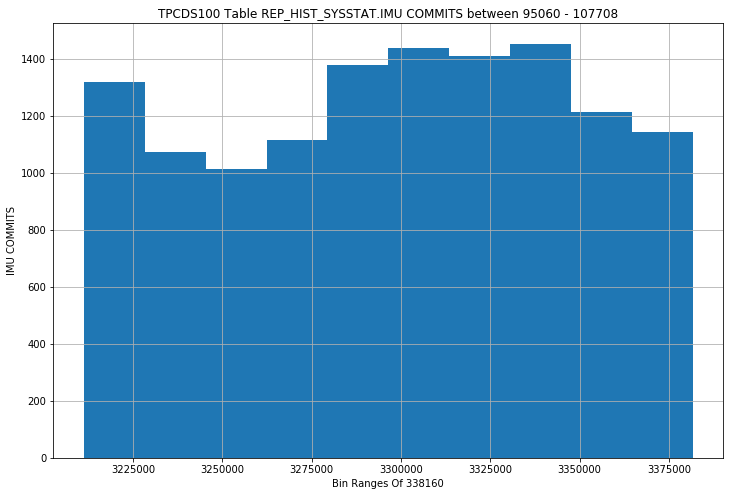

REP_HIST_SYSSTAT - IMU CONTENTION - STRIPPED HISTOGRAM


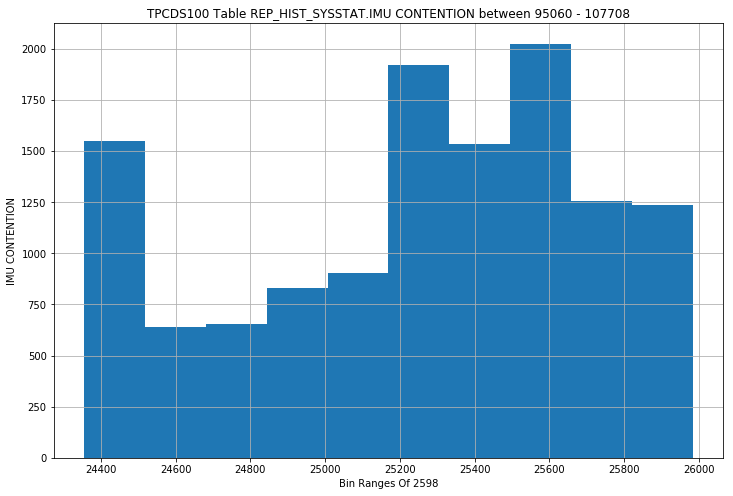

REP_HIST_SYSSTAT - IMU KTICHG FLUSH - STRIPPED HISTOGRAM


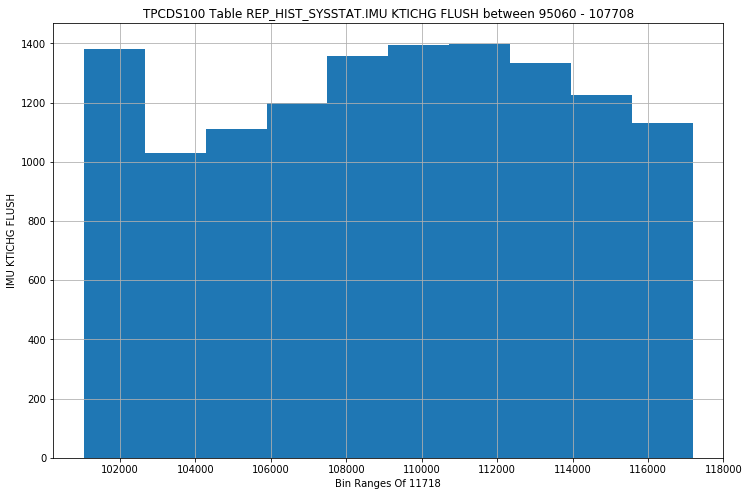

REP_HIST_SYSSTAT - IMU POOL NOT ALLOCATED - STRIPPED HISTOGRAM


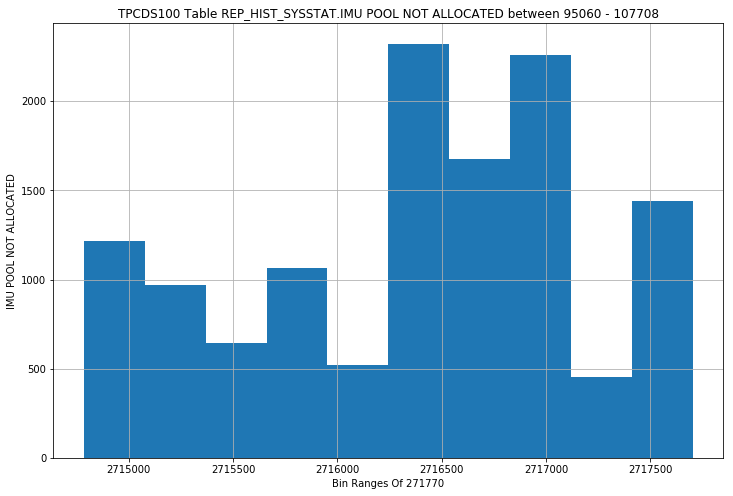

REP_HIST_SYSSTAT - IMU RECURSIVE-TRANSACTION FLUSH - STRIPPED HISTOGRAM


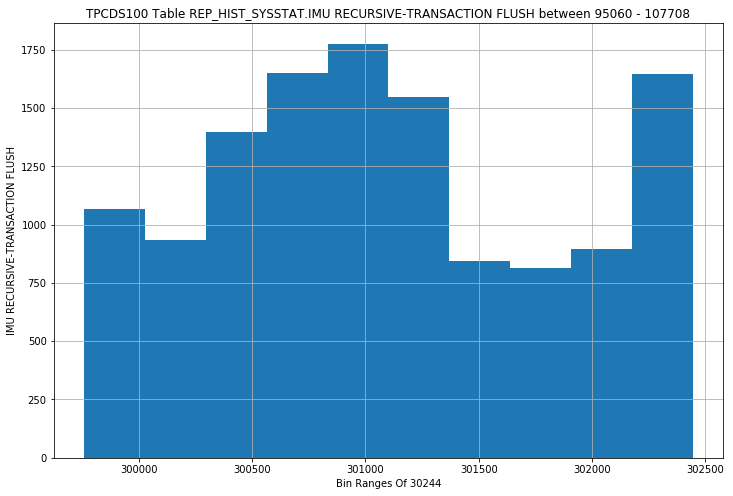

REP_HIST_SYSSTAT - IMU UNDO ALLOCATION SIZE - STRIPPED HISTOGRAM


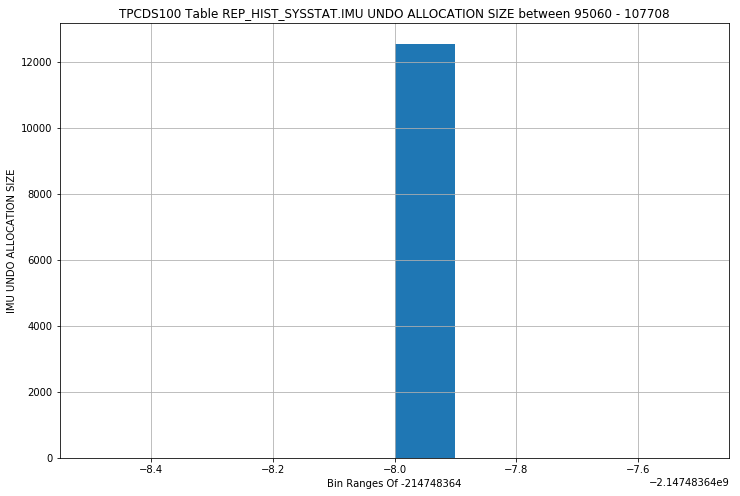

REP_HIST_SYSSTAT - IMU- FAILED TO GET A PRIVATE STRAND - STRIPPED HISTOGRAM


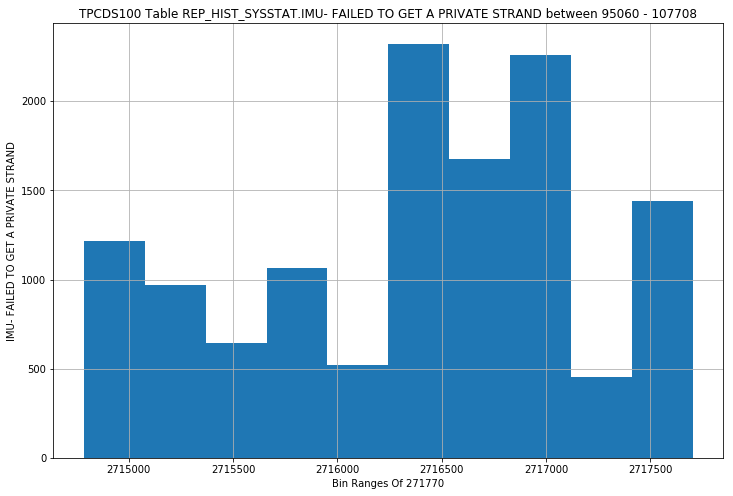

REP_HIST_SYSSTAT - KTFB ALLOC REQ - STRIPPED HISTOGRAM


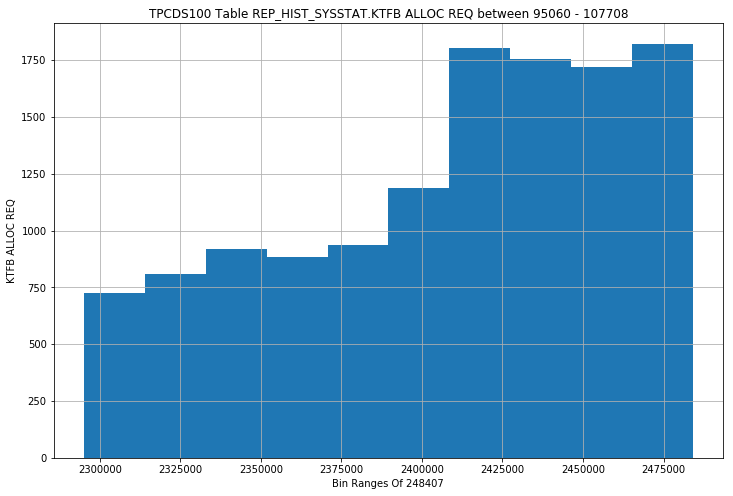

REP_HIST_SYSSTAT - KTFB ALLOC SPACE (BLOCK) - STRIPPED HISTOGRAM


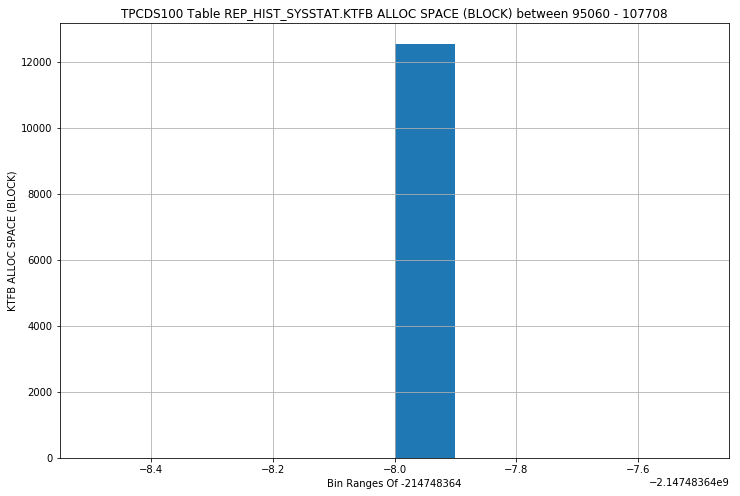

REP_HIST_SYSSTAT - KTFB ALLOC TIME (MS) - STRIPPED HISTOGRAM


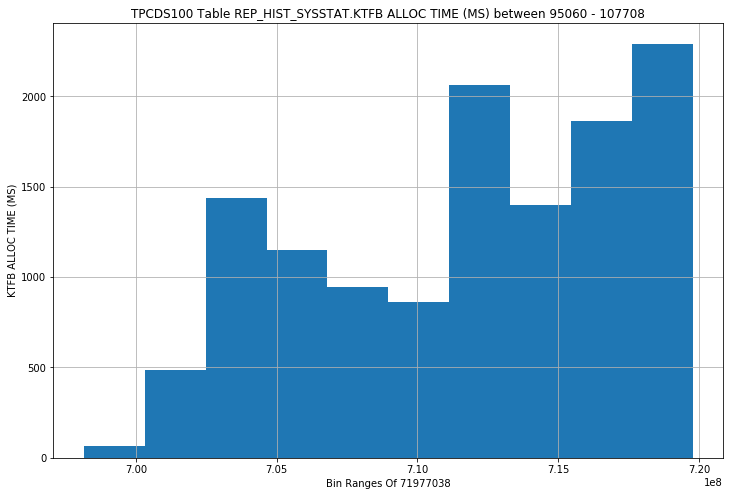

REP_HIST_SYSSTAT - KTFB APPLY REQ - STRIPPED HISTOGRAM


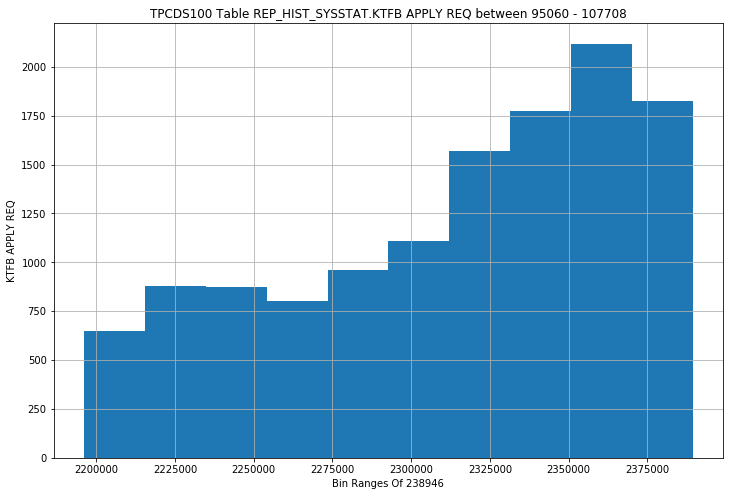

REP_HIST_SYSSTAT - KTFB APPLY TIME (MS) - STRIPPED HISTOGRAM


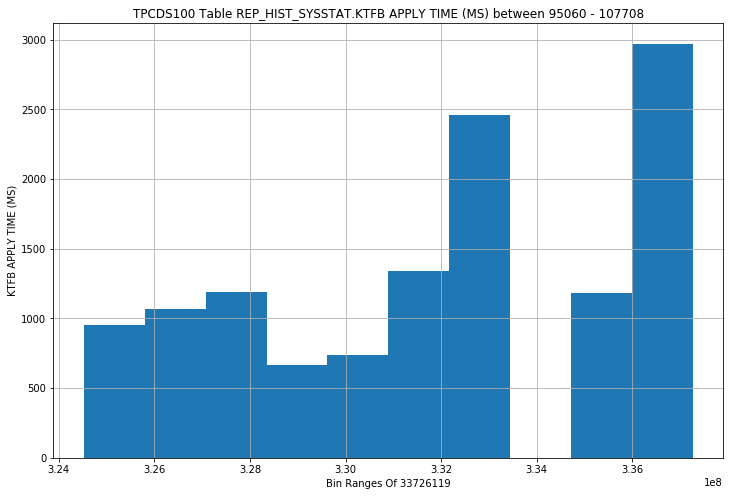

REP_HIST_SYSSTAT - KTFB COMMIT REQ - STRIPPED HISTOGRAM


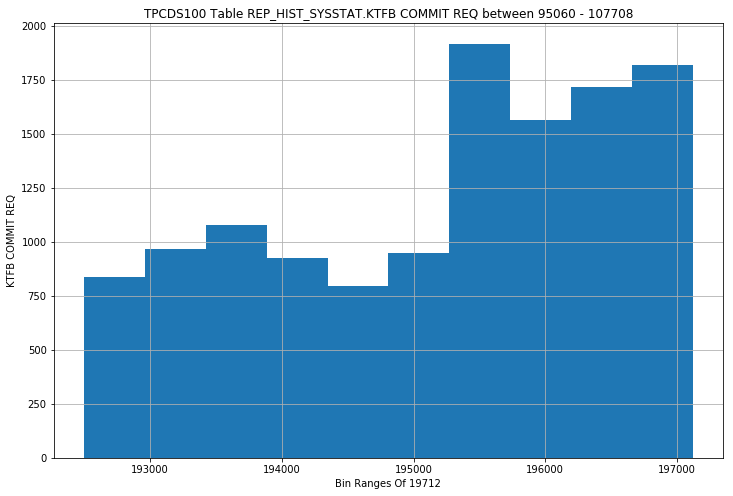

REP_HIST_SYSSTAT - KTFB COMMIT TIME (MS) - STRIPPED HISTOGRAM


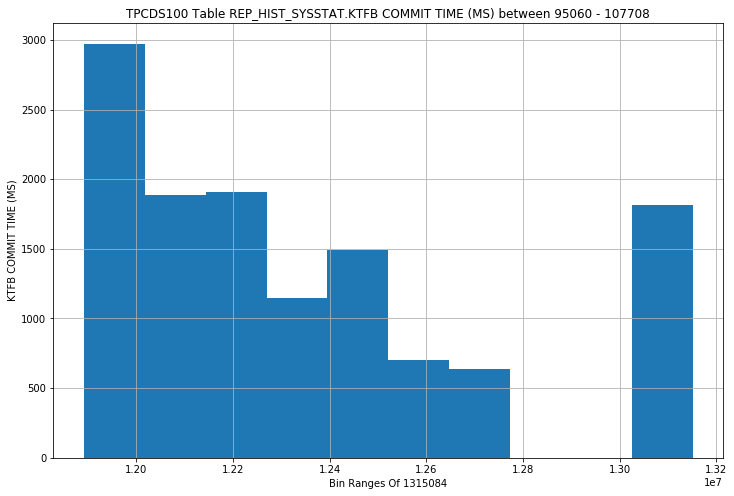

REP_HIST_SYSSTAT - KTFB FREE REQ - STRIPPED HISTOGRAM


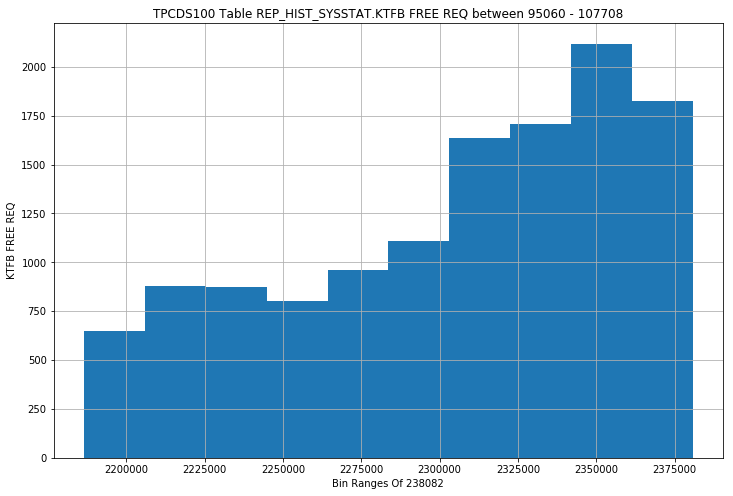

REP_HIST_SYSSTAT - KTFB FREE SPACE (BLOCK) - STRIPPED HISTOGRAM


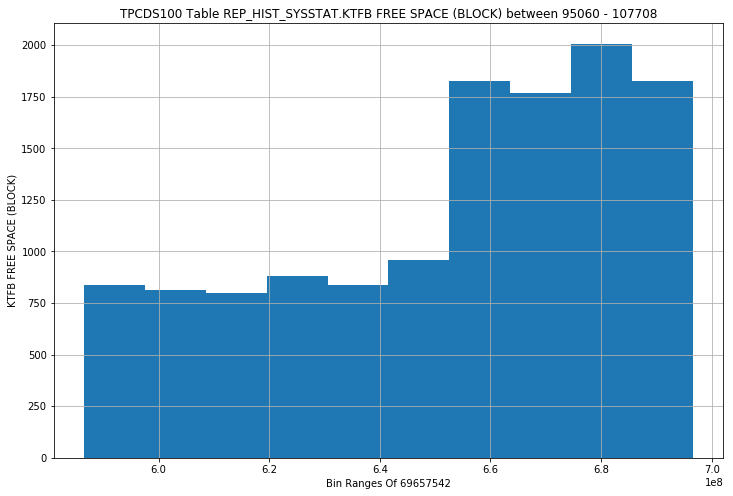

REP_HIST_SYSSTAT - KTFB FREE TIME (MS) - STRIPPED HISTOGRAM


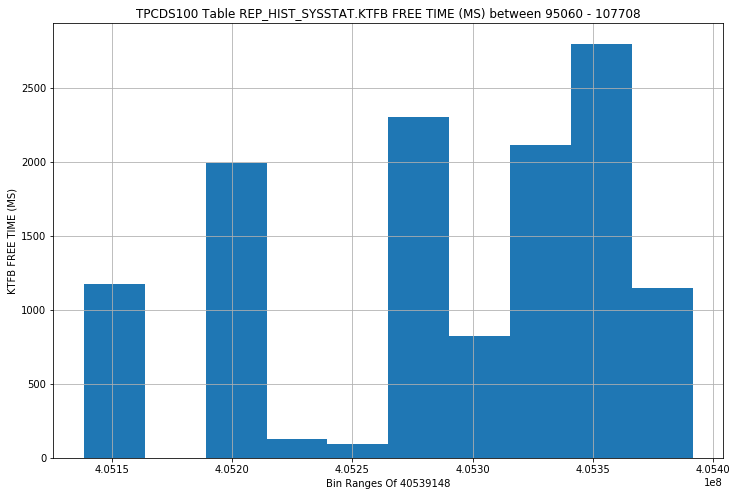

REP_HIST_SYSSTAT - LOB TABLE ID LOOKUP CACHE MISSES - STRIPPED HISTOGRAM


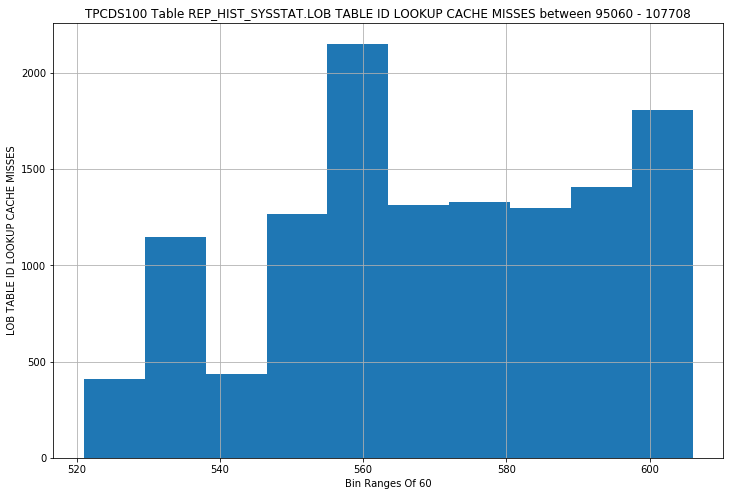

REP_HIST_SYSSTAT - NUMBER OF READ IOS ISSUED - STRIPPED HISTOGRAM


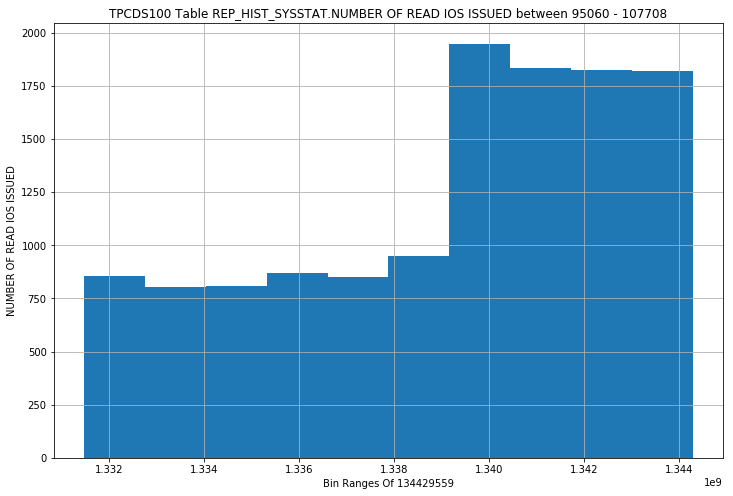

REP_HIST_SYSSTAT - PX LOCAL MESSAGES RECV'D - STRIPPED HISTOGRAM


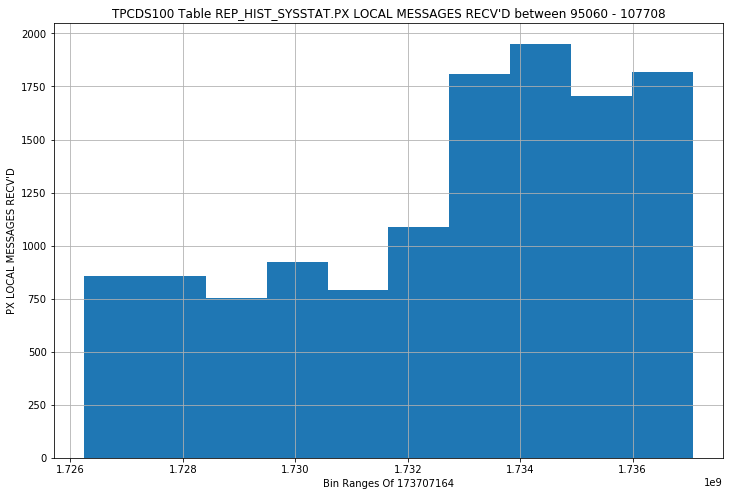

REP_HIST_SYSSTAT - PX LOCAL MESSAGES SENT - STRIPPED HISTOGRAM


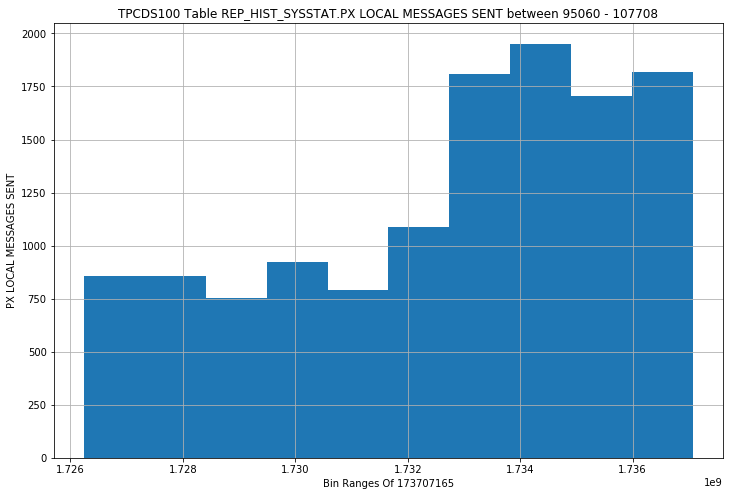

REP_HIST_SYSSTAT - PARALLEL OPERATIONS DOWNGRADED TO SERIAL - STRIPPED HISTOGRAM


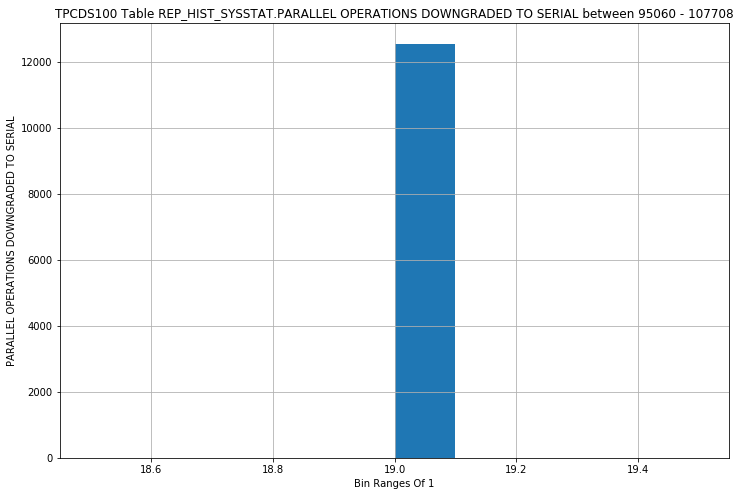

REP_HIST_SYSSTAT - PARALLEL OPERATIONS NOT DOWNGRADED - STRIPPED HISTOGRAM


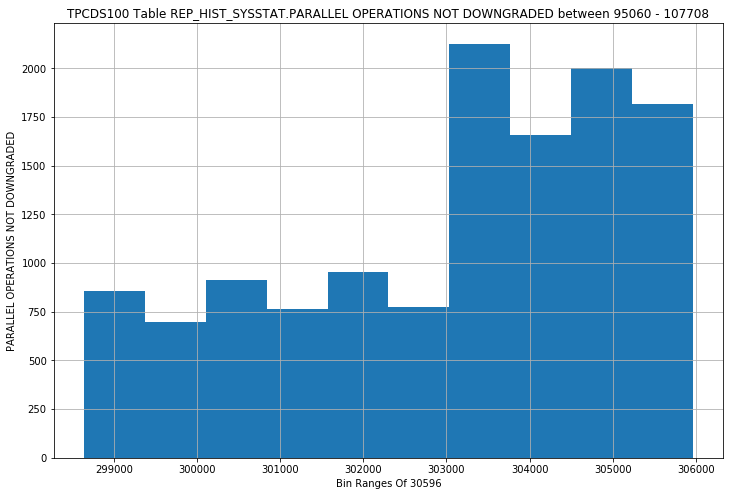

REP_HIST_SYSSTAT - REQUESTS TO/FROM CLIENT - STRIPPED HISTOGRAM


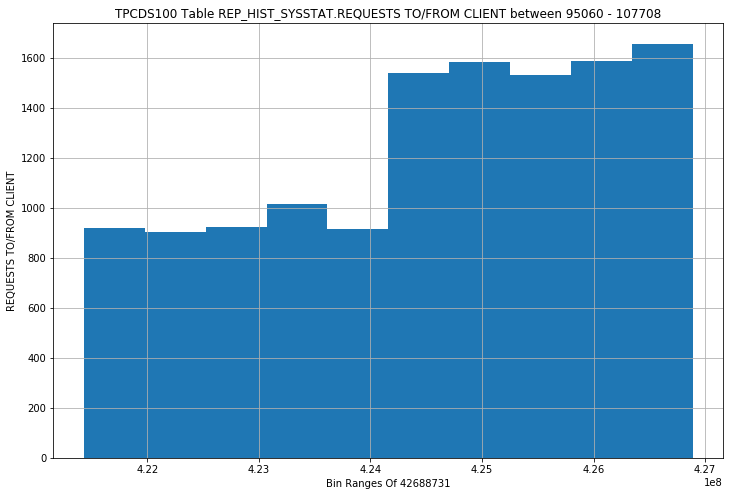

REP_HIST_SYSSTAT - ROWCR ATTEMPTS - STRIPPED HISTOGRAM


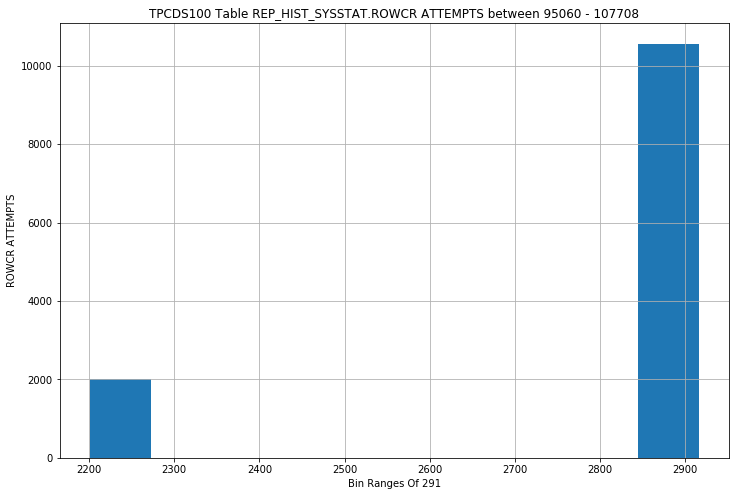

REP_HIST_SYSSTAT - ROWCR HITS - STRIPPED HISTOGRAM


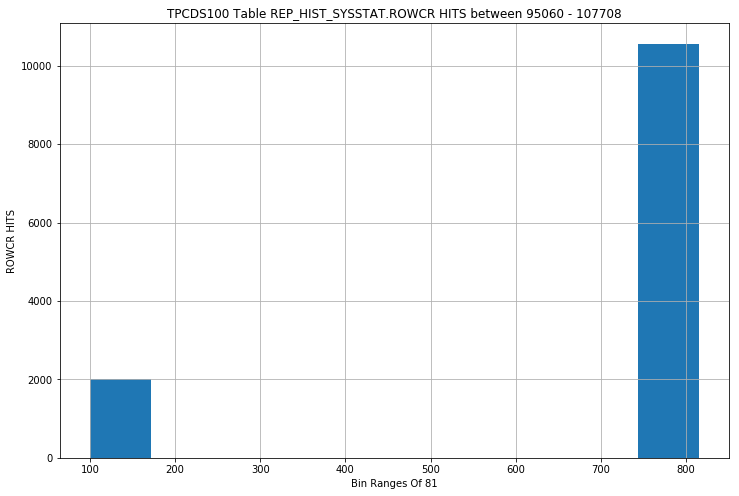

REP_HIST_SYSSTAT - SMON POSTED FOR UNDO SEGMENT SHRINK - STRIPPED HISTOGRAM


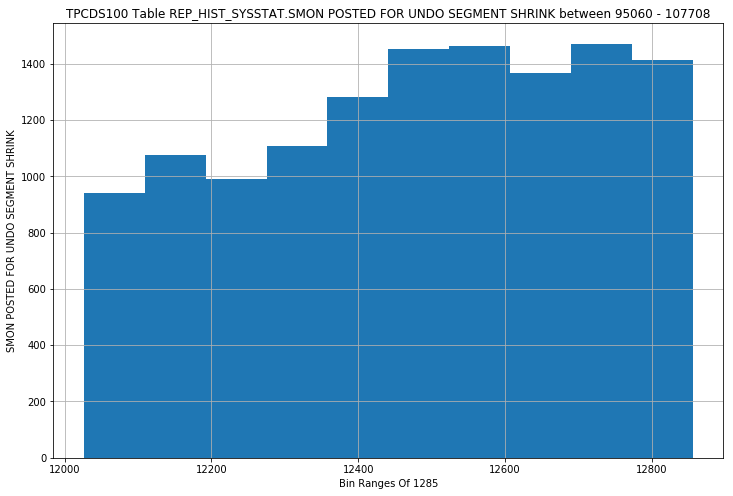

REP_HIST_SYSSTAT - SQL*NET ROUNDTRIPS TO/FROM CLIENT - STRIPPED HISTOGRAM


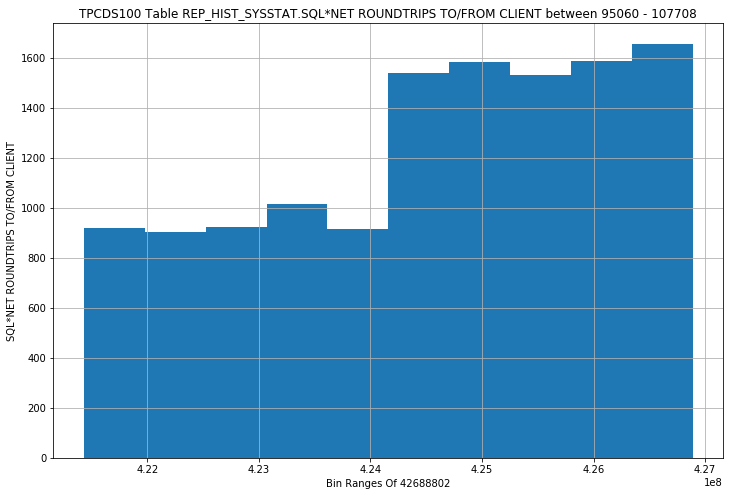

REP_HIST_SYSSTAT - TBS EXTENSION: BYTES EXTENDED - STRIPPED HISTOGRAM


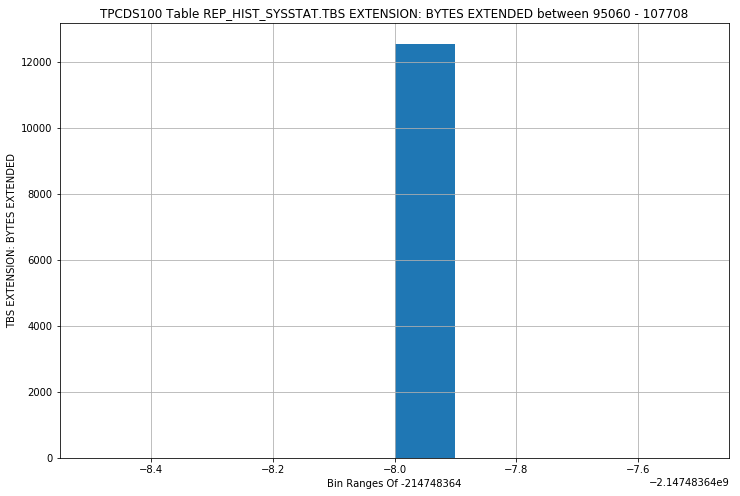

REP_HIST_SYSSTAT - TBS EXTENSION: FILES EXTENDED - STRIPPED HISTOGRAM


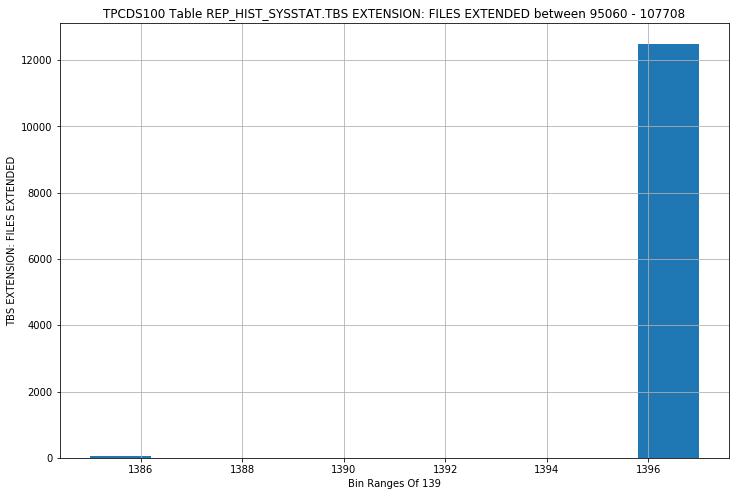

REP_HIST_SYSSTAT - TBS EXTENSION: TASKS CREATED - STRIPPED HISTOGRAM


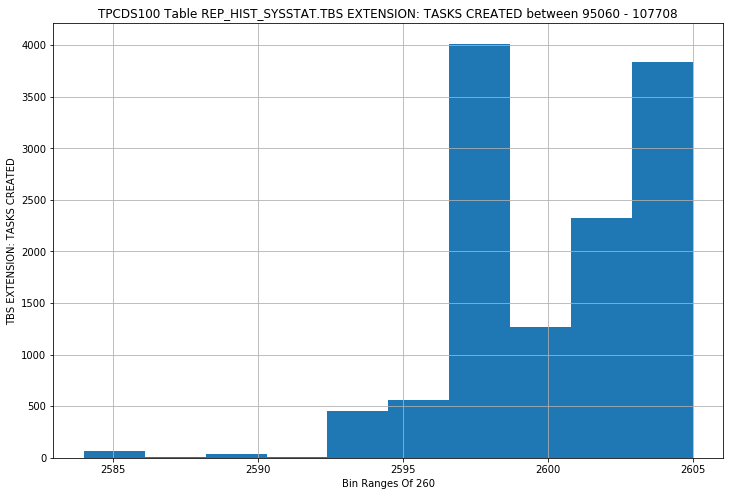

REP_HIST_SYSSTAT - TBS EXTENSION: TASKS EXECUTED - STRIPPED HISTOGRAM


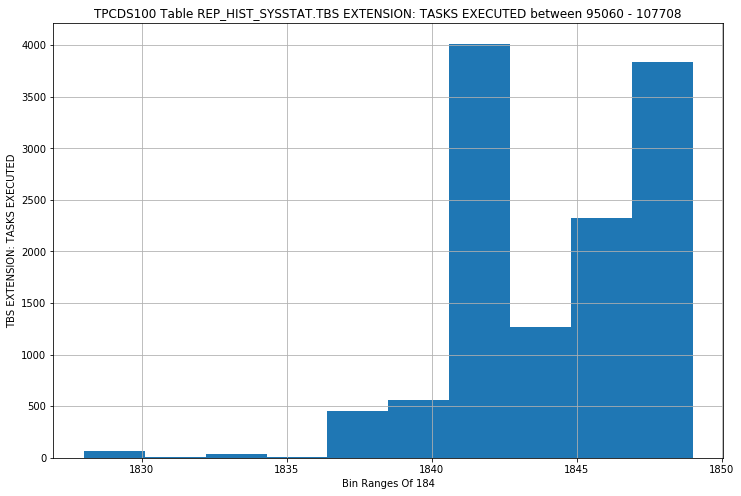

REP_HIST_SYSSTAT - ACTIVE TXN COUNT DURING CLEANOUT - STRIPPED HISTOGRAM


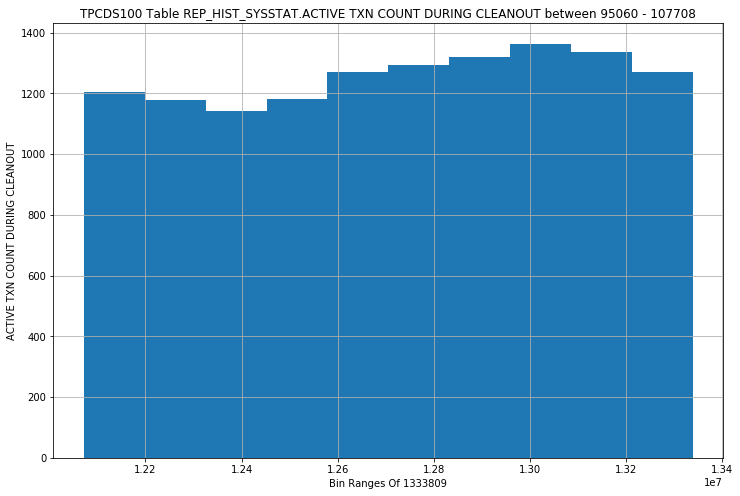

REP_HIST_SYSSTAT - APPLICATION WAIT TIME - STRIPPED HISTOGRAM


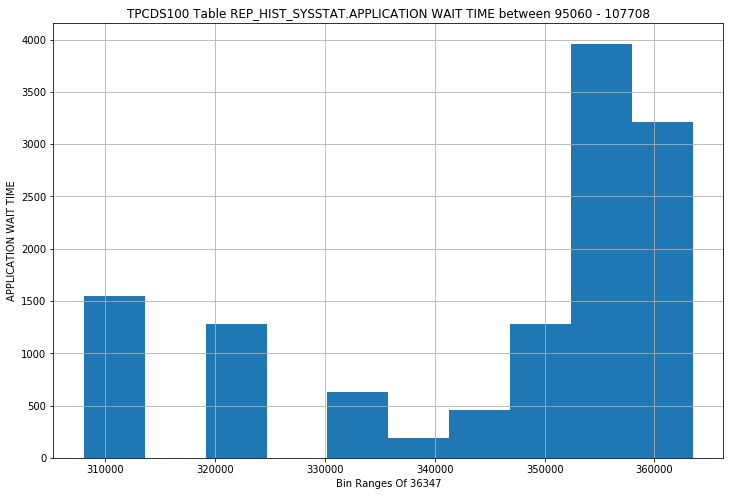

REP_HIST_SYSSTAT - BACKGROUND CHECKPOINTS COMPLETED - STRIPPED HISTOGRAM


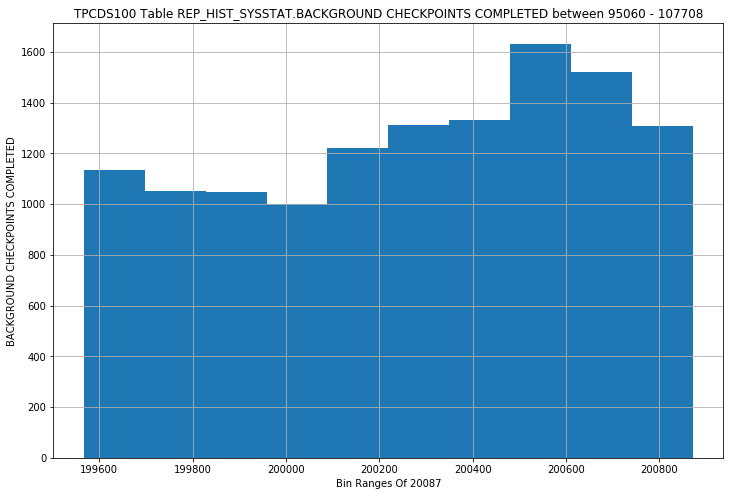

REP_HIST_SYSSTAT - BACKGROUND CHECKPOINTS STARTED - STRIPPED HISTOGRAM


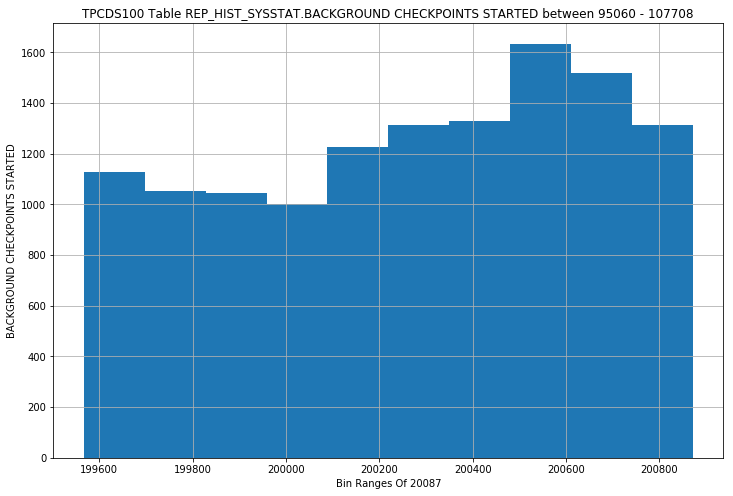

REP_HIST_SYSSTAT - BACKGROUND TIMEOUTS - STRIPPED HISTOGRAM


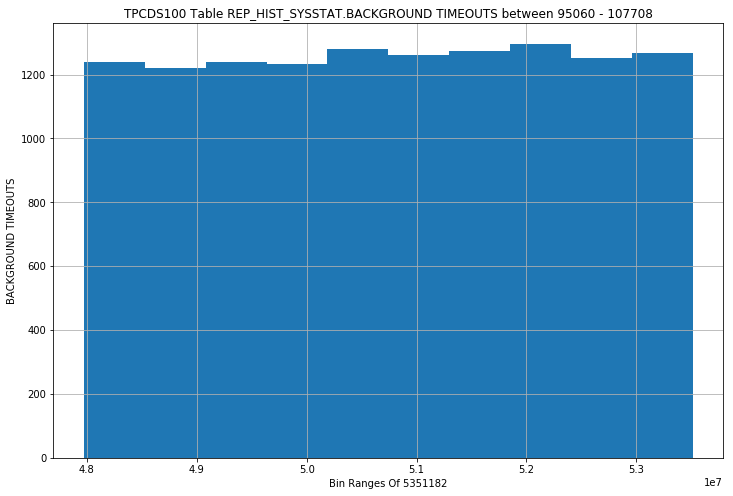

REP_HIST_SYSSTAT - BRANCH NODE SPLITS - STRIPPED HISTOGRAM


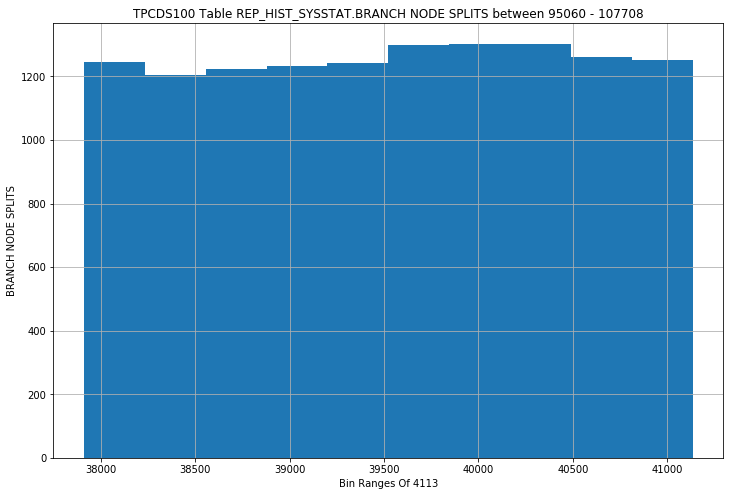

REP_HIST_SYSSTAT - BUFFER IS NOT PINNED COUNT - STRIPPED HISTOGRAM


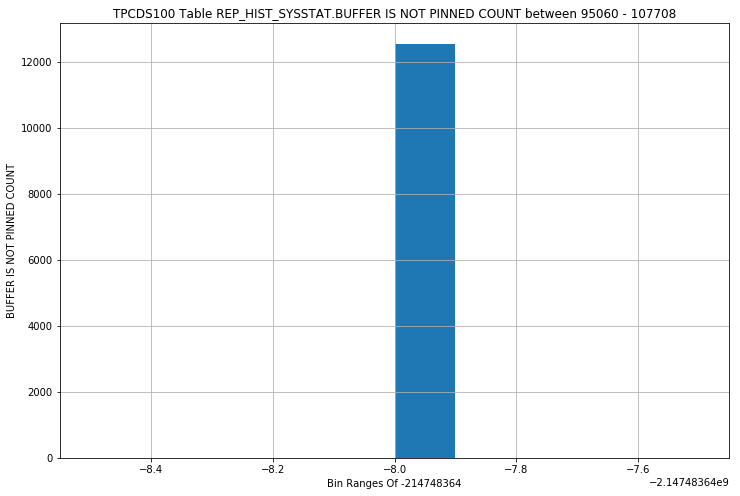

REP_HIST_SYSSTAT - BUFFER IS PINNED COUNT - STRIPPED HISTOGRAM


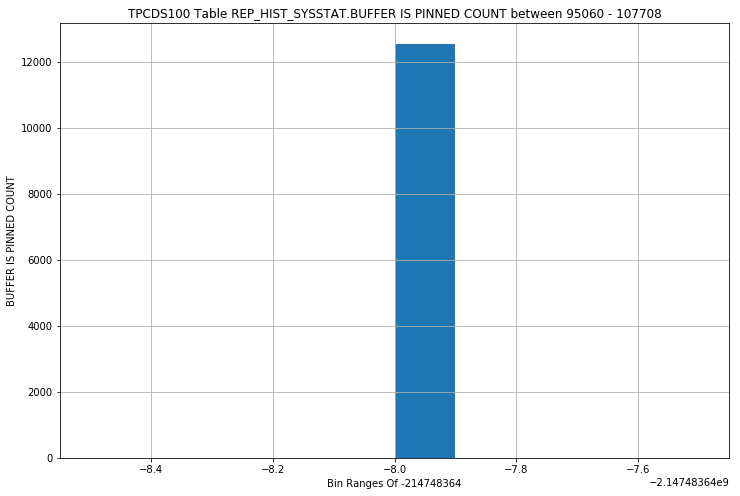

REP_HIST_SYSSTAT - BYTES RECEIVED VIA SQL*NET FROM CLIENT - STRIPPED HISTOGRAM


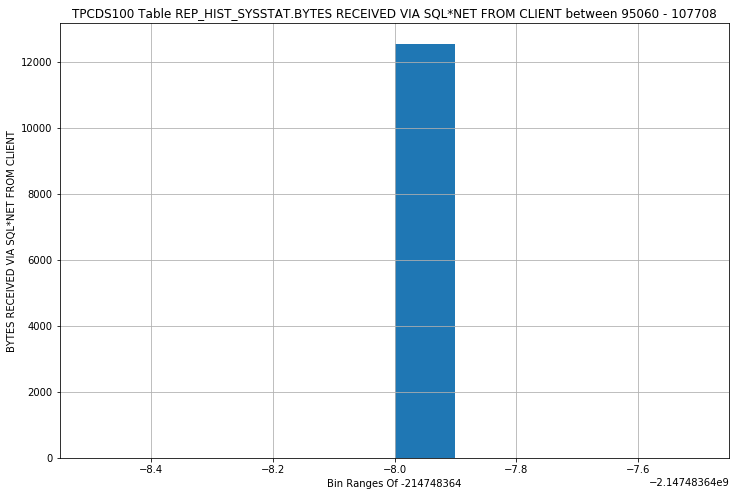

REP_HIST_SYSSTAT - BYTES SENT VIA SQL*NET TO CLIENT - STRIPPED HISTOGRAM


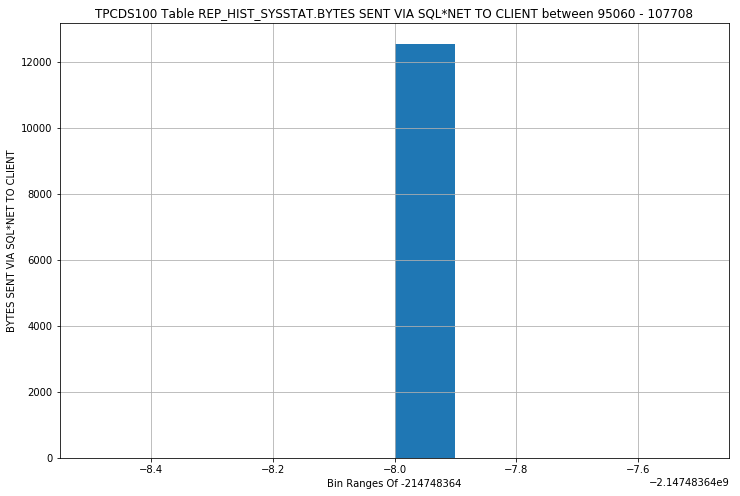

REP_HIST_SYSSTAT - BYTES VIA SQL*NET VECTOR TO CLIENT - STRIPPED HISTOGRAM


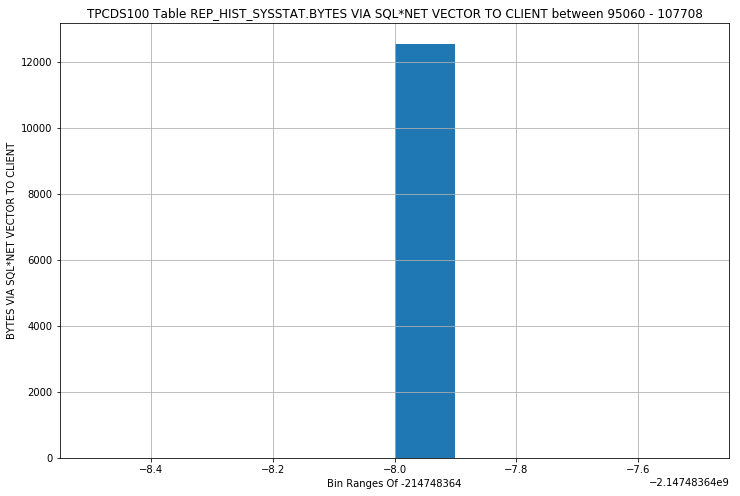

REP_HIST_SYSSTAT - CALLS TO GET SNAPSHOT SCN: KCMGSS - STRIPPED HISTOGRAM


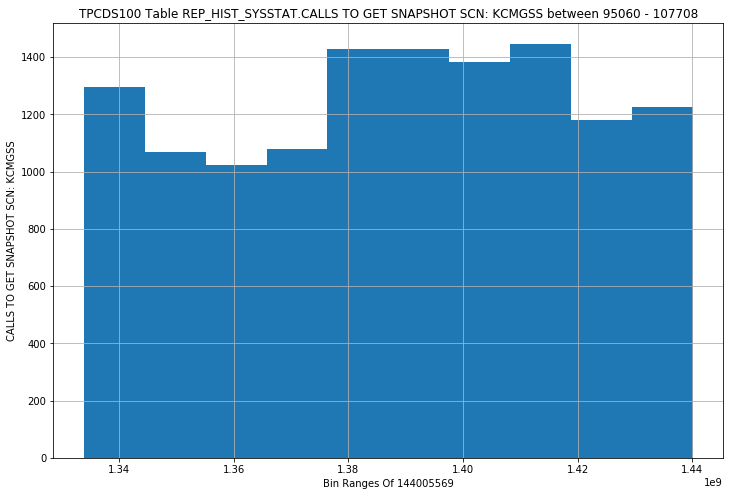

REP_HIST_SYSSTAT - CALLS TO KCMGAS - STRIPPED HISTOGRAM


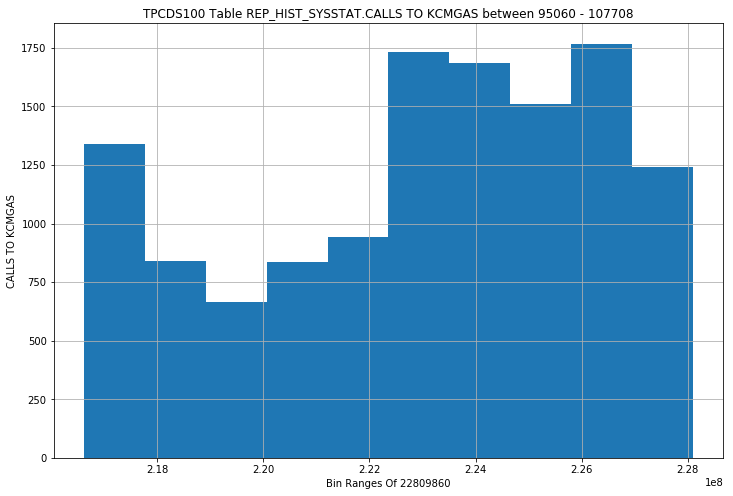

REP_HIST_SYSSTAT - CALLS TO KCMGCS - STRIPPED HISTOGRAM


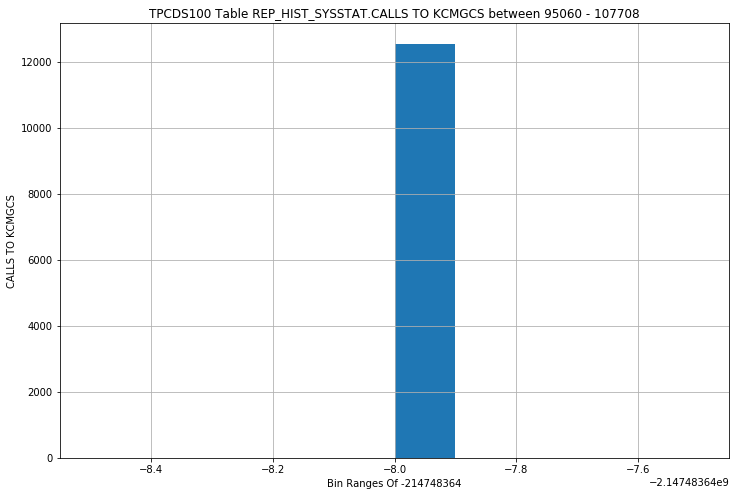

REP_HIST_SYSSTAT - CELL PHYSICAL IO INTERCONNECT BYTES - STRIPPED HISTOGRAM


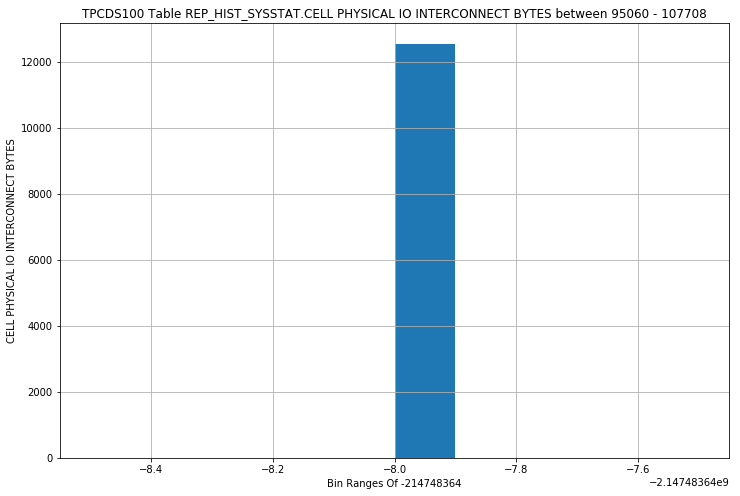

REP_HIST_SYSSTAT - CHANGE WRITE TIME - STRIPPED HISTOGRAM


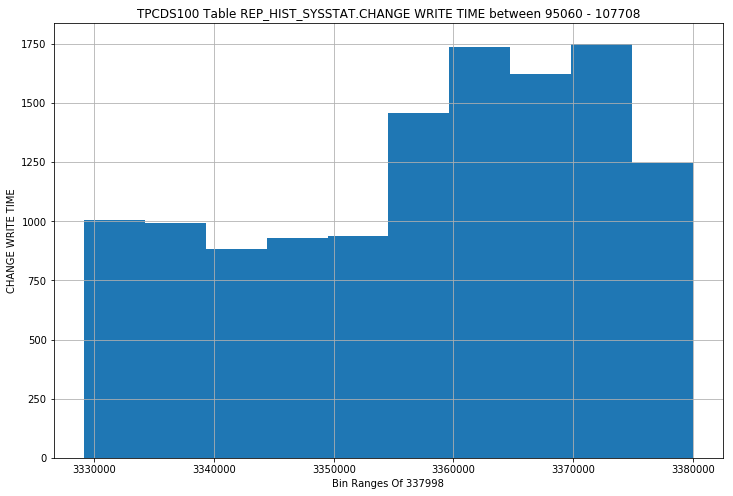

REP_HIST_SYSSTAT - CLEANOUT - NUMBER OF KTUGCT CALLS - STRIPPED HISTOGRAM


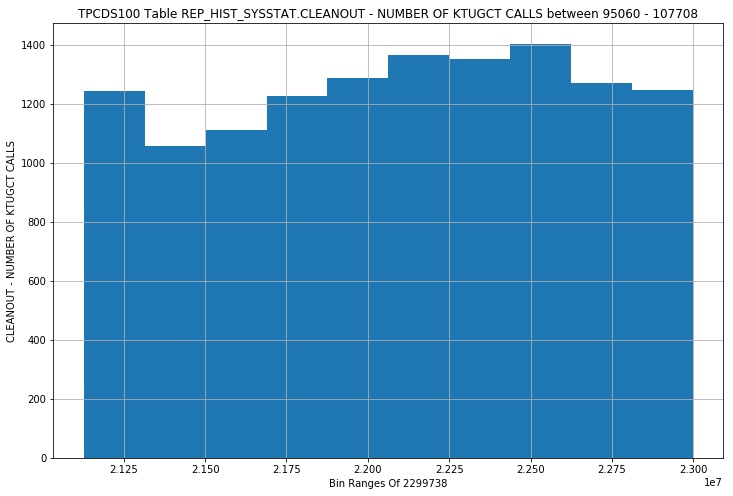

REP_HIST_SYSSTAT - CLEANOUTS AND ROLLBACKS - CONSISTENT READ GETS - STRIPPED HISTOGRAM


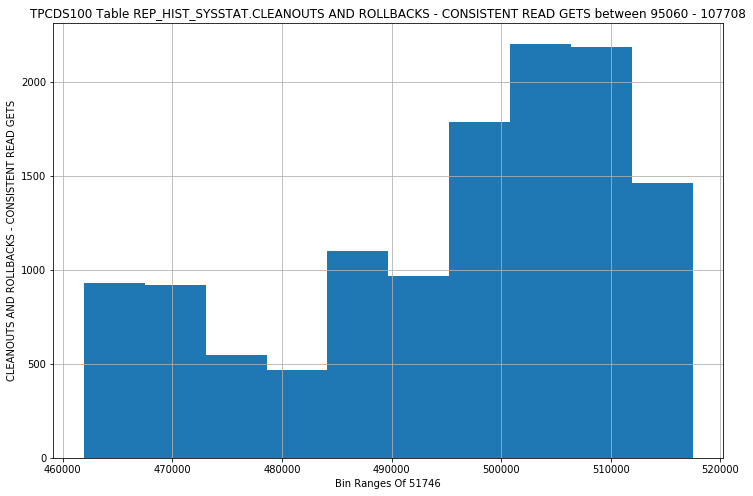

REP_HIST_SYSSTAT - CLEANOUTS ONLY - CONSISTENT READ GETS - STRIPPED HISTOGRAM


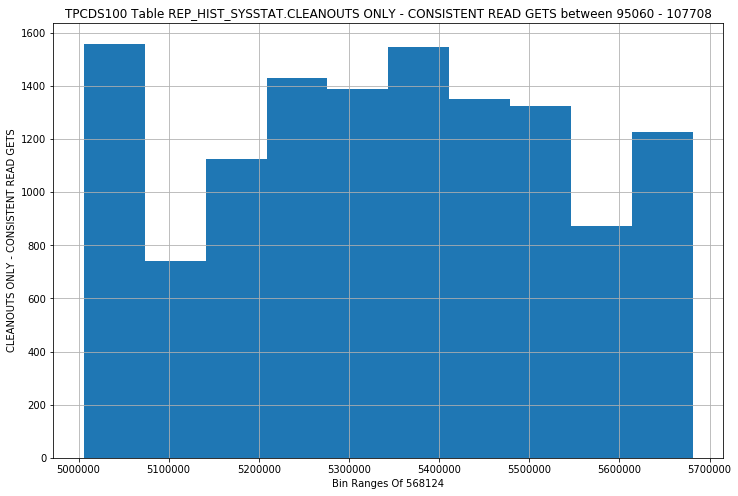

REP_HIST_SYSSTAT - CLUSTER KEY SCAN BLOCK GETS - STRIPPED HISTOGRAM


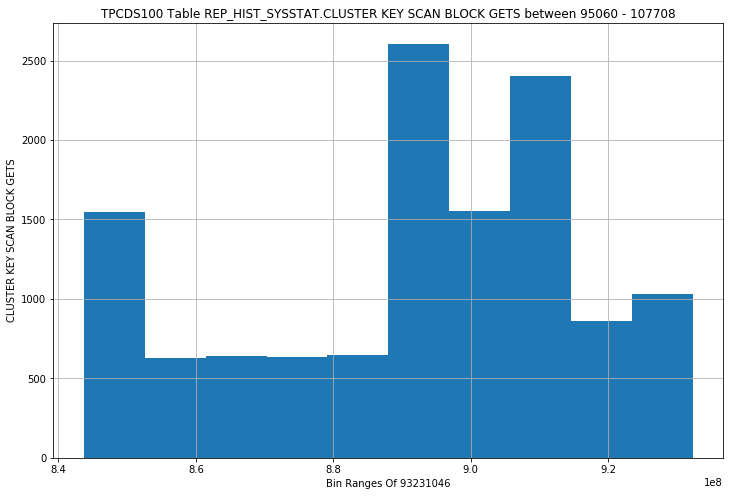

REP_HIST_SYSSTAT - CLUSTER KEY SCANS - STRIPPED HISTOGRAM


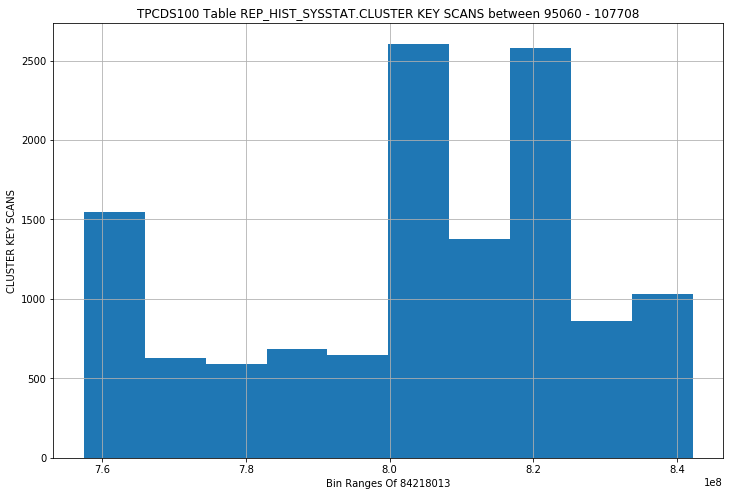

REP_HIST_SYSSTAT - COMMIT BATCH/IMMEDIATE PERFORMED - STRIPPED HISTOGRAM


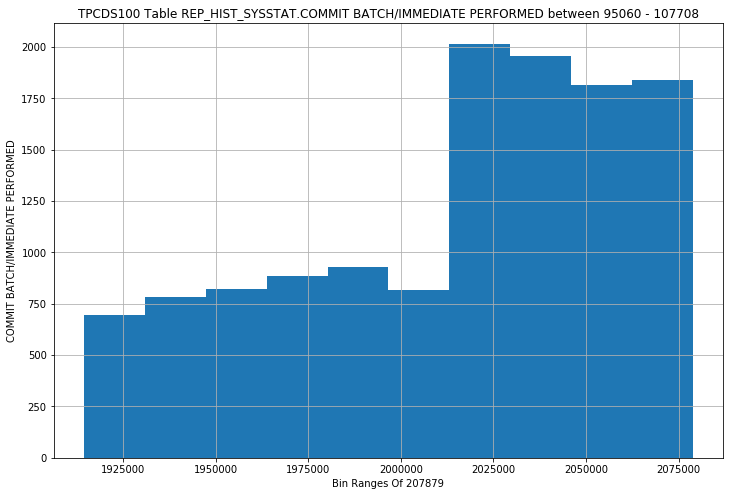

REP_HIST_SYSSTAT - COMMIT BATCH/IMMEDIATE REQUESTED - STRIPPED HISTOGRAM


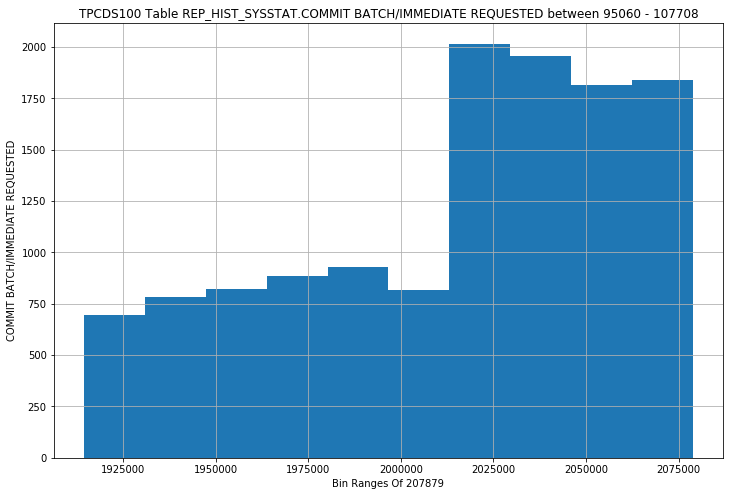

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: BLOCK LOST - STRIPPED HISTOGRAM


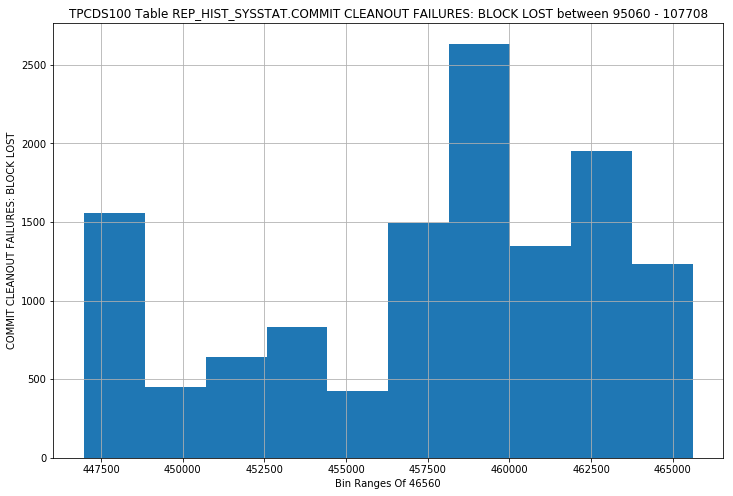

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: BUFFER BEING WRITTEN - STRIPPED HISTOGRAM


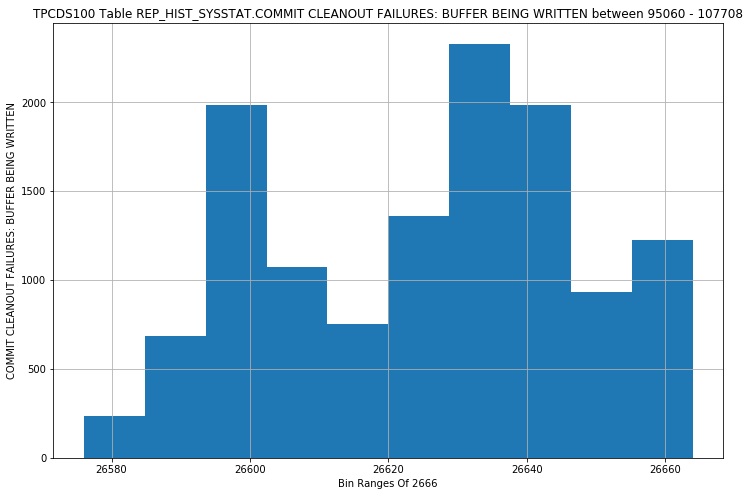

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: CALLBACK FAILURE  - STRIPPED HISTOGRAM


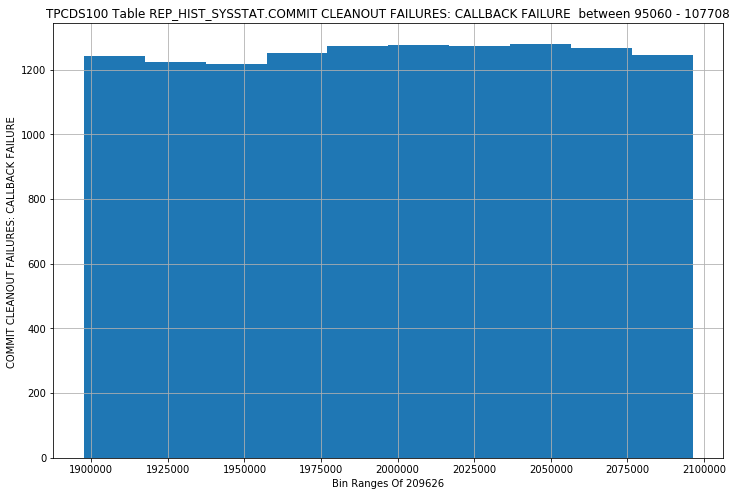

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: CANNOT PIN - STRIPPED HISTOGRAM


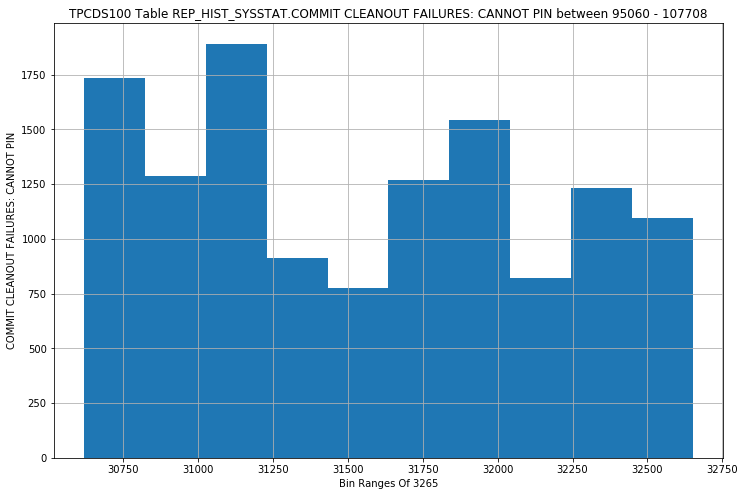

REP_HIST_SYSSTAT - COMMIT CLEANOUTS - STRIPPED HISTOGRAM


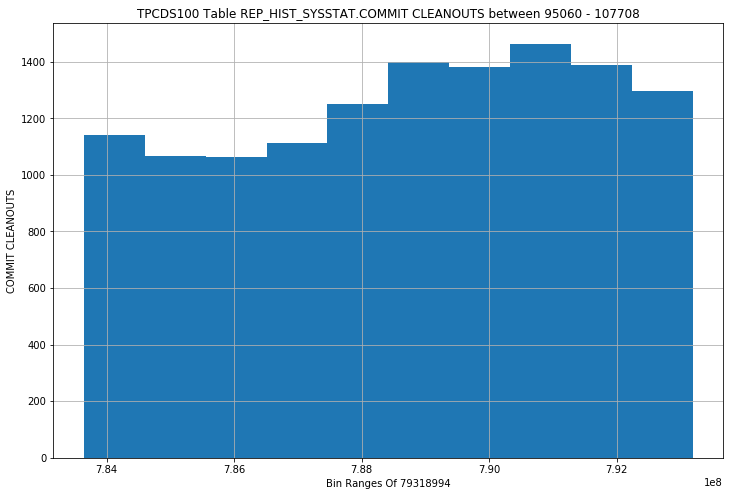

REP_HIST_SYSSTAT - COMMIT CLEANOUTS SUCCESSFULLY COMPLETED - STRIPPED HISTOGRAM


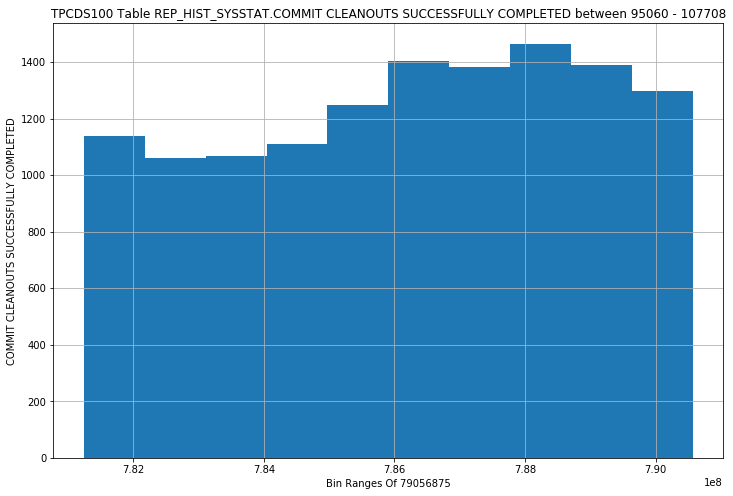

REP_HIST_SYSSTAT - COMMIT IMMEDIATE PERFORMED - STRIPPED HISTOGRAM


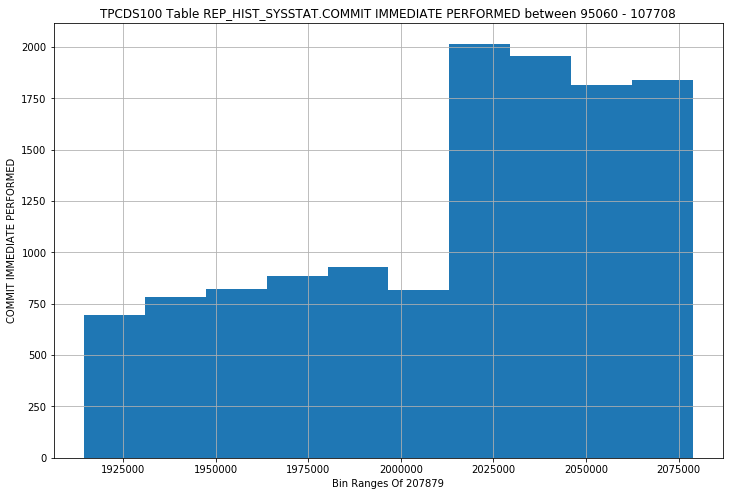

REP_HIST_SYSSTAT - COMMIT IMMEDIATE REQUESTED - STRIPPED HISTOGRAM


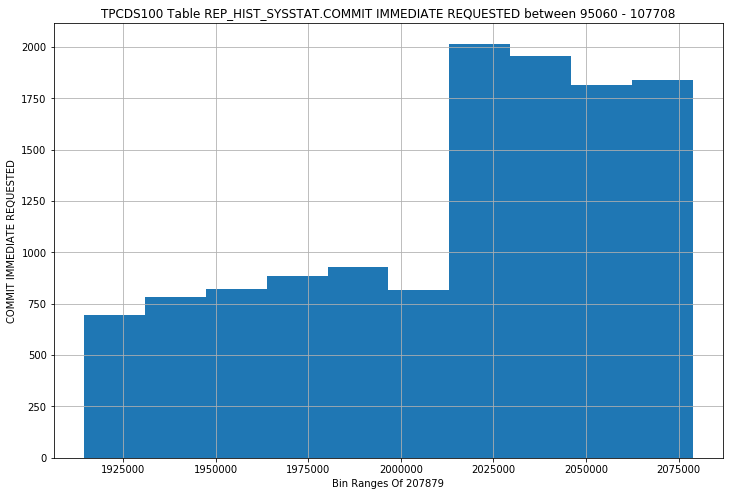

REP_HIST_SYSSTAT - COMMIT TXN COUNT DURING CLEANOUT - STRIPPED HISTOGRAM


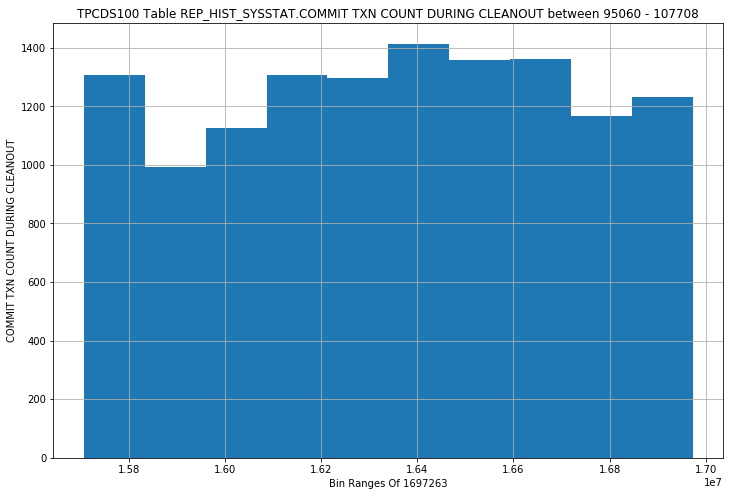

REP_HIST_SYSSTAT - CONCURRENCY WAIT TIME - STRIPPED HISTOGRAM


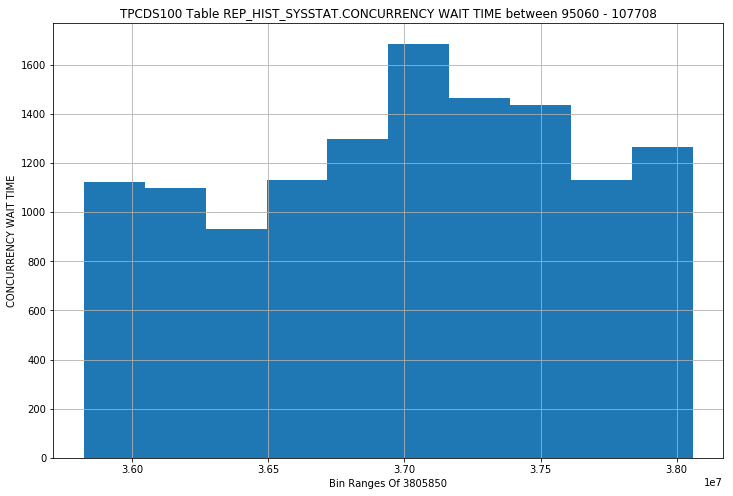

REP_HIST_SYSSTAT - CONSISTENT CHANGES - STRIPPED HISTOGRAM


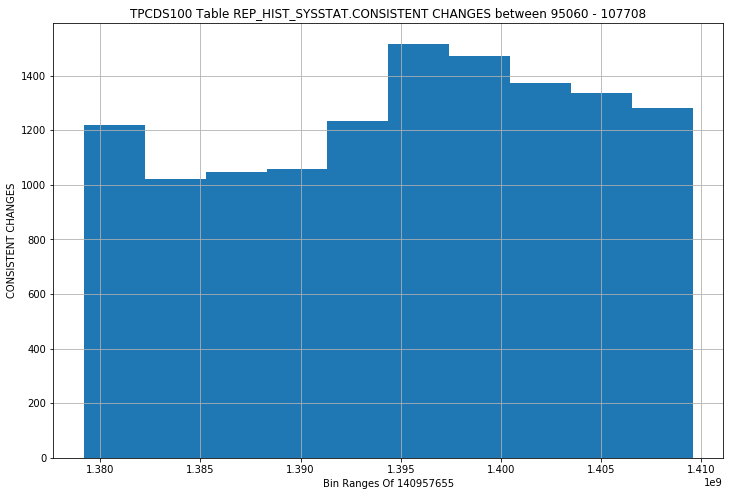

REP_HIST_SYSSTAT - CONSISTENT GETS - STRIPPED HISTOGRAM


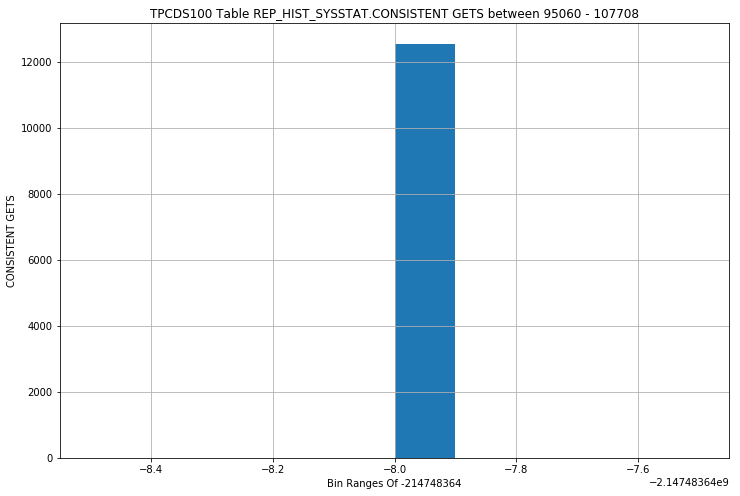

REP_HIST_SYSSTAT - CONSISTENT GETS DIRECT - STRIPPED HISTOGRAM


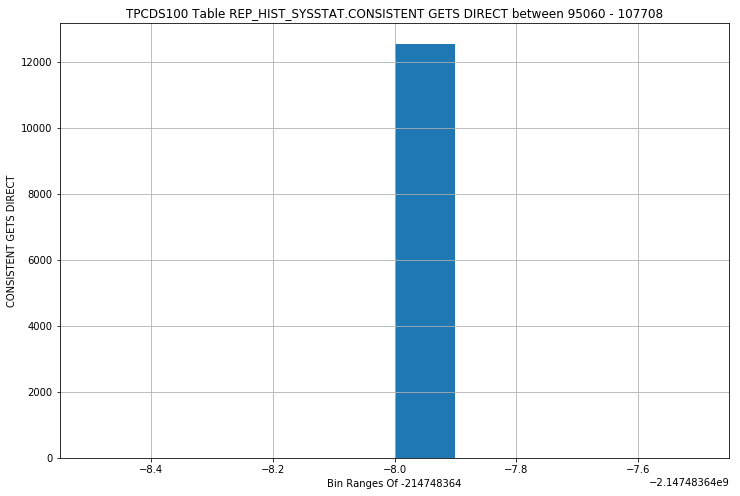

REP_HIST_SYSSTAT - CONSISTENT GETS EXAMINATION - STRIPPED HISTOGRAM


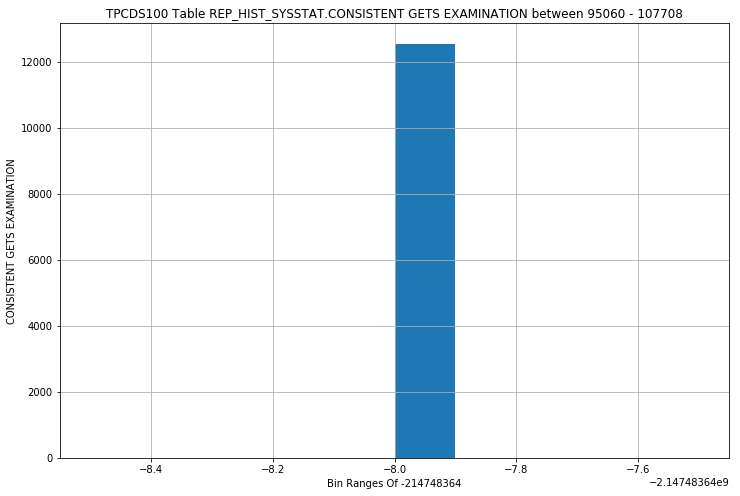

REP_HIST_SYSSTAT - CONSISTENT GETS EXAMINATION (FASTPATH) - STRIPPED HISTOGRAM


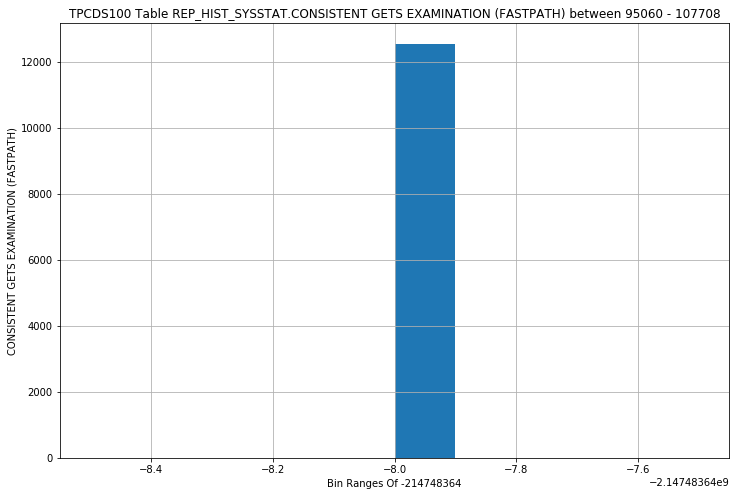

REP_HIST_SYSSTAT - CONSISTENT GETS FROM CACHE - STRIPPED HISTOGRAM


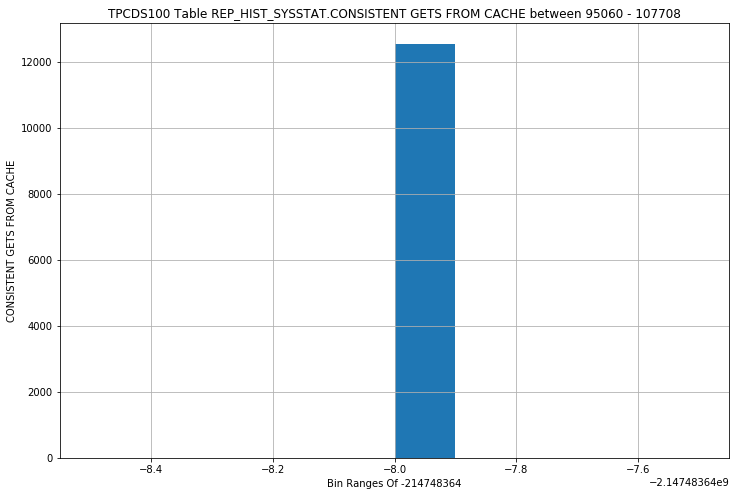

REP_HIST_SYSSTAT - CONSISTENT GETS PIN - STRIPPED HISTOGRAM


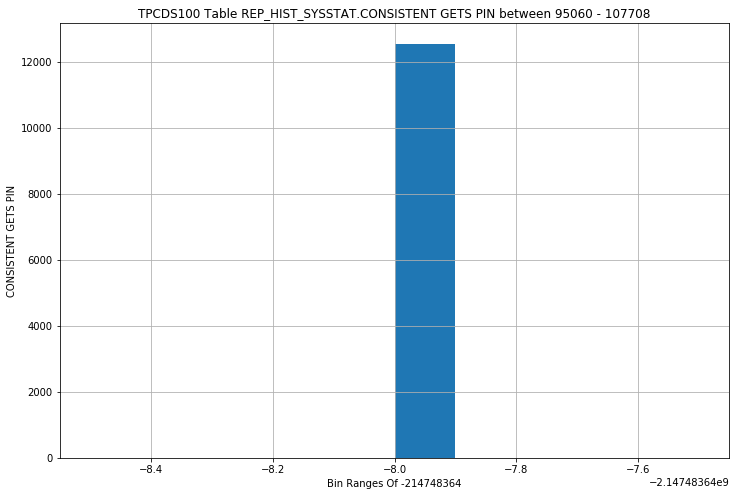

REP_HIST_SYSSTAT - CONSISTENT GETS PIN (FASTPATH) - STRIPPED HISTOGRAM


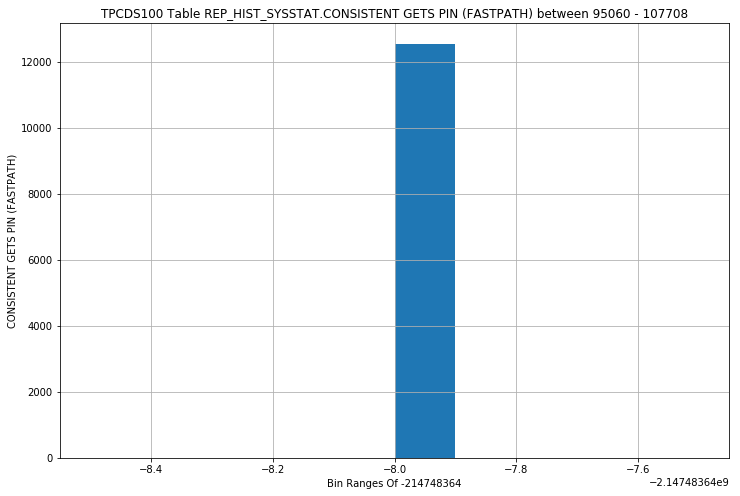

REP_HIST_SYSSTAT - CURSOR AUTHENTICATIONS - STRIPPED HISTOGRAM


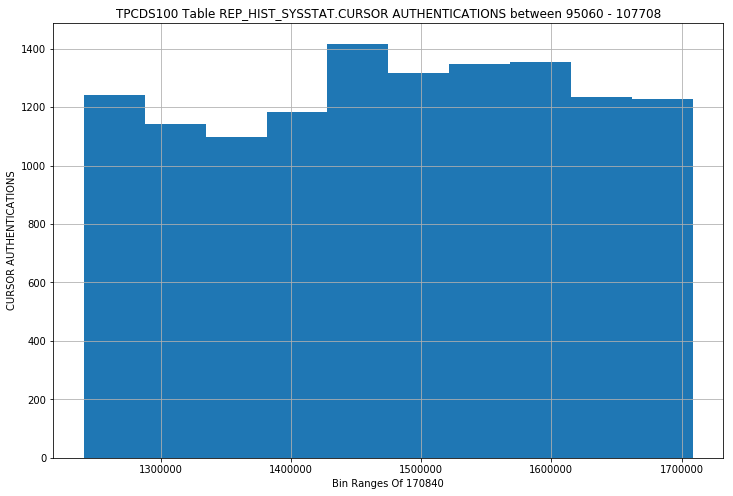

REP_HIST_SYSSTAT - CURSOR RELOAD FAILURES - STRIPPED HISTOGRAM


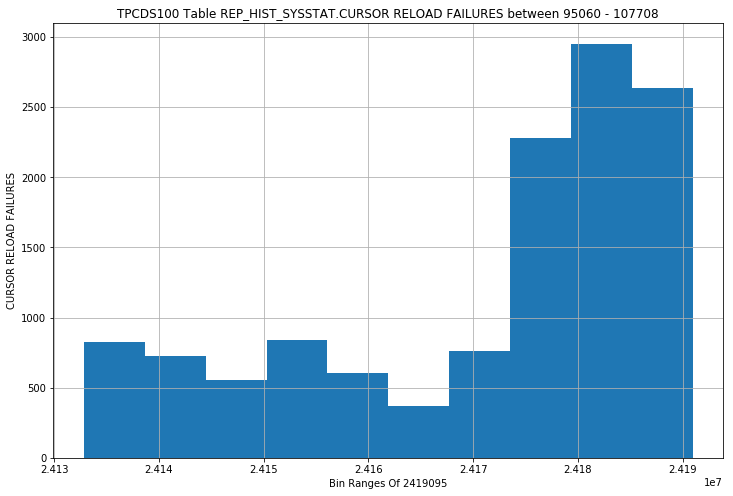

REP_HIST_SYSSTAT - DATA BLOCKS CONSISTENT READS - UNDO RECORDS APPLIED - STRIPPED HISTOGRAM


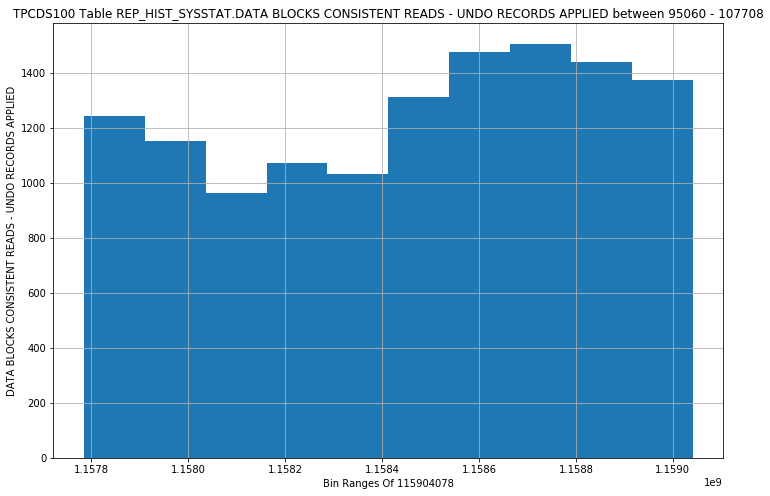

REP_HIST_SYSSTAT - DB BLOCK CHANGES - STRIPPED HISTOGRAM


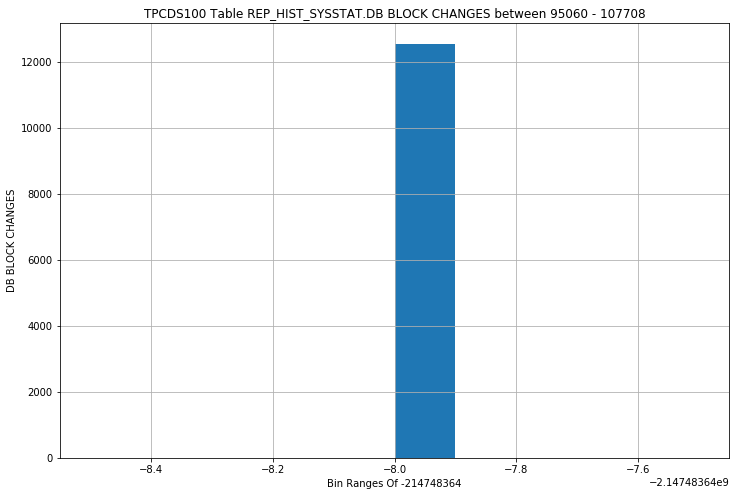

REP_HIST_SYSSTAT - DB BLOCK GETS - STRIPPED HISTOGRAM


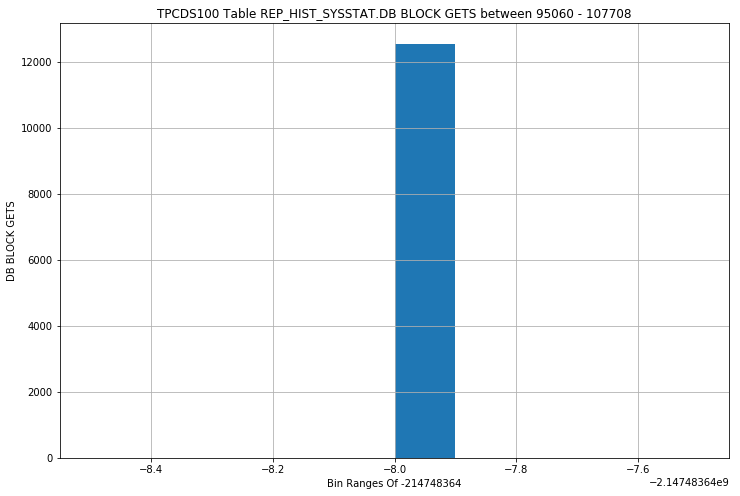

REP_HIST_SYSSTAT - DB BLOCK GETS DIRECT - STRIPPED HISTOGRAM


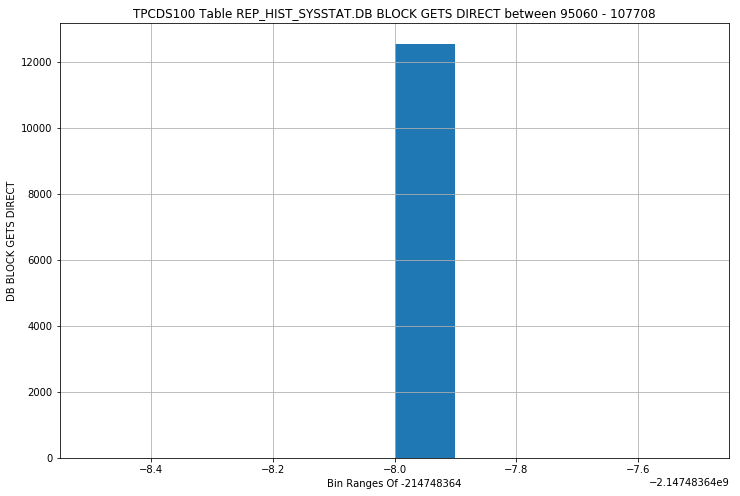

REP_HIST_SYSSTAT - DB BLOCK GETS FROM CACHE - STRIPPED HISTOGRAM


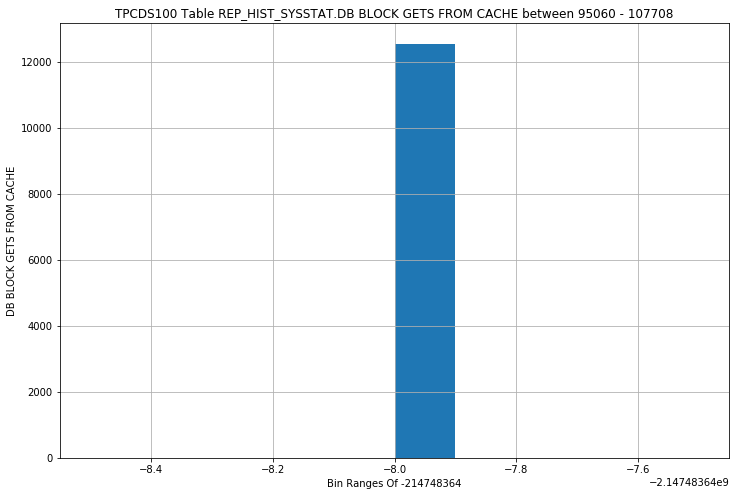

REP_HIST_SYSSTAT - DB BLOCK GETS FROM CACHE (FASTPATH) - STRIPPED HISTOGRAM


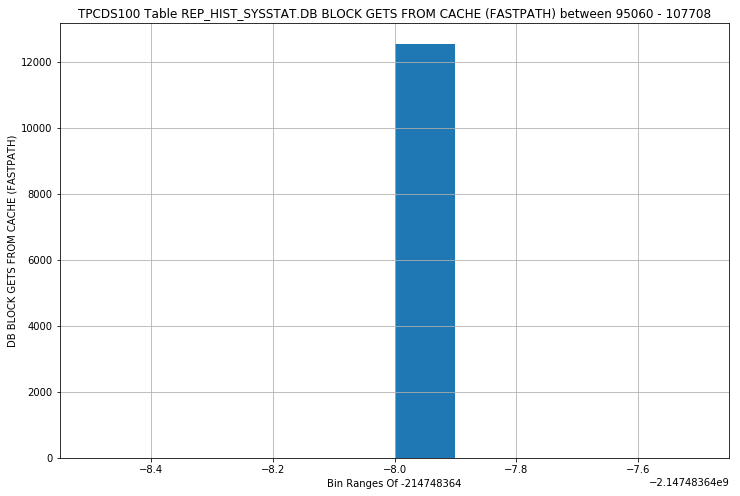

REP_HIST_SYSSTAT - DEFERRED (CURRENT) BLOCK CLEANOUT APPLICATIONS - STRIPPED HISTOGRAM


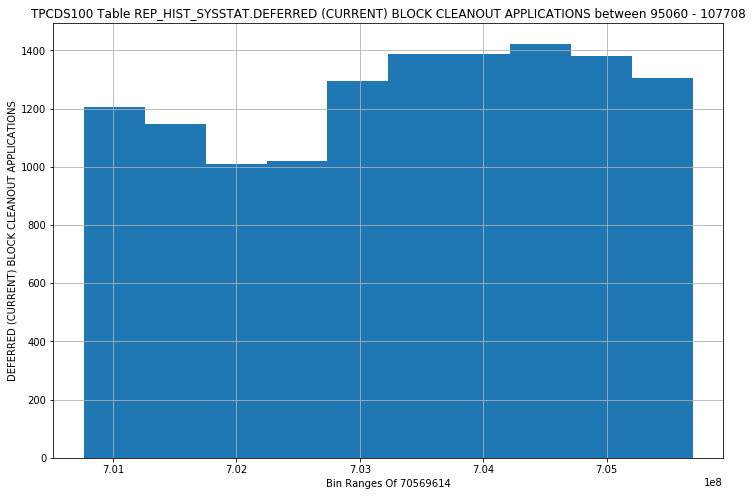

REP_HIST_SYSSTAT - DIRTY BUFFERS INSPECTED - STRIPPED HISTOGRAM


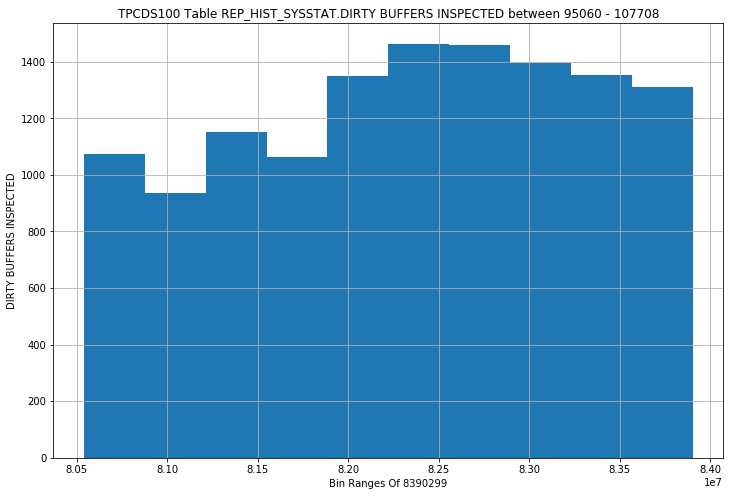

REP_HIST_SYSSTAT - ENQUEUE CONVERSIONS - STRIPPED HISTOGRAM


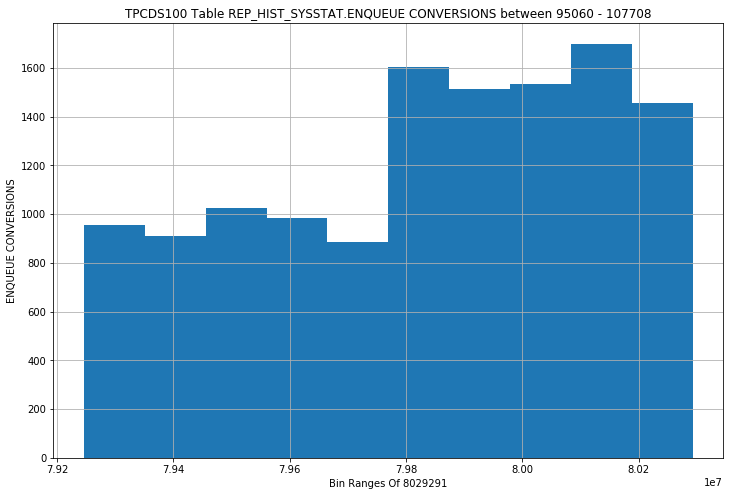

REP_HIST_SYSSTAT - ENQUEUE RELEASES - STRIPPED HISTOGRAM


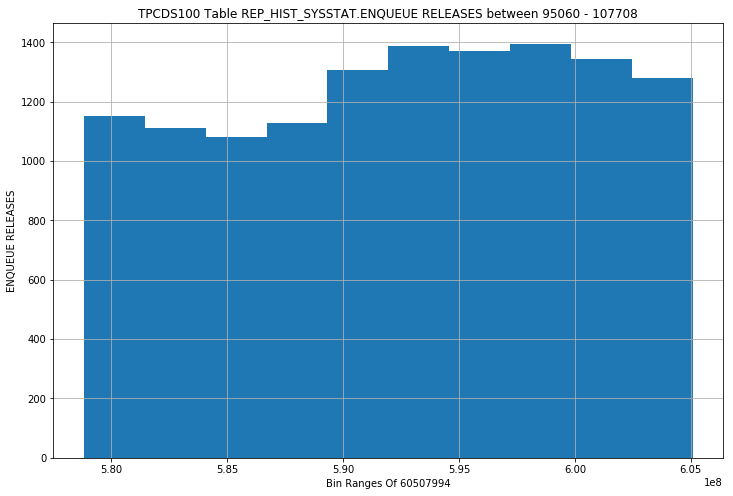

REP_HIST_SYSSTAT - ENQUEUE REQUESTS - STRIPPED HISTOGRAM


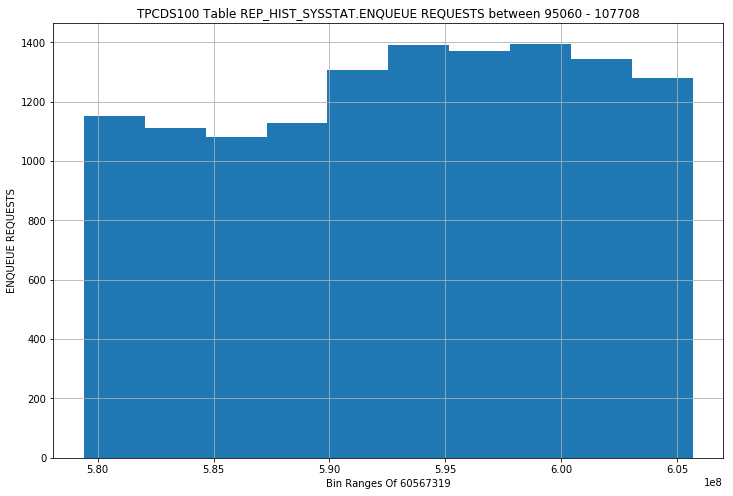

REP_HIST_SYSSTAT - ENQUEUE TIMEOUTS - STRIPPED HISTOGRAM


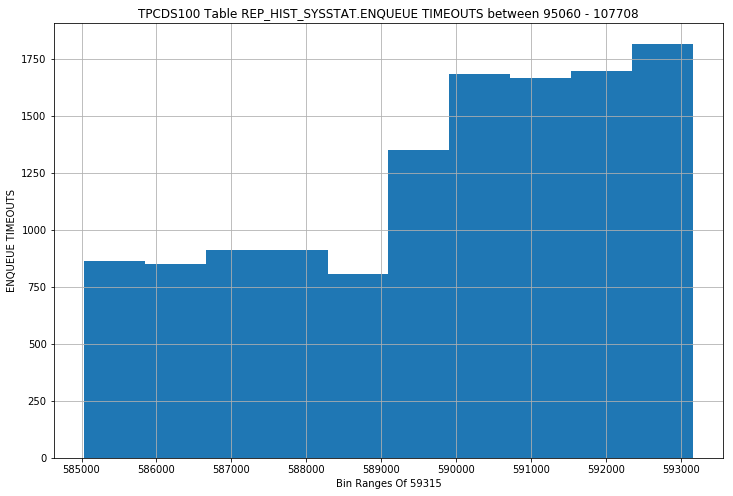

REP_HIST_SYSSTAT - ENQUEUE WAITS - STRIPPED HISTOGRAM


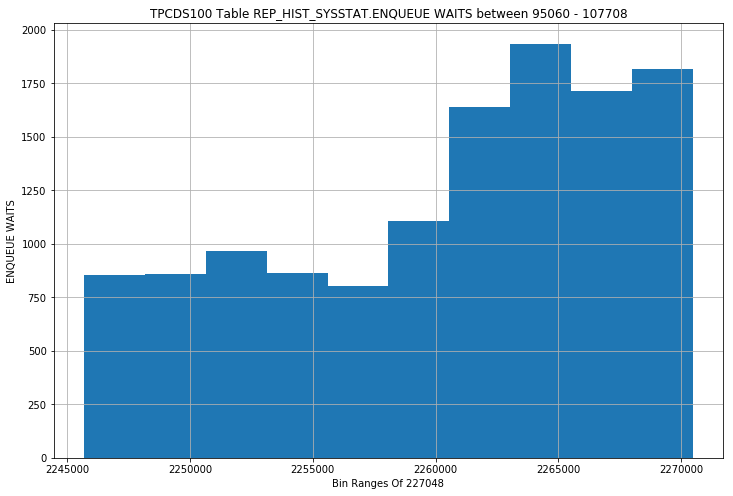

REP_HIST_SYSSTAT - EXCHANGE DEADLOCKS - STRIPPED HISTOGRAM


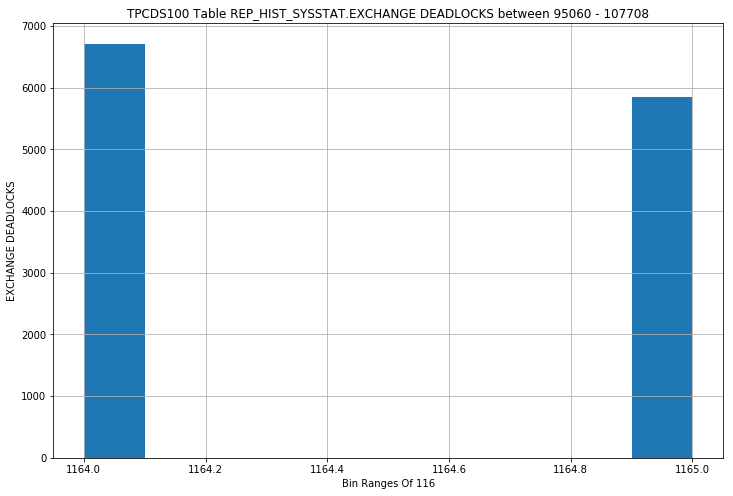

REP_HIST_SYSSTAT - EXECUTE COUNT - STRIPPED HISTOGRAM


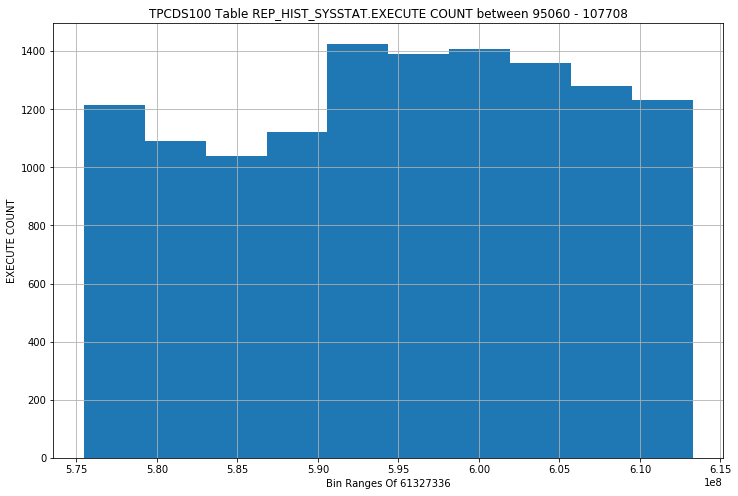

REP_HIST_SYSSTAT - FAILED PROBES ON INDEX BLOCK RECLAMATION - STRIPPED HISTOGRAM


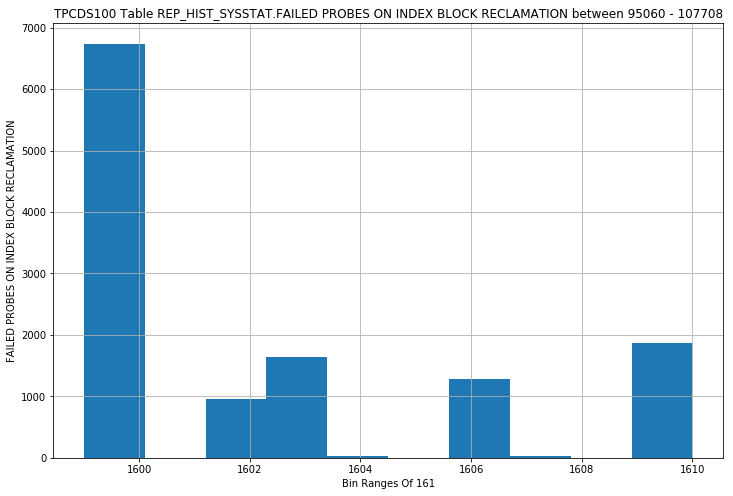

REP_HIST_SYSSTAT - FASTPATH CONSISTENT GET QUOTA LIMIT - STRIPPED HISTOGRAM


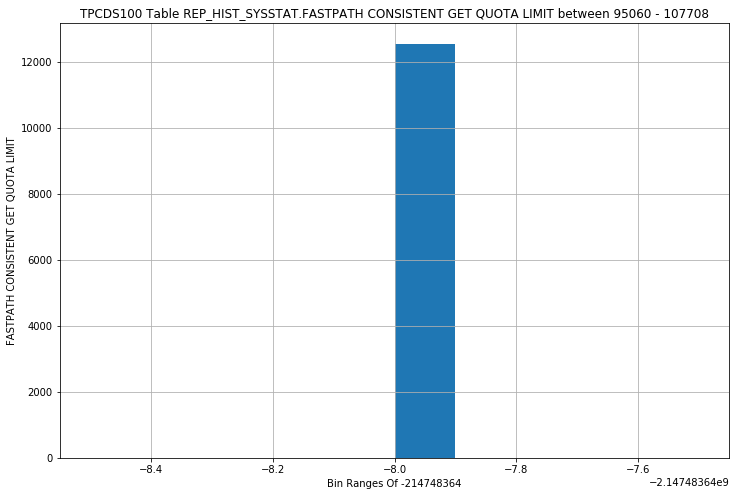

REP_HIST_SYSSTAT - FILE IO SERVICE TIME - STRIPPED HISTOGRAM


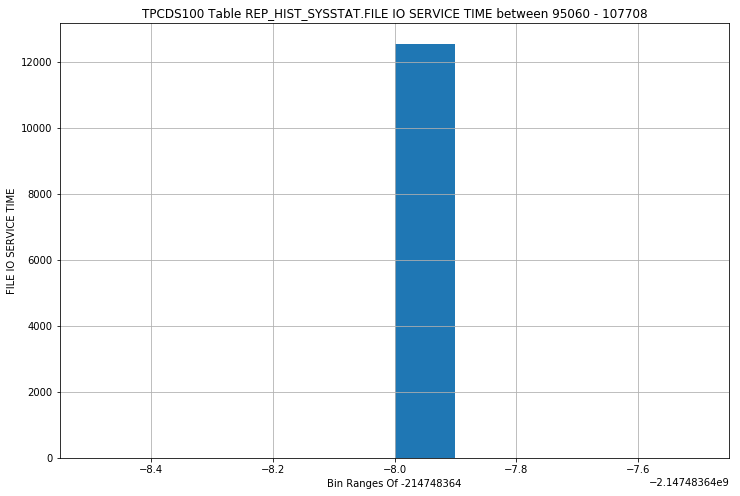

REP_HIST_SYSSTAT - FILE IO WAIT TIME - STRIPPED HISTOGRAM


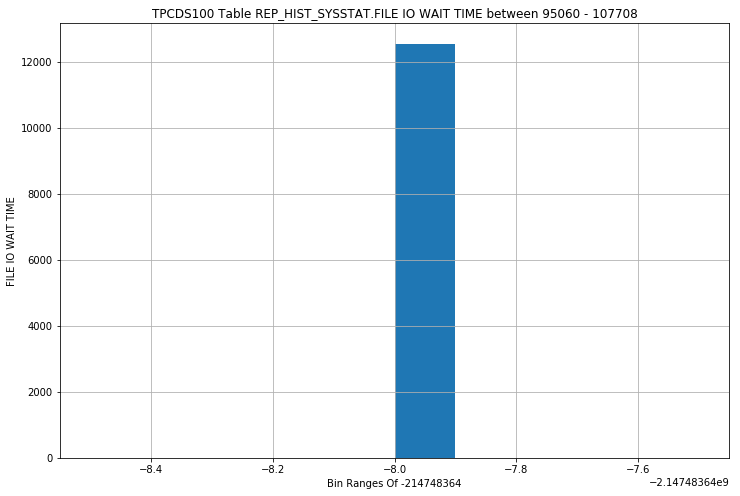

REP_HIST_SYSSTAT - FRAME SIGNATURE MISMATCH - STRIPPED HISTOGRAM


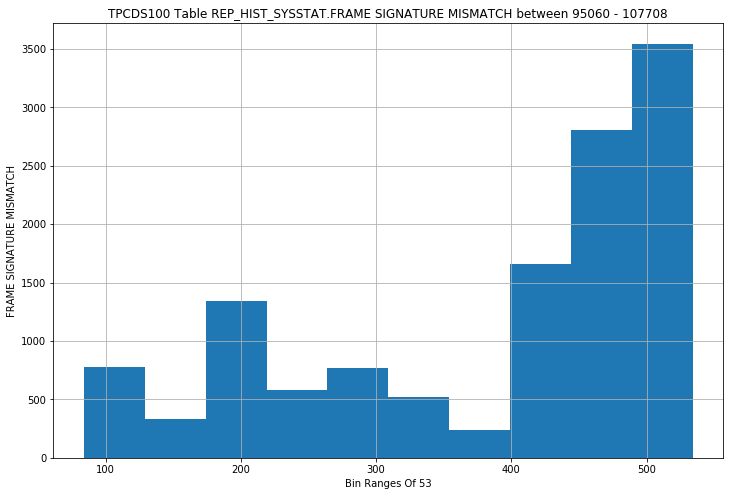

REP_HIST_SYSSTAT - FREE BUFFER INSPECTED - STRIPPED HISTOGRAM


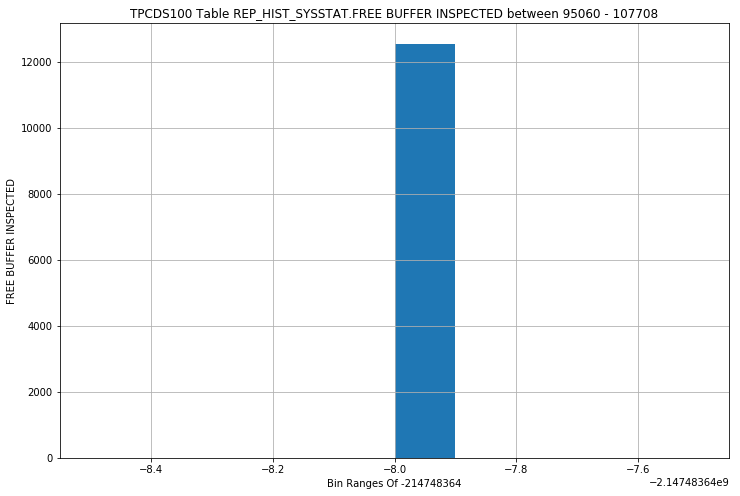

REP_HIST_SYSSTAT - FREE BUFFER REQUESTED - STRIPPED HISTOGRAM


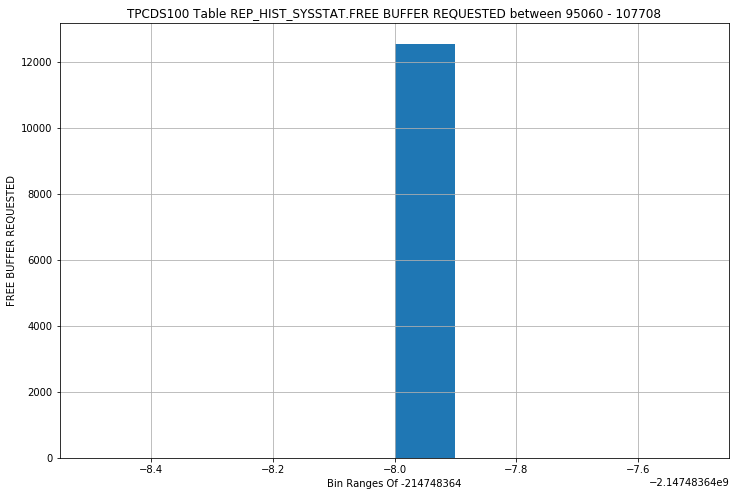

REP_HIST_SYSSTAT - HEAP BLOCK COMPRESS - STRIPPED HISTOGRAM


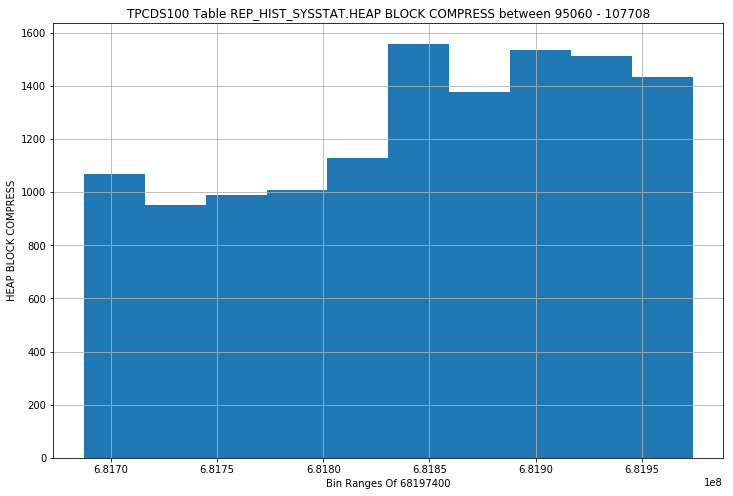

REP_HIST_SYSSTAT - HOT BUFFERS MOVED TO HEAD OF LRU - STRIPPED HISTOGRAM


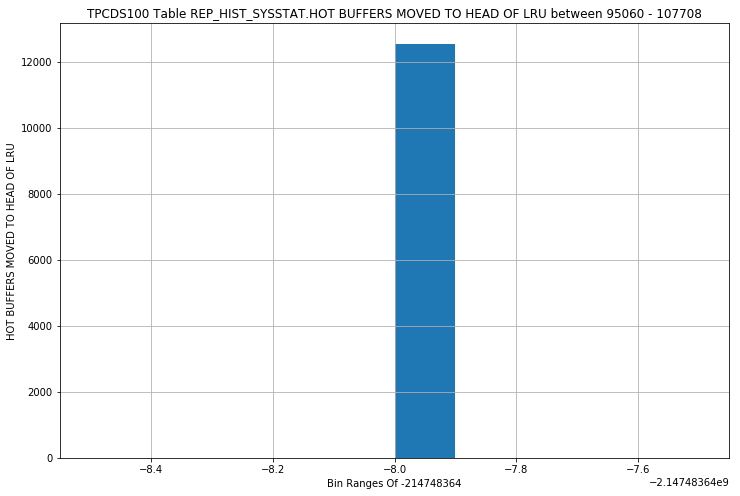

REP_HIST_SYSSTAT - IMMEDIATE (CR) BLOCK CLEANOUT APPLICATIONS - STRIPPED HISTOGRAM


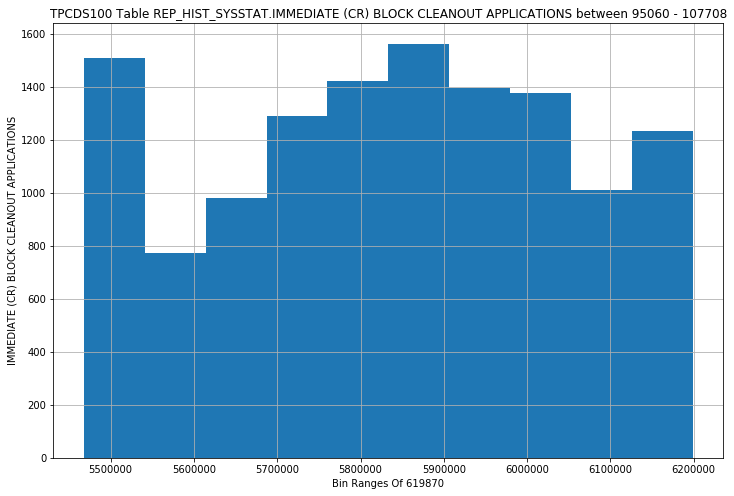

REP_HIST_SYSSTAT - IMMEDIATE (CURRENT) BLOCK CLEANOUT APPLICATIONS - STRIPPED HISTOGRAM


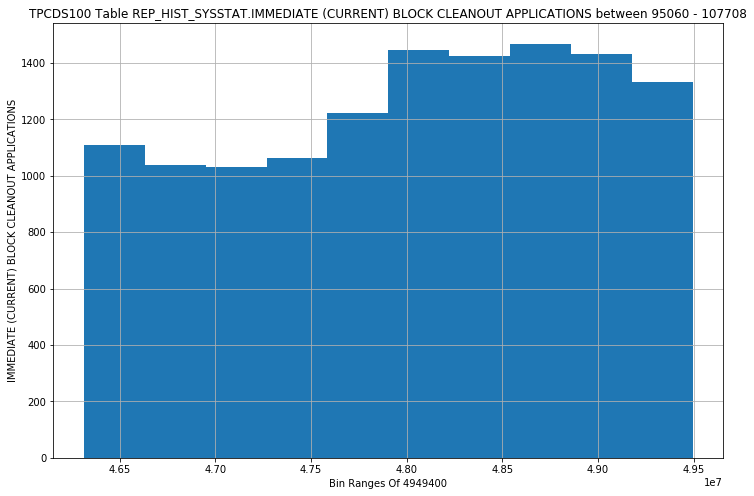

REP_HIST_SYSSTAT - IN CALL IDLE WAIT TIME - STRIPPED HISTOGRAM


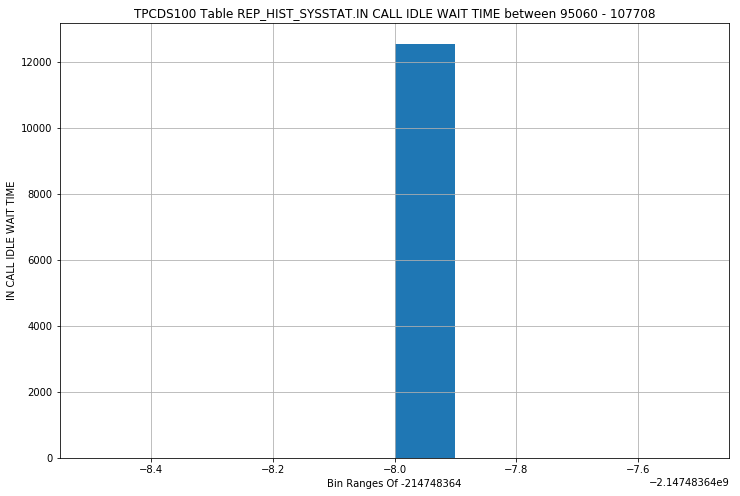

REP_HIST_SYSSTAT - INDEX CRX UPGRADE (POSITIONED) - STRIPPED HISTOGRAM


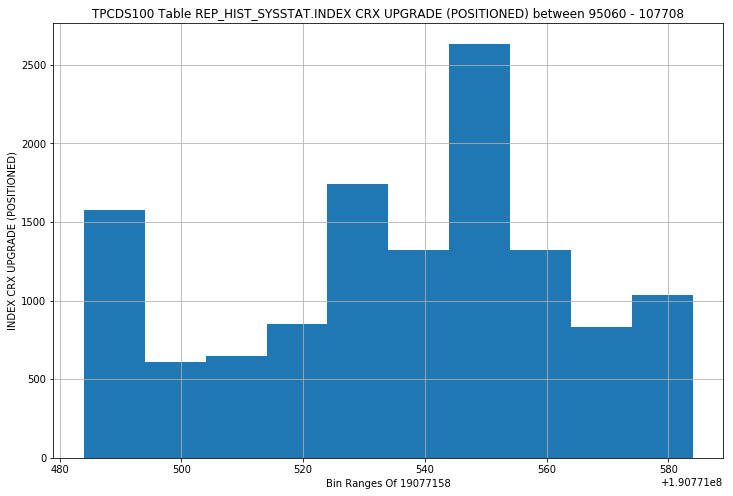

REP_HIST_SYSSTAT - INDEX CRX UPGRADE (PREFETCH) - STRIPPED HISTOGRAM


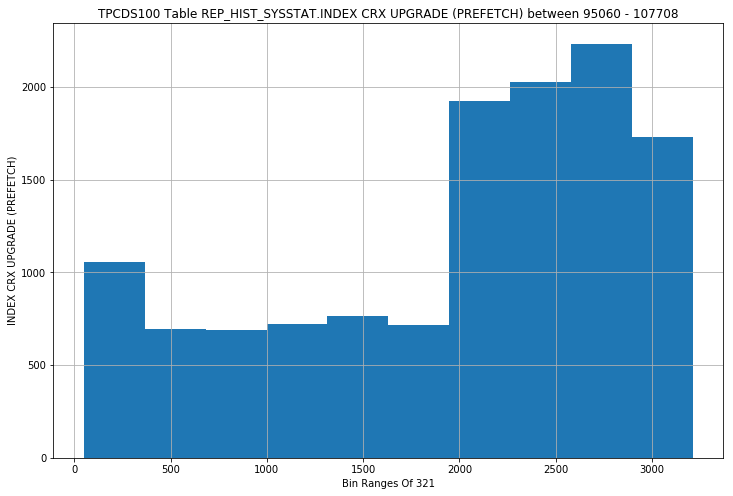

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (DIRECT READ) - STRIPPED HISTOGRAM


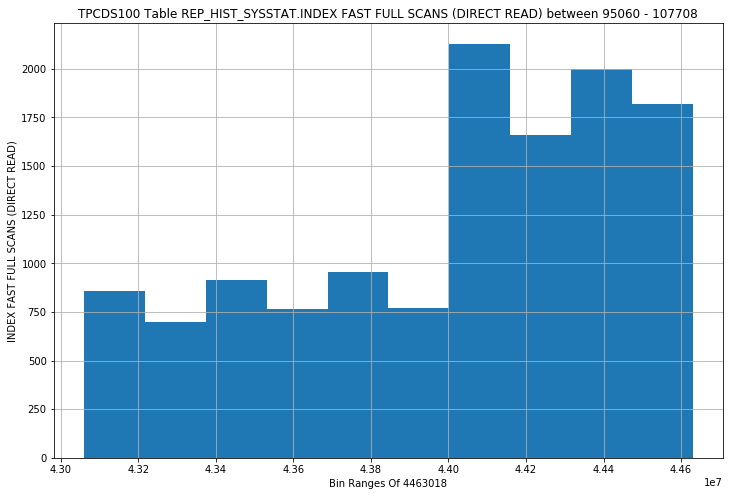

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (FULL) - STRIPPED HISTOGRAM


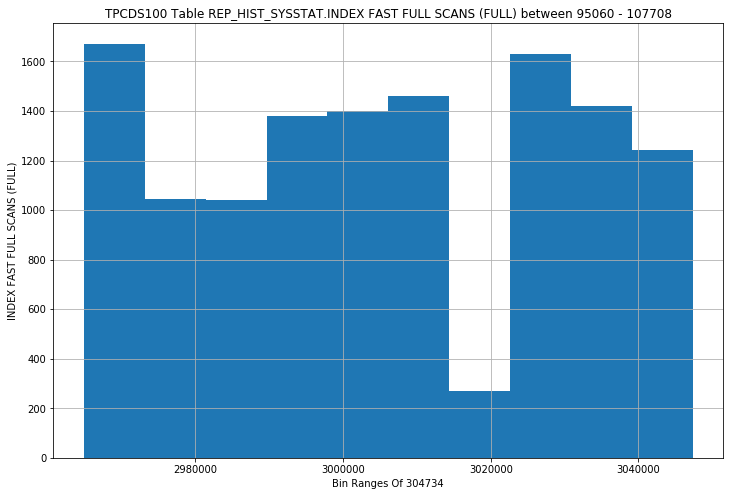

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (ROWID RANGES) - STRIPPED HISTOGRAM


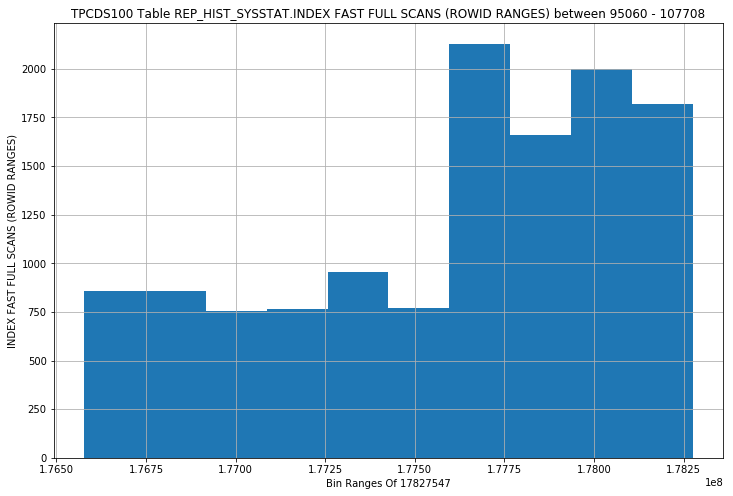

REP_HIST_SYSSTAT - INDEX FETCH BY KEY - STRIPPED HISTOGRAM


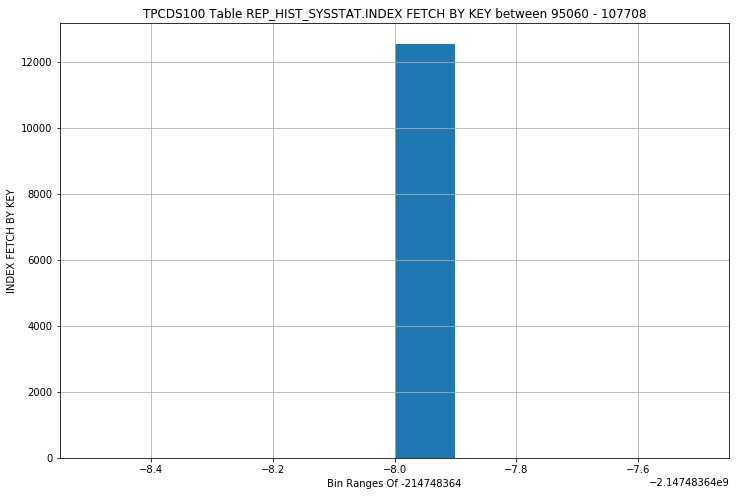

REP_HIST_SYSSTAT - INDEX SCANS KDIIXS1 - STRIPPED HISTOGRAM


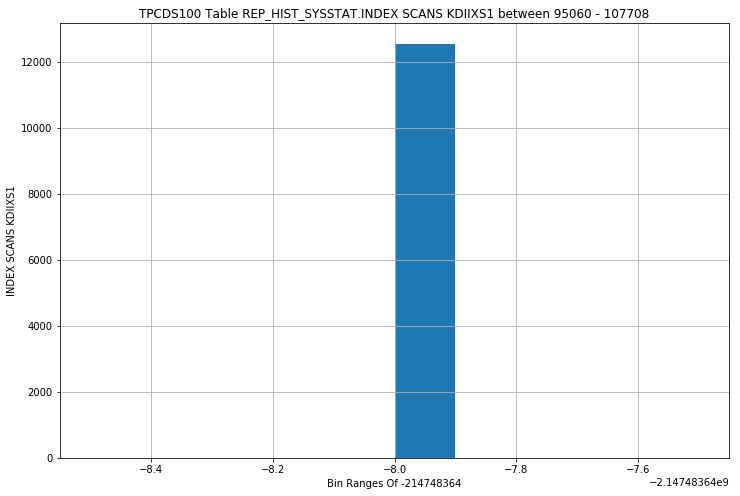

REP_HIST_SYSSTAT - LEAF NODE 90-10 SPLITS - STRIPPED HISTOGRAM


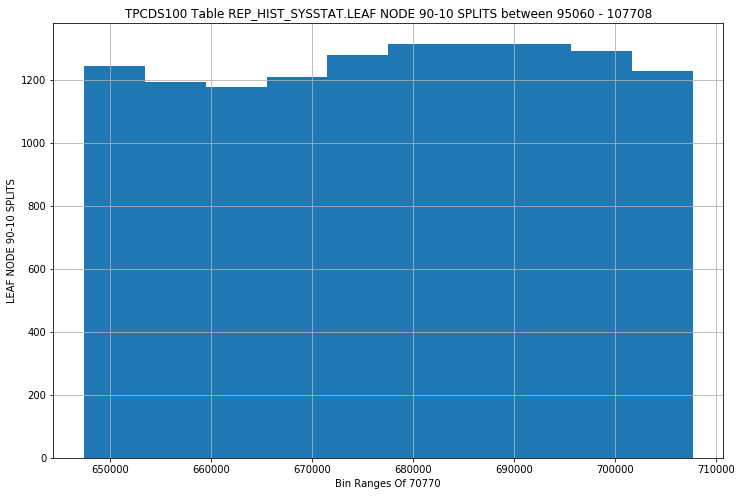

REP_HIST_SYSSTAT - LEAF NODE SPLITS - STRIPPED HISTOGRAM


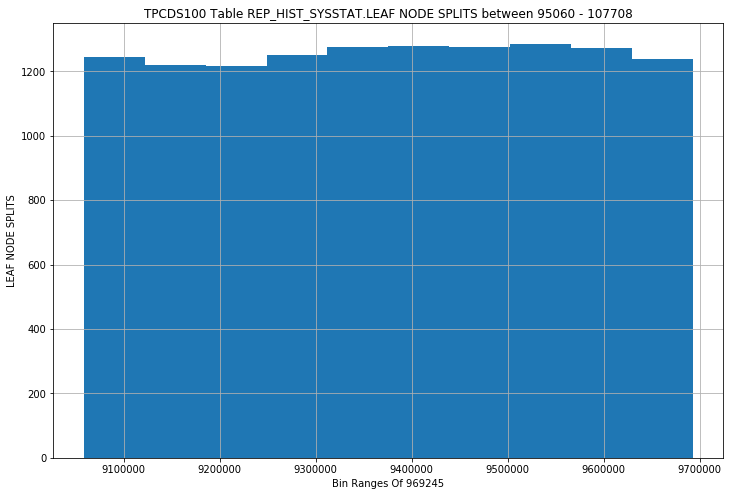

REP_HIST_SYSSTAT - LOB READS - STRIPPED HISTOGRAM


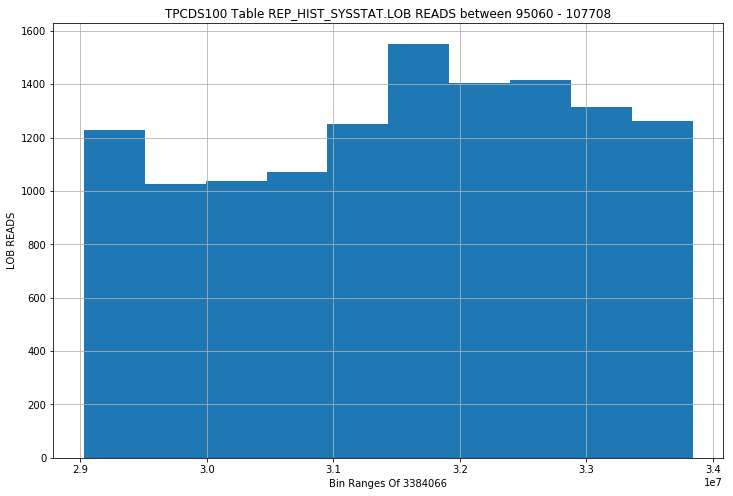

REP_HIST_SYSSTAT - LOB WRITES - STRIPPED HISTOGRAM


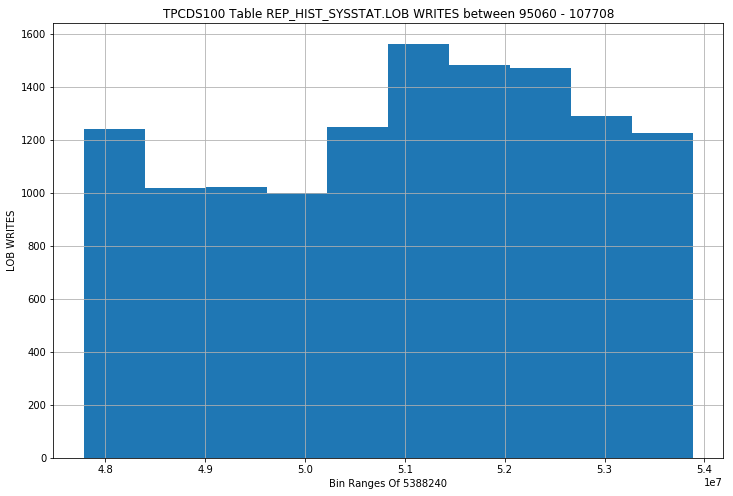

REP_HIST_SYSSTAT - LOB WRITES UNALIGNED - STRIPPED HISTOGRAM


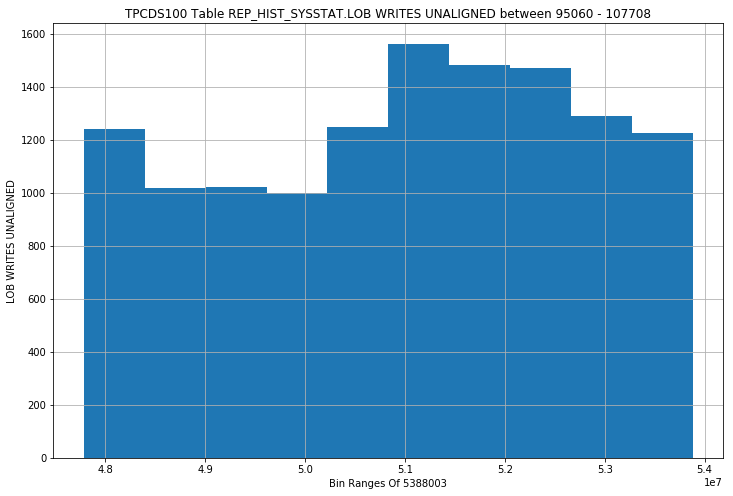

REP_HIST_SYSSTAT - LOGICAL READ BYTES FROM CACHE - STRIPPED HISTOGRAM


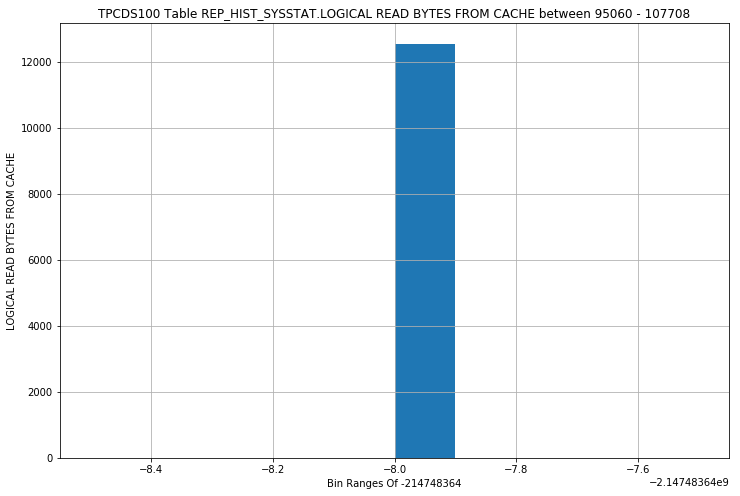

REP_HIST_SYSSTAT - LOGONS CUMULATIVE - STRIPPED HISTOGRAM


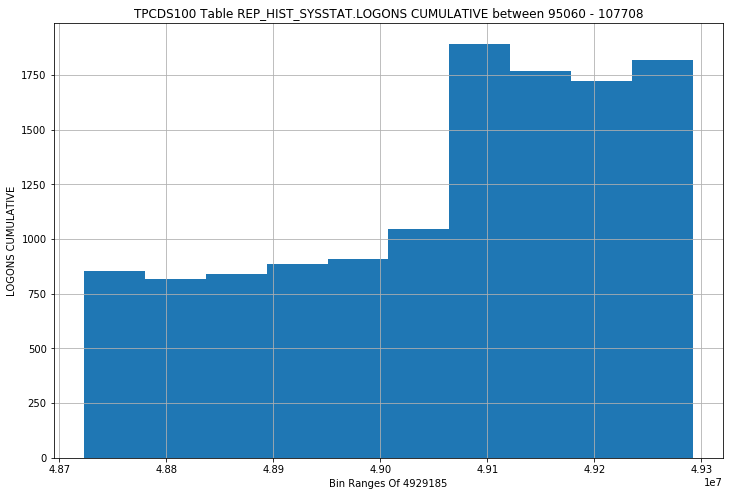

REP_HIST_SYSSTAT - LOGONS CURRENT - STRIPPED HISTOGRAM


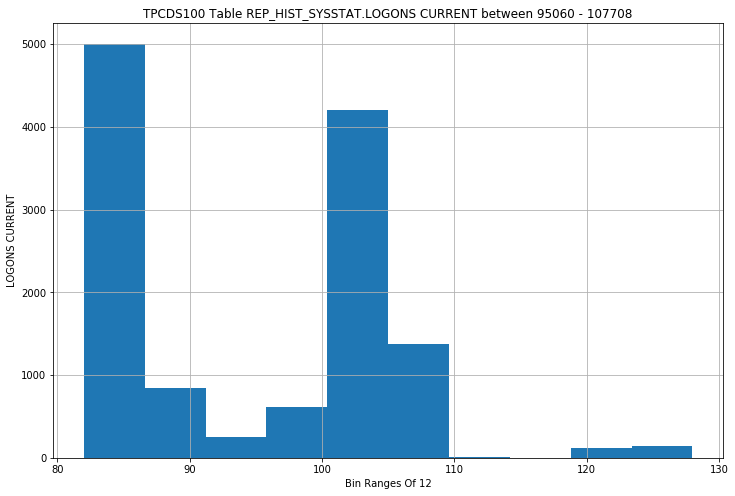

REP_HIST_SYSSTAT - MAX CF ENQ HOLD TIME - STRIPPED HISTOGRAM


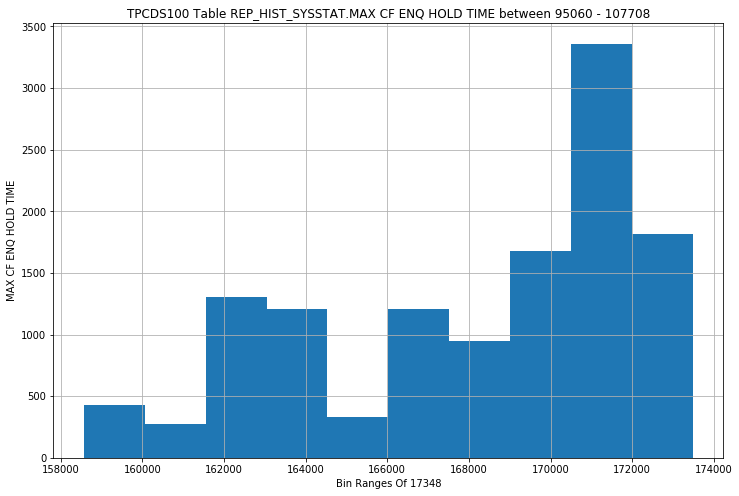

REP_HIST_SYSSTAT - MESSAGES RECEIVED - STRIPPED HISTOGRAM


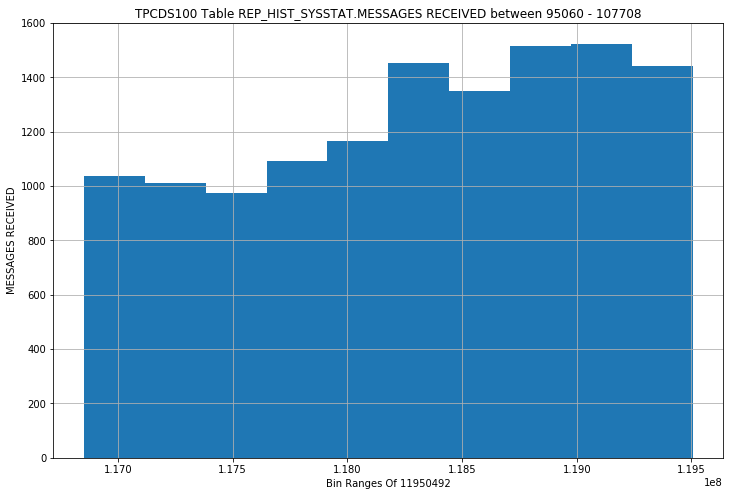

REP_HIST_SYSSTAT - MESSAGES SENT - STRIPPED HISTOGRAM


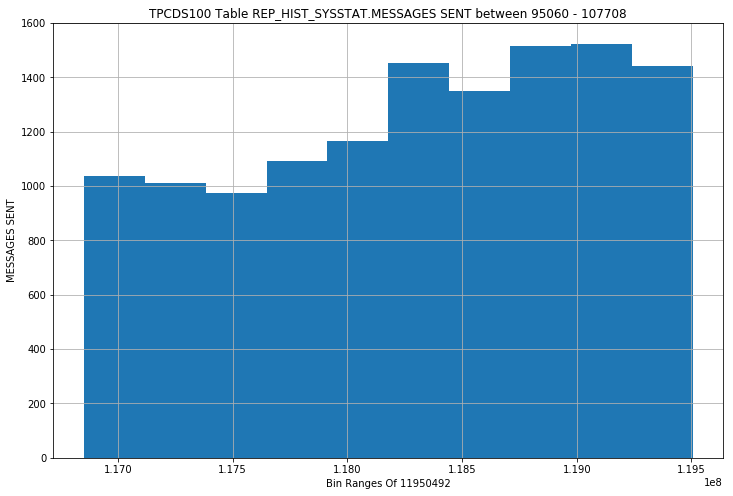

REP_HIST_SYSSTAT - MIN ACTIVE SCN OPTIMIZATION APPLIED ON CR - STRIPPED HISTOGRAM


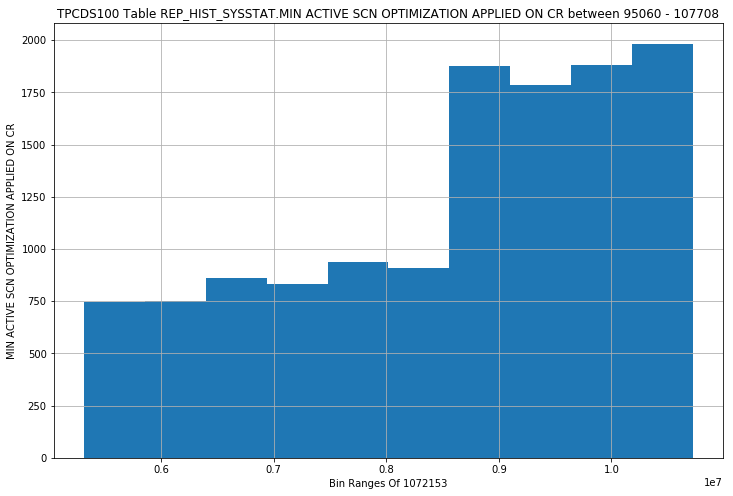

REP_HIST_SYSSTAT - NO BUFFER TO KEEP PINNED COUNT - STRIPPED HISTOGRAM


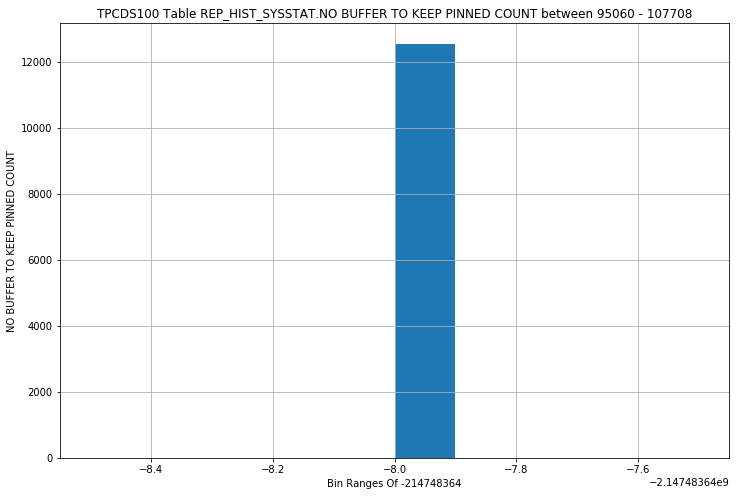

REP_HIST_SYSSTAT - NO WORK - CONSISTENT READ GETS - STRIPPED HISTOGRAM


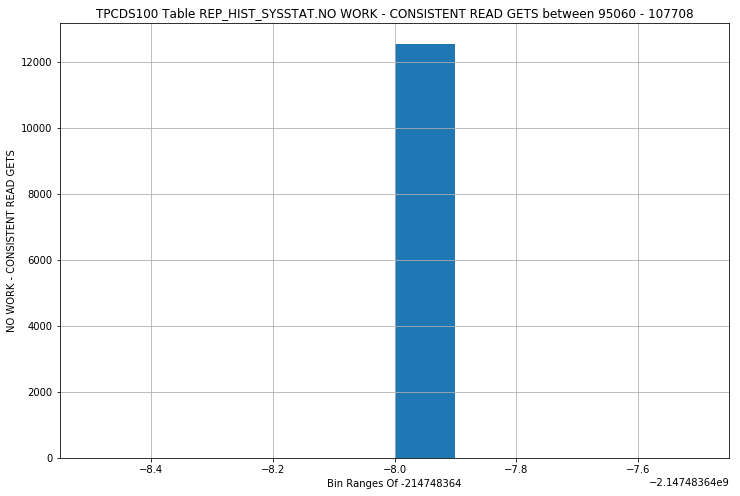

REP_HIST_SYSSTAT - NON-IDLE WAIT COUNT - STRIPPED HISTOGRAM


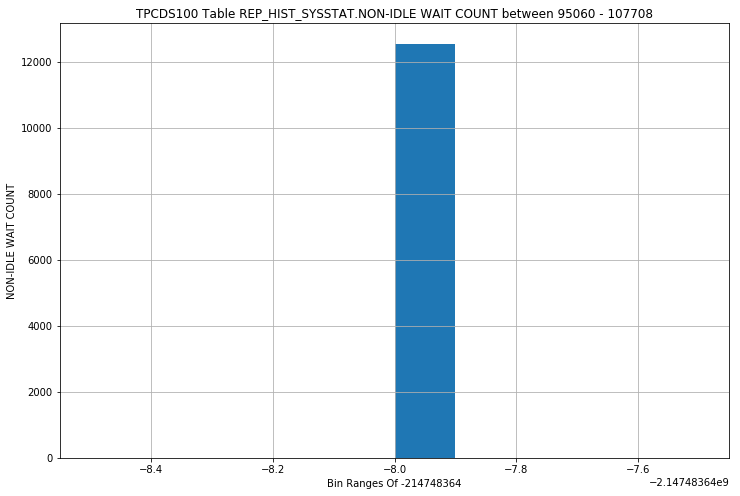

REP_HIST_SYSSTAT - NON-IDLE WAIT TIME - STRIPPED HISTOGRAM


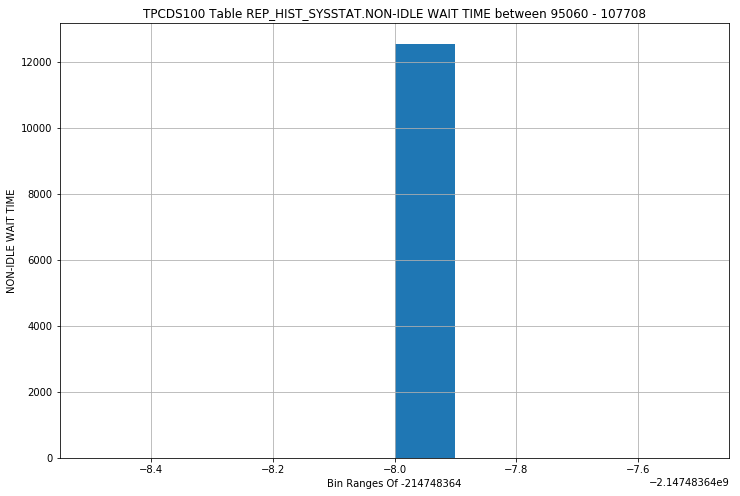

REP_HIST_SYSSTAT - OPENED CURSORS CUMULATIVE - STRIPPED HISTOGRAM


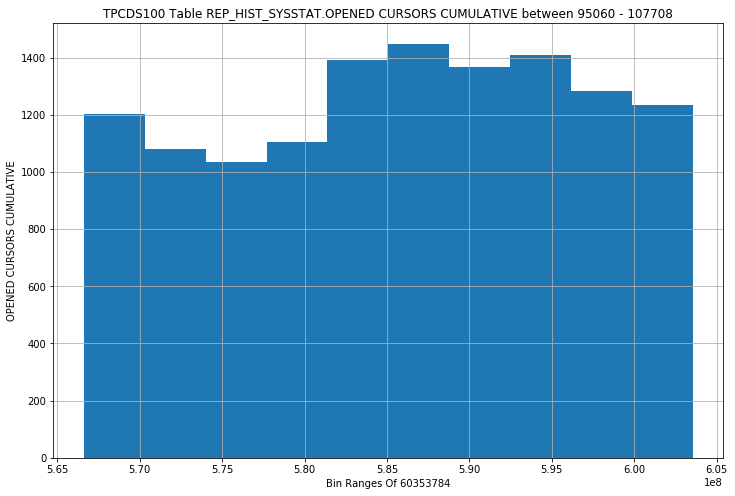

REP_HIST_SYSSTAT - OPENED CURSORS CURRENT - STRIPPED HISTOGRAM


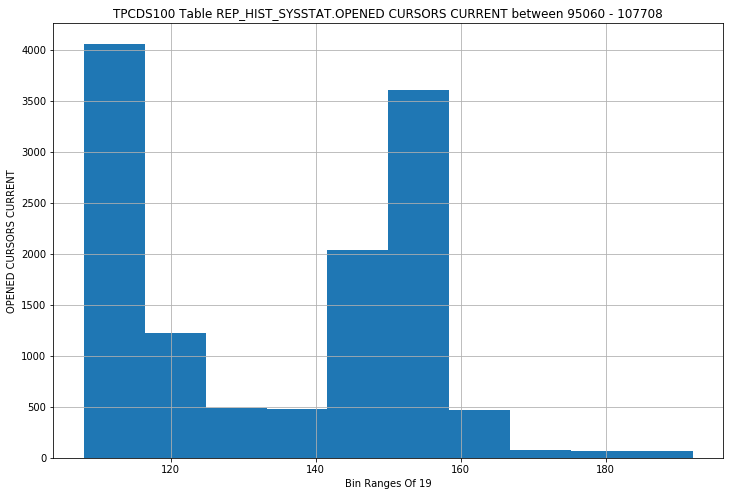

REP_HIST_SYSSTAT - PARSE COUNT (DESCRIBE) - STRIPPED HISTOGRAM


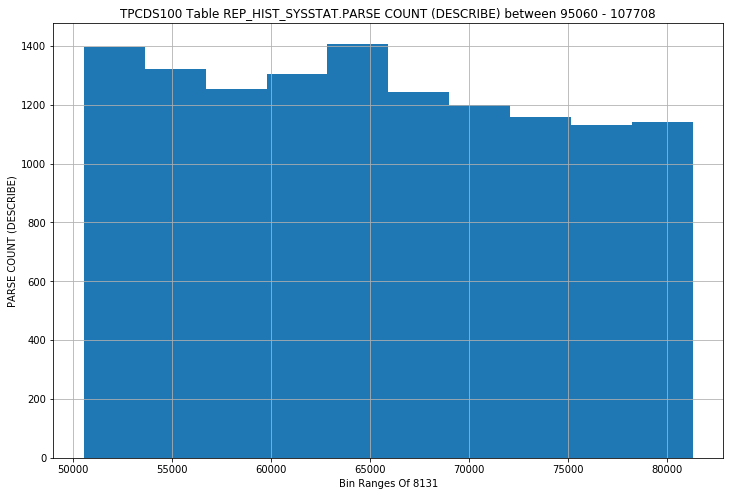

REP_HIST_SYSSTAT - PARSE COUNT (FAILURES) - STRIPPED HISTOGRAM


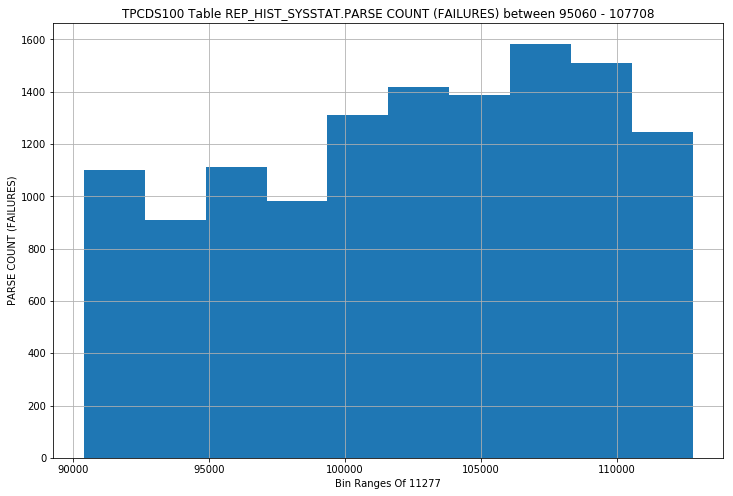

REP_HIST_SYSSTAT - PARSE COUNT (HARD) - STRIPPED HISTOGRAM


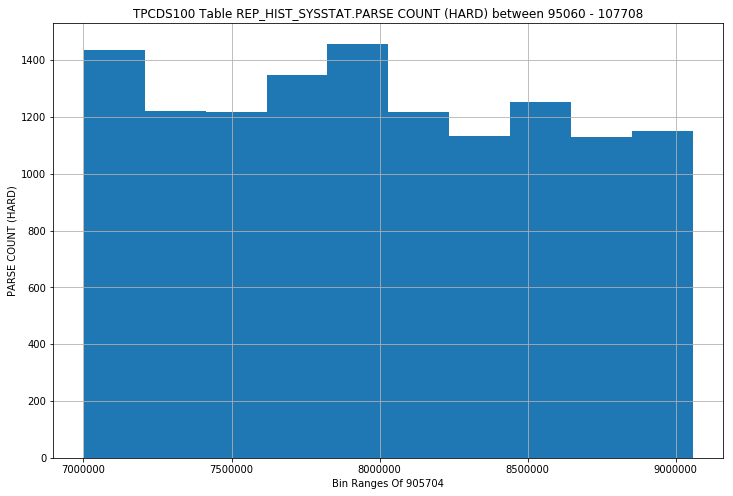

REP_HIST_SYSSTAT - PARSE COUNT (TOTAL) - STRIPPED HISTOGRAM


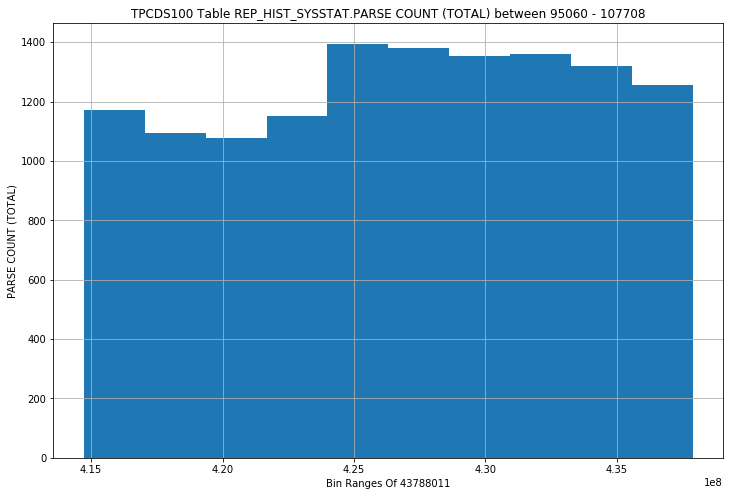

REP_HIST_SYSSTAT - PARSE TIME CPU - STRIPPED HISTOGRAM


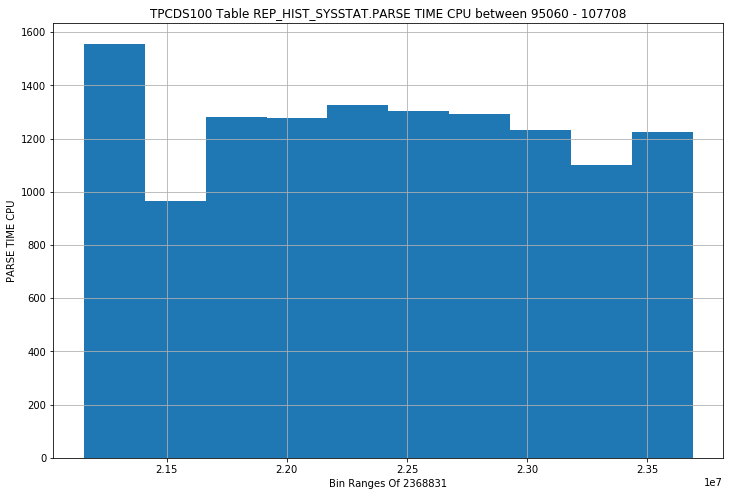

REP_HIST_SYSSTAT - PARSE TIME ELAPSED - STRIPPED HISTOGRAM


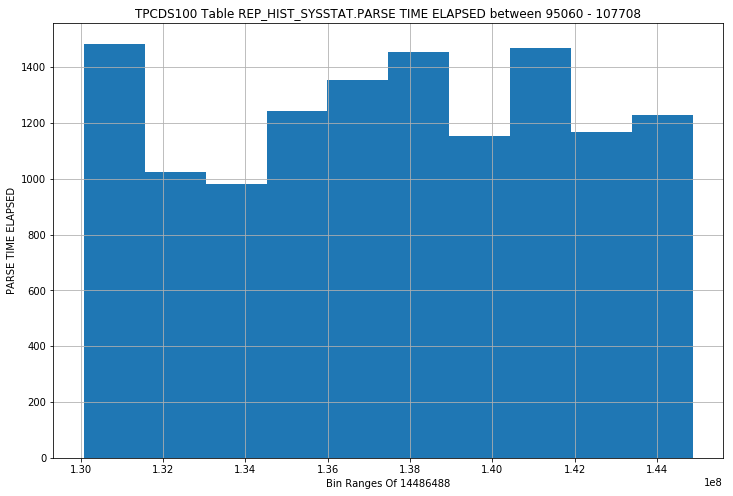

REP_HIST_SYSSTAT - PHYSICAL READ IO REQUESTS - STRIPPED HISTOGRAM


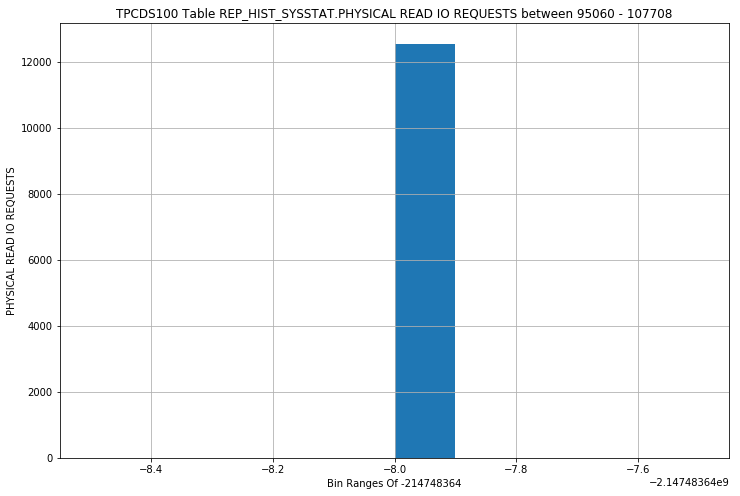

REP_HIST_SYSSTAT - PHYSICAL READ BYTES - STRIPPED HISTOGRAM


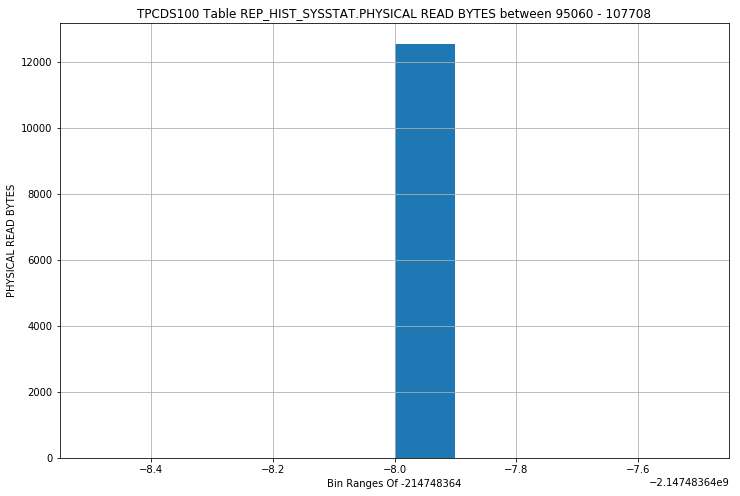

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL IO REQUESTS - STRIPPED HISTOGRAM


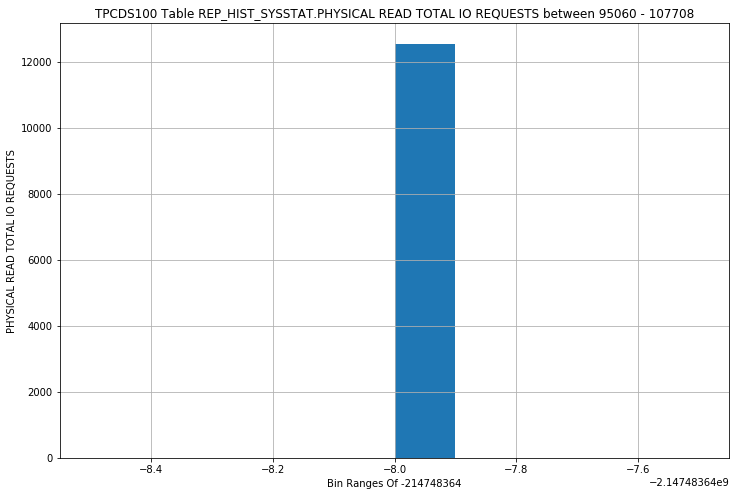

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL BYTES - STRIPPED HISTOGRAM


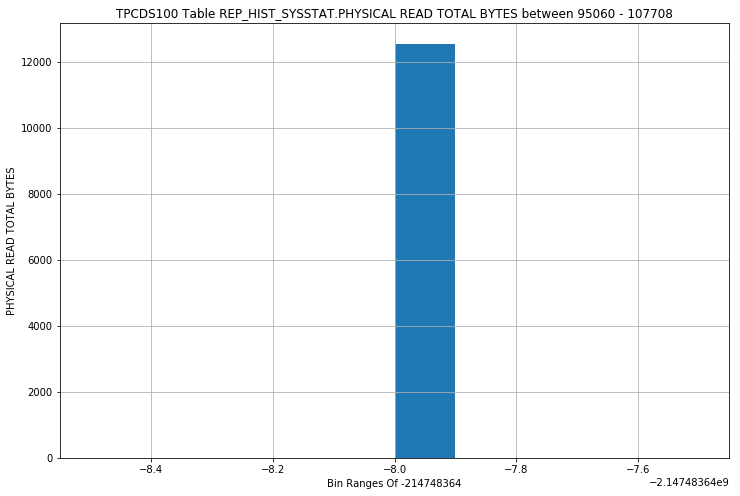

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL MULTI BLOCK REQUESTS - STRIPPED HISTOGRAM


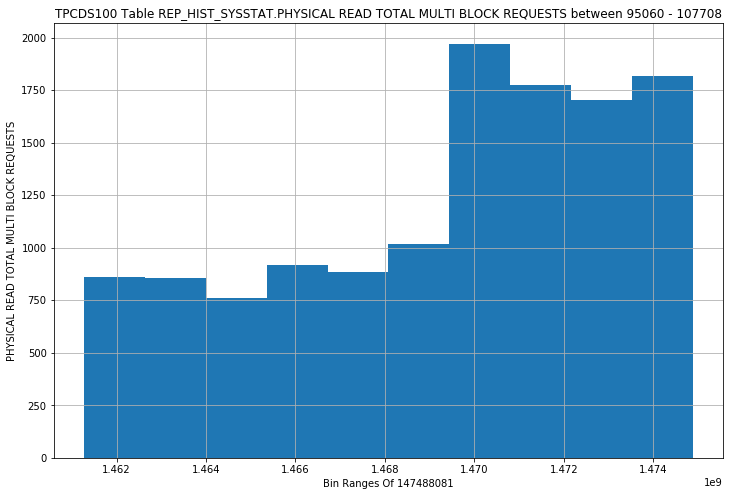

REP_HIST_SYSSTAT - PHYSICAL READS - STRIPPED HISTOGRAM


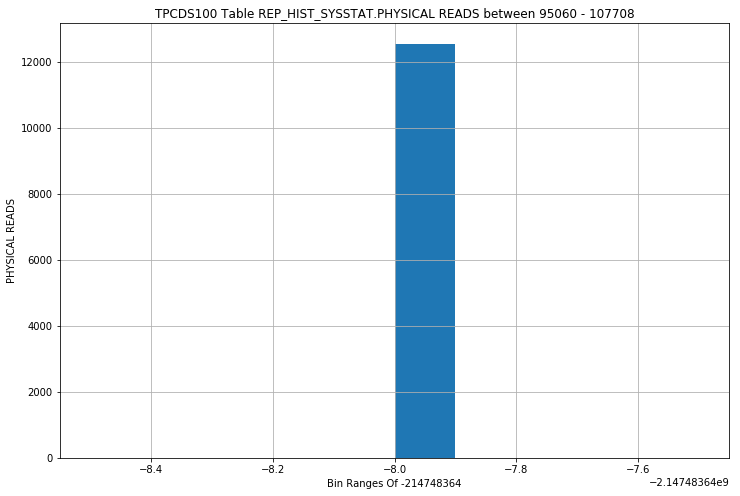

REP_HIST_SYSSTAT - PHYSICAL READS CACHE - STRIPPED HISTOGRAM


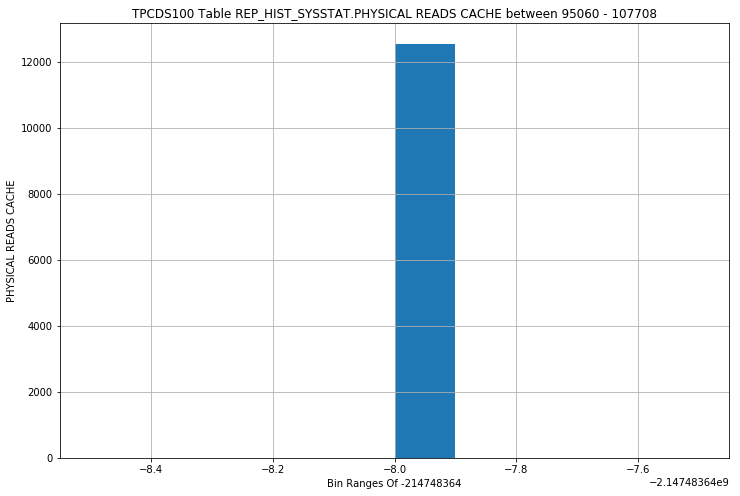

REP_HIST_SYSSTAT - PHYSICAL READS CACHE PREFETCH - STRIPPED HISTOGRAM


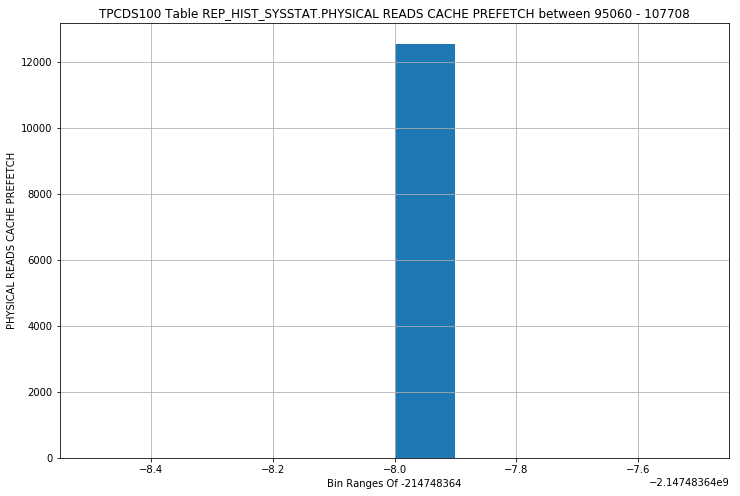

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT - STRIPPED HISTOGRAM


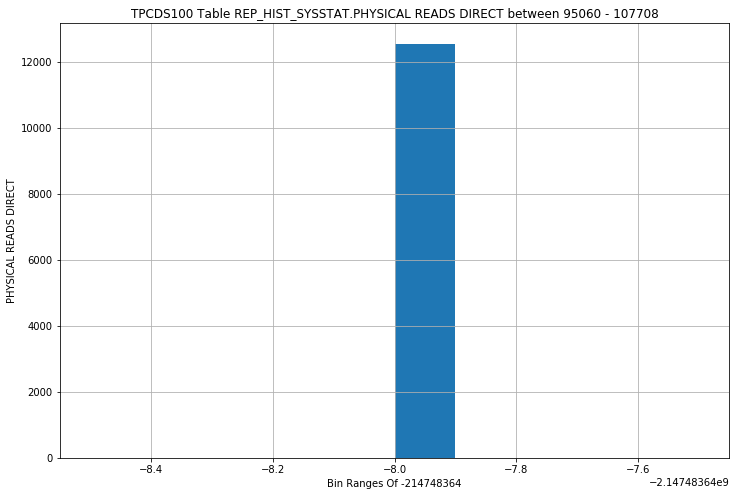

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT (LOB) - STRIPPED HISTOGRAM


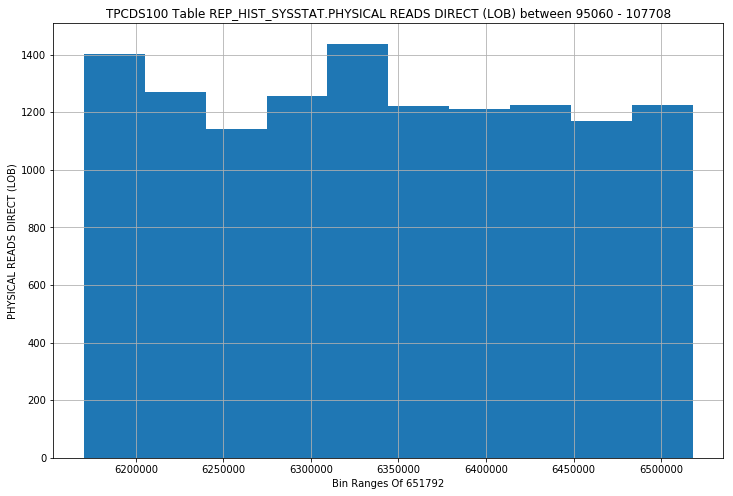

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT TEMPORARY TABLESPACE - STRIPPED HISTOGRAM


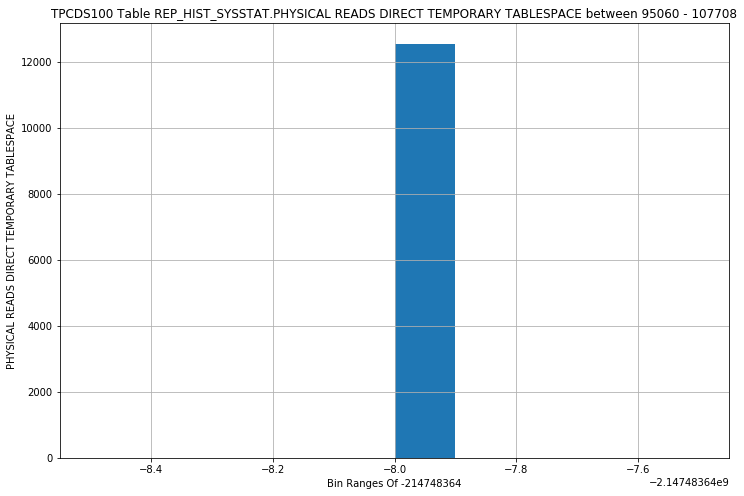

REP_HIST_SYSSTAT - PHYSICAL WRITE IO REQUESTS - STRIPPED HISTOGRAM


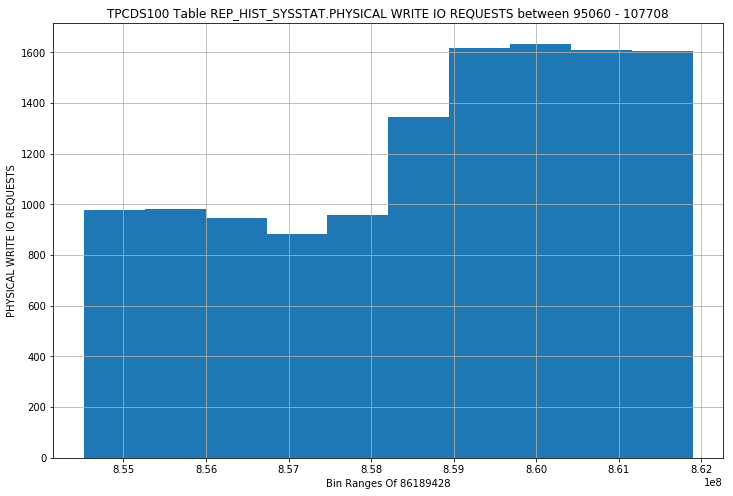

REP_HIST_SYSSTAT - PHYSICAL WRITE BYTES - STRIPPED HISTOGRAM


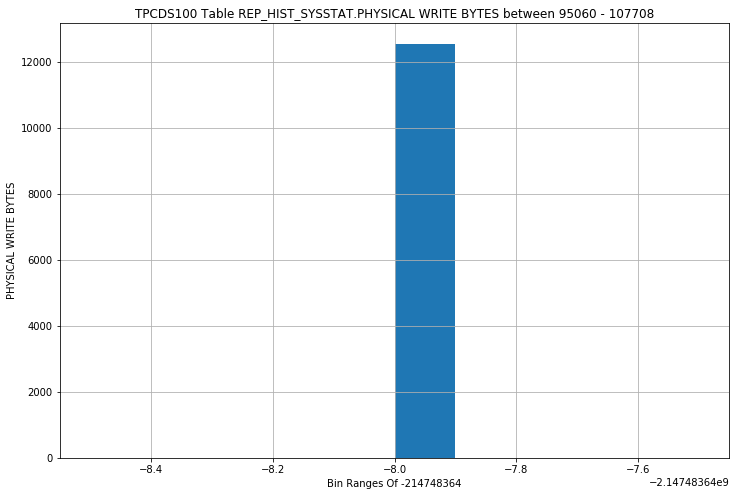

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL IO REQUESTS - STRIPPED HISTOGRAM


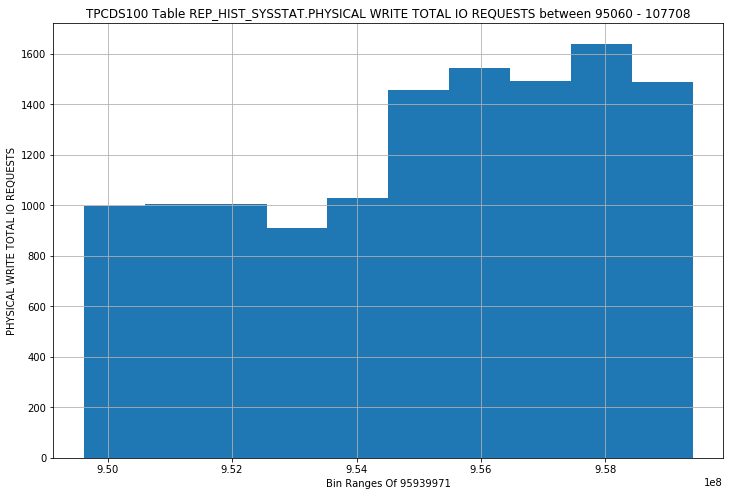

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL BYTES - STRIPPED HISTOGRAM


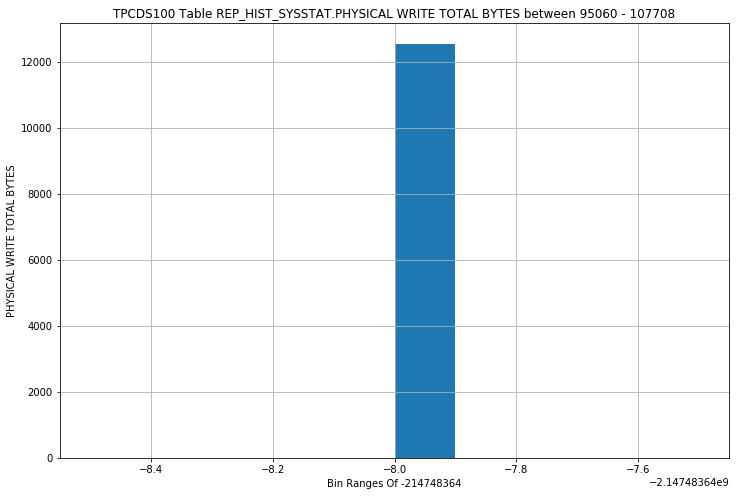

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL MULTI BLOCK REQUESTS - STRIPPED HISTOGRAM


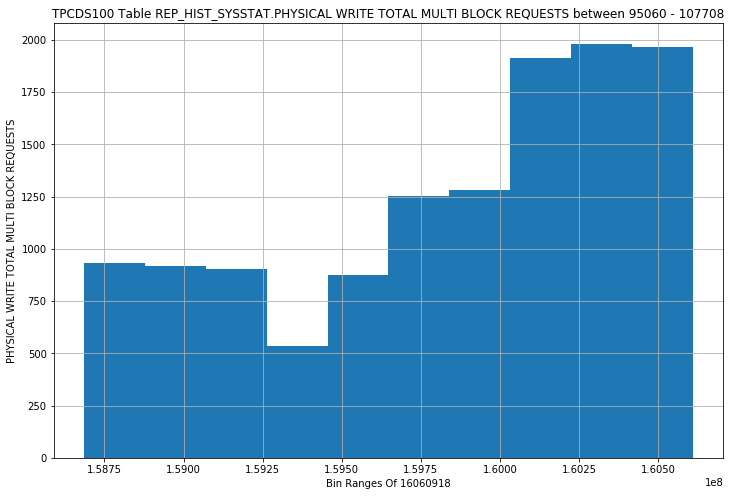

REP_HIST_SYSSTAT - PHYSICAL WRITES - STRIPPED HISTOGRAM


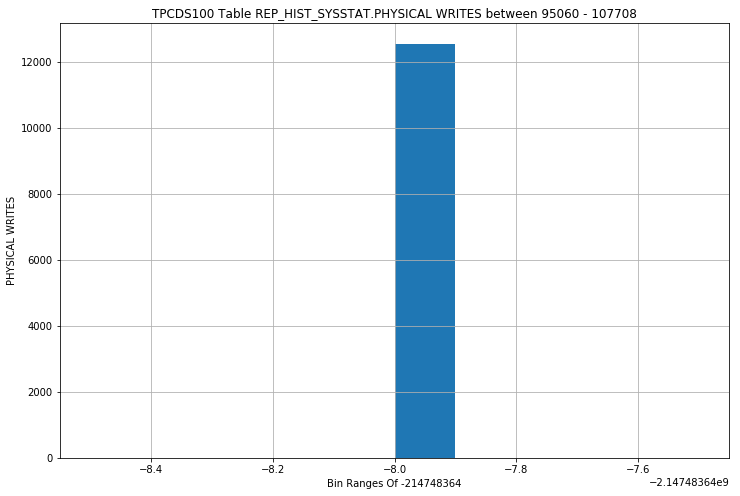

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT - STRIPPED HISTOGRAM


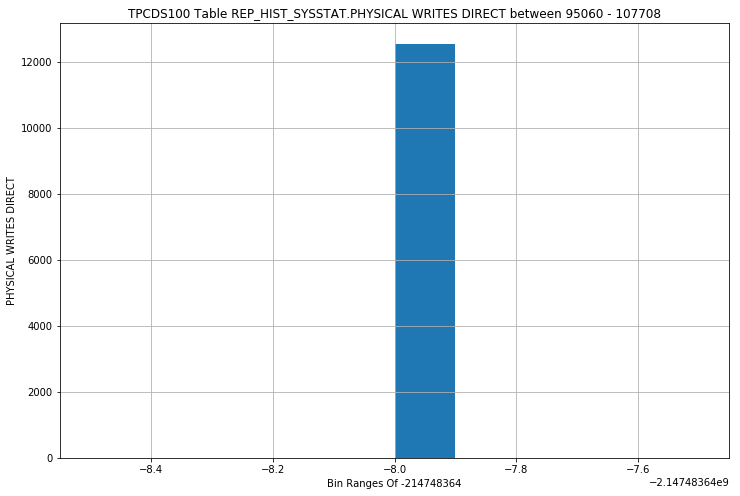

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT (LOB) - STRIPPED HISTOGRAM


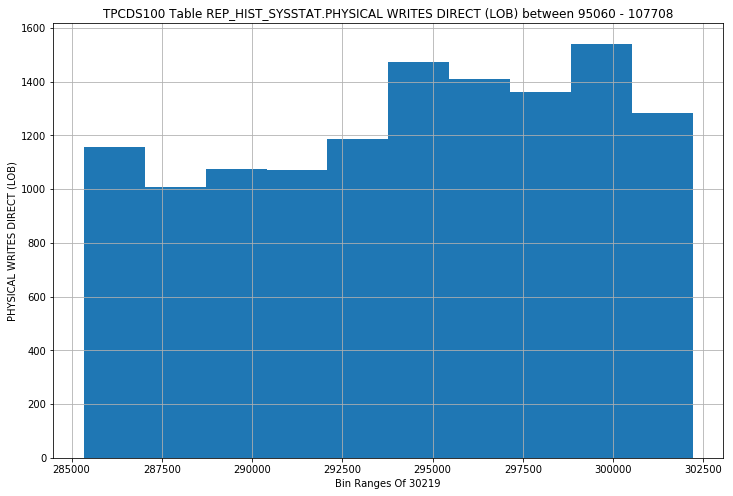

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT TEMPORARY TABLESPACE - STRIPPED HISTOGRAM


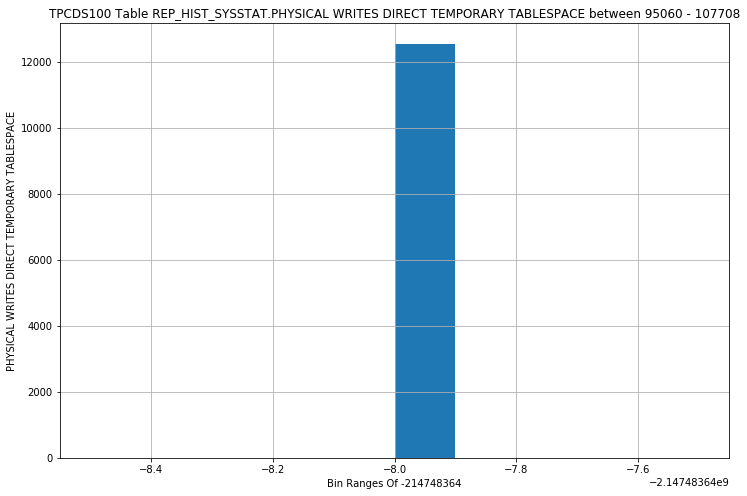

REP_HIST_SYSSTAT - PHYSICAL WRITES FROM CACHE - STRIPPED HISTOGRAM


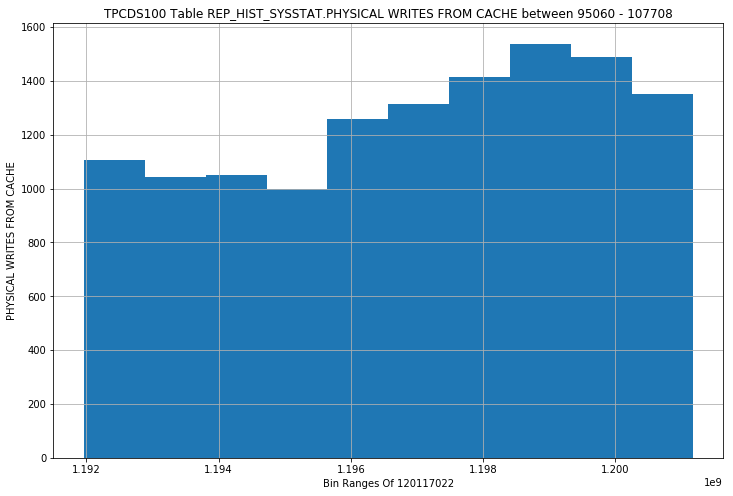

REP_HIST_SYSSTAT - PHYSICAL WRITES NON CHECKPOINT - STRIPPED HISTOGRAM


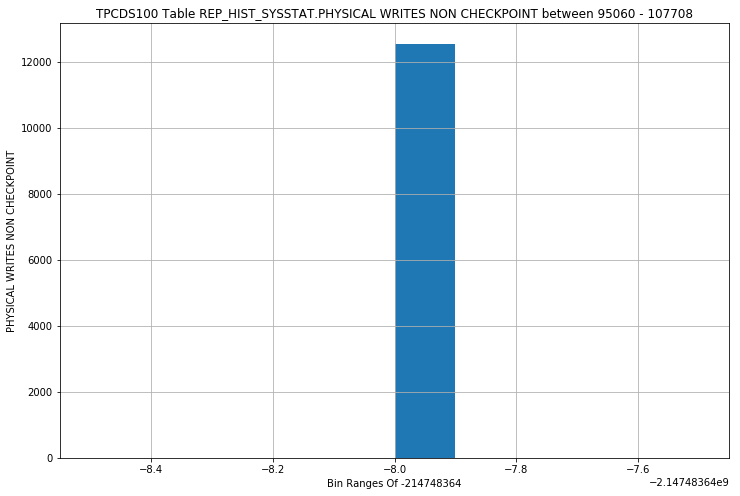

REP_HIST_SYSSTAT - PINNED BUFFERS INSPECTED - STRIPPED HISTOGRAM


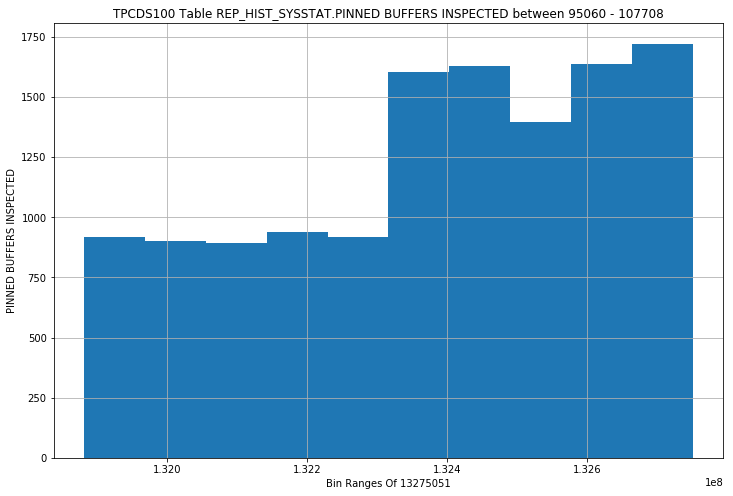

REP_HIST_SYSSTAT - PINNED CURSORS CURRENT - STRIPPED HISTOGRAM


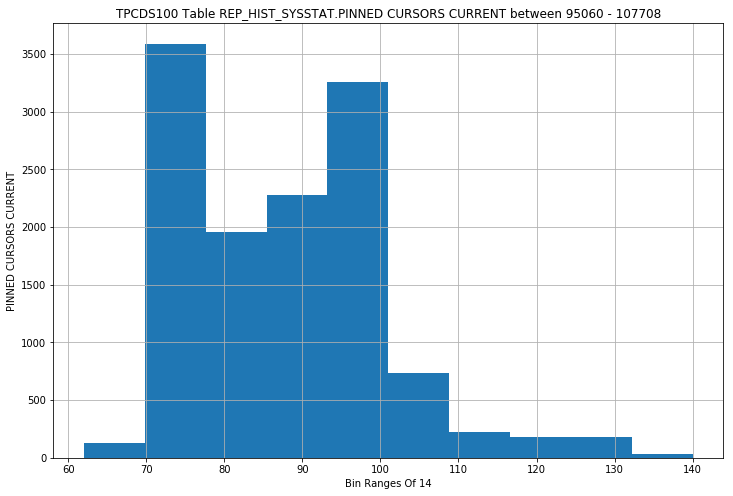

REP_HIST_SYSSTAT - PREFETCH CLIENTS - DEFAULT - STRIPPED HISTOGRAM


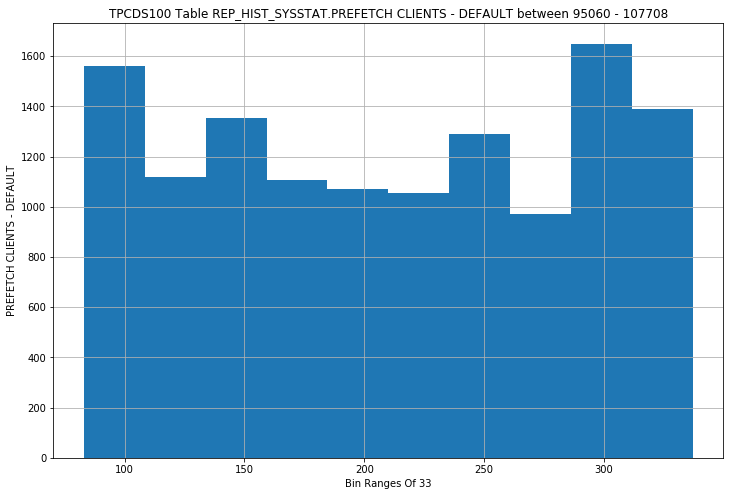

REP_HIST_SYSSTAT - PREFETCHED BLOCKS AGED OUT BEFORE USE - STRIPPED HISTOGRAM


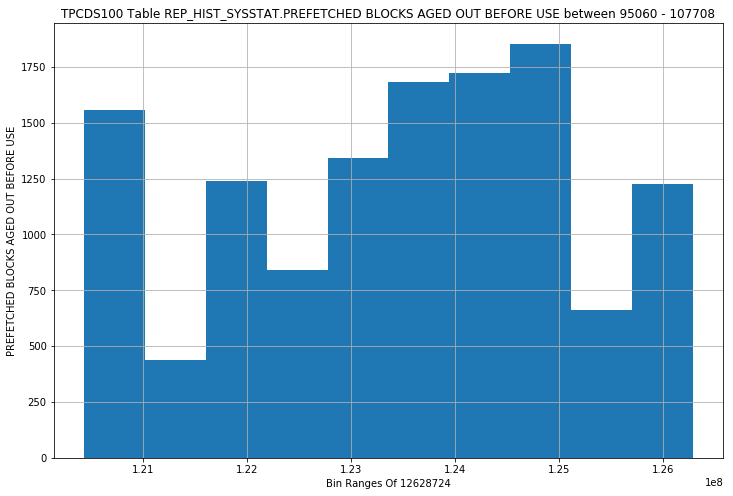

REP_HIST_SYSSTAT - PROCESS LAST NON-IDLE TIME - STRIPPED HISTOGRAM


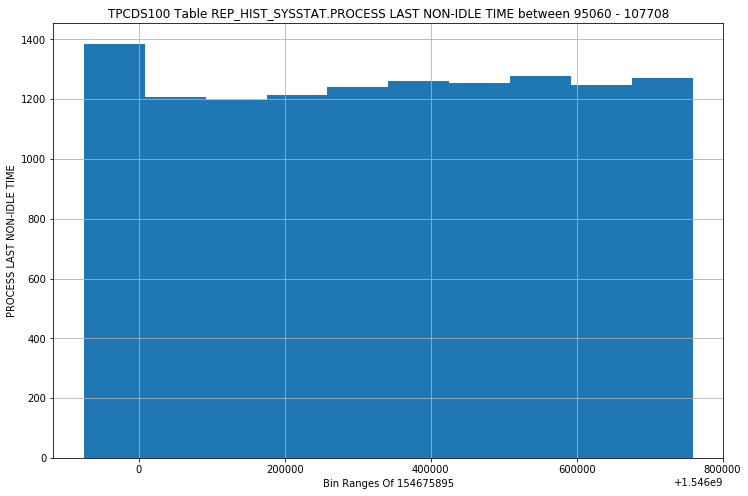

REP_HIST_SYSSTAT - QUERIES PARALLELIZED - STRIPPED HISTOGRAM


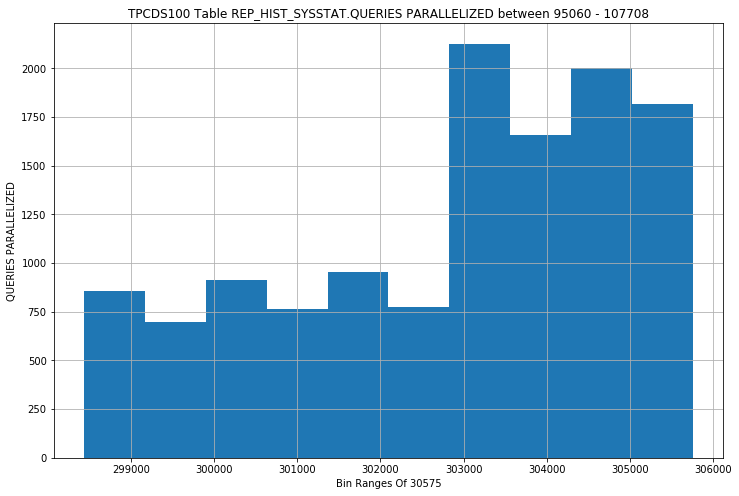

REP_HIST_SYSSTAT - RECURSIVE CALLS - STRIPPED HISTOGRAM


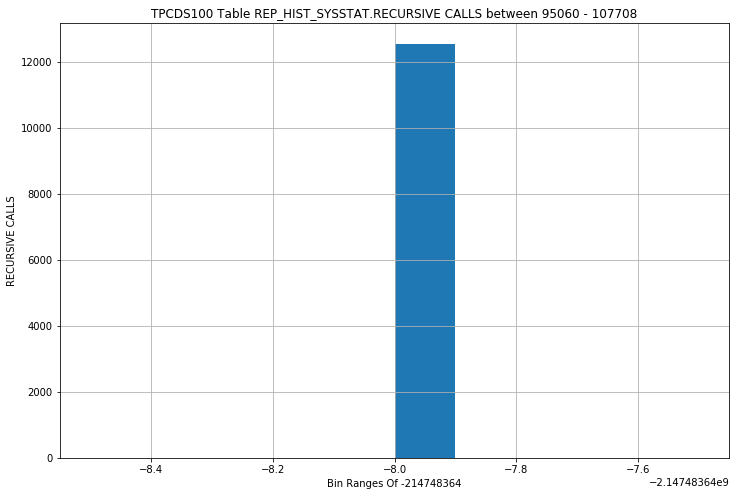

REP_HIST_SYSSTAT - RECURSIVE CPU USAGE - STRIPPED HISTOGRAM


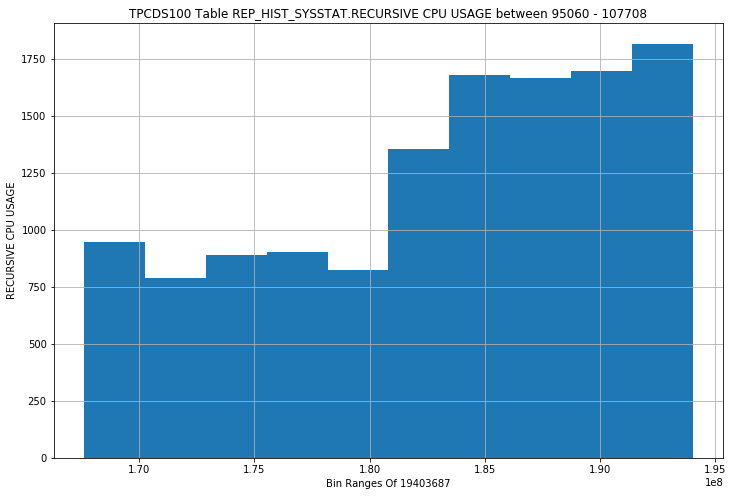

REP_HIST_SYSSTAT - REDO BLOCKS CHECKSUMMED BY FG (EXCLUSIVE) - STRIPPED HISTOGRAM


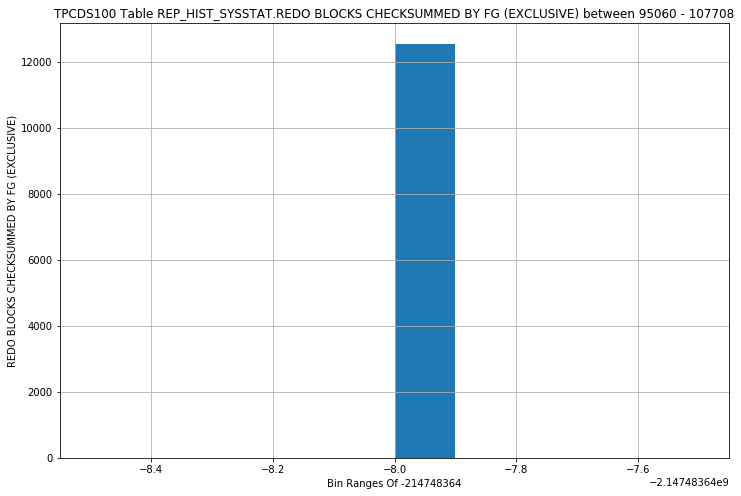

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN - STRIPPED HISTOGRAM


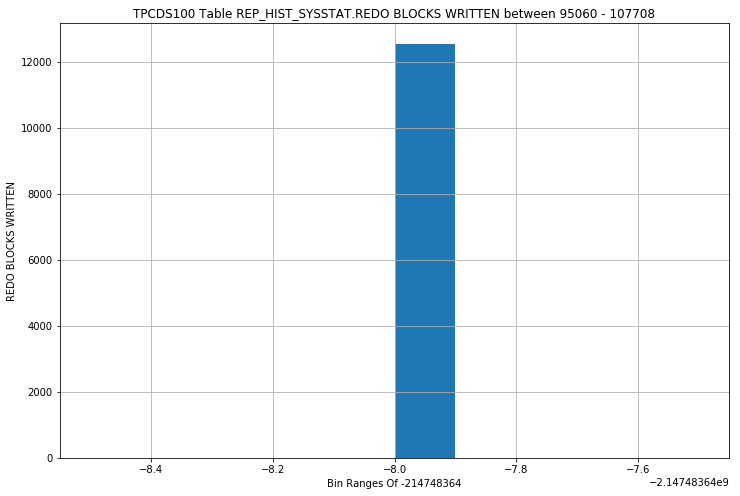

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN (GROUP 0) - STRIPPED HISTOGRAM


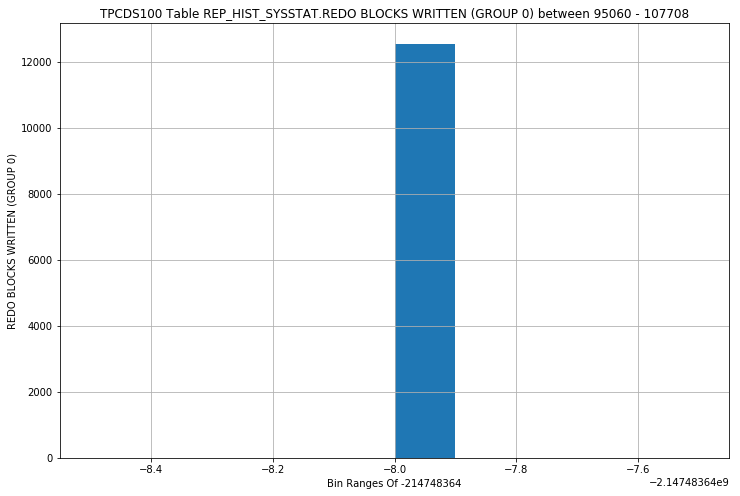

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN (GROUP 1) - STRIPPED HISTOGRAM


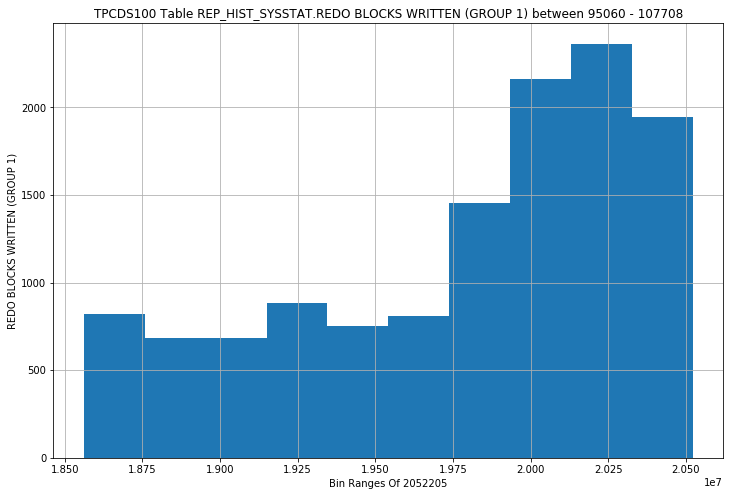

REP_HIST_SYSSTAT - REDO BUFFER ALLOCATION RETRIES - STRIPPED HISTOGRAM


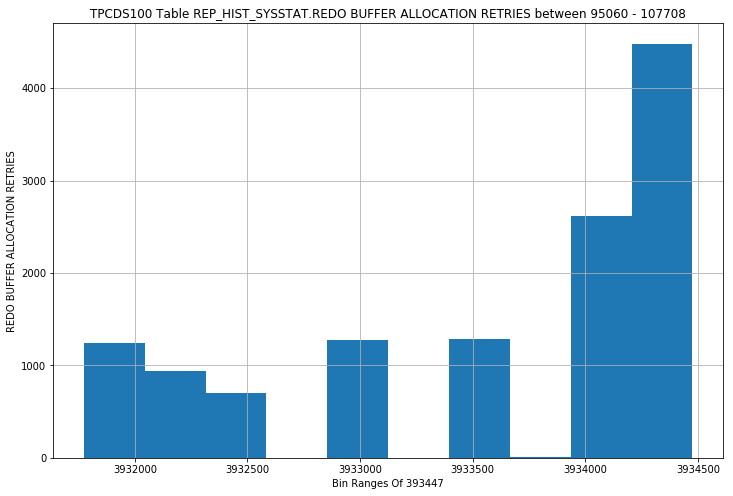

REP_HIST_SYSSTAT - REDO ENTRIES - STRIPPED HISTOGRAM


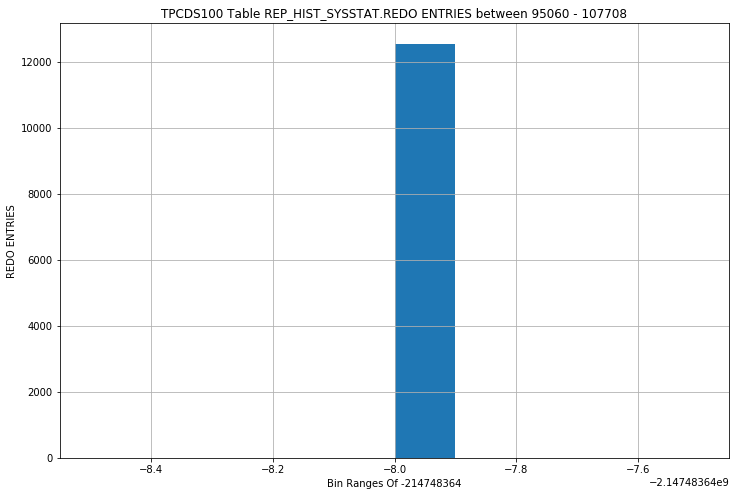

REP_HIST_SYSSTAT - REDO LOG SPACE REQUESTS - STRIPPED HISTOGRAM


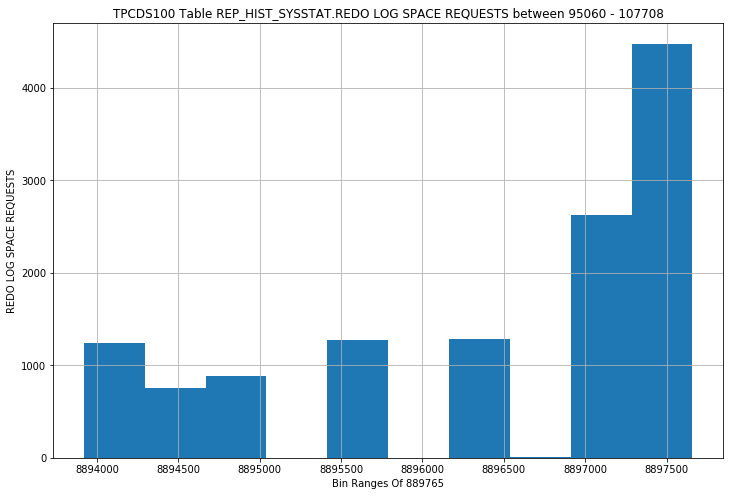

REP_HIST_SYSSTAT - REDO LOG SPACE WAIT TIME - STRIPPED HISTOGRAM


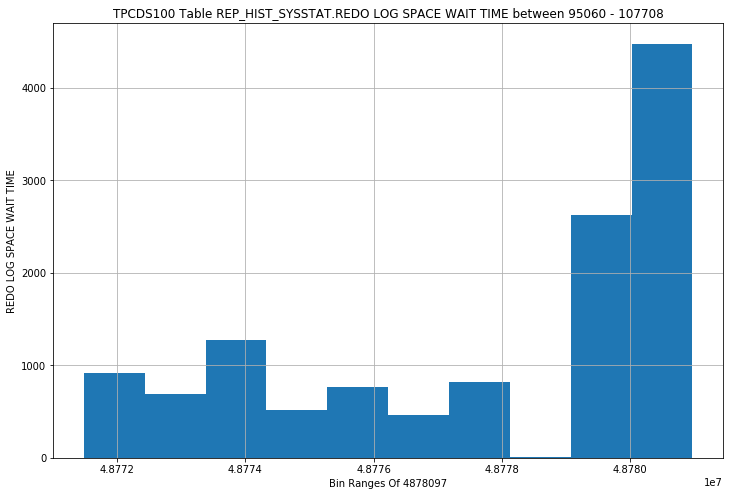

REP_HIST_SYSSTAT - REDO ORDERING MARKS - STRIPPED HISTOGRAM


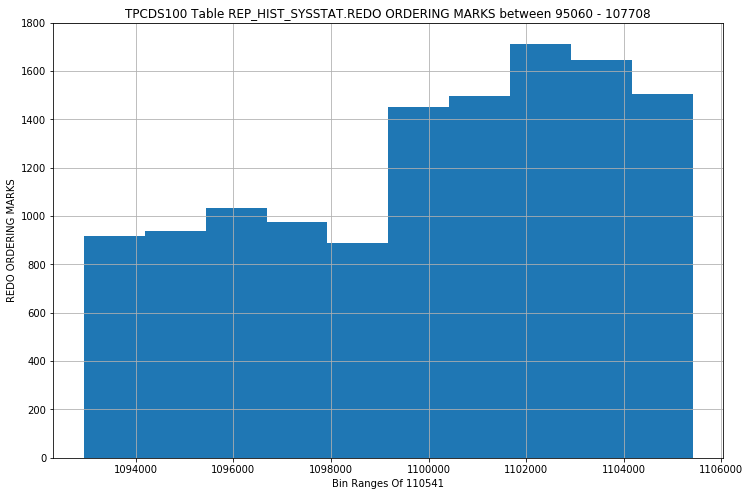

REP_HIST_SYSSTAT - REDO SIZE - STRIPPED HISTOGRAM


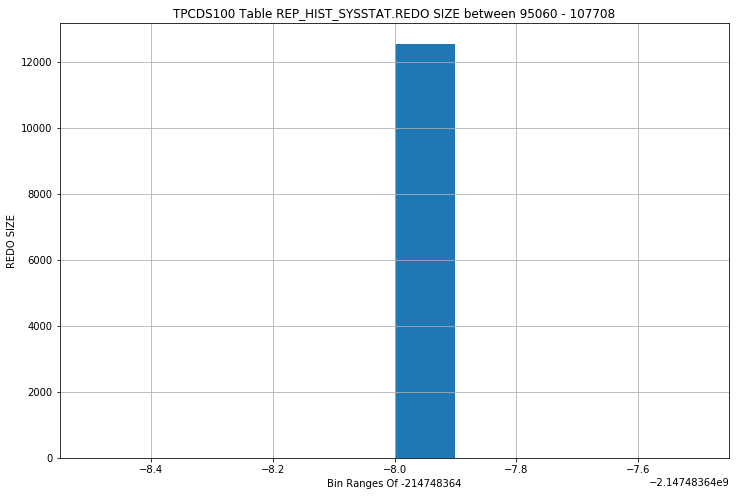

REP_HIST_SYSSTAT - REDO SIZE FOR DIRECT WRITES - STRIPPED HISTOGRAM


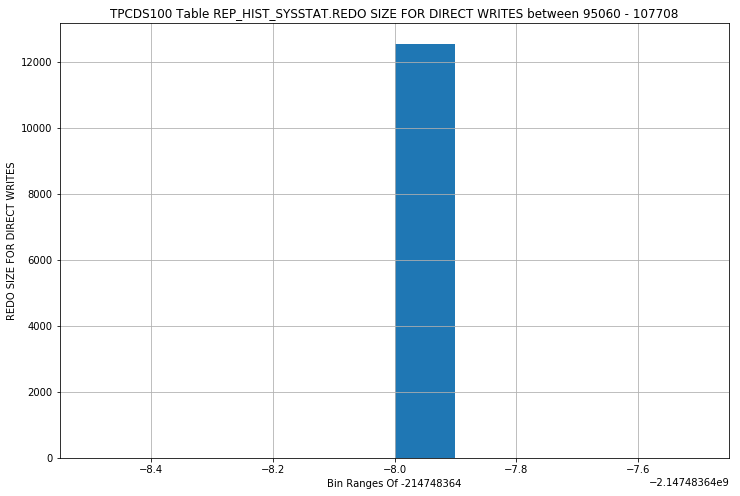

REP_HIST_SYSSTAT - REDO SUBSCN MAX COUNTS - STRIPPED HISTOGRAM


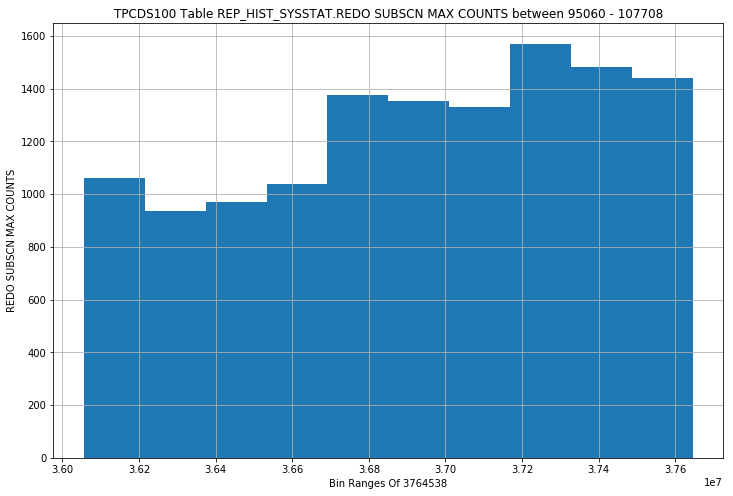

REP_HIST_SYSSTAT - REDO SYNCH LONG WAITS - STRIPPED HISTOGRAM


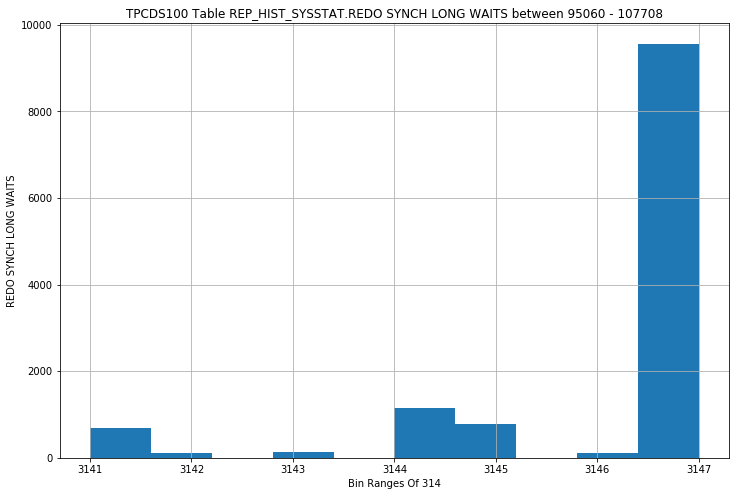

REP_HIST_SYSSTAT - REDO SYNCH TIME - STRIPPED HISTOGRAM


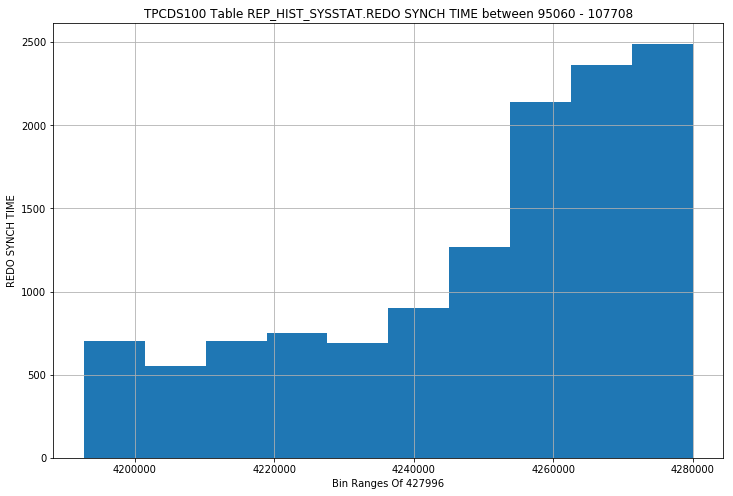

REP_HIST_SYSSTAT - REDO SYNCH TIME (USEC) - STRIPPED HISTOGRAM


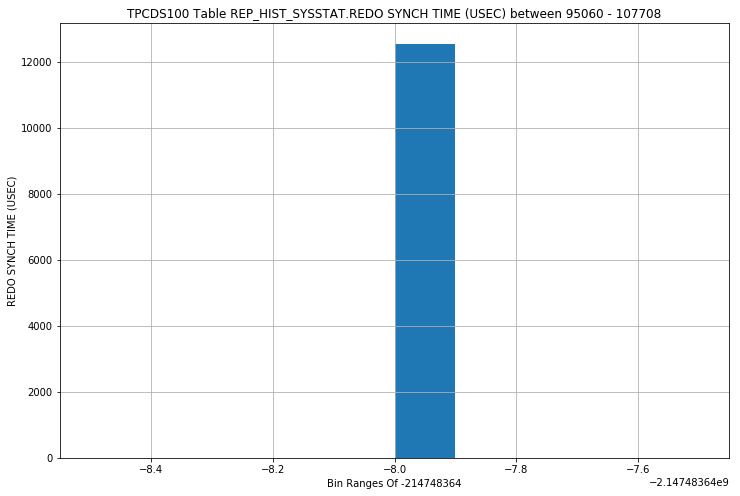

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD (USEC) - STRIPPED HISTOGRAM


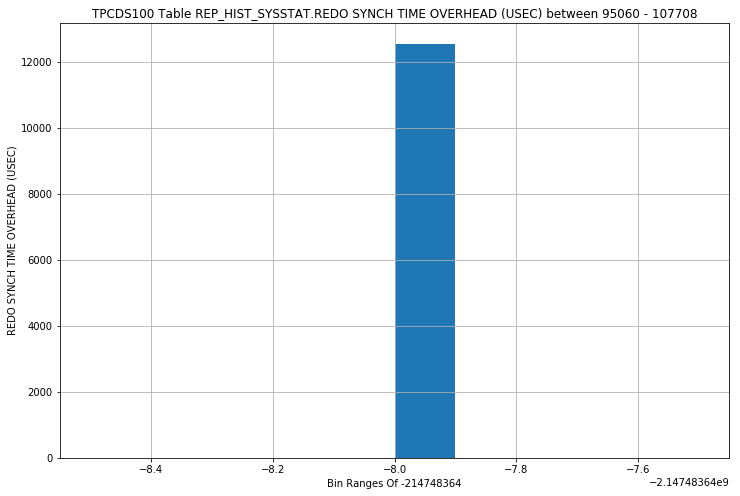

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (  2MS) - STRIPPED HISTOGRAM


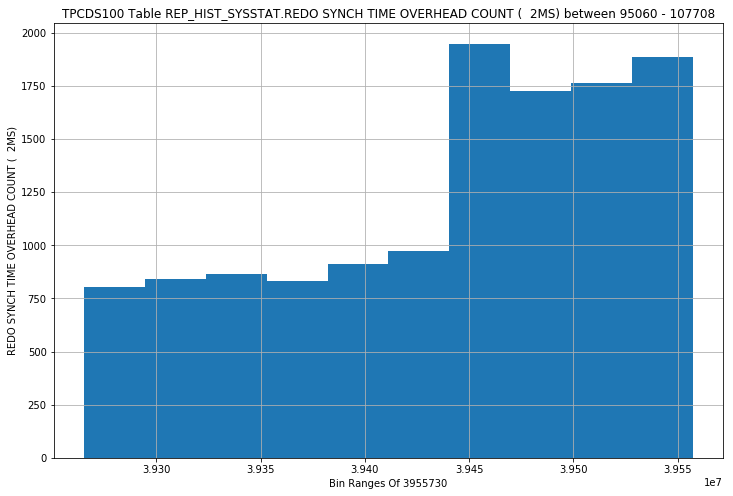

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (  8MS) - STRIPPED HISTOGRAM


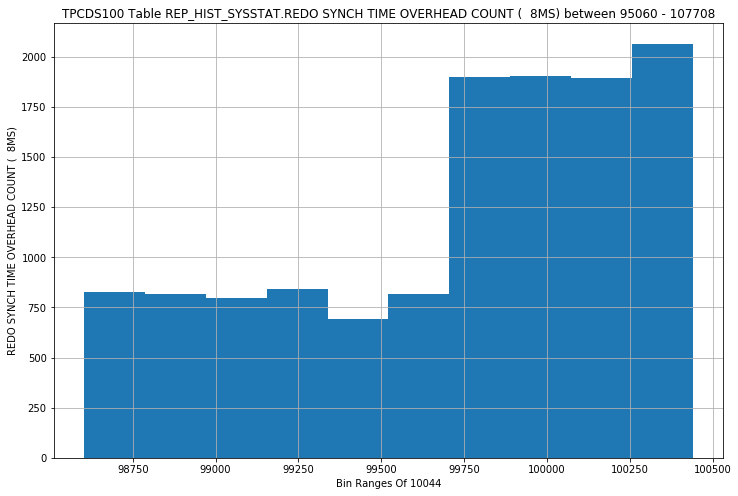

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT ( 32MS) - STRIPPED HISTOGRAM


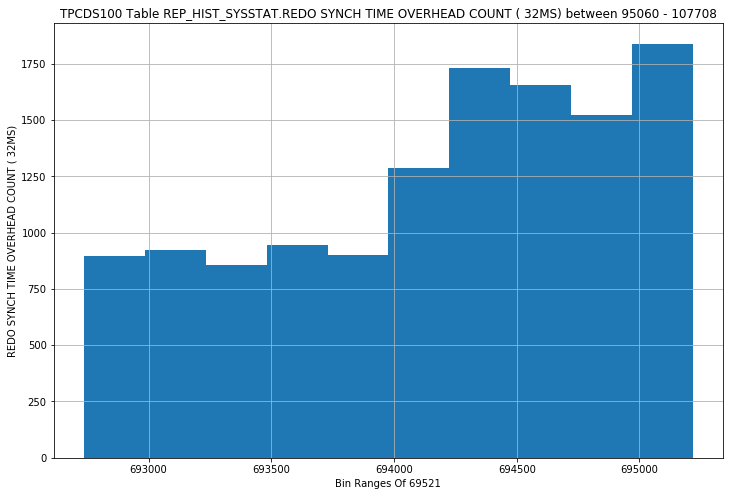

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (128MS) - STRIPPED HISTOGRAM


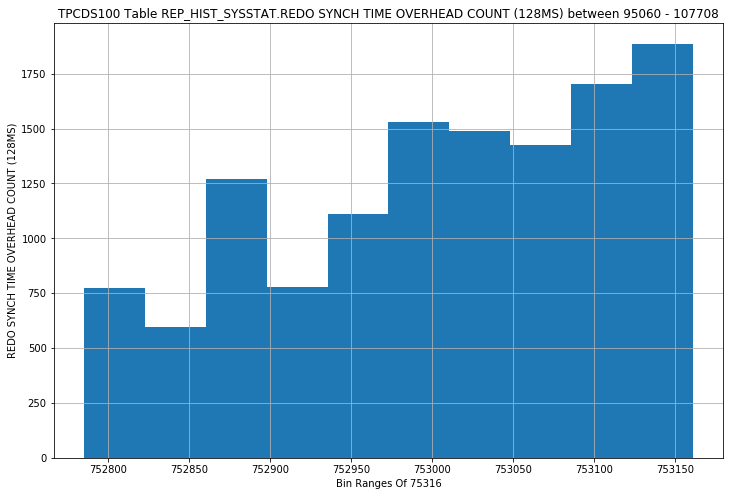

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (INF) - STRIPPED HISTOGRAM


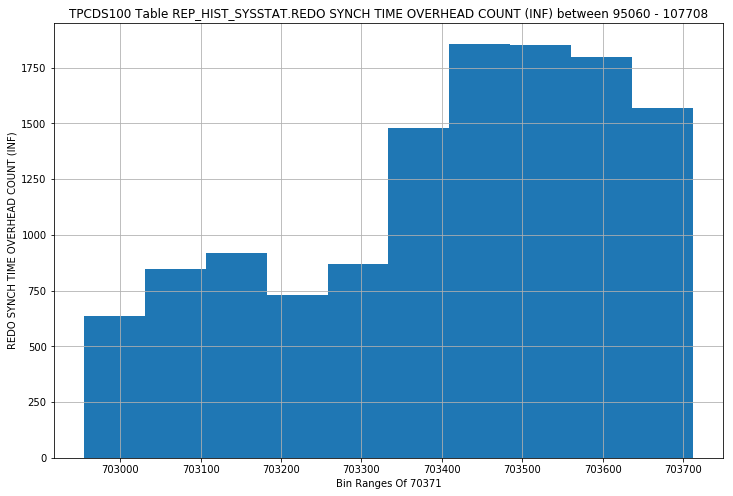

REP_HIST_SYSSTAT - REDO SYNCH WRITES - STRIPPED HISTOGRAM


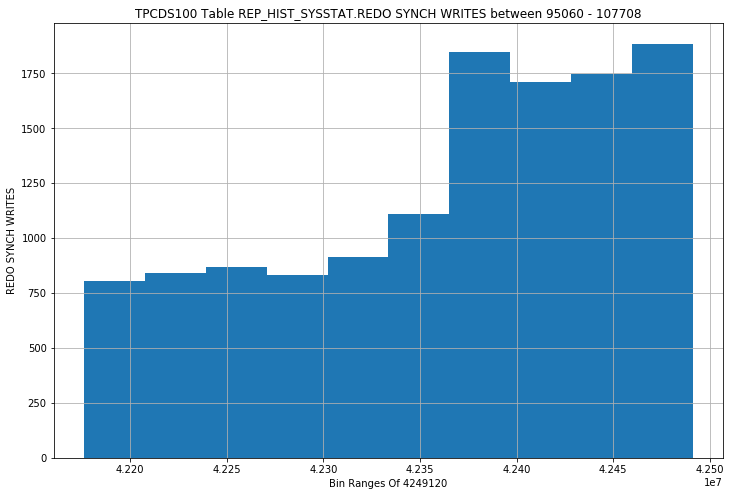

REP_HIST_SYSSTAT - REDO WASTAGE - STRIPPED HISTOGRAM


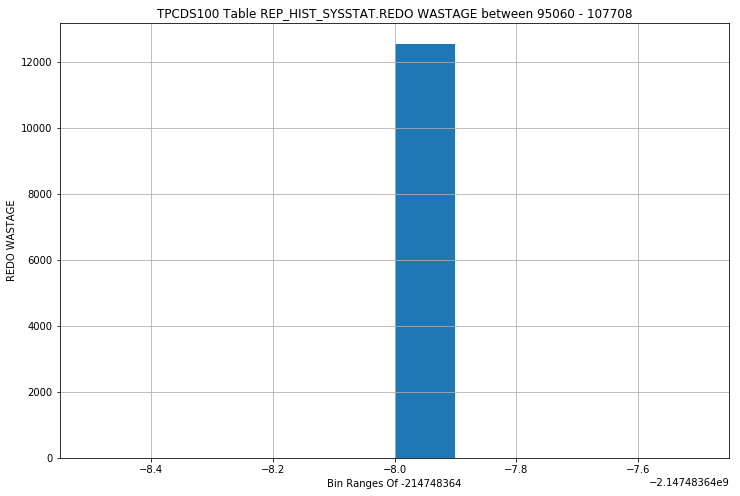

REP_HIST_SYSSTAT - REDO WRITE FINISH TIME - STRIPPED HISTOGRAM


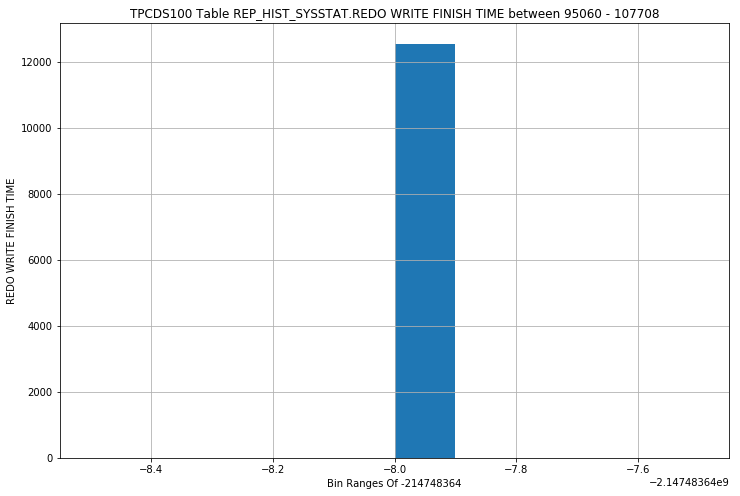

REP_HIST_SYSSTAT - REDO WRITE GATHER TIME - STRIPPED HISTOGRAM


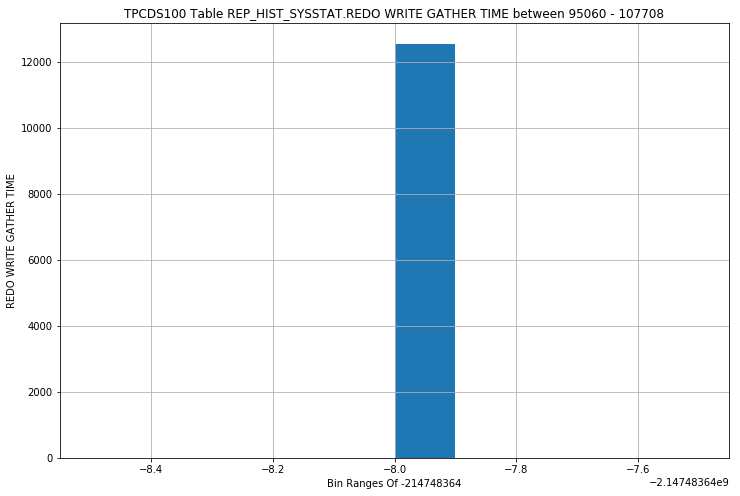

REP_HIST_SYSSTAT - REDO WRITE INFO FIND - STRIPPED HISTOGRAM


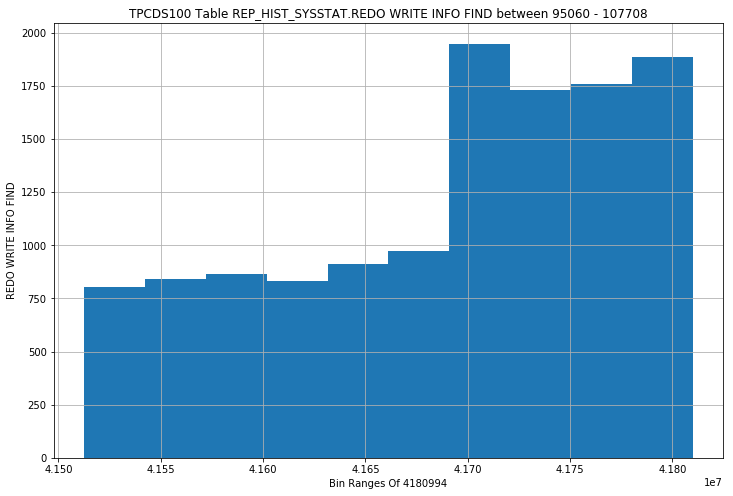

REP_HIST_SYSSTAT - REDO WRITE SCHEDULE TIME - STRIPPED HISTOGRAM


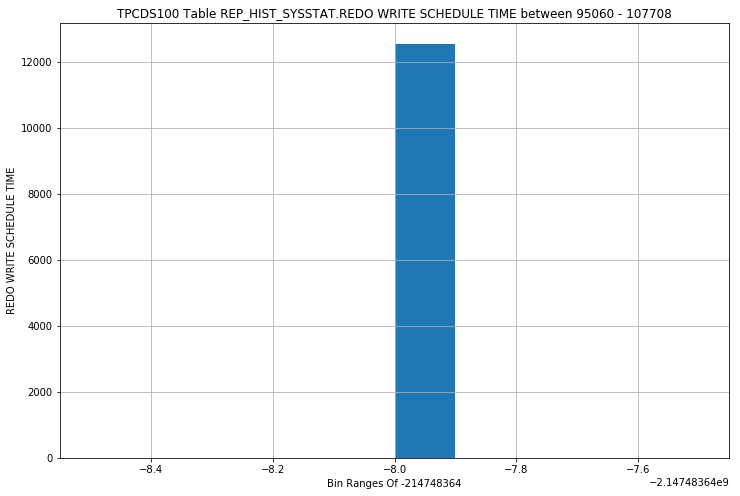

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (   4KB) - STRIPPED HISTOGRAM


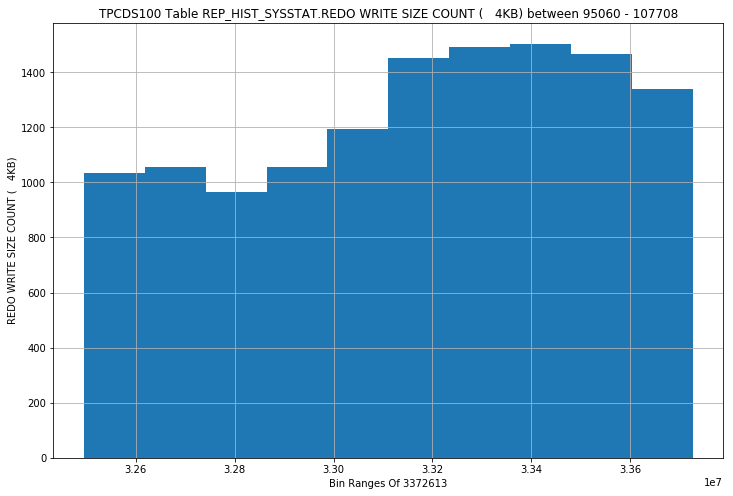

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (   8KB) - STRIPPED HISTOGRAM


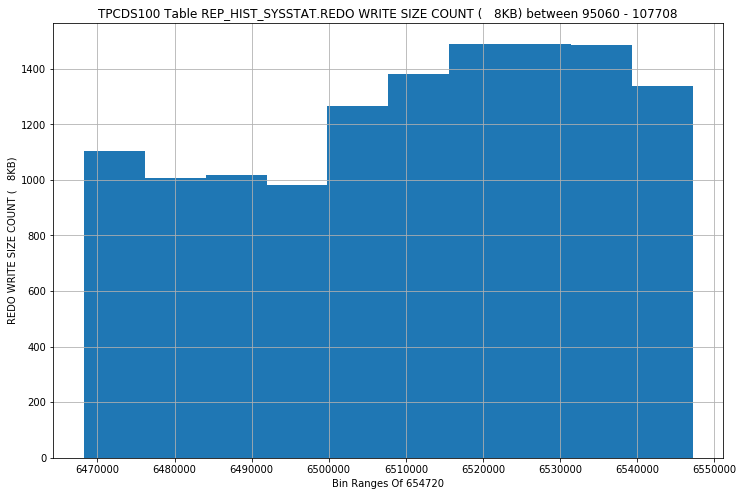

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (  16KB) - STRIPPED HISTOGRAM


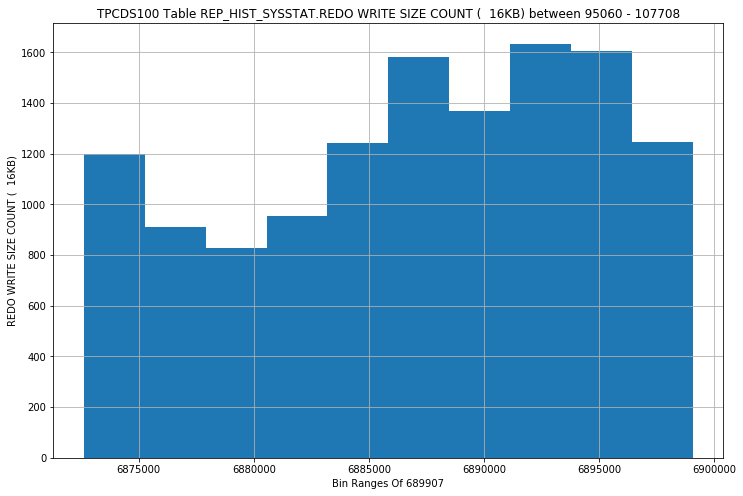

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (  32KB) - STRIPPED HISTOGRAM


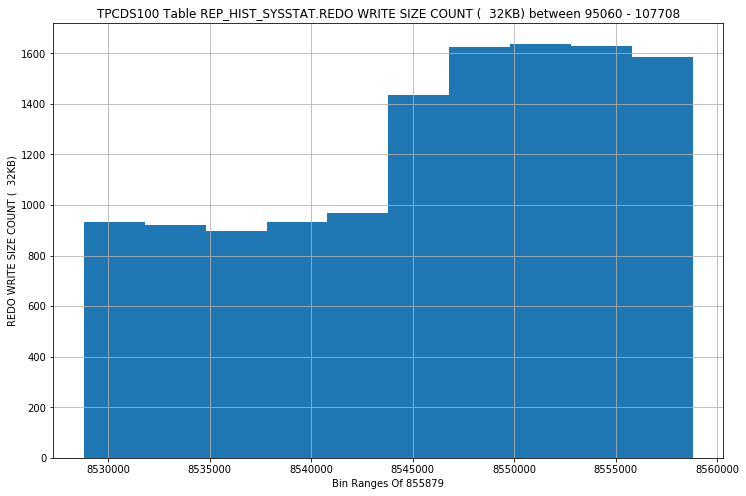

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 128KB) - STRIPPED HISTOGRAM


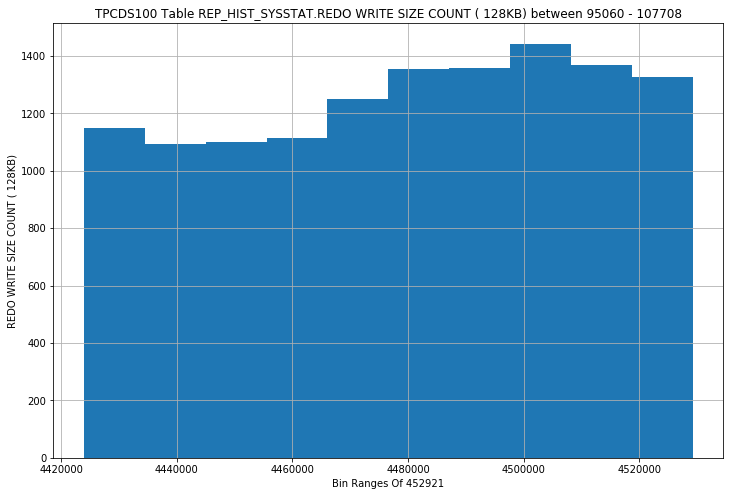

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 256KB) - STRIPPED HISTOGRAM


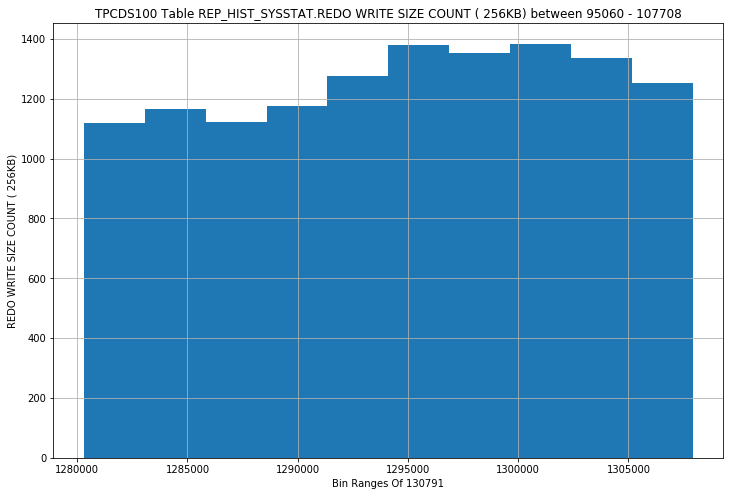

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 512KB) - STRIPPED HISTOGRAM


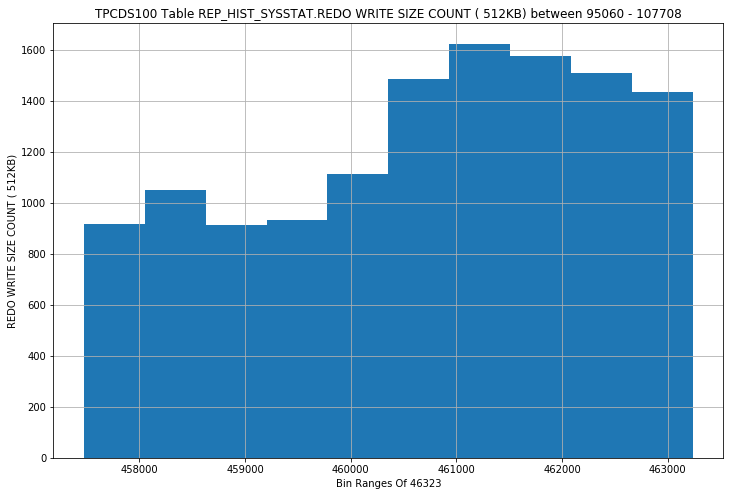

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (1024KB) - STRIPPED HISTOGRAM


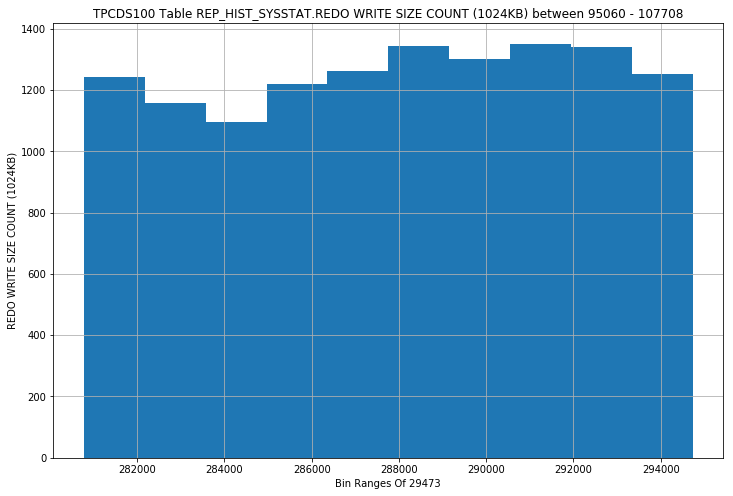

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (INF) - STRIPPED HISTOGRAM


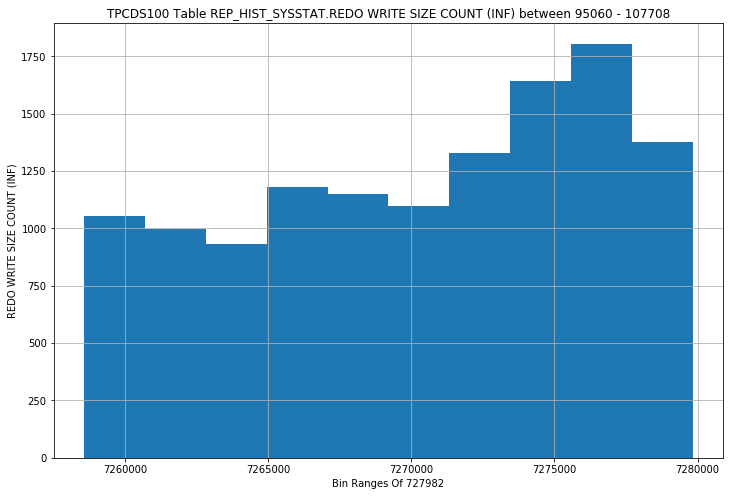

REP_HIST_SYSSTAT - REDO WRITE TIME - STRIPPED HISTOGRAM


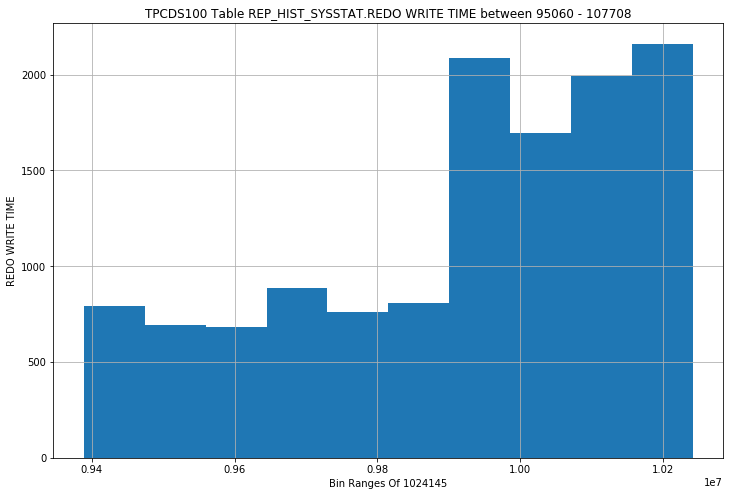

REP_HIST_SYSSTAT - REDO WRITE TIME (USEC) - STRIPPED HISTOGRAM


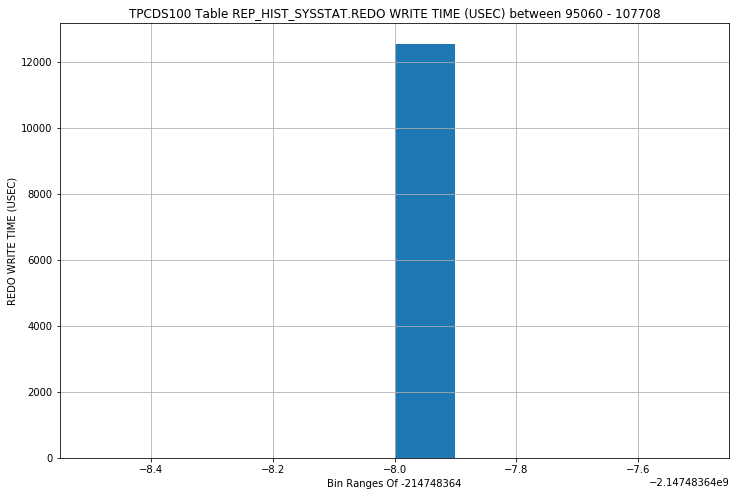

REP_HIST_SYSSTAT - REDO WRITE TOTAL TIME - STRIPPED HISTOGRAM


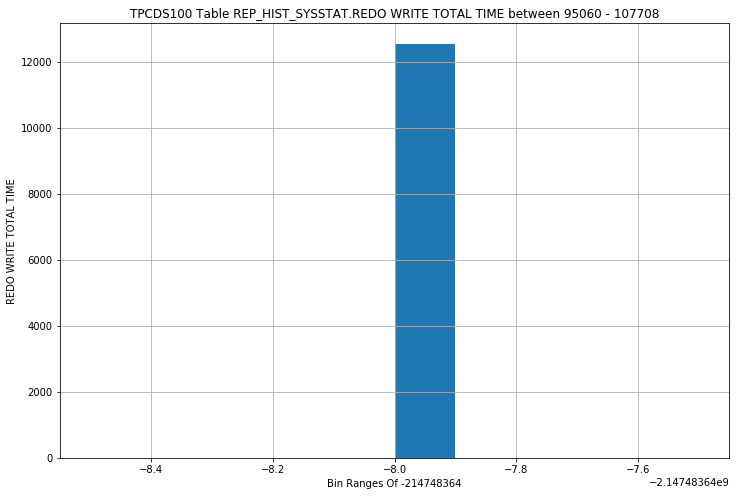

REP_HIST_SYSSTAT - REDO WRITE WORKER DELAY (USEC) - STRIPPED HISTOGRAM


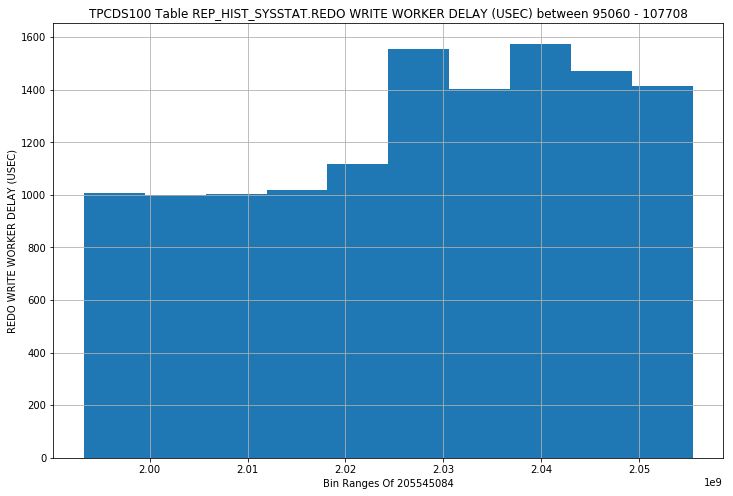

REP_HIST_SYSSTAT - REDO WRITES - STRIPPED HISTOGRAM


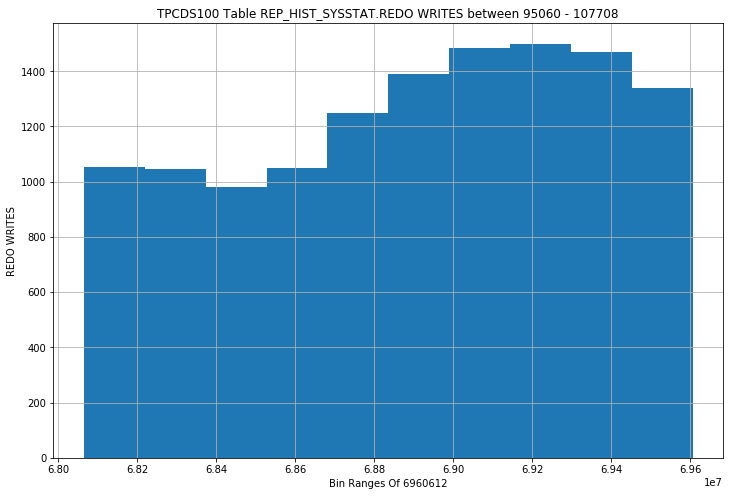

REP_HIST_SYSSTAT - REDO WRITES (GROUP 0) - STRIPPED HISTOGRAM


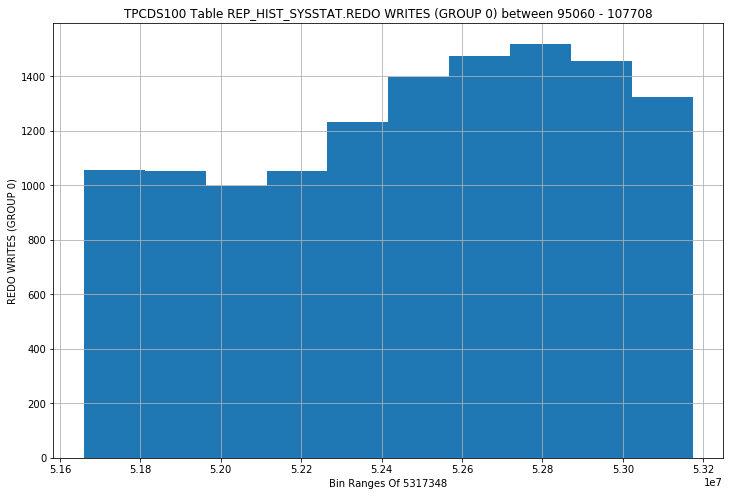

REP_HIST_SYSSTAT - REDO WRITES (GROUP 1) - STRIPPED HISTOGRAM


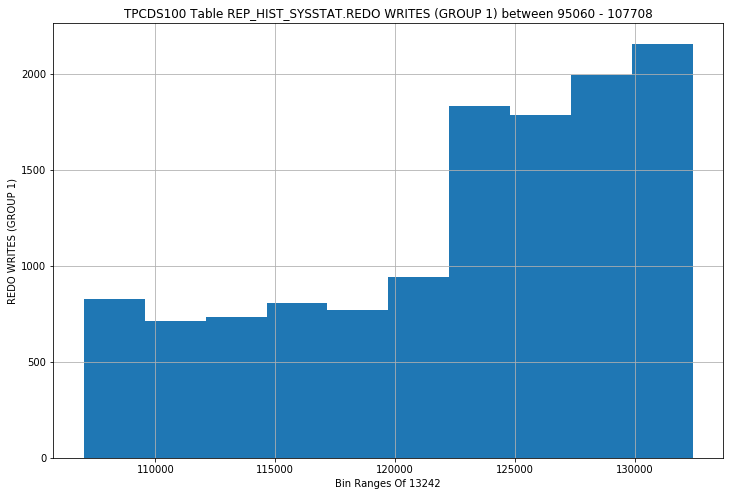

REP_HIST_SYSSTAT - REDO WRITES ADAPTIVE ALL - STRIPPED HISTOGRAM


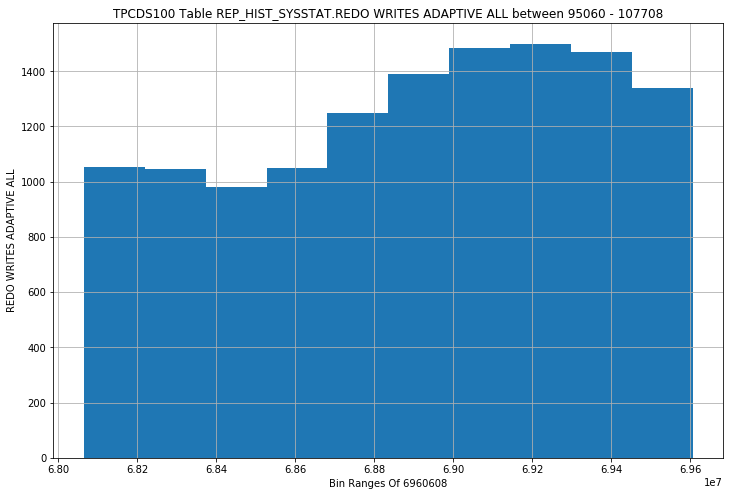

REP_HIST_SYSSTAT - REDO WRITES ADAPTIVE WORKER - STRIPPED HISTOGRAM


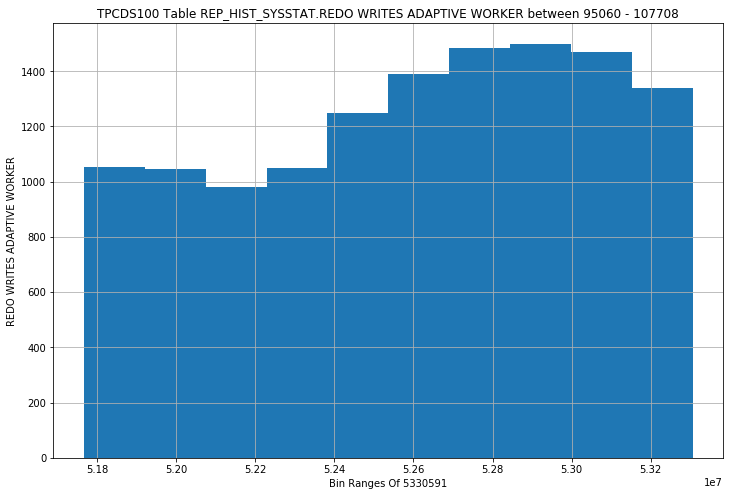

REP_HIST_SYSSTAT - ROLLBACK CHANGES - UNDO RECORDS APPLIED - STRIPPED HISTOGRAM


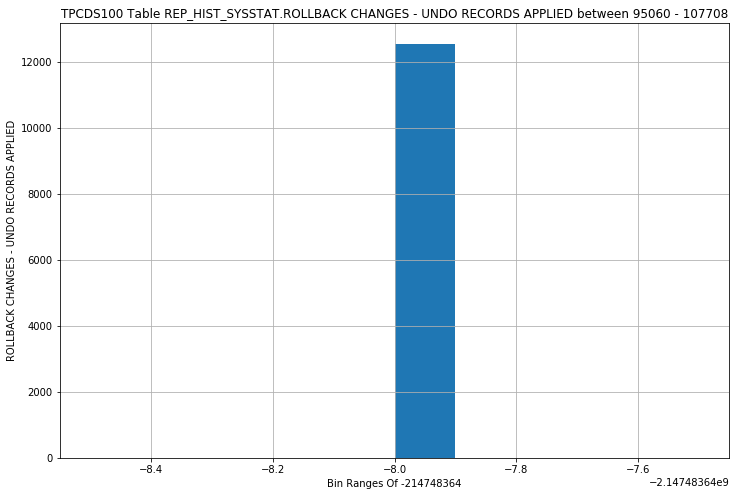

REP_HIST_SYSSTAT - ROLLBACKS ONLY - CONSISTENT READ GETS - STRIPPED HISTOGRAM


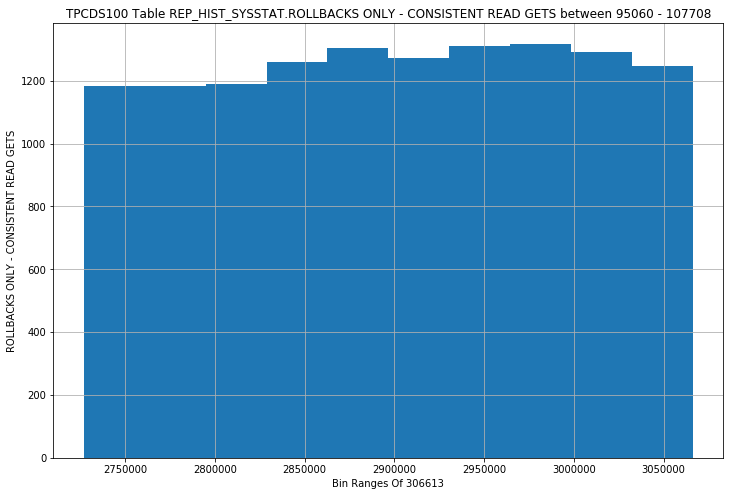

REP_HIST_SYSSTAT - ROOT NODE SPLITS - STRIPPED HISTOGRAM


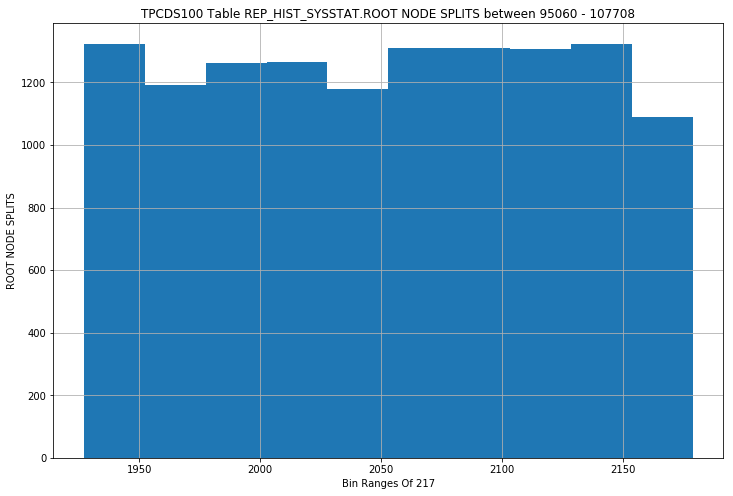

REP_HIST_SYSSTAT - ROWS FETCHED VIA CALLBACK - STRIPPED HISTOGRAM


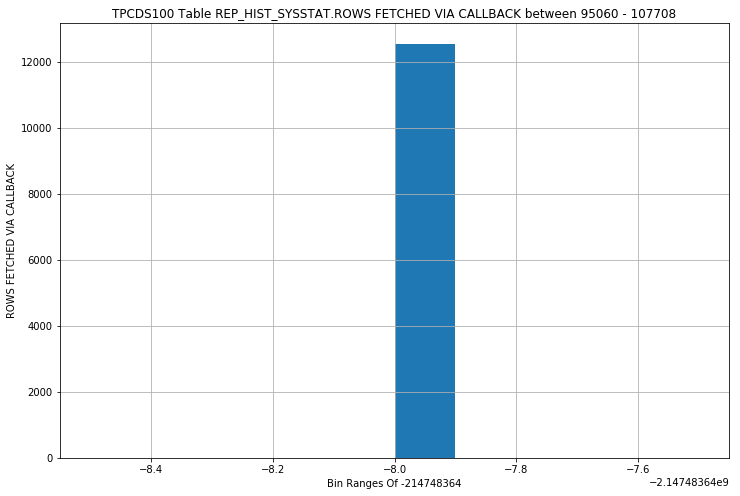

REP_HIST_SYSSTAT - SCHEDULER WAIT TIME - STRIPPED HISTOGRAM


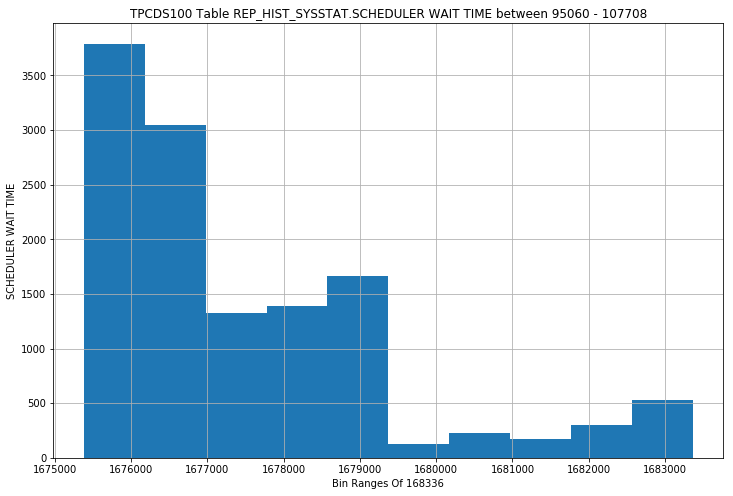

REP_HIST_SYSSTAT - SECUREFILE ALLOCATION BYTES - STRIPPED HISTOGRAM


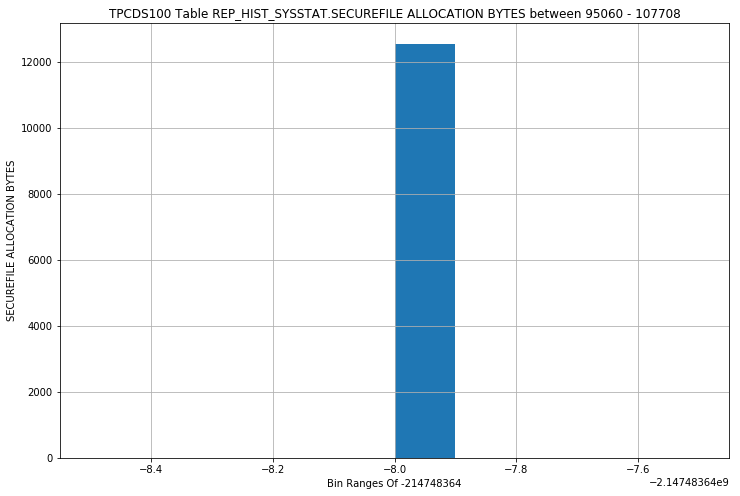

REP_HIST_SYSSTAT - SECUREFILE ALLOCATION CHUNKS - STRIPPED HISTOGRAM


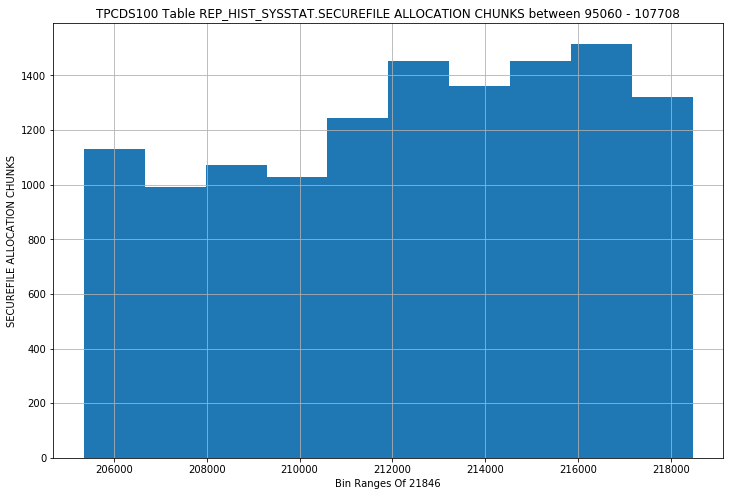

REP_HIST_SYSSTAT - SECUREFILE BYTES NON-TRANSFORMED - STRIPPED HISTOGRAM


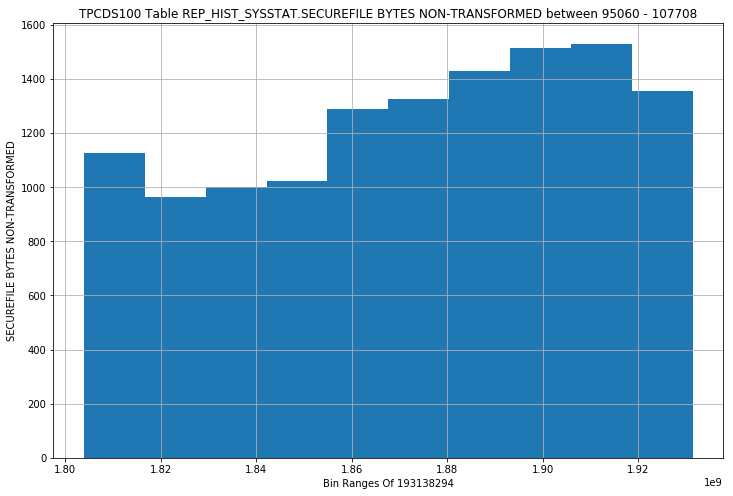

REP_HIST_SYSSTAT - SECUREFILE DIRECT READ BYTES - STRIPPED HISTOGRAM


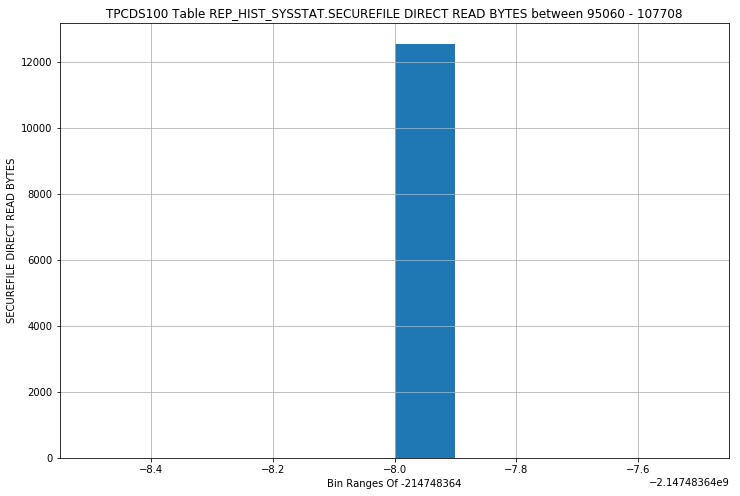

REP_HIST_SYSSTAT - SECUREFILE DIRECT READ OPS - STRIPPED HISTOGRAM


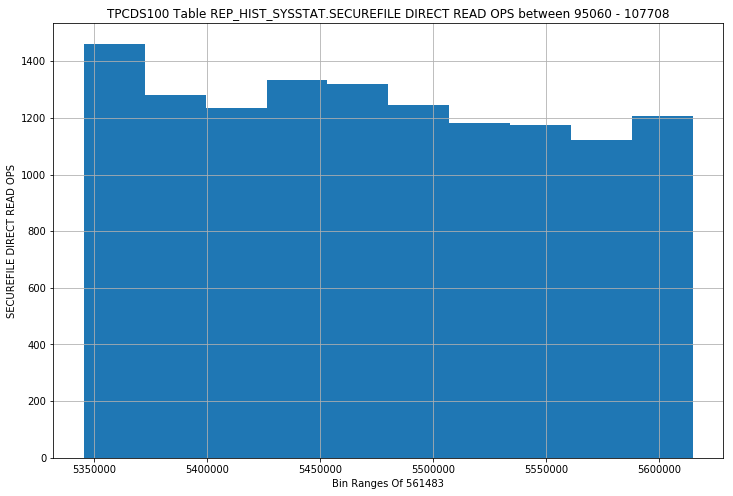

REP_HIST_SYSSTAT - SECUREFILE DIRECT WRITE BYTES - STRIPPED HISTOGRAM


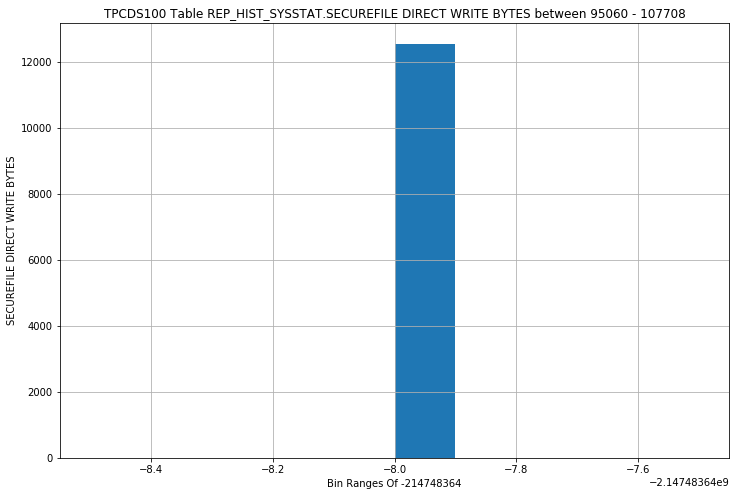

REP_HIST_SYSSTAT - SECUREFILE DIRECT WRITE OPS - STRIPPED HISTOGRAM


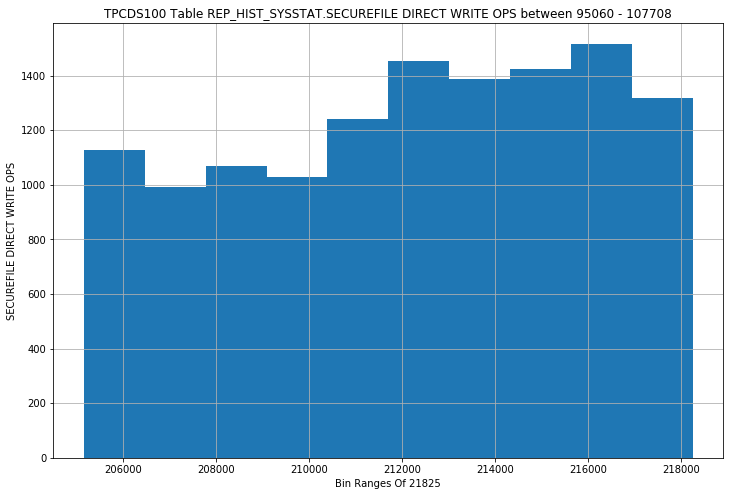

REP_HIST_SYSSTAT - SECUREFILE NUMBER OF NON-TRANSFORMED FLUSHES - STRIPPED HISTOGRAM


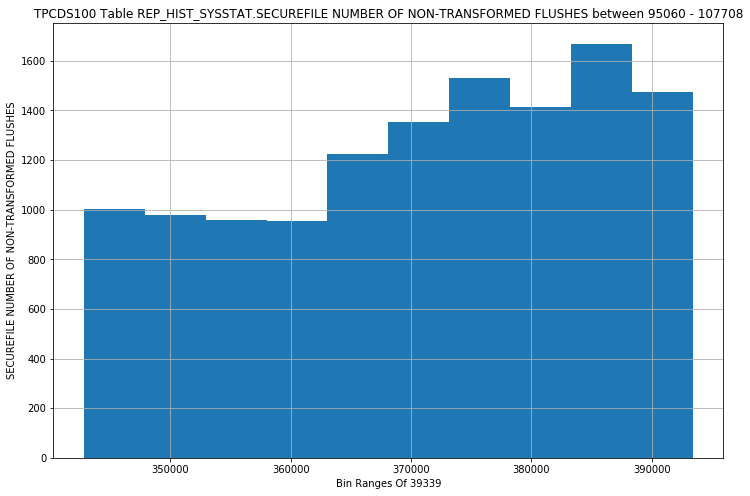

REP_HIST_SYSSTAT - SEGMENT CFS ALLOCATIONS - STRIPPED HISTOGRAM


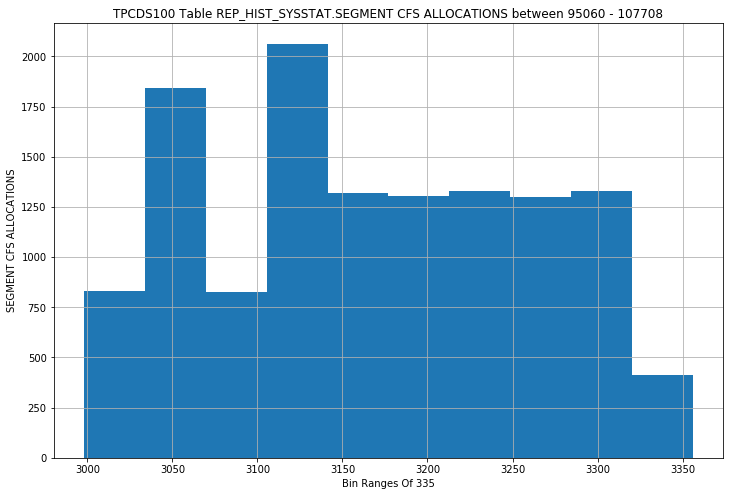

REP_HIST_SYSSTAT - SEGMENT CHUNKS ALLOCATION FROM DISEPNSER - STRIPPED HISTOGRAM


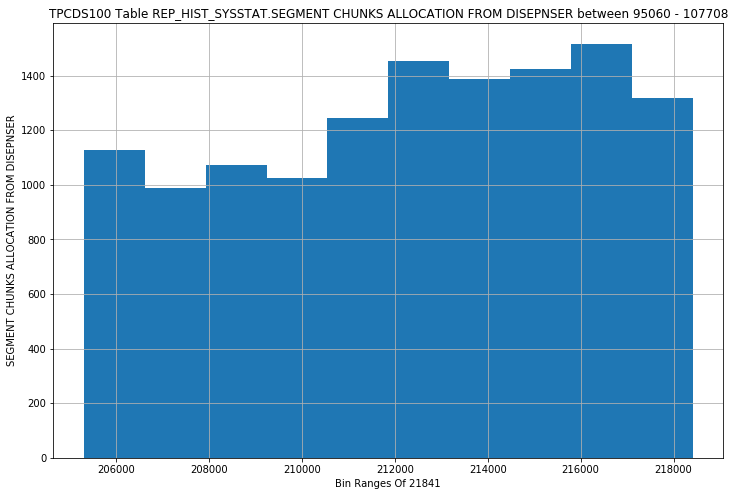

REP_HIST_SYSSTAT - SEGMENT DISPENSER ALLOCATIONS - STRIPPED HISTOGRAM


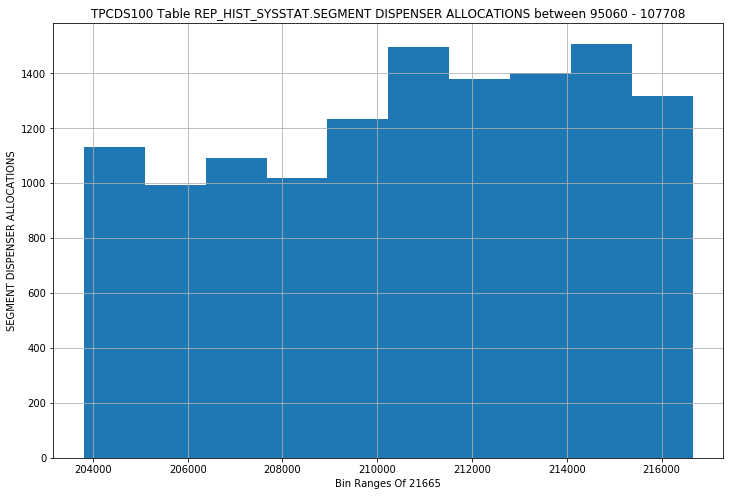

REP_HIST_SYSSTAT - SEGMENT DISPENSER LOAD EMPTY - STRIPPED HISTOGRAM


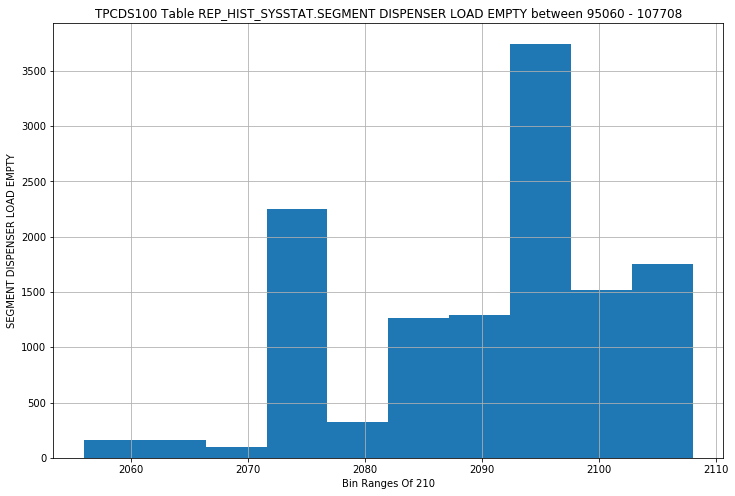

REP_HIST_SYSSTAT - SEGMENT DISPENSER LOAD TASKS - STRIPPED HISTOGRAM


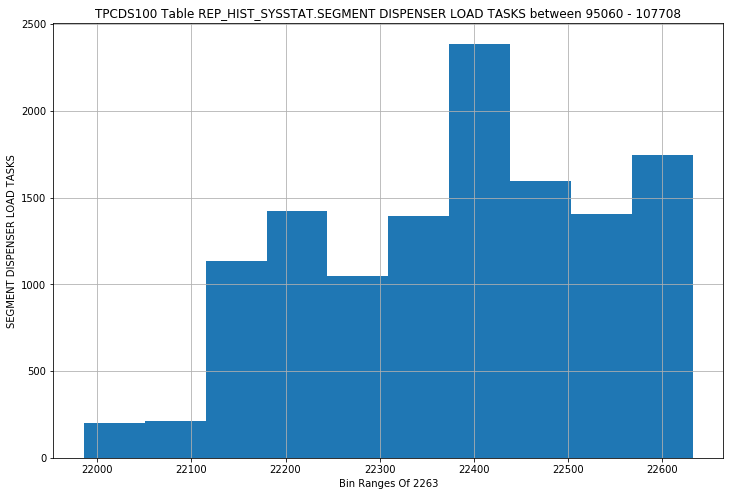

REP_HIST_SYSSTAT - SEGMENT PREALLOC BYTES - STRIPPED HISTOGRAM


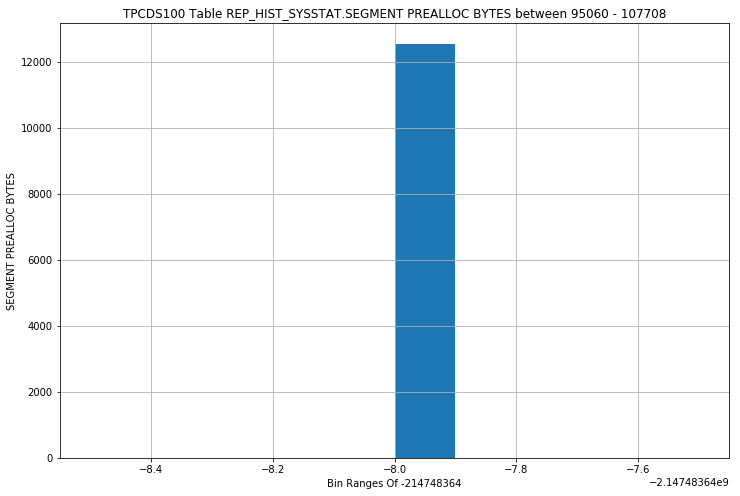

REP_HIST_SYSSTAT - SEGMENT PREALLOC OPS - STRIPPED HISTOGRAM


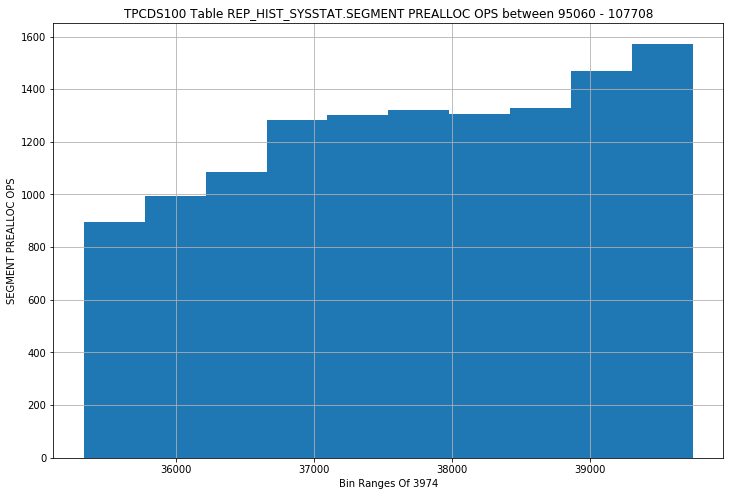

REP_HIST_SYSSTAT - SEGMENT PREALLOC TASKS - STRIPPED HISTOGRAM


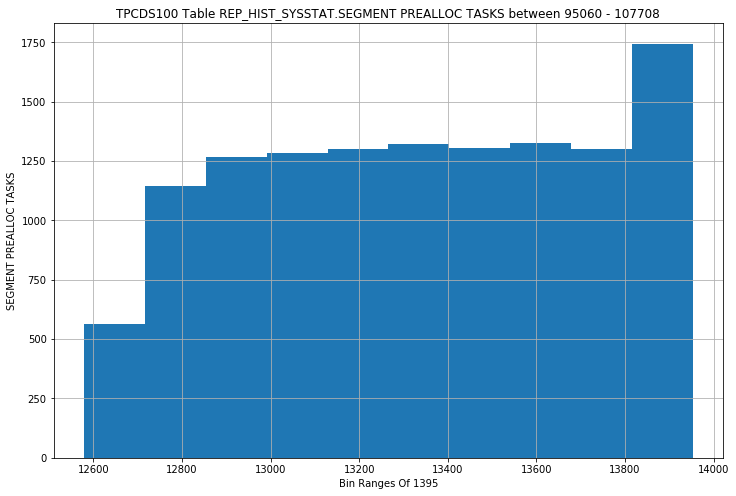

REP_HIST_SYSSTAT - SEGMENT PREALLOC TIME (MS) - STRIPPED HISTOGRAM


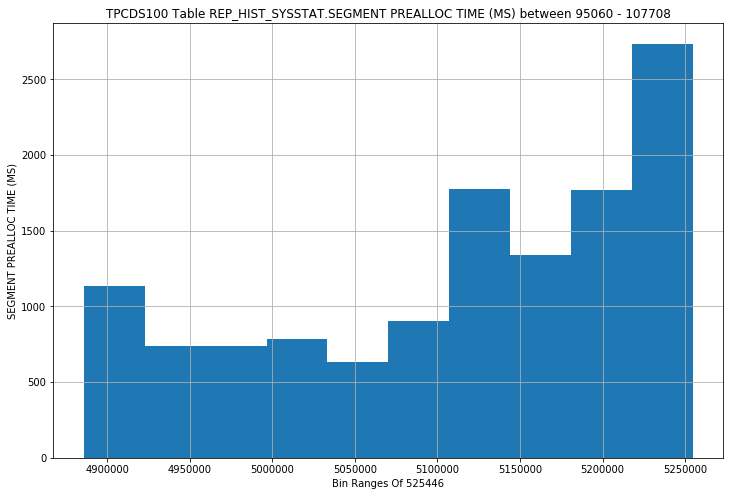

REP_HIST_SYSSTAT - SEGMENT PREALLOC UFS2CFS BYTES - STRIPPED HISTOGRAM


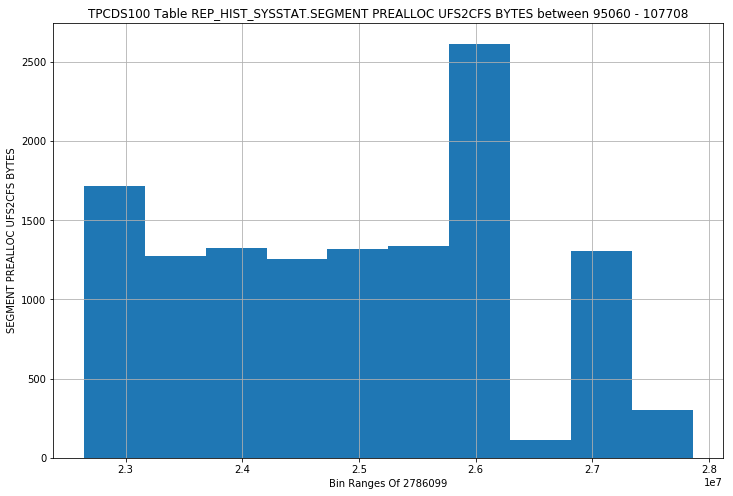

REP_HIST_SYSSTAT - SEGMENT TOTAL CHUNK ALLOCATION - STRIPPED HISTOGRAM


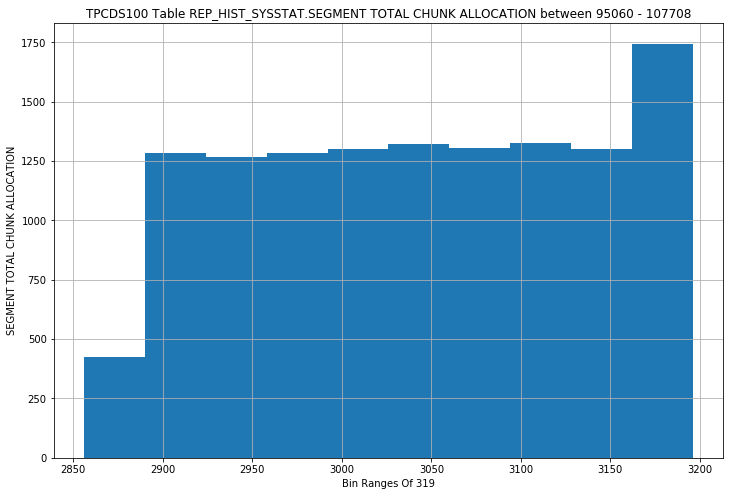

REP_HIST_SYSSTAT - SESSION CONNECT TIME - STRIPPED HISTOGRAM


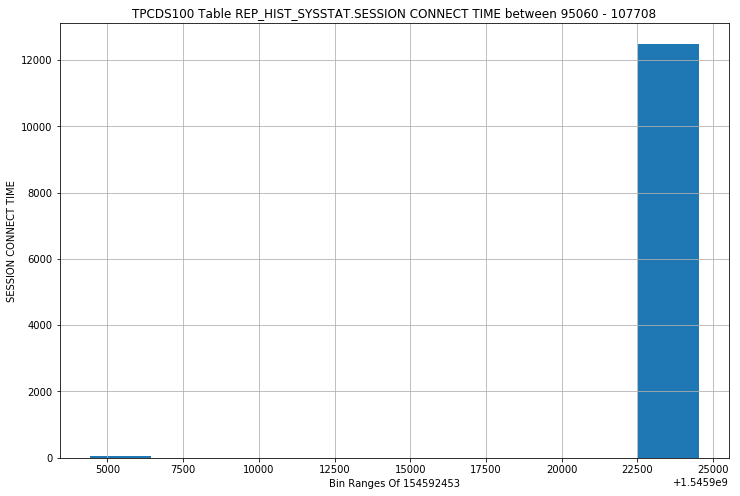

REP_HIST_SYSSTAT - SESSION CURSOR CACHE COUNT - STRIPPED HISTOGRAM


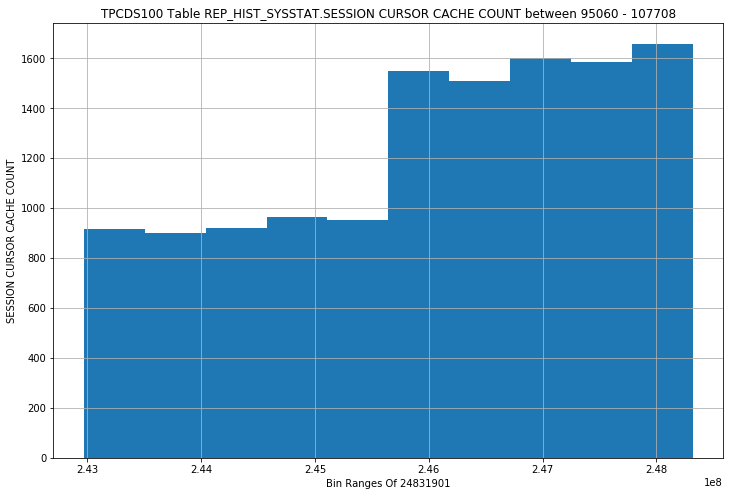

REP_HIST_SYSSTAT - SESSION CURSOR CACHE HITS - STRIPPED HISTOGRAM


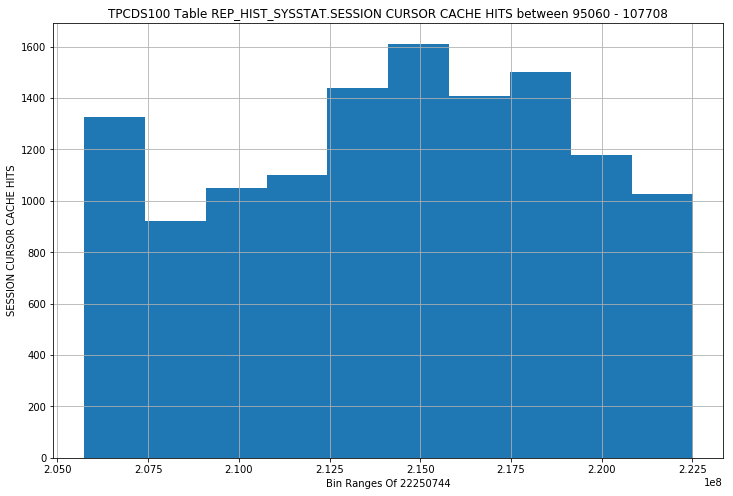

REP_HIST_SYSSTAT - SESSION LOGICAL READS - STRIPPED HISTOGRAM


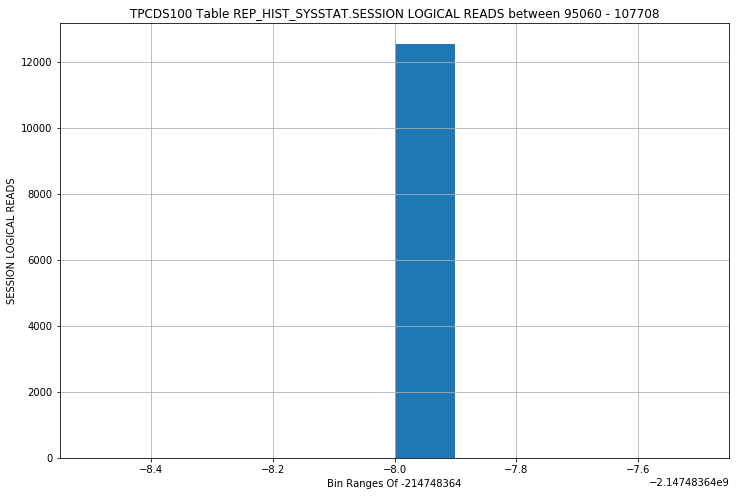

REP_HIST_SYSSTAT - SESSION PGA MEMORY - STRIPPED HISTOGRAM


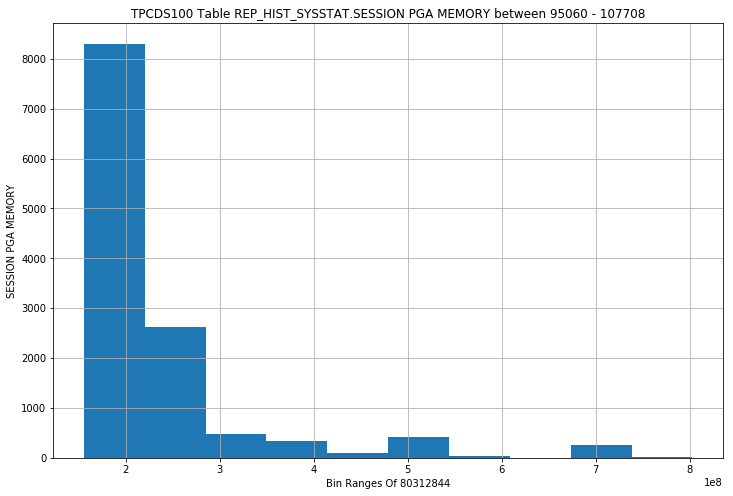

REP_HIST_SYSSTAT - SESSION PGA MEMORY MAX - STRIPPED HISTOGRAM


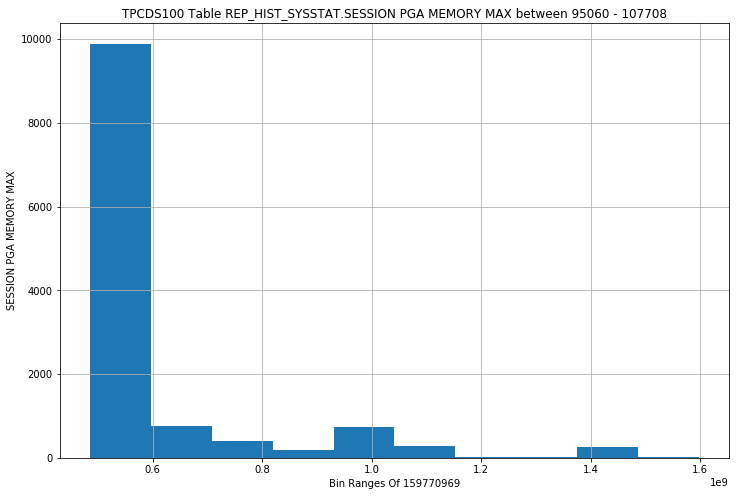

REP_HIST_SYSSTAT - SESSION UGA MEMORY - STRIPPED HISTOGRAM


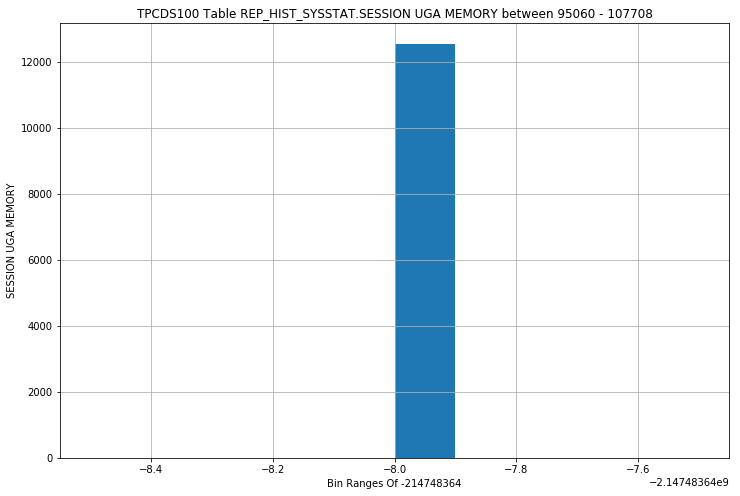

REP_HIST_SYSSTAT - SESSION UGA MEMORY MAX - STRIPPED HISTOGRAM


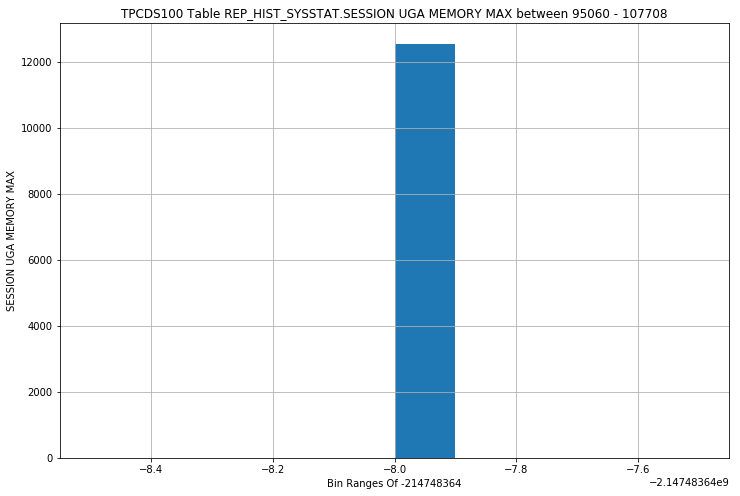

REP_HIST_SYSSTAT - SHARED HASH LATCH UPGRADES - NO WAIT - STRIPPED HISTOGRAM


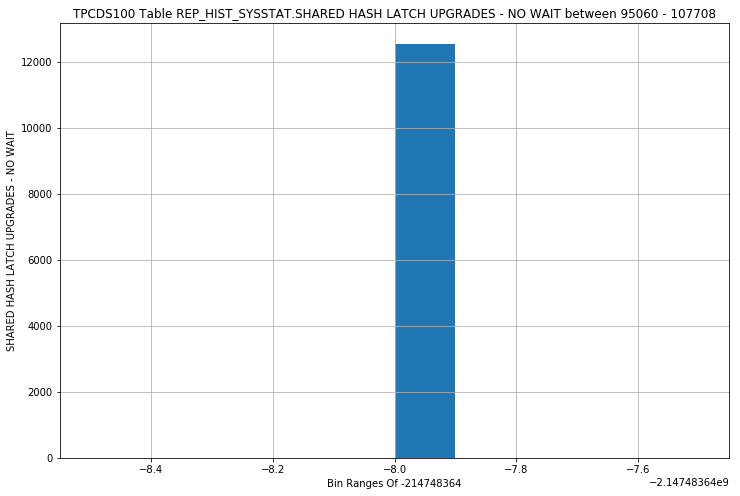

REP_HIST_SYSSTAT - SHARED HASH LATCH UPGRADES - WAIT - STRIPPED HISTOGRAM


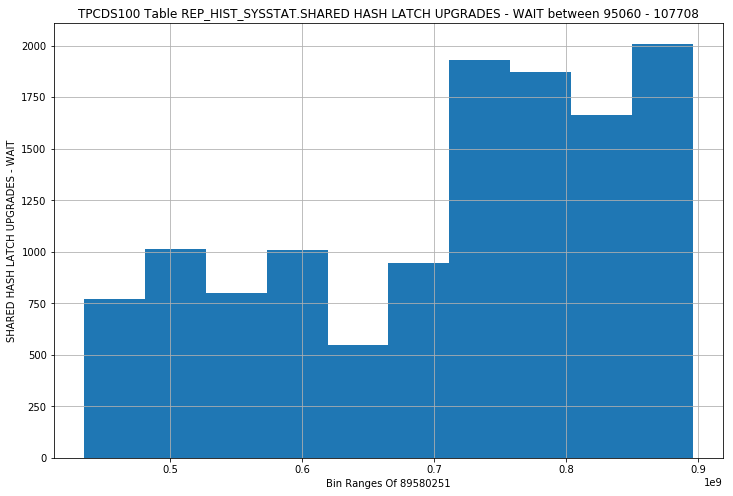

REP_HIST_SYSSTAT - SHARED IO POOL BUFFER GET SUCCESS - STRIPPED HISTOGRAM


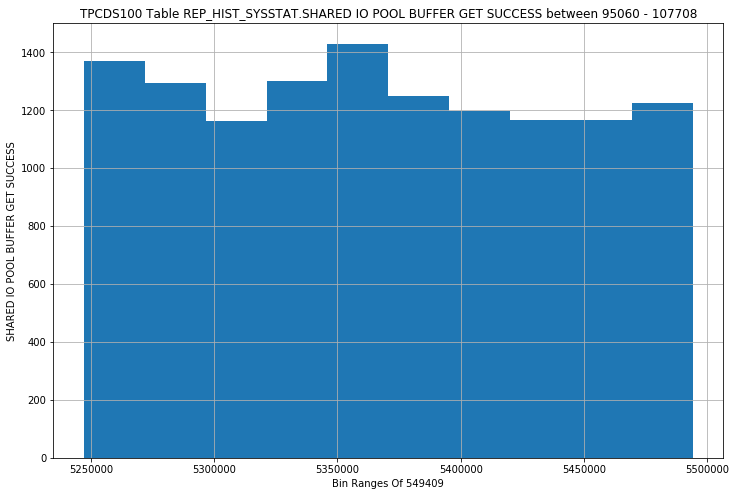

REP_HIST_SYSSTAT - SORTS (DISK) - STRIPPED HISTOGRAM


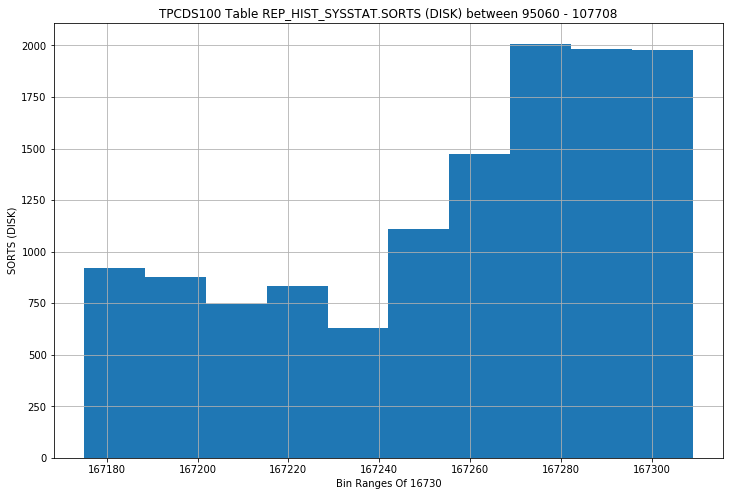

REP_HIST_SYSSTAT - SORTS (MEMORY) - STRIPPED HISTOGRAM


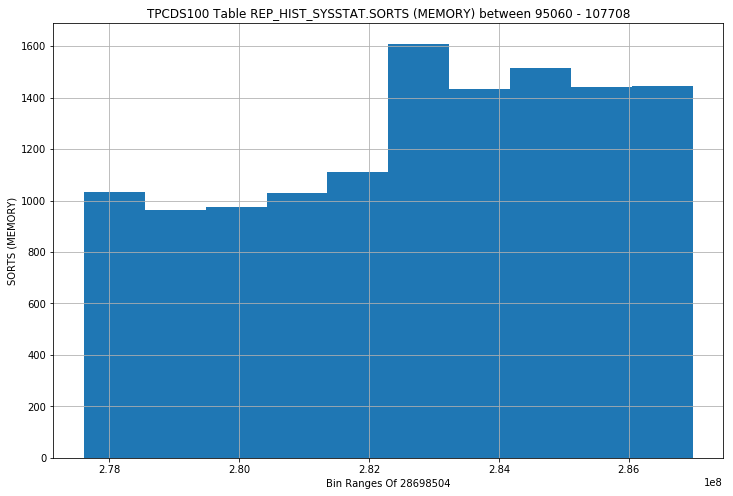

REP_HIST_SYSSTAT - SORTS (ROWS) - STRIPPED HISTOGRAM


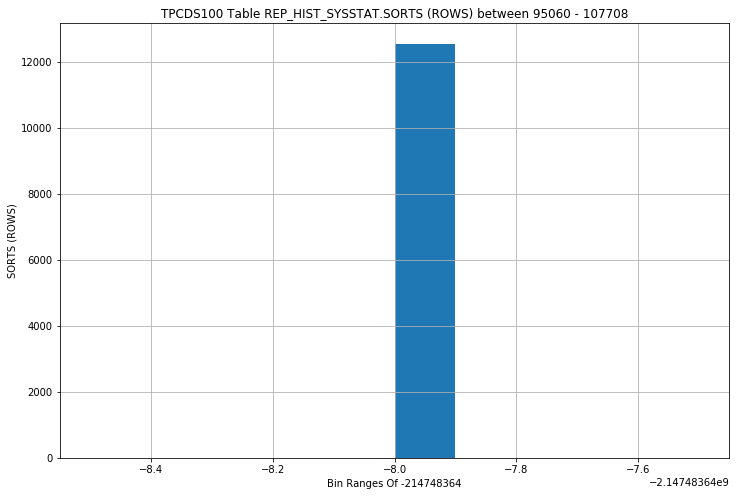

REP_HIST_SYSSTAT - SQL AREA EVICTED - STRIPPED HISTOGRAM


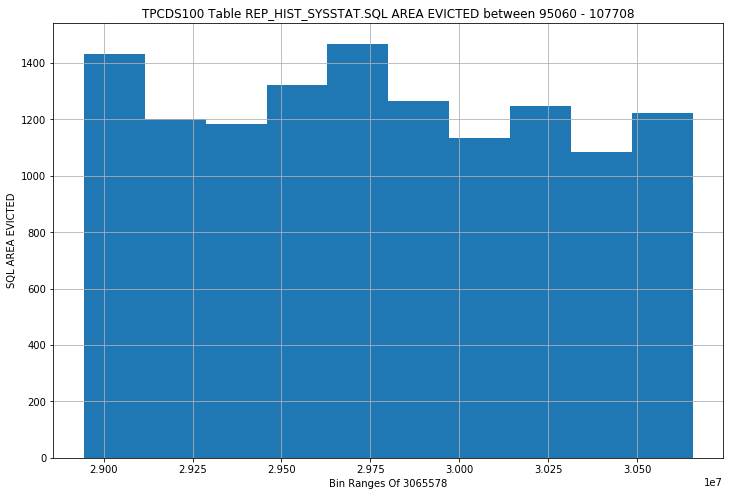

REP_HIST_SYSSTAT - SQL AREA PURGED - STRIPPED HISTOGRAM


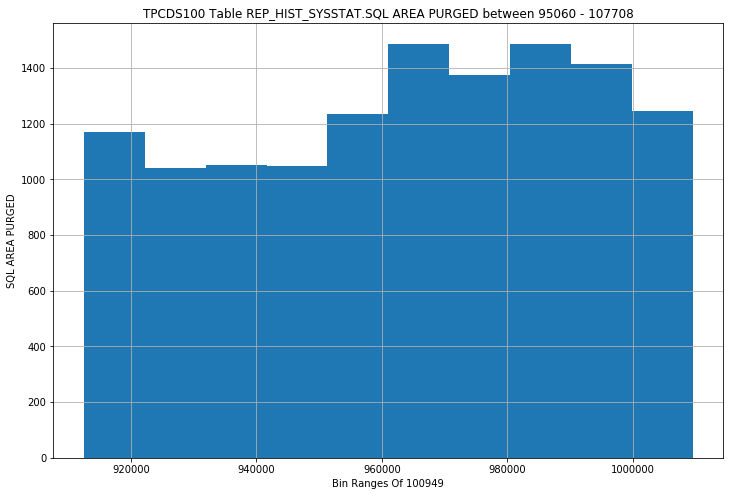

REP_HIST_SYSSTAT - STEPS OF TUNE DOWN RET. IN SPACE PRESSURE - STRIPPED HISTOGRAM


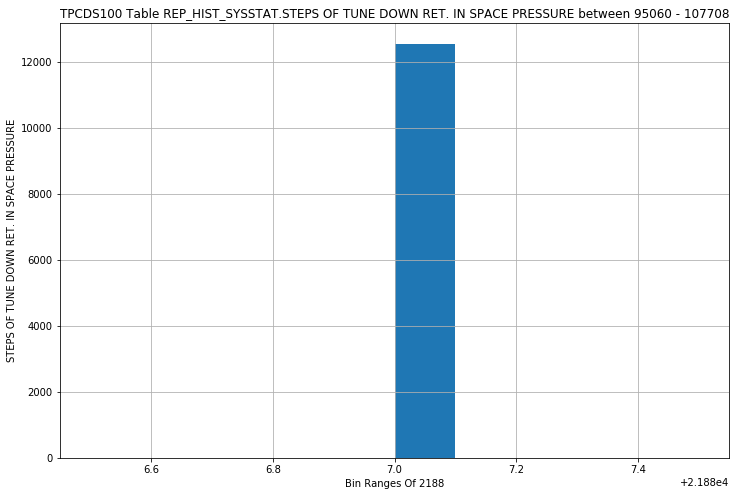

REP_HIST_SYSSTAT - SUMMED DIRTY QUEUE LENGTH - STRIPPED HISTOGRAM


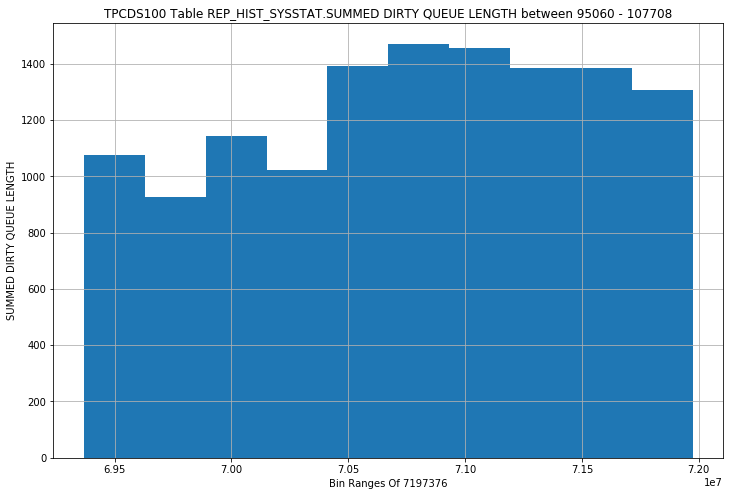

REP_HIST_SYSSTAT - SWITCH CURRENT TO NEW BUFFER - STRIPPED HISTOGRAM


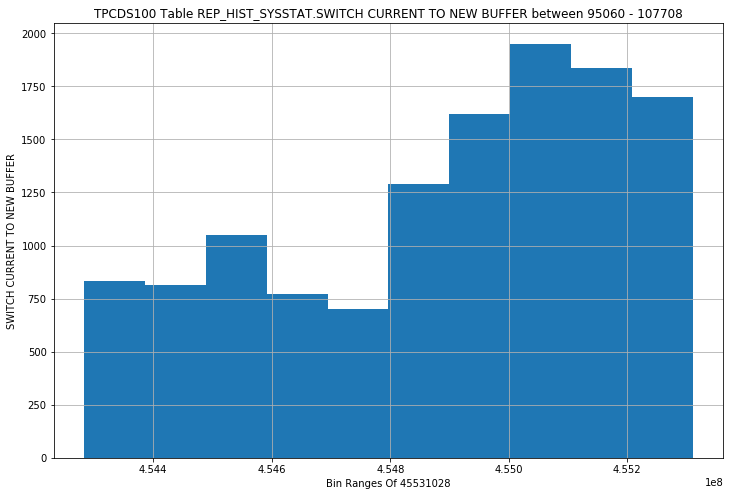

REP_HIST_SYSSTAT - TABLE FETCH BY ROWID - STRIPPED HISTOGRAM


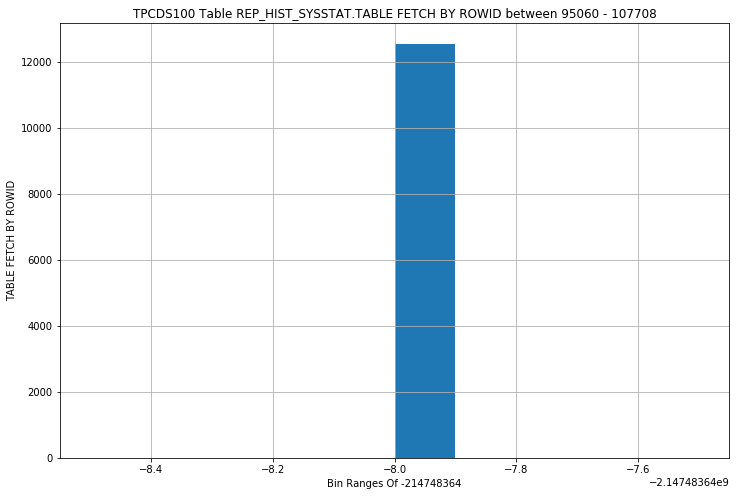

REP_HIST_SYSSTAT - TABLE FETCH CONTINUED ROW - STRIPPED HISTOGRAM


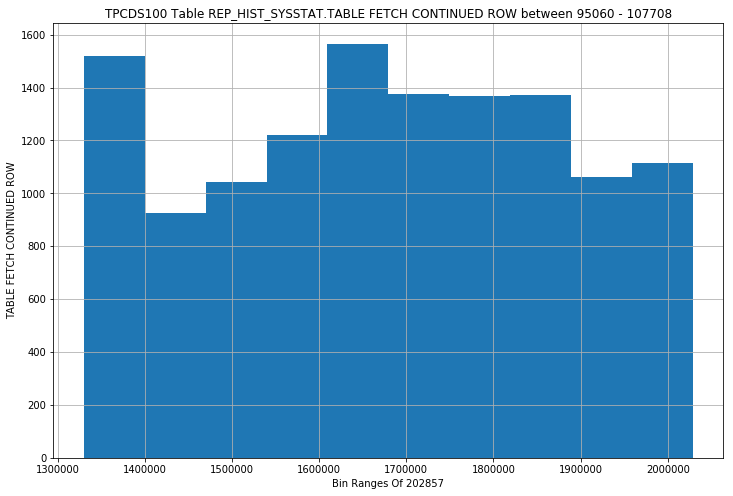

REP_HIST_SYSSTAT - TABLE SCAN BLOCKS GOTTEN - STRIPPED HISTOGRAM


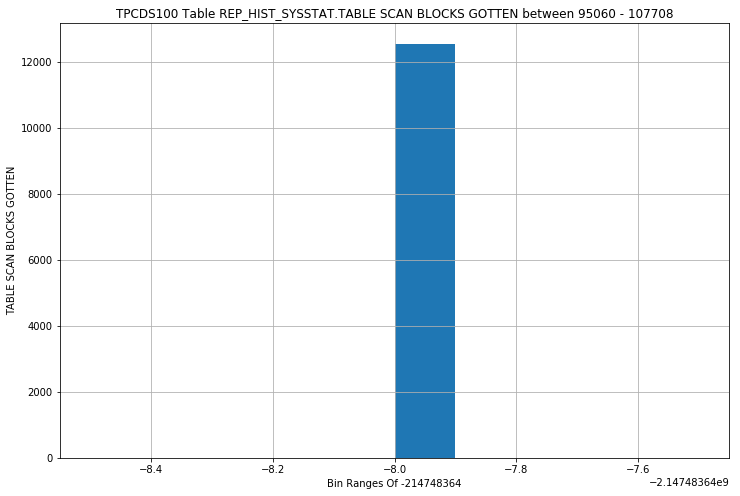

REP_HIST_SYSSTAT - TABLE SCAN DISK NON-IMC ROWS GOTTEN - STRIPPED HISTOGRAM


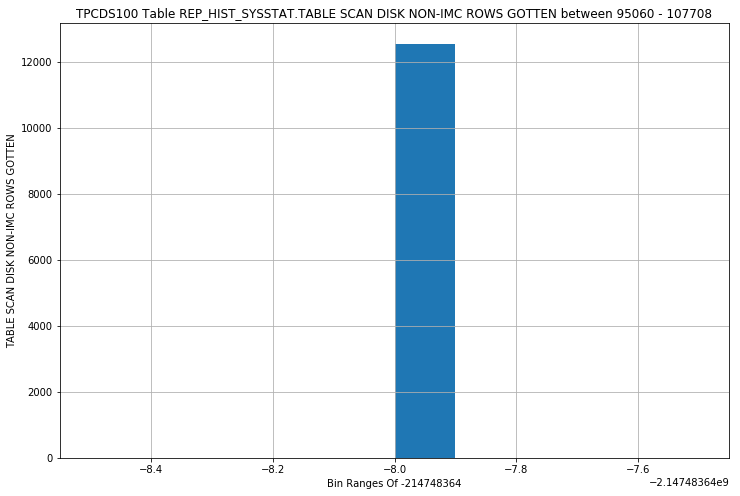

REP_HIST_SYSSTAT - TABLE SCAN ROWS GOTTEN - STRIPPED HISTOGRAM


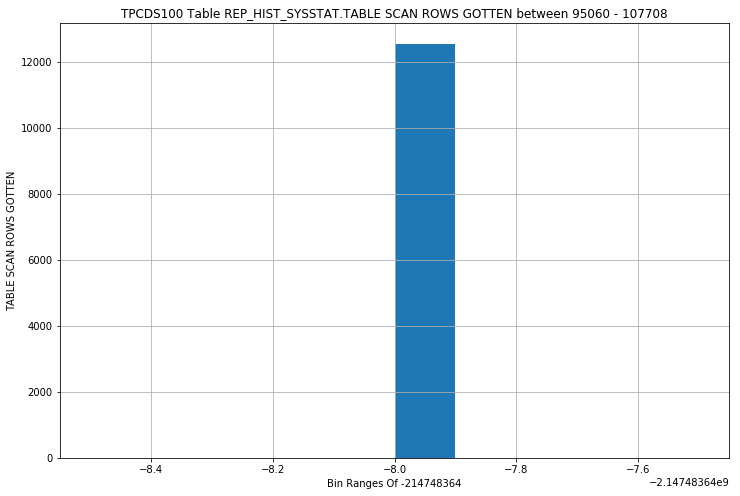

REP_HIST_SYSSTAT - TABLE SCANS (DIRECT READ) - STRIPPED HISTOGRAM


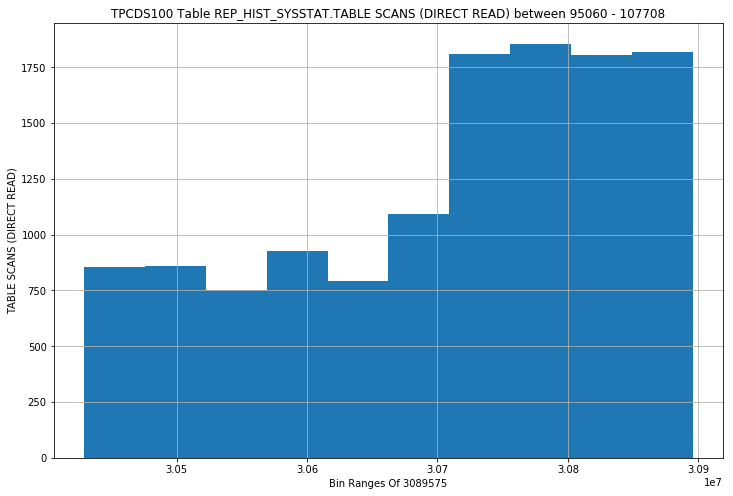

REP_HIST_SYSSTAT - TABLE SCANS (LONG TABLES) - STRIPPED HISTOGRAM


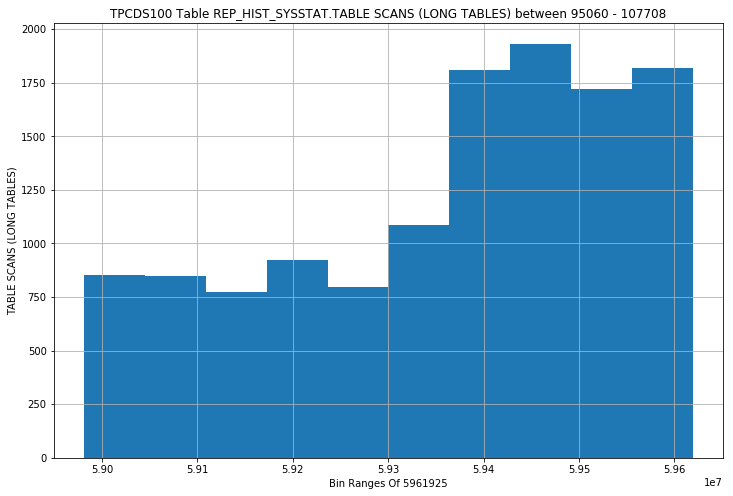

REP_HIST_SYSSTAT - TABLE SCANS (ROWID RANGES) - STRIPPED HISTOGRAM


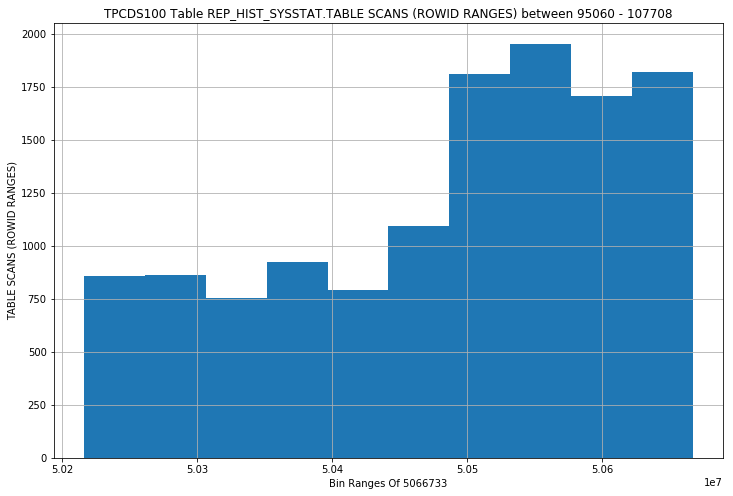

REP_HIST_SYSSTAT - TABLE SCANS (SHORT TABLES) - STRIPPED HISTOGRAM


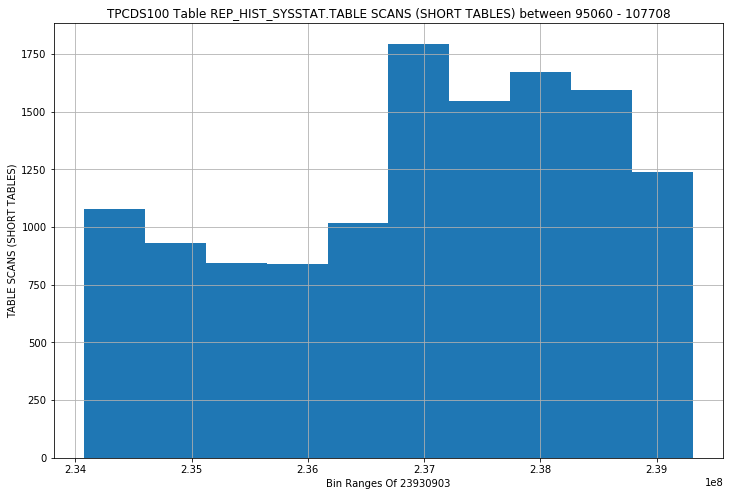

REP_HIST_SYSSTAT - TEMP SPACE ALLOCATED (BYTES) - STRIPPED HISTOGRAM


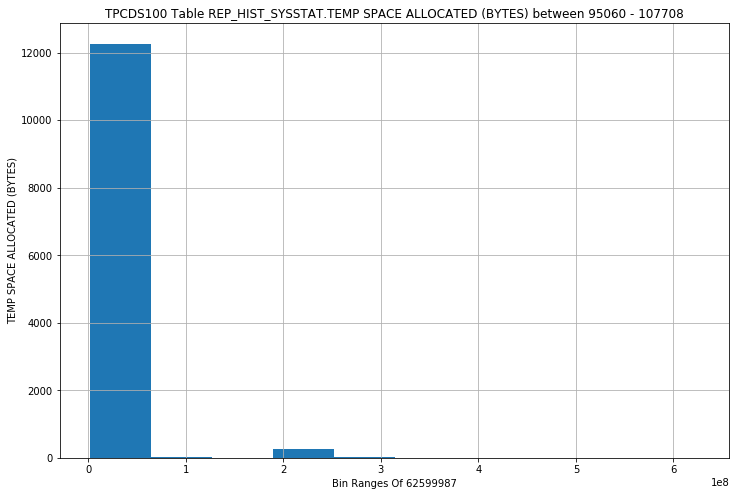

REP_HIST_SYSSTAT - TOTAL CF ENQ HOLD TIME - STRIPPED HISTOGRAM


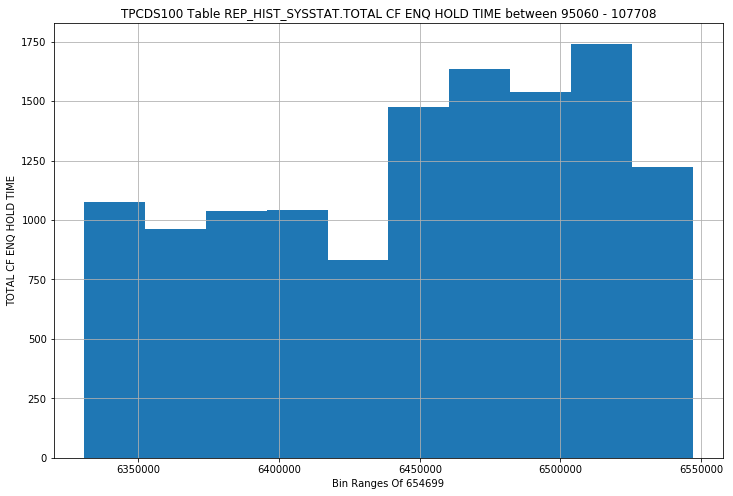

REP_HIST_SYSSTAT - TOTAL NUMBER OF CF ENQ HOLDERS - STRIPPED HISTOGRAM


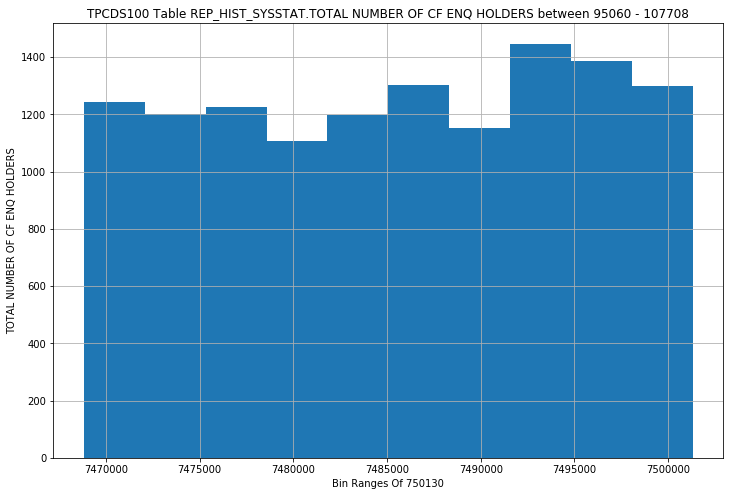

REP_HIST_SYSSTAT - TOTAL NUMBER OF SLOTS - STRIPPED HISTOGRAM


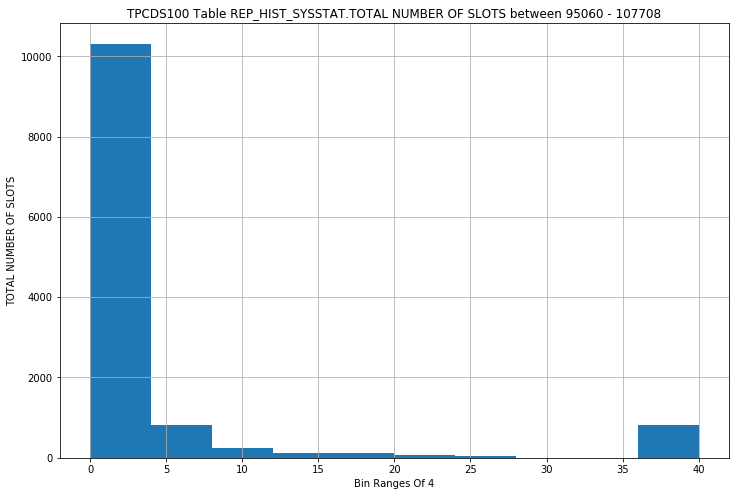

REP_HIST_SYSSTAT - TOTAL NUMBER OF TIMES SMON POSTED - STRIPPED HISTOGRAM


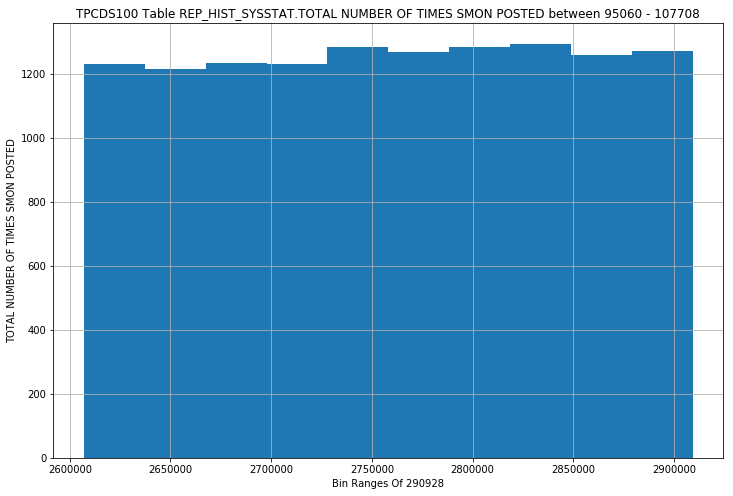

REP_HIST_SYSSTAT - TRANSACTION ROLLBACKS - STRIPPED HISTOGRAM


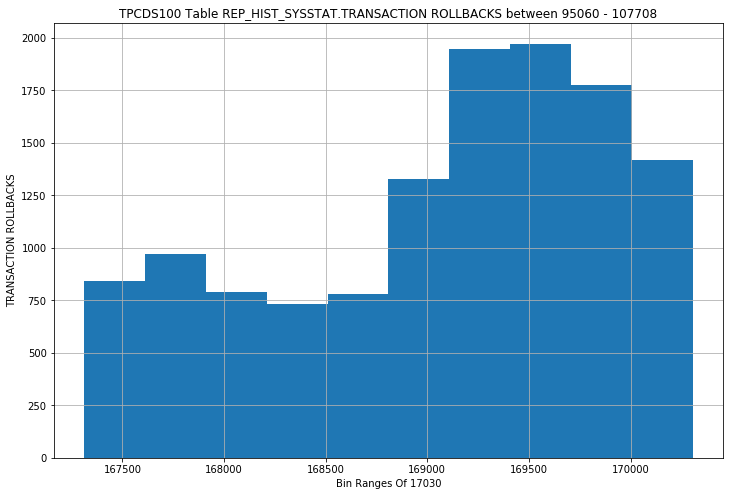

REP_HIST_SYSSTAT - TRANSACTION TABLES CONSISTENT READ ROLLBACKS - STRIPPED HISTOGRAM


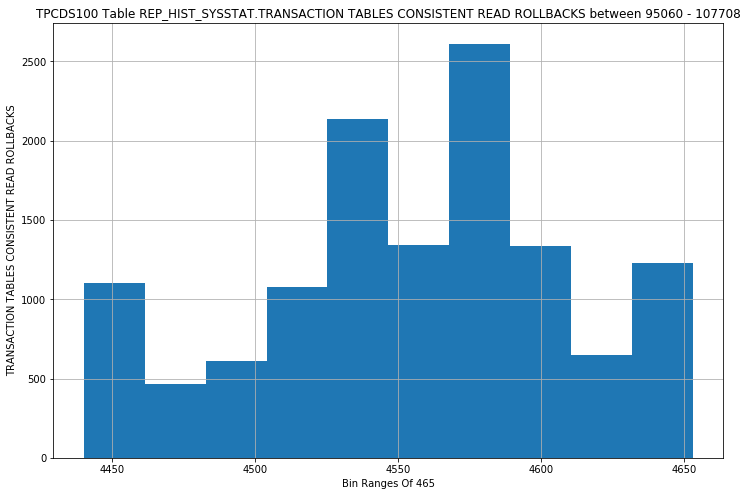

REP_HIST_SYSSTAT - TRANSACTION TABLES CONSISTENT READS - UNDO RECORDS APPLIED - STRIPPED HISTOGRAM


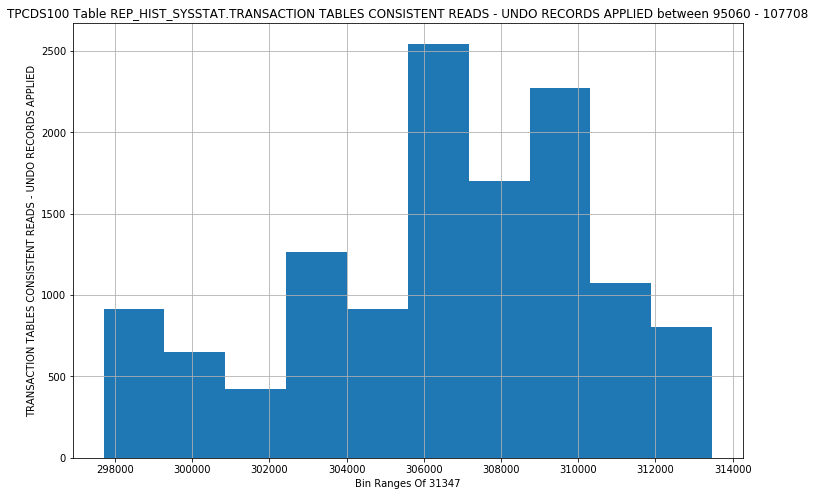

REP_HIST_SYSSTAT - UNDO CHANGE VECTOR SIZE - STRIPPED HISTOGRAM


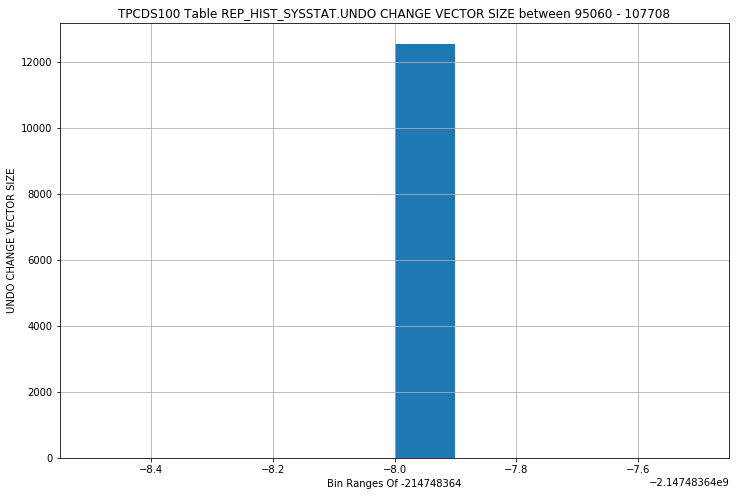

REP_HIST_SYSSTAT - USER I/O WAIT TIME - STRIPPED HISTOGRAM


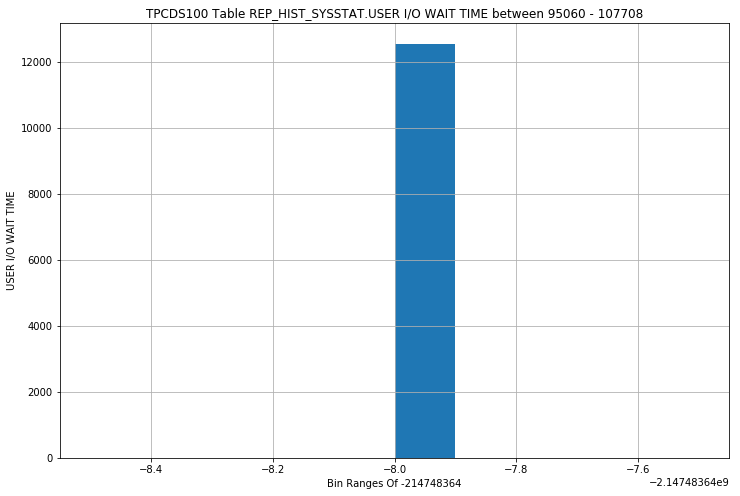

REP_HIST_SYSSTAT - USER CALLS - STRIPPED HISTOGRAM


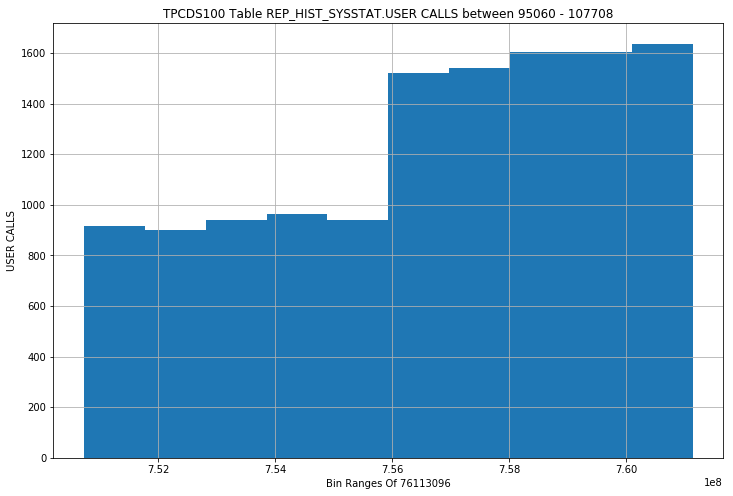

REP_HIST_SYSSTAT - USER COMMITS - STRIPPED HISTOGRAM


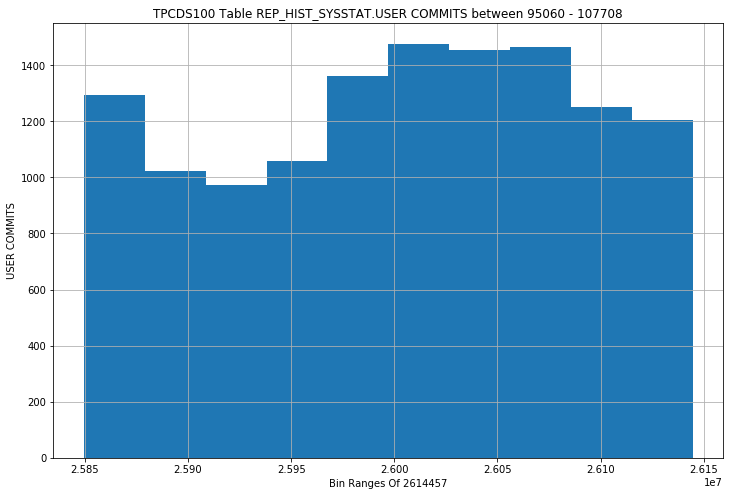

REP_HIST_SYSSTAT - USER LOGONS CUMULATIVE - STRIPPED HISTOGRAM


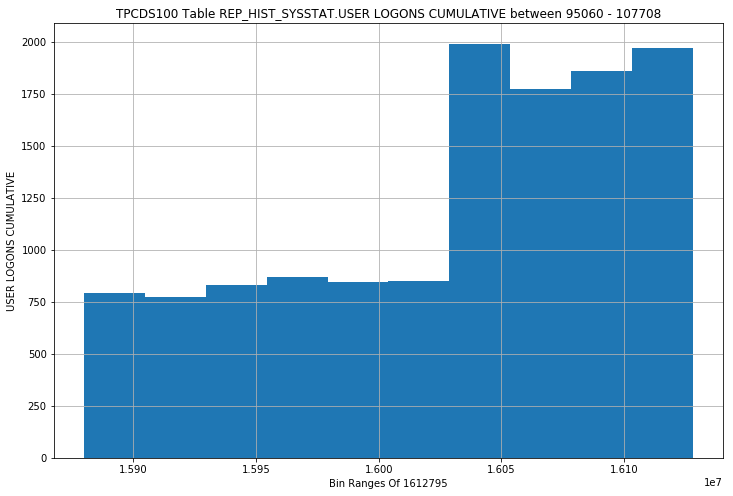

REP_HIST_SYSSTAT - USER LOGOUTS CUMULATIVE - STRIPPED HISTOGRAM


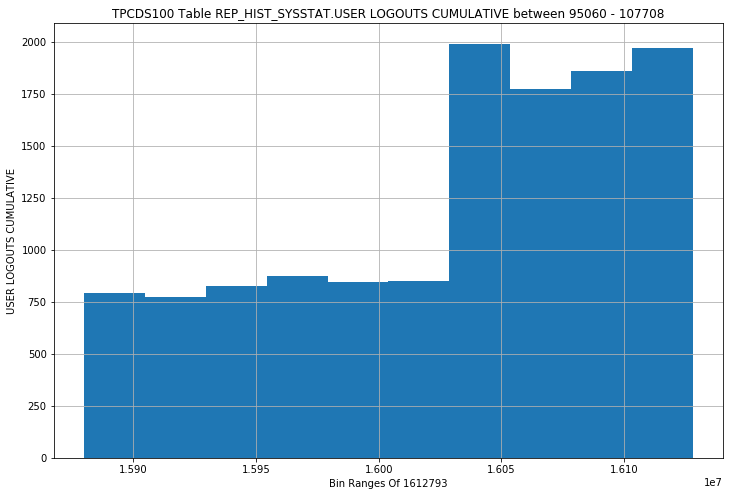

REP_HIST_SYSSTAT - USER ROLLBACKS - STRIPPED HISTOGRAM


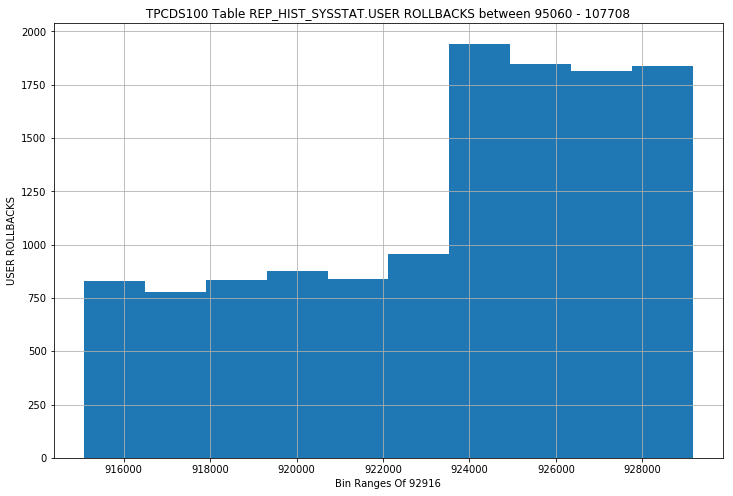

REP_HIST_SYSSTAT - WORKAREA EXECUTIONS - ONEPASS - STRIPPED HISTOGRAM


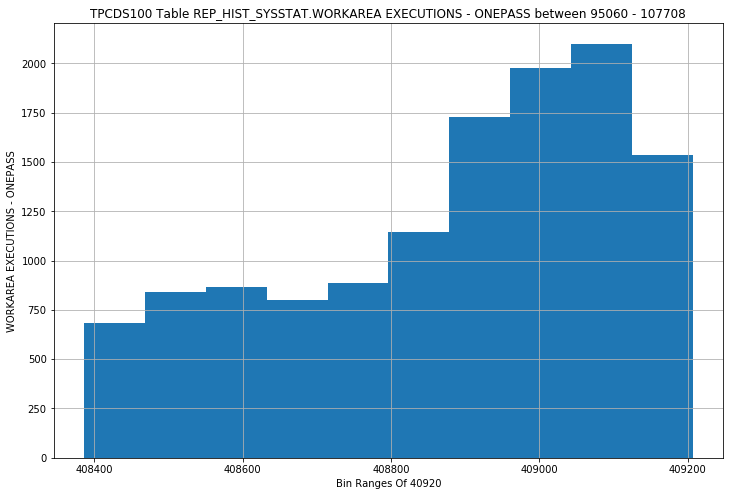

REP_HIST_SYSSTAT - WORKAREA EXECUTIONS - OPTIMAL - STRIPPED HISTOGRAM


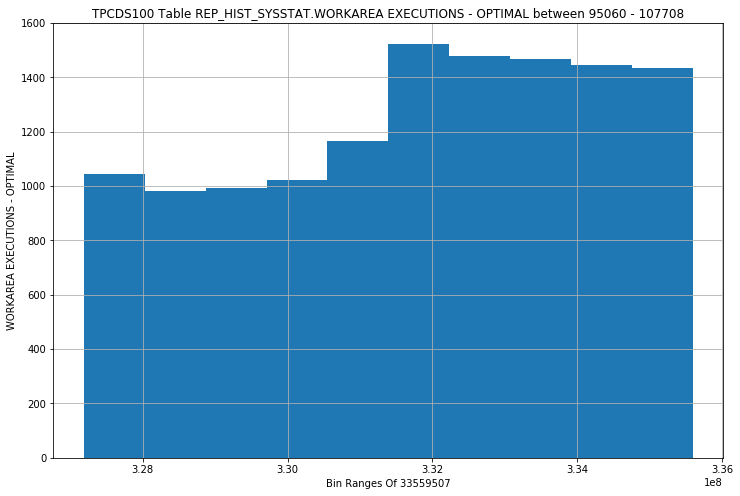

REP_HIST_SYSSTAT - WORKAREA MEMORY ALLOCATED - STRIPPED HISTOGRAM


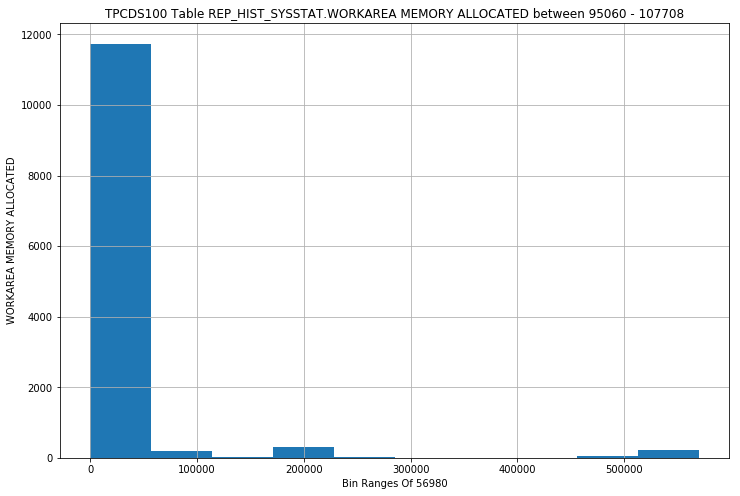

REP_HIST_SYSSTAT - WRITE CLONES CREATED IN BACKGROUND - STRIPPED HISTOGRAM


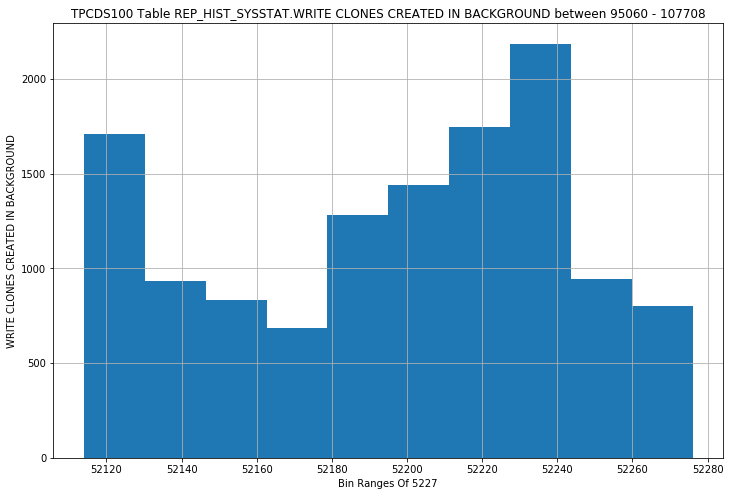

REP_HIST_SYSSTAT - WRITE CLONES CREATED IN FOREGROUND - STRIPPED HISTOGRAM


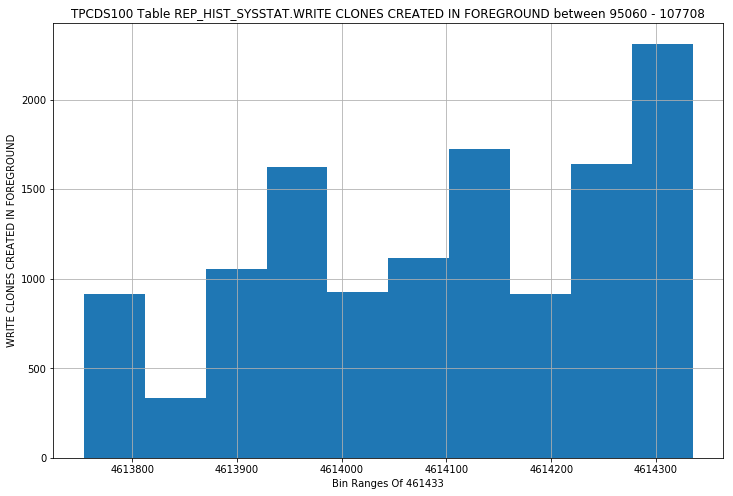

REP_HIST_SYSSTAT - SNAP_ID - STRIPPED SCATTER


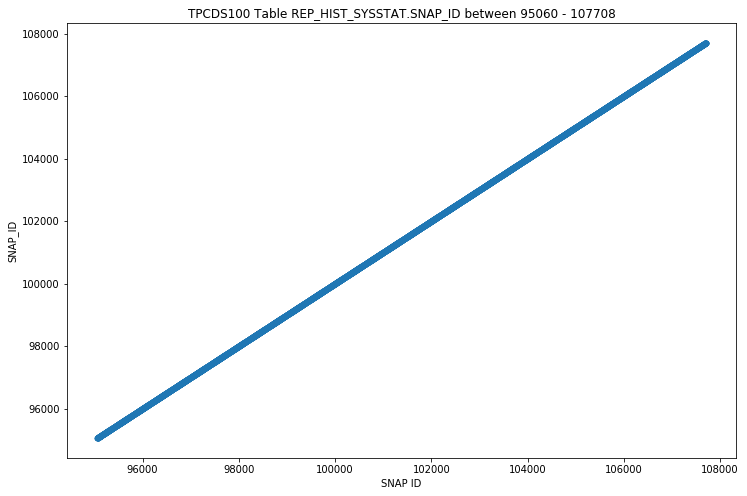

REP_HIST_SYSSTAT - BATCHED IO (BOUND) VECTOR COUNT - STRIPPED SCATTER


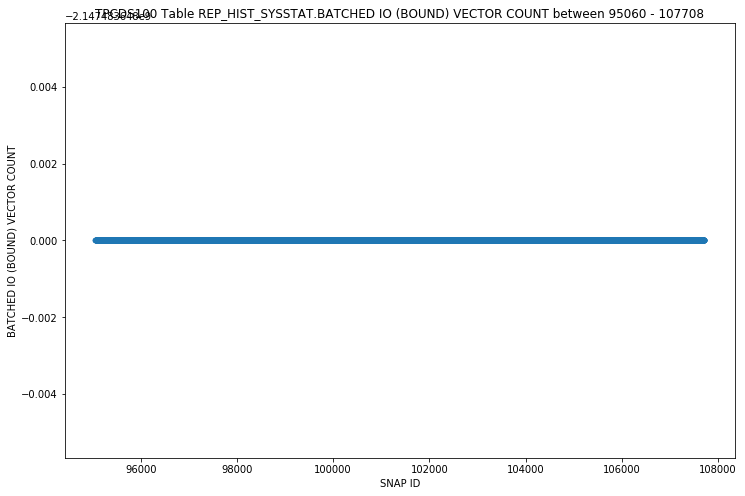

REP_HIST_SYSSTAT - BATCHED IO (FULL) VECTOR COUNT - STRIPPED SCATTER


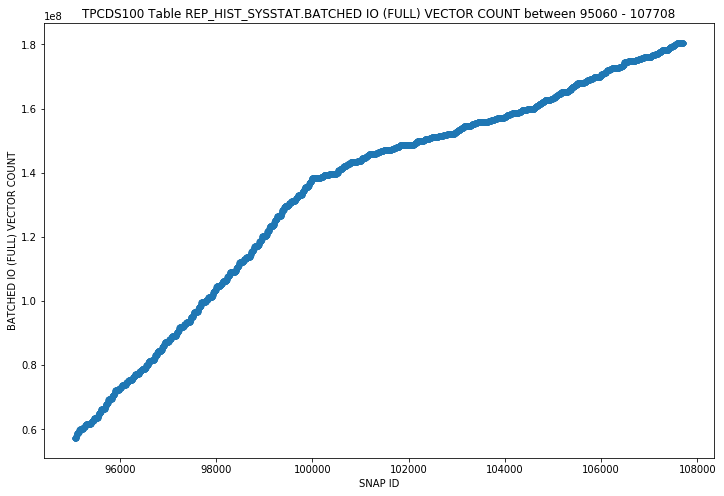

REP_HIST_SYSSTAT - BATCHED IO (SPACE) VECTOR COUNT - STRIPPED SCATTER


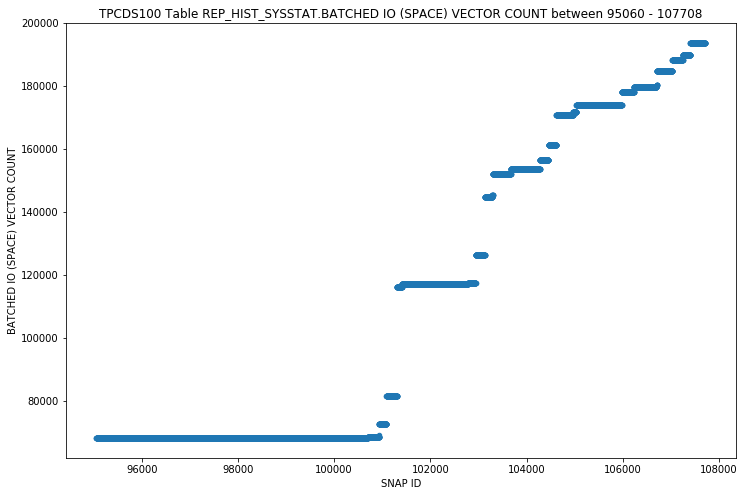

REP_HIST_SYSSTAT - BATCHED IO BLOCK MISS COUNT - STRIPPED SCATTER


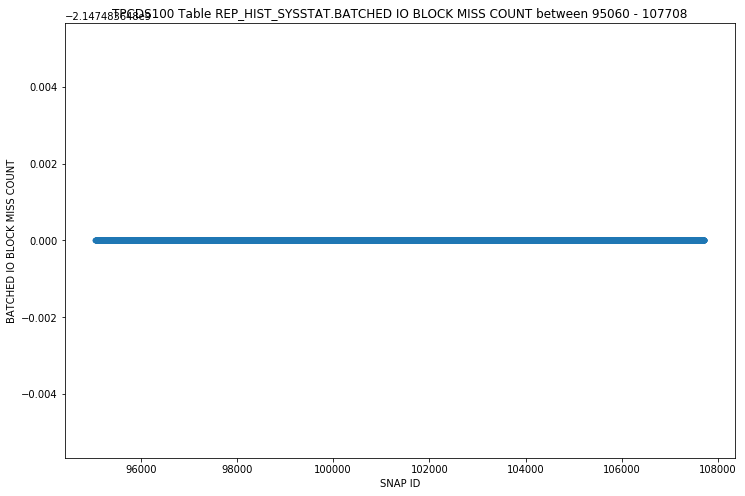

REP_HIST_SYSSTAT - BATCHED IO BUFFER DEFRAG COUNT - STRIPPED SCATTER


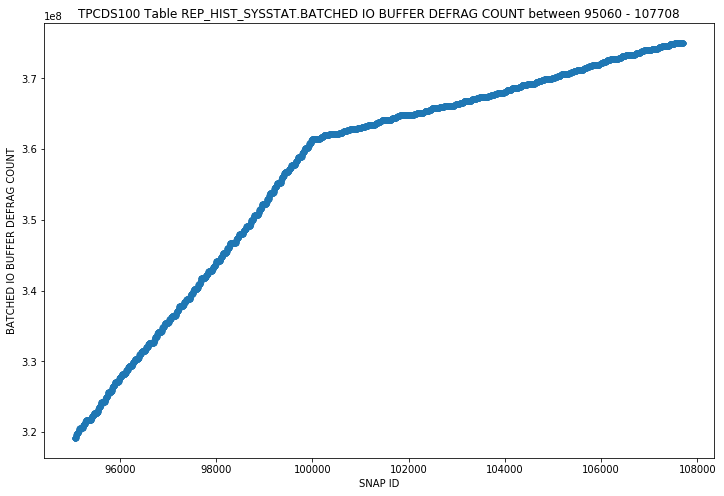

REP_HIST_SYSSTAT - BATCHED IO DOUBLE MISS COUNT - STRIPPED SCATTER


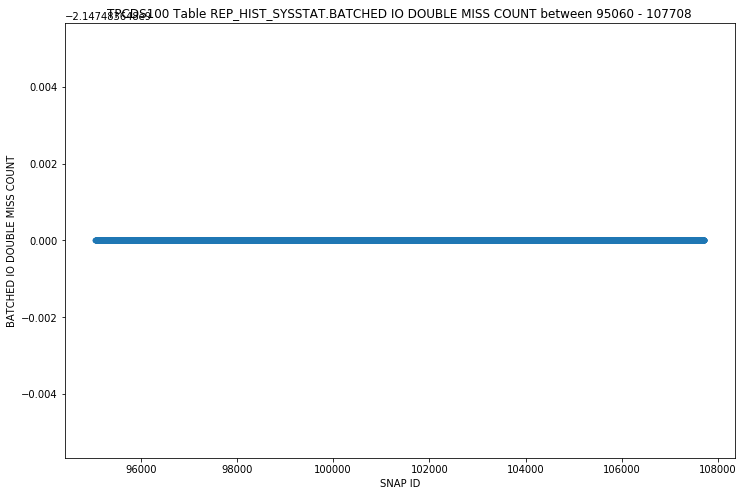

REP_HIST_SYSSTAT - BATCHED IO SAME UNIT COUNT - STRIPPED SCATTER


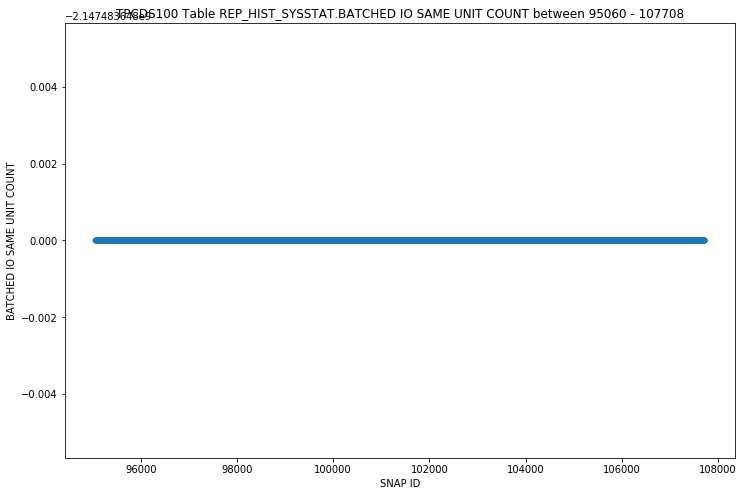

REP_HIST_SYSSTAT - BATCHED IO SINGLE BLOCK COUNT - STRIPPED SCATTER


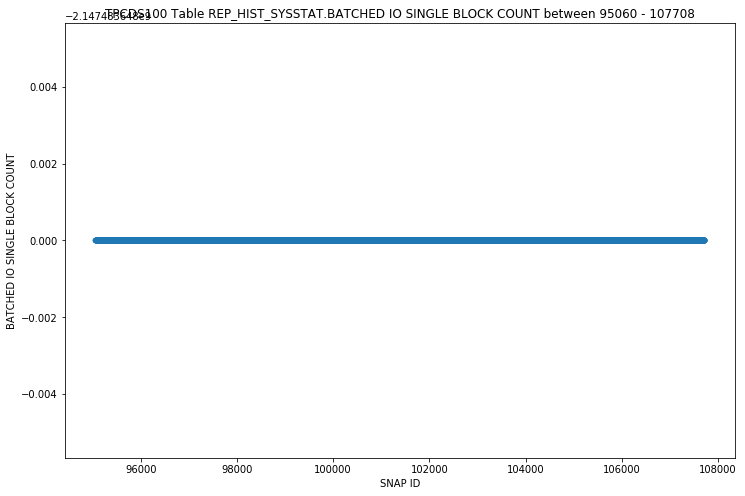

REP_HIST_SYSSTAT - BATCHED IO SLOW JUMP COUNT - STRIPPED SCATTER


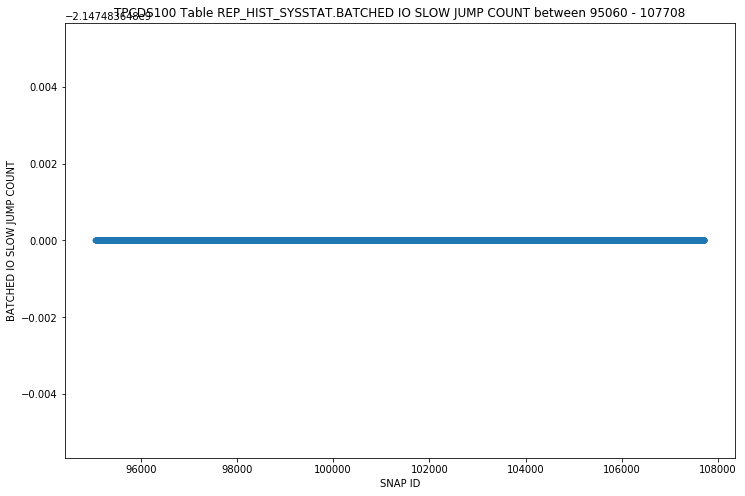

REP_HIST_SYSSTAT - BATCHED IO VECTOR BLOCK COUNT - STRIPPED SCATTER


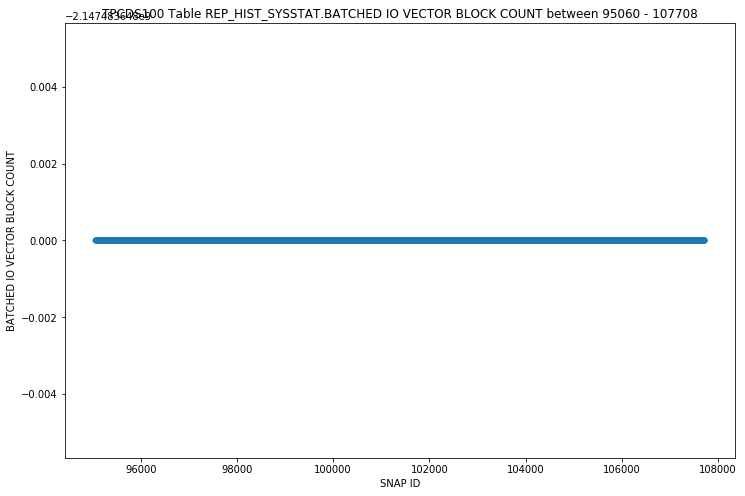

REP_HIST_SYSSTAT - BATCHED IO VECTOR READ COUNT - STRIPPED SCATTER


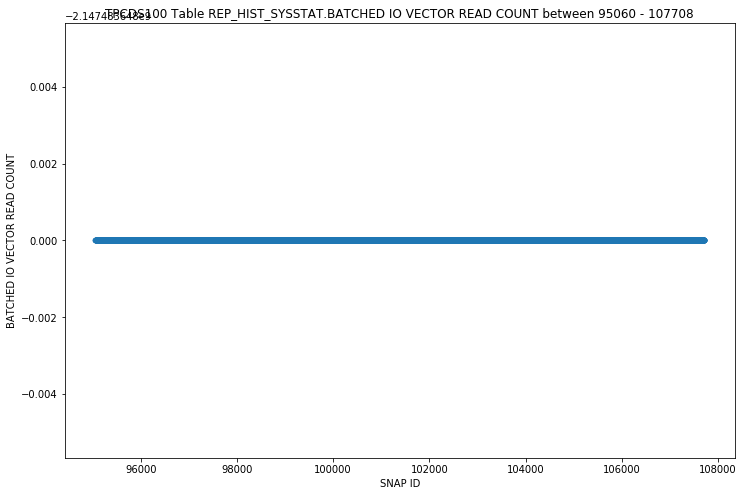

REP_HIST_SYSSTAT - BLOCK CLEANOUT OPTIM REFERENCED - STRIPPED SCATTER


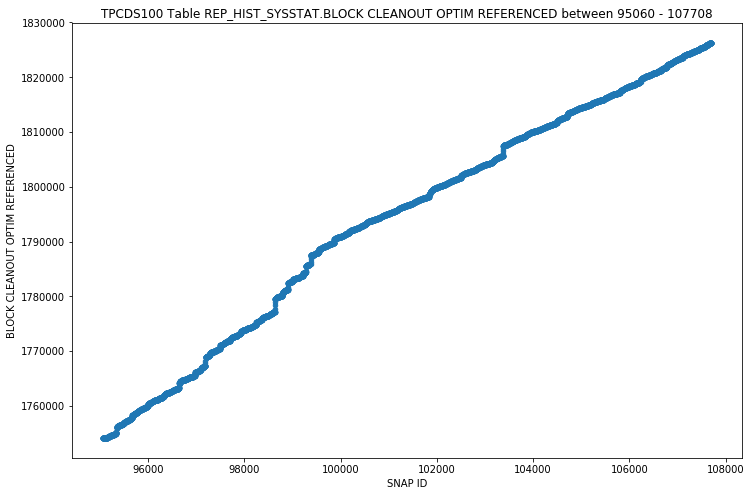

REP_HIST_SYSSTAT - CCURSOR + SQL AREA EVICTED - STRIPPED SCATTER


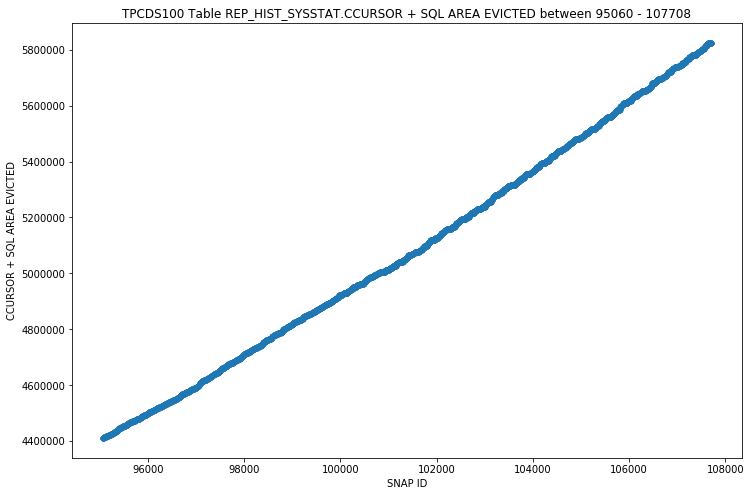

REP_HIST_SYSSTAT - CLI BG ENQ - STRIPPED SCATTER


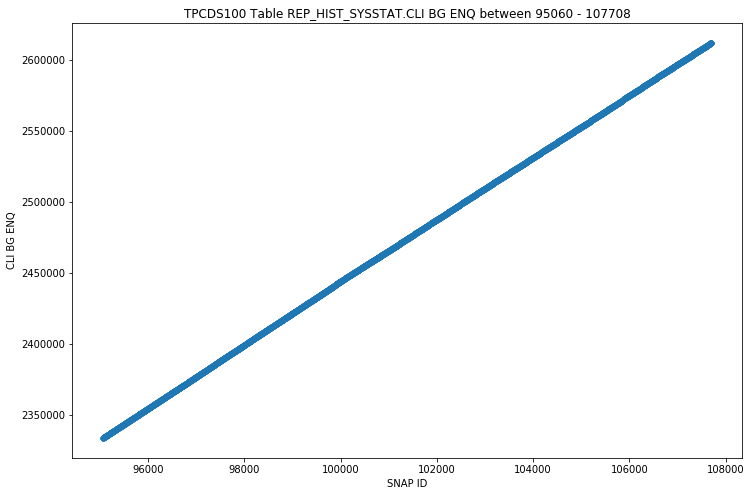

REP_HIST_SYSSTAT - CLI BG ATTEMPT FLUSH - STRIPPED SCATTER


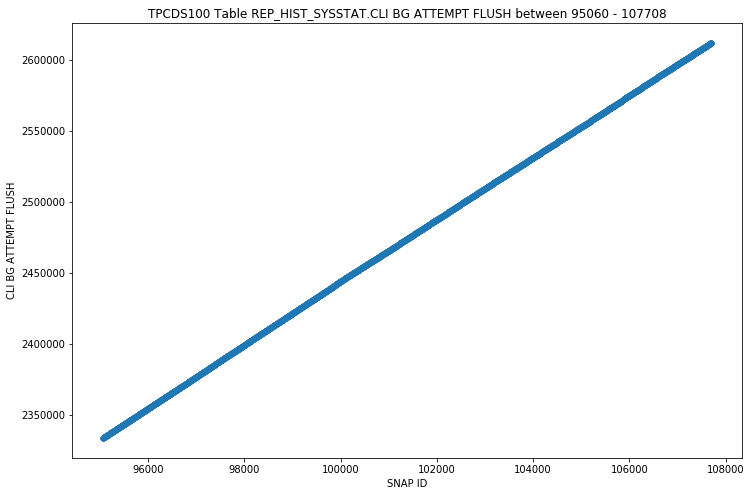

REP_HIST_SYSSTAT - CLI FLSTASK CREATE - STRIPPED SCATTER


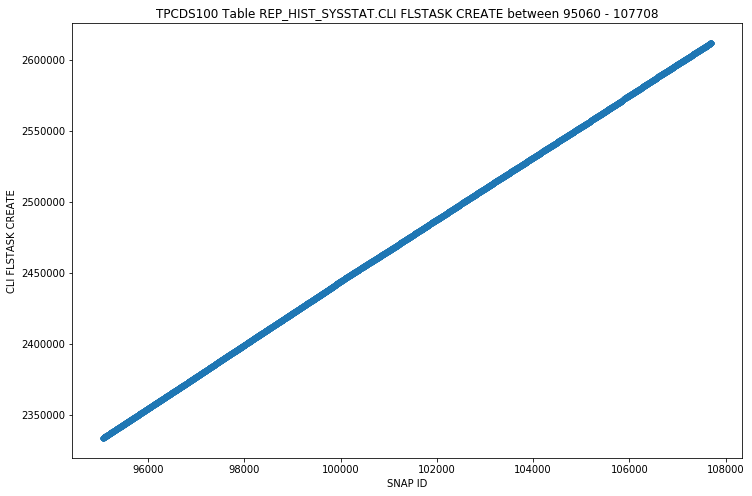

REP_HIST_SYSSTAT - CLI FLUSH - STRIPPED SCATTER


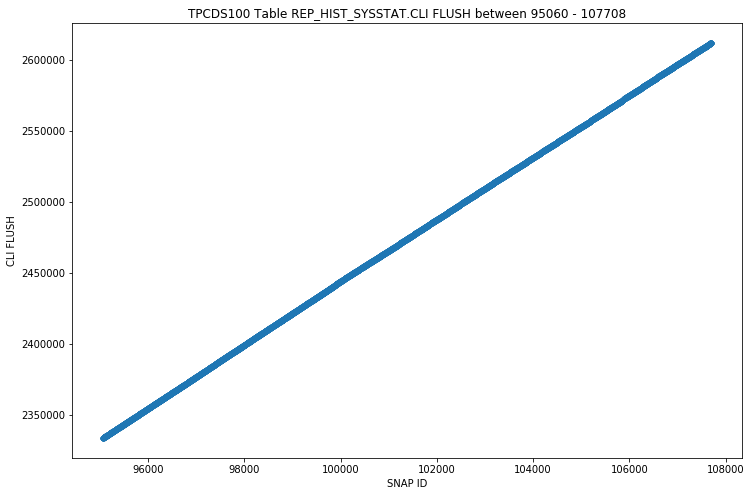

REP_HIST_SYSSTAT - CPU USED BY THIS SESSION - STRIPPED SCATTER


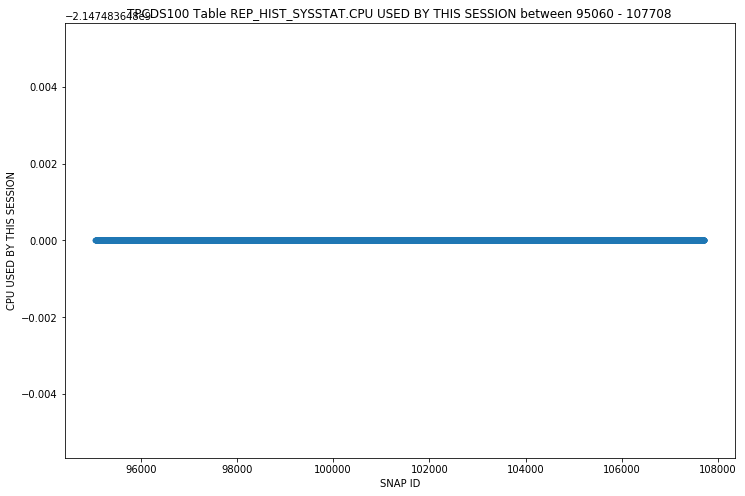

REP_HIST_SYSSTAT - CPU USED WHEN CALL STARTED - STRIPPED SCATTER


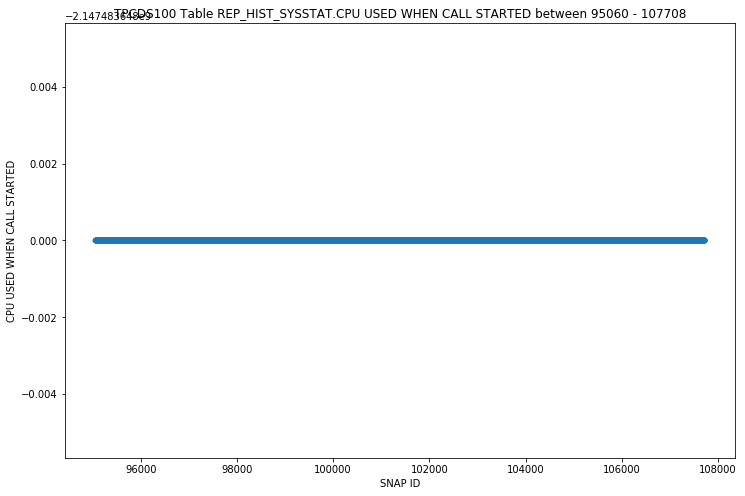

REP_HIST_SYSSTAT - CR BLOCKS CREATED - STRIPPED SCATTER


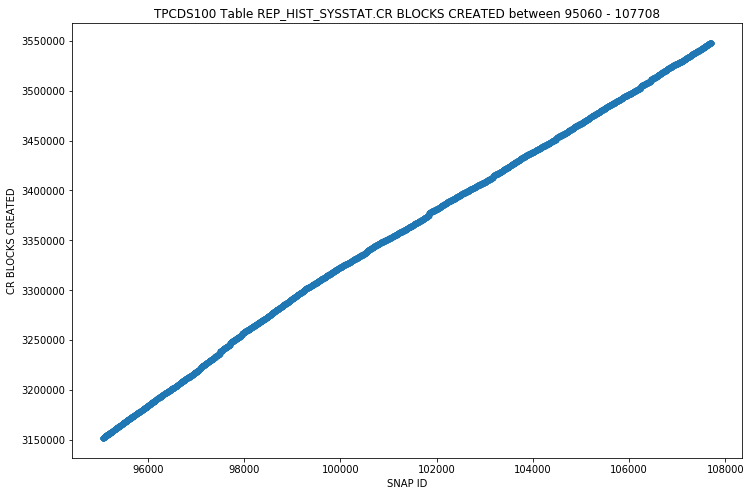

REP_HIST_SYSSTAT - CACHED COMMIT SCN REFERENCED - STRIPPED SCATTER


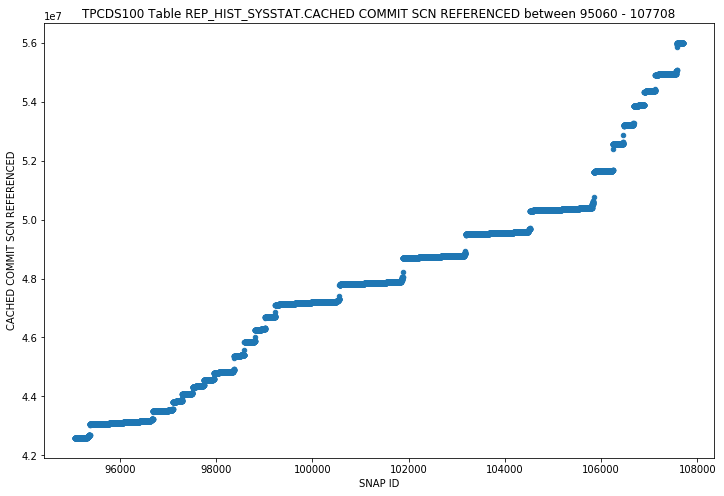

REP_HIST_SYSSTAT - COMMIT SCN CACHED - STRIPPED SCATTER


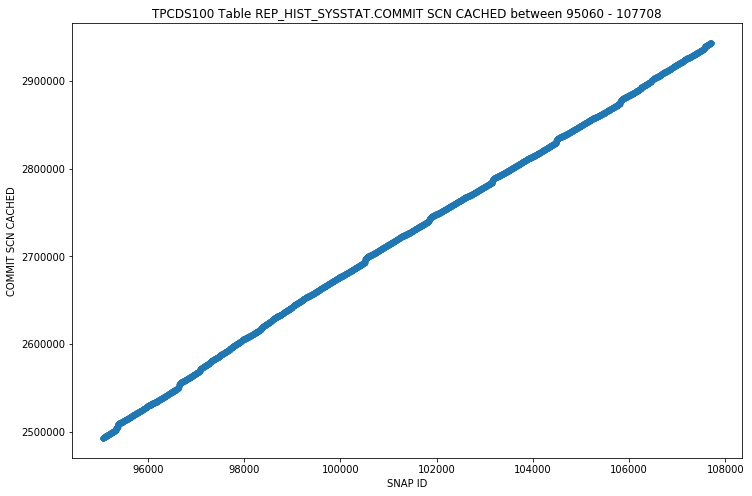

REP_HIST_SYSSTAT - DB TIME - STRIPPED SCATTER


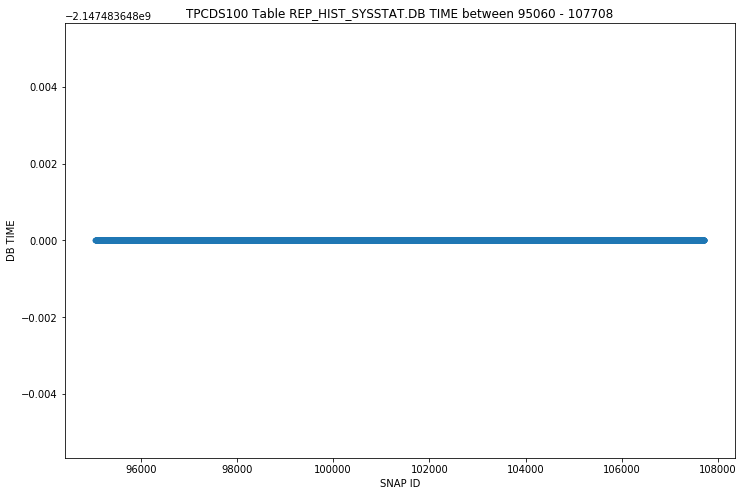

REP_HIST_SYSSTAT - DBWR CHECKPOINT BUFFERS WRITTEN - STRIPPED SCATTER


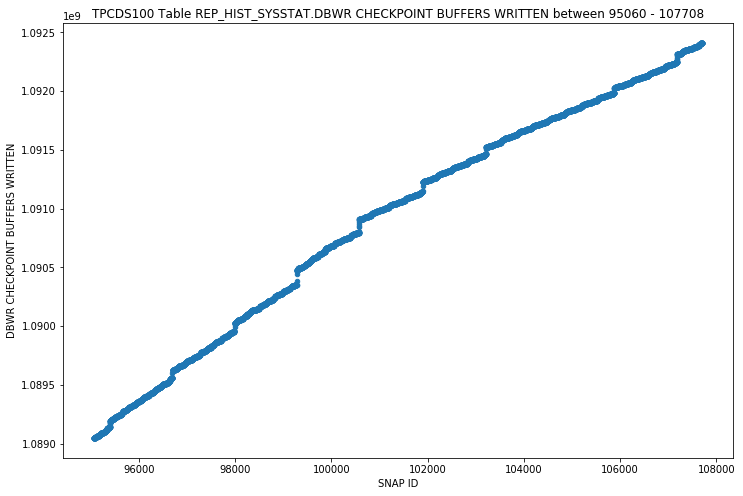

REP_HIST_SYSSTAT - DBWR CHECKPOINTS - STRIPPED SCATTER


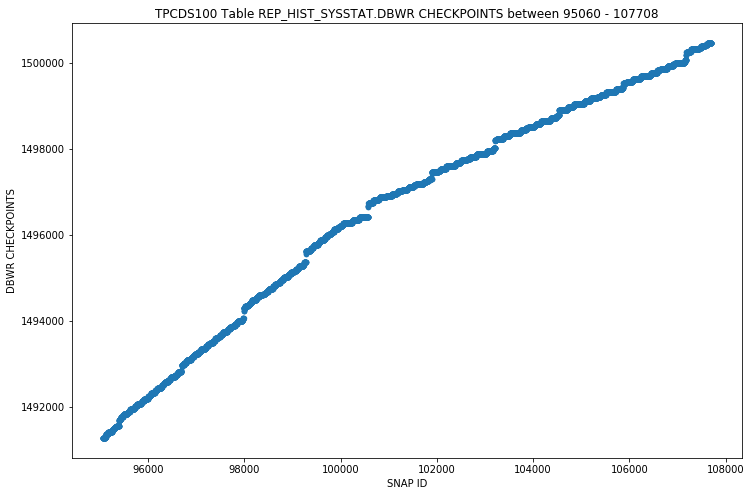

REP_HIST_SYSSTAT - DBWR OBJECT DROP BUFFERS WRITTEN - STRIPPED SCATTER


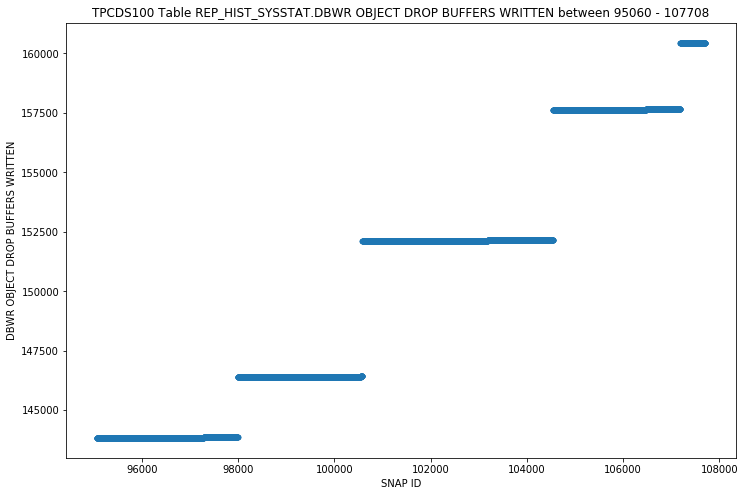

REP_HIST_SYSSTAT - DBWR PARALLEL QUERY CHECKPOINT BUFFERS WRITTEN - STRIPPED SCATTER


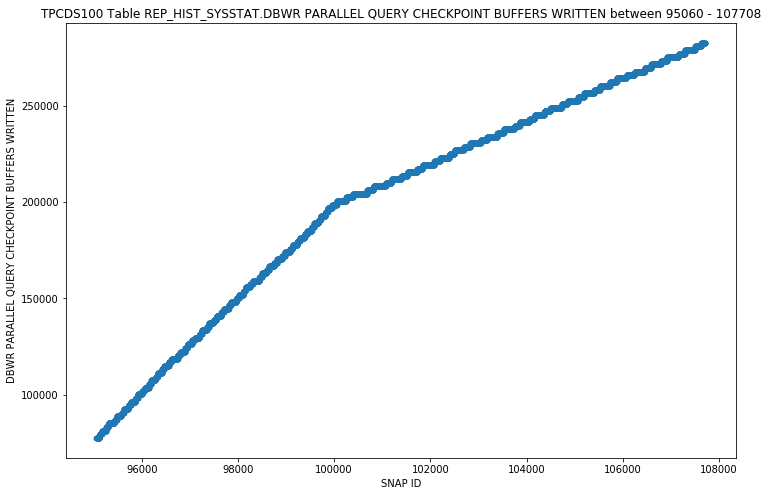

REP_HIST_SYSSTAT - DBWR REVISITED BEING-WRITTEN BUFFER - STRIPPED SCATTER


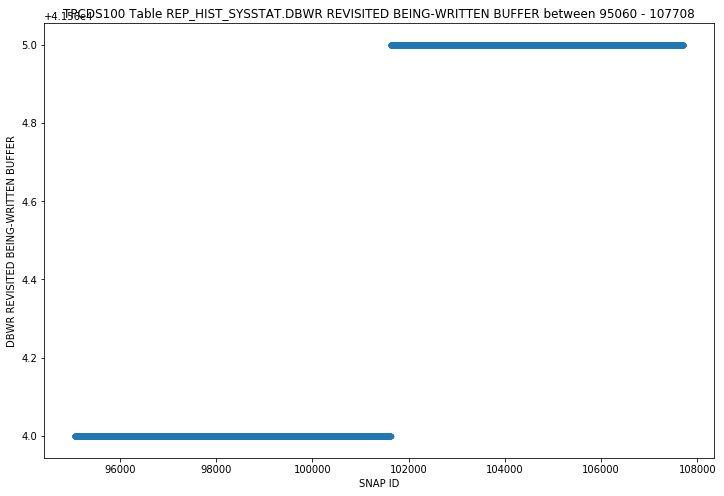

REP_HIST_SYSSTAT - DBWR THREAD CHECKPOINT BUFFERS WRITTEN - STRIPPED SCATTER


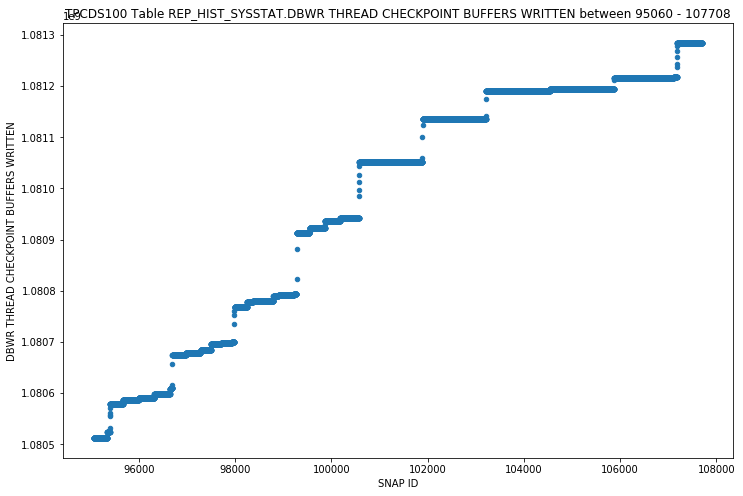

REP_HIST_SYSSTAT - DBWR TRANSACTION TABLE WRITES - STRIPPED SCATTER


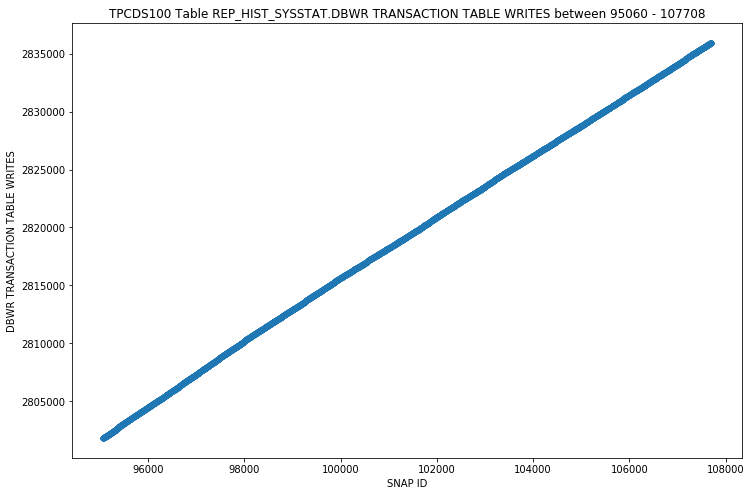

REP_HIST_SYSSTAT - DBWR UNDO BLOCK WRITES - STRIPPED SCATTER


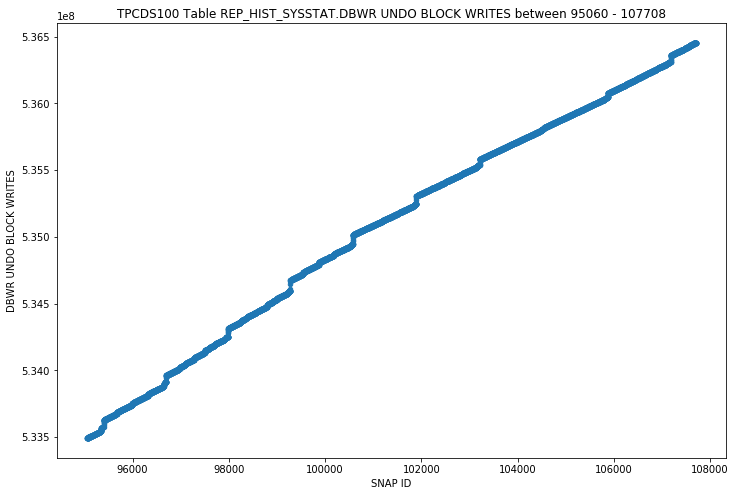

REP_HIST_SYSSTAT - DDL STATEMENTS PARALLELIZED - STRIPPED SCATTER


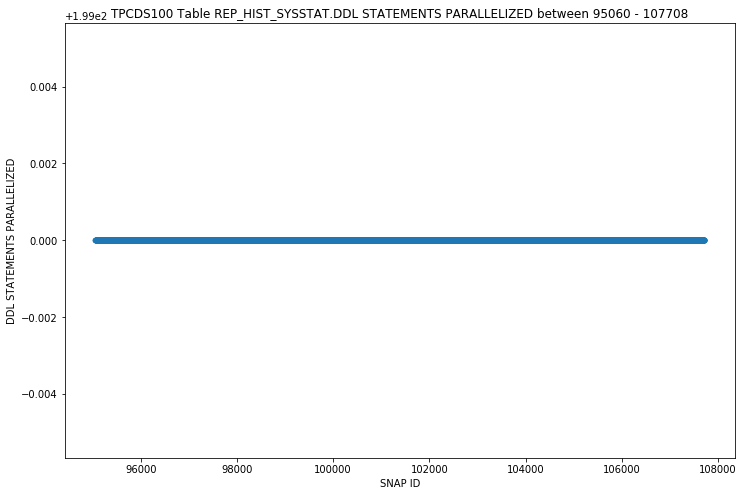

REP_HIST_SYSSTAT - DFO TREES PARALLELIZED - STRIPPED SCATTER


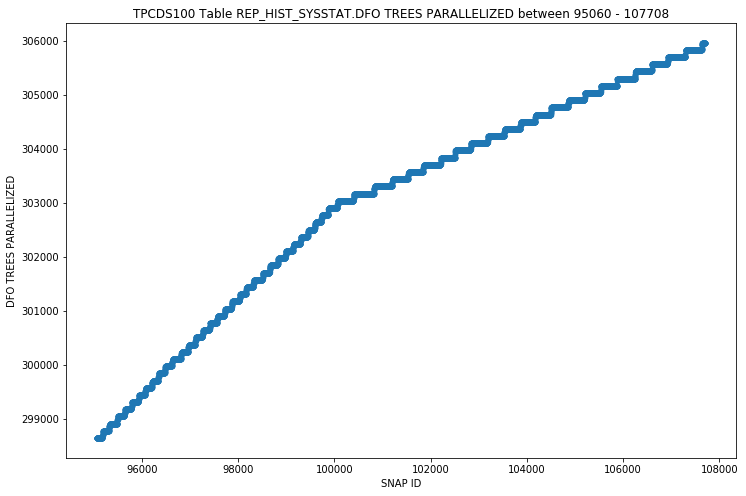

REP_HIST_SYSSTAT - EFFECTIVE IO TIME - STRIPPED SCATTER


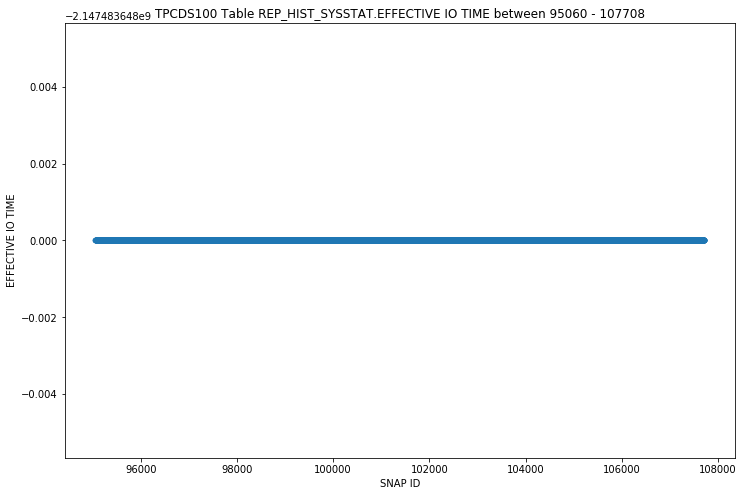

REP_HIST_SYSSTAT - HSC HEAP SEGMENT BLOCK CHANGES - STRIPPED SCATTER


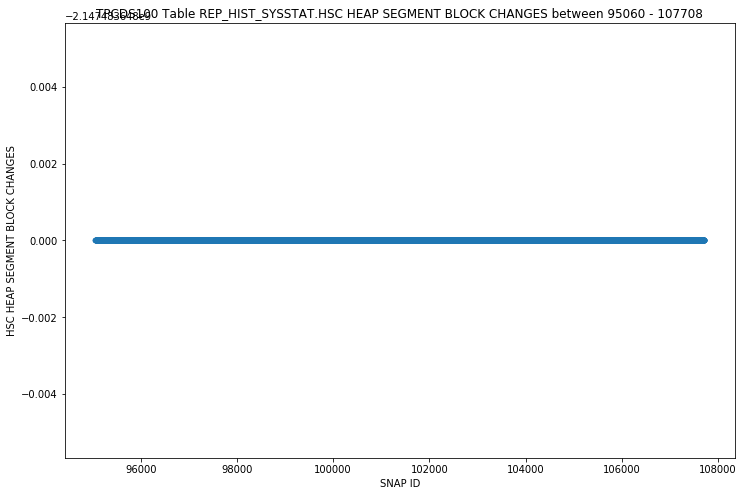

REP_HIST_SYSSTAT - HEAP SEGMENT ARRAY INSERTS - STRIPPED SCATTER


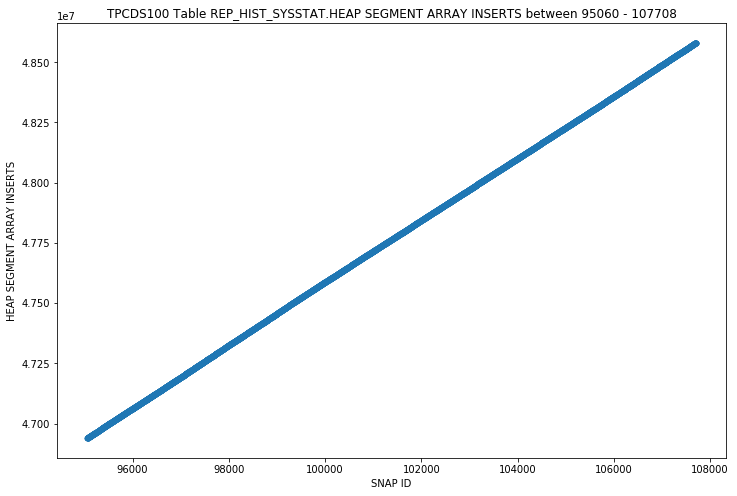

REP_HIST_SYSSTAT - HEAP SEGMENT ARRAY UPDATES - STRIPPED SCATTER


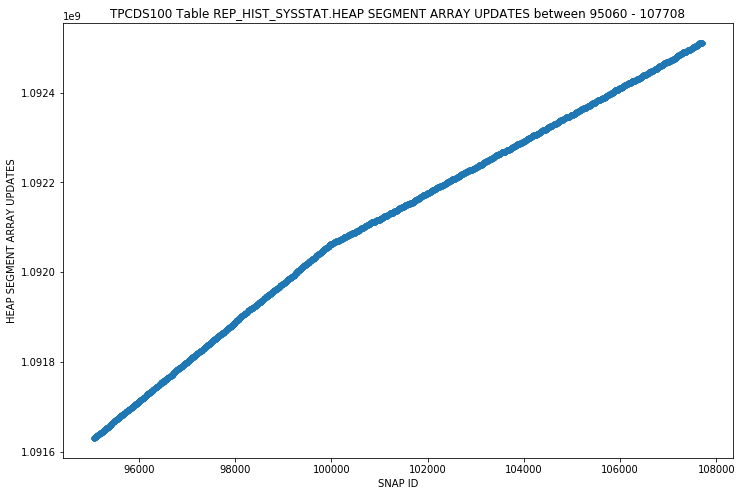

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSHED - STRIPPED SCATTER


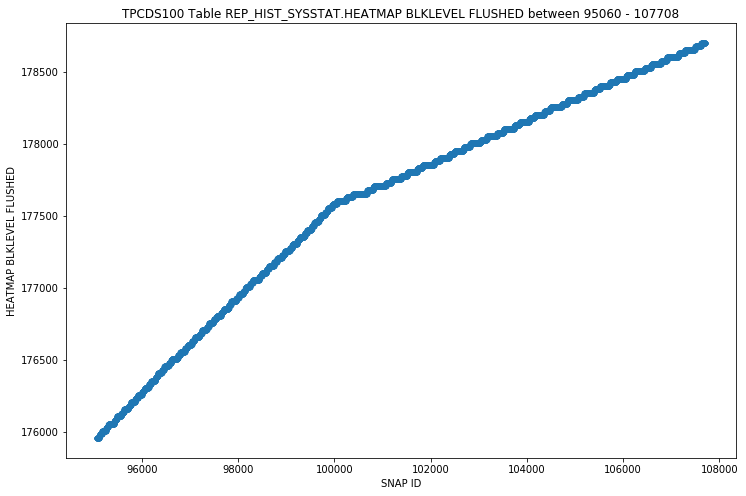

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSHED TO BF - STRIPPED SCATTER


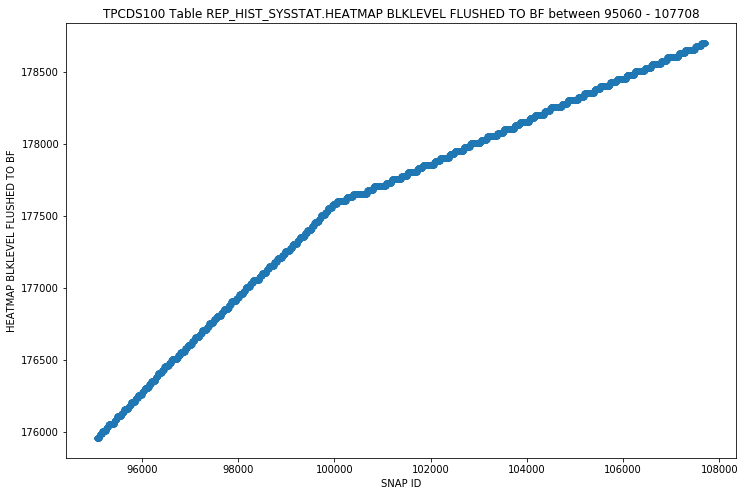

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL RANGES FLUSHED - STRIPPED SCATTER


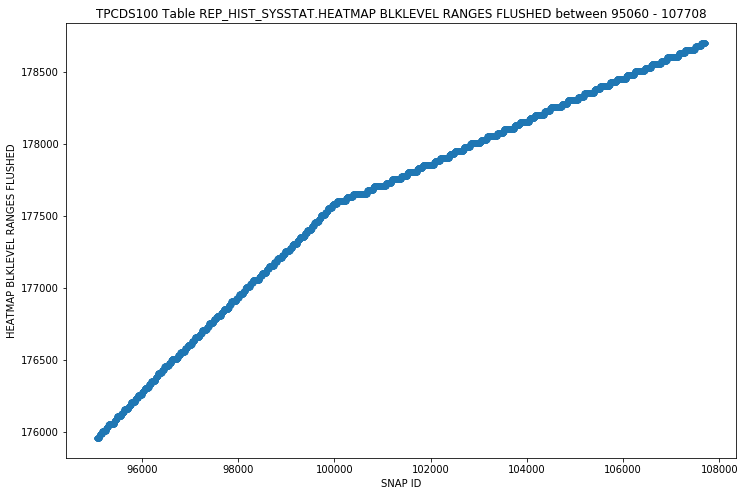

REP_HIST_SYSSTAT - HEATMAP BLKLEVEL FLUSH TASK COUNT - STRIPPED SCATTER


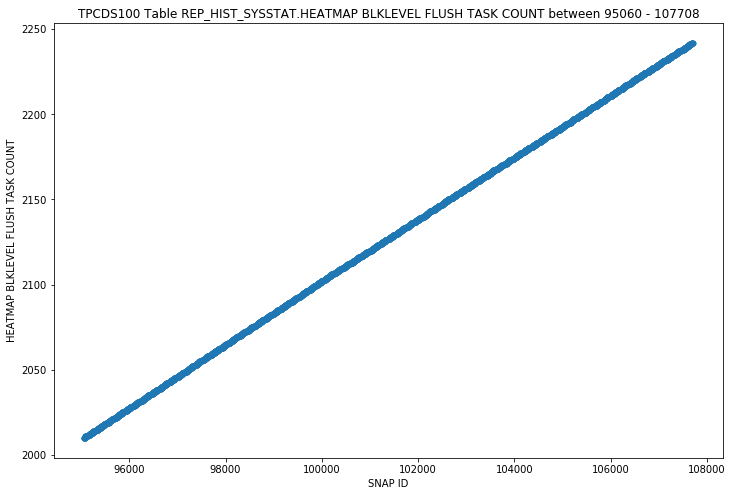

REP_HIST_SYSSTAT - IMU CR ROLLBACKS - STRIPPED SCATTER


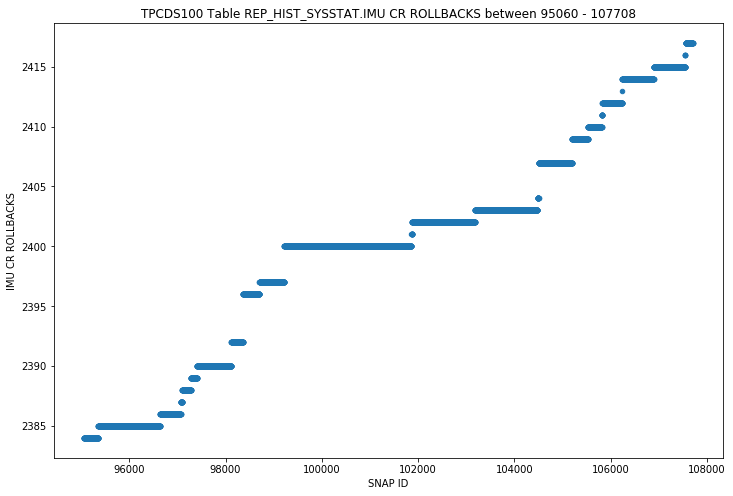

REP_HIST_SYSSTAT - IMU FLUSHES - STRIPPED SCATTER


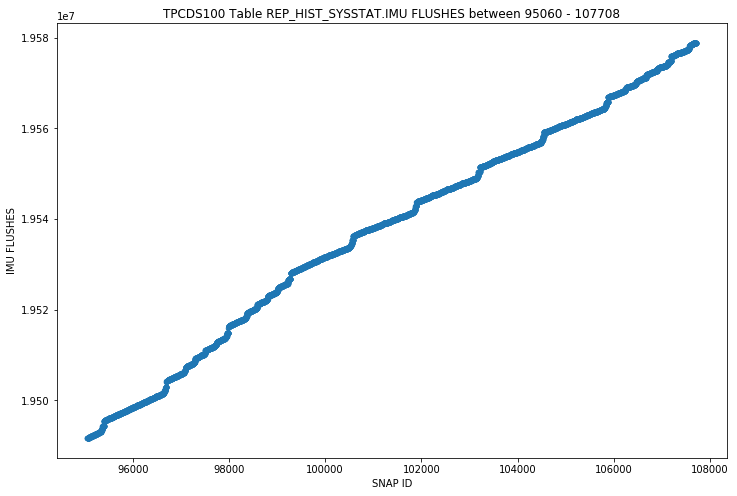

REP_HIST_SYSSTAT - IMU REDO ALLOCATION SIZE - STRIPPED SCATTER


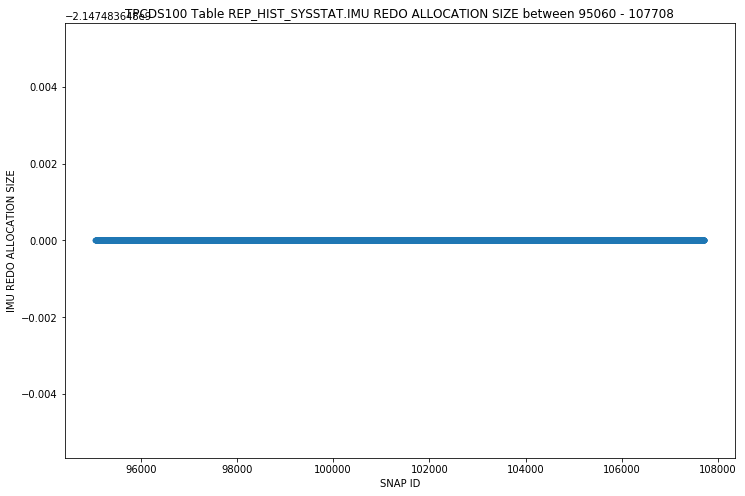

REP_HIST_SYSSTAT - IMU COMMITS - STRIPPED SCATTER


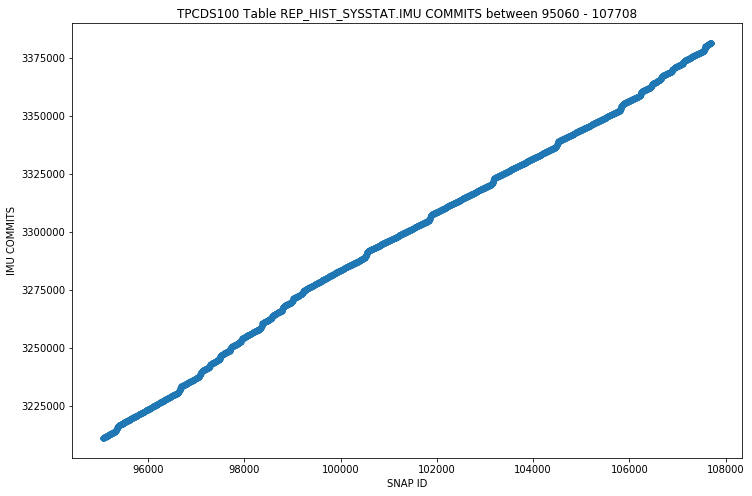

REP_HIST_SYSSTAT - IMU CONTENTION - STRIPPED SCATTER


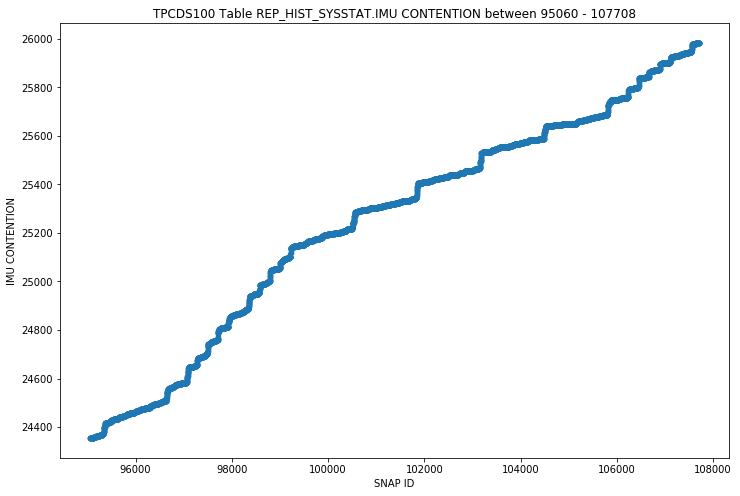

REP_HIST_SYSSTAT - IMU KTICHG FLUSH - STRIPPED SCATTER


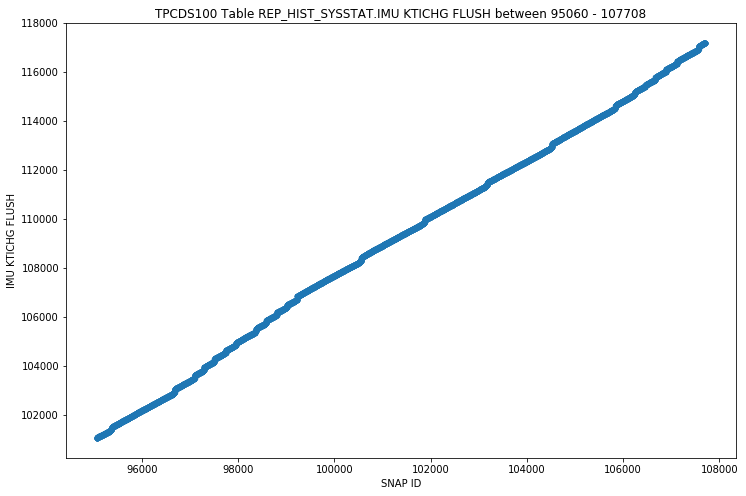

REP_HIST_SYSSTAT - IMU POOL NOT ALLOCATED - STRIPPED SCATTER


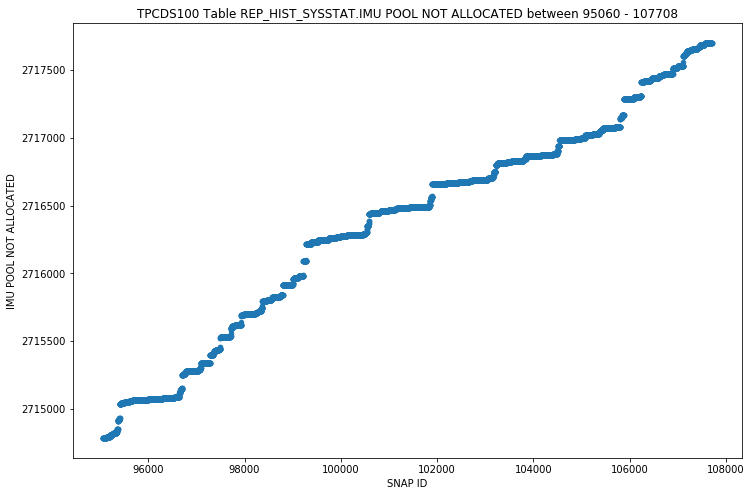

REP_HIST_SYSSTAT - IMU RECURSIVE-TRANSACTION FLUSH - STRIPPED SCATTER


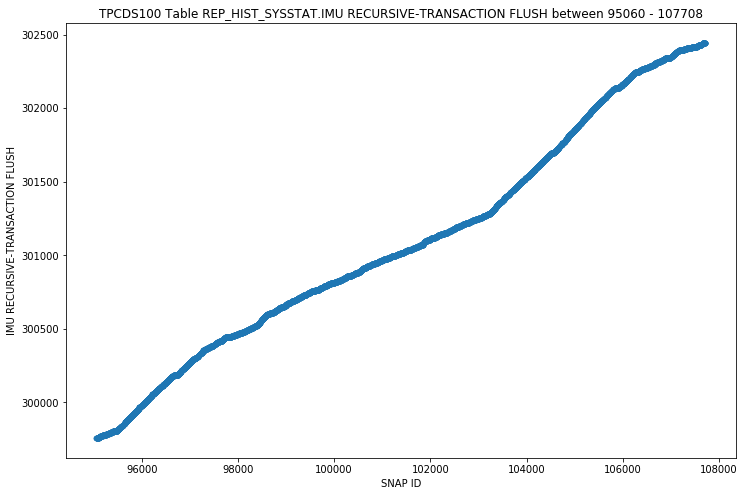

REP_HIST_SYSSTAT - IMU UNDO ALLOCATION SIZE - STRIPPED SCATTER


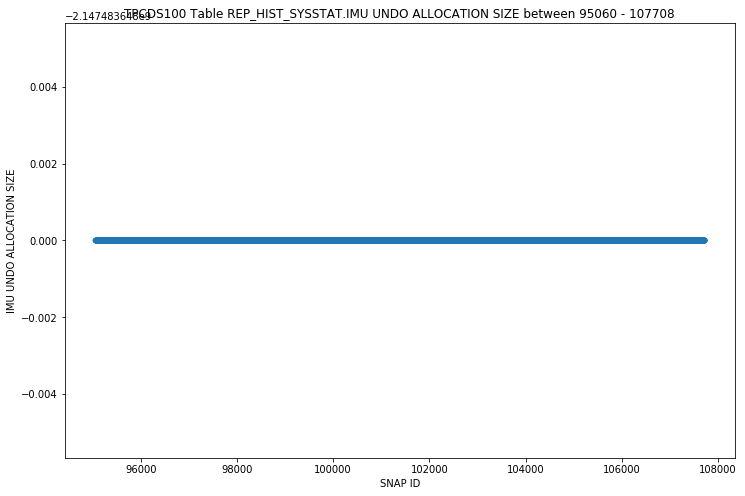

REP_HIST_SYSSTAT - IMU- FAILED TO GET A PRIVATE STRAND - STRIPPED SCATTER


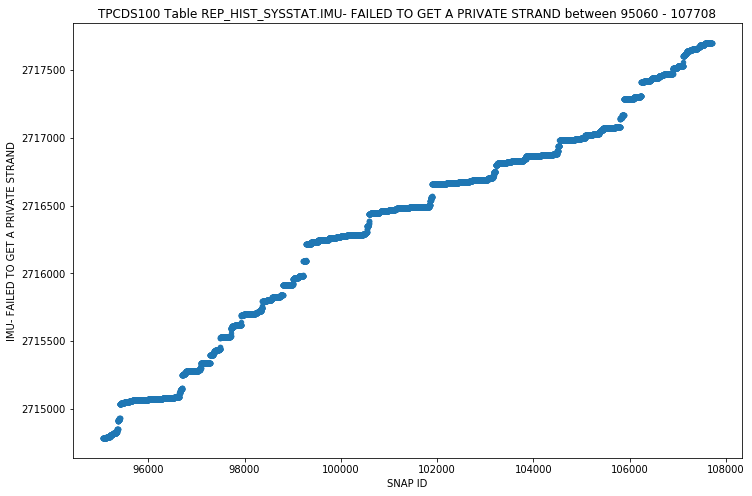

REP_HIST_SYSSTAT - KTFB ALLOC REQ - STRIPPED SCATTER


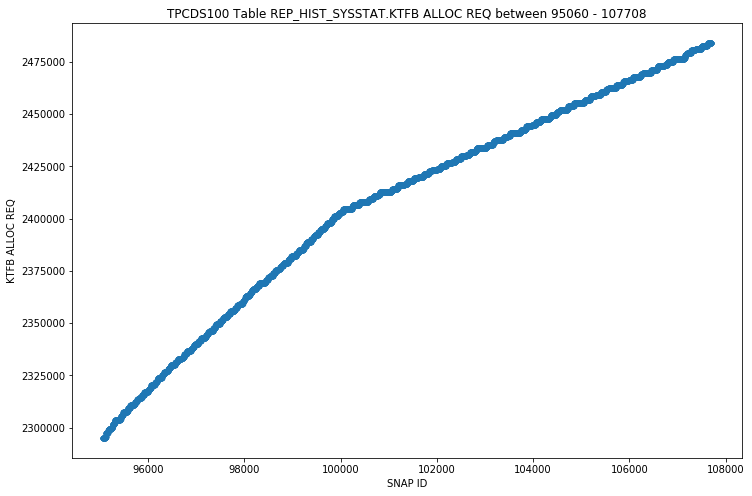

REP_HIST_SYSSTAT - KTFB ALLOC SPACE (BLOCK) - STRIPPED SCATTER


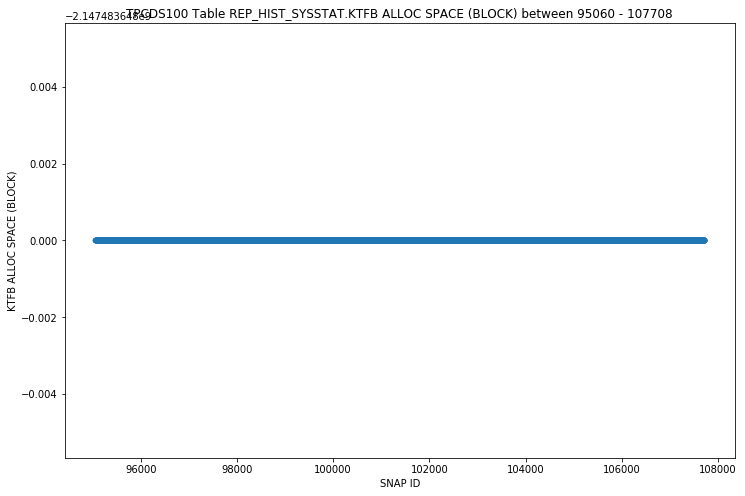

REP_HIST_SYSSTAT - KTFB ALLOC TIME (MS) - STRIPPED SCATTER


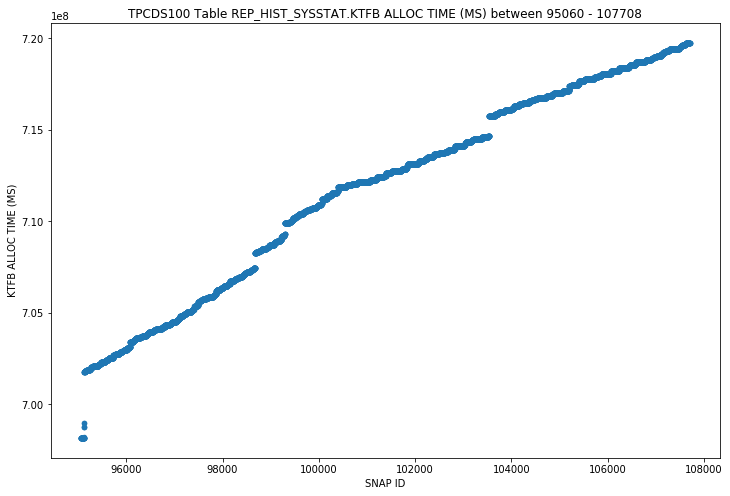

REP_HIST_SYSSTAT - KTFB APPLY REQ - STRIPPED SCATTER


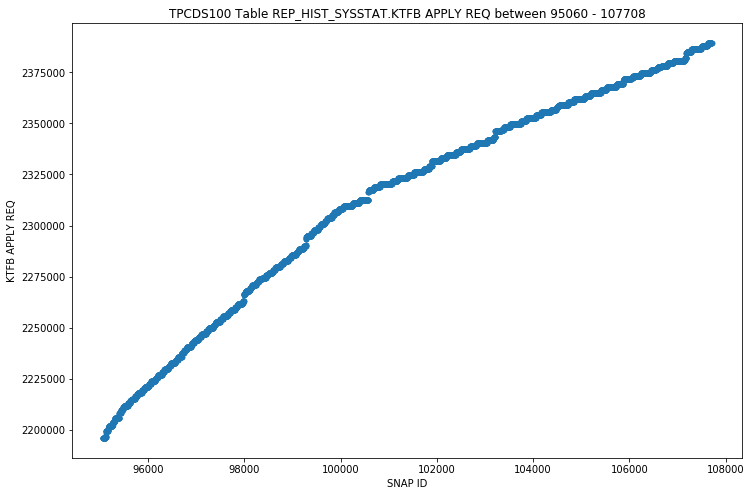

REP_HIST_SYSSTAT - KTFB APPLY TIME (MS) - STRIPPED SCATTER


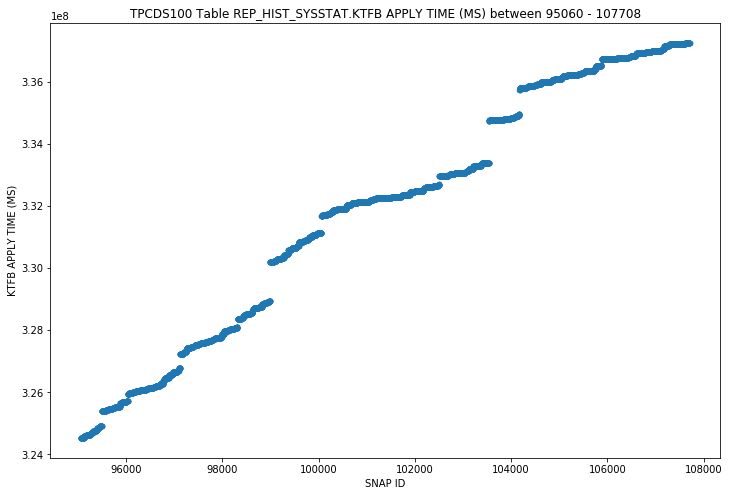

REP_HIST_SYSSTAT - KTFB COMMIT REQ - STRIPPED SCATTER


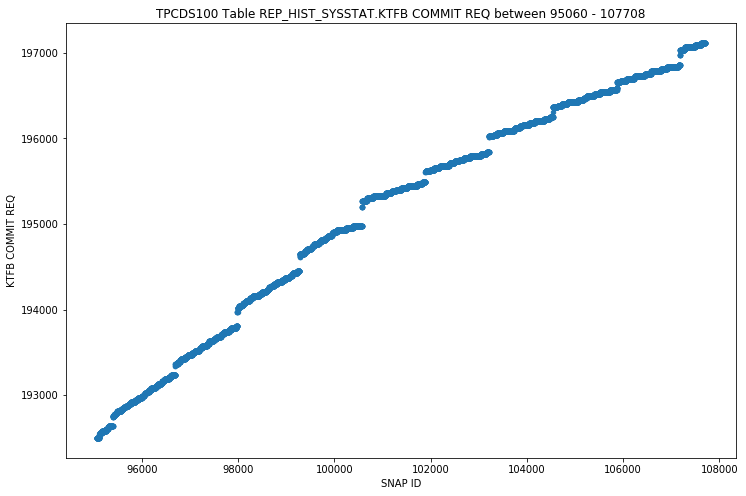

REP_HIST_SYSSTAT - KTFB COMMIT TIME (MS) - STRIPPED SCATTER


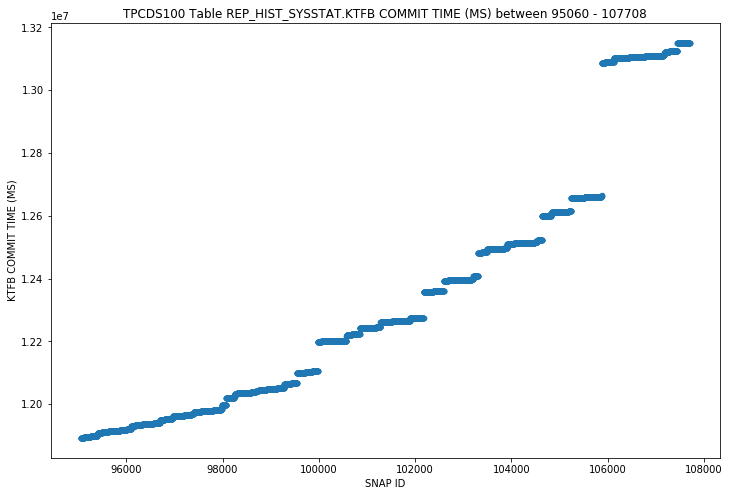

REP_HIST_SYSSTAT - KTFB FREE REQ - STRIPPED SCATTER


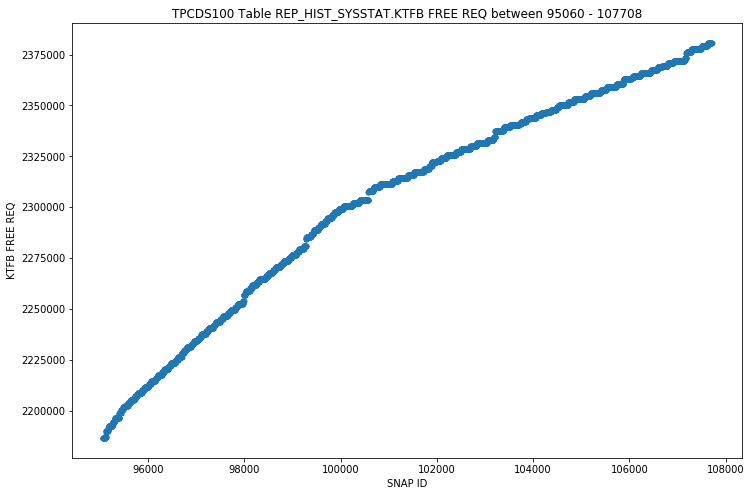

REP_HIST_SYSSTAT - KTFB FREE SPACE (BLOCK) - STRIPPED SCATTER


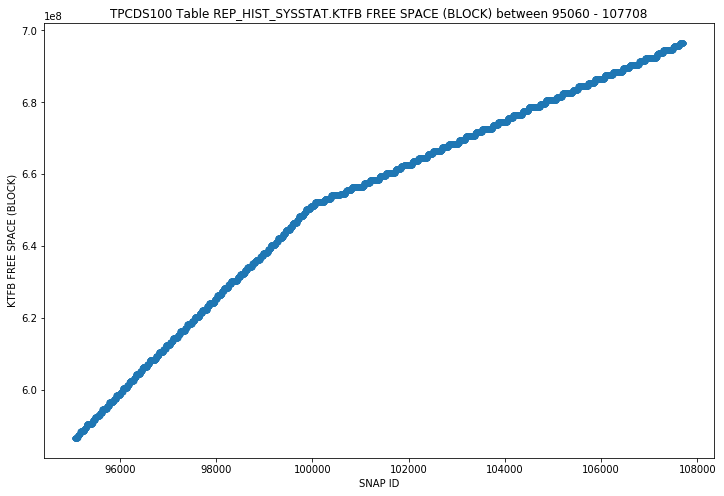

REP_HIST_SYSSTAT - KTFB FREE TIME (MS) - STRIPPED SCATTER


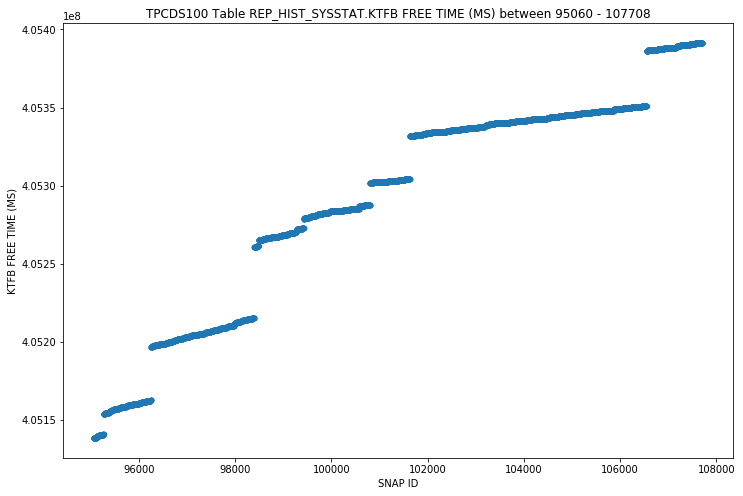

REP_HIST_SYSSTAT - LOB TABLE ID LOOKUP CACHE MISSES - STRIPPED SCATTER


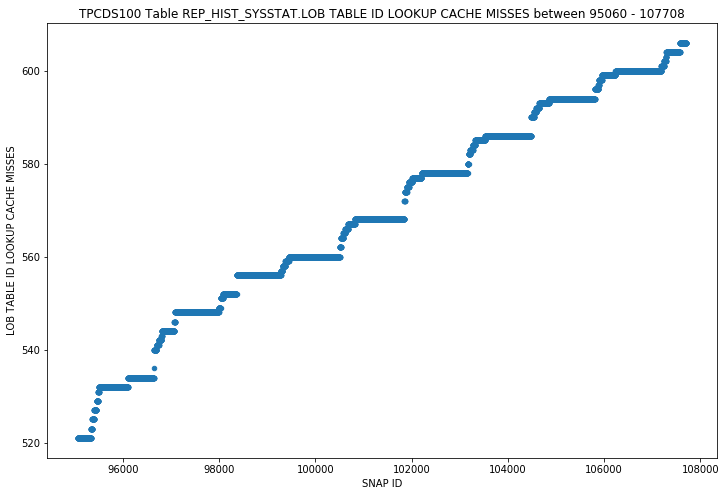

REP_HIST_SYSSTAT - NUMBER OF READ IOS ISSUED - STRIPPED SCATTER


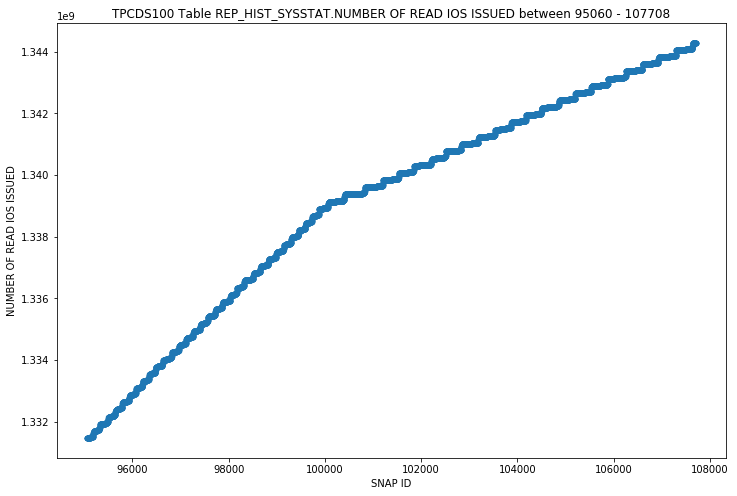

REP_HIST_SYSSTAT - PX LOCAL MESSAGES RECV'D - STRIPPED SCATTER


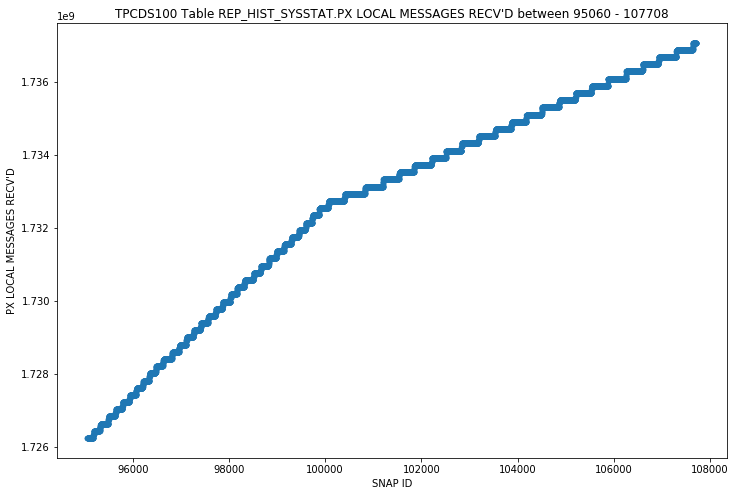

REP_HIST_SYSSTAT - PX LOCAL MESSAGES SENT - STRIPPED SCATTER


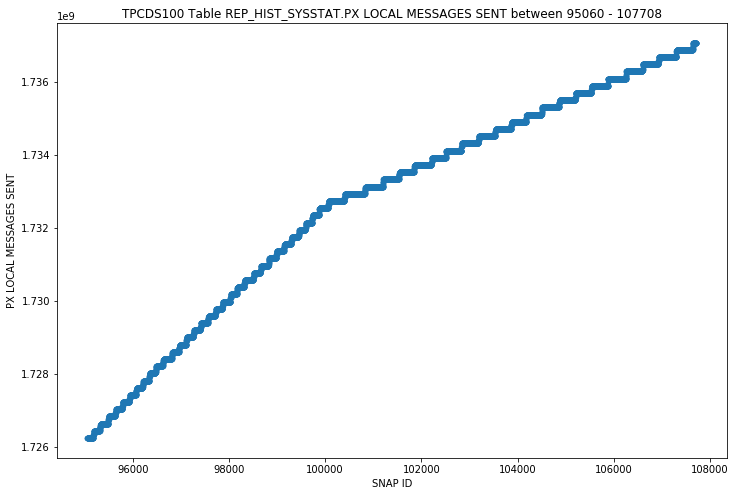

REP_HIST_SYSSTAT - PARALLEL OPERATIONS DOWNGRADED TO SERIAL - STRIPPED SCATTER


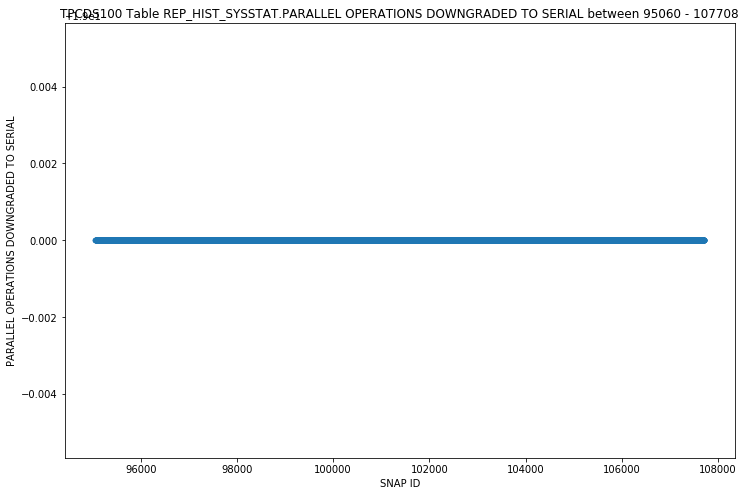

REP_HIST_SYSSTAT - PARALLEL OPERATIONS NOT DOWNGRADED - STRIPPED SCATTER


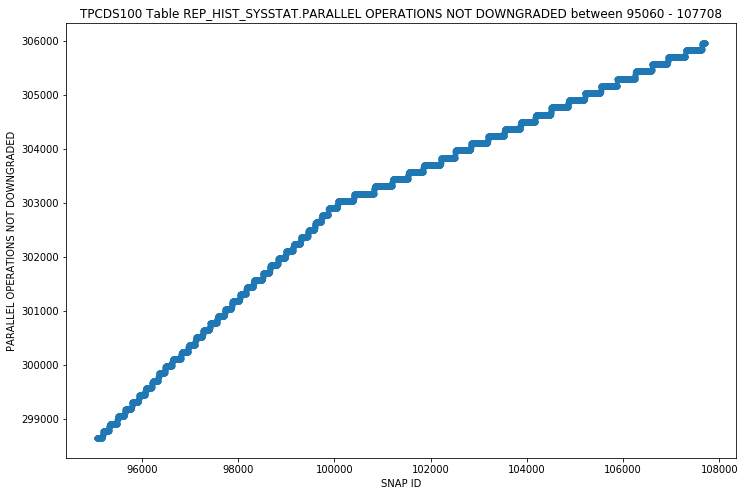

REP_HIST_SYSSTAT - REQUESTS TO/FROM CLIENT - STRIPPED SCATTER


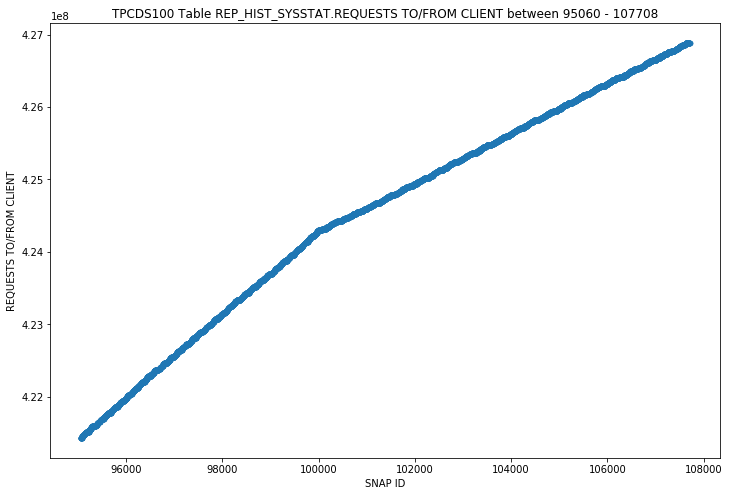

REP_HIST_SYSSTAT - ROWCR ATTEMPTS - STRIPPED SCATTER


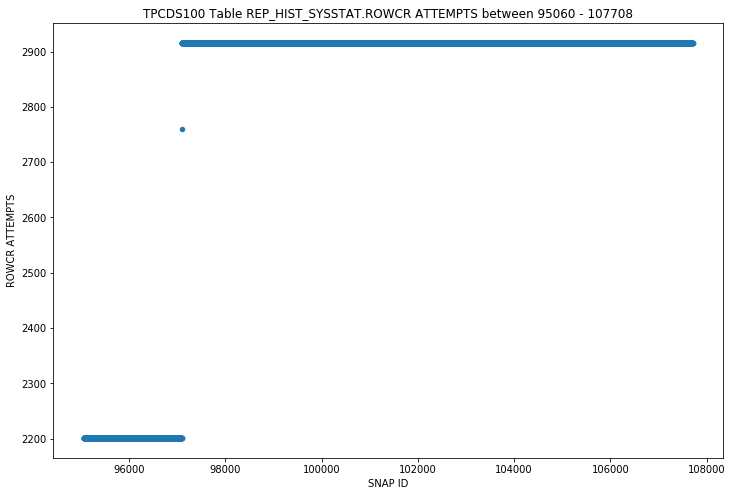

REP_HIST_SYSSTAT - ROWCR HITS - STRIPPED SCATTER


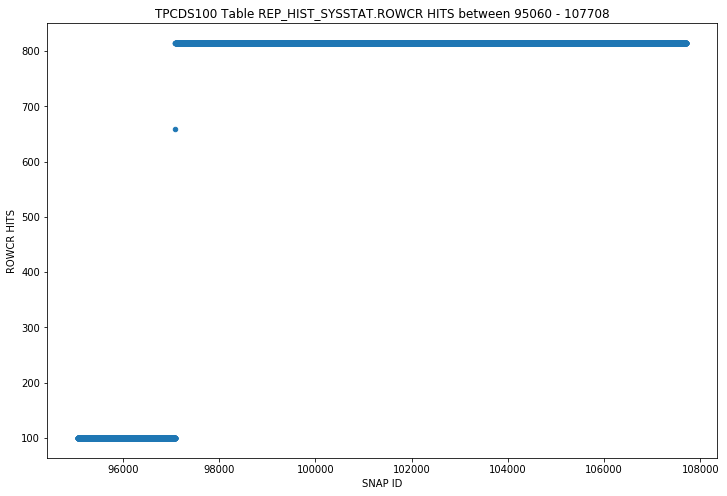

REP_HIST_SYSSTAT - SMON POSTED FOR UNDO SEGMENT SHRINK - STRIPPED SCATTER


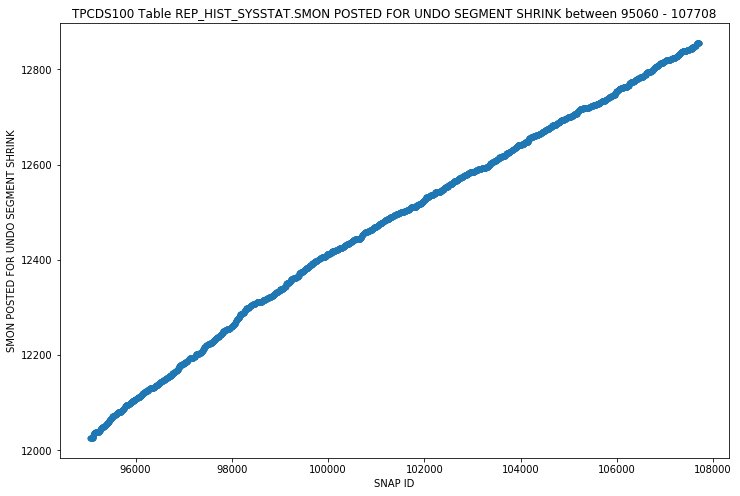

REP_HIST_SYSSTAT - SQL*NET ROUNDTRIPS TO/FROM CLIENT - STRIPPED SCATTER


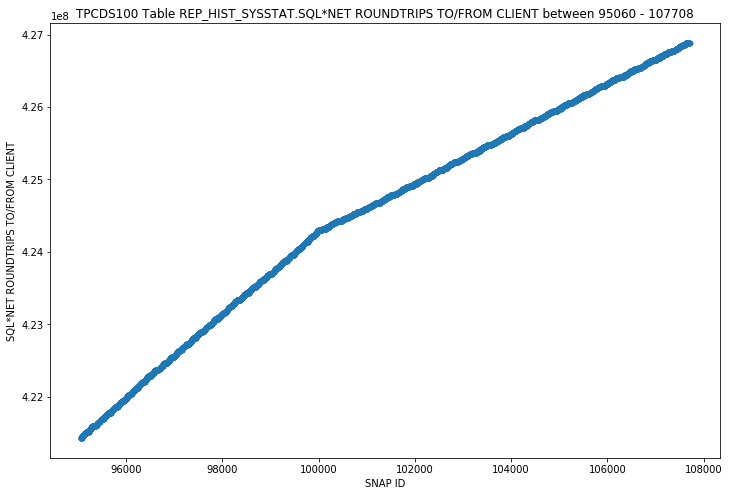

REP_HIST_SYSSTAT - TBS EXTENSION: BYTES EXTENDED - STRIPPED SCATTER


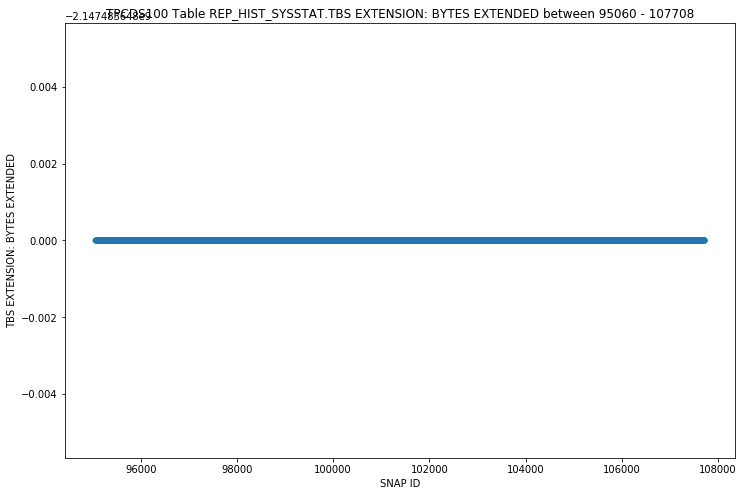

REP_HIST_SYSSTAT - TBS EXTENSION: FILES EXTENDED - STRIPPED SCATTER


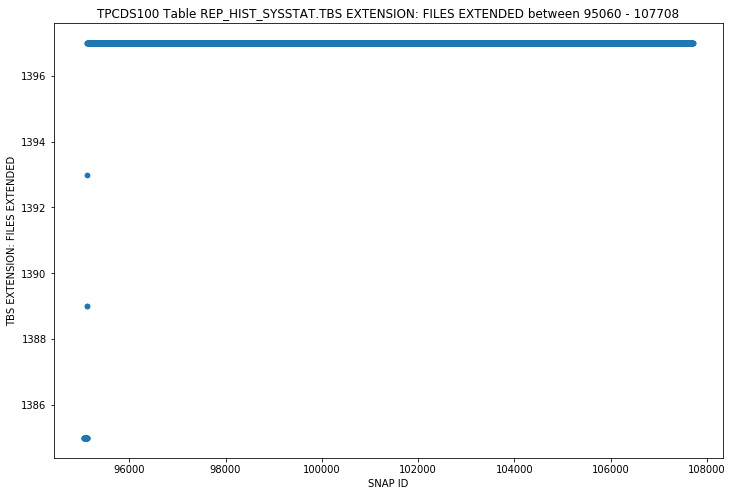

REP_HIST_SYSSTAT - TBS EXTENSION: TASKS CREATED - STRIPPED SCATTER


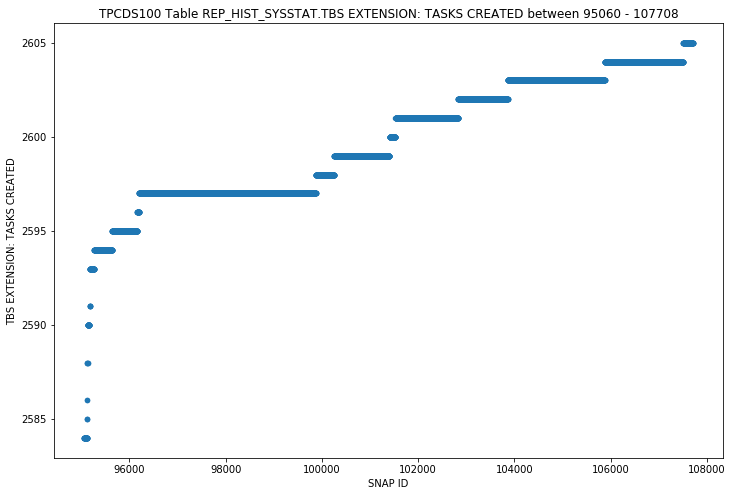

REP_HIST_SYSSTAT - TBS EXTENSION: TASKS EXECUTED - STRIPPED SCATTER


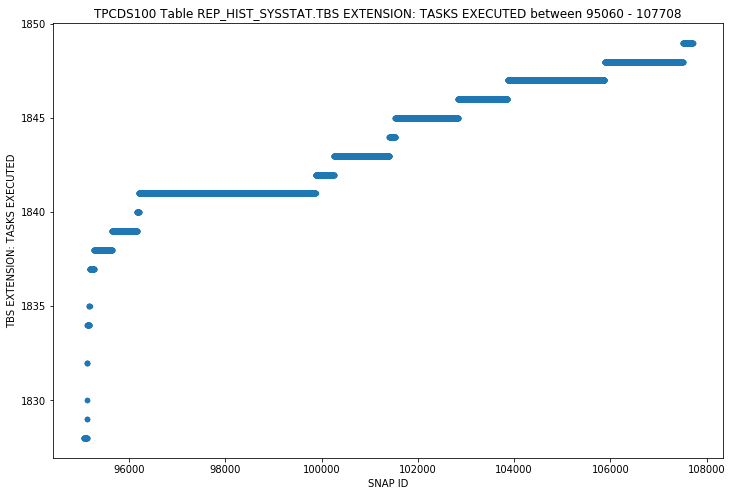

REP_HIST_SYSSTAT - ACTIVE TXN COUNT DURING CLEANOUT - STRIPPED SCATTER


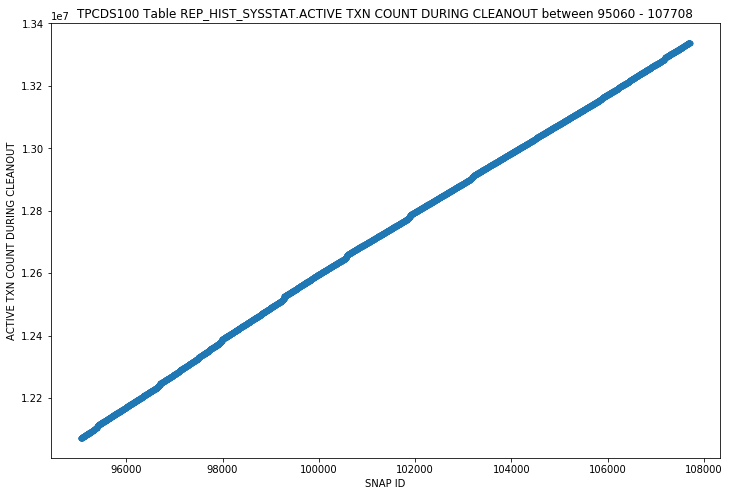

REP_HIST_SYSSTAT - APPLICATION WAIT TIME - STRIPPED SCATTER


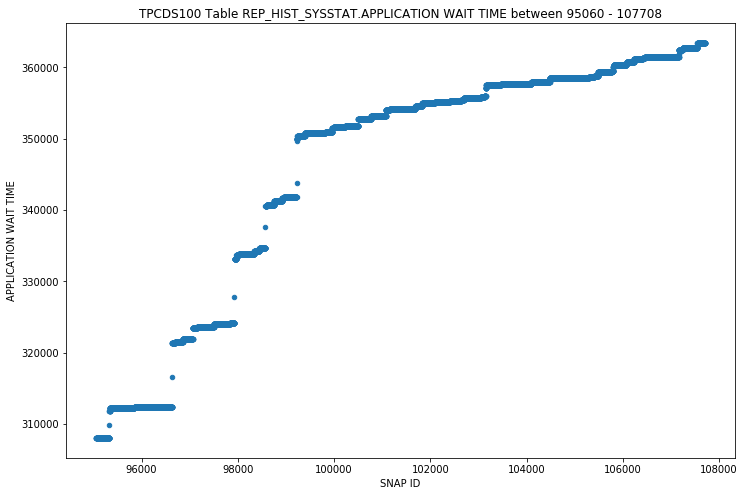

REP_HIST_SYSSTAT - BACKGROUND CHECKPOINTS COMPLETED - STRIPPED SCATTER


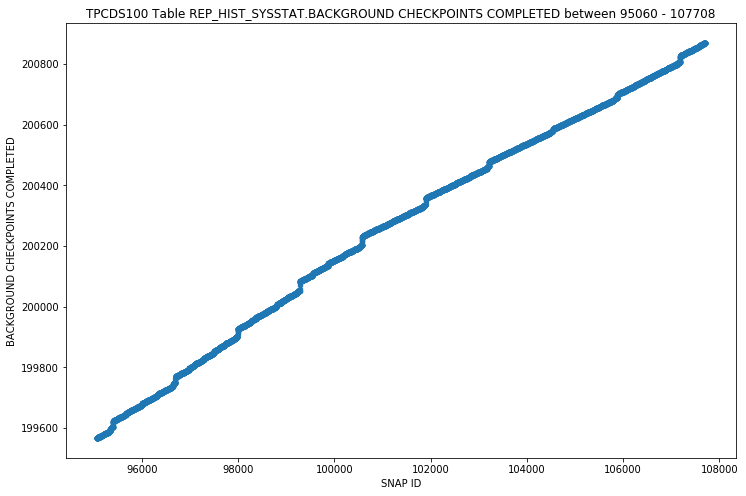

REP_HIST_SYSSTAT - BACKGROUND CHECKPOINTS STARTED - STRIPPED SCATTER


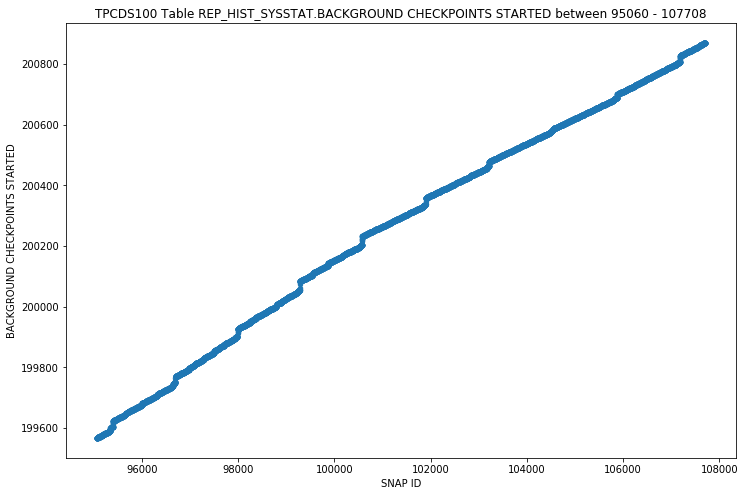

REP_HIST_SYSSTAT - BACKGROUND TIMEOUTS - STRIPPED SCATTER


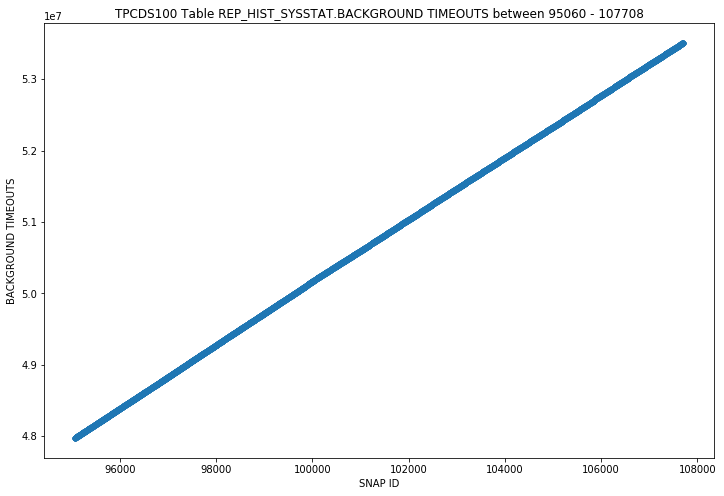

REP_HIST_SYSSTAT - BRANCH NODE SPLITS - STRIPPED SCATTER


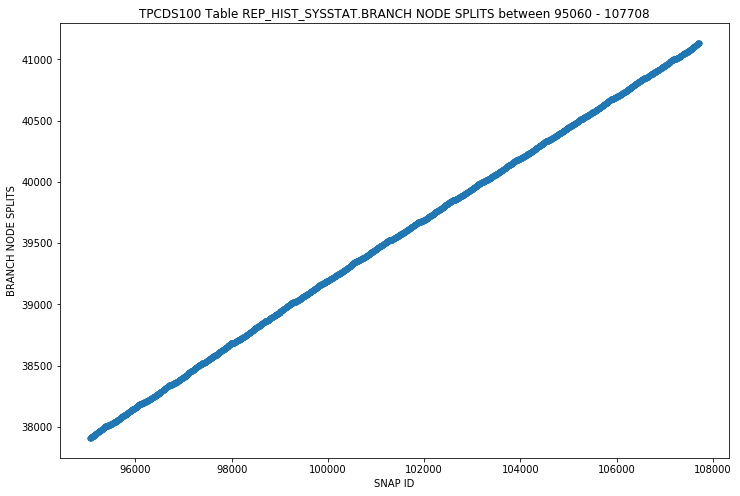

REP_HIST_SYSSTAT - BUFFER IS NOT PINNED COUNT - STRIPPED SCATTER


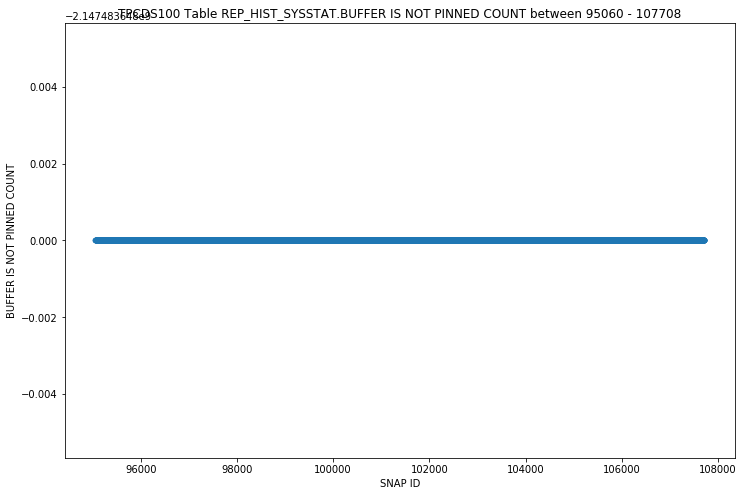

REP_HIST_SYSSTAT - BUFFER IS PINNED COUNT - STRIPPED SCATTER


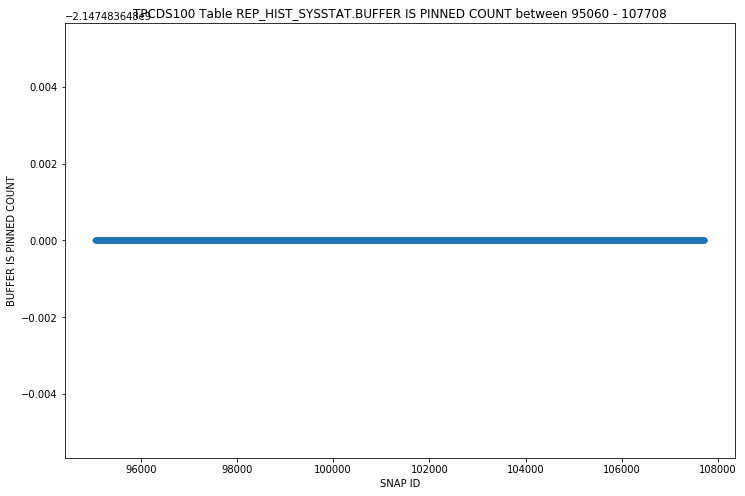

REP_HIST_SYSSTAT - BYTES RECEIVED VIA SQL*NET FROM CLIENT - STRIPPED SCATTER


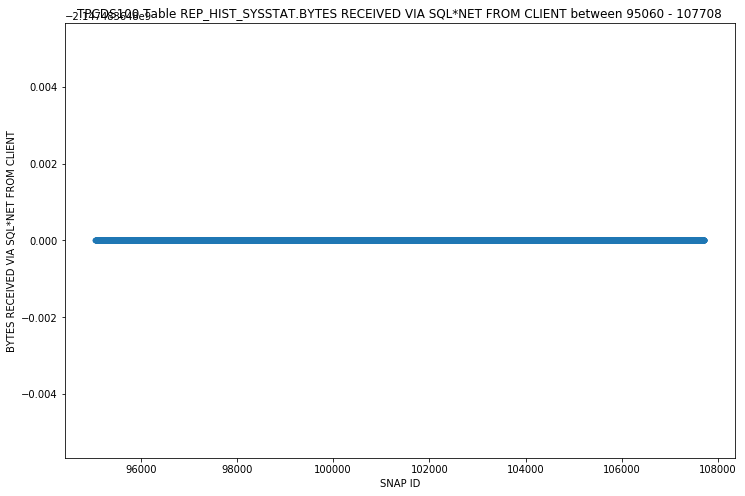

REP_HIST_SYSSTAT - BYTES SENT VIA SQL*NET TO CLIENT - STRIPPED SCATTER


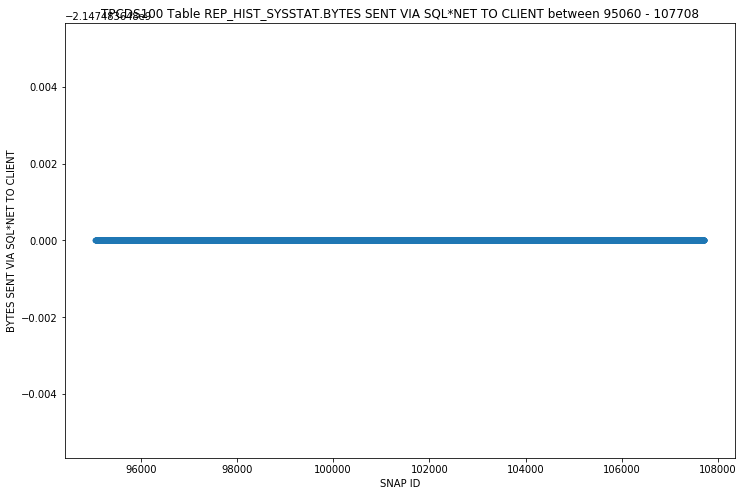

REP_HIST_SYSSTAT - BYTES VIA SQL*NET VECTOR TO CLIENT - STRIPPED SCATTER


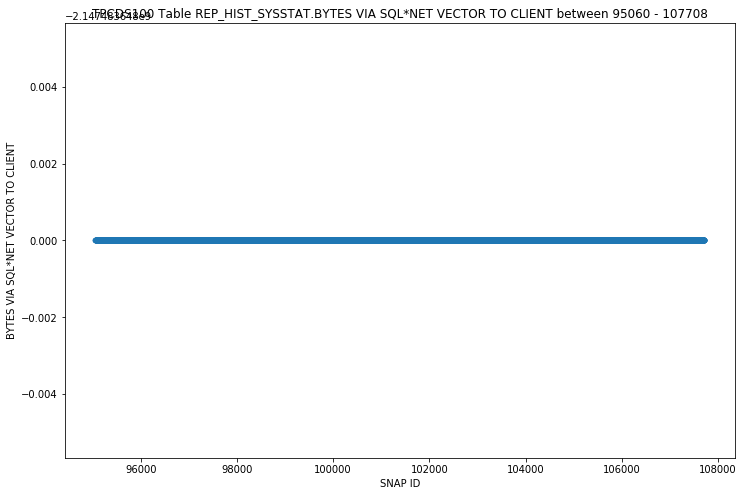

REP_HIST_SYSSTAT - CALLS TO GET SNAPSHOT SCN: KCMGSS - STRIPPED SCATTER


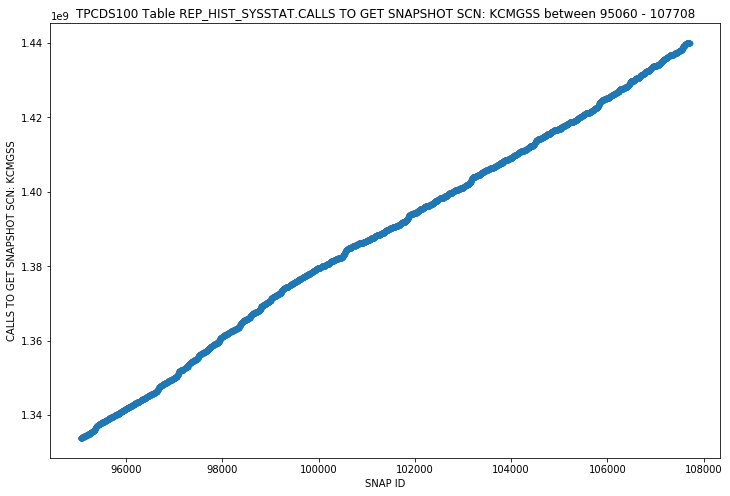

REP_HIST_SYSSTAT - CALLS TO KCMGAS - STRIPPED SCATTER


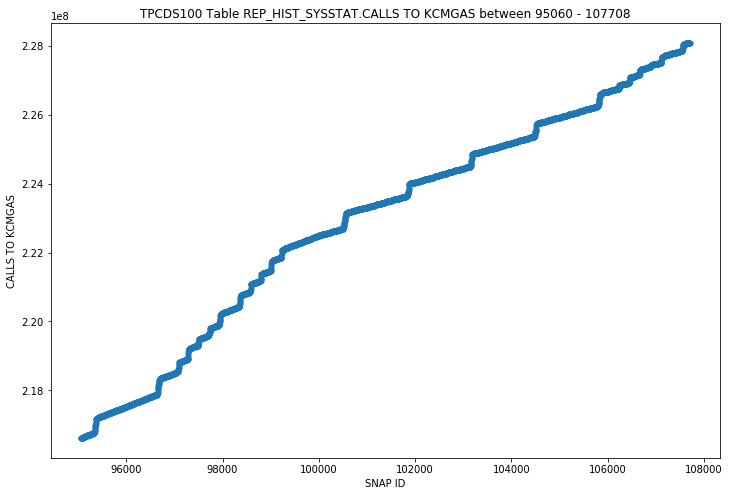

REP_HIST_SYSSTAT - CALLS TO KCMGCS - STRIPPED SCATTER


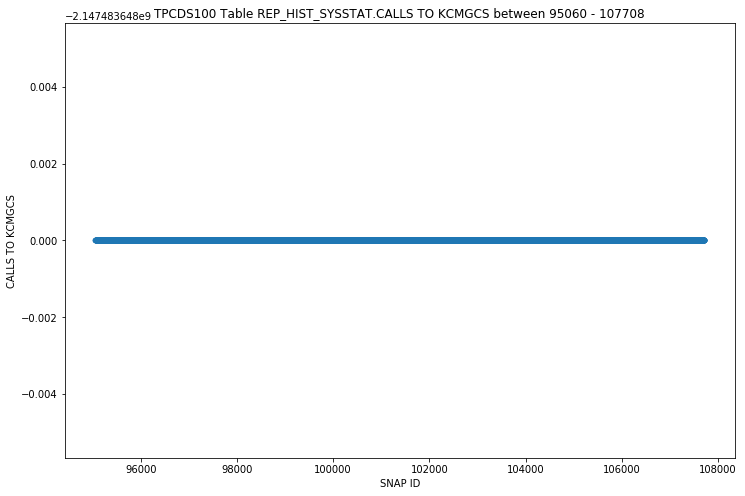

REP_HIST_SYSSTAT - CELL PHYSICAL IO INTERCONNECT BYTES - STRIPPED SCATTER


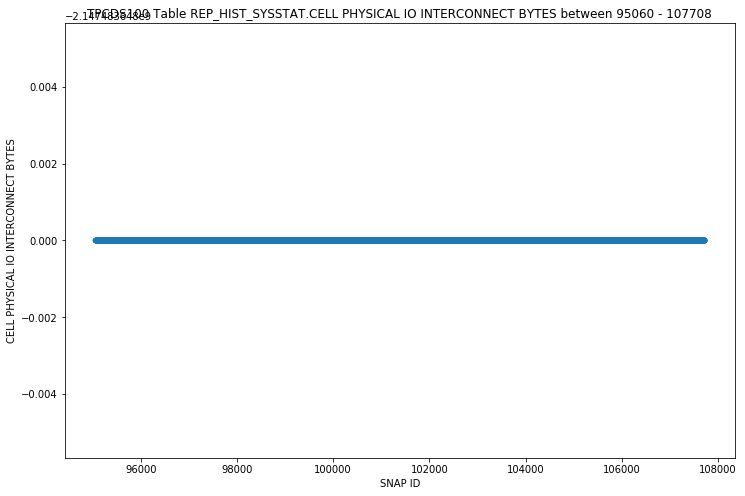

REP_HIST_SYSSTAT - CHANGE WRITE TIME - STRIPPED SCATTER


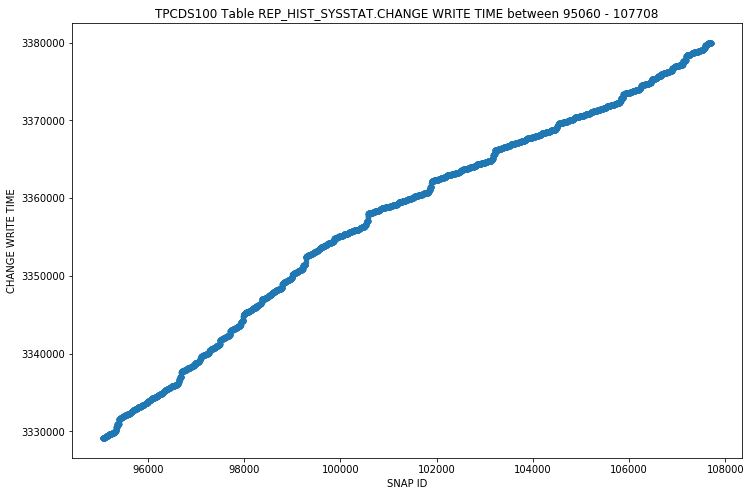

REP_HIST_SYSSTAT - CLEANOUT - NUMBER OF KTUGCT CALLS - STRIPPED SCATTER


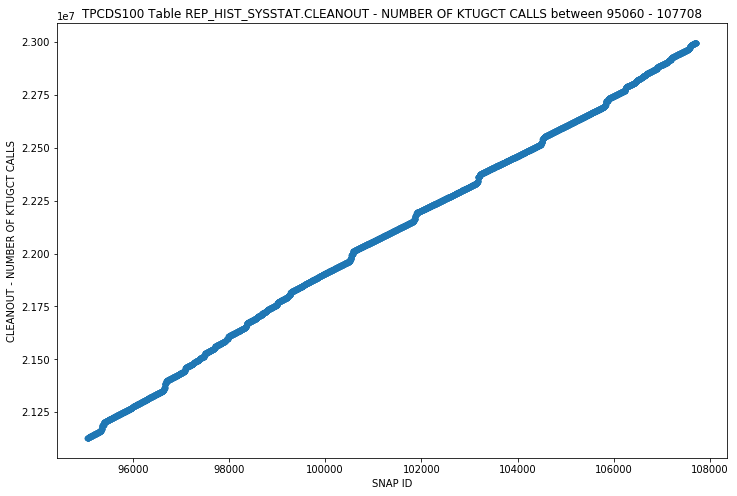

REP_HIST_SYSSTAT - CLEANOUTS AND ROLLBACKS - CONSISTENT READ GETS - STRIPPED SCATTER


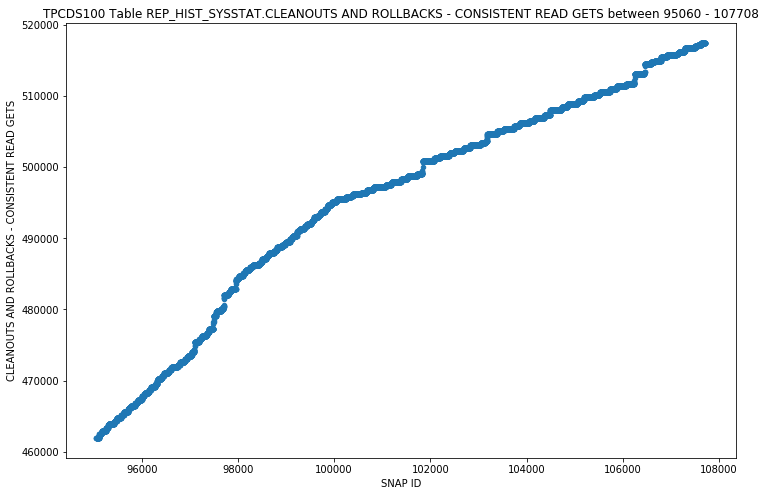

REP_HIST_SYSSTAT - CLEANOUTS ONLY - CONSISTENT READ GETS - STRIPPED SCATTER


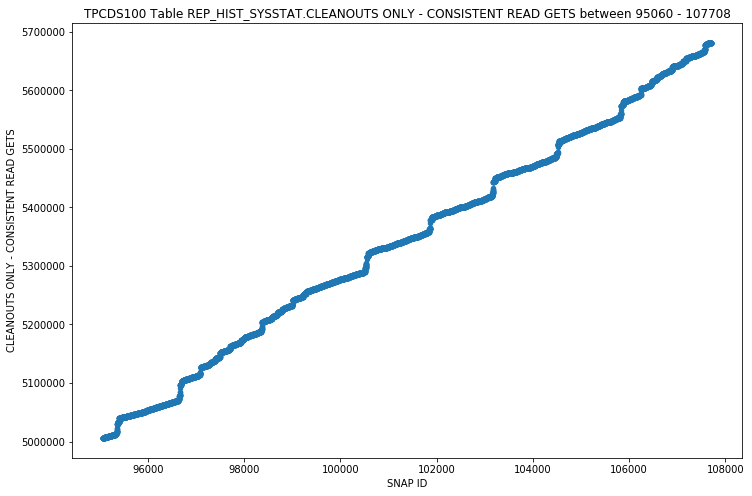

REP_HIST_SYSSTAT - CLUSTER KEY SCAN BLOCK GETS - STRIPPED SCATTER


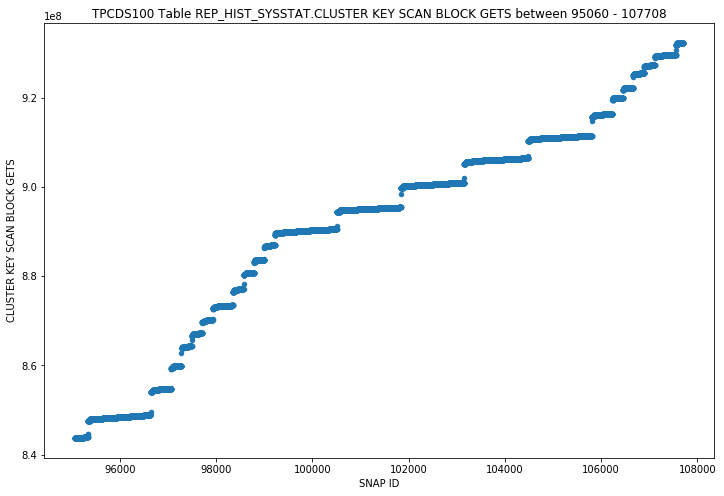

REP_HIST_SYSSTAT - CLUSTER KEY SCANS - STRIPPED SCATTER


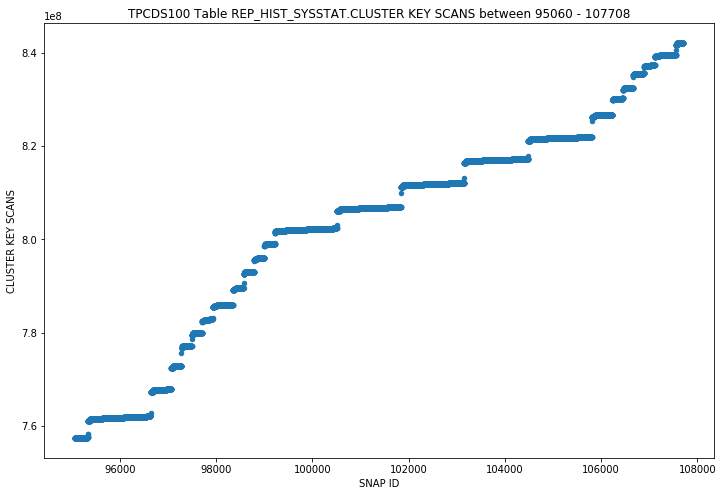

REP_HIST_SYSSTAT - COMMIT BATCH/IMMEDIATE PERFORMED - STRIPPED SCATTER


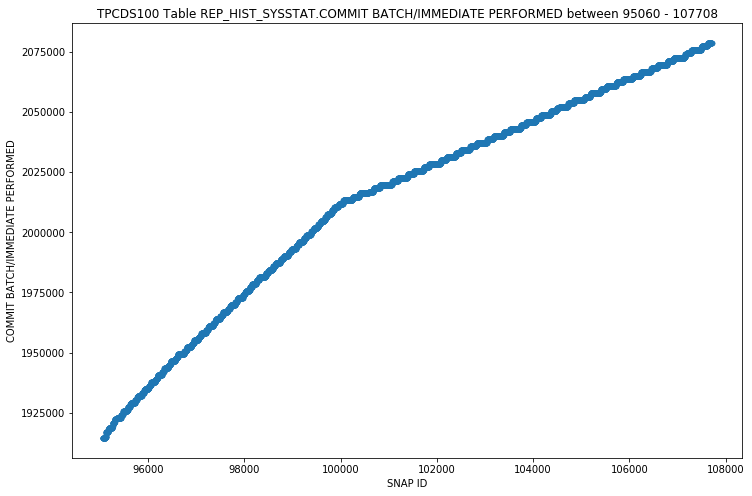

REP_HIST_SYSSTAT - COMMIT BATCH/IMMEDIATE REQUESTED - STRIPPED SCATTER


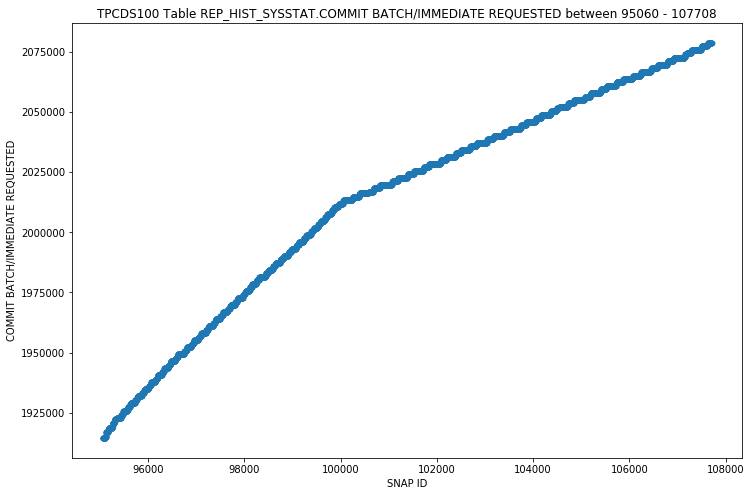

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: BLOCK LOST - STRIPPED SCATTER


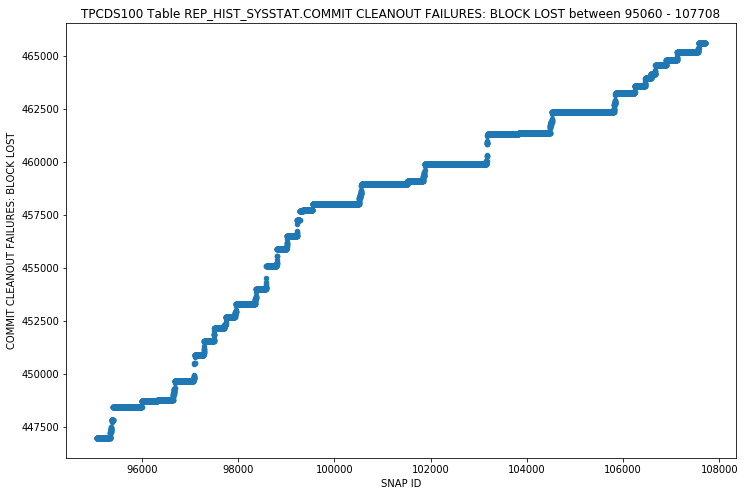

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: BUFFER BEING WRITTEN - STRIPPED SCATTER


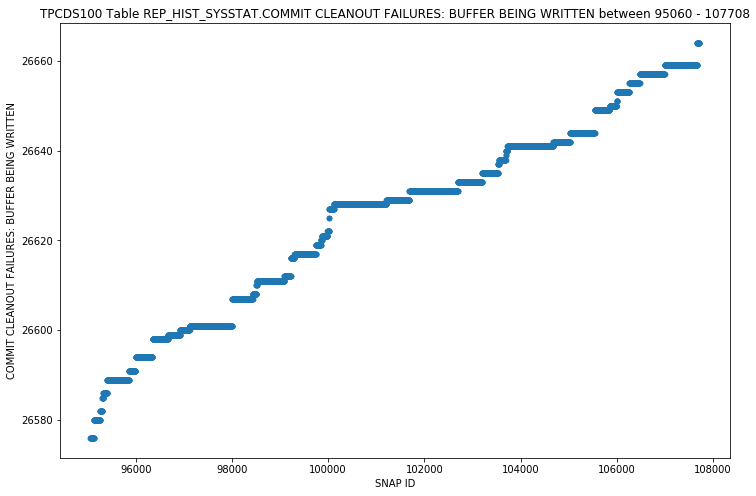

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: CALLBACK FAILURE  - STRIPPED SCATTER


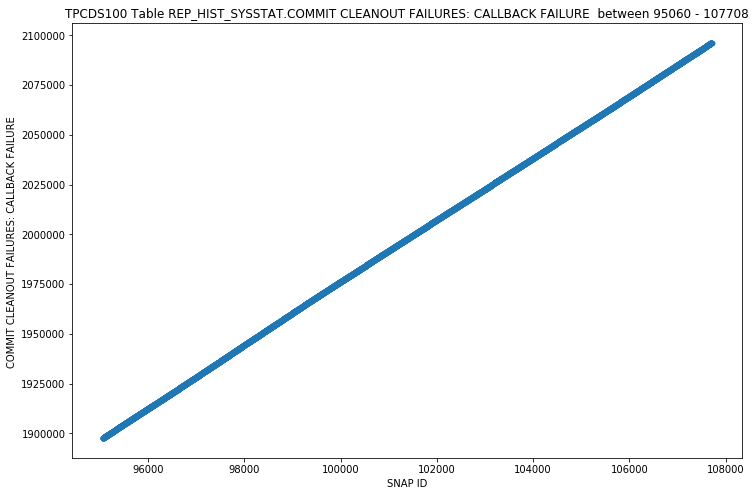

REP_HIST_SYSSTAT - COMMIT CLEANOUT FAILURES: CANNOT PIN - STRIPPED SCATTER


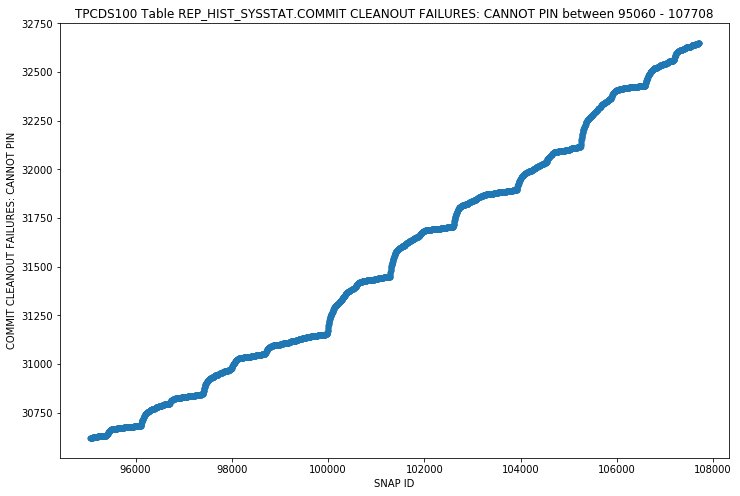

REP_HIST_SYSSTAT - COMMIT CLEANOUTS - STRIPPED SCATTER


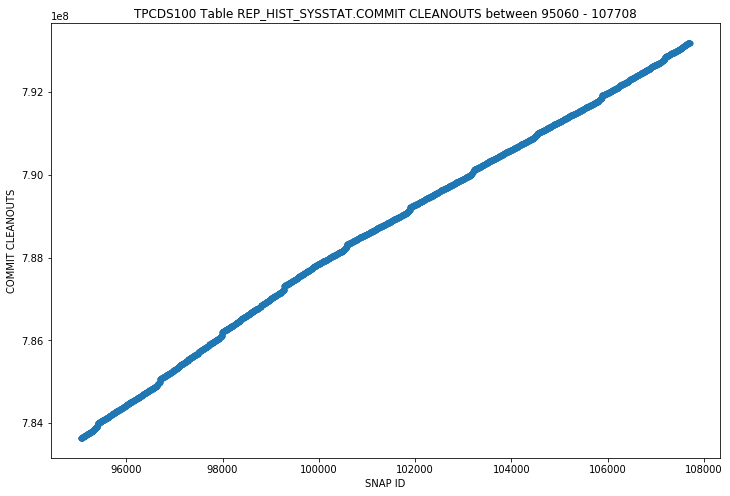

REP_HIST_SYSSTAT - COMMIT CLEANOUTS SUCCESSFULLY COMPLETED - STRIPPED SCATTER


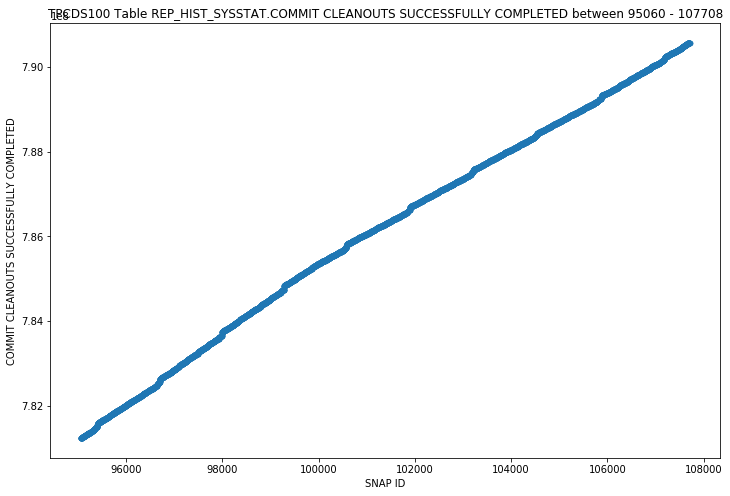

REP_HIST_SYSSTAT - COMMIT IMMEDIATE PERFORMED - STRIPPED SCATTER


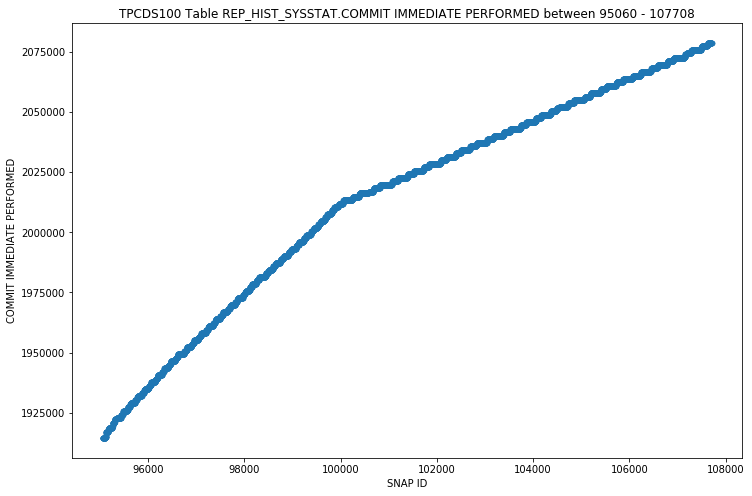

REP_HIST_SYSSTAT - COMMIT IMMEDIATE REQUESTED - STRIPPED SCATTER


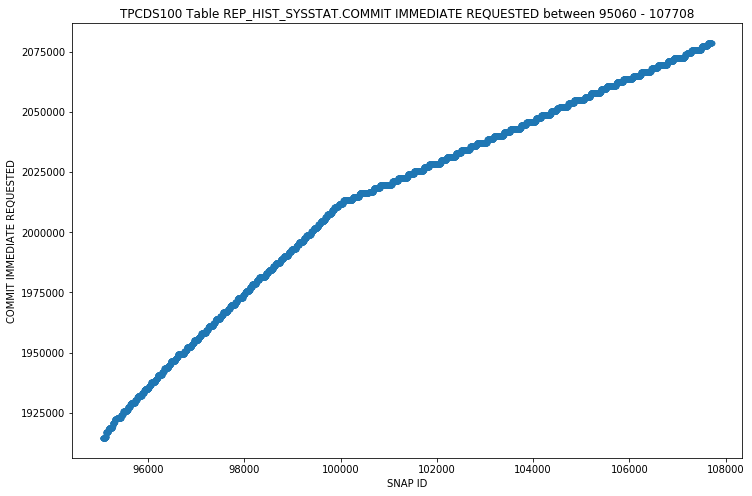

REP_HIST_SYSSTAT - COMMIT TXN COUNT DURING CLEANOUT - STRIPPED SCATTER


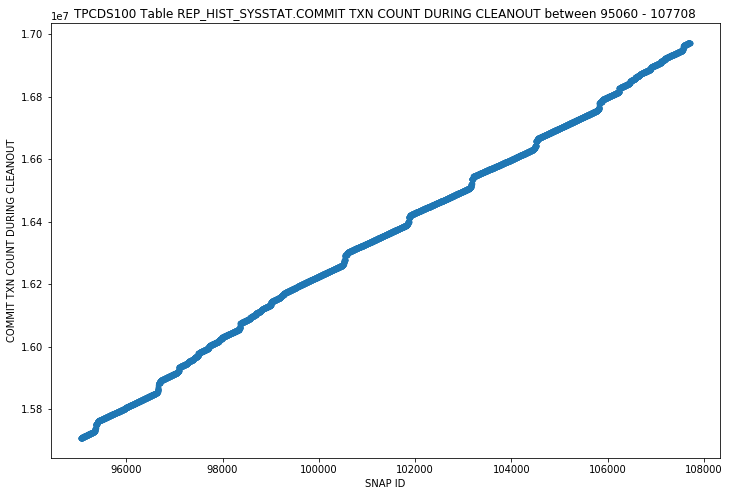

REP_HIST_SYSSTAT - CONCURRENCY WAIT TIME - STRIPPED SCATTER


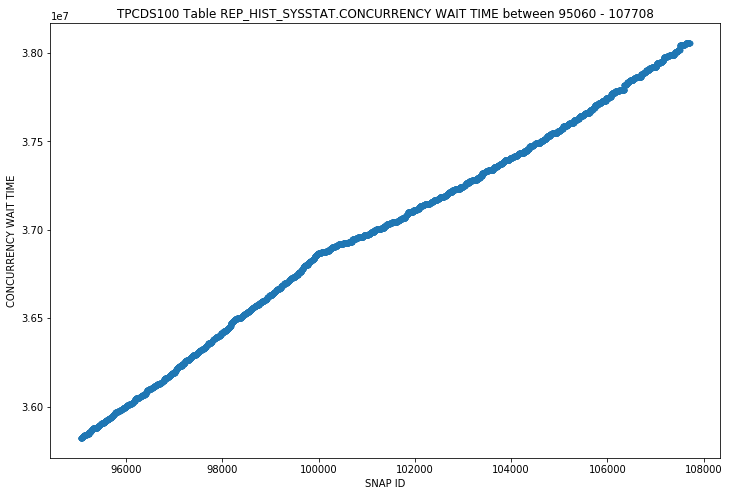

REP_HIST_SYSSTAT - CONSISTENT CHANGES - STRIPPED SCATTER


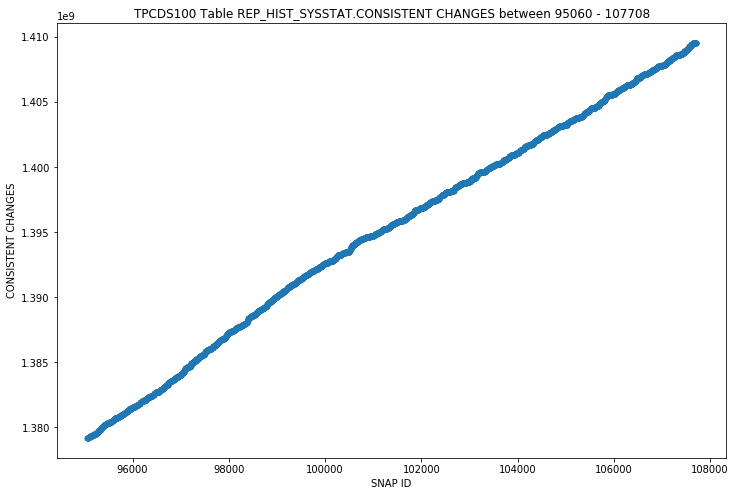

REP_HIST_SYSSTAT - CONSISTENT GETS - STRIPPED SCATTER


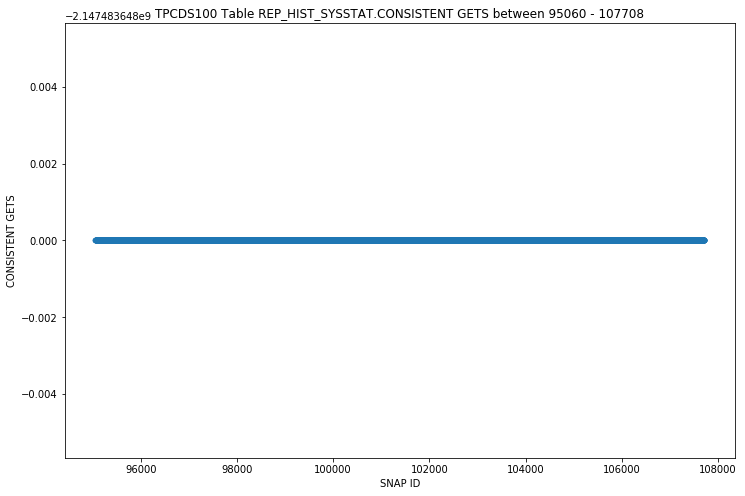

REP_HIST_SYSSTAT - CONSISTENT GETS DIRECT - STRIPPED SCATTER


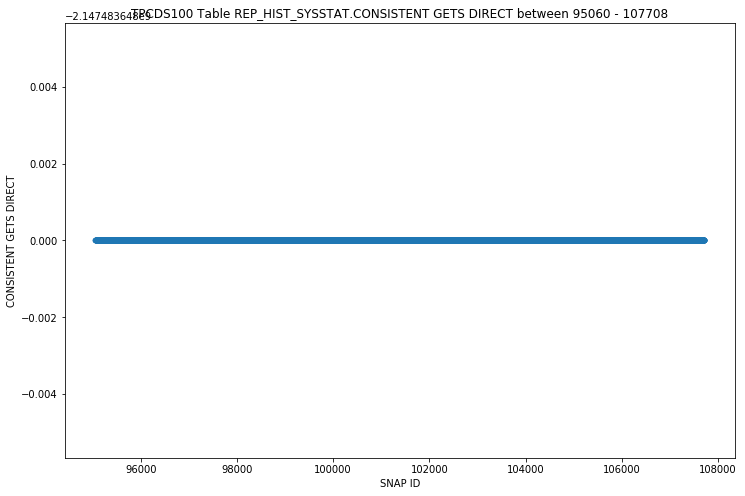

REP_HIST_SYSSTAT - CONSISTENT GETS EXAMINATION - STRIPPED SCATTER


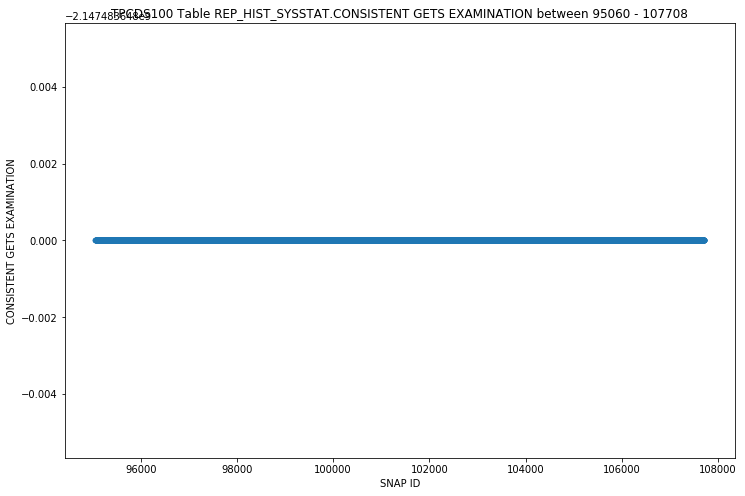

REP_HIST_SYSSTAT - CONSISTENT GETS EXAMINATION (FASTPATH) - STRIPPED SCATTER


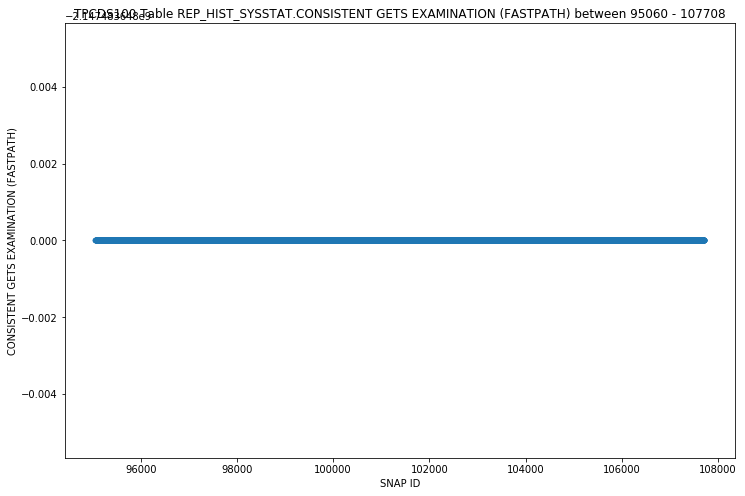

REP_HIST_SYSSTAT - CONSISTENT GETS FROM CACHE - STRIPPED SCATTER


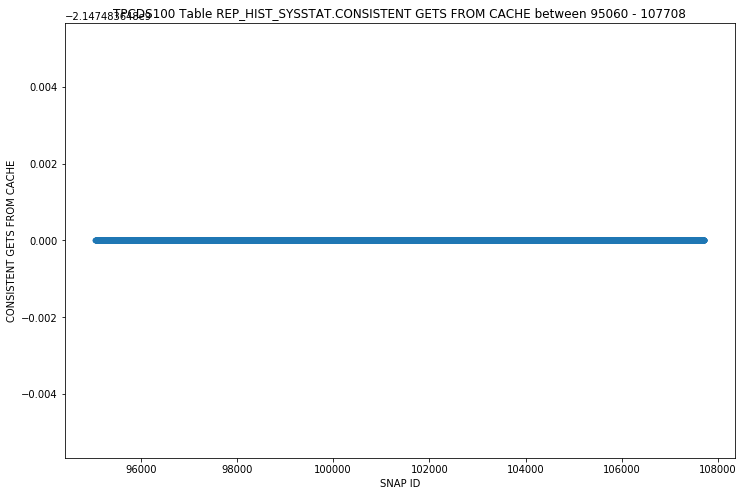

REP_HIST_SYSSTAT - CONSISTENT GETS PIN - STRIPPED SCATTER


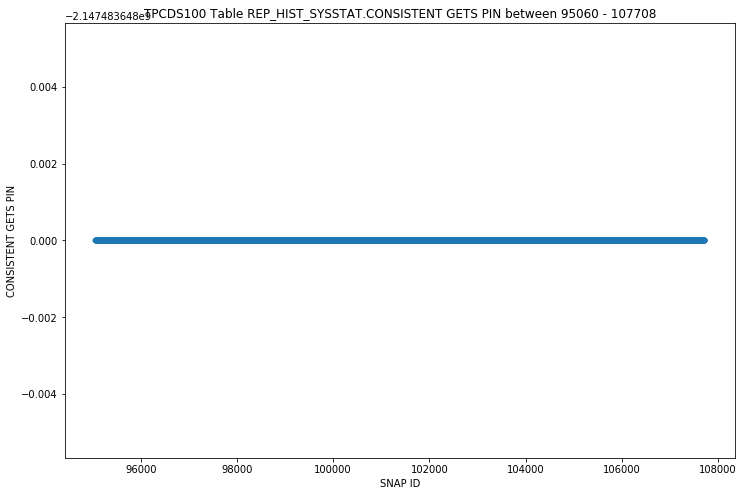

REP_HIST_SYSSTAT - CONSISTENT GETS PIN (FASTPATH) - STRIPPED SCATTER


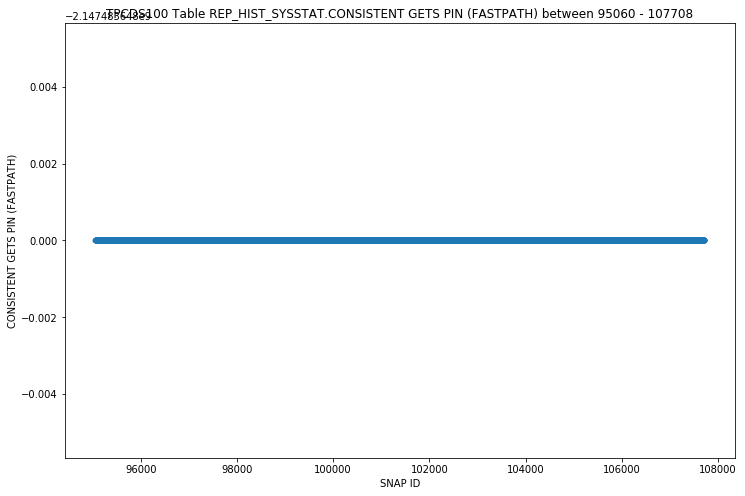

REP_HIST_SYSSTAT - CURSOR AUTHENTICATIONS - STRIPPED SCATTER


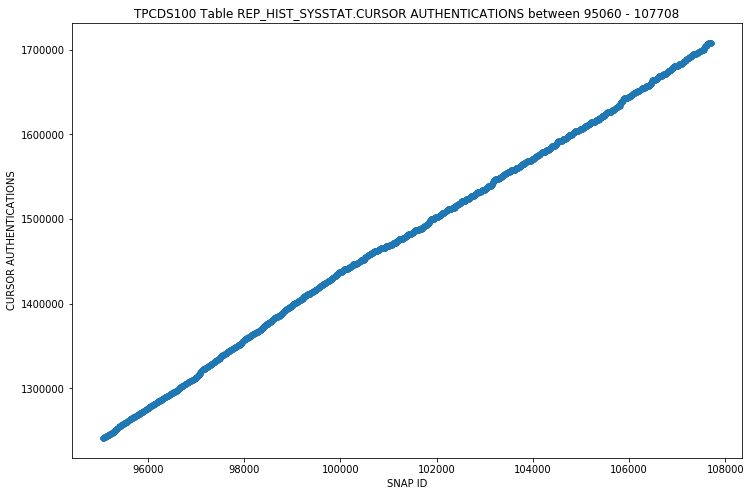

REP_HIST_SYSSTAT - CURSOR RELOAD FAILURES - STRIPPED SCATTER


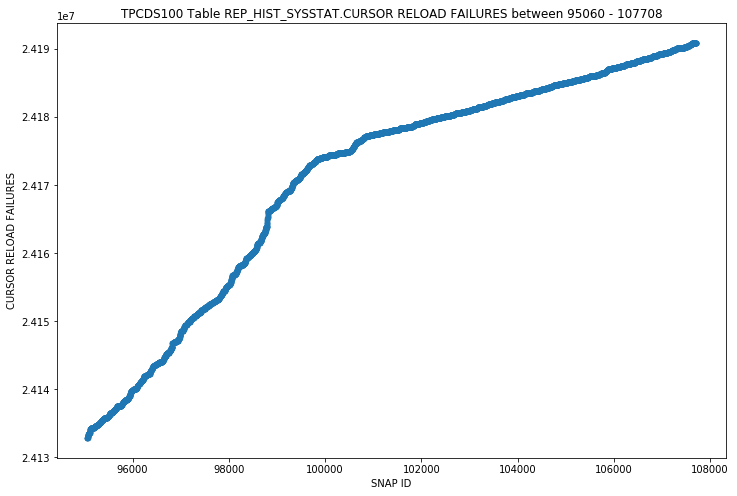

REP_HIST_SYSSTAT - DATA BLOCKS CONSISTENT READS - UNDO RECORDS APPLIED - STRIPPED SCATTER


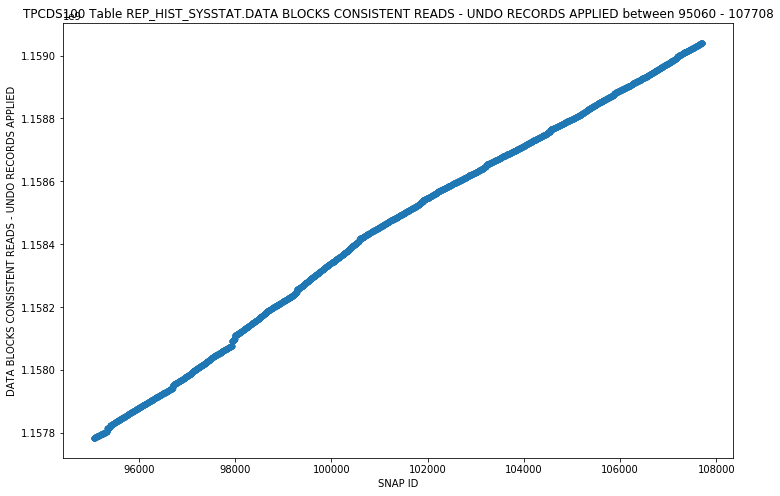

REP_HIST_SYSSTAT - DB BLOCK CHANGES - STRIPPED SCATTER


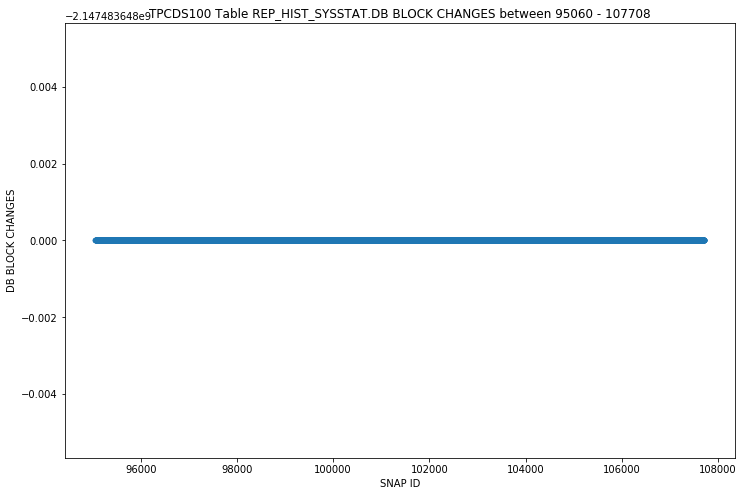

REP_HIST_SYSSTAT - DB BLOCK GETS - STRIPPED SCATTER


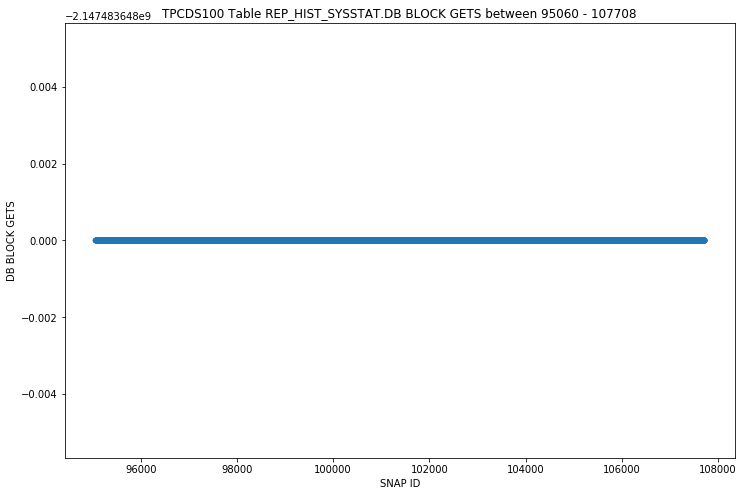

REP_HIST_SYSSTAT - DB BLOCK GETS DIRECT - STRIPPED SCATTER


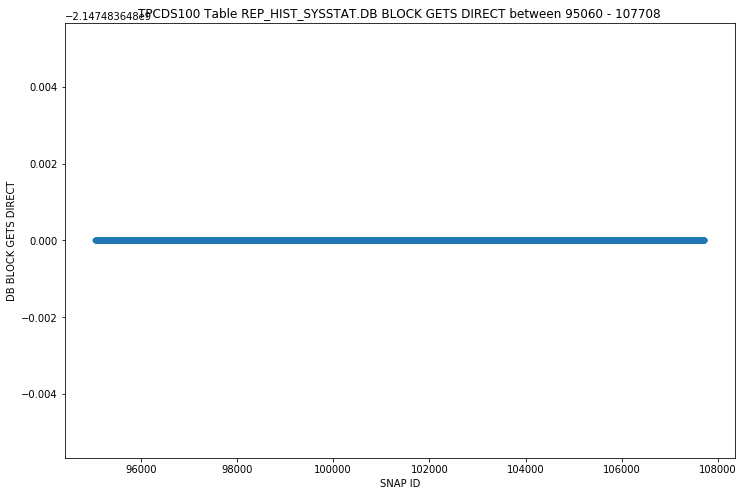

REP_HIST_SYSSTAT - DB BLOCK GETS FROM CACHE - STRIPPED SCATTER


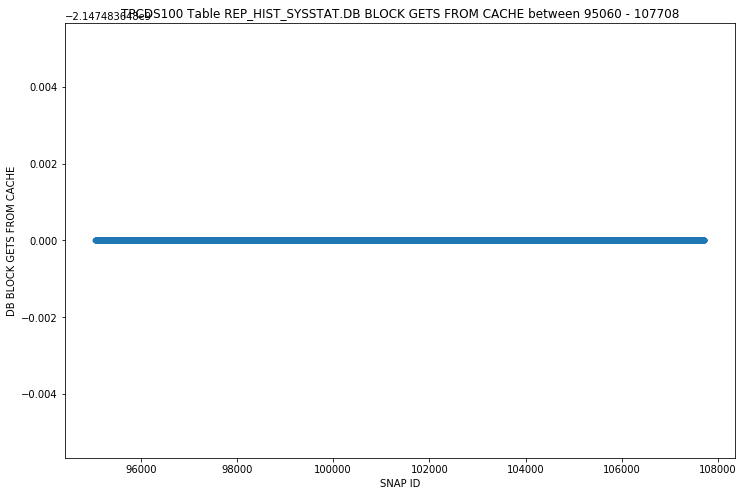

REP_HIST_SYSSTAT - DB BLOCK GETS FROM CACHE (FASTPATH) - STRIPPED SCATTER


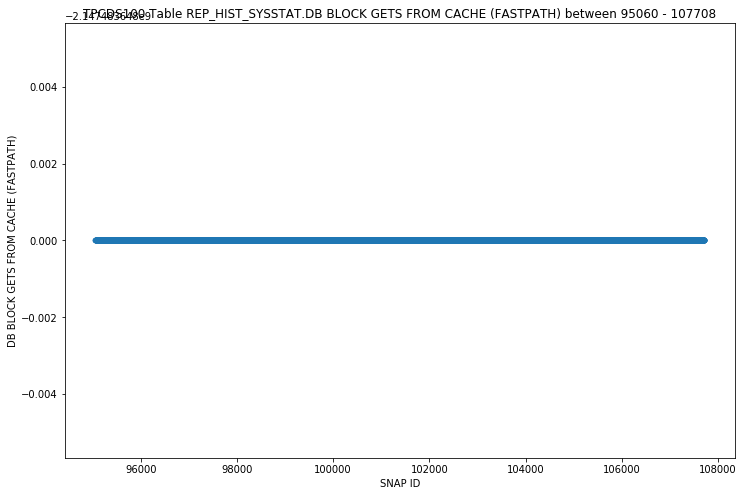

REP_HIST_SYSSTAT - DEFERRED (CURRENT) BLOCK CLEANOUT APPLICATIONS - STRIPPED SCATTER


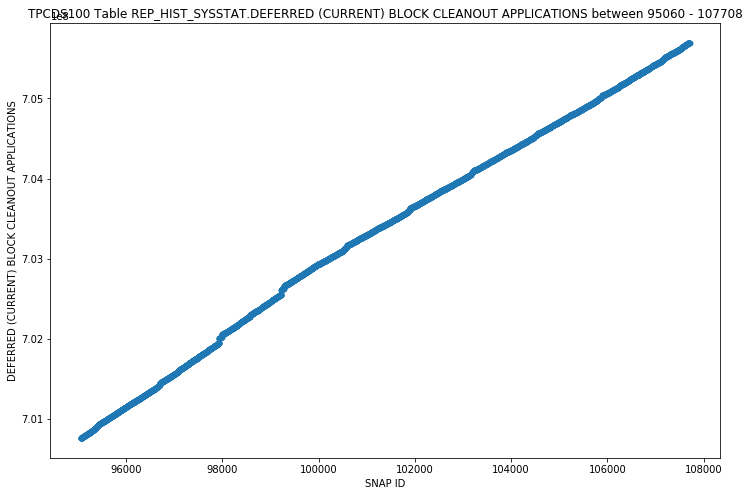

REP_HIST_SYSSTAT - DIRTY BUFFERS INSPECTED - STRIPPED SCATTER


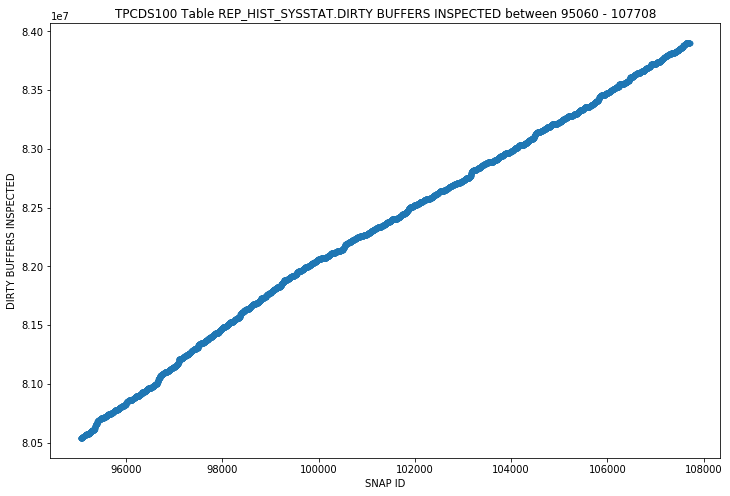

REP_HIST_SYSSTAT - ENQUEUE CONVERSIONS - STRIPPED SCATTER


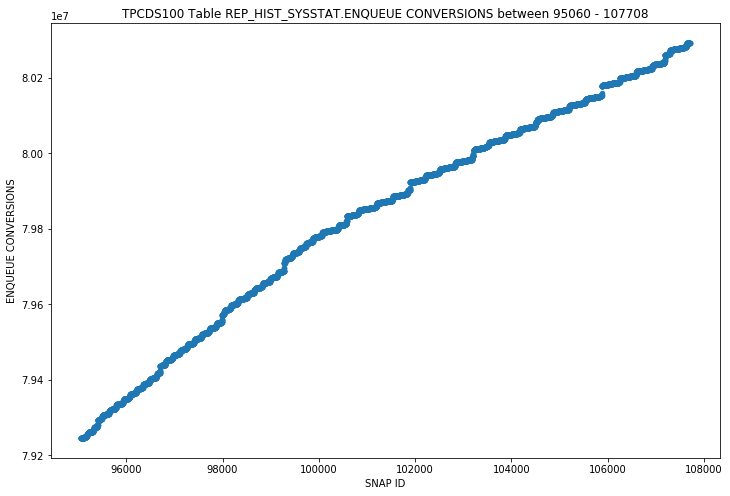

REP_HIST_SYSSTAT - ENQUEUE RELEASES - STRIPPED SCATTER


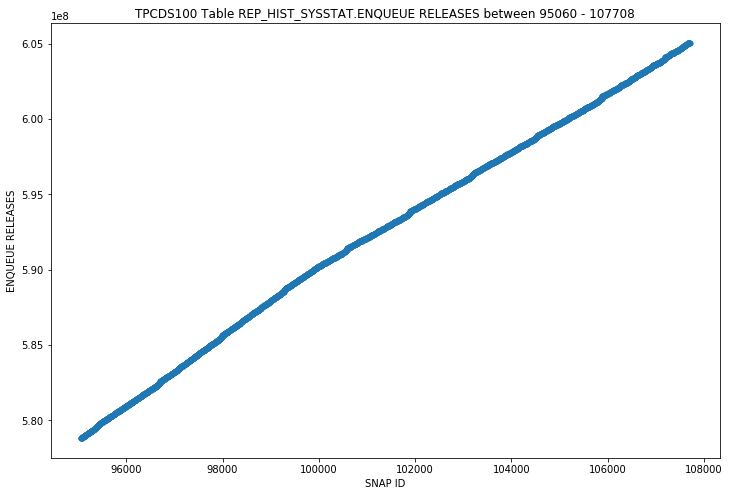

REP_HIST_SYSSTAT - ENQUEUE REQUESTS - STRIPPED SCATTER


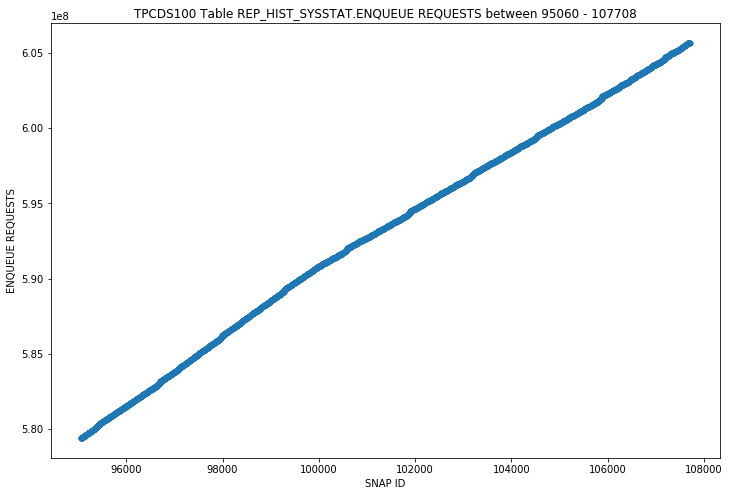

REP_HIST_SYSSTAT - ENQUEUE TIMEOUTS - STRIPPED SCATTER


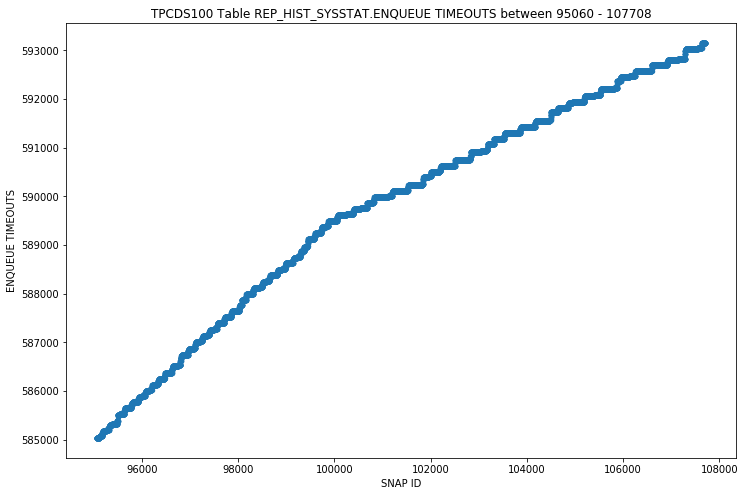

REP_HIST_SYSSTAT - ENQUEUE WAITS - STRIPPED SCATTER


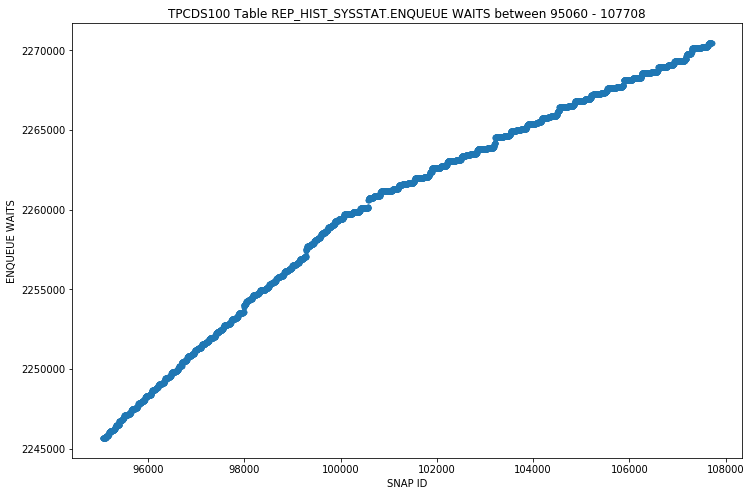

REP_HIST_SYSSTAT - EXCHANGE DEADLOCKS - STRIPPED SCATTER


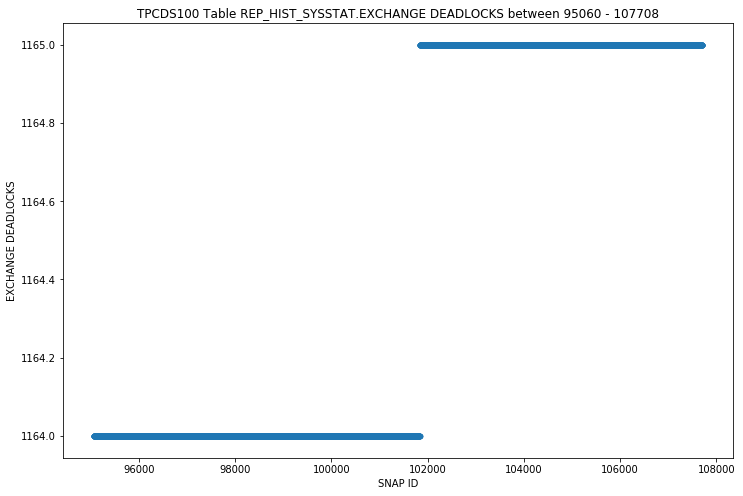

REP_HIST_SYSSTAT - EXECUTE COUNT - STRIPPED SCATTER


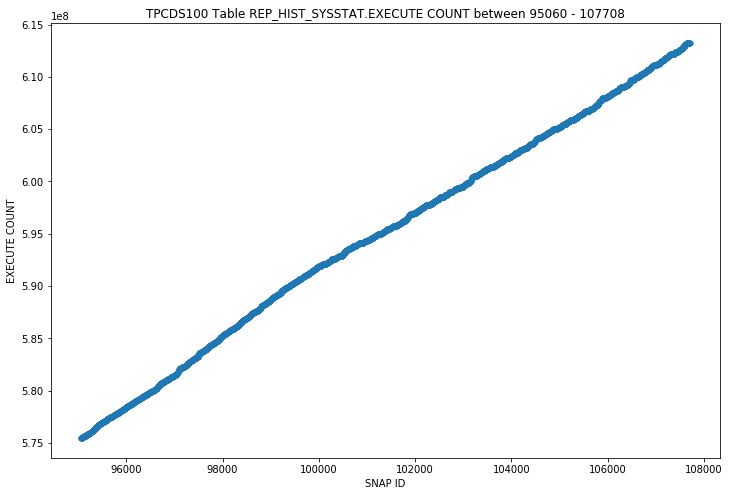

REP_HIST_SYSSTAT - FAILED PROBES ON INDEX BLOCK RECLAMATION - STRIPPED SCATTER


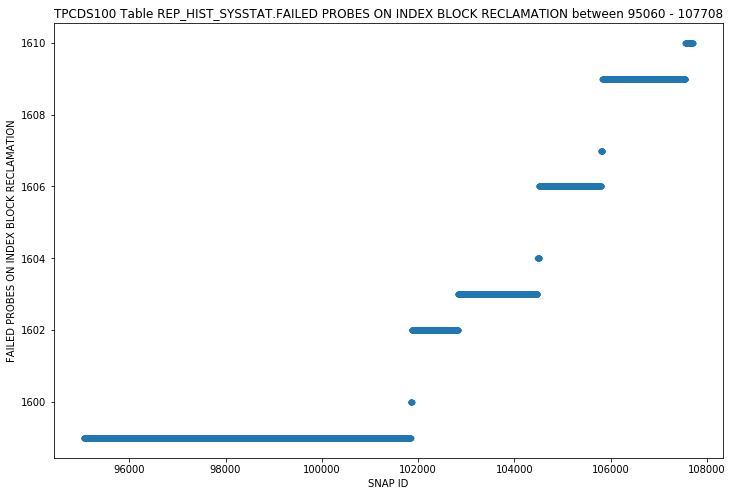

REP_HIST_SYSSTAT - FASTPATH CONSISTENT GET QUOTA LIMIT - STRIPPED SCATTER


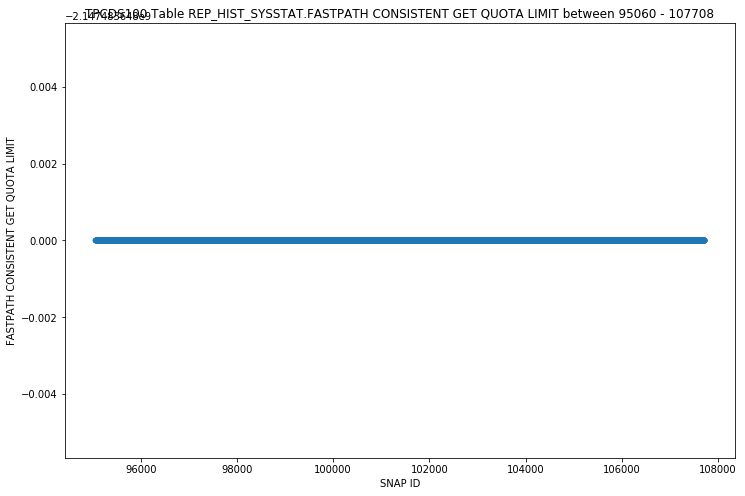

REP_HIST_SYSSTAT - FILE IO SERVICE TIME - STRIPPED SCATTER


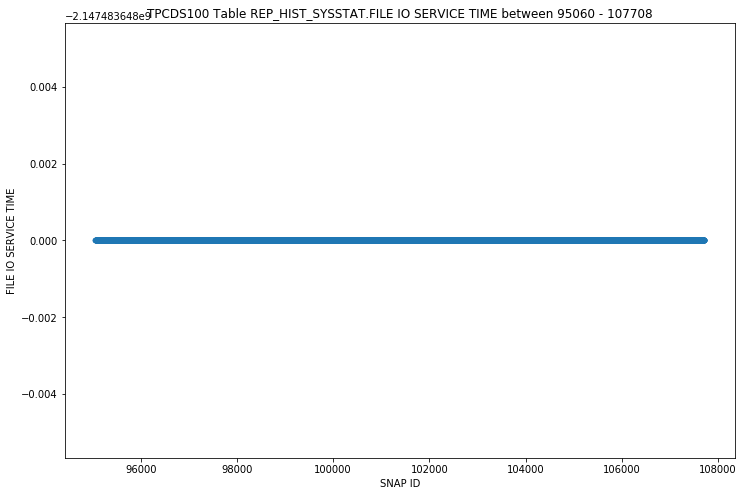

REP_HIST_SYSSTAT - FILE IO WAIT TIME - STRIPPED SCATTER


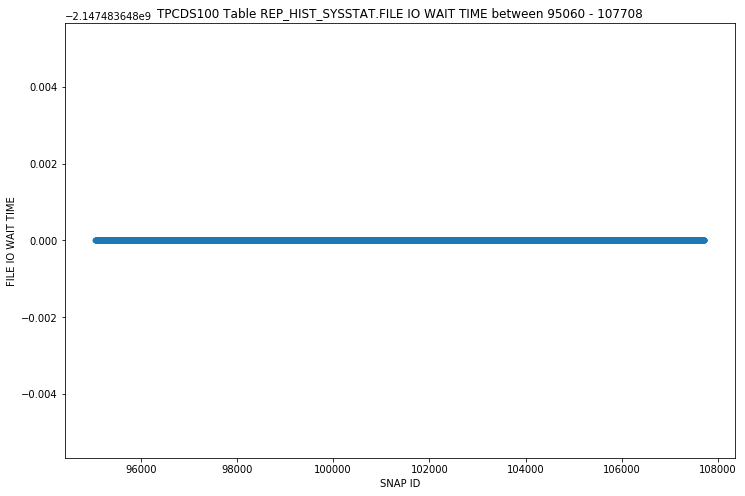

REP_HIST_SYSSTAT - FRAME SIGNATURE MISMATCH - STRIPPED SCATTER


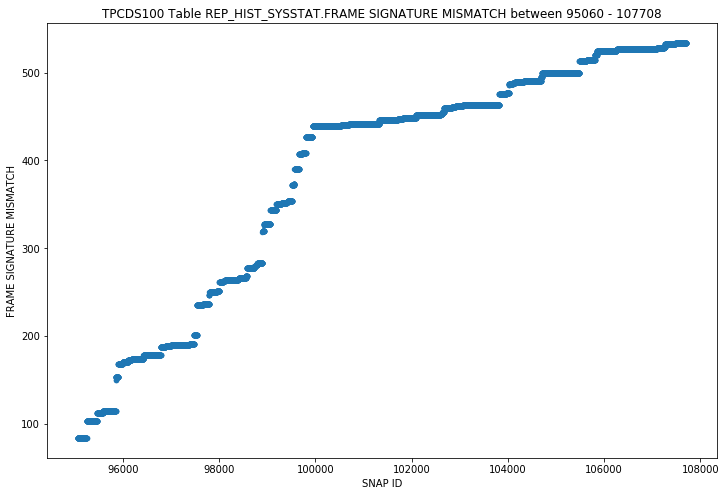

REP_HIST_SYSSTAT - FREE BUFFER INSPECTED - STRIPPED SCATTER


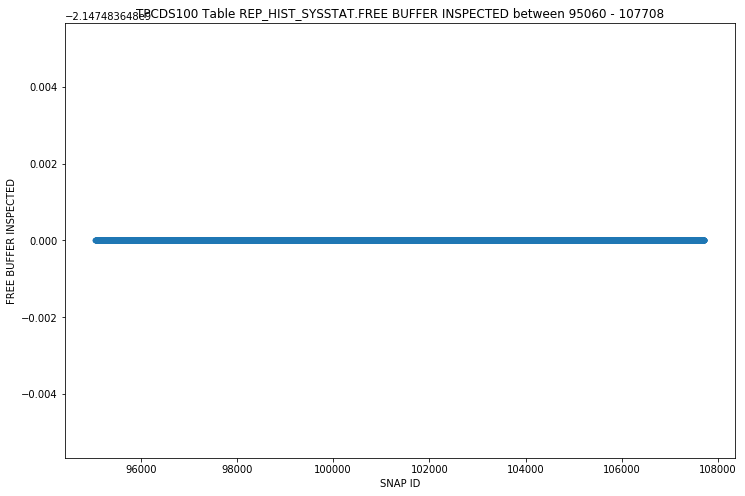

REP_HIST_SYSSTAT - FREE BUFFER REQUESTED - STRIPPED SCATTER


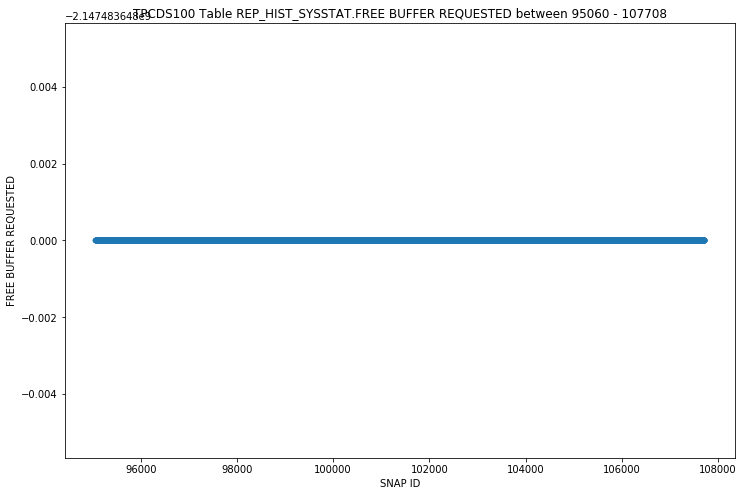

REP_HIST_SYSSTAT - HEAP BLOCK COMPRESS - STRIPPED SCATTER


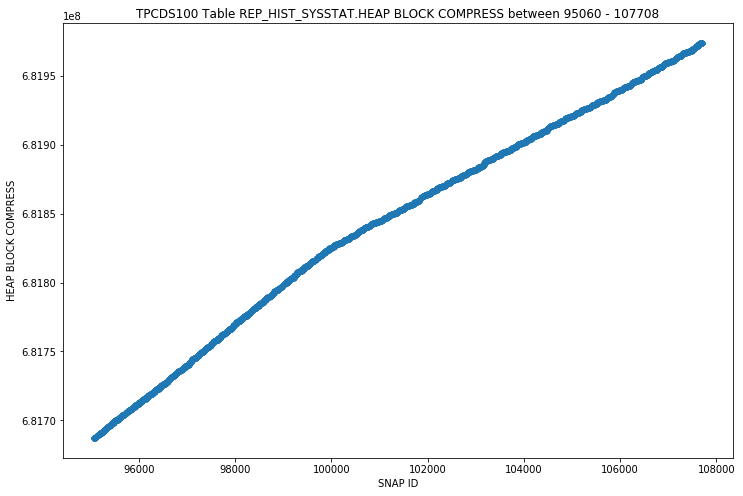

REP_HIST_SYSSTAT - HOT BUFFERS MOVED TO HEAD OF LRU - STRIPPED SCATTER


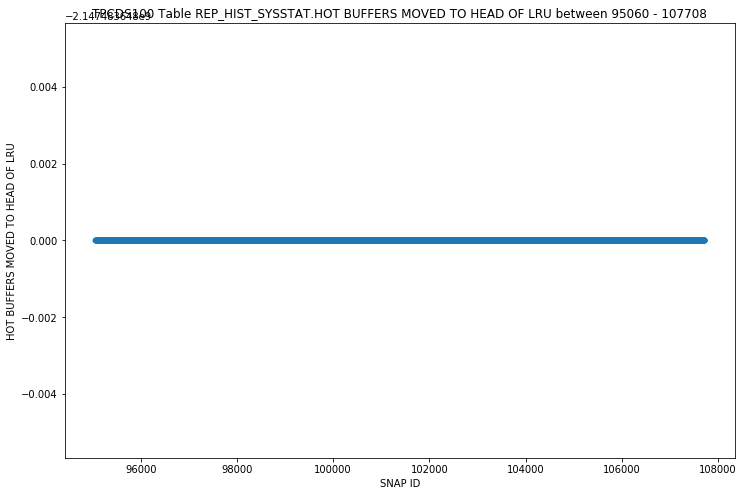

REP_HIST_SYSSTAT - IMMEDIATE (CR) BLOCK CLEANOUT APPLICATIONS - STRIPPED SCATTER


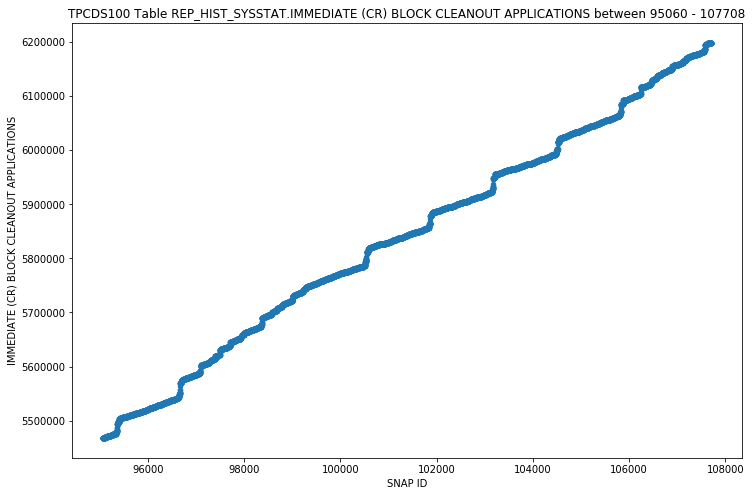

REP_HIST_SYSSTAT - IMMEDIATE (CURRENT) BLOCK CLEANOUT APPLICATIONS - STRIPPED SCATTER


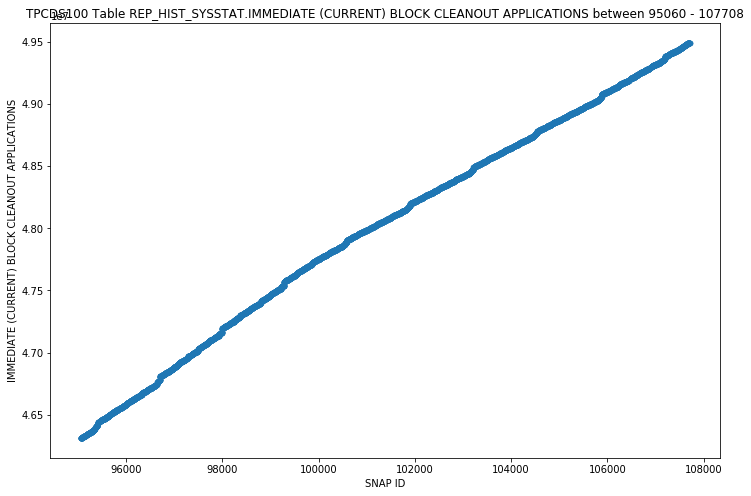

REP_HIST_SYSSTAT - IN CALL IDLE WAIT TIME - STRIPPED SCATTER


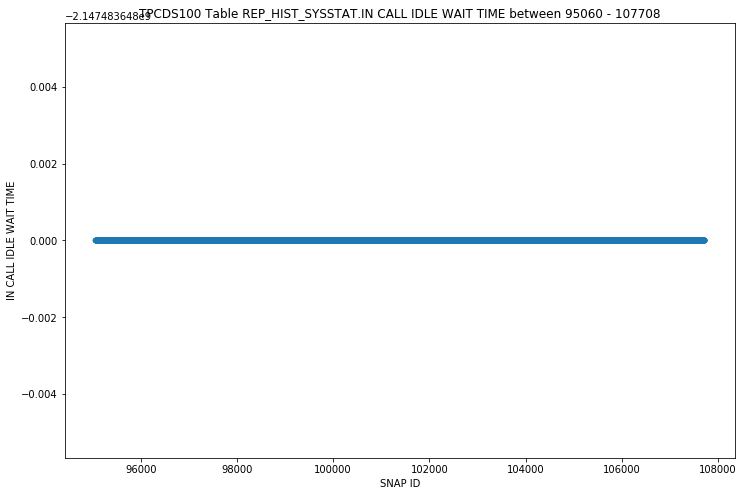

REP_HIST_SYSSTAT - INDEX CRX UPGRADE (POSITIONED) - STRIPPED SCATTER


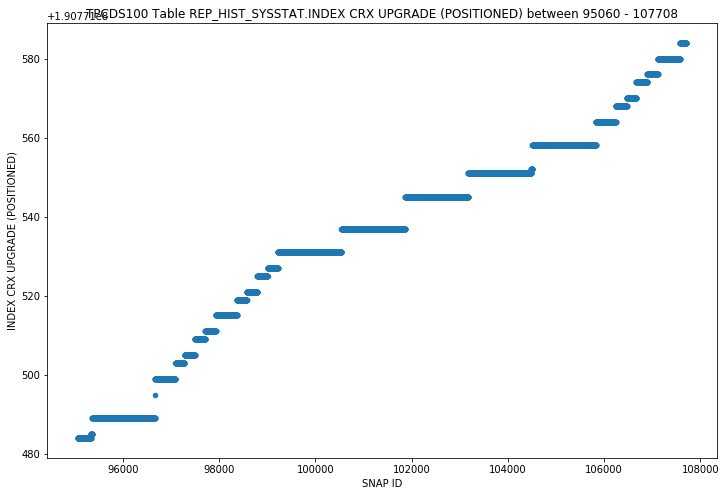

REP_HIST_SYSSTAT - INDEX CRX UPGRADE (PREFETCH) - STRIPPED SCATTER


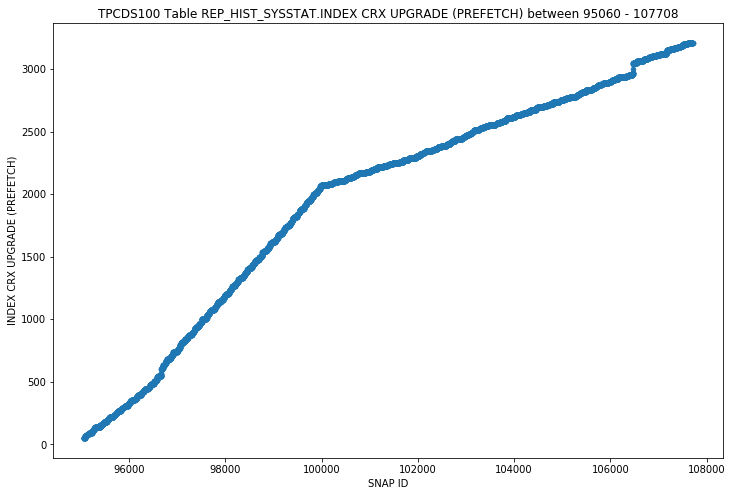

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (DIRECT READ) - STRIPPED SCATTER


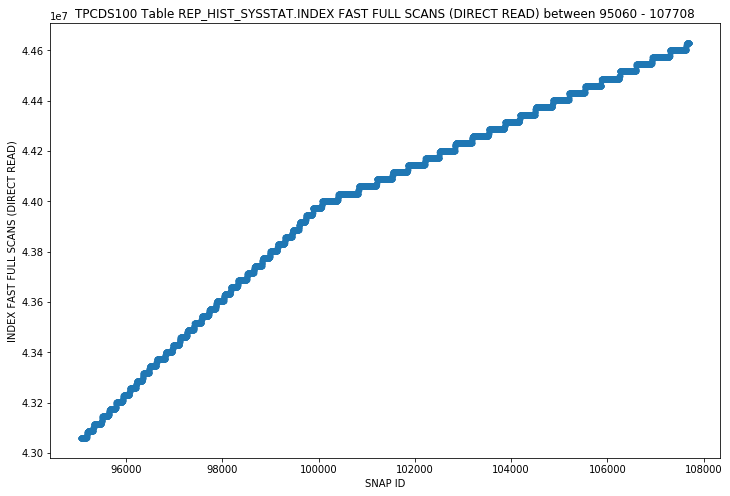

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (FULL) - STRIPPED SCATTER


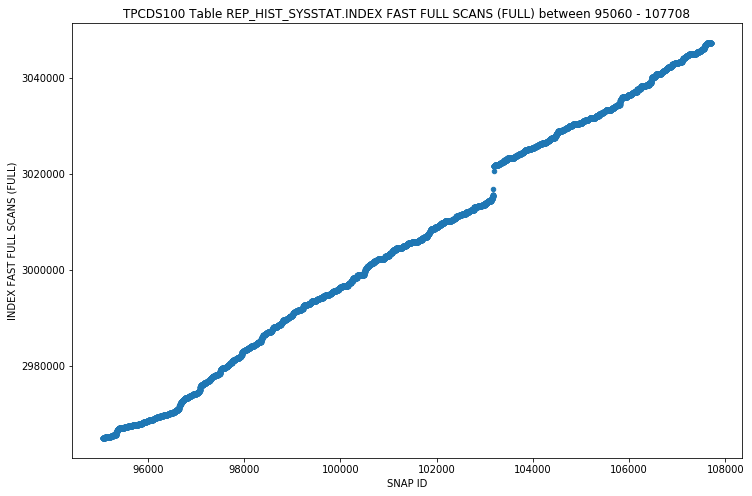

REP_HIST_SYSSTAT - INDEX FAST FULL SCANS (ROWID RANGES) - STRIPPED SCATTER


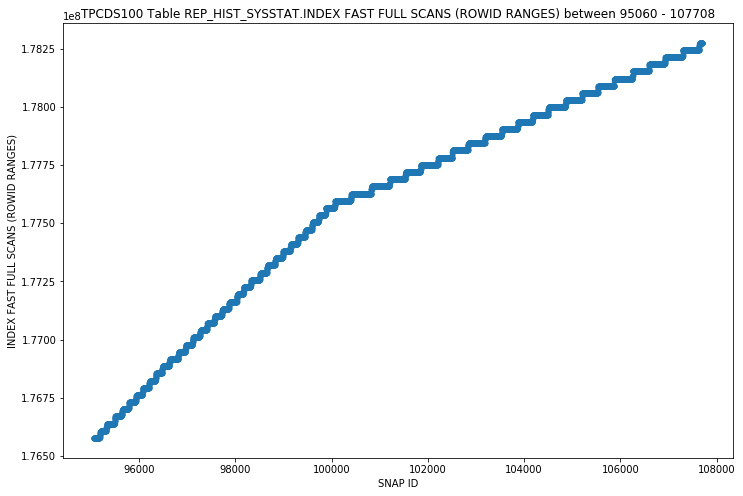

REP_HIST_SYSSTAT - INDEX FETCH BY KEY - STRIPPED SCATTER


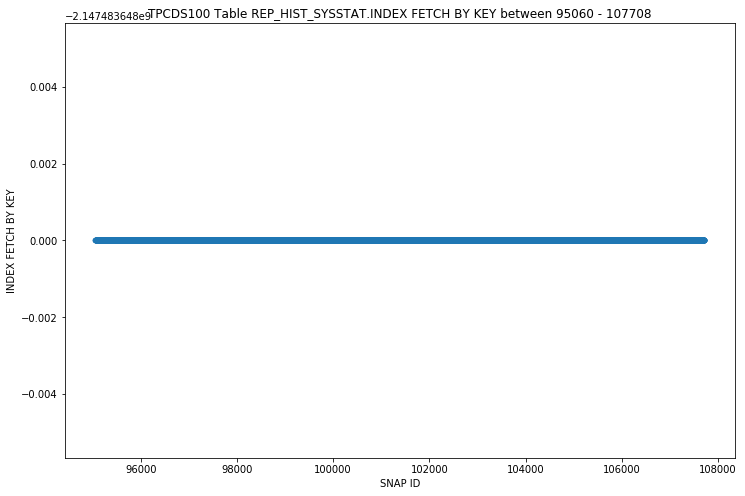

REP_HIST_SYSSTAT - INDEX SCANS KDIIXS1 - STRIPPED SCATTER


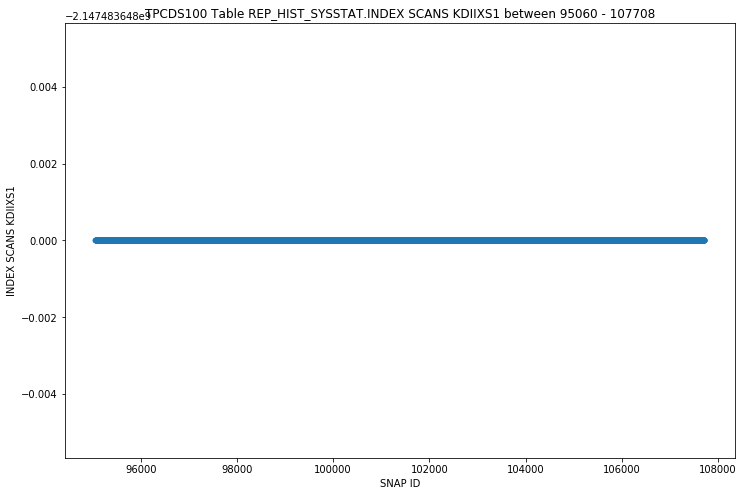

REP_HIST_SYSSTAT - LEAF NODE 90-10 SPLITS - STRIPPED SCATTER


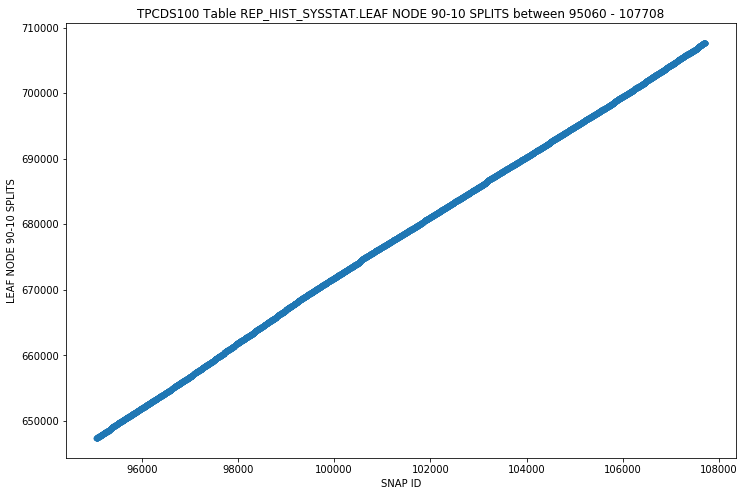

REP_HIST_SYSSTAT - LEAF NODE SPLITS - STRIPPED SCATTER


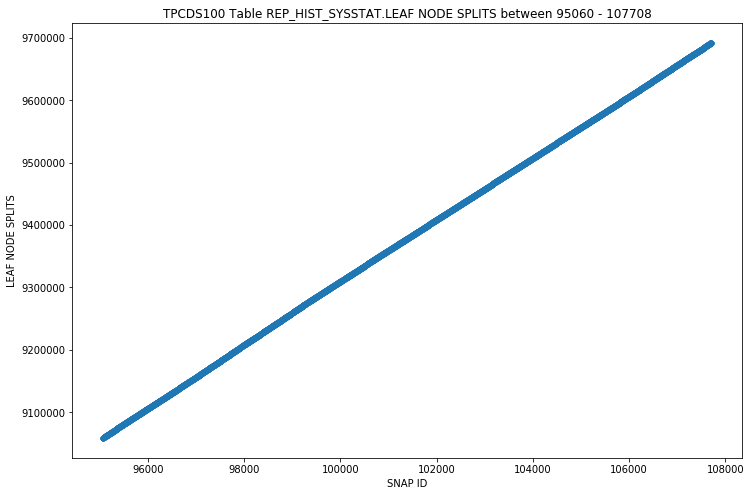

REP_HIST_SYSSTAT - LOB READS - STRIPPED SCATTER


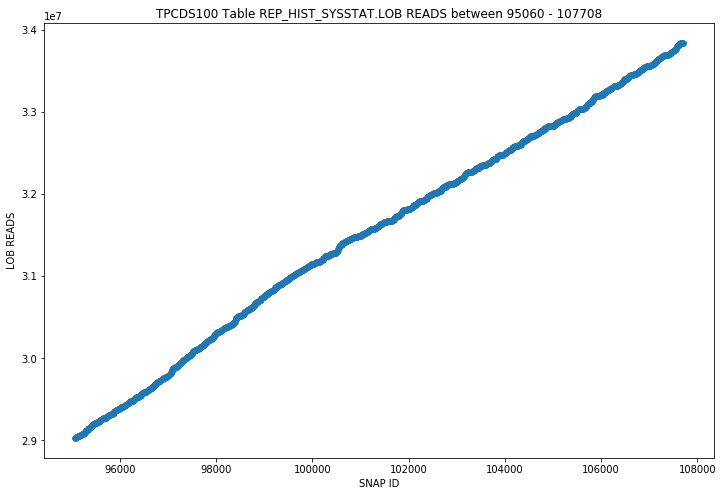

REP_HIST_SYSSTAT - LOB WRITES - STRIPPED SCATTER


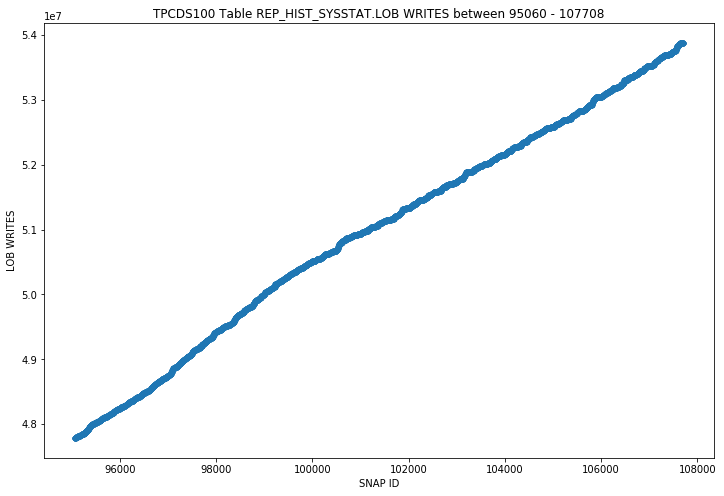

REP_HIST_SYSSTAT - LOB WRITES UNALIGNED - STRIPPED SCATTER


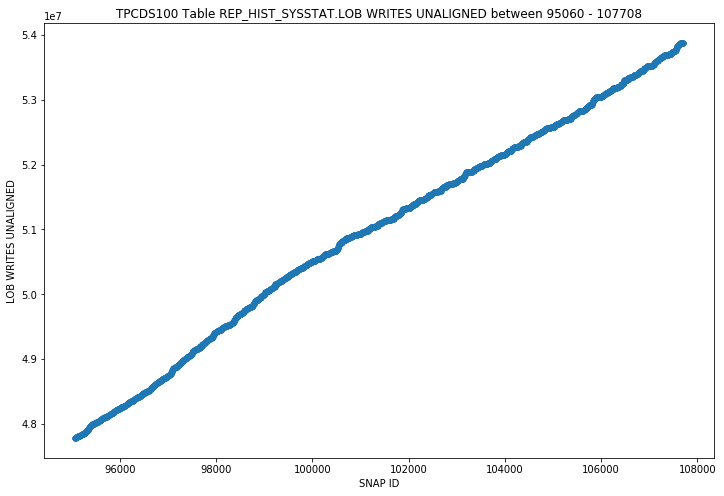

REP_HIST_SYSSTAT - LOGICAL READ BYTES FROM CACHE - STRIPPED SCATTER


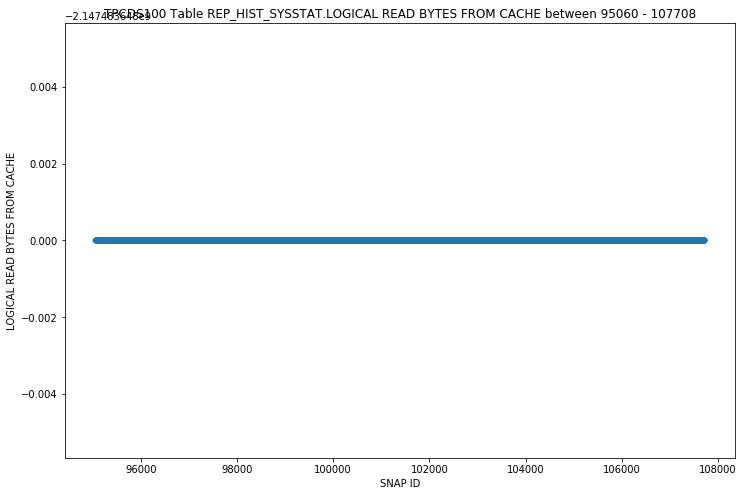

REP_HIST_SYSSTAT - LOGONS CUMULATIVE - STRIPPED SCATTER


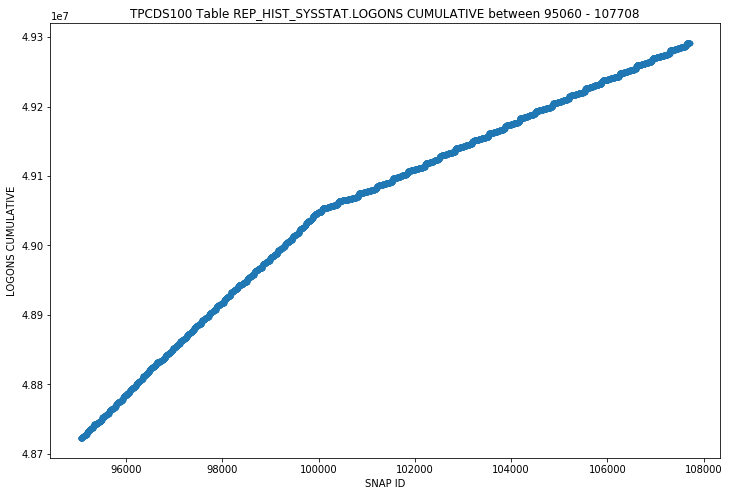

REP_HIST_SYSSTAT - LOGONS CURRENT - STRIPPED SCATTER


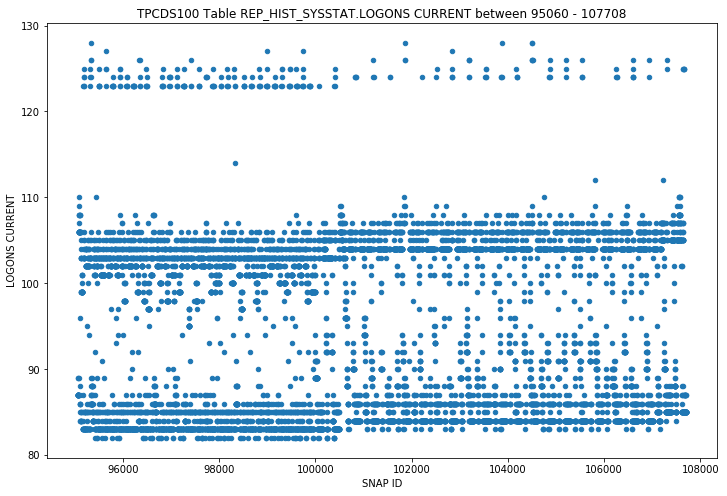

REP_HIST_SYSSTAT - MAX CF ENQ HOLD TIME - STRIPPED SCATTER


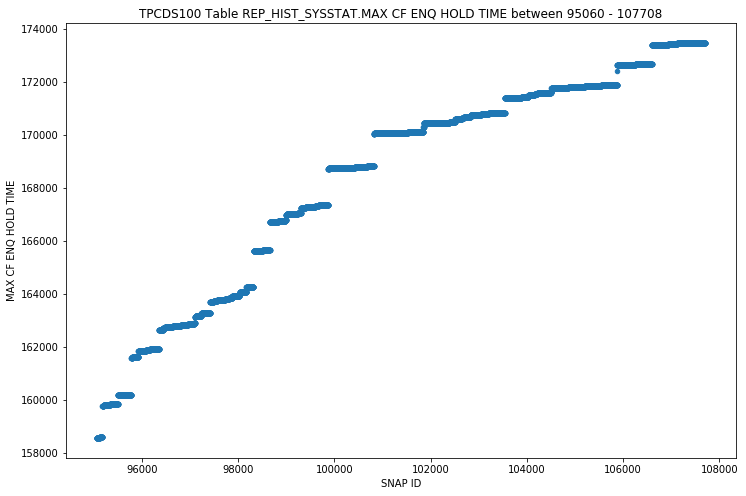

REP_HIST_SYSSTAT - MESSAGES RECEIVED - STRIPPED SCATTER


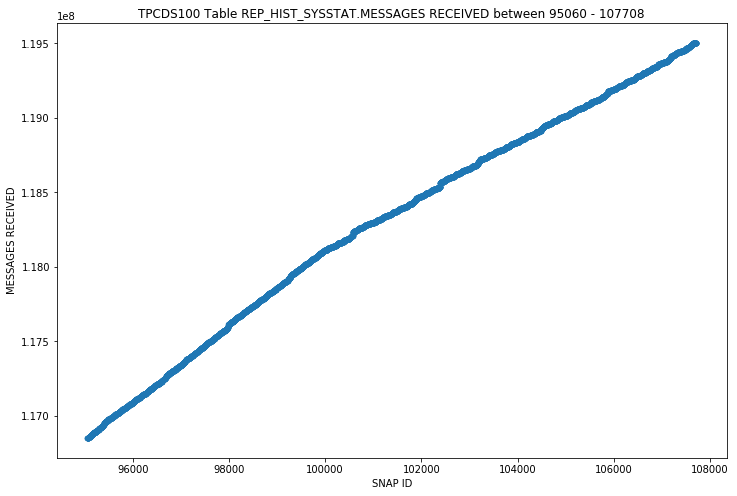

REP_HIST_SYSSTAT - MESSAGES SENT - STRIPPED SCATTER


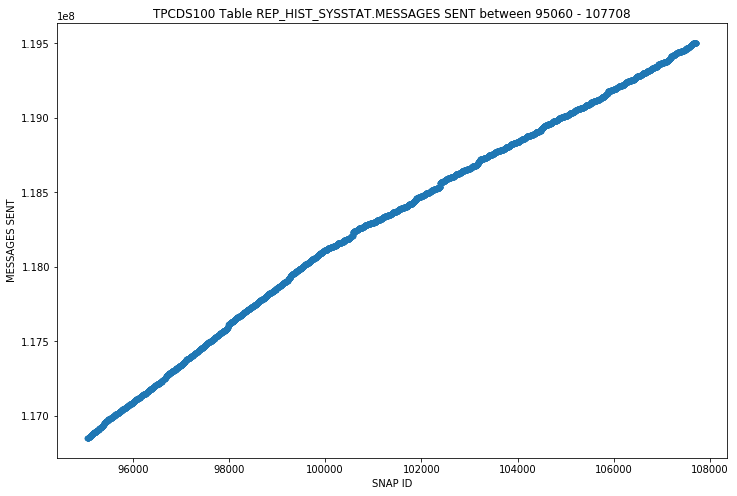

REP_HIST_SYSSTAT - MIN ACTIVE SCN OPTIMIZATION APPLIED ON CR - STRIPPED SCATTER


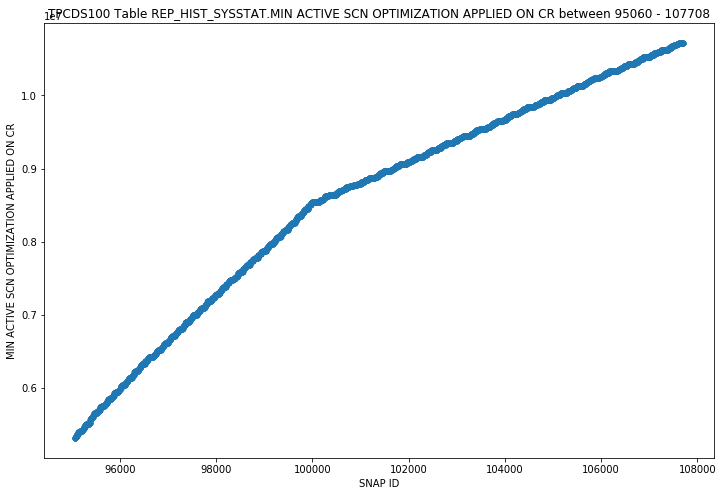

REP_HIST_SYSSTAT - NO BUFFER TO KEEP PINNED COUNT - STRIPPED SCATTER


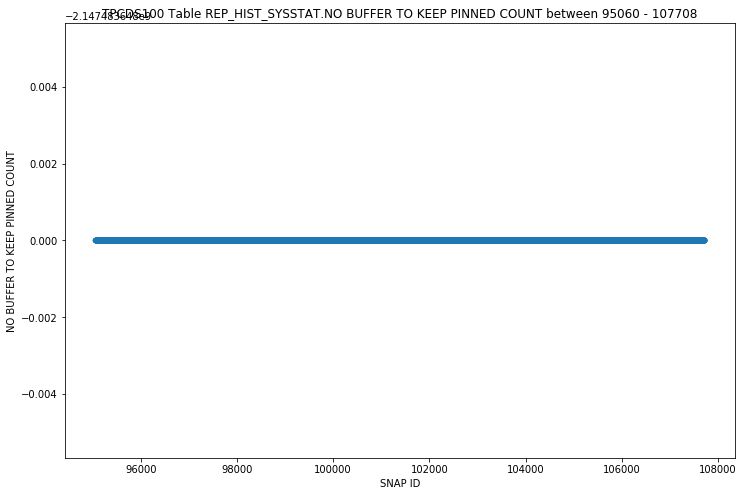

REP_HIST_SYSSTAT - NO WORK - CONSISTENT READ GETS - STRIPPED SCATTER


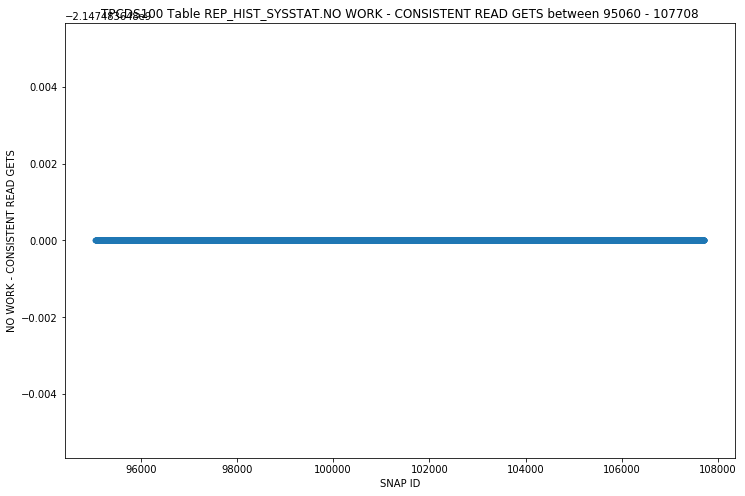

REP_HIST_SYSSTAT - NON-IDLE WAIT COUNT - STRIPPED SCATTER


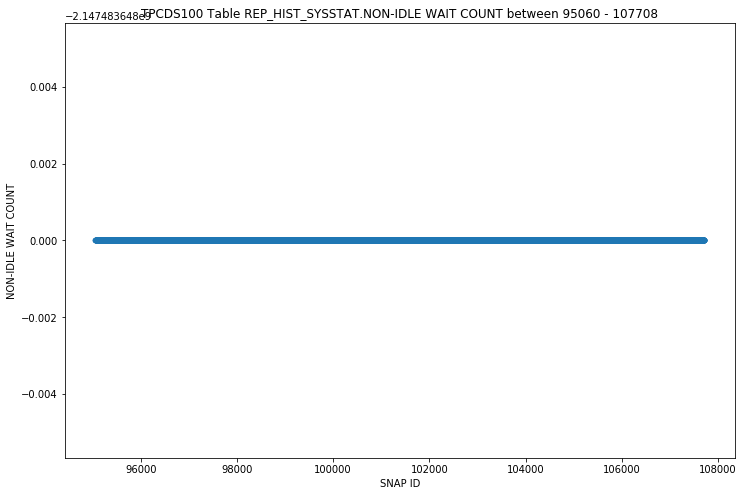

REP_HIST_SYSSTAT - NON-IDLE WAIT TIME - STRIPPED SCATTER


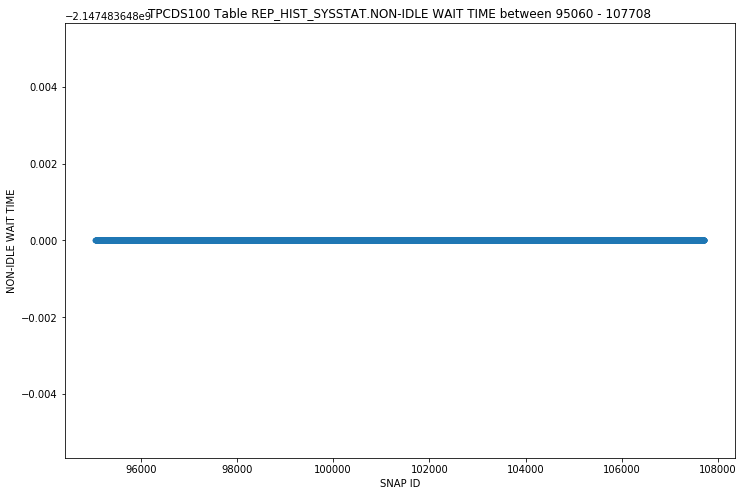

REP_HIST_SYSSTAT - OPENED CURSORS CUMULATIVE - STRIPPED SCATTER


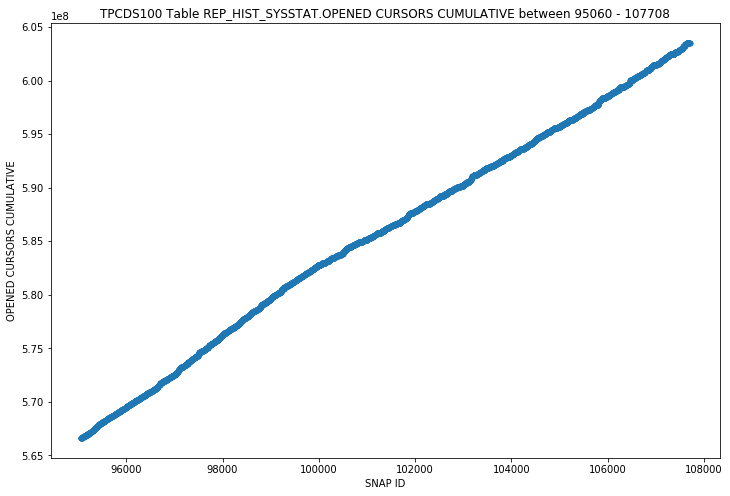

REP_HIST_SYSSTAT - OPENED CURSORS CURRENT - STRIPPED SCATTER


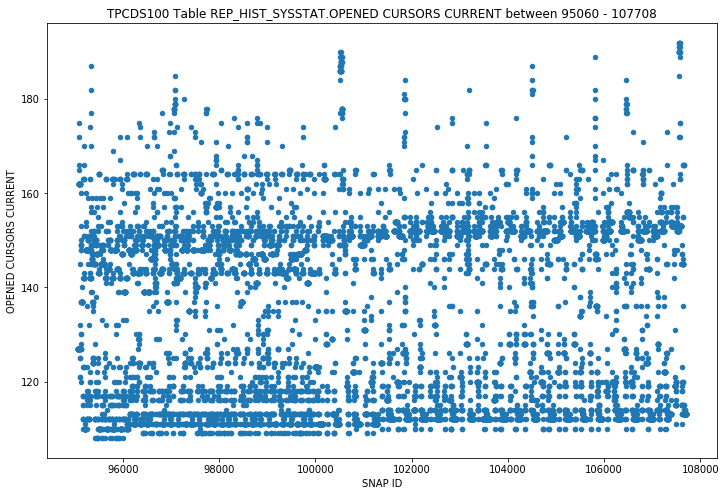

REP_HIST_SYSSTAT - PARSE COUNT (DESCRIBE) - STRIPPED SCATTER


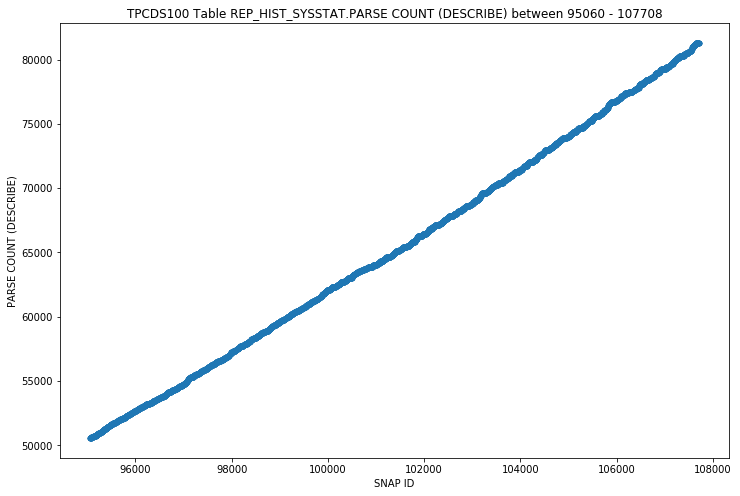

REP_HIST_SYSSTAT - PARSE COUNT (FAILURES) - STRIPPED SCATTER


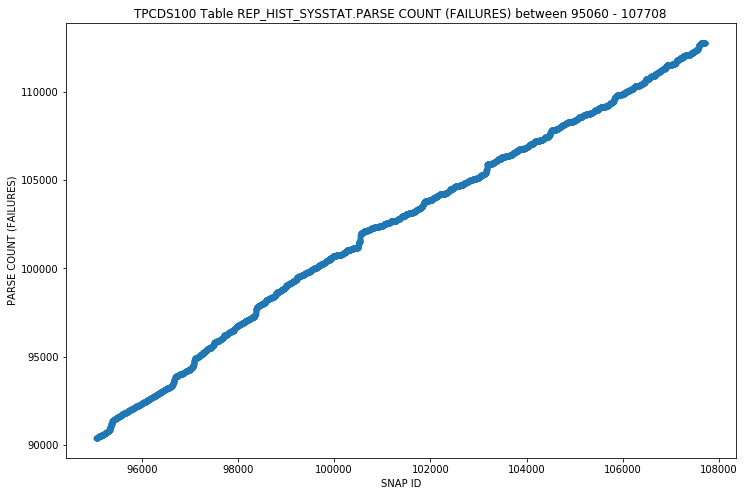

REP_HIST_SYSSTAT - PARSE COUNT (HARD) - STRIPPED SCATTER


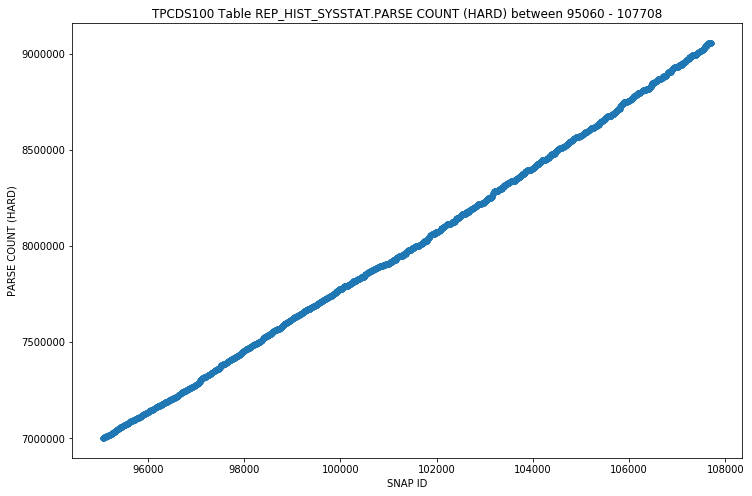

REP_HIST_SYSSTAT - PARSE COUNT (TOTAL) - STRIPPED SCATTER


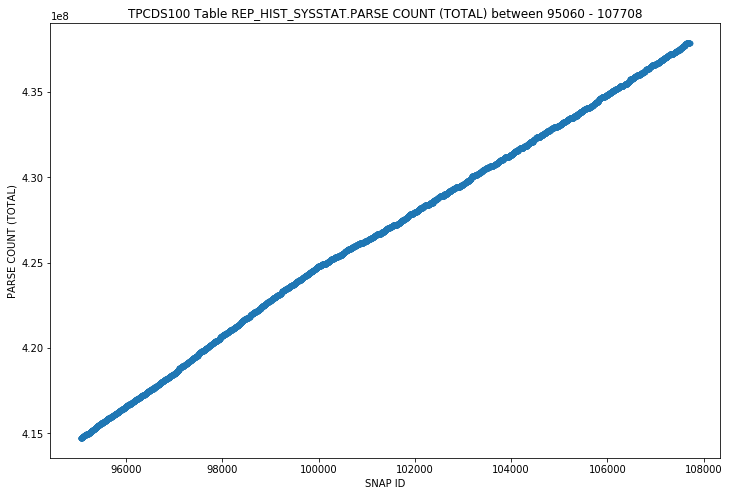

REP_HIST_SYSSTAT - PARSE TIME CPU - STRIPPED SCATTER


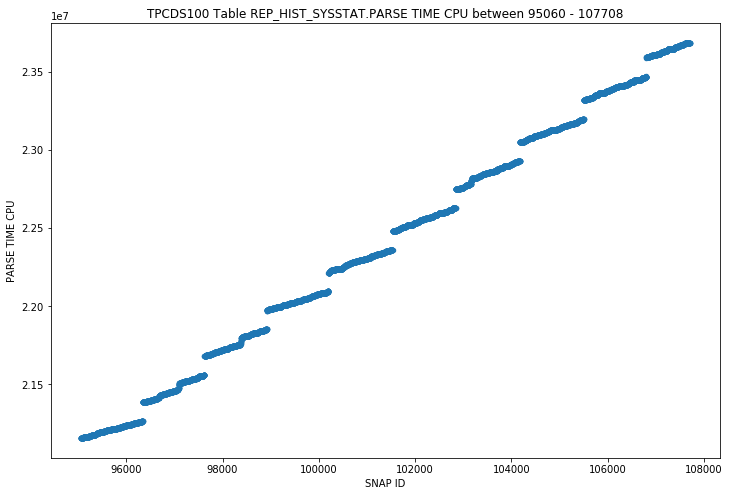

REP_HIST_SYSSTAT - PARSE TIME ELAPSED - STRIPPED SCATTER


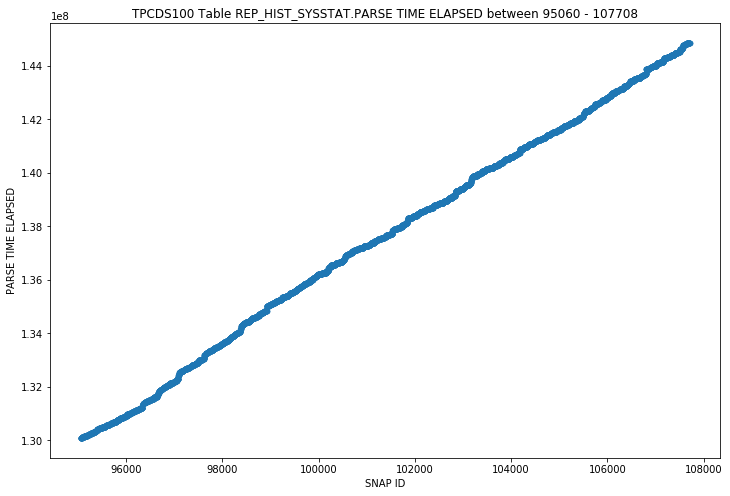

REP_HIST_SYSSTAT - PHYSICAL READ IO REQUESTS - STRIPPED SCATTER


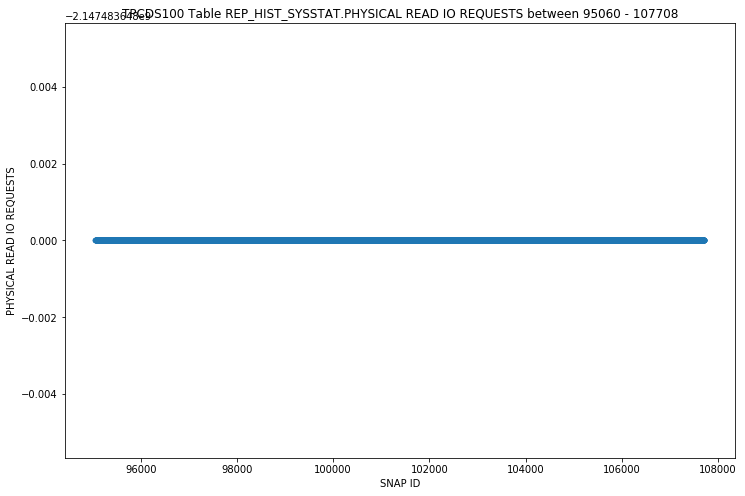

REP_HIST_SYSSTAT - PHYSICAL READ BYTES - STRIPPED SCATTER


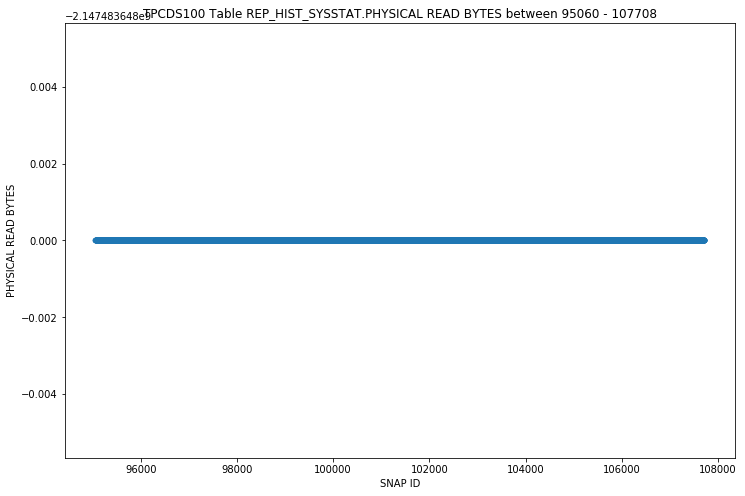

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL IO REQUESTS - STRIPPED SCATTER


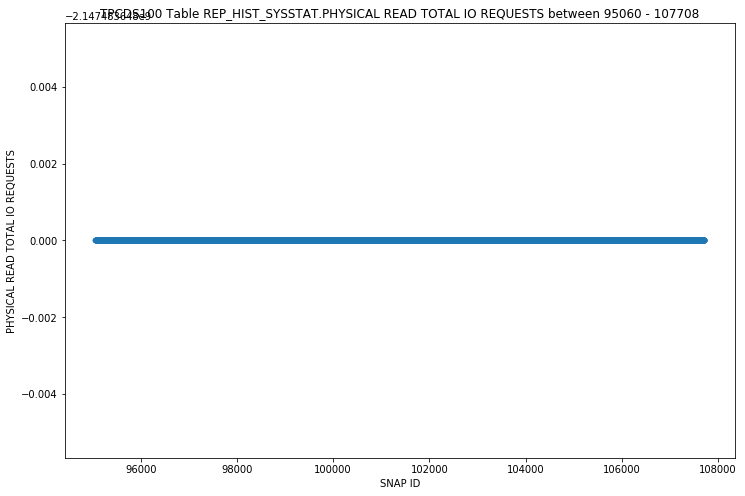

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL BYTES - STRIPPED SCATTER


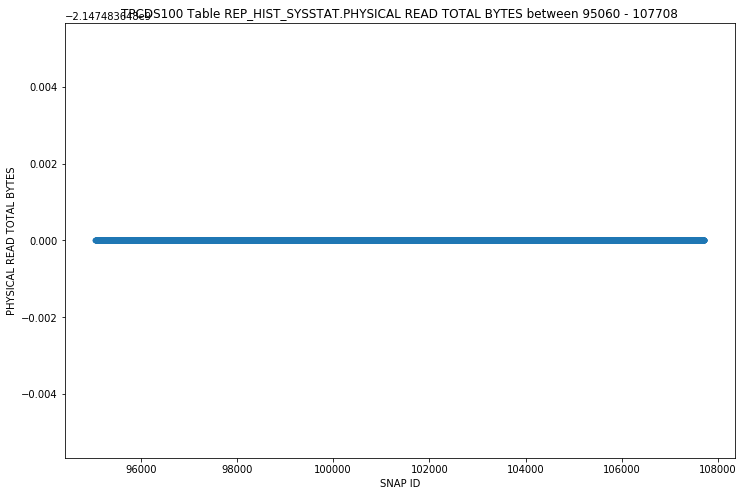

REP_HIST_SYSSTAT - PHYSICAL READ TOTAL MULTI BLOCK REQUESTS - STRIPPED SCATTER


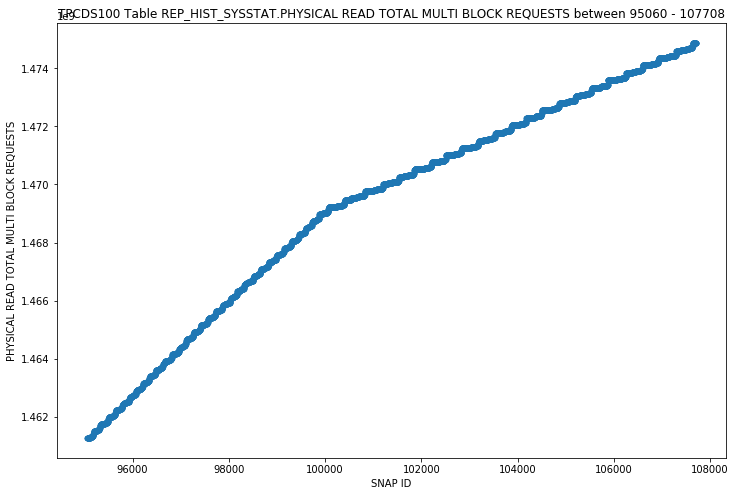

REP_HIST_SYSSTAT - PHYSICAL READS - STRIPPED SCATTER


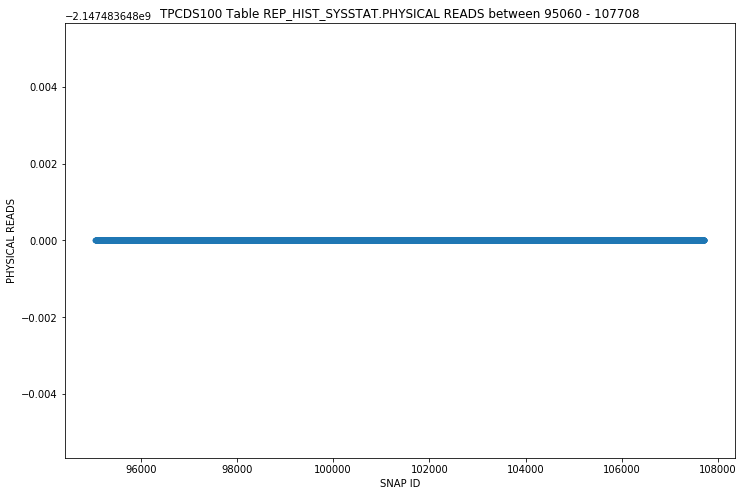

REP_HIST_SYSSTAT - PHYSICAL READS CACHE - STRIPPED SCATTER


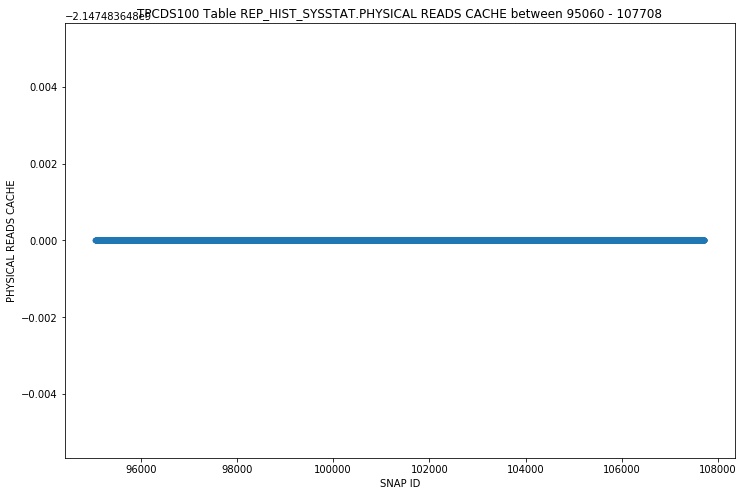

REP_HIST_SYSSTAT - PHYSICAL READS CACHE PREFETCH - STRIPPED SCATTER


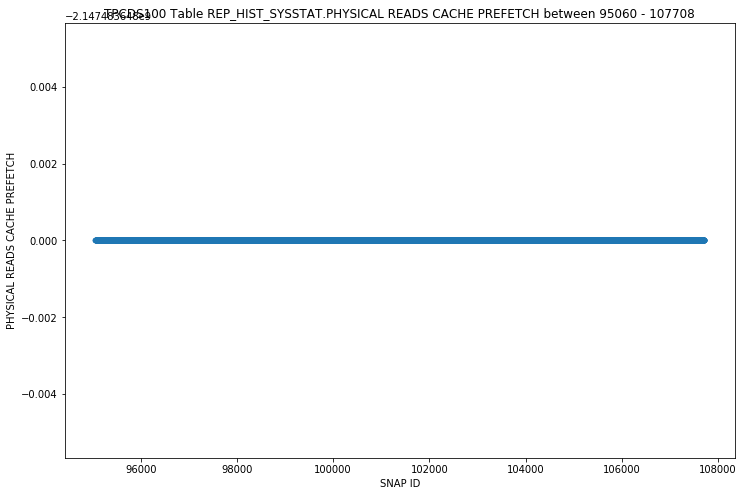

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT - STRIPPED SCATTER


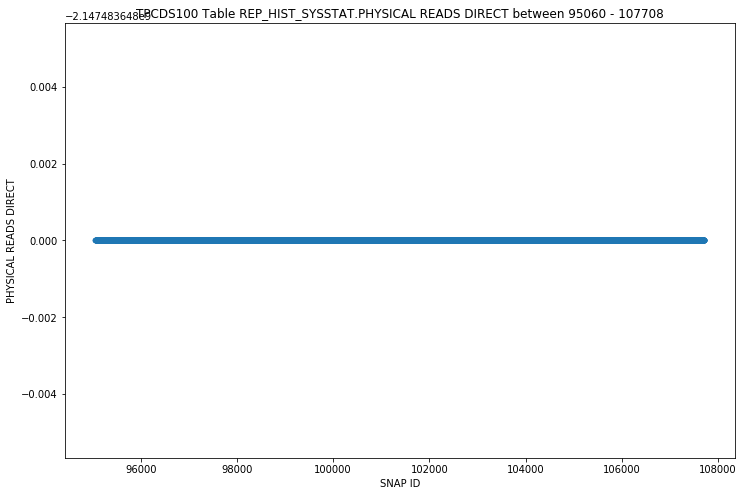

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT (LOB) - STRIPPED SCATTER


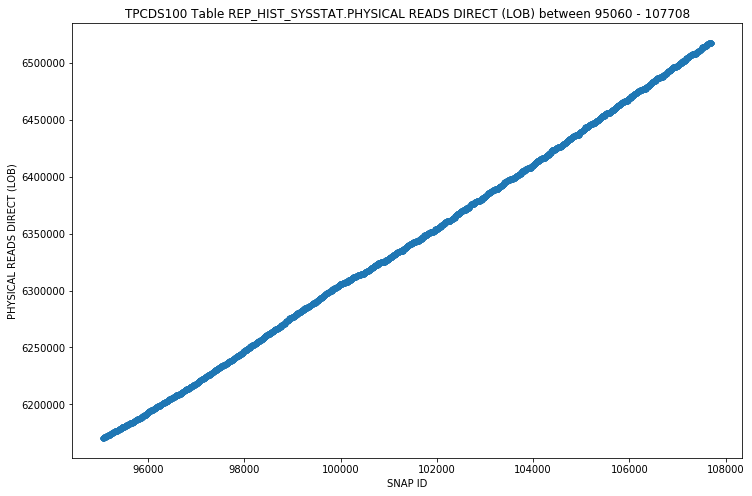

REP_HIST_SYSSTAT - PHYSICAL READS DIRECT TEMPORARY TABLESPACE - STRIPPED SCATTER


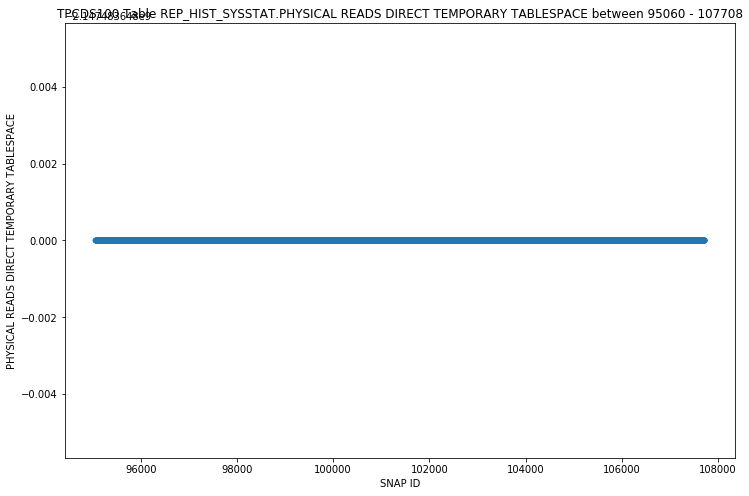

REP_HIST_SYSSTAT - PHYSICAL WRITE IO REQUESTS - STRIPPED SCATTER


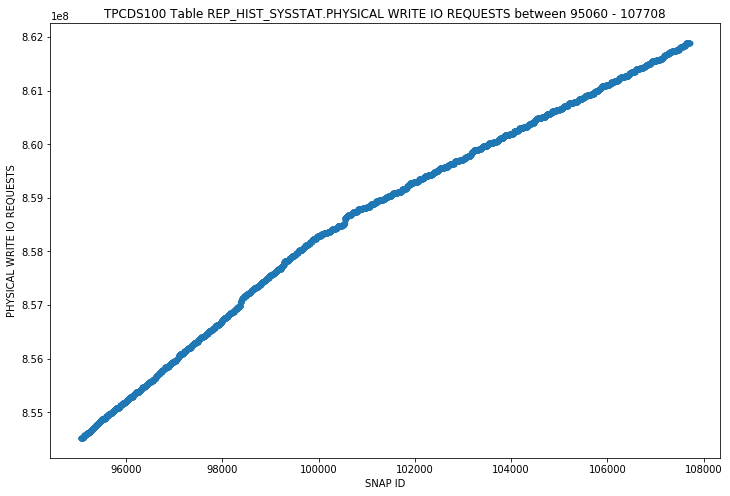

REP_HIST_SYSSTAT - PHYSICAL WRITE BYTES - STRIPPED SCATTER


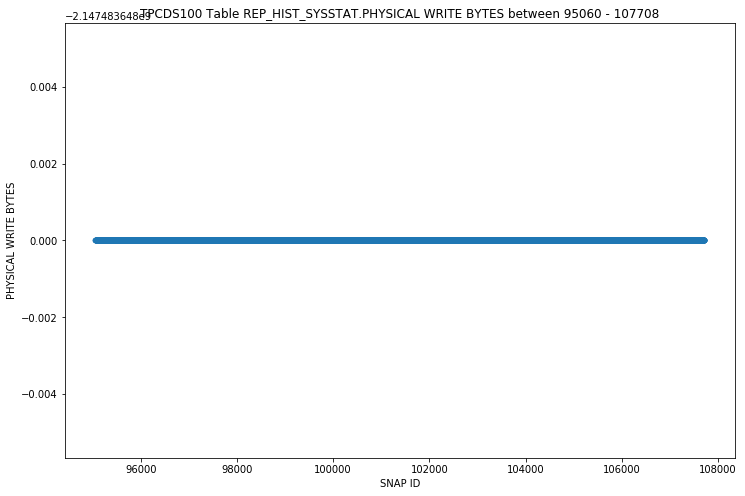

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL IO REQUESTS - STRIPPED SCATTER


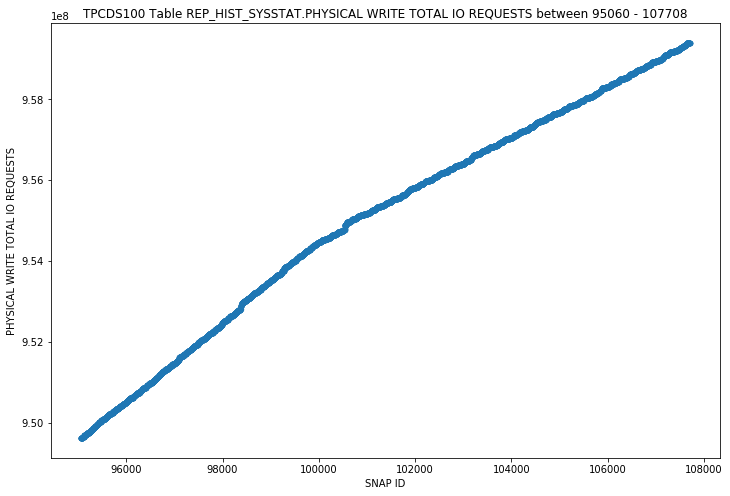

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL BYTES - STRIPPED SCATTER


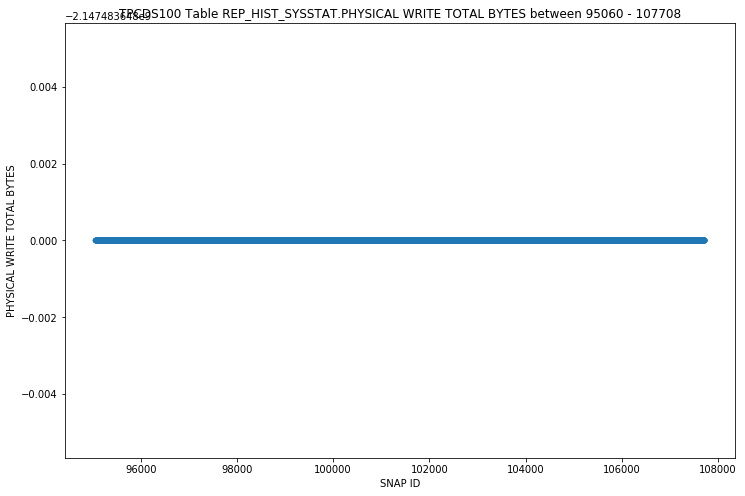

REP_HIST_SYSSTAT - PHYSICAL WRITE TOTAL MULTI BLOCK REQUESTS - STRIPPED SCATTER


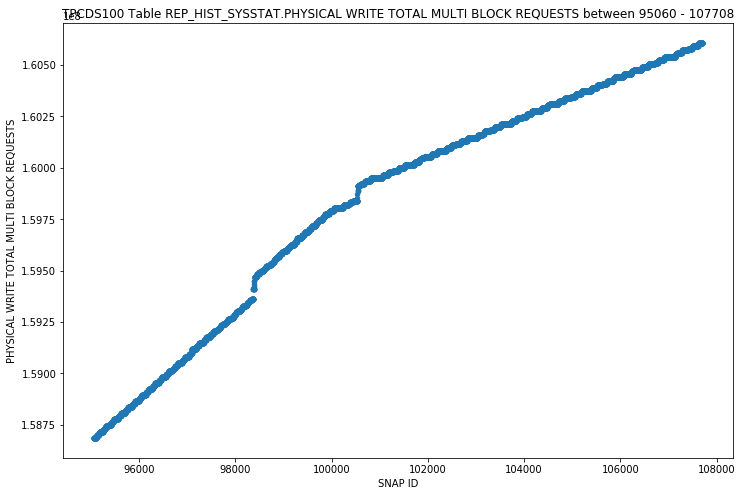

REP_HIST_SYSSTAT - PHYSICAL WRITES - STRIPPED SCATTER


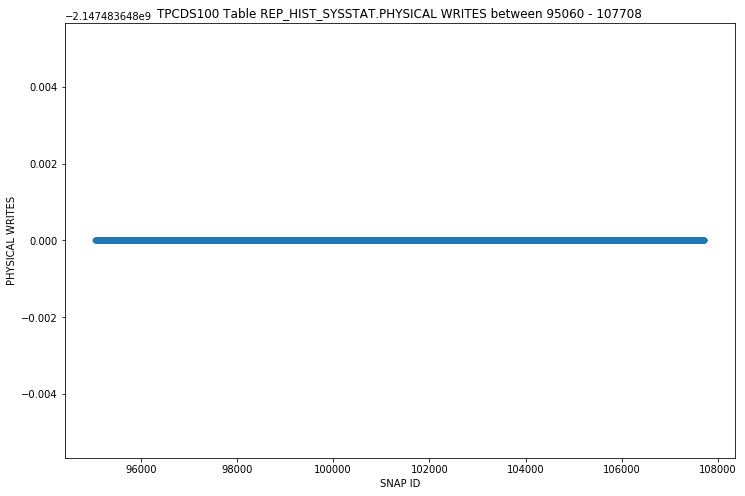

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT - STRIPPED SCATTER


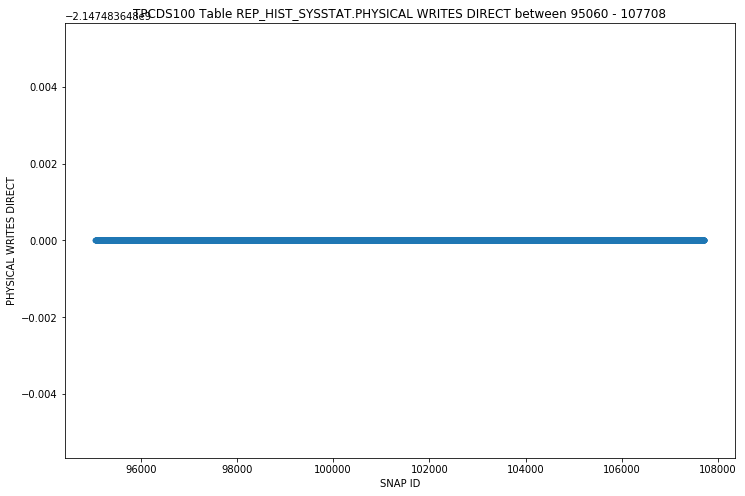

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT (LOB) - STRIPPED SCATTER


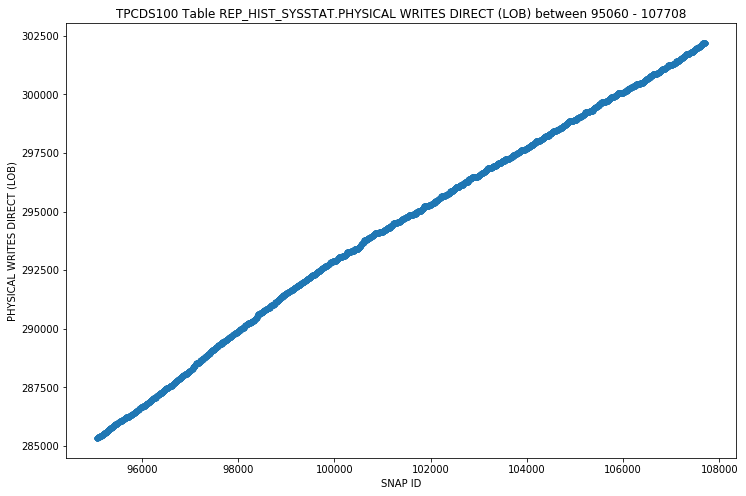

REP_HIST_SYSSTAT - PHYSICAL WRITES DIRECT TEMPORARY TABLESPACE - STRIPPED SCATTER


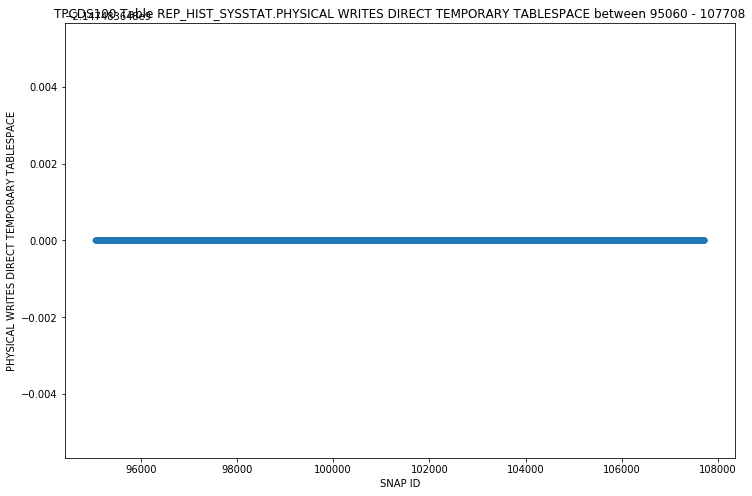

REP_HIST_SYSSTAT - PHYSICAL WRITES FROM CACHE - STRIPPED SCATTER


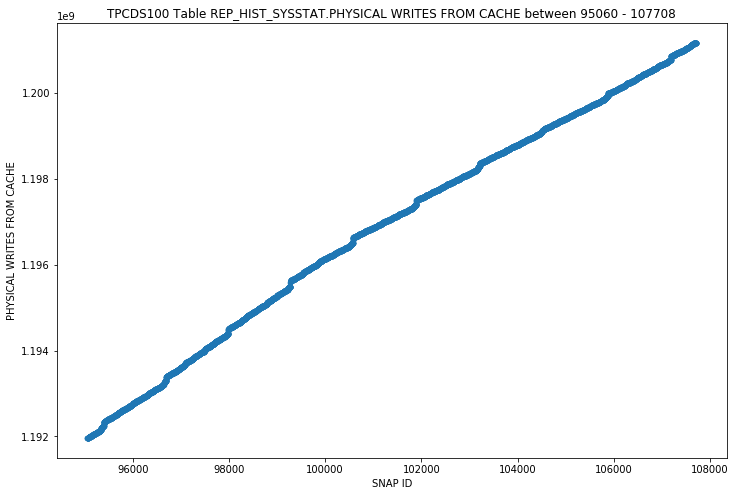

REP_HIST_SYSSTAT - PHYSICAL WRITES NON CHECKPOINT - STRIPPED SCATTER


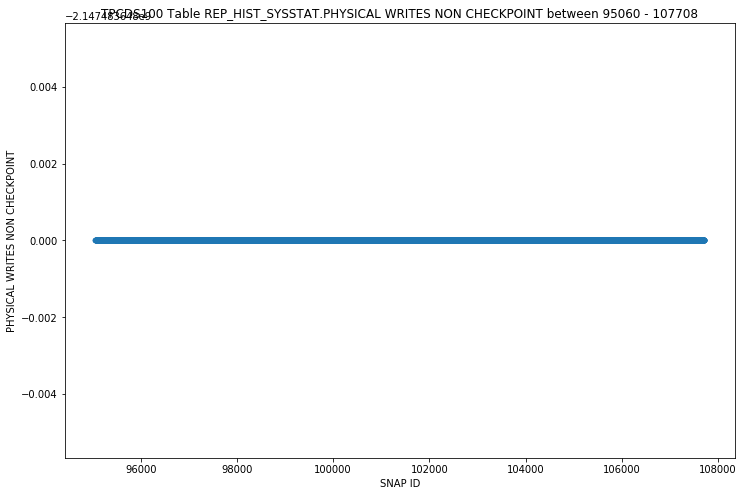

REP_HIST_SYSSTAT - PINNED BUFFERS INSPECTED - STRIPPED SCATTER


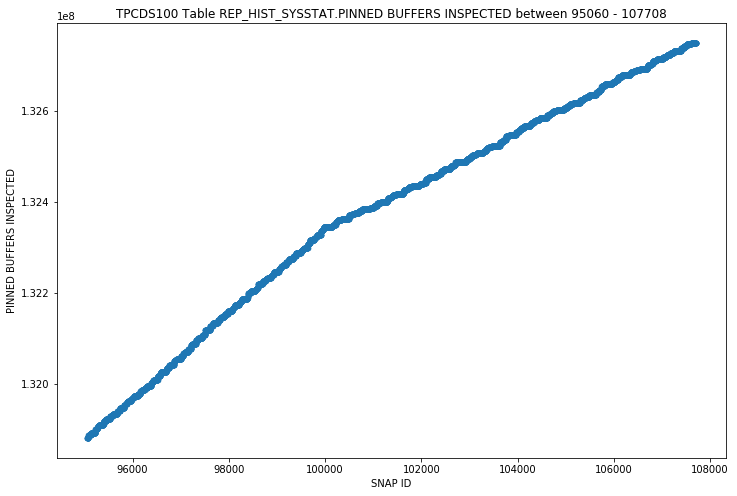

REP_HIST_SYSSTAT - PINNED CURSORS CURRENT - STRIPPED SCATTER


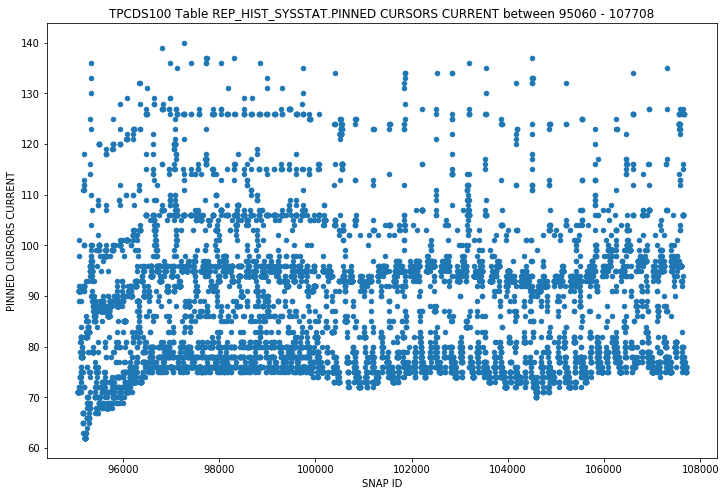

REP_HIST_SYSSTAT - PREFETCH CLIENTS - DEFAULT - STRIPPED SCATTER


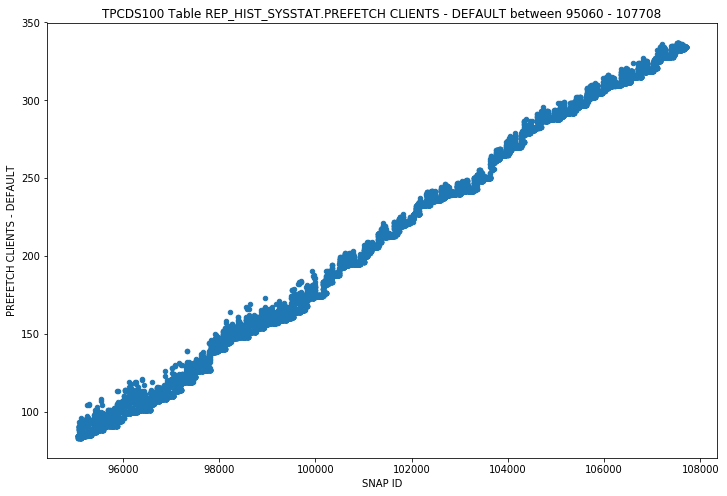

REP_HIST_SYSSTAT - PREFETCHED BLOCKS AGED OUT BEFORE USE - STRIPPED SCATTER


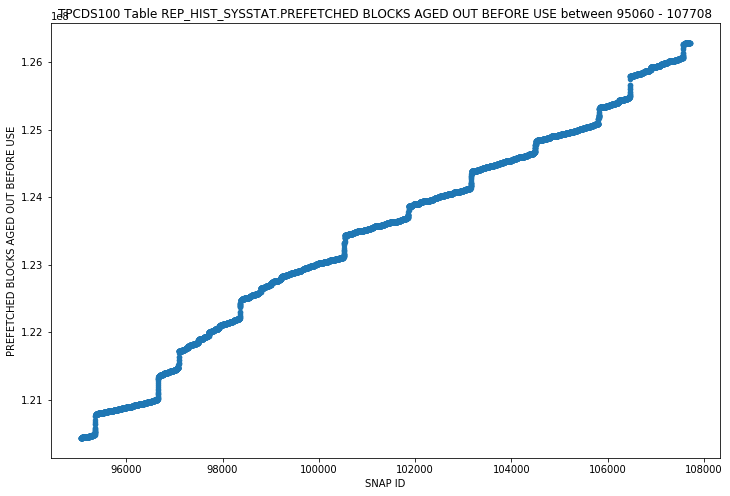

REP_HIST_SYSSTAT - PROCESS LAST NON-IDLE TIME - STRIPPED SCATTER


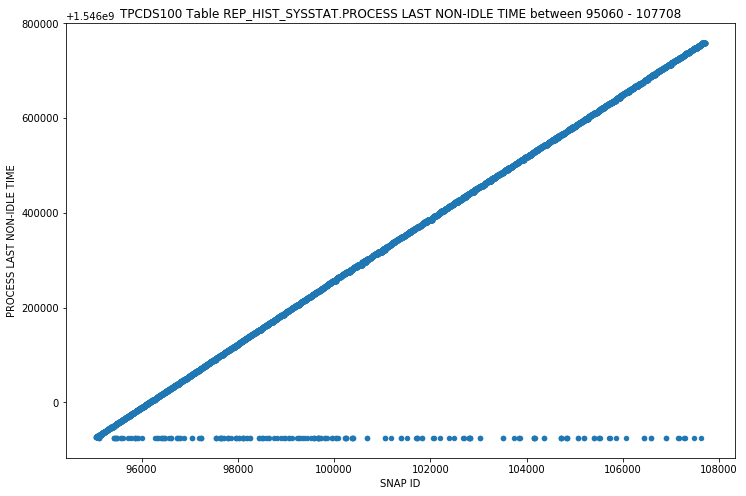

REP_HIST_SYSSTAT - QUERIES PARALLELIZED - STRIPPED SCATTER


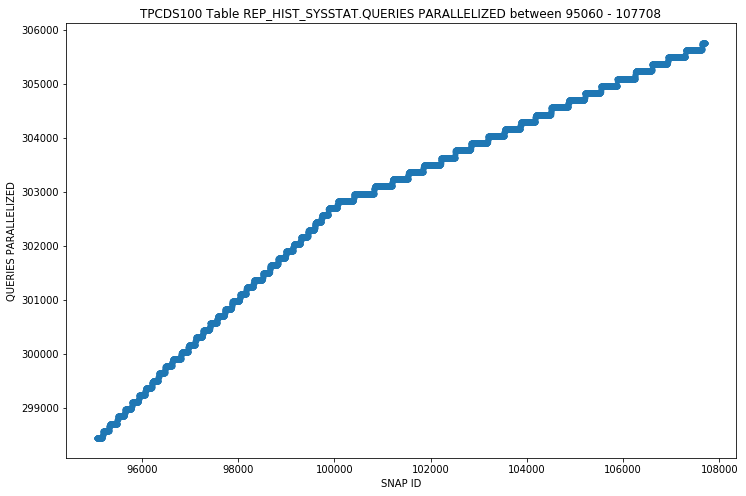

REP_HIST_SYSSTAT - RECURSIVE CALLS - STRIPPED SCATTER


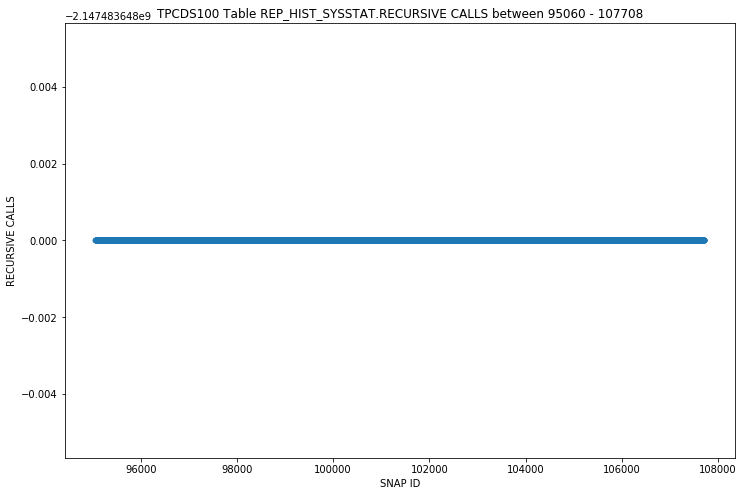

REP_HIST_SYSSTAT - RECURSIVE CPU USAGE - STRIPPED SCATTER


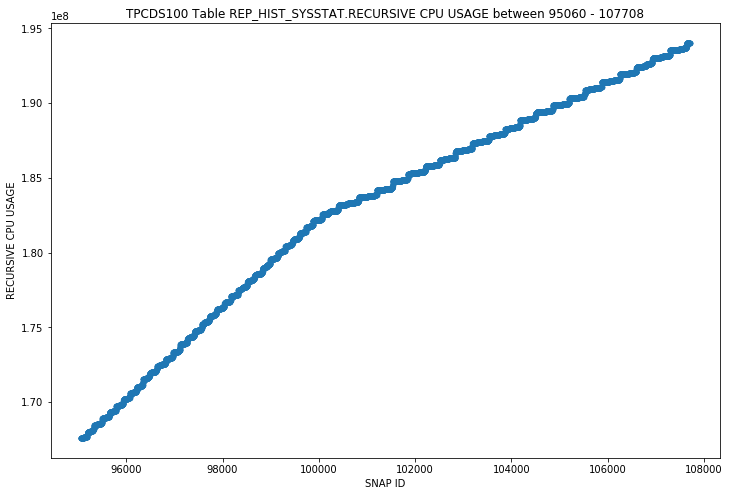

REP_HIST_SYSSTAT - REDO BLOCKS CHECKSUMMED BY FG (EXCLUSIVE) - STRIPPED SCATTER


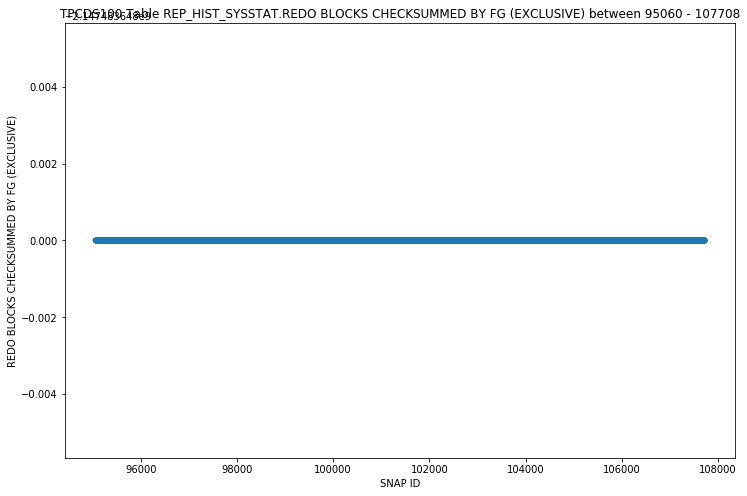

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN - STRIPPED SCATTER


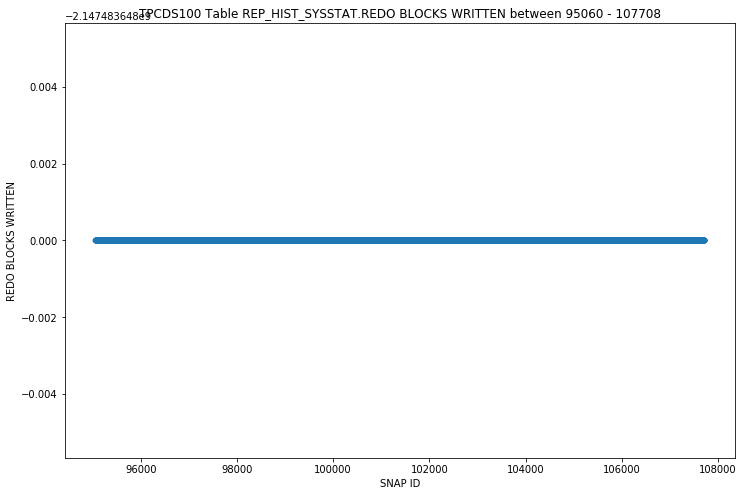

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN (GROUP 0) - STRIPPED SCATTER


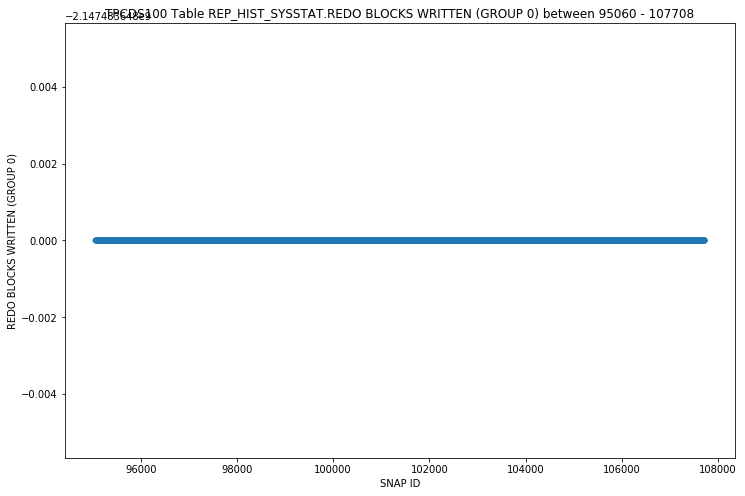

REP_HIST_SYSSTAT - REDO BLOCKS WRITTEN (GROUP 1) - STRIPPED SCATTER


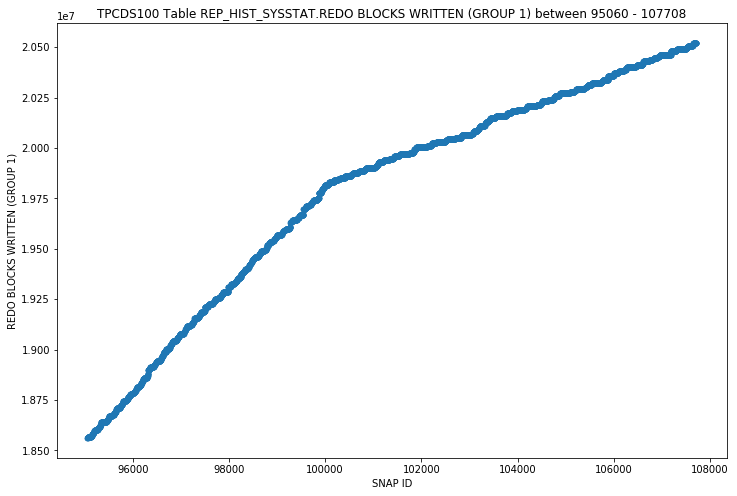

REP_HIST_SYSSTAT - REDO BUFFER ALLOCATION RETRIES - STRIPPED SCATTER


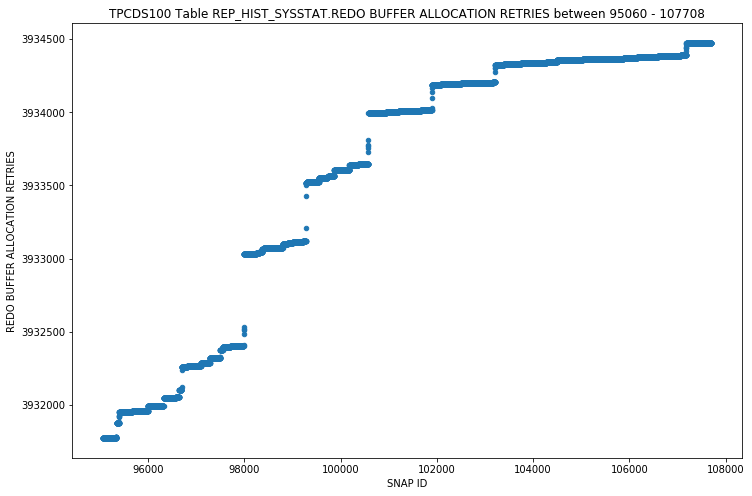

REP_HIST_SYSSTAT - REDO ENTRIES - STRIPPED SCATTER


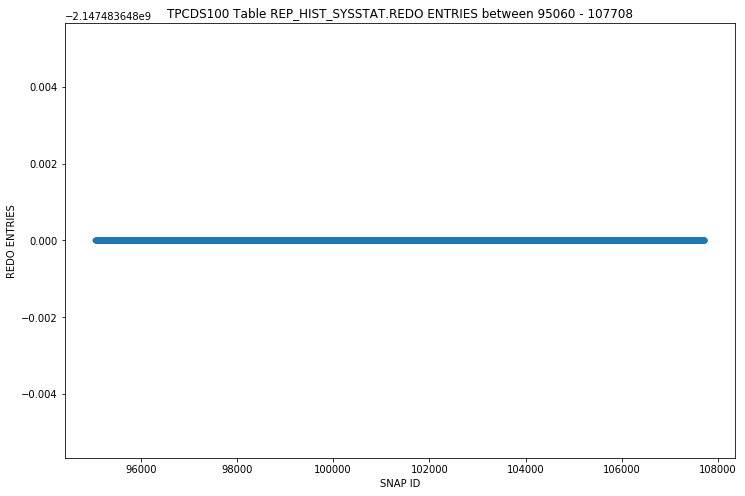

REP_HIST_SYSSTAT - REDO LOG SPACE REQUESTS - STRIPPED SCATTER


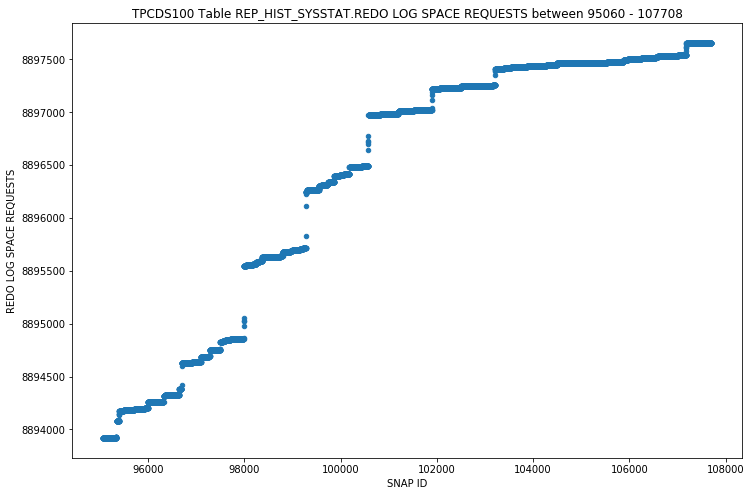

REP_HIST_SYSSTAT - REDO LOG SPACE WAIT TIME - STRIPPED SCATTER


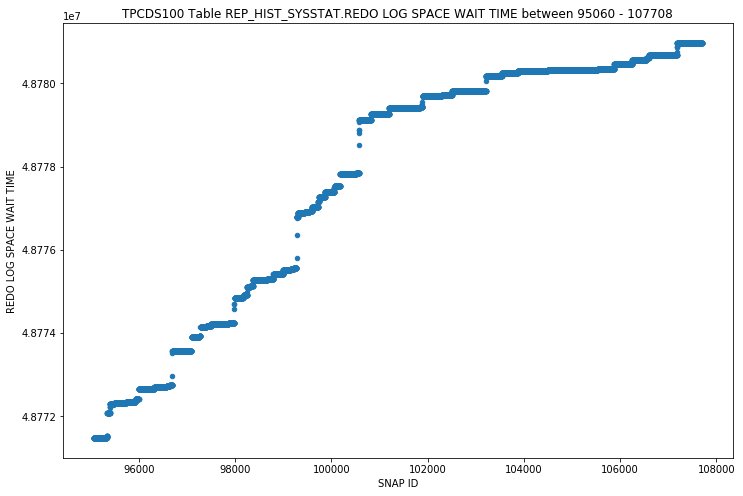

REP_HIST_SYSSTAT - REDO ORDERING MARKS - STRIPPED SCATTER


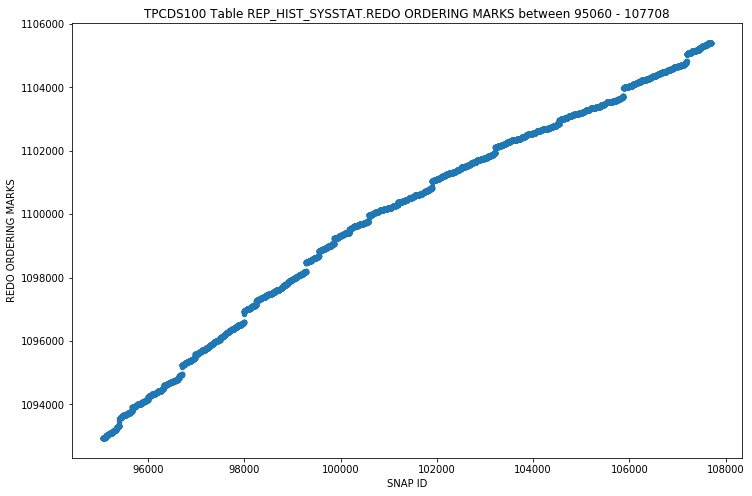

REP_HIST_SYSSTAT - REDO SIZE - STRIPPED SCATTER


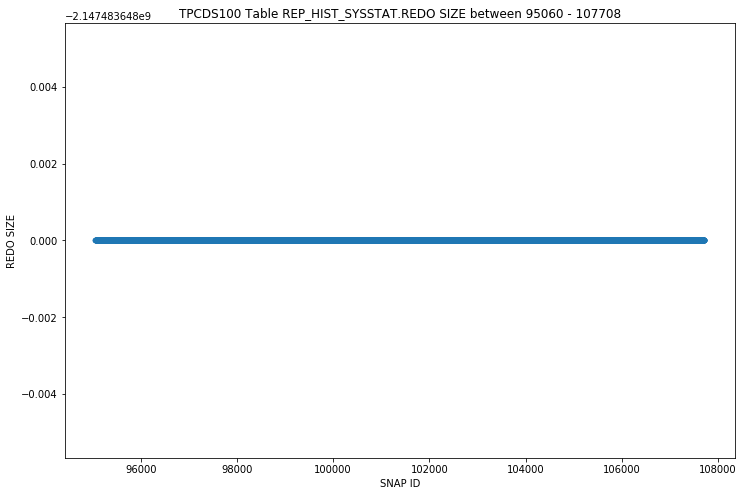

REP_HIST_SYSSTAT - REDO SIZE FOR DIRECT WRITES - STRIPPED SCATTER


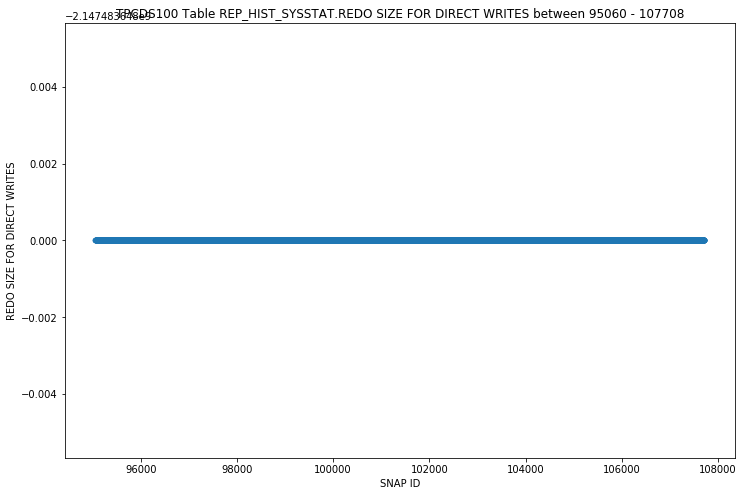

REP_HIST_SYSSTAT - REDO SUBSCN MAX COUNTS - STRIPPED SCATTER


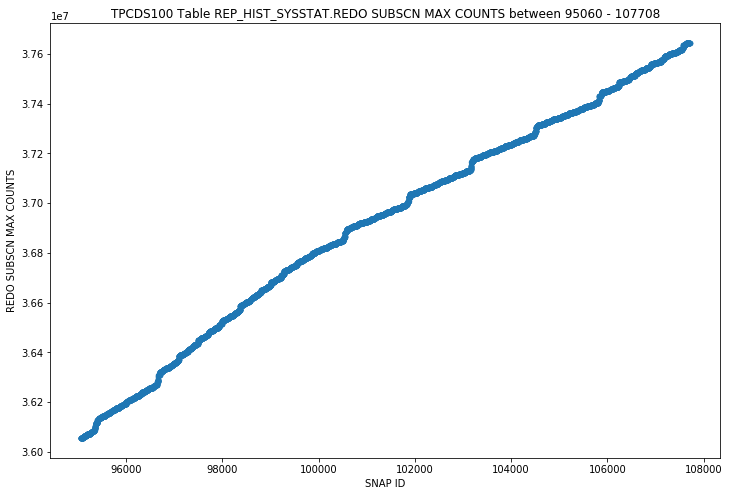

REP_HIST_SYSSTAT - REDO SYNCH LONG WAITS - STRIPPED SCATTER


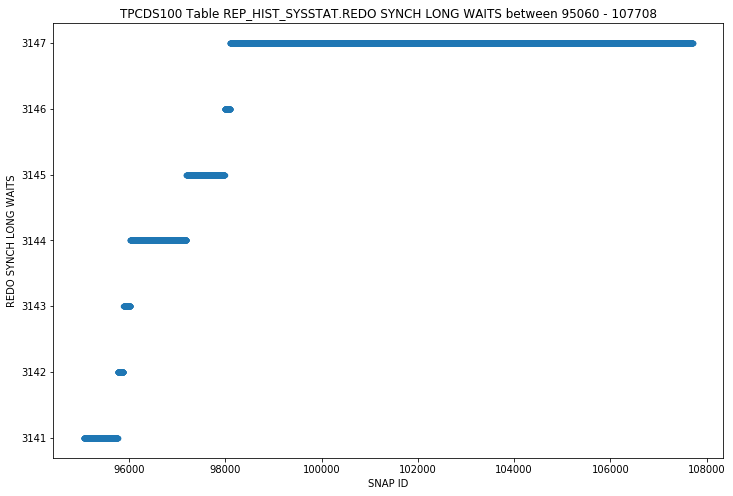

REP_HIST_SYSSTAT - REDO SYNCH TIME - STRIPPED SCATTER


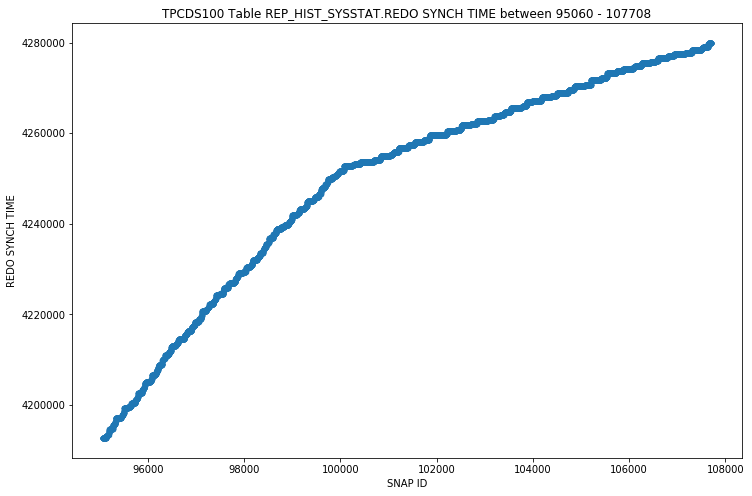

REP_HIST_SYSSTAT - REDO SYNCH TIME (USEC) - STRIPPED SCATTER


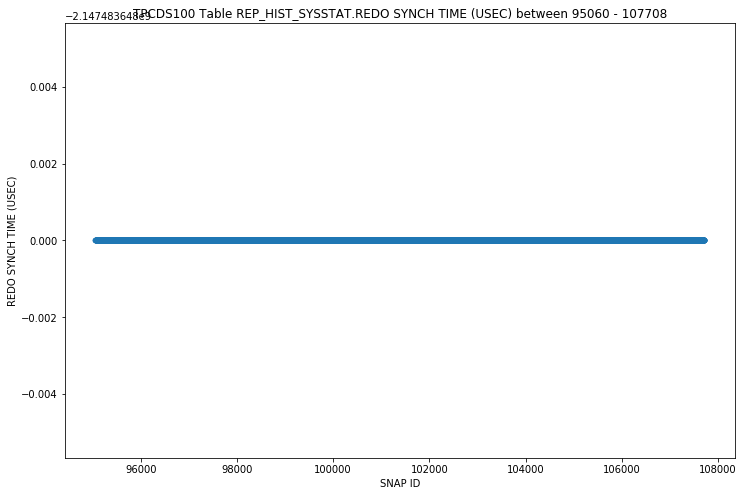

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD (USEC) - STRIPPED SCATTER


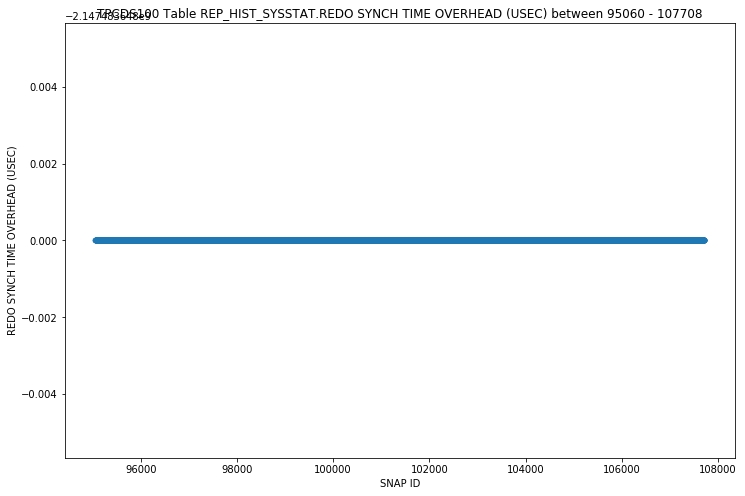

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (  2MS) - STRIPPED SCATTER


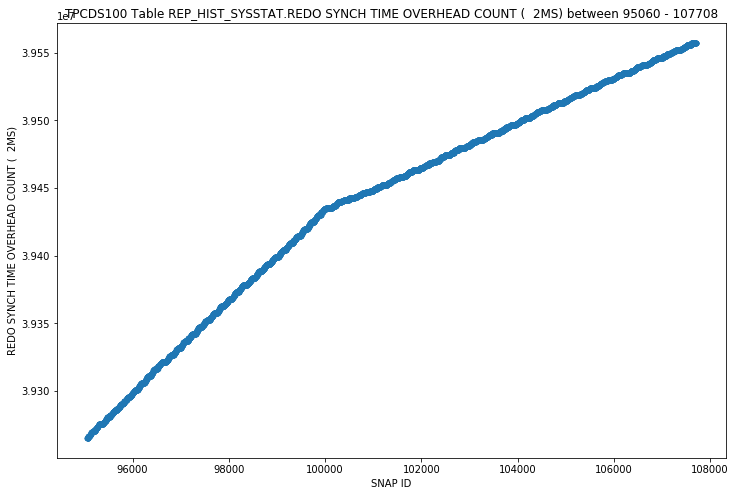

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (  8MS) - STRIPPED SCATTER


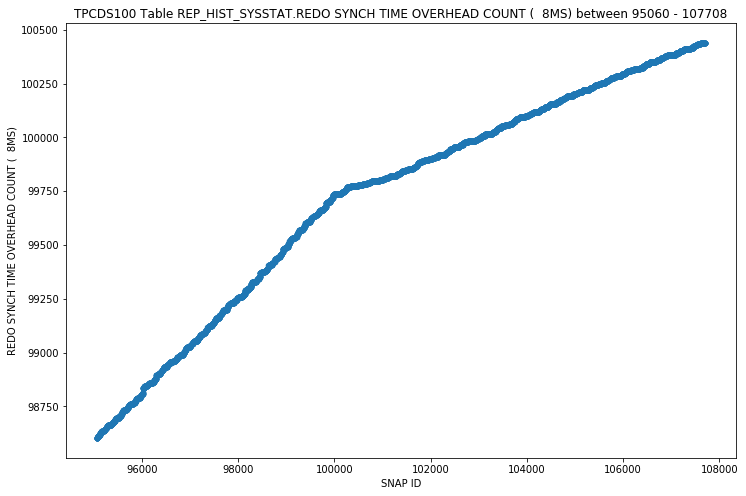

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT ( 32MS) - STRIPPED SCATTER


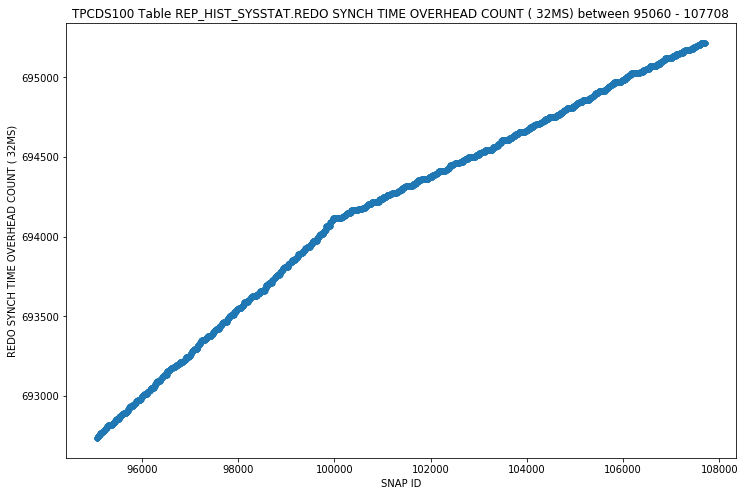

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (128MS) - STRIPPED SCATTER


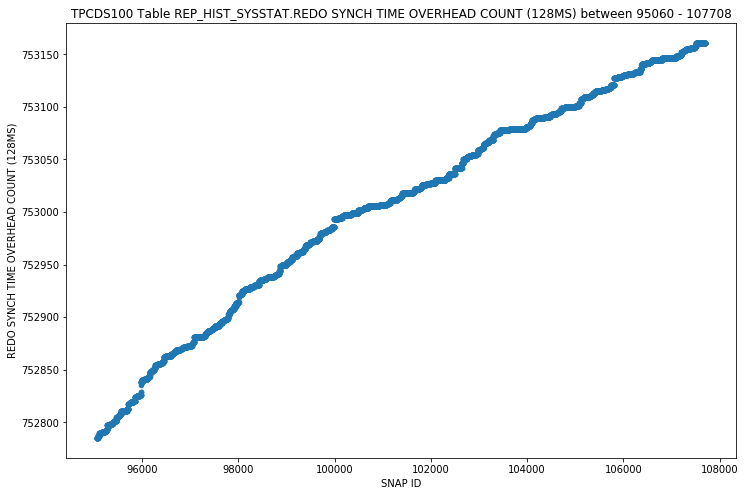

REP_HIST_SYSSTAT - REDO SYNCH TIME OVERHEAD COUNT (INF) - STRIPPED SCATTER


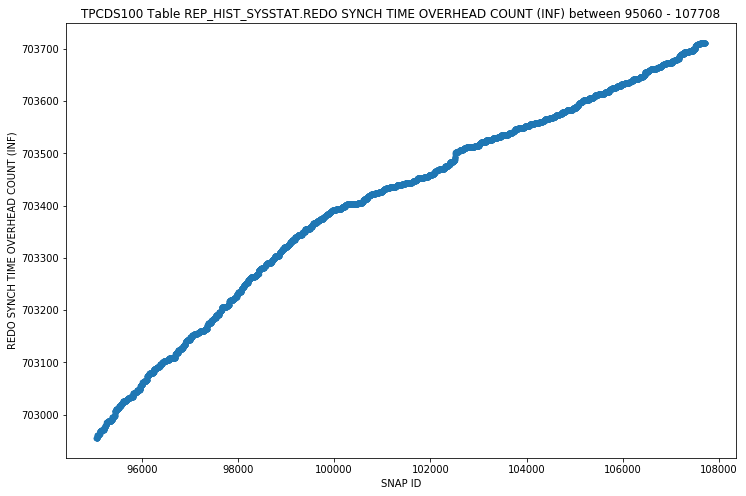

REP_HIST_SYSSTAT - REDO SYNCH WRITES - STRIPPED SCATTER


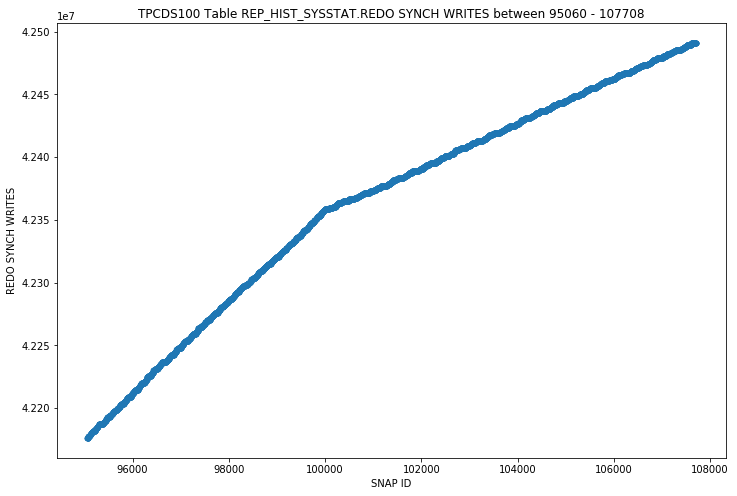

REP_HIST_SYSSTAT - REDO WASTAGE - STRIPPED SCATTER


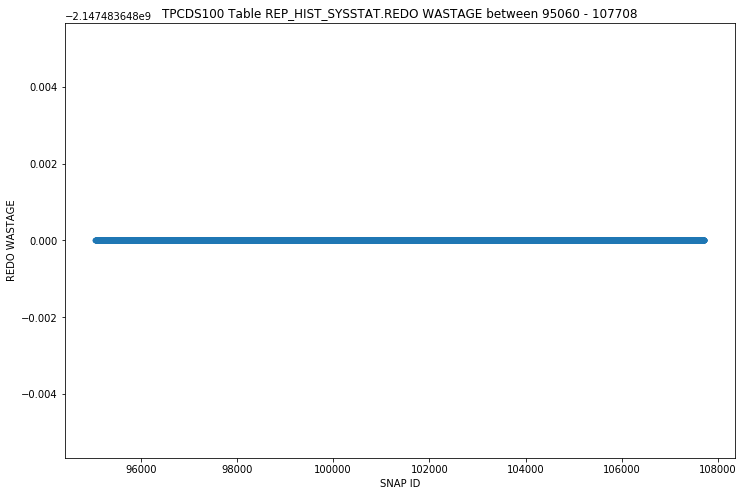

REP_HIST_SYSSTAT - REDO WRITE FINISH TIME - STRIPPED SCATTER


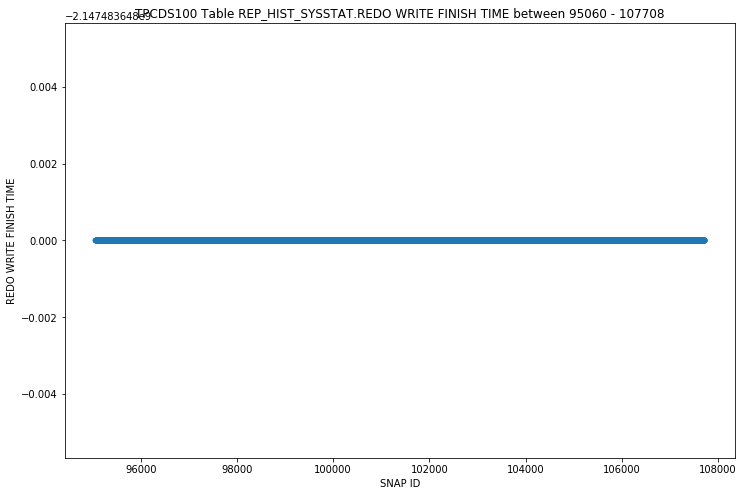

REP_HIST_SYSSTAT - REDO WRITE GATHER TIME - STRIPPED SCATTER


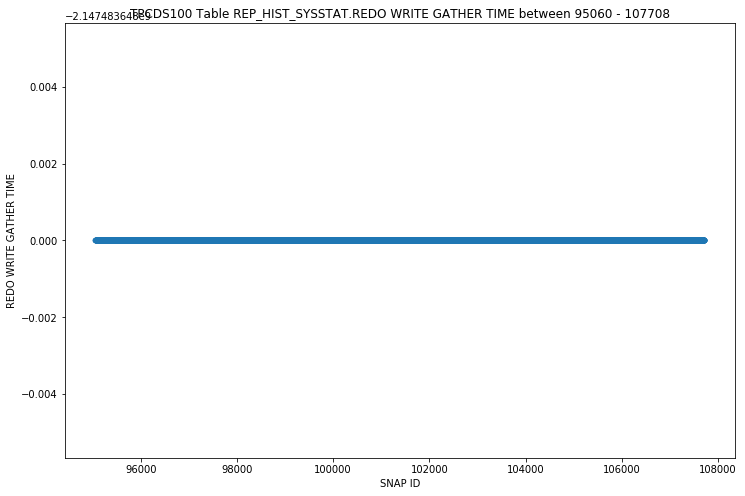

REP_HIST_SYSSTAT - REDO WRITE INFO FIND - STRIPPED SCATTER


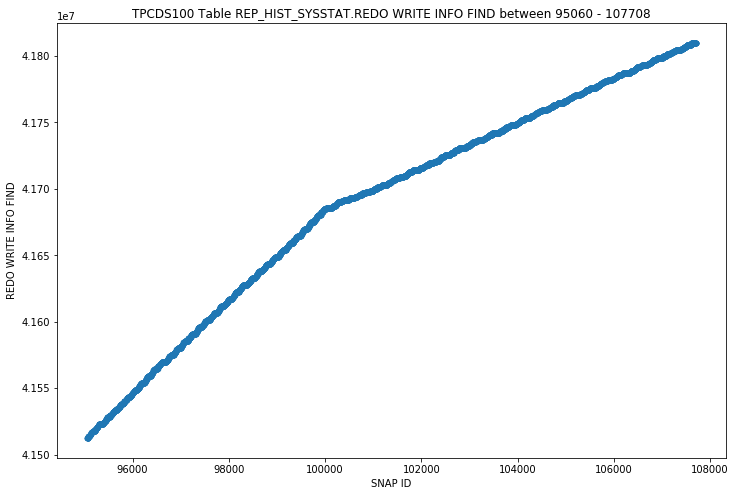

REP_HIST_SYSSTAT - REDO WRITE SCHEDULE TIME - STRIPPED SCATTER


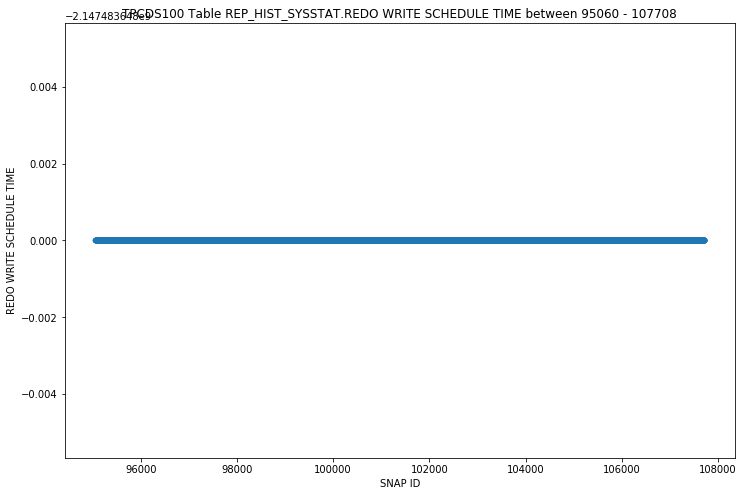

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (   4KB) - STRIPPED SCATTER


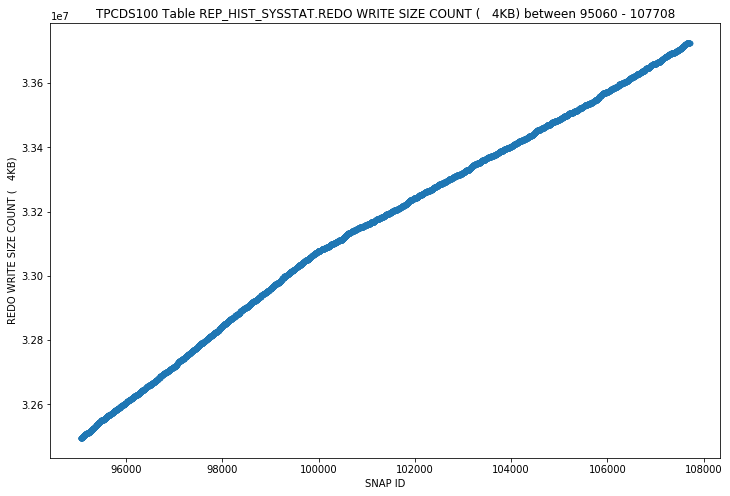

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (   8KB) - STRIPPED SCATTER


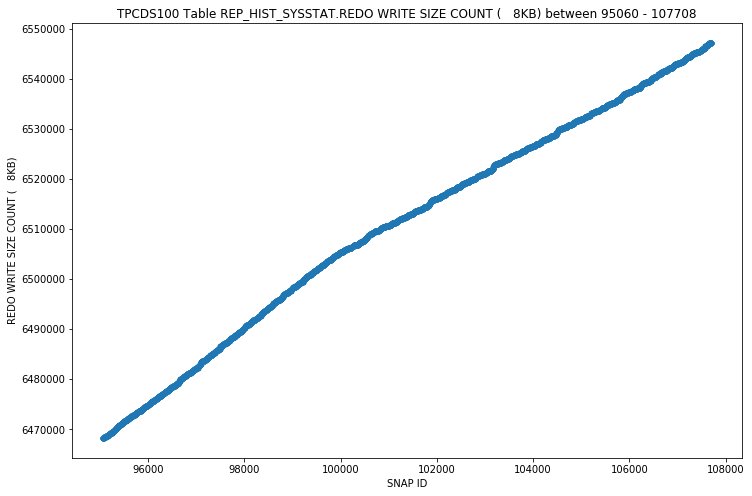

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (  16KB) - STRIPPED SCATTER


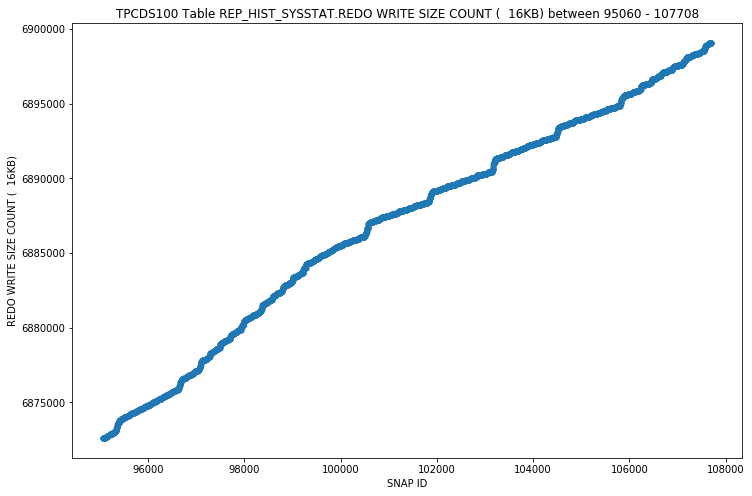

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (  32KB) - STRIPPED SCATTER


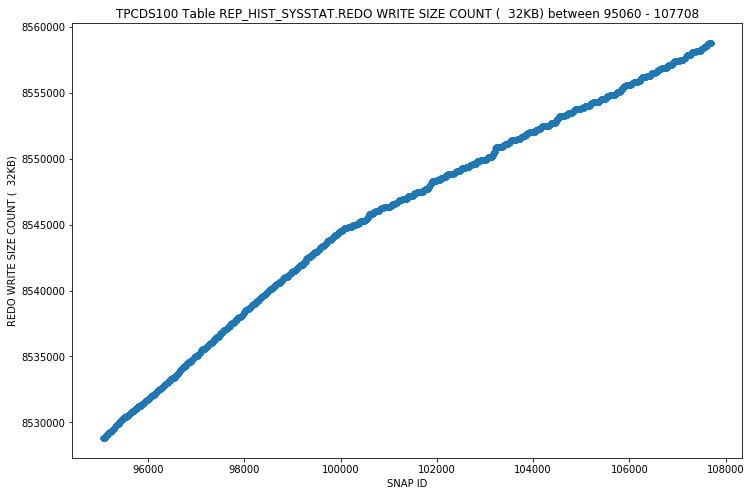

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 128KB) - STRIPPED SCATTER


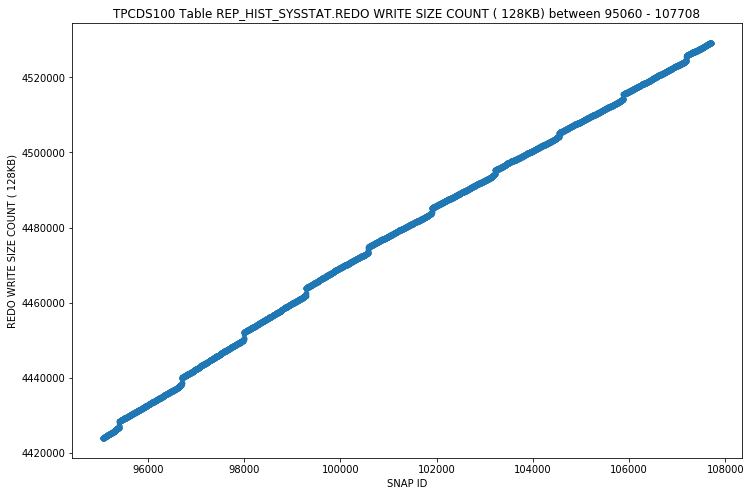

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 256KB) - STRIPPED SCATTER


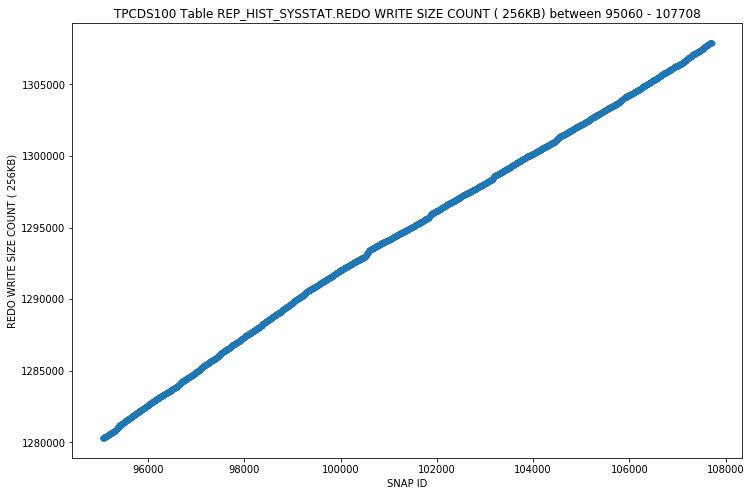

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT ( 512KB) - STRIPPED SCATTER


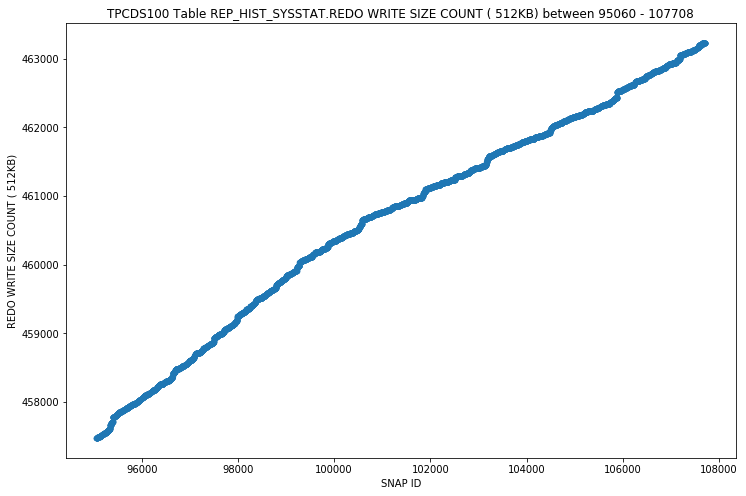

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (1024KB) - STRIPPED SCATTER


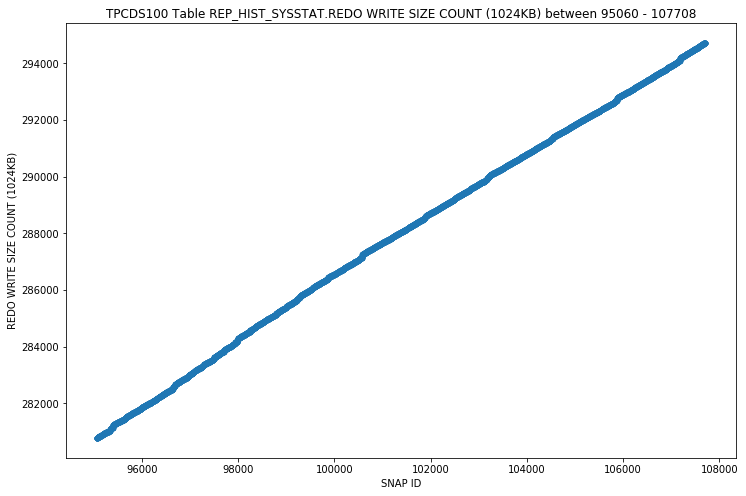

REP_HIST_SYSSTAT - REDO WRITE SIZE COUNT (INF) - STRIPPED SCATTER


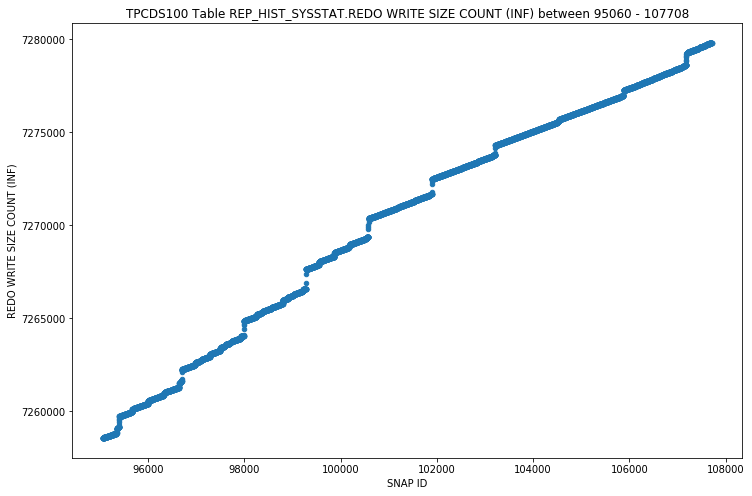

REP_HIST_SYSSTAT - REDO WRITE TIME - STRIPPED SCATTER


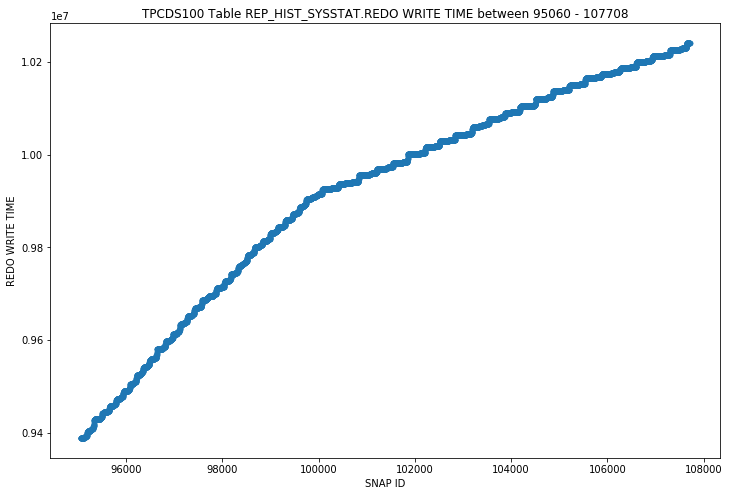

REP_HIST_SYSSTAT - REDO WRITE TIME (USEC) - STRIPPED SCATTER


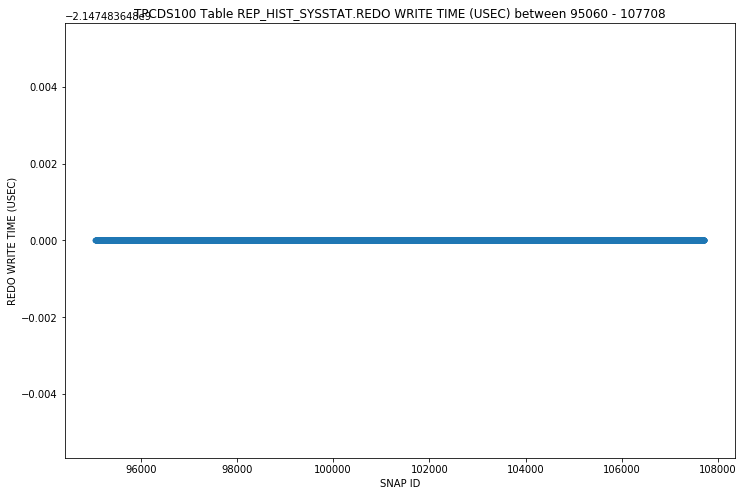

REP_HIST_SYSSTAT - REDO WRITE TOTAL TIME - STRIPPED SCATTER


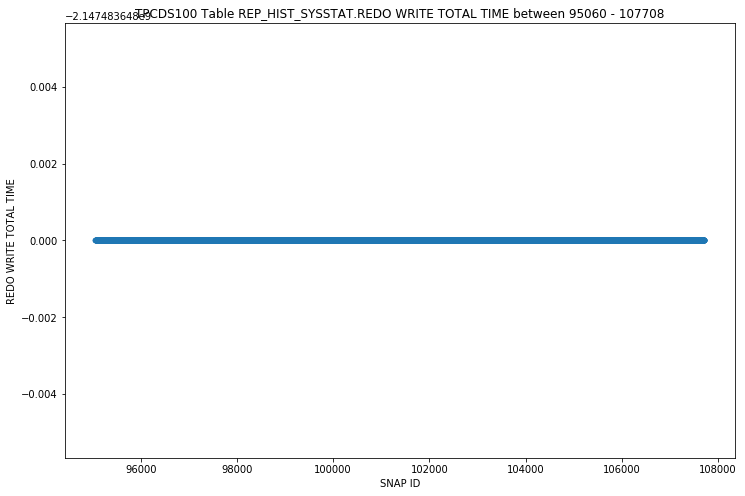

REP_HIST_SYSSTAT - REDO WRITE WORKER DELAY (USEC) - STRIPPED SCATTER


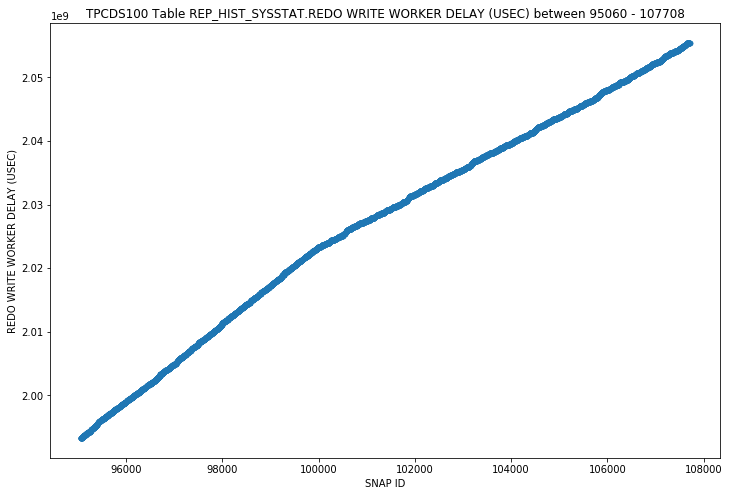

REP_HIST_SYSSTAT - REDO WRITES - STRIPPED SCATTER


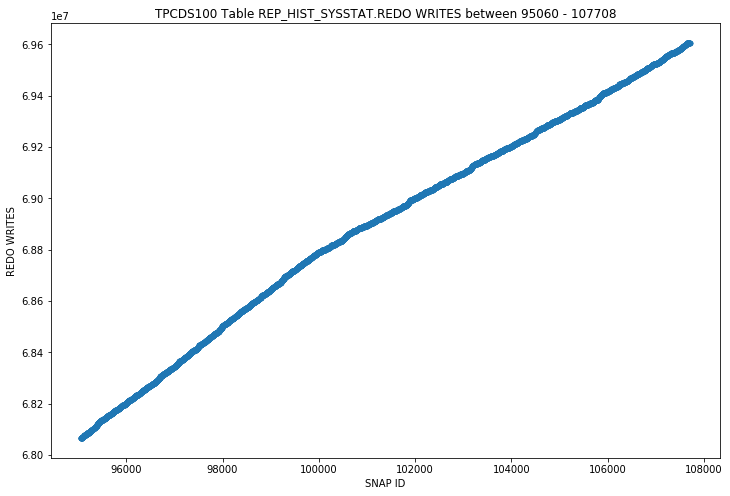

REP_HIST_SYSSTAT - REDO WRITES (GROUP 0) - STRIPPED SCATTER


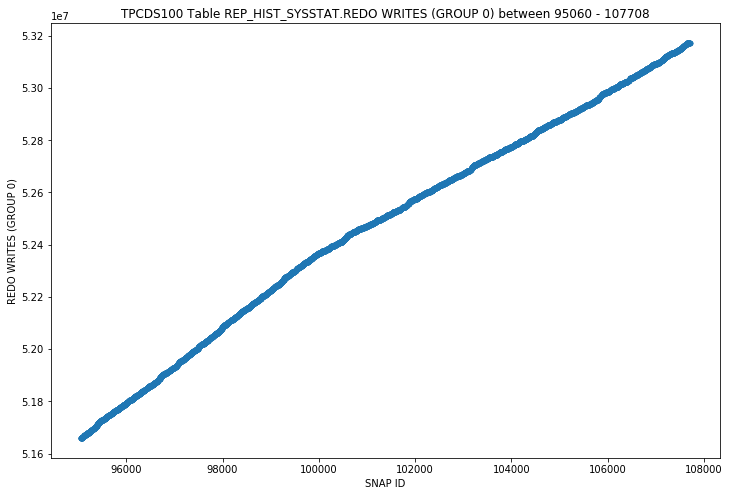

REP_HIST_SYSSTAT - REDO WRITES (GROUP 1) - STRIPPED SCATTER


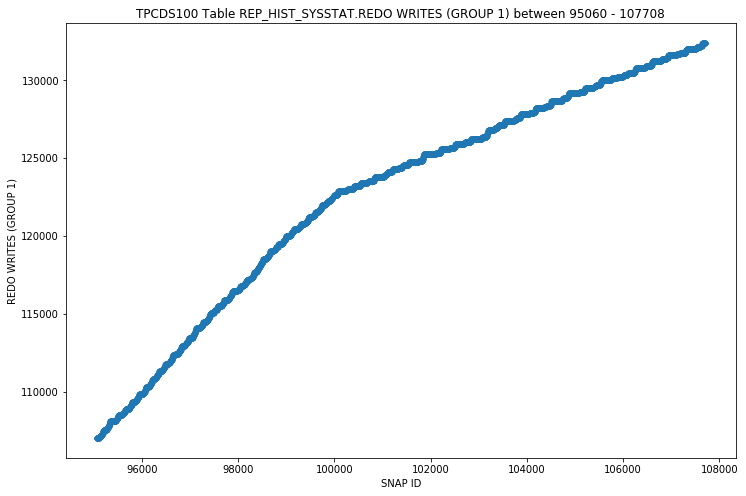

REP_HIST_SYSSTAT - REDO WRITES ADAPTIVE ALL - STRIPPED SCATTER


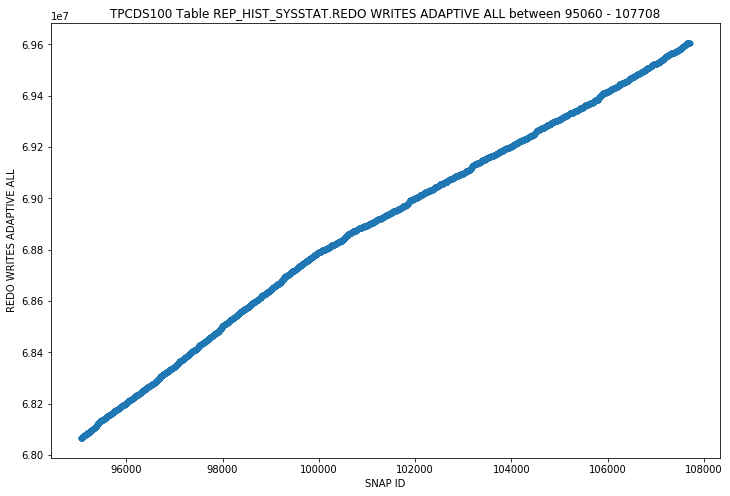

REP_HIST_SYSSTAT - REDO WRITES ADAPTIVE WORKER - STRIPPED SCATTER


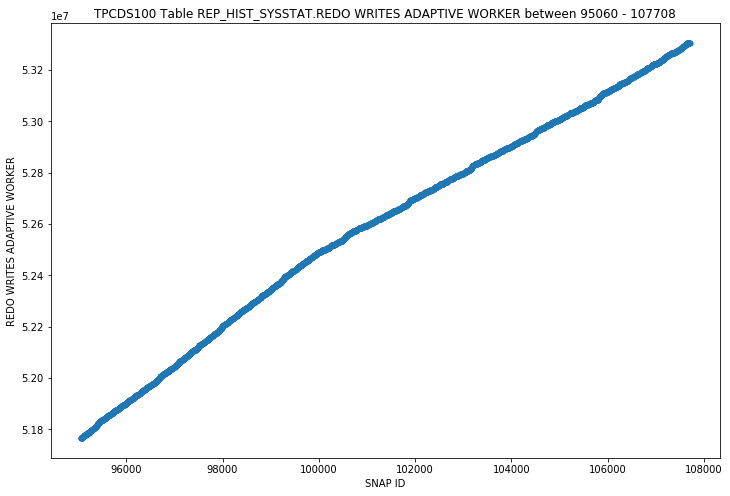

REP_HIST_SYSSTAT - ROLLBACK CHANGES - UNDO RECORDS APPLIED - STRIPPED SCATTER


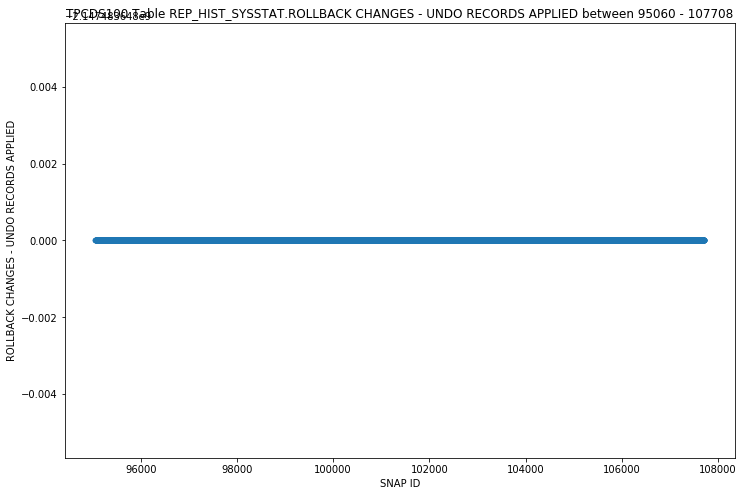

REP_HIST_SYSSTAT - ROLLBACKS ONLY - CONSISTENT READ GETS - STRIPPED SCATTER


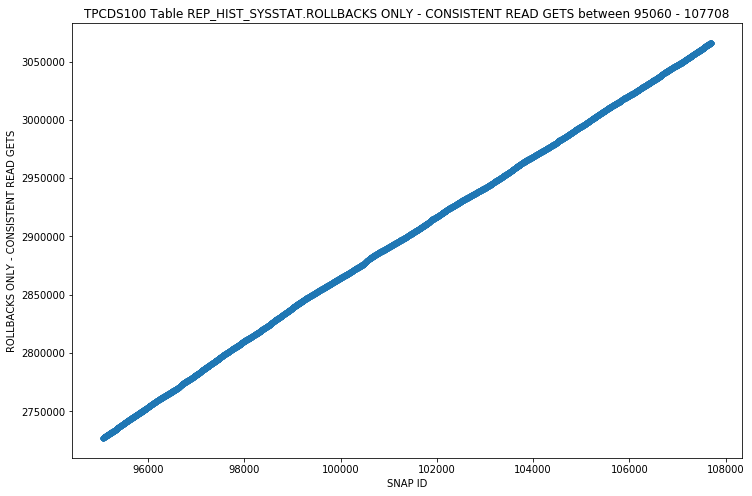

REP_HIST_SYSSTAT - ROOT NODE SPLITS - STRIPPED SCATTER


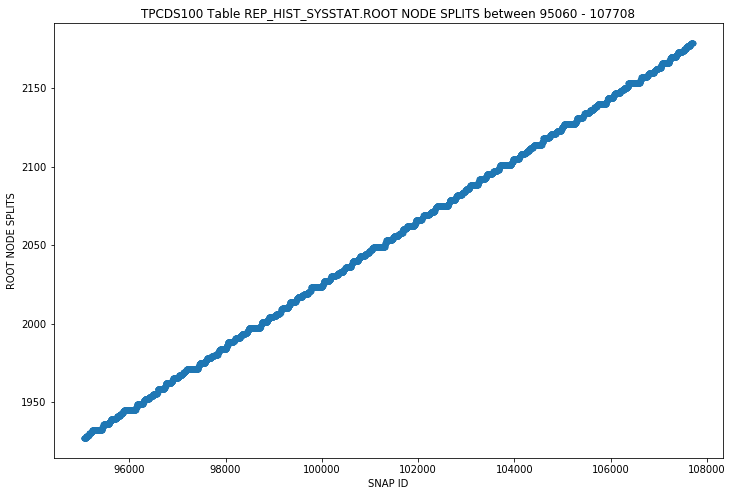

REP_HIST_SYSSTAT - ROWS FETCHED VIA CALLBACK - STRIPPED SCATTER


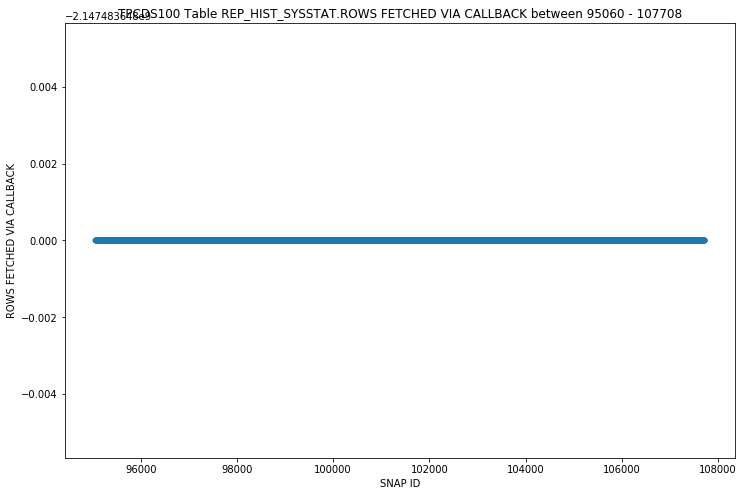

REP_HIST_SYSSTAT - SCHEDULER WAIT TIME - STRIPPED SCATTER


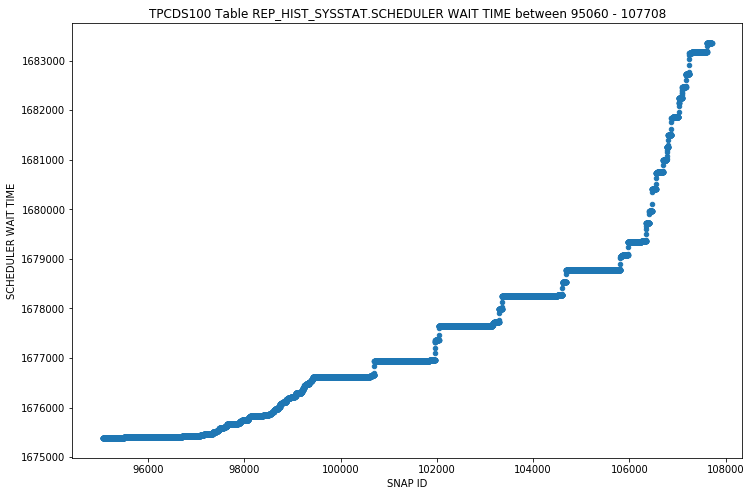

REP_HIST_SYSSTAT - SECUREFILE ALLOCATION BYTES - STRIPPED SCATTER


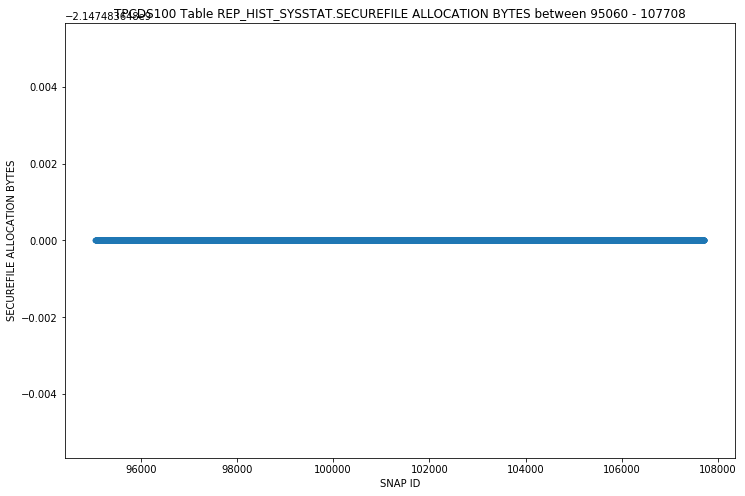

REP_HIST_SYSSTAT - SECUREFILE ALLOCATION CHUNKS - STRIPPED SCATTER


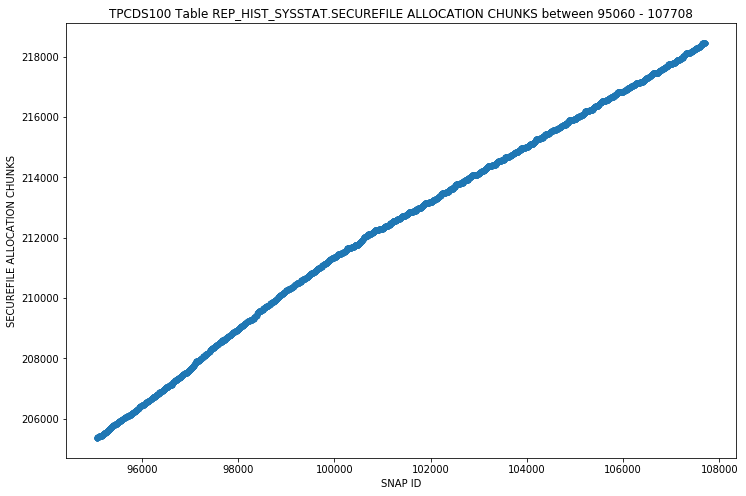

REP_HIST_SYSSTAT - SECUREFILE BYTES NON-TRANSFORMED - STRIPPED SCATTER


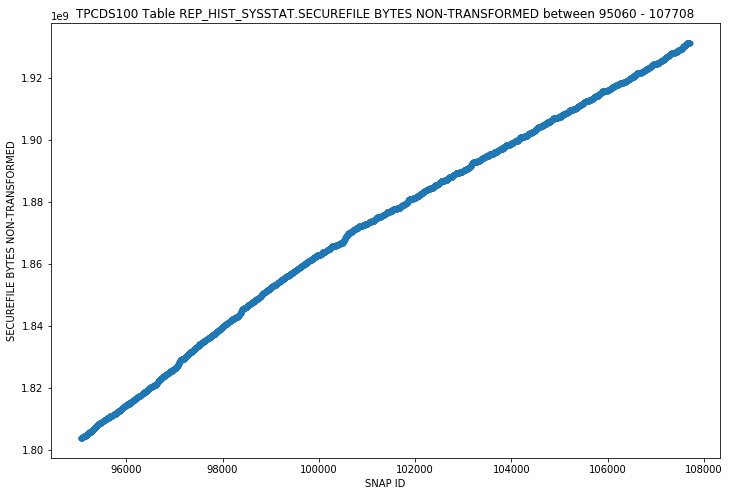

REP_HIST_SYSSTAT - SECUREFILE DIRECT READ BYTES - STRIPPED SCATTER


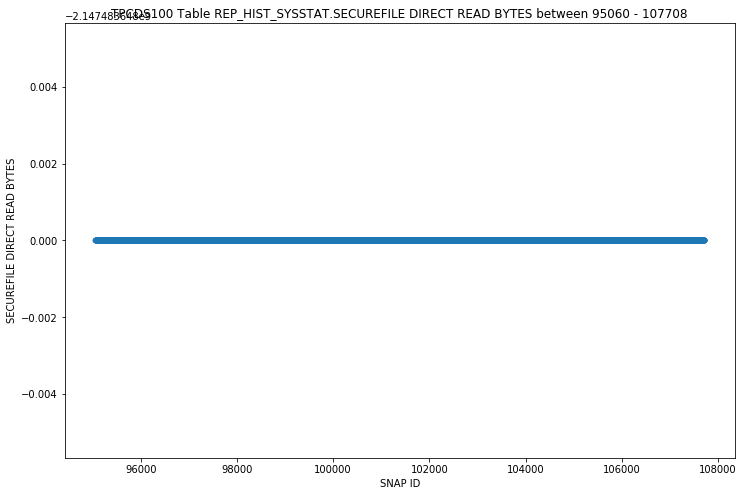

REP_HIST_SYSSTAT - SECUREFILE DIRECT READ OPS - STRIPPED SCATTER


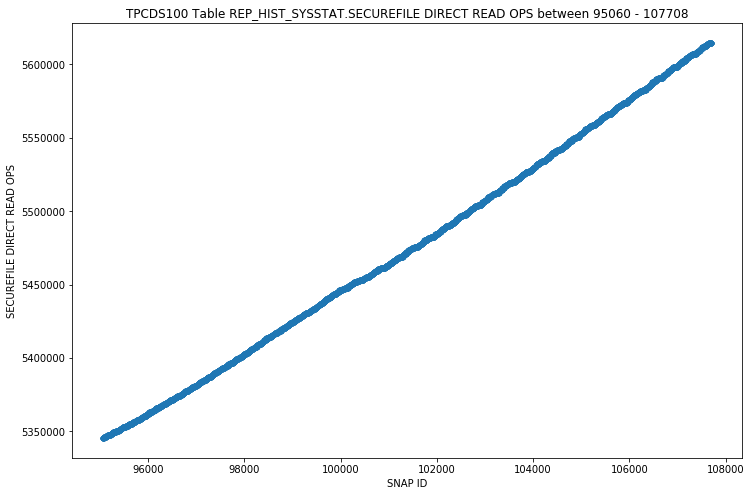

REP_HIST_SYSSTAT - SECUREFILE DIRECT WRITE BYTES - STRIPPED SCATTER


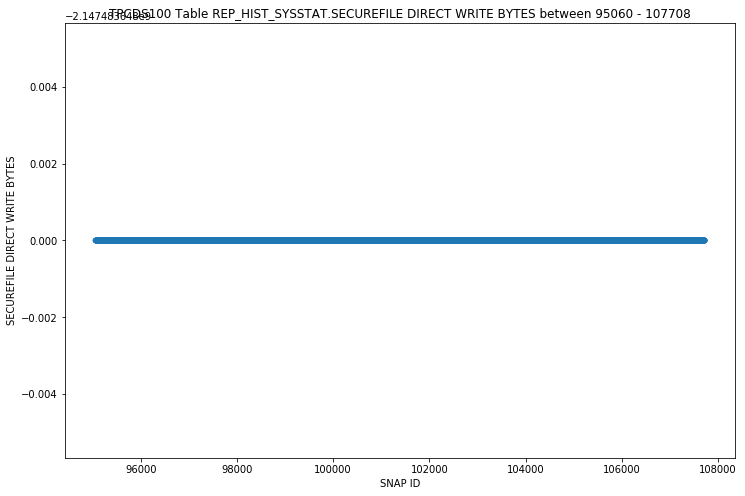

REP_HIST_SYSSTAT - SECUREFILE DIRECT WRITE OPS - STRIPPED SCATTER


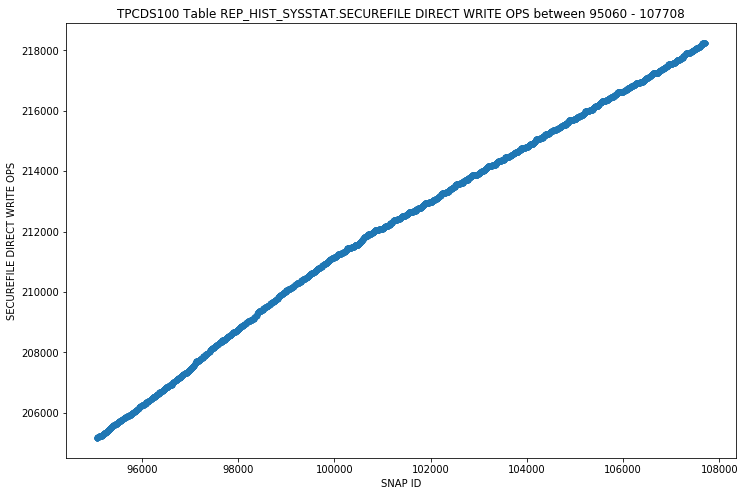

REP_HIST_SYSSTAT - SECUREFILE NUMBER OF NON-TRANSFORMED FLUSHES - STRIPPED SCATTER


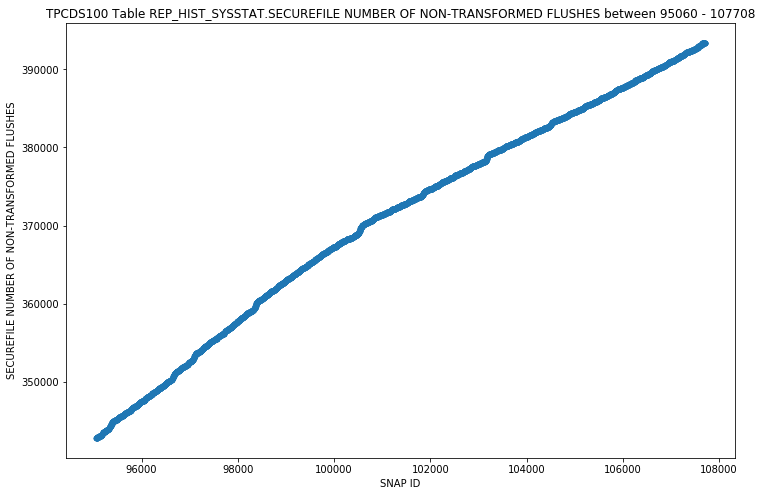

REP_HIST_SYSSTAT - SEGMENT CFS ALLOCATIONS - STRIPPED SCATTER


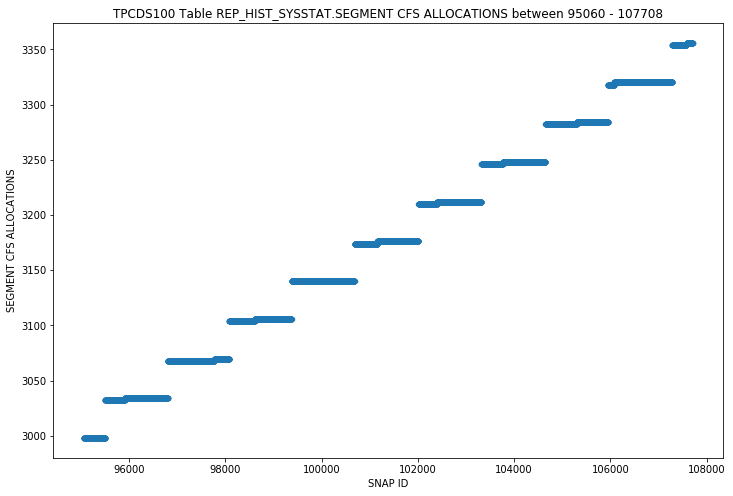

REP_HIST_SYSSTAT - SEGMENT CHUNKS ALLOCATION FROM DISEPNSER - STRIPPED SCATTER


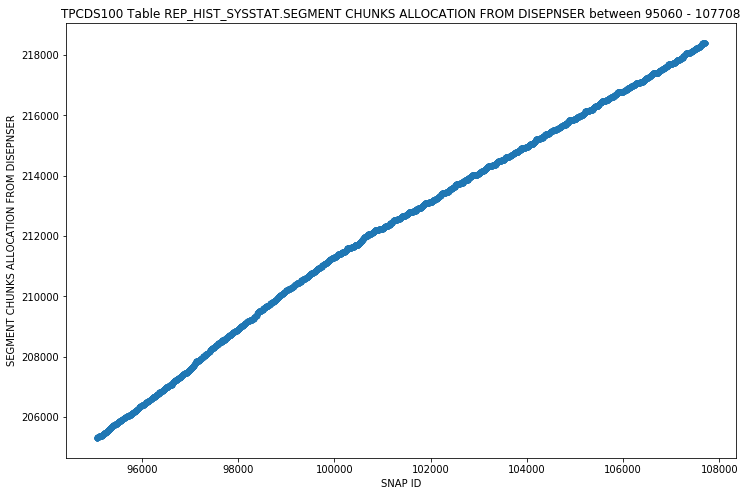

REP_HIST_SYSSTAT - SEGMENT DISPENSER ALLOCATIONS - STRIPPED SCATTER


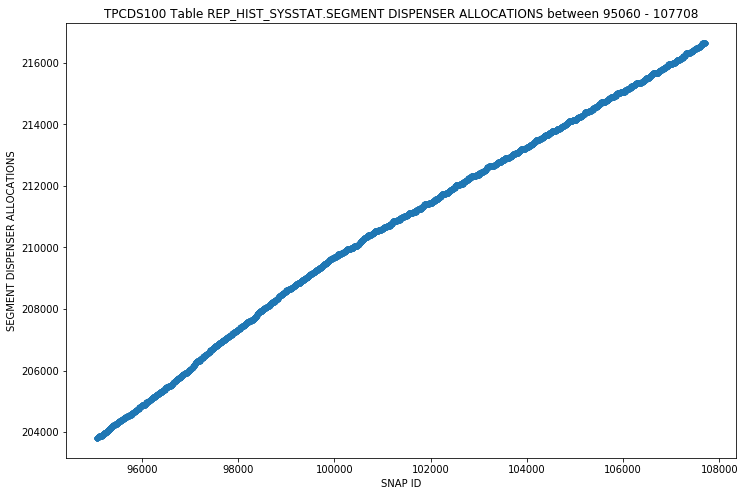

REP_HIST_SYSSTAT - SEGMENT DISPENSER LOAD EMPTY - STRIPPED SCATTER


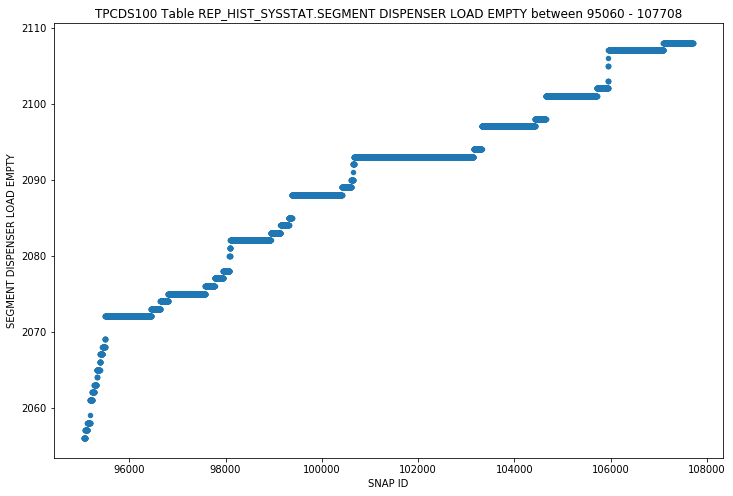

REP_HIST_SYSSTAT - SEGMENT DISPENSER LOAD TASKS - STRIPPED SCATTER


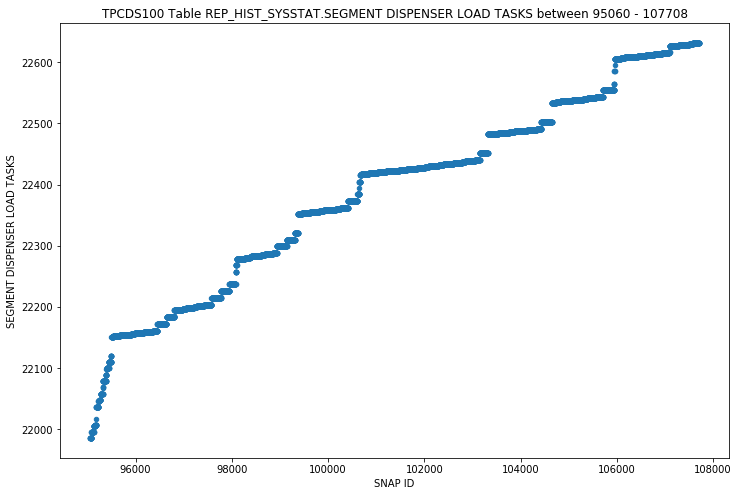

REP_HIST_SYSSTAT - SEGMENT PREALLOC BYTES - STRIPPED SCATTER


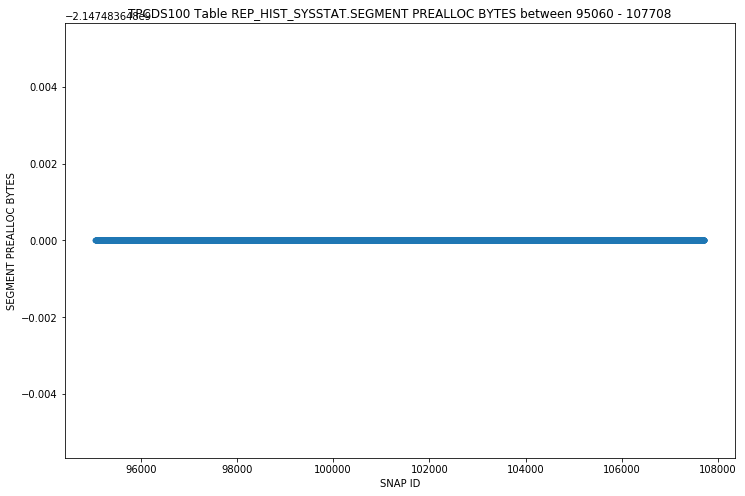

REP_HIST_SYSSTAT - SEGMENT PREALLOC OPS - STRIPPED SCATTER


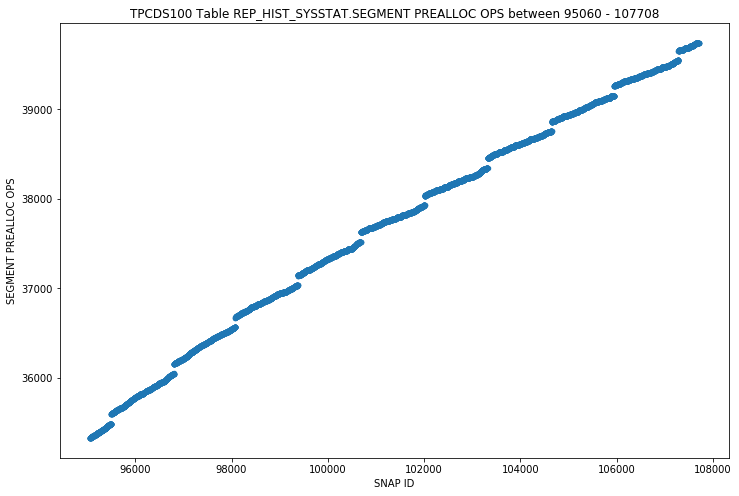

REP_HIST_SYSSTAT - SEGMENT PREALLOC TASKS - STRIPPED SCATTER


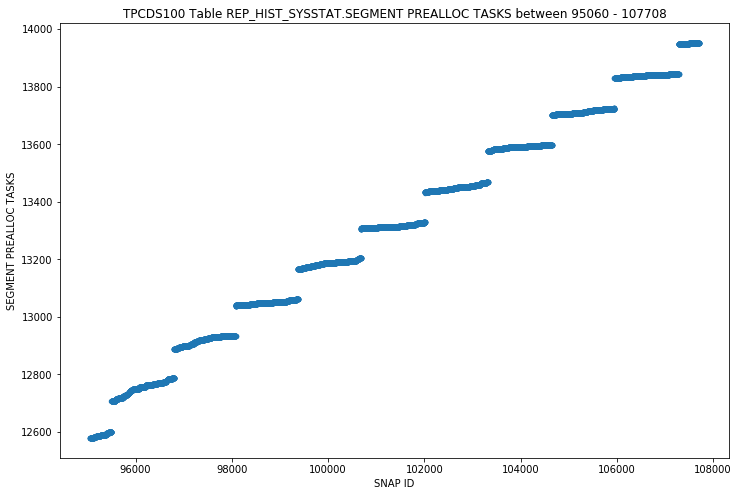

REP_HIST_SYSSTAT - SEGMENT PREALLOC TIME (MS) - STRIPPED SCATTER


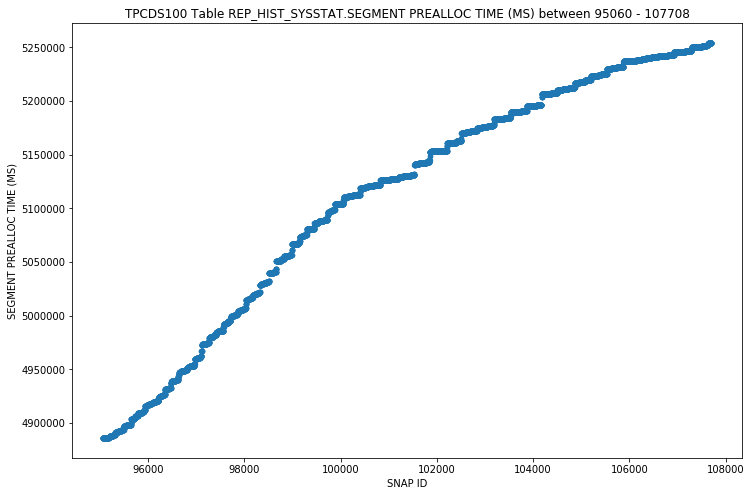

REP_HIST_SYSSTAT - SEGMENT PREALLOC UFS2CFS BYTES - STRIPPED SCATTER


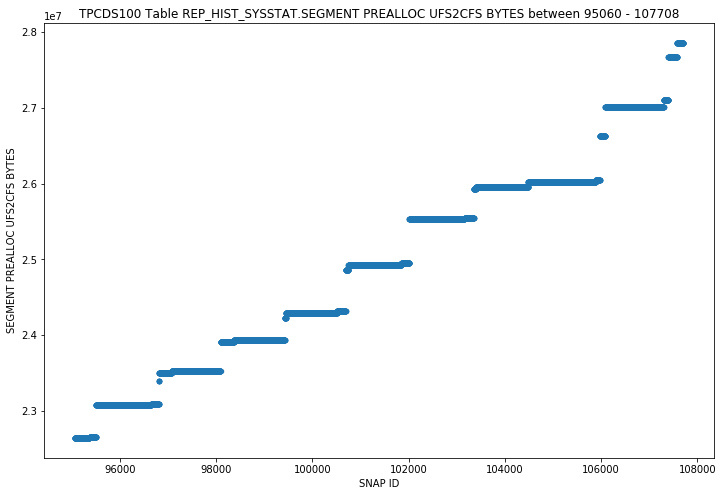

REP_HIST_SYSSTAT - SEGMENT TOTAL CHUNK ALLOCATION - STRIPPED SCATTER


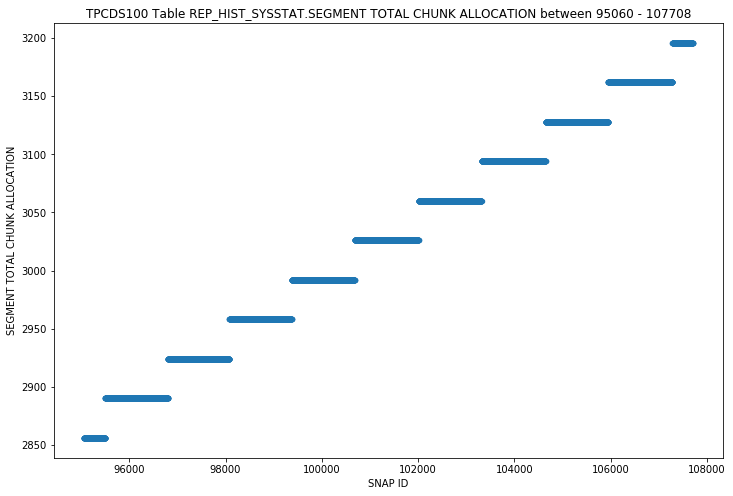

REP_HIST_SYSSTAT - SESSION CONNECT TIME - STRIPPED SCATTER


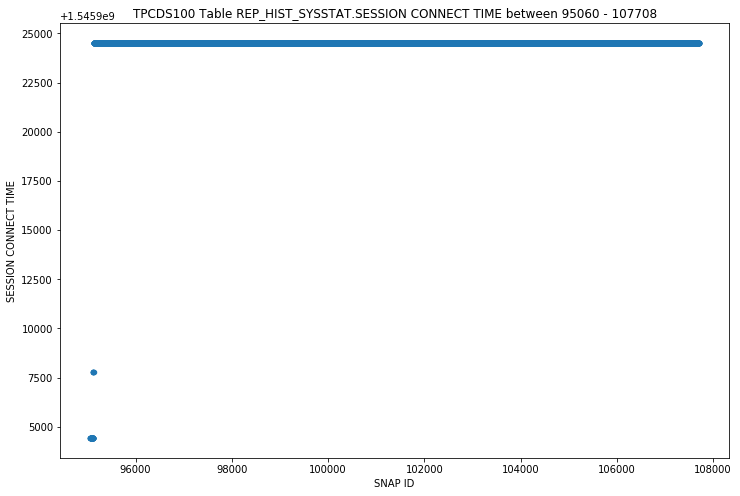

REP_HIST_SYSSTAT - SESSION CURSOR CACHE COUNT - STRIPPED SCATTER


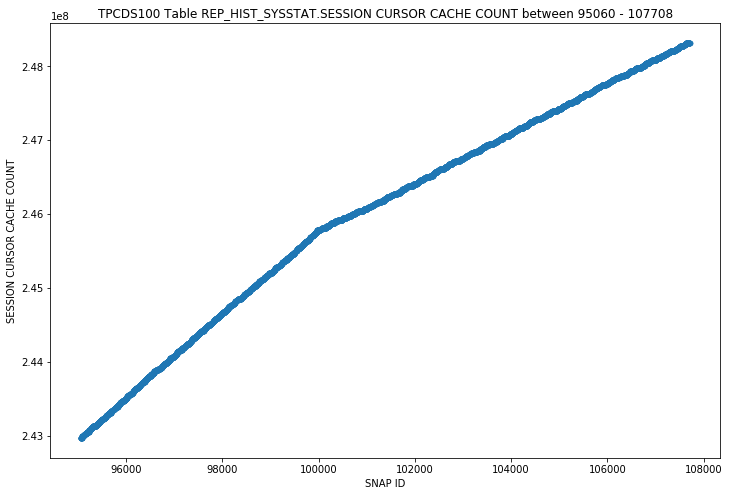

REP_HIST_SYSSTAT - SESSION CURSOR CACHE HITS - STRIPPED SCATTER


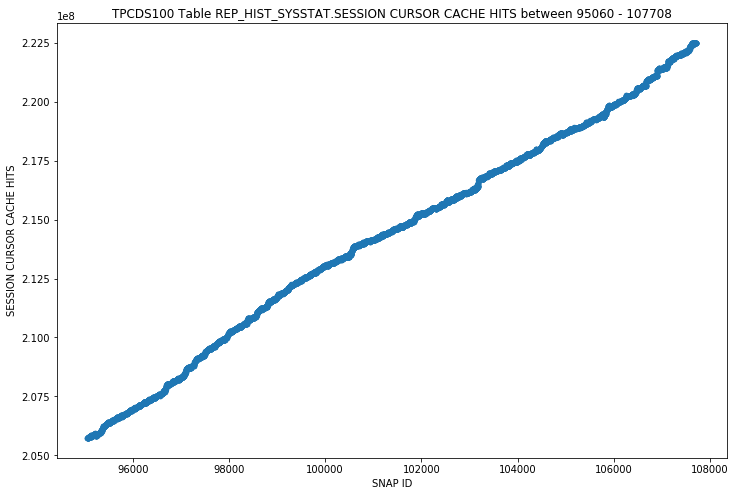

REP_HIST_SYSSTAT - SESSION LOGICAL READS - STRIPPED SCATTER


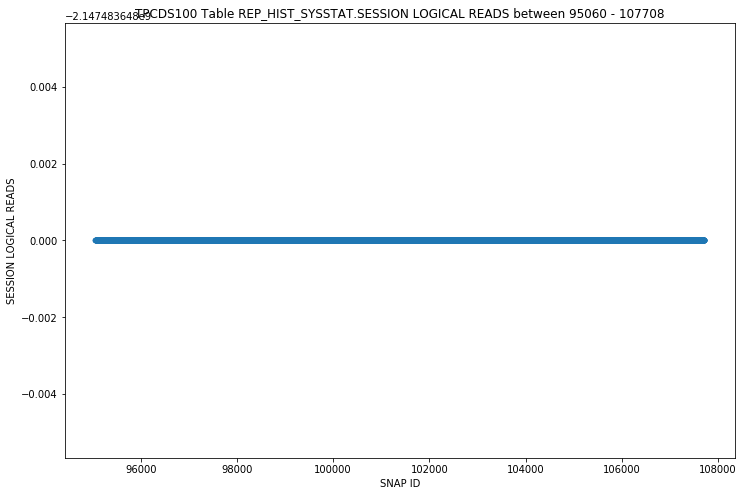

REP_HIST_SYSSTAT - SESSION PGA MEMORY - STRIPPED SCATTER


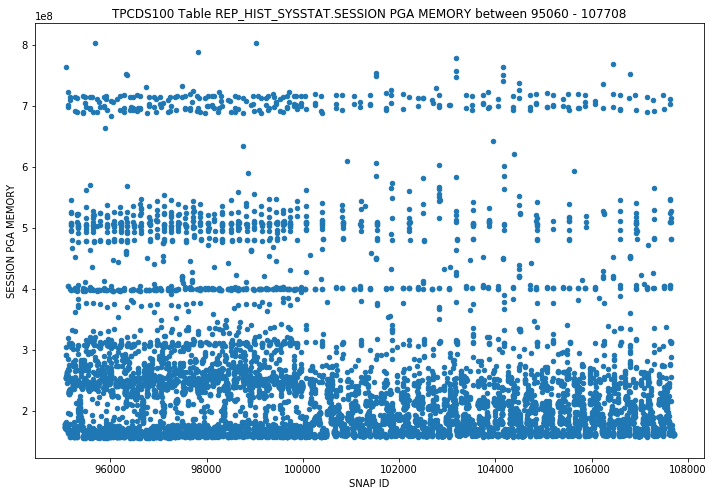

REP_HIST_SYSSTAT - SESSION PGA MEMORY MAX - STRIPPED SCATTER


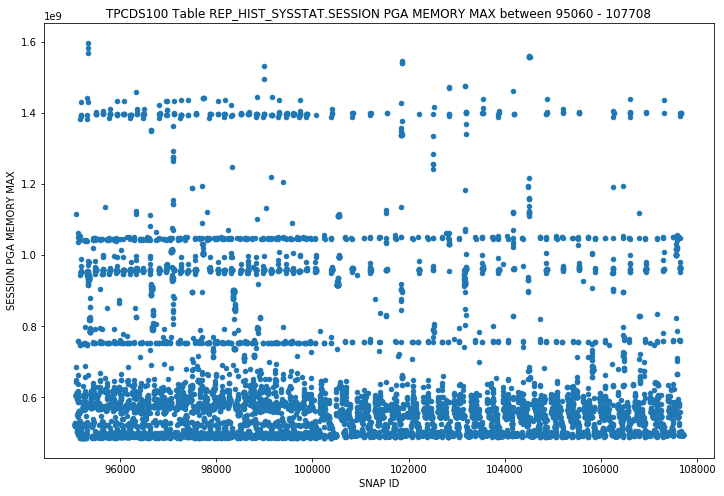

REP_HIST_SYSSTAT - SESSION UGA MEMORY - STRIPPED SCATTER


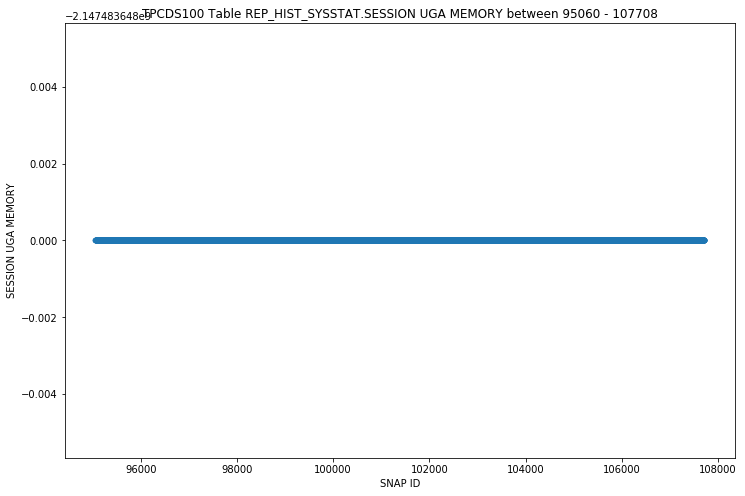

REP_HIST_SYSSTAT - SESSION UGA MEMORY MAX - STRIPPED SCATTER


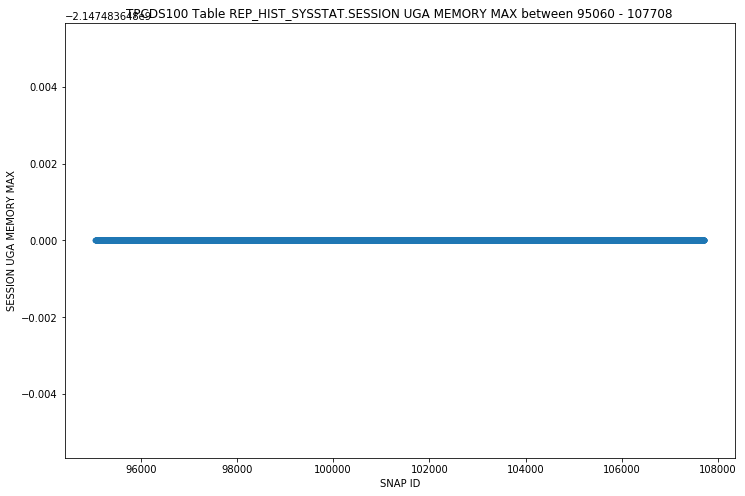

REP_HIST_SYSSTAT - SHARED HASH LATCH UPGRADES - NO WAIT - STRIPPED SCATTER


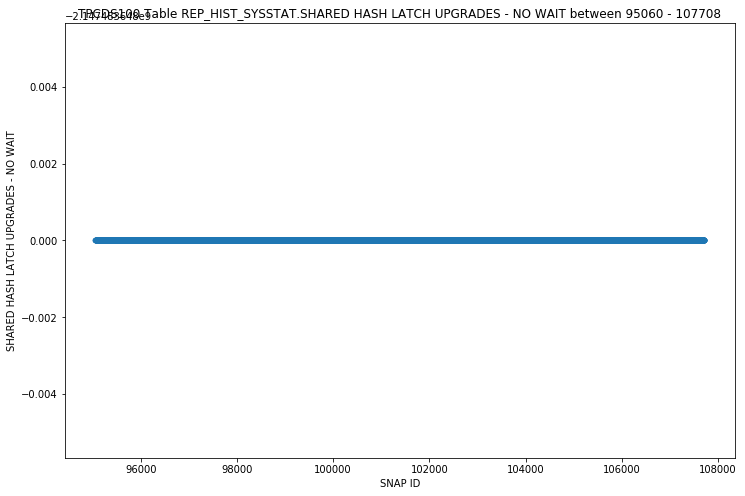

REP_HIST_SYSSTAT - SHARED HASH LATCH UPGRADES - WAIT - STRIPPED SCATTER


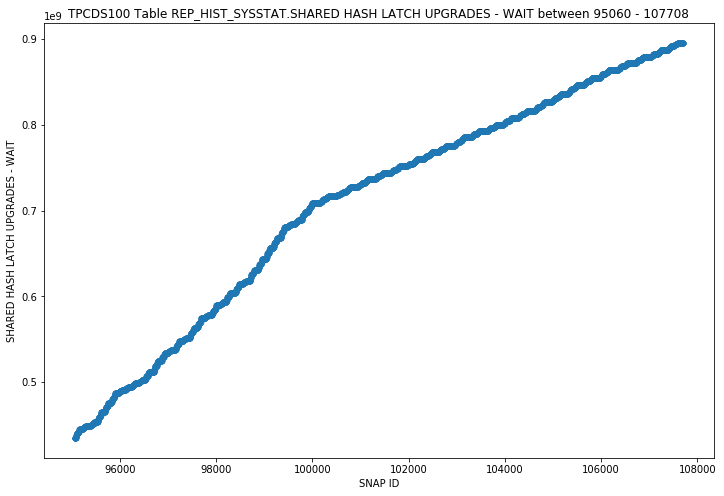

REP_HIST_SYSSTAT - SHARED IO POOL BUFFER GET SUCCESS - STRIPPED SCATTER


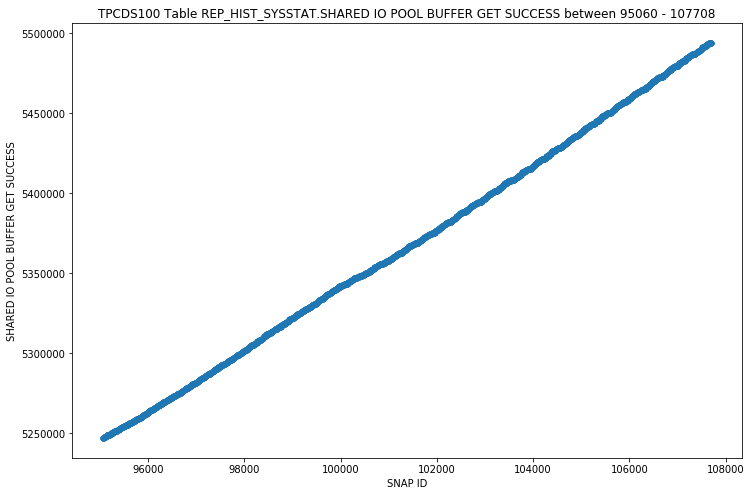

REP_HIST_SYSSTAT - SORTS (DISK) - STRIPPED SCATTER


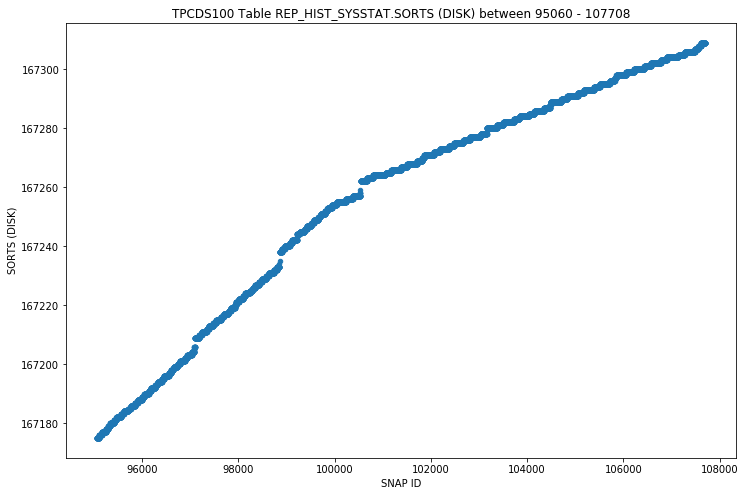

REP_HIST_SYSSTAT - SORTS (MEMORY) - STRIPPED SCATTER


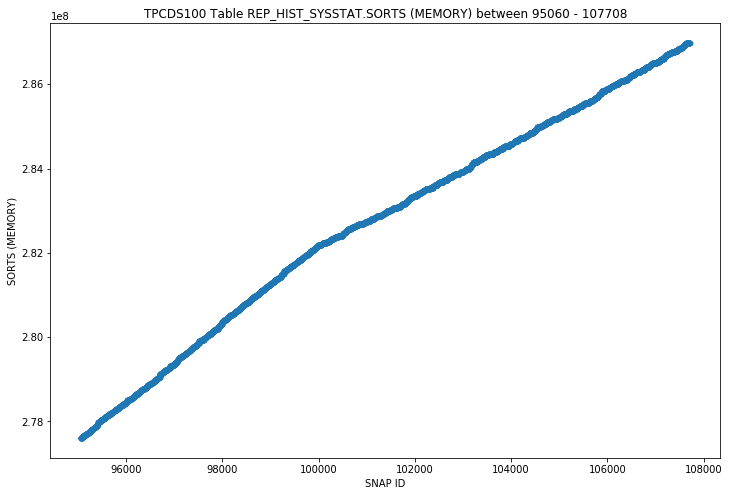

REP_HIST_SYSSTAT - SORTS (ROWS) - STRIPPED SCATTER


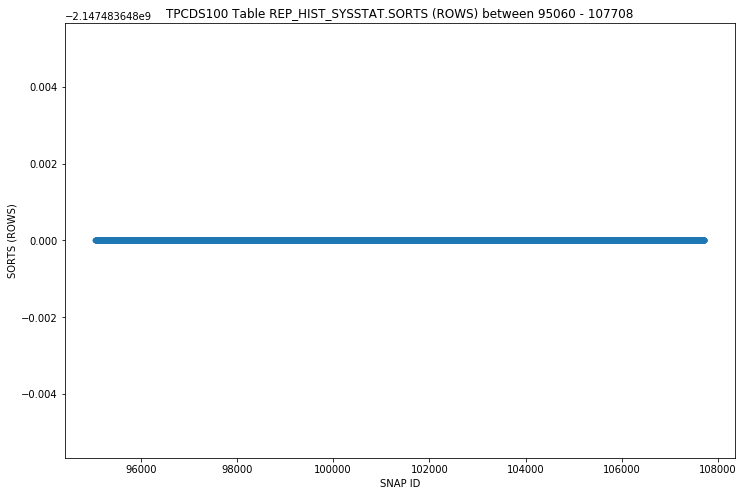

REP_HIST_SYSSTAT - SQL AREA EVICTED - STRIPPED SCATTER


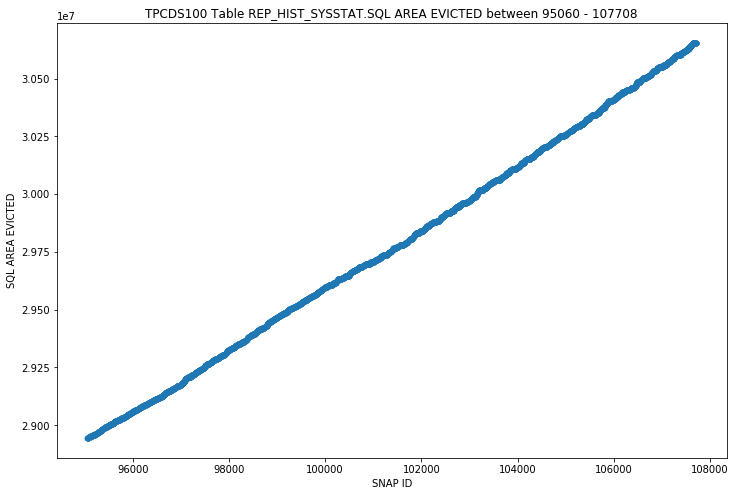

REP_HIST_SYSSTAT - SQL AREA PURGED - STRIPPED SCATTER


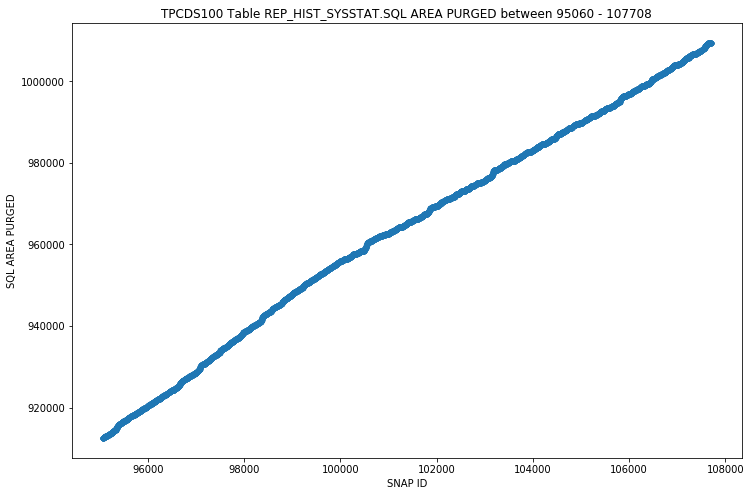

REP_HIST_SYSSTAT - STEPS OF TUNE DOWN RET. IN SPACE PRESSURE - STRIPPED SCATTER


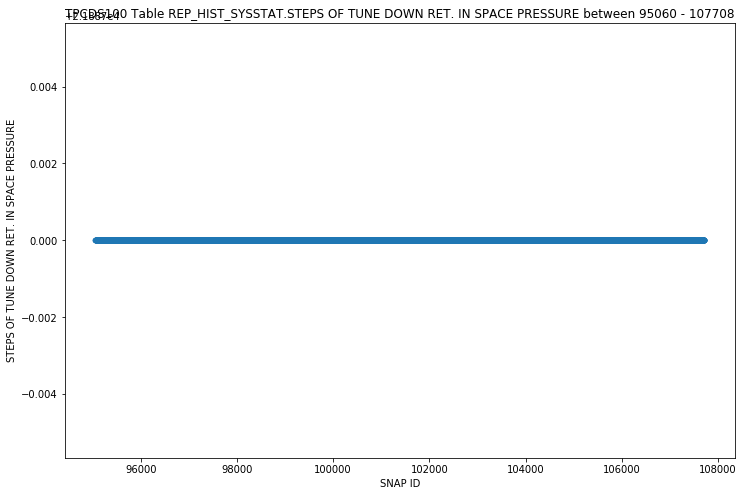

REP_HIST_SYSSTAT - SUMMED DIRTY QUEUE LENGTH - STRIPPED SCATTER


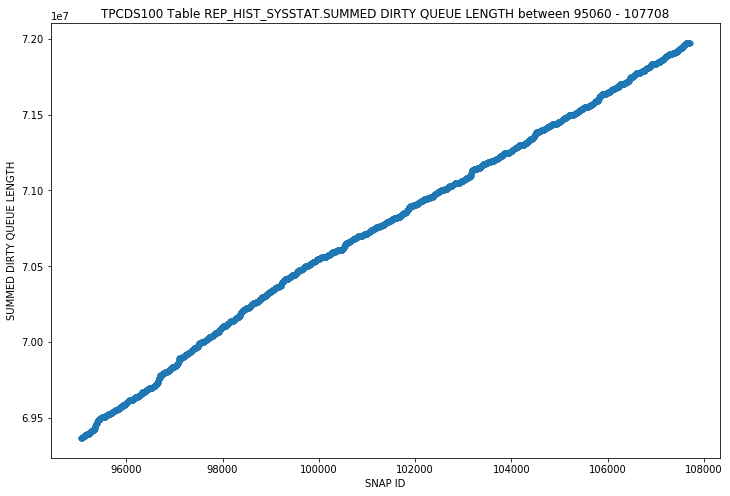

REP_HIST_SYSSTAT - SWITCH CURRENT TO NEW BUFFER - STRIPPED SCATTER


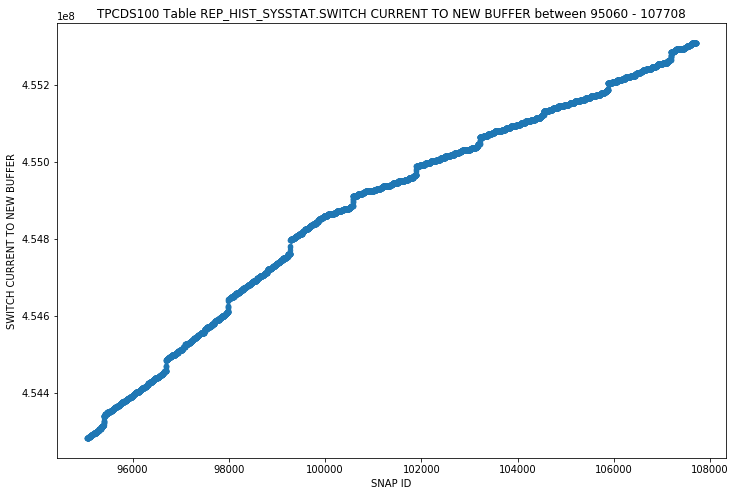

REP_HIST_SYSSTAT - TABLE FETCH BY ROWID - STRIPPED SCATTER


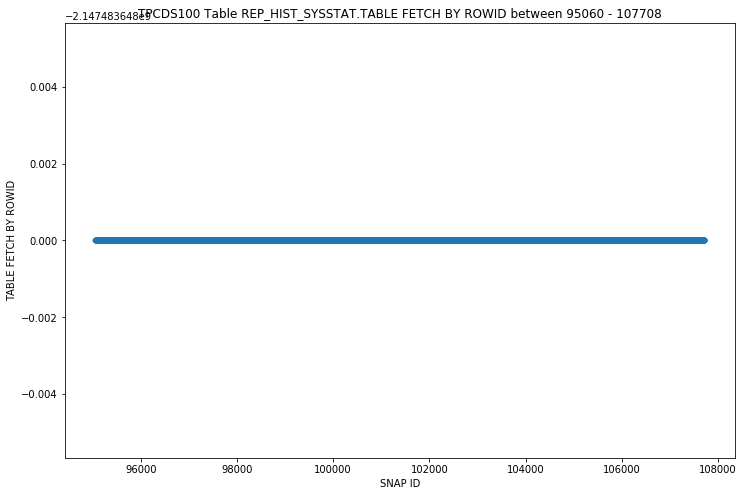

REP_HIST_SYSSTAT - TABLE FETCH CONTINUED ROW - STRIPPED SCATTER


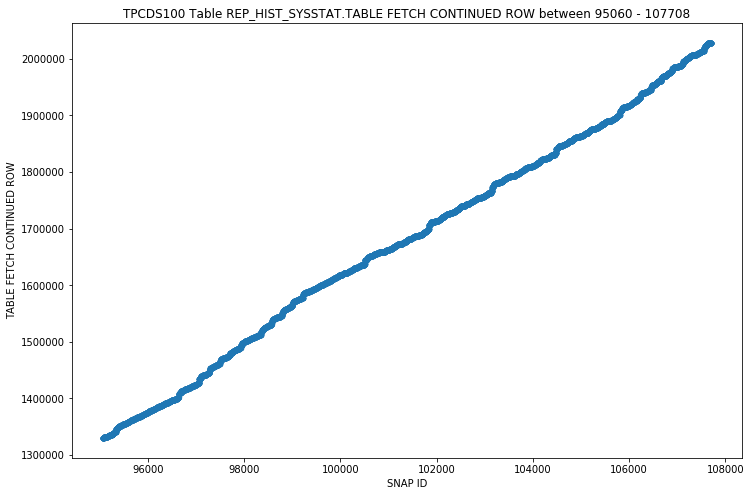

REP_HIST_SYSSTAT - TABLE SCAN BLOCKS GOTTEN - STRIPPED SCATTER


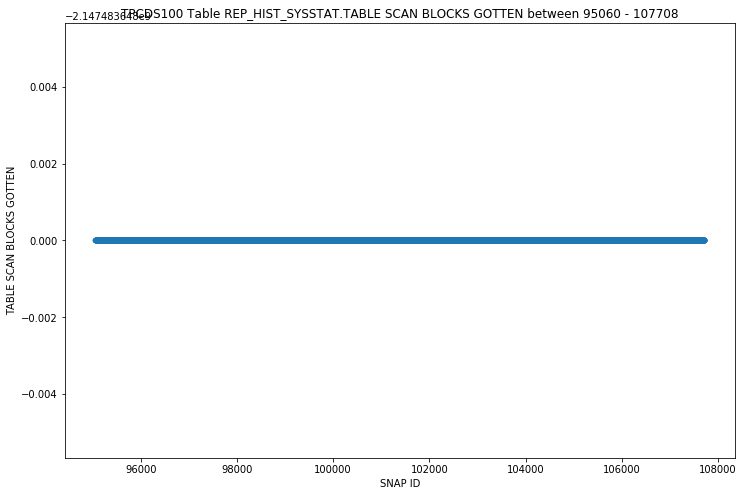

REP_HIST_SYSSTAT - TABLE SCAN DISK NON-IMC ROWS GOTTEN - STRIPPED SCATTER


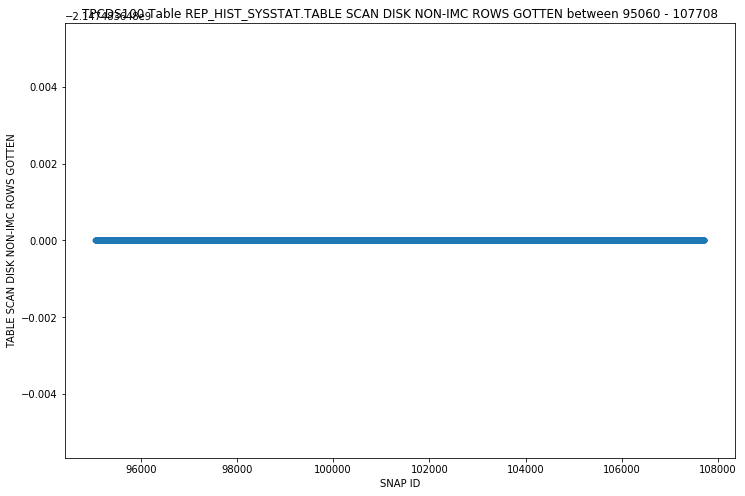

REP_HIST_SYSSTAT - TABLE SCAN ROWS GOTTEN - STRIPPED SCATTER


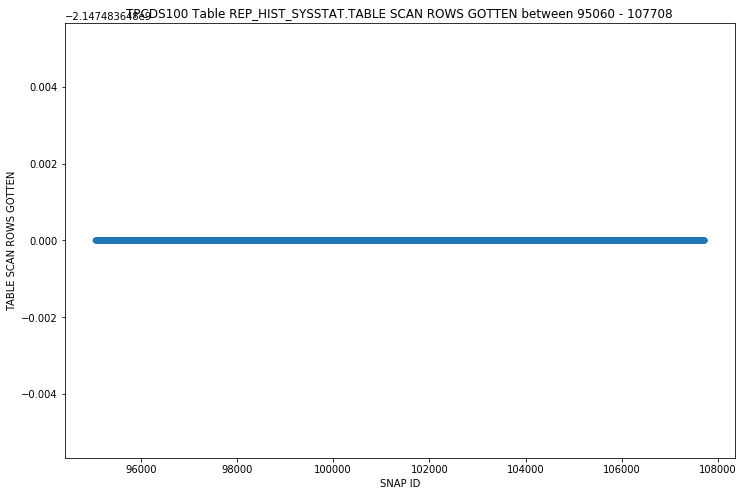

REP_HIST_SYSSTAT - TABLE SCANS (DIRECT READ) - STRIPPED SCATTER


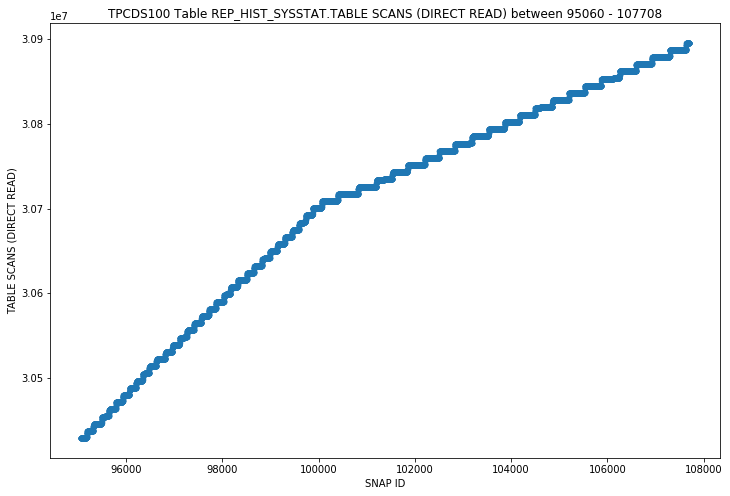

REP_HIST_SYSSTAT - TABLE SCANS (LONG TABLES) - STRIPPED SCATTER


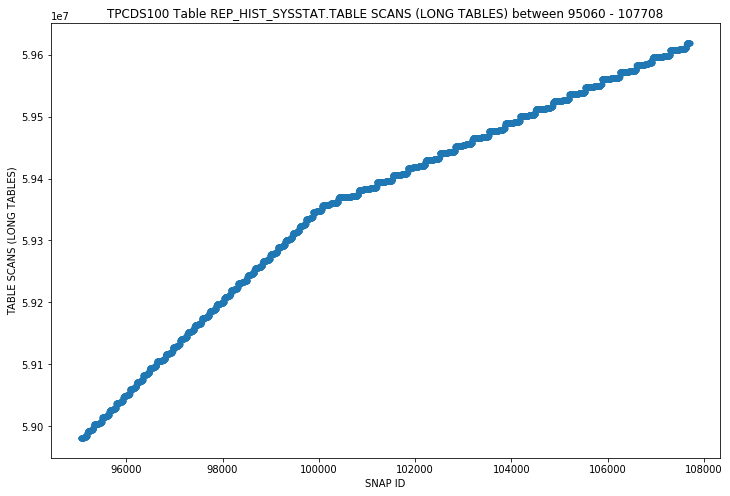

REP_HIST_SYSSTAT - TABLE SCANS (ROWID RANGES) - STRIPPED SCATTER


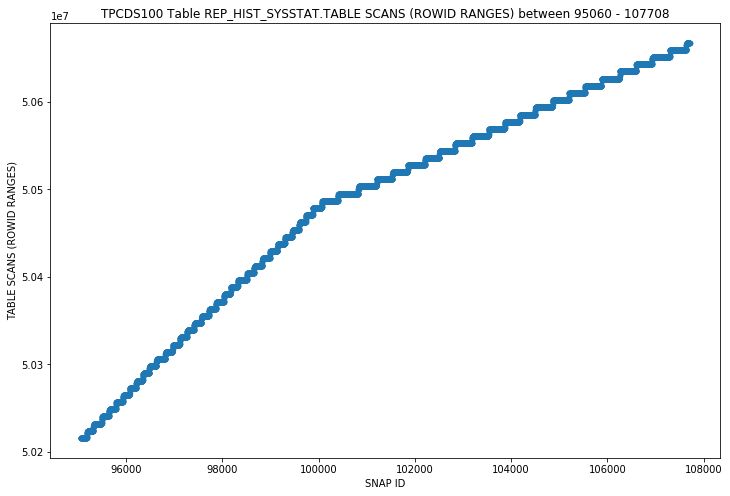

REP_HIST_SYSSTAT - TABLE SCANS (SHORT TABLES) - STRIPPED SCATTER


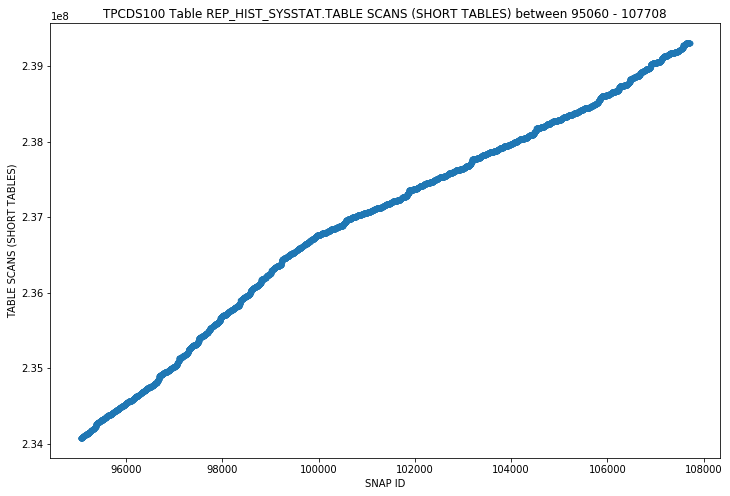

REP_HIST_SYSSTAT - TEMP SPACE ALLOCATED (BYTES) - STRIPPED SCATTER


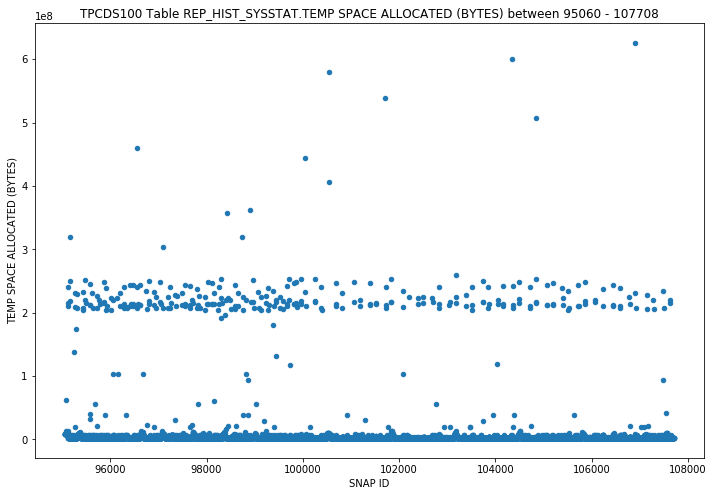

REP_HIST_SYSSTAT - TOTAL CF ENQ HOLD TIME - STRIPPED SCATTER


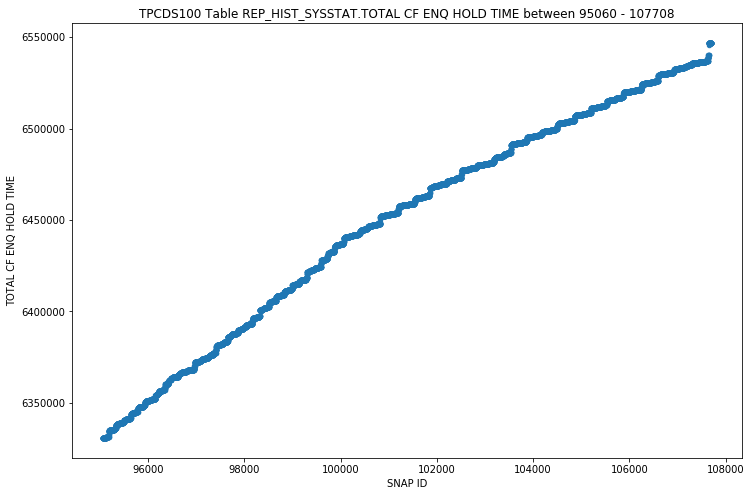

REP_HIST_SYSSTAT - TOTAL NUMBER OF CF ENQ HOLDERS - STRIPPED SCATTER


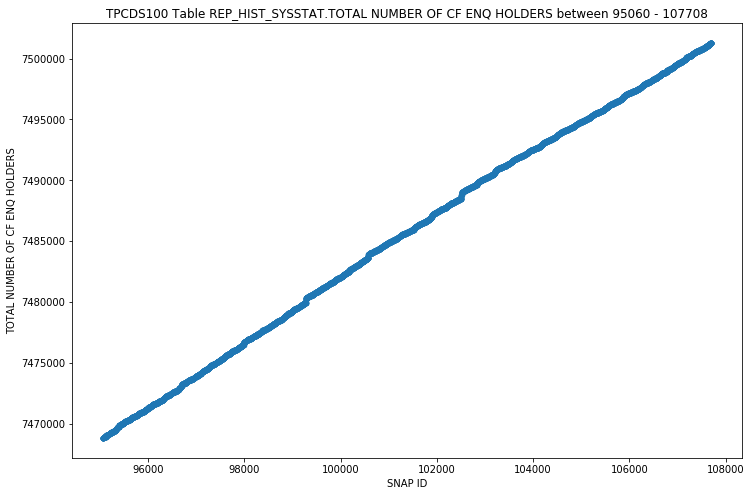

REP_HIST_SYSSTAT - TOTAL NUMBER OF SLOTS - STRIPPED SCATTER


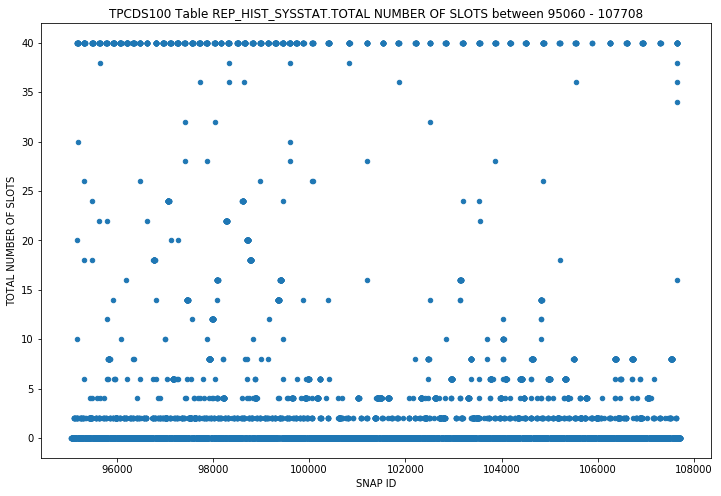

REP_HIST_SYSSTAT - TOTAL NUMBER OF TIMES SMON POSTED - STRIPPED SCATTER


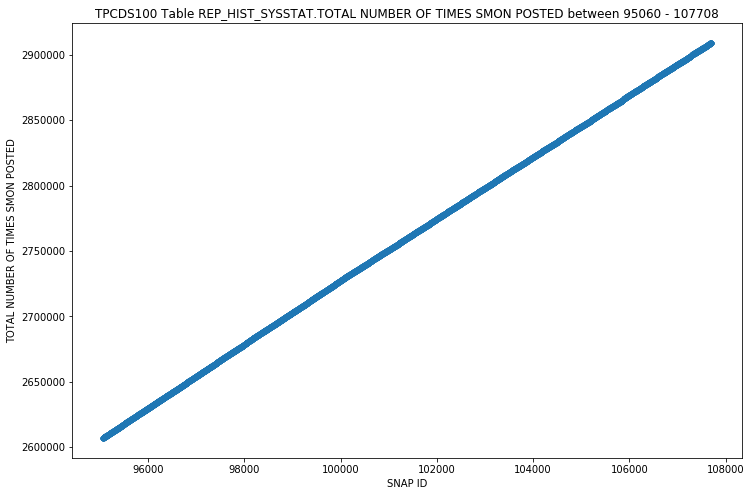

REP_HIST_SYSSTAT - TRANSACTION ROLLBACKS - STRIPPED SCATTER


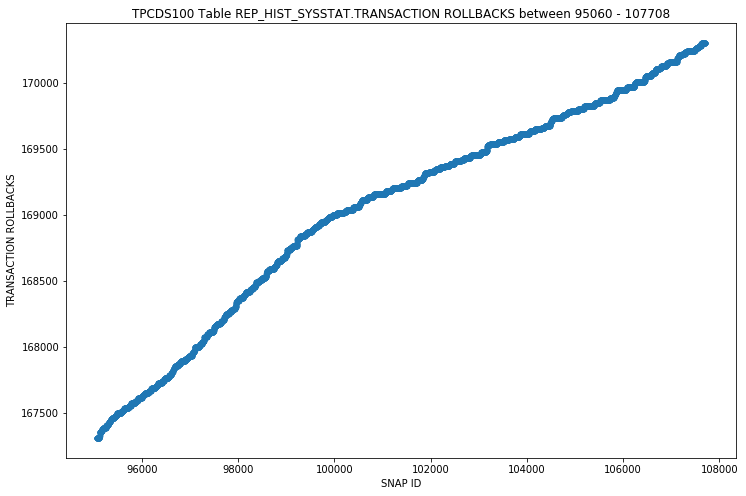

REP_HIST_SYSSTAT - TRANSACTION TABLES CONSISTENT READ ROLLBACKS - STRIPPED SCATTER


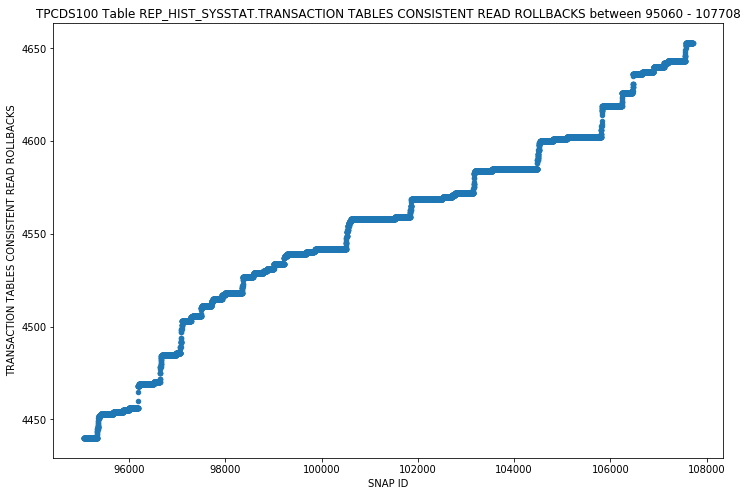

REP_HIST_SYSSTAT - TRANSACTION TABLES CONSISTENT READS - UNDO RECORDS APPLIED - STRIPPED SCATTER


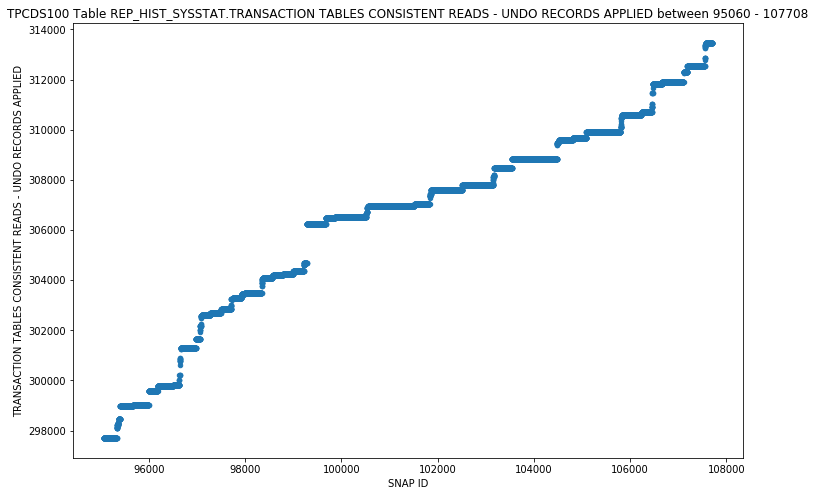

REP_HIST_SYSSTAT - UNDO CHANGE VECTOR SIZE - STRIPPED SCATTER


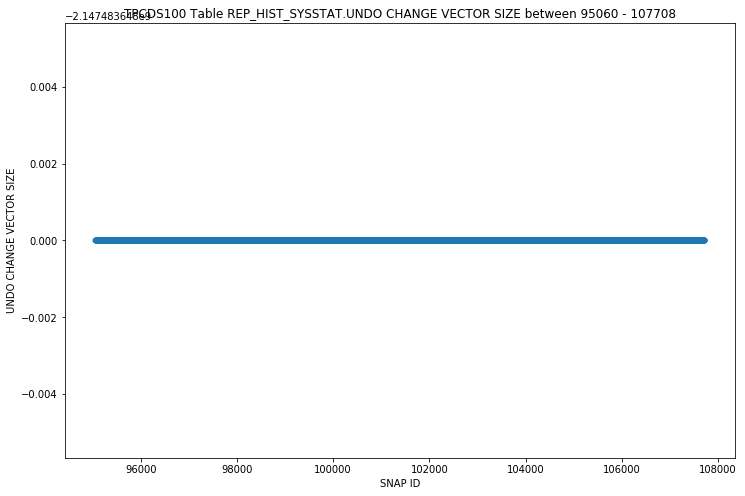

REP_HIST_SYSSTAT - USER I/O WAIT TIME - STRIPPED SCATTER


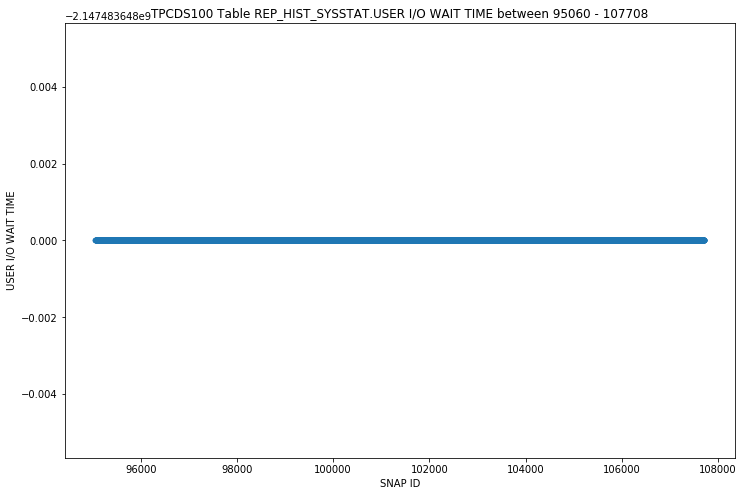

REP_HIST_SYSSTAT - USER CALLS - STRIPPED SCATTER


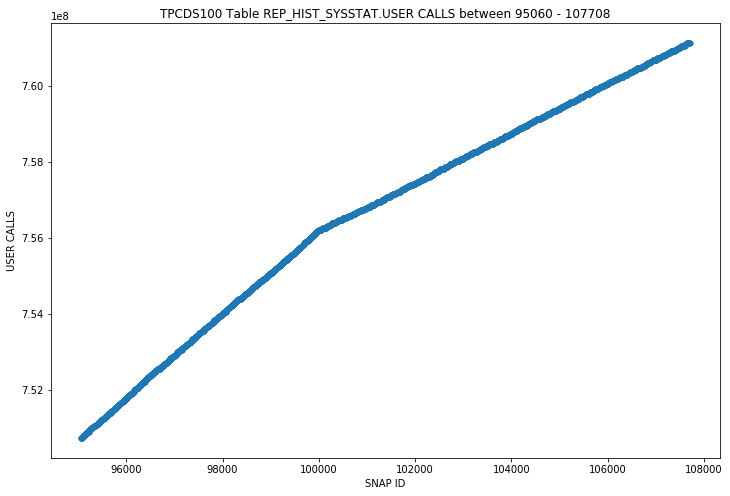

REP_HIST_SYSSTAT - USER COMMITS - STRIPPED SCATTER


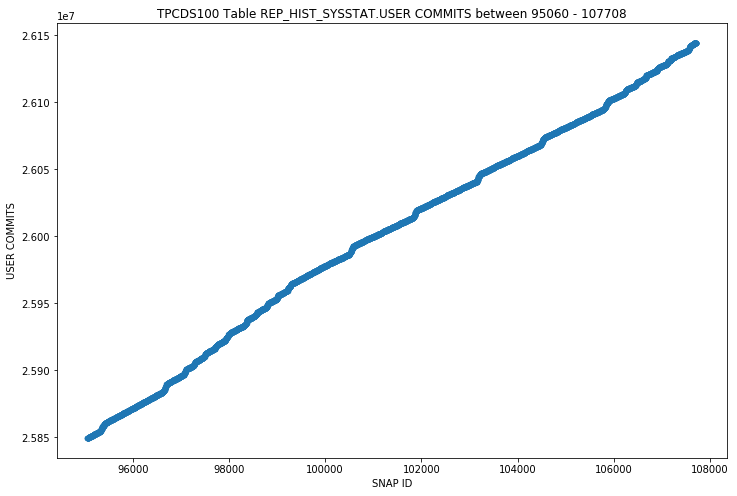

REP_HIST_SYSSTAT - USER LOGONS CUMULATIVE - STRIPPED SCATTER


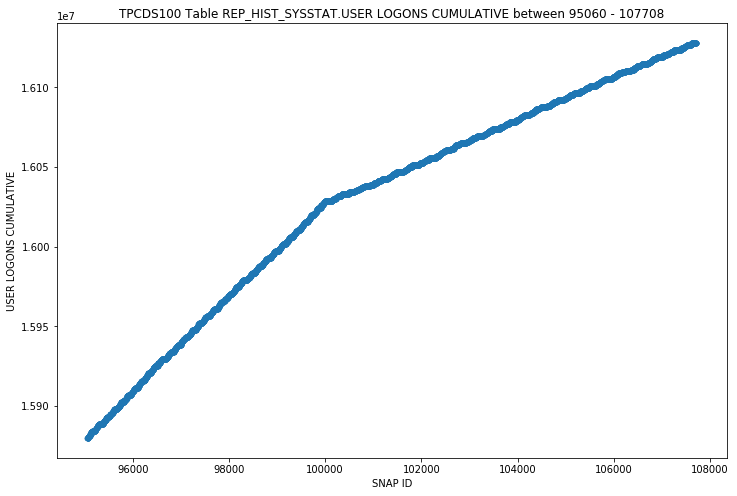

REP_HIST_SYSSTAT - USER LOGOUTS CUMULATIVE - STRIPPED SCATTER


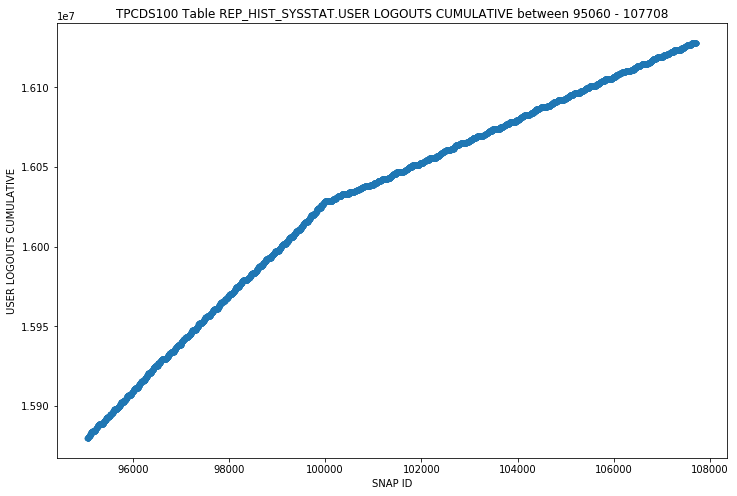

REP_HIST_SYSSTAT - USER ROLLBACKS - STRIPPED SCATTER


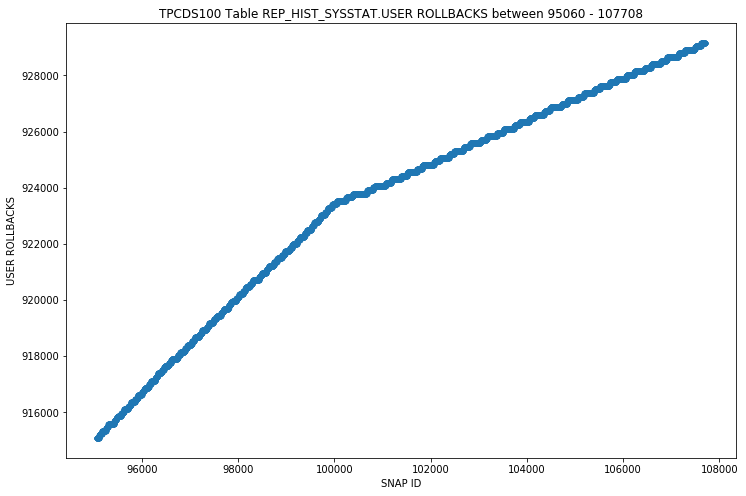

REP_HIST_SYSSTAT - WORKAREA EXECUTIONS - ONEPASS - STRIPPED SCATTER


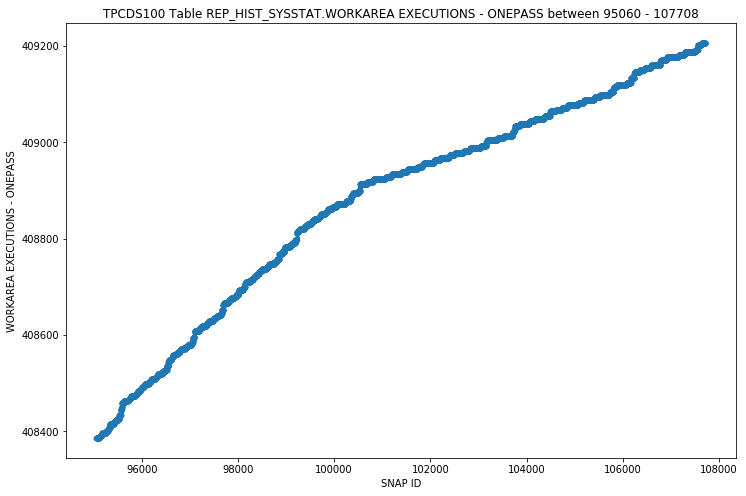

REP_HIST_SYSSTAT - WORKAREA EXECUTIONS - OPTIMAL - STRIPPED SCATTER


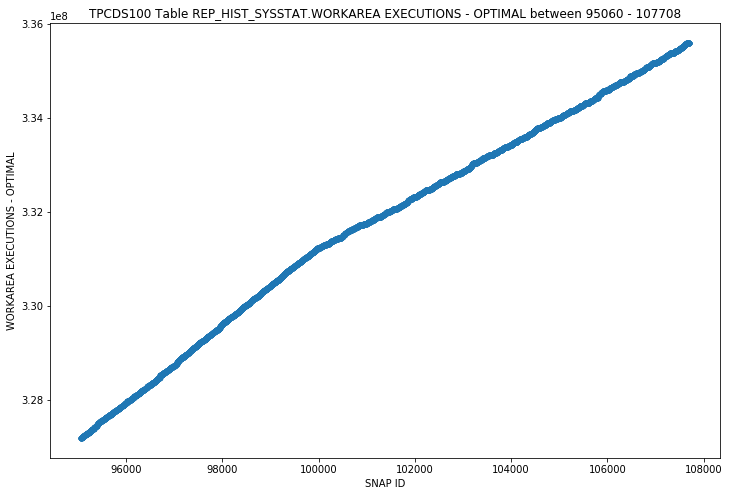

REP_HIST_SYSSTAT - WORKAREA MEMORY ALLOCATED - STRIPPED SCATTER


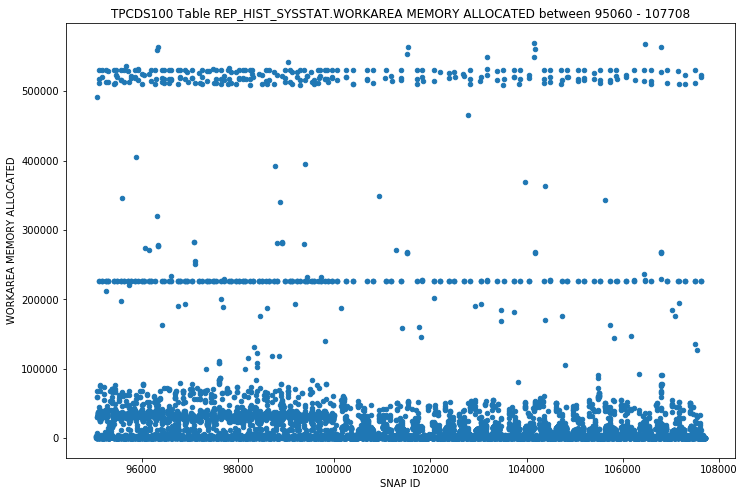

REP_HIST_SYSSTAT - WRITE CLONES CREATED IN BACKGROUND - STRIPPED SCATTER


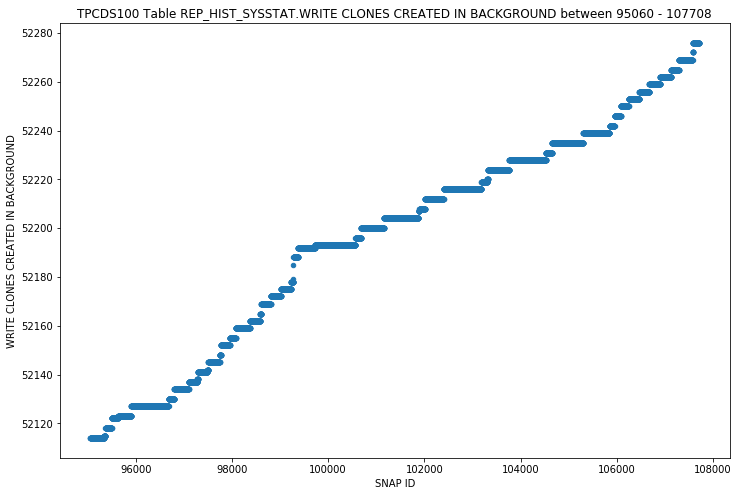

REP_HIST_SYSSTAT - WRITE CLONES CREATED IN FOREGROUND - STRIPPED SCATTER


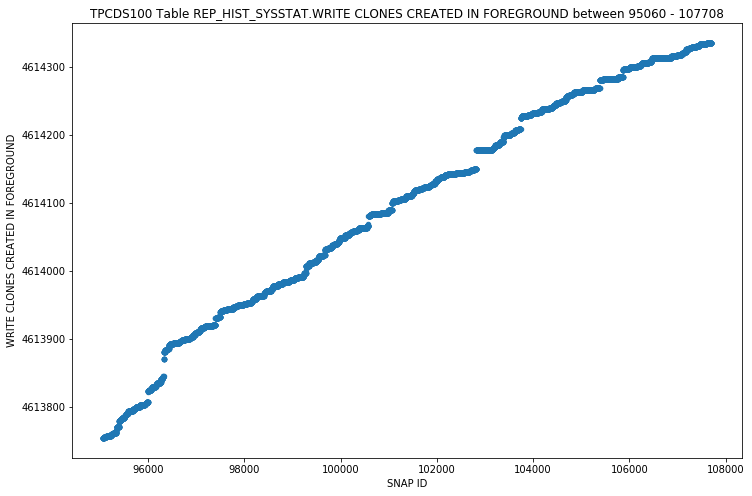

In [11]:
vis = Visualizer(df=rep_hist_sysstat_df_pruned, 
                 tpc_type=tpcds, 
                 table='rep_hist_sysstat')

if debug_mode is False:
    
    # Plotting Histograms without Outliers
    for header in rep_hist_sysstat_df_pruned.columns:
        print('REP_HIST_SYSSTAT - ' + header + ' - STRIPPED HISTOGRAM')
        vis.plot_hist(feature_column=header, bin_size=10)
    
    # Plotting Scatter Plots without Outliers
    for header in rep_hist_sysstat_df_pruned.columns:
        print('REP_HIST_SYSSTAT - ' + header + ' - STRIPPED SCATTER')
        vis.plot_scatter(feature_column=header)

### Dropping Redundant Columns

Dropping redundant columns which are not detrimental to the task at hand (NB: This is only the first steps towards feature selection. This step ensures that specific columns which are SURELY not useful are dropped ahead of time).

http://benalexkeen.com/feature-scaling-with-scikit-learn/

Based on the above plots, one can argue that the data distribution is uneven, and does not correlate to any particular pattern. A normalization approach (MinMaxScaling and/or RobustScaling) to the presented dataset is a more likely candidate than standardizing of the presented dataset. 

Reasons behind normalizing the dataset rather than standardizing, is due to the vast standard deviations from the mean for several feature columns.

In [12]:
class NonNumericStrip:
    """
    This class contains a method dedicated to feature removing if they contain non-numeric data
    """
    @staticmethod
    def remove_non_numeric_columns(df):
        """
        Accepts data matrix, and returns another matrix with stripped columns containing non-numeric data.
        :param df: (Pandas) Data matrix
        :return: (Pandas) Data matrix
        """
        print('-'*10 + 'Before' + '-'*10)
        print(df.columns)
        col_list = []
        for col in df.columns:
            try:
                df[col] = df[col].astype(float)
                col_list.append(col)
            except ValueError:
                print('Column ' + str(col) + ' contains non numeric data')
        df = df[col_list]
        print('-'*10 + 'After' + '-'*10)
        print(df.columns)
        return df
rep_hist_sysstat_df_pruned = NonNumericStrip.remove_non_numeric_columns(df=rep_hist_sysstat_df_pruned)

----------Before----------
Index(['SNAP_ID', 'BATCHED IO (BOUND) VECTOR COUNT',
       'BATCHED IO (FULL) VECTOR COUNT', 'BATCHED IO (SPACE) VECTOR COUNT',
       'BATCHED IO BLOCK MISS COUNT', 'BATCHED IO BUFFER DEFRAG COUNT',
       'BATCHED IO DOUBLE MISS COUNT', 'BATCHED IO SAME UNIT COUNT',
       'BATCHED IO SINGLE BLOCK COUNT', 'BATCHED IO SLOW JUMP COUNT',
       ...
       'USER CALLS', 'USER COMMITS', 'USER LOGONS CUMULATIVE',
       'USER LOGOUTS CUMULATIVE', 'USER ROLLBACKS',
       'WORKAREA EXECUTIONS - ONEPASS', 'WORKAREA EXECUTIONS - OPTIMAL',
       'WORKAREA MEMORY ALLOCATED', 'WRITE CLONES CREATED IN BACKGROUND',
       'WRITE CLONES CREATED IN FOREGROUND'],
      dtype='object', name='STAT_NAME', length=325)
----------After----------
Index(['SNAP_ID', 'BATCHED IO (BOUND) VECTOR COUNT',
       'BATCHED IO (FULL) VECTOR COUNT', 'BATCHED IO (SPACE) VECTOR COUNT',
       'BATCHED IO BLOCK MISS COUNT', 'BATCHED IO BUFFER DEFRAG COUNT',
       'BATCHED IO DOUBLE MISS COUN

### Dataset Consolidation

Grouping datasets on SNAP_ID

In [13]:
print("REP_HIST_SYSSTAT shape before transformation: " + str(rep_hist_sysstat_df_pruned.shape))
rep_hist_sysstat_df_pruned = rep_hist_sysstat_df_pruned[rep_hist_sysstat_df_pruned['SNAP_ID'] > 0]

# Group By Values by SNAP_ID , sum all metrics (for table REP_HIST_SNAPSHOT)
rep_hist_sysstat_df_pruned = rep_hist_sysstat_df_pruned.groupby(['SNAP_ID']).sum()
rep_hist_sysstat_df_pruned.reset_index(inplace=True)

print("REP_HIST_SYSSTAT shape after transformation: " + str(rep_hist_sysstat_df_pruned.shape))

REP_HIST_SYSSTAT shape before transformation: (12561, 325)
REP_HIST_SYSSTAT shape after transformation: (12561, 325)


### Normalization

Relavent Sources:

* http://jmlr.csail.mit.edu/papers/volume3/guyon03a/guyon03a.pdf
* https://machinelearningmastery.com/rescaling-data-for-machine-learning-in-python-with-scikit-learn/

https://machinelearningmastery.com/normalize-standardize-time-series-data-python/ recommends a normalization preprocessing technique for data distribution that can closely approximate minimum and maximum observable values per column:

<i>"Normalization requires that you know or are able to accurately estimate the minimum and maximum observable values. You may be able to estimate these values from your available data. If your time series is trending up or down, estimating these expected values may be difficult and normalization may not be the best method to use on your problem."</i>

Normalization formula is stated as follows: $$y=(x-min)/(max-min)$$

### Standardization

https://machinelearningmastery.com/normalize-standardize-time-series-data-python/ recommends a standardization preprocessing technique for data distributions that observe a Gaussian spread, with a mean of 0 and a standard deviation of 1 (approximately close to these values):

<i>"Standardization assumes that your observations fit a Gaussian distribution (bell curve) with a well behaved mean and standard deviation. You can still standardize your time series data if this expectation is not met, but you may not get reliable results."</i>

Standardization formula is stated as follows: $$y=(x-mean)/StandardDeviation$$
Mean defined as: $$mean=sum(x)/count(x)$$
Standard Deviation defined as: $$StandardDeviation=sqrt(sum((x-mean)^2)/count(x))$$

In [14]:
class Normalizer:

    @staticmethod
    def robust_scaler(dataframe):
        """
        Normalize df using interquartile ranges as min-max, this way outliers do not play a heavy emphasis on the
        normalization of values.
        :param dataframe: (Pandas) Pandas data matrix
        :return: (Pandas) Normalized data matrix
        """
        headers = dataframe.columns
        X = preprocessing.robust_scale(dataframe.values)
        return pd.DataFrame(X, columns=headers)

    @staticmethod
    def minmax_scaler(dataframe):
        """
        Normalize df using min-max ranges for normalization method
        :param dataframe: (Pandas) Pandas data matrix
        :return: (Pandas) Normalized data matrix
        """
        headers = dataframe.columns
        X = preprocessing.minmax_scale(dataframe.values)
        return pd.DataFrame(X, columns=headers)

    @staticmethod
    def normalize(dataframe):
        """
        The normalizer scales each value by dividing each value by its magnitude in n-dimensional space for n number of features.
        :param dataframe: (Pandas) Pandas data matrix
        :return: (Pandas) Normalized data matrix
        """
        headers = dataframe.columns
        X = preprocessing.normalize(dataframe.values)
        return pd.DataFrame(X, columns=headers)

print('------------------BEFORE------------------')
print('------------------REP_HIST_SYSSTAT------------------')
print(rep_hist_sysstat_df_pruned.shape)
print('\n')
#print(rep_hist_snapshot_df_pruned.head())
#
# ROBUST SCALER
# rep_hist_sysstat_df_pruned_norm = Normalizer.robust_scaler(dataframe=rep_hist_sysstat_df_pruned)
#
# MINMAX SCALER
rep_hist_sysstat_df_pruned_norm = Normalizer.minmax_scaler(dataframe=rep_hist_sysstat_df_pruned)
#
# NORMALIZER
#rep_hist_sysstat_df_pruned_norm = Normalizer.normalize(dataframe=rep_hist_sysstat_df_pruned)

print('\n\n------------------AFTER------------------')
print('------------------REP_HIST_SYSSTAT------------------')
print(rep_hist_sysstat_df_pruned_norm.shape)
print('\n\n')
print('\n\nREP_HIST_SYSSTAT')
print(rep_hist_sysstat_df_pruned_norm.head())

------------------BEFORE------------------
------------------REP_HIST_SYSSTAT------------------
(12561, 325)




------------------AFTER------------------
------------------REP_HIST_SYSSTAT------------------
(12561, 325)





REP_HIST_SYSSTAT
STAT_NAME   SNAP_ID  BATCHED IO (BOUND) VECTOR COUNT  \
0          0.000000                              0.0   
1          0.000079                              0.0   
2          0.000158                              0.0   
3          0.000237                              0.0   
4          0.000316                              0.0   

STAT_NAME  BATCHED IO (FULL) VECTOR COUNT  BATCHED IO (SPACE) VECTOR COUNT  \
0                            0.000000e+00                              0.0   
1                            0.000000e+00                              0.0   
2                            0.000000e+00                              0.0   
3                            0.000000e+00                              0.0   
4                            8

### Split Features / Labels

Split the data frame into features and Labels (SNAP_ID)

In [15]:
y_labels = rep_hist_sysstat_df_pruned_norm['WORKAREA MEMORY ALLOCATED']
del rep_hist_sysstat_df_pruned_norm['WORKAREA MEMORY ALLOCATED']

# Filter Methods

* https://machinelearningmastery.com/feature-selection-machine-learning-python/

Filter methods allow for the univariate analysis of features. Particularly, the following statistical methods have been considered and dismissed as explained below:

* Information Gain - Data at hand is continous by nature, whilst MI is usually applicable against discrete values / binned labels.
* Pearson Correlation Coefficient - Applicable to data with linear distributions, which is not the case for the majority of the presented features.

In [16]:
class FeatureImportance:
    """
    This class is dedicated to containing methods related to feature ranking. Features are ranked exclusively, or mutually with
    repsect to other features.
    """
    @staticmethod
    def f_regression_test(top_n_features=30, X_df=None, y_df=None, table=None):
        """
        Carries out a f_regression test on passed X,y dataframes, selecting top N features ranked by highest scoring.
        :param top_n_features: (Integer) Denotes number of top features to plot.
        :param x_df:           (Pandas) Pandas feature matrix.
        :param y_df:           (Pandas) Pandas label matrix.
        :param table:          (String) Denotes which table is being operated on.
        :return: None
        """
        headers = X_df.columns
        X_df = X_df.values
        y_df = y_df.values
        f_regression_selector = SelectKBest(score_func=f_regression, k=top_n_features)
        X_kbest = f_regression_selector.fit_transform(X_df, y_df)
        print('\n\nTable [' + table.upper() + ']')
        print('Original number of features: ' + str(X_df.shape[1]))
        print('Reduced number of features: ' + str(X_kbest.shape[1]) + "\n")
        outcome = f_regression_selector.get_support()

        scoring_sheet = []
        for i in range(0,len(headers)-1):
            if outcome[i]:
                scoring_sheet.append([headers[i],f_regression_selector.scores_[i]])

        scoring_sheet = sorted(scoring_sheet, key=itemgetter(1), reverse=True)
        [print('Feature [' + str(row) + '] with score [' + str(score) + ']') for row, score in scoring_sheet[:top_n_features]]

        scoring_sheet = pd.Series((v[1] for v in scoring_sheet[:top_n_features]) )
        scoring_sheet[:top_n_features].plot.bar()
        
        FeatureImportance.__plot_metrics(ylabel='f_regression RANKING',
                                         xlabel='FEATURES',
                                         title='Features Ranked By f_regression Scoring')
      
    @staticmethod
    def rfr_ranking(X_df=None, y_df=None, top_n_features=30, parallel_degree=1, max_depth=None, max_features='sqrt', n_estimators=100):
        """
        Ranks features using a filter RFR method, and plots them in descending order (ranked by importance)
        :param x_df:           (Pandas) Pandas feature matrix.
        :param y_df:           (Pandas) Pandas label matrix.
        :param top_n_features: (Integer) Denotes number of top features to plot.
        :param parallel_degree:(Integer) Denotes model training parallel degree.
        :param max_depth:      (Integer) Denotes number of leaves to evaluate during decision tree pruning.
        :param max_features:   (Integer) Denotes number of features to consider during random subselection.
        :param n_estimators:   (Integer) Number of estimators (trees) to build for decision making.
        :return: None
        """
        headers = X_df.columns
        X_df = X_df.values
        y_df = y_df.values
        rfr = RandomForestRegressor(n_estimators=int(n_estimators), 
                                    n_jobs=parallel_degree,
                                    max_depth=max_depth,
                                    max_features=max_features)
        rfr.fit(X_df, y_df)
        importances = pd.DataFrame({'feature':headers,
                                    'importance':np.round(rfr.feature_importances_,3)})
        importances = importances.sort_values('importance',ascending=False).set_index('feature')
        print(importances[:top_n_features])
        importances[:top_n_features].plot.bar()
        
        FeatureImportance.__plot_metrics(ylabel='RANDOM FOREST RANKING',
                                         xlabel='FEATURES',
                                         title='Features Ranked By Random Forest Scoring')
        
    @staticmethod
    def __plot_metrics(ylabel, xlabel, title):
        """
        Private method used to plot metrics for statistical feature evaluation
        :param ylabel: (String) ylabel title name.
        :param xlabel: (String) xlabel title name.
        :param title:  (String) plot title name.
        :return: None
        """
        plt.ylabel(ylabel)
        plt.xlabel(xlabel)
        plt.title(title)
        plt.rcParams['figure.figsize'] = [20, 15]
        plt.show()

### f_regression

Therefore, a likely candidate for a first univariate, filter test is a f_regression measure, between X labels 'SNAP_ID', and other output 'y' labels. NB: Due to f_regression requiring non-nagative values, a data normalization strategy was opted for (Refer to above cell).

The following cell computes the f_regression value for each feature pertaining in the following tables, in relation to the SNAP_ID feature:
* REP_HIST_SYSSTAT

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\univariate_selection.py:299: RuntimeWarning: invalid value encountered in true_divide
  corr /= X_norms
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:879: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1821: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)




Table [REP_HIST_SYSSTAT]
Original number of features: 324
Reduced number of features: 200

Feature [TEMP SPACE ALLOCATED (BYTES)] with score [21305.950781001422]
Feature [SESSION PGA MEMORY] with score [17162.154455470565]
Feature [SESSION PGA MEMORY MAX] with score [2379.3778572299348]
Feature [LOGONS CURRENT] with score [239.56507035362043]
Feature [REDO LOG SPACE WAIT TIME] with score [212.31186801790435]
Feature [MAX CF ENQ HOLD TIME] with score [208.9875093478776]
Feature [DBWR THREAD CHECKPOINT BUFFERS WRITTEN] with score [205.10511964631968]
Feature [REDO LOG SPACE REQUESTS] with score [203.24515394379867]
Feature [REDO BUFFER ALLOCATION RETRIES] with score [199.7794352206114]
Feature [TABLE SCANS (ROWID RANGES)] with score [199.11856770236378]
Feature [DFO TREES PARALLELIZED] with score [198.8319465134109]
Feature [PARALLEL OPERATIONS NOT DOWNGRADED] with score [198.8319465134109]
Feature [QUERIES PARALLELIZED] with score [198.83194651341043]
Feature [PX LOCAL MESSAGES SENT] 

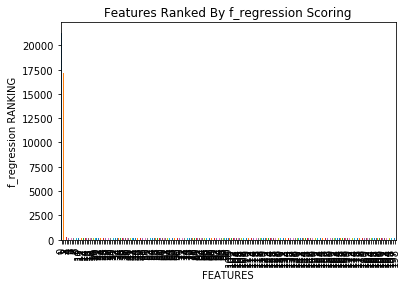

In [17]:
FeatureImportance.f_regression_test(top_n_features=top_n_features, 
                                    X_df=rep_hist_sysstat_df_pruned_norm, 
                                    y_df=y_labels, 
                                    table='REP_HIST_SYSSTAT')

### Random Forest Feature Importance

Calculating MI (Mutual Information) scoring between data matrix X (feature vectors) and target column y ('SNAP_ID') 

                                                 importance
feature                                                    
SESSION PGA MEMORY                                    0.269
TEMP SPACE ALLOCATED (BYTES)                          0.235
SESSION PGA MEMORY MAX                                0.145
OPENED CURSORS CURRENT                                0.051
PINNED CURSORS CURRENT                                0.040
LOGONS CURRENT                                        0.037
TOTAL NUMBER OF SLOTS                                 0.034
SESSION CURSOR CACHE HITS                             0.003
KTFB ALLOC TIME (MS)                                  0.002
TABLE FETCH CONTINUED ROW                             0.002
PROCESS LAST NON-IDLE TIME                            0.002
PREFETCH CLIENTS - DEFAULT                            0.002
SNAP_ID                                               0.001
SECUREFILE ALLOCATION CHUNKS                          0.001
HEAP BLOCK COMPRESS                     

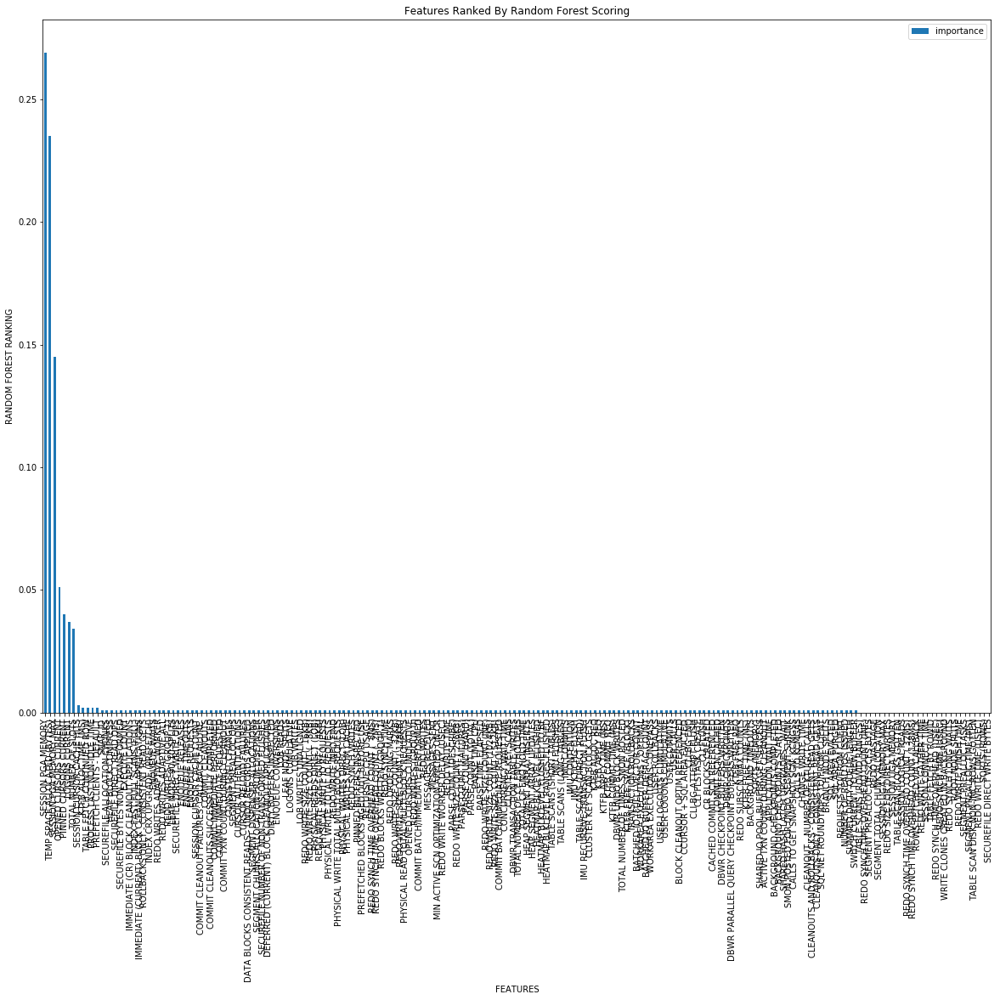

In [18]:
FeatureImportance.rfr_ranking(top_n_features=top_n_features,
                              X_df=rep_hist_sysstat_df_pruned_norm, 
                              y_df=y_labels, 
                              parallel_degree=parallel_degree,
                              max_depth=None,
                              max_features='sqrt',
                              n_estimators=rep_hist_sysstat_df_pruned_norm.shape[1])

### Wrapper Methods

Use a number of machine learning models to evaluate features together and rank by highest. The following machine learning models will be opted for:

* Random Forest Classifier
* Gradient Boosting

In a 'Brute-Fore' approach, these machine learning heuristics will strip away 1 feature at a time in a method referred to as 'Recursive Feature Elimination', and compare accuracy with every variable elimination. This allows the respective classifier to establish an optimum feature configuration with the highest accuracy score.

https://www.fabienplisson.com/choosing-right-features/

In [19]:
class EnsembleWrappers:
    """
    This class contains wrapper methods, which utilize ensemble methods to gauge feature pairings. Features are combined together
    and then stripped one at a time. Each feature combination is evaluated per feature count, so as to establish the optimum
    feature count cut off.
    """
    @staticmethod
    def rfr_wrapper(X_df=None, y_df=None, test_split=.4, table_name=None, top_n_features=10, parallel_degree=1, max_depth=None, max_features='sqrt', n_estimators=100):
        """
        Random Forest Regressor - Takes data matrix and target vector, and evaluates best combination of features 
        using an RFR model.
        :param x_df:           (Pandas) Pandas feature matrix.
        :param y_df:           (Pandas) Pandas label matrix.
        :param test_split:     (Float) Denotes training/testing data split.
        :param table_name:     (String) Denotes which table is being operated on.
        :param top_n_features: (Integer) Denotes number of top features to plot.
        :param parallel_degree:(Integer) Denotes model training parallel degree.
        :param max_depth:      (Integer) Denotes number of leaves to evaluate during decision tree pruning.
        :param max_features:   (Integer) Denotes number of features to consider during random subselection.
        :param n_estimators:   (Integer) Number of estimators (trees) to build for decision making.
        :return: Model Scoring, for best feature combination count
        :return: Recommended feature count, as per best achieved score
        """
        X_df = X_df.values
        y_df = y_df.values

        val_op, optimum_features = 0, 0
        val_op = 0
        X_train, X_test, y_train, y_test = train_test_split(X_df, y_df, test_size=test_split)
        model = RandomForestRegressor(n_estimators=int(n_estimators),
                                      n_jobs=parallel_degree,
                                      max_depth=max_depth,
                                      max_features=max_features)
        model.fit(X_train, y_train)

        # make predictions for test data and evaluate
        pred_y = model.predict(X_test)
        predictions = [round(value) for value in pred_y]
        r2s = r2_score(y_test, predictions)
        print("Table [" + table_name + "] RFR R2 Score: " + str(r2s))

        # fit model using each importance as a threshold
        print('Feature Importance\n' + str('-'*60))
        print(model.feature_importances_)
        print(str('-'*60))
        thresholds = np.sort(model.feature_importances_)
        feature_counts, feature_score = [],[]
        for thresh in thresholds:
            # selecting features using threshold
            selection = SelectFromModel(model, threshold=thresh, prefit=True)
            select_train_x = selection.transform(X_train)

            # training model
            selection_model = RandomForestRegressor(n_estimators=int(n_estimators),
                                                    n_jobs=parallel_degree,
                                                    max_depth=max_depth,
                                                    max_features=max_features)
            selection_model.fit(select_train_x, y_train)

            # evaluating model
            select_test_x = selection.transform(X_test)
            pred_y = selection_model.predict(select_test_x)
            predictions = [round(value) for value in pred_y]
            r2s = r2_score(y_test, predictions)
            print("Thresh=" + str(thresh) + ", n=" + str(select_train_x.shape[1]) + ", R2 Score: " + str(r2s))
            if(r2s > val_op):
                val_op = r2s
                optimum_features = select_train_x.shape[1]

            # Add/Keep track of '[no of features','r2 score']
            feature_counts.append(select_train_x.shape[1])
            feature_score.append(r2s)

        # Plot feature count performance
        EnsembleWrappers.__plot_metrics(feature_counts=feature_counts,
                                        feature_score=feature_score,
                                        xlabel='Featuers',
                                        ylabel='R2 Score',
                                        title='Feature Pairing Performance')

        return val_op, optimum_features

    @staticmethod
    def gradient_boosting_wrapper(X_df=None, y_df=None, test_split=.4, table_name=None, top_n_features=10, n_estimators=100, max_features='sqrt', max_depth=None,):
        """
        Gradient Boosting Regressor - Takes data matrix and target vector, and evaluates best combination of features 
        using a GBR model.
        :param x_df:           (Pandas) Pandas feature matrix.
        :param y_df:           (Pandas) Pandas label matrix.
        :param test_split:     (Float) Denotes training/testing data split.
        :param table_name:     (String) Denotes which table is being operated on.
        :param top_n_features: (Integer) Denotes number of top features to plot.
        :param parallel_degree:(Integer) Denotes model training parallel degree.
        :param n_estimators:   (Integer) Number of estimators (trees) to build for decision making.
        :param max_features:   (Integer) Denotes number of features to consider during random subselection.
        :param max_depth:      (Integer) Denotes number of leaves to evaluate during decision tree pruning.
        :return: Model Scoring, for best feature combination count
        :return: Recommended feature count, as per best achieved score
        """
        X_df = X_df.values
        y_df = y_df.values
        val_op, optimum_features = 0, 0
        X_train, X_test, y_train, y_test = train_test_split(X_df, 
                                                            y_df, 
                                                            test_size=test_split)
        model = GradientBoostingRegressor(n_estimators=int(n_estimators),
                                          max_features=max_features,
                                          max_depth=max_depth)
        model.fit(X_train, y_train)

        # make predictions for test data and evaluate
        pred_y = model.predict(X_test)
        predictions = [round(value) for value in pred_y]
        r2s = r2_score(y_test, predictions)
        print("Table [" + table_name + "] RFR R2 Score: " + str(r2s))
        #
        # fit model using each importance as a threshold
        print('Feature Importance\n' + str('-'*60))
        print(model.feature_importances_)
        print(str('-'*60))
        thresholds = np.sort(model.feature_importances_)
        feature_counts, feature_score = [],[]
        for thresh in thresholds:
            # selecting features using threshold
            selection = SelectFromModel(model, threshold=thresh, prefit=True)
            select_train_x = selection.transform(X_train)

            # training model
            selection_model = GradientBoostingRegressor(n_estimators=int(n_estimators),
                                                        max_features=max_features,
                                                        max_depth=max_depth)
            selection_model.fit(select_train_x, y_train)

            # evaluating model
            select_test_x = selection.transform(X_test)
            pred_y = selection_model.predict(select_test_x)
            predictions = [round(value) for value in pred_y]
            r2s = r2_score(y_test, predictions)
            print("Thresh=" + str(thresh) + ", n=" + str(select_train_x.shape[1]) + ", R2 Score: " + str(r2s))
            if(r2s > val_op):
                val_op = r2s
                optimum_features = select_train_x.shape[1]

            # Add/Keep track of '[no of features','r2 score']
            feature_counts.append(select_train_x.shape[1])
            feature_score.append(r2s)

        # Plot feature count performance
        EnsembleWrappers.__plot_metrics(feature_counts=feature_counts,
                                        feature_score=feature_score,
                                        xlabel='Featuers',
                                        ylabel='R2 Score',
                                        title='Feature Pairing Performance')

        return val_op, optimum_features
    
    @staticmethod
    def __plot_metrics(feature_counts, feature_score, ylabel, xlabel, title):
        """
        Private method used to plot metrics for statistical feature evaluation
        :param feature_counts: (List) List of feature combination counts per achieved score.
        :param feature_score:  (List) List of feature scores per combination.
        :param ylabel:         (String) ylabel title name.
        :param xlabel:         (String) xlabel title name.
        :param title:          (String) plot title name.
        :return: None
        """
        plt.ylabel(ylabel)
        plt.xlabel(xlabel)
        plt.title(title)
        plt.rcParams['figure.figsize'] = [20, 15]
        plt.plot(feature_counts, feature_score)
        plt.show()

### Random Forest Wrapper (Feature Combination)  (Regression)

Utilizes an ensemble Random Forest method to gauge different feature combination/counts.

Table [REP_HIST_SYSSTAT] RFR R2 Score: 0.7612122920006515
Feature Importance
------------------------------------------------------------
[1.33337530e-03 0.00000000e+00 8.65775934e-04 3.15205050e-04
 0.00000000e+00 6.44899319e-04 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.30509234e-03 1.27503288e-03 1.37733021e-03 1.18076856e-03
 1.33574846e-03 1.08647030e-03 0.00000000e+00 0.00000000e+00
 1.30904692e-03 1.18122046e-03 1.28790295e-03 0.00000000e+00
 1.31081127e-03 1.24501510e-03 1.50901290e-04 1.20483107e-03
 7.72862428e-07 1.89699311e-04 1.34326993e-03 1.01387016e-03
 0.00000000e+00 3.26049683e-04 0.00000000e+00 0.00000000e+00
 1.26512679e-03 1.49689055e-03 1.09547138e-03 1.10955558e-03
 1.25295093e-03 4.39383605e-04 1.01278737e-04 1.26706889e-03
 0.00000000e+00 1.17632279e-03 7.31291850e-04 1.26129858e-03
 3.82752393e-04 7.78952614e-04 0.00000000e+00 2.92996321e-04
 1.37599871e-03 0.00000000e+00 1.18172847e-03 1.11235538e-03
 9.68800

Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.7612122920006515
Thresh=0.0, n=324, R2 Score: 0.761212292

Thresh=0.0011718456657023807, n=126, R2 Score: 0.7612122920006515
Thresh=0.0011729300600198088, n=125, R2 Score: 0.7612122920006515
Thresh=0.001174053771267805, n=124, R2 Score: 0.7612122920006515
Thresh=0.0011760195123762006, n=123, R2 Score: 0.7612122920006515
Thresh=0.001176322791860066, n=122, R2 Score: 0.7612122920006515
Thresh=0.0011773175649911715, n=121, R2 Score: 0.7612122920006515
Thresh=0.0011807685603579235, n=120, R2 Score: 0.7612122920006515
Thresh=0.001180989519656524, n=119, R2 Score: 0.7612122920006515
Thresh=0.0011811611610103075, n=118, R2 Score: 0.7612122920006515
Thresh=0.0011812204575969941, n=117, R2 Score: 0.7612122920006515
Thresh=0.0011817284747760264, n=116, R2 Score: 0.7612122920006515
Thresh=0.0011929130604321, n=115, R2 Score: 0.7612122920006515
Thresh=0.0011942911580799362, n=114, R2 Score: 0.7612122920006515
Thresh=0.001194776089126123, n=113, R2 Score: 0.7612122920006515
Thresh=0.001194909291533785, n=112, R2 Score: 0.7612122920006515
Thresh=0.001199090

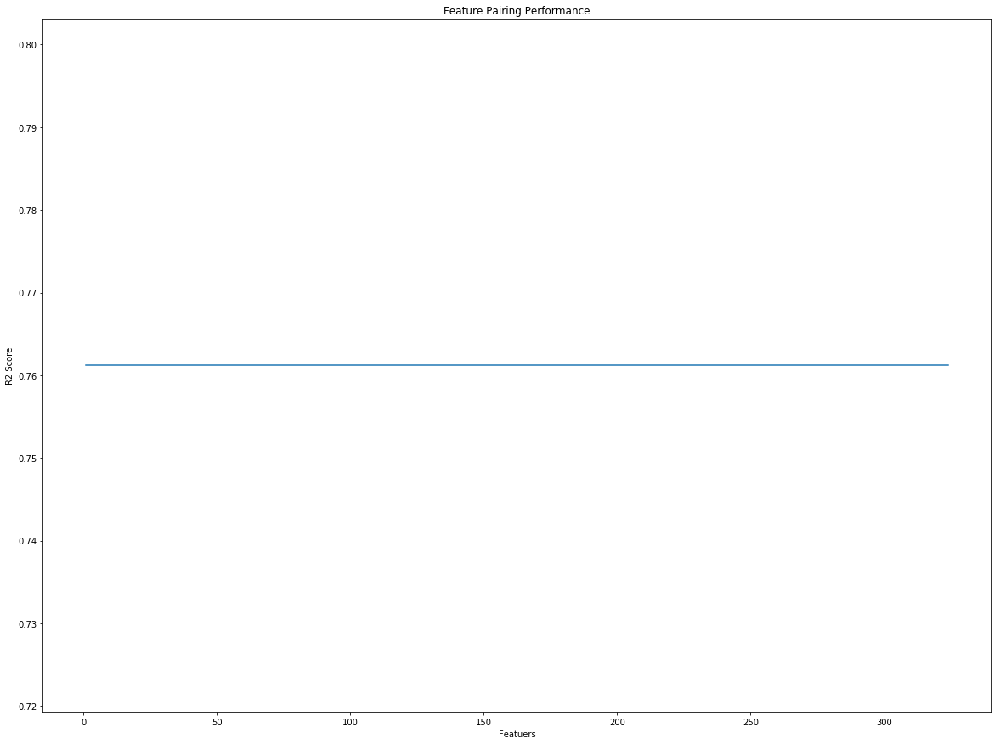

In [20]:
rfr_hist_sysstat_score, rfr_hist_sysstat_count = EnsembleWrappers.rfr_wrapper(X_df=rep_hist_sysstat_df_pruned_norm,
                                                                              y_df=y_labels,
                                                                              test_split=test_split,
                                                                              table_name='REP_HIST_SYSSTAT',
                                                                              top_n_features=top_n_features,
                                                                              parallel_degree=parallel_degree,
                                                                              max_depth=None,
                                                                              max_features='sqrt',
                                                                              n_estimators=rep_hist_sysstat_df_pruned_norm.shape[1]*2)

### Gradient Boosting Wrapper (Feature Combination)  (Regression)

Utilizes an ensemble Gradient Boosting method to gauge different feature combination/counts.

https://machinelearningmastery.com/gentle-introduction-gradient-boosting-algorithm-machine-learning/

Table [REP_HIST_SYSSTAT] RFR R2 Score: 0.7522368884294186
Feature Importance
------------------------------------------------------------
[1.33423172e-04 0.00000000e+00 4.63930087e-04 0.00000000e+00
 0.00000000e+00 3.32336411e-05 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 7.88459031e-05 7.09847754e-05 9.63976225e-05 5.52919579e-05
 1.46987546e-04 2.87550157e-04 0.00000000e+00 0.00000000e+00
 7.65714517e-05 1.30885693e-03 9.93474001e-05 0.00000000e+00
 2.08295778e-04 8.34099543e-05 1.31896806e-05 2.27821967e-04
 0.00000000e+00 4.29616717e-06 8.20012545e-05 2.23145889e-04
 0.00000000e+00 1.90450850e-03 0.00000000e+00 0.00000000e+00
 4.48224674e-05 3.30325308e-05 1.07897957e-04 6.75901547e-05
 5.12441343e-05 1.33290624e-05 4.55548436e-05 2.08663695e-04
 0.00000000e+00 3.34510997e-05 9.62940931e-05 1.67812795e-04
 2.21579045e-04 1.15139708e-04 0.00000000e+00 0.00000000e+00
 2.72743550e-04 0.00000000e+00 2.55938256e-04 2.39744163e-03
 2.69895

Thresh=0.0, n=324, R2 Score: 0.7533067143524785
Thresh=0.0, n=324, R2 Score: 0.753639167684481
Thresh=0.0, n=324, R2 Score: 0.7522368884294186
Thresh=0.0, n=324, R2 Score: 0.7533067143524785
Thresh=0.0, n=324, R2 Score: 0.7522368884294186
Thresh=0.0, n=324, R2 Score: 0.7499702305111497
Thresh=0.0, n=324, R2 Score: 0.75590582560275
Thresh=0.0, n=324, R2 Score: 0.7499702305111497
Thresh=0.0, n=324, R2 Score: 0.7555733722707474
Thresh=0.0, n=324, R2 Score: 0.7499702305111497
Thresh=0.0, n=324, R2 Score: 0.7522368884294186
Thresh=0.0, n=324, R2 Score: 0.753639167684481
Thresh=0.0, n=324, R2 Score: 0.7533067143524785
Thresh=0.0, n=324, R2 Score: 0.7522368884294186
Thresh=0.0, n=324, R2 Score: 0.7522368884294186
Thresh=0.0, n=324, R2 Score: 0.7499702305111497
Thresh=0.0, n=324, R2 Score: 0.7522368884294186
Thresh=0.0, n=324, R2 Score: 0.7522368884294186
Thresh=0.0, n=324, R2 Score: 0.7533067143524785
Thresh=0.0, n=324, R2 Score: 0.7499702305111497
Thresh=0.0, n=324, R2 Score: 0.7555733722707

Thresh=9.359074624881347e-05, n=122, R2 Score: 0.7499702305111497
Thresh=9.489598402311067e-05, n=121, R2 Score: 0.7555733722707474
Thresh=9.629409307698493e-05, n=120, R2 Score: 0.7522368884294186
Thresh=9.639762250953981e-05, n=119, R2 Score: 0.7533067143524785
Thresh=9.9347400139086e-05, n=118, R2 Score: 0.7522368884294186
Thresh=9.94314871831207e-05, n=117, R2 Score: 0.75590582560275
Thresh=0.00010233684828592733, n=116, R2 Score: 0.7499702305111497
Thresh=0.00010789795704137281, n=115, R2 Score: 0.7522368884294186
Thresh=0.00010829077683003481, n=114, R2 Score: 0.7522368884294186
Thresh=0.00011220468384535725, n=113, R2 Score: 0.7452411295383656
Thresh=0.00011244232211717329, n=112, R2 Score: 0.7499702305111497
Thresh=0.00011513970826989821, n=111, R2 Score: 0.7522368884294186
Thresh=0.00011535805828307813, n=110, R2 Score: 0.7499702305111497
Thresh=0.00011665108442286572, n=109, R2 Score: 0.7522368884294186
Thresh=0.0001220391539703161, n=108, R2 Score: 0.7499702305111497
Thresh=

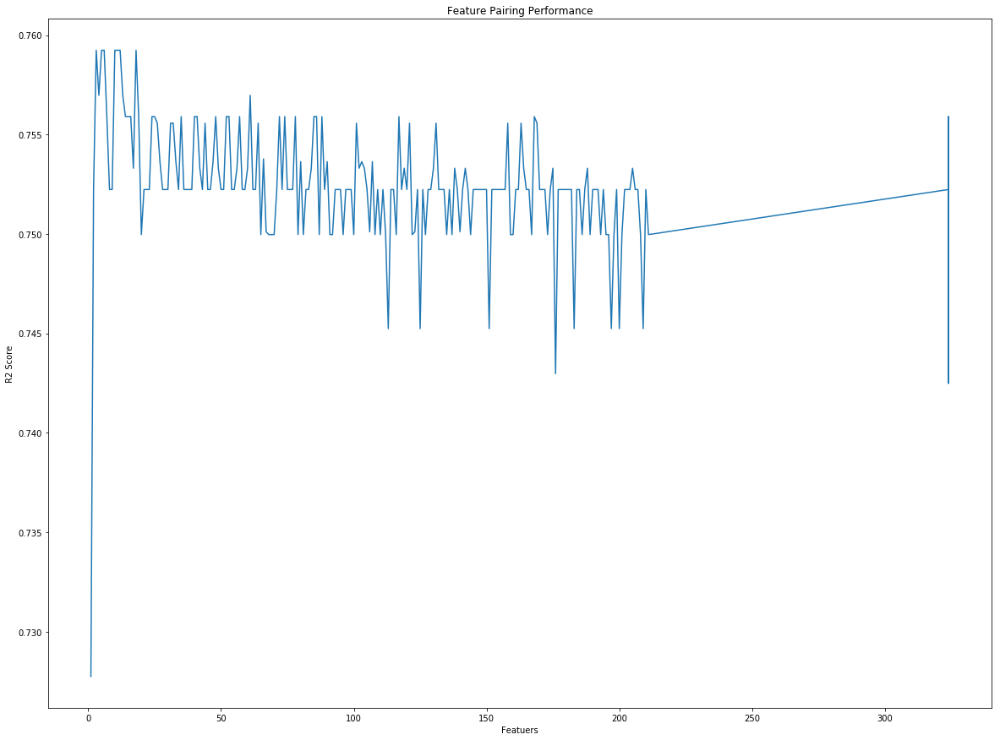

In [21]:
gbw_hist_sysstat_score, gbw_hist_sysstat_count = EnsembleWrappers.gradient_boosting_wrapper(X_df=rep_hist_sysstat_df_pruned_norm,
                                                                                            y_df=y_labels,
                                                                                            test_split=test_split,
                                                                                            table_name='REP_HIST_SYSSTAT',
                                                                                            top_n_features=top_n_features,
                                                                                            n_estimators=rep_hist_sysstat_df_pruned_norm.shape[1]*2,
                                                                                            max_features='sqrt',
                                                                                            max_depth=3)

### Recursive Feature Elimination (Regression)

Implements a recursive solution, where in features are eliminated based on an ensemble evaluator.

In [22]:
class FeatureEliminator:
    """
    This class is dedicated to housing logic pertaining to feature selection - retaining only labels which are considered
    important.
    """
    def __init__(self, X_df, y_df):
        """
        Class constructor.
        :param X_df: (Pandas) Pandas feature matrix.
        :param y_df: (Pandas) Pandas label matrix.
        :return: None
        """
        self.__X_df = X_df
        self.__y_df = y_df
    
    def rfe_selector(self, test_split=.4, optimum_feature_count=0, model=None, parallel_degree=1, max_depth=None, max_features='sqrt', n_estimators=100):
        """
        Recursive Feature Elimination Function. Isolates and eliminated features one by one, up till the desired amount, starting
        by features which are considered less important.
        :param test_split:            (Float) Denotes training/testing data split.
        :param optimum_feature_count: (Integer) Denotes the best estimated number of features to retain before a performance drop
                                                is estimated.
        :param parallel_degree:       (Integer) Denotes model training parallel degree.
        :param max_depth:             (Integer) Denotes number of leaves to evaluate during decision tree pruning.
        :param max_features:          (Integer) Denotes number of features to consider during random subselection.
        :param n_estimators:          (Integer) Number of estimators (trees) to build for decision making.
        :return: (List) This list is composed of boolean values, which correspond to the input feature column headers. True List 
                        values denote columns which have been retained. False values denote eliminated feature headers.
        :return: (List) This list denotes feature rankings, which correspond to the input feature column headers. Values of '1',
                        denote that features have been retained.
        """
        X_df = self.__X_df.values
        y_df = self.__y_df.values
        
        X_train, X_test, y_train, y_test = train_test_split(X_df, y_df, test_size=test_split)
        print(X_train.shape)
        print(X_test.shape)
        print(y_train.shape)
        print(y_test.shape)
        if model == 0:
            model = RandomForestRegressor(n_estimators=int(n_estimators), 
                                          n_jobs=parallel_degree,
                                          max_depth=max_depth,
                                          max_features=max_features)
        elif model == 1:
            model = GradientBoostingRegressor(n_estimators=100,
                                              max_depth=1,
                                              max_features=max_features)  

        # create the RFE model and select N attributes
        rfe_model = RFE(model, optimum_feature_count, step=1)
        rfe_model = rfe_model.fit(X_train, y_train)

        # summarize the selection of the attributes
        print(rfe_model.support_)
        print(rfe_model.ranking_)

        # evaluate the model on testing set
        pred_y = rfe_model.predict(X_test)
        predictions = [round(value) for value in pred_y]
        r2s = r2_score(y_test, predictions)
        
        return rfe_model.support_, rfe_model.ranking_
    
    def get_selected_features(self, column_mask):
        """
        Retrieves features which have not been eliminated from the RFE function.
        :param column_mask: (List) This list is composed of boolean values, which correspond to the input feature column headers. 
                                   True list values denote columns which have been retained. False values denote eliminated 
                                   feature headers. 
        :return: (Pandas) Pandas data matrix.
        """
        recommended_columns = []
        for i in range(len(self.__X_df.columns)):
            if (column_mask[i]):
                recommended_columns.append(self.__X_df.columns[i])
                
        return self.__X_df[recommended_columns]

In [23]:
if rfr_hist_sysstat_score > gbw_hist_sysstat_score:
    rep_hist_sysstat_op = rfr_hist_sysstat_count
    rep_hist_sysstat_model = 0
else:
    rep_hist_sysstat_op = gbw_hist_sysstat_count
    rep_hist_sysstat_model = 1

if rep_hist_sysstat_op == 0:
    rep_hist_sysstat_op = 1  # used to avoid having experiment to crash at this stage.    
    
print('Recommended Feature Drop [' + str(rep_hist_sysstat_op) + '] using model [' + str(rep_hist_sysstat_model) + ']')
fe = FeatureEliminator(X_df=rep_hist_sysstat_df_pruned_norm,
                       y_df=y_labels)
column_mask, column_rankings = fe.rfe_selector(test_split=test_split,
                                               optimum_feature_count=rep_hist_sysstat_op,
                                               model = rep_hist_sysstat_model,
                                               parallel_degree=parallel_degree,
                                               max_depth=3,
                                               max_features='sqrt',
                                               n_estimators=rep_hist_sysstat_df_pruned_norm.shape[1]*2)
print(rep_hist_sysstat_df_pruned_norm.columns)
rep_hist_sysstat_df_pruned_norm = fe.get_selected_features(column_mask=column_mask)
print(rep_hist_sysstat_df_pruned_norm.columns)

Recommended Feature Drop [324] using model [0]
(10048, 324)
(2513, 324)
(10048,)
(2513,)
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  Tru

### Value Decomposition

Principal component analysis: Factor model in which the factors are based on summarizing the total variance. With PCA, unities are used in the diagonal of the correlation matrix computationally implying that all the variance is common or shared.

https://towardsdatascience.com/an-approach-to-choosing-the-number-of-components-in-a-principal-component-analysis-pca-3b9f3d6e73fe

STAT_NAME   SNAP_ID  BATCHED IO (BOUND) VECTOR COUNT  \
0          0.000000                              0.0   
1          0.000079                              0.0   
2          0.000158                              0.0   
3          0.000237                              0.0   
4          0.000316                              0.0   

STAT_NAME  BATCHED IO (FULL) VECTOR COUNT  BATCHED IO (SPACE) VECTOR COUNT  \
0                            0.000000e+00                              0.0   
1                            0.000000e+00                              0.0   
2                            0.000000e+00                              0.0   
3                            0.000000e+00                              0.0   
4                            8.113578e-09                              0.0   

STAT_NAME  BATCHED IO BLOCK MISS COUNT  BATCHED IO BUFFER DEFRAG COUNT  \
0                                  0.0                    0.000000e+00   
1                                  0.0        

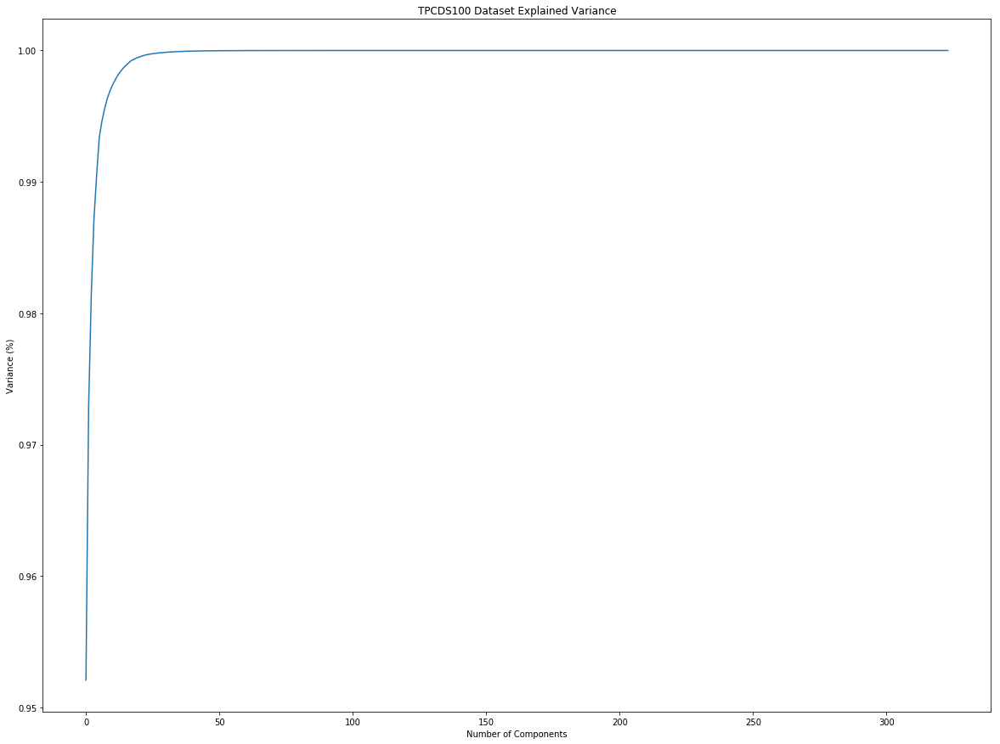

------------------------------
   Component_0  Component_1  Component_2  Component_3
0     8.060414     1.172029    -0.366478    -0.040742
1     8.060089     1.172431    -0.343243    -0.039166
2     8.059835     1.172202    -0.364493    -0.041056
3     8.059558     1.172277    -0.364511    -0.041118
4     8.059424     1.172061    -0.367852    -0.040873
(12561, 4)


In [24]:
class PrincipalComponentAnalysisClass:
    """
    This class handles logic related to PCA data transformations.
    https://towardsdatascience.com/an-approach-to-choosing-the-number-of-components-in-a-principal-component-analysis-pca-3b9f3d6e73fe
    """
    def __init__(self, X_df):
        """
        Cosntructor method.
        :param X_df: (Pandas) Dataframe consisting of input features, which will be subject to PCA.
        :return: None
        """
        self.__X_df = X_df
        
    def get_default_component_variances(self):
        """
        Fitting the PCA algorithm with our Data.
        :return: (Numpy array) Array of feature variances.
        """
        pca = PCA().fit(self.__X_df.values)
        return np.cumsum(pca.explained_variance_ratio_)
        
    def get_default_component_count(self, threshold=.99):
        """
        Retrieves the recommended number of component decomposition, above which very little variance 
        gain is achieved. This treshold will be set at a 0.999 variance threshold.
        :param threshold: (Float) Threshold value between 0 and 1. Stops immediately as soon the number
                                  of required components exceeds the threshold value.
        :return: (Integer) Returns the number of recommended components.
        """
        variance_ratios = self.get_default_component_variances()
        n = 0
        for val in variance_ratios:
            if val < threshold:
                n += 1
        return n
    
    def plot_variance_per_reduction(self):
        """
        This method subjects the feature matrix to a PCA decomposition. The number of components is plot
        vs the amount of retained variance.
        :return: None
        """
        variance_ratios = self.get_default_component_variances()
        
        #Plotting the Cumulative Summation of the Explained Variance
        plt.figure()
        plt.plot(variance_ratios)
        plt.xlabel('Number of Components')
        plt.ylabel('Variance (%)') #for each component
        plt.title(tpcds + ' Dataset Explained Variance')
        plt.show()
        
    def apply_PCA(self, n_components):
        """
        Applies Principle Component Analysis on the constructor passed data matrix, on a number of components.
        A new pandas data matrix is returned, with renamed 'Principal Component' headers.
        :param n_components: (Integer) Denotes number of component breakdown.
        :return: (Pandas) Dataframe consisting of new decomposed components.
        """
        pca = PCA(n_components=n_components)
        dataset = pca.fit_transform(self.__X_df.values)
        header_list = []
        for i in range(dataset.shape[1]):
            header_list.append('Component_' + str(i))
        return pd.DataFrame(data=dataset, columns=header_list)

print(rep_hist_sysstat_df_pruned_norm.head())
print(rep_hist_sysstat_df_pruned_norm.shape)

pcac = PrincipalComponentAnalysisClass(X_df=rep_hist_sysstat_df_pruned_norm)
pcac.plot_variance_per_reduction()
component_count = pcac.get_default_component_count()
rep_hist_sysstat_df_pruned_norm = pcac.apply_PCA(n_components=component_count)

print('-'*30)
print(rep_hist_sysstat_df_pruned_norm.head())
print(rep_hist_sysstat_df_pruned_norm.shape)